#  Project Progress Report
## Andres Nigenda, Elias Serrania, Krista Chan

In [1]:
%load_ext autoreload
%autoreload 2

import read_data as rd
import train_test as tt
import ml_loop as ml
import pandas as pd
import numpy as np
import full_pipeline as fp

/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [2]:
raw_dfs = fp.RawDfs()

In [3]:
set_list = raw_dfs.create_train_tests(np.timedelta64(2,'Y'))

Allegation sets

Training set 0 is trained from 2010-01-01 to 2010-12-31 to predict the outcome from 2011-01-01 to 2012-12-31 and tested on outcomes in 2013-01-01 to 2015-01-02

Training set 1 is trained from 2010-01-01 to 2011-12-31 to predict the outcome from 2012-01-01 to 2013-12-31 and tested on outcomes in 2014-01-01 to 2016-01-02

Training set 2 is trained from 2010-01-01 to 2012-12-30 to predict the outcome from 2012-12-31 to 2015-01-01 and tested on outcomes in 2015-01-02 to 2017-01-01

Training set 3 is trained from 2010-01-01 to 2013-12-30 to predict the outcome from 2013-12-31 to 2016-01-01 and tested on outcomes in 2016-01-02 to 2018-01-01



TRR sets

Training set 0 is trained from 2010-01-01 to 2010-12-31 to predict the outcome from 2011-01-01 to 2012-12-31 and tested on outcomes in 2013-01-01 to 2015-01-02

Training set 1 is trained from 2010-01-01 to 2011-12-31 to predict the outcome from 2012-01-01 to 2013-12-31 and tested on outcomes in 2014-01-01 to 2016-01-02



Sal

In [4]:
for test_set in set_list:
    test_set.add_train_features()
    test_set.add_test_features()

/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.

Train
firearm_used
False    5548
True      279
Name: officer_id, dtype: int64
used_firearm
0    13717
1      101
Name: id, dtype: int64
firearm_outcome
0    13632
1      186
Name: id, dtype: int64

final_finding
EX     718
NS    2868
SU     894
UN    1915
ZZ       6
Name: officer_id, dtype: int64
sustained_outcome
0    13180
1      638
Name: id, dtype: int64

Test
firearm_used
False    7198
True      396
Name: officer_id, dtype: int64
used_firearm
0    2191
1       4
Name: id, dtype: int64
firearm_outcome
0    2187
1       8
Name: id, dtype: int64

final_finding
EX    1097
NS    3604
SU    1437
UN    2687
ZZ       9
Name: officer_id, dtype: int64
sustained_outcome
0    1983
1     212
Name: id, dtype: int64



/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int64 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/Users/eliasserrania/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.

Train
firearm_used
False    6389
True      338
Name: officer_id, dtype: int64
used_firearm
0    13673
1      197
Name: id, dtype: int64
firearm_outcome
0    13715
1      155
Name: id, dtype: int64

final_finding
EX     912
NS    3264
SU    1221
UN    2345
ZZ       7
Name: officer_id, dtype: int64
sustained_outcome
0    13192
1      678
Name: id, dtype: int64

Test
firearm_used
False    7774
True      446
Name: officer_id, dtype: int64
used_firearm
0    1938
1       9
Name: id, dtype: int64
firearm_outcome
0    1945
1       2
Name: id, dtype: int64

final_finding
EX    1195
NS    3862
SU    1611
UN    2933
ZZ      17
Name: officer_id, dtype: int64
sustained_outcome
0    1780
1     167
Name: id, dtype: int64



In [5]:
# Model parameters
GRID = 'all'
CLFRS_TO_RUN = ['RandomForest',
                'ExtraTrees',
                'AdaBoost',
                'DecisionTree',
                'GradientBoosting',
                'Bagging',
                'LogisticRegression']
label_lst = ['sustained_outcome', 'firearm_outcome']

# Metrics and thresholds
METRIC_DICT = {'precision': [100, 5, 20, 50, 80],
               'recall': [100, 5, 20, 50, 80],
               'f1': [5],
               'accuracy': [50]}
METRICS = 'pop'

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

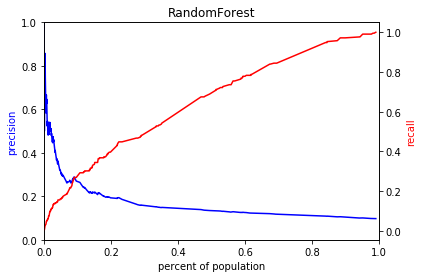

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

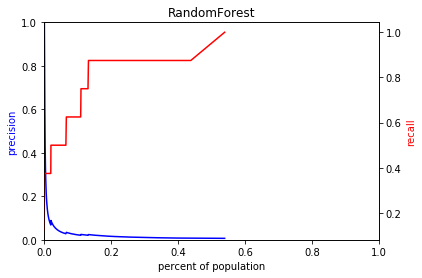

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

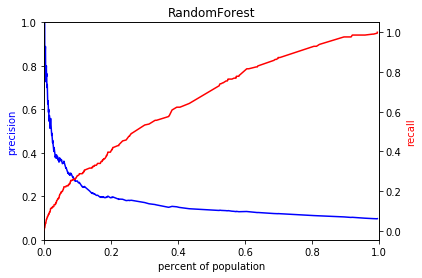

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

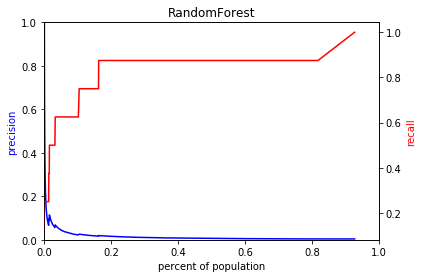

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

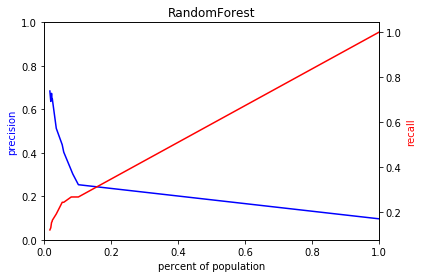

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

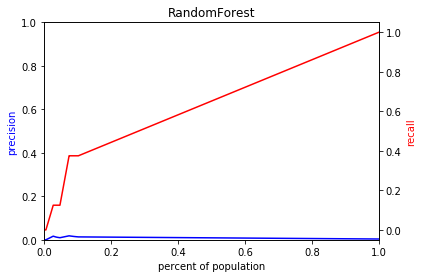

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

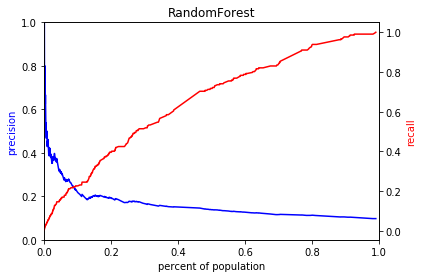

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

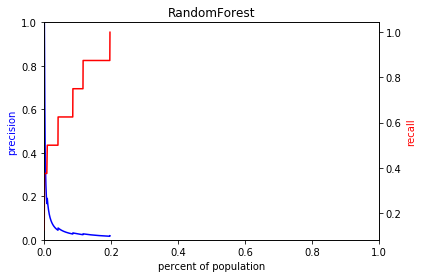

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

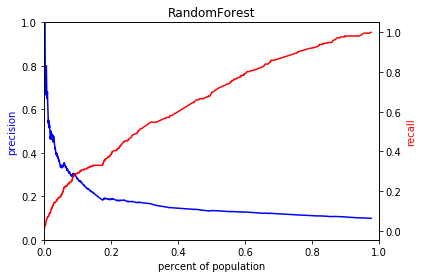

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

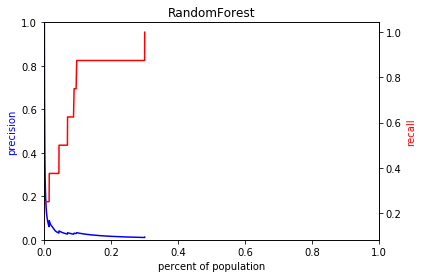

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

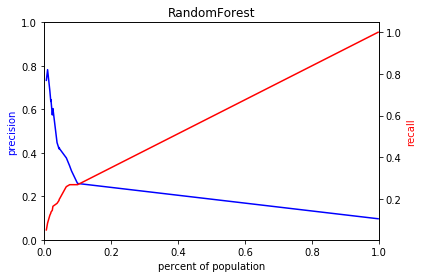

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

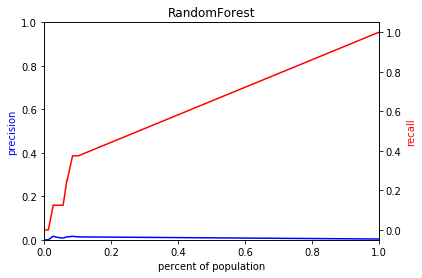

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

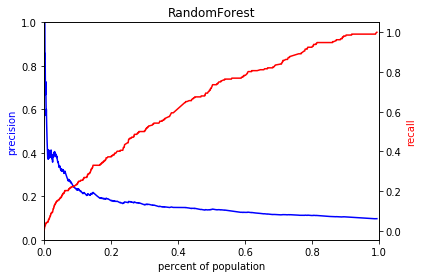

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

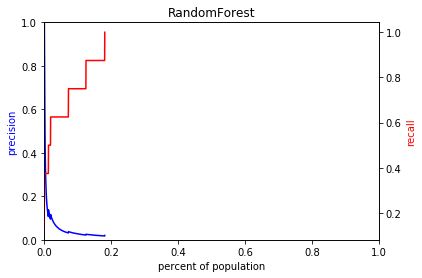

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

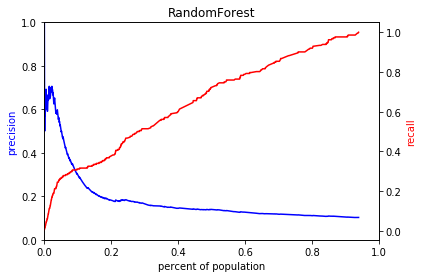

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

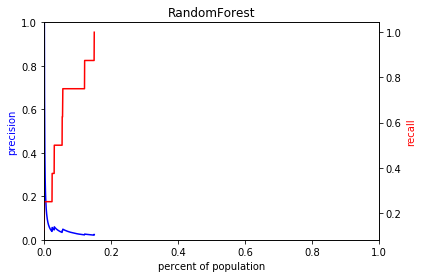

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

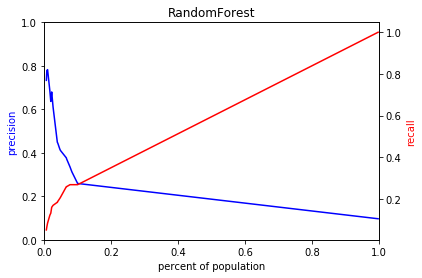

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

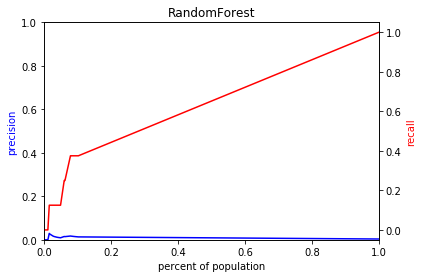

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

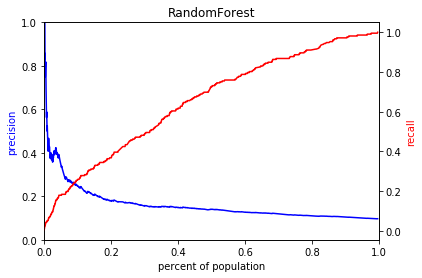

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

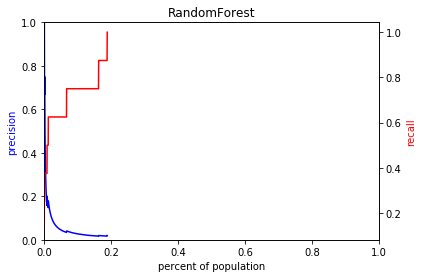

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

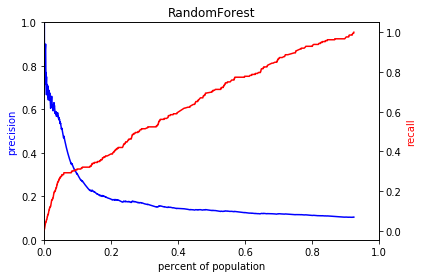

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

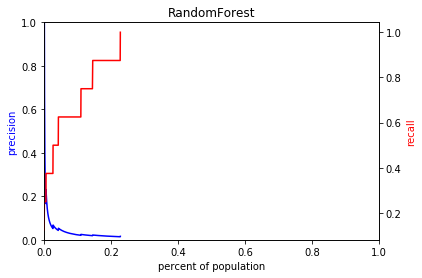

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

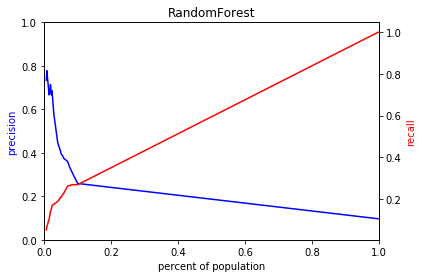

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

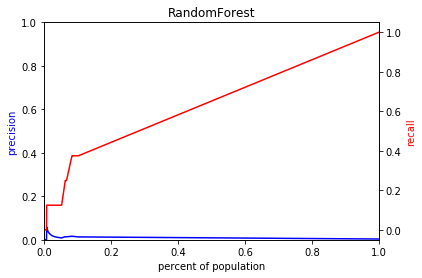

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

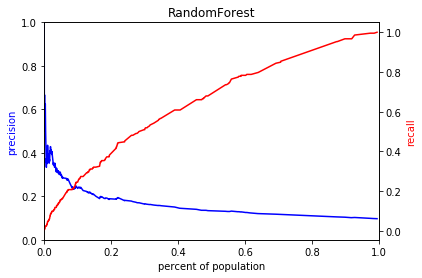

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

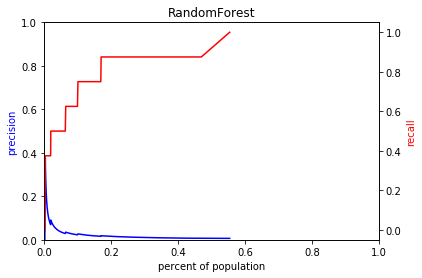

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

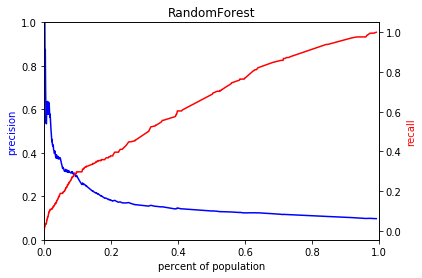

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

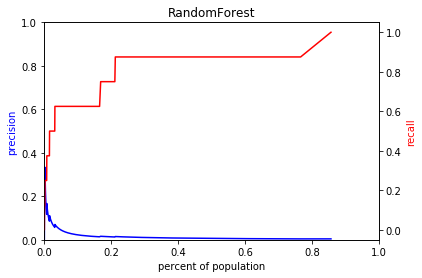

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

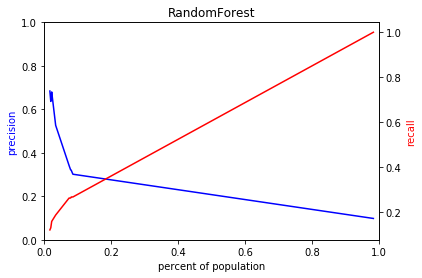

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

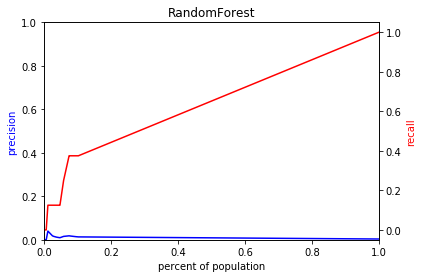

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

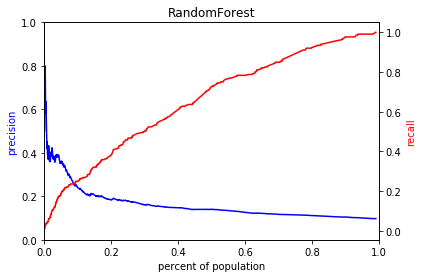

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

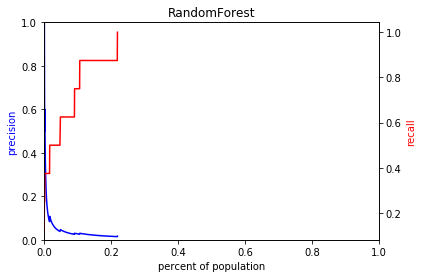

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

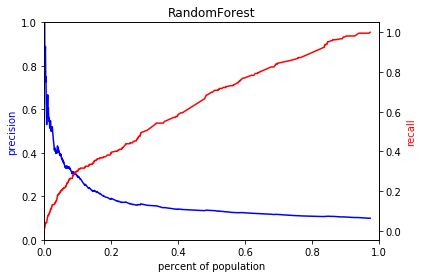

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

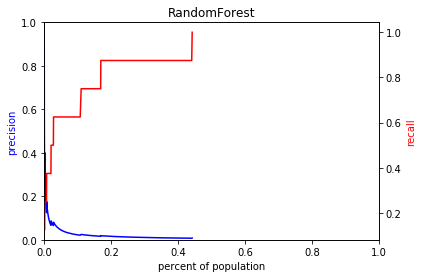

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

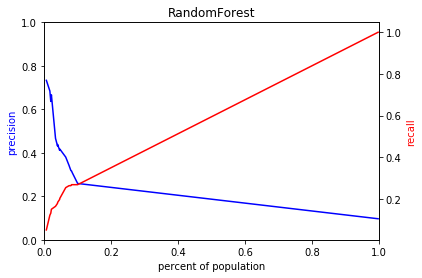

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

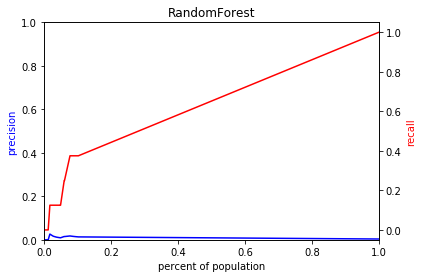

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

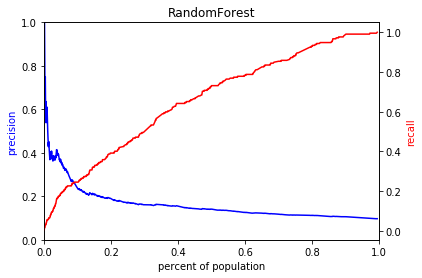

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

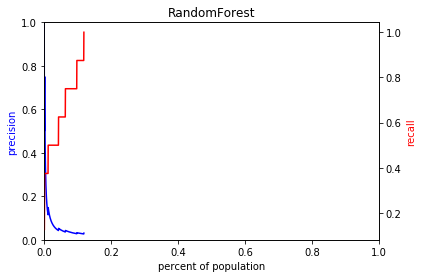

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

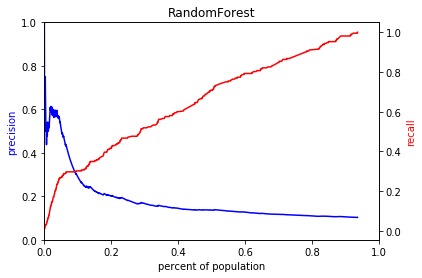

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

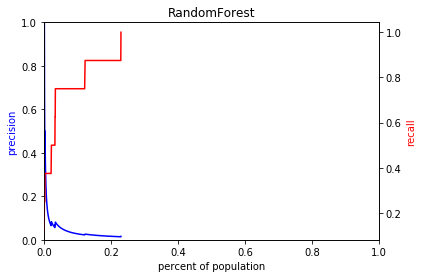

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

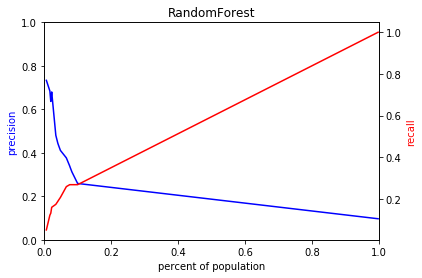

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

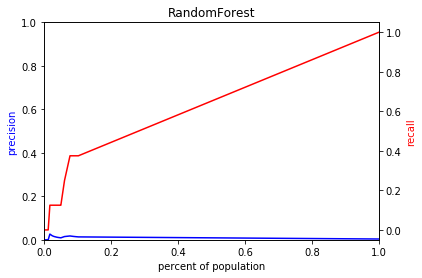

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

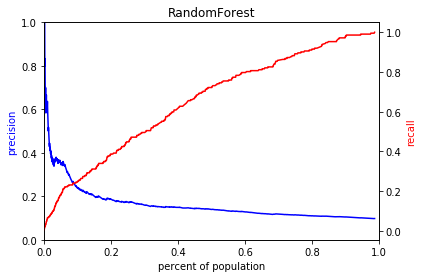

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

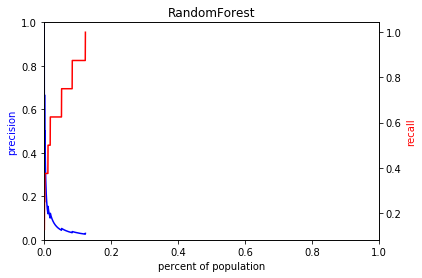

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

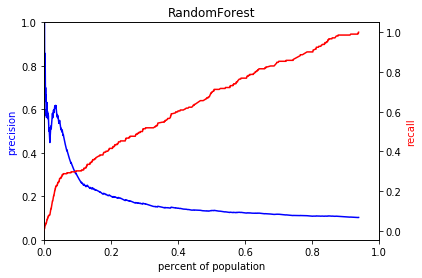

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

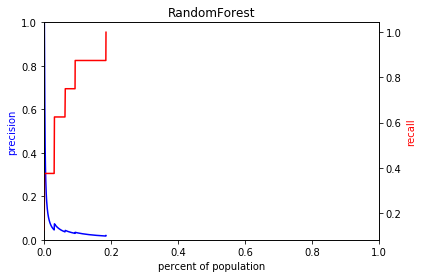

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

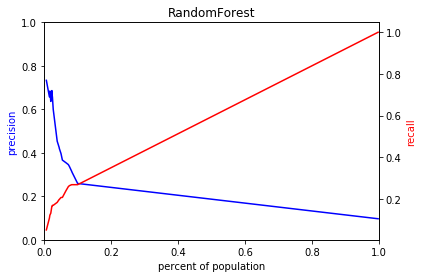

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

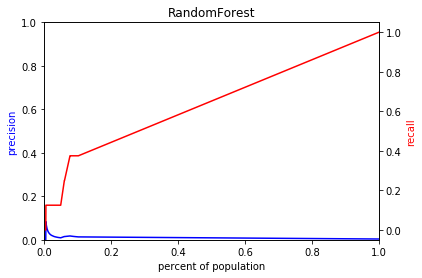

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

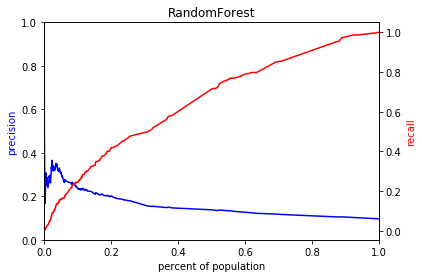

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

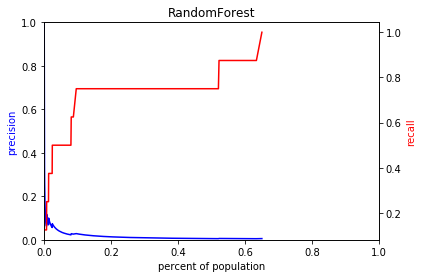

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

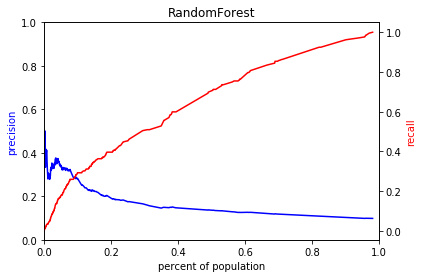

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

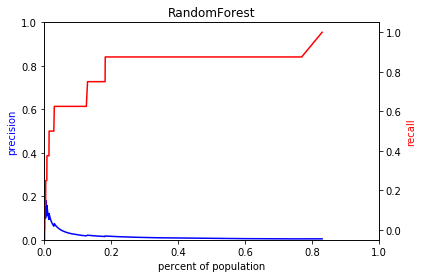

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

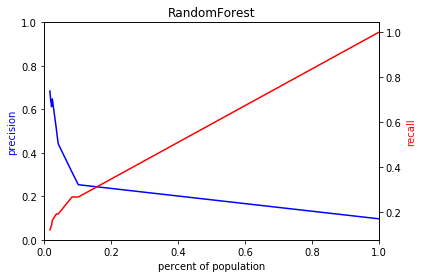

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

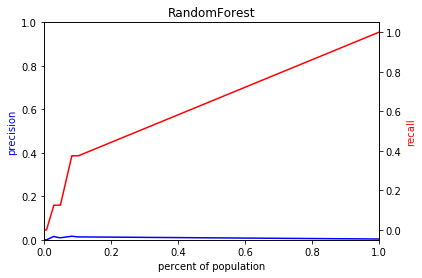

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

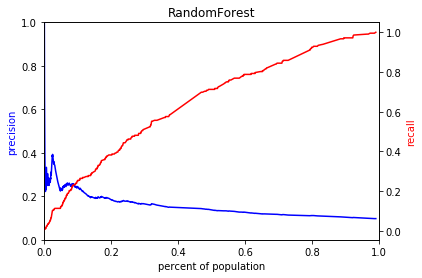

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

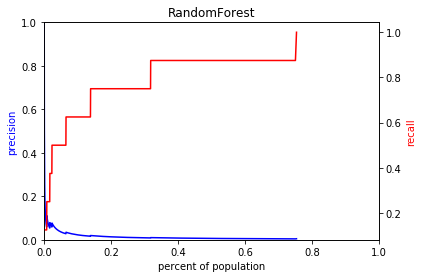

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

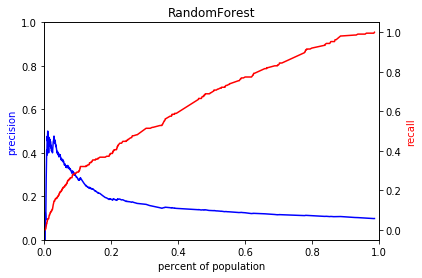

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

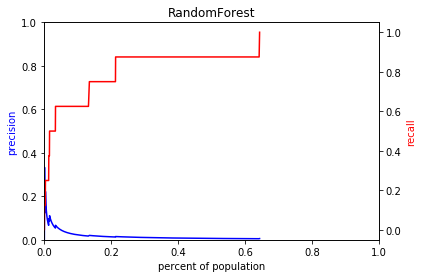

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

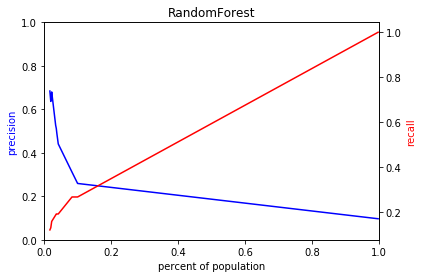

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

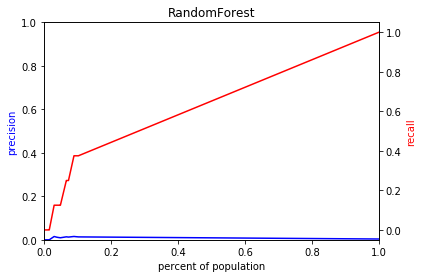

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

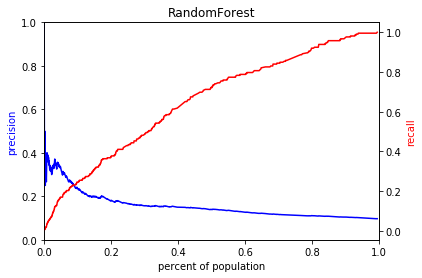

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

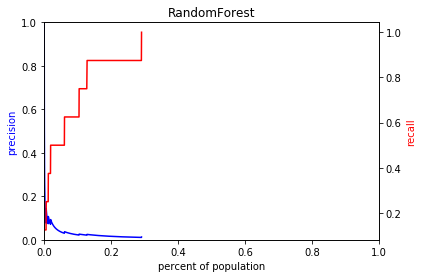

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

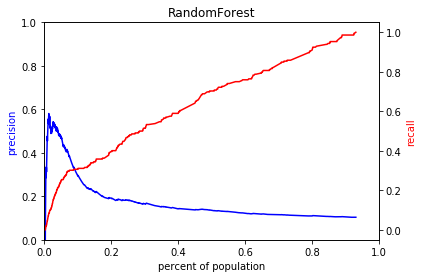

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

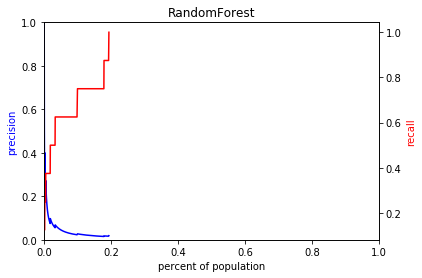

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

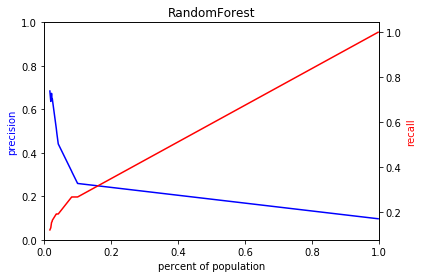

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

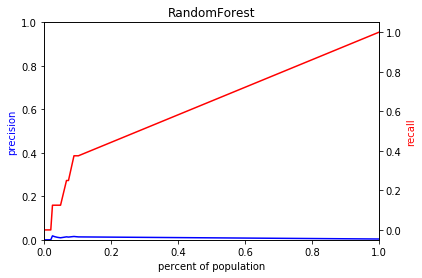

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

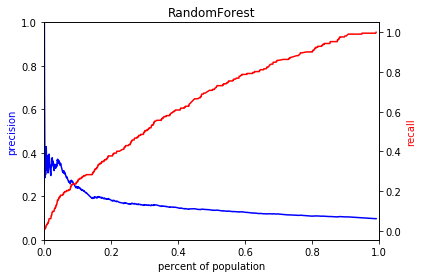

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

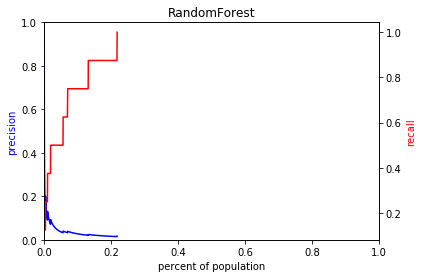

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

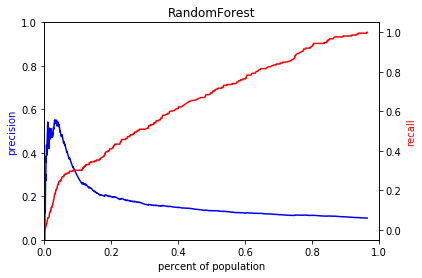

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

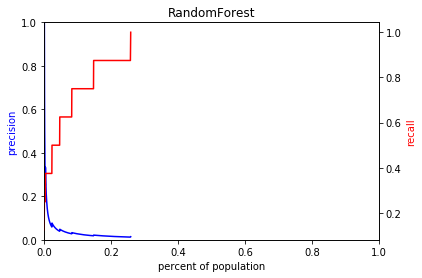

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

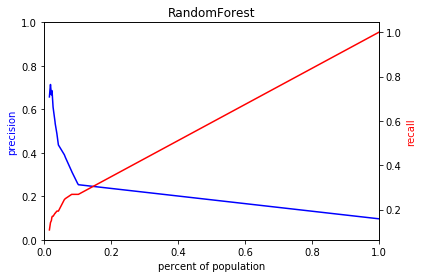

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

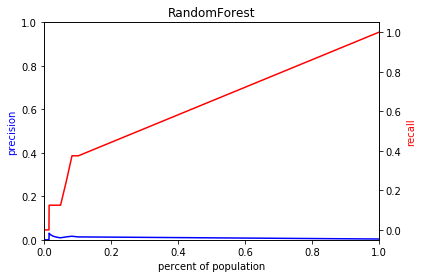

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

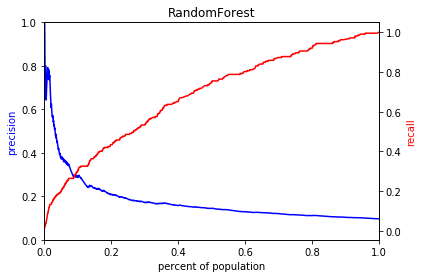

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

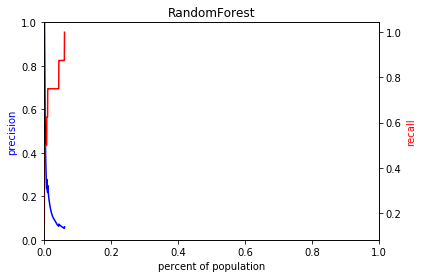

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

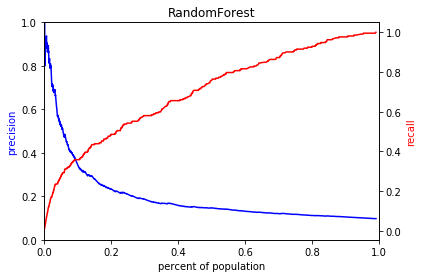

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

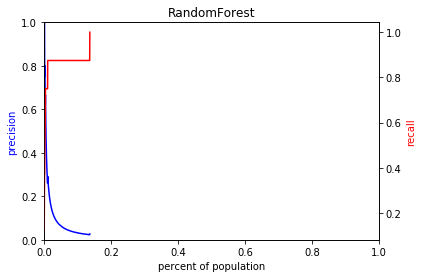

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

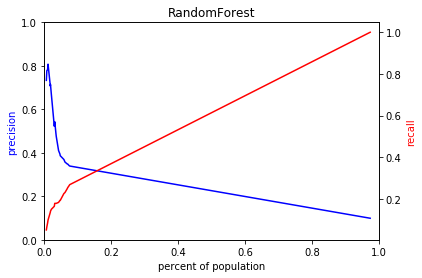

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

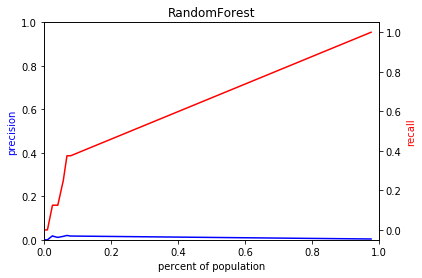

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

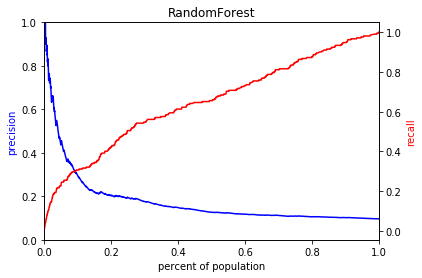

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

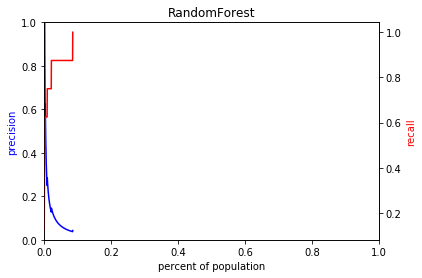

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

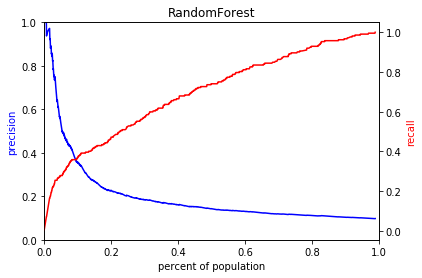

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

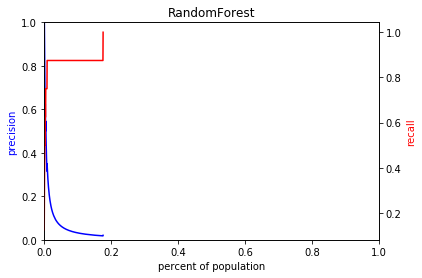

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

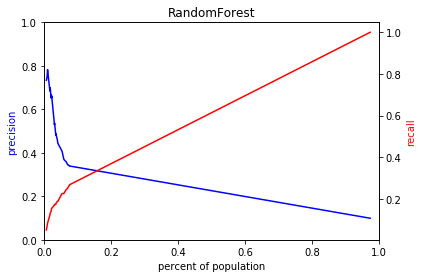

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

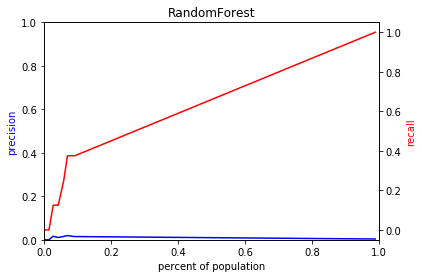

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

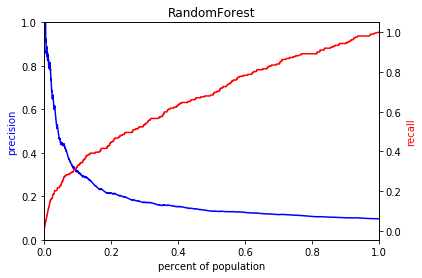

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

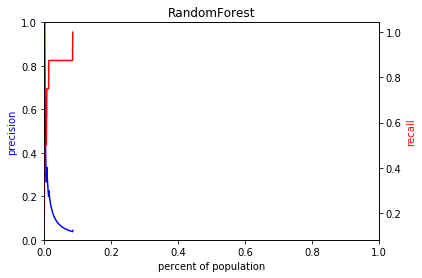

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

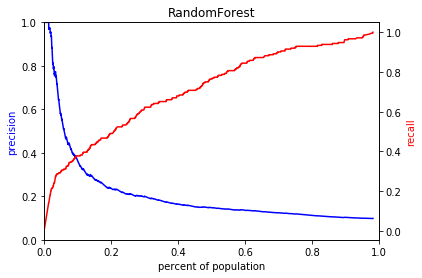

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

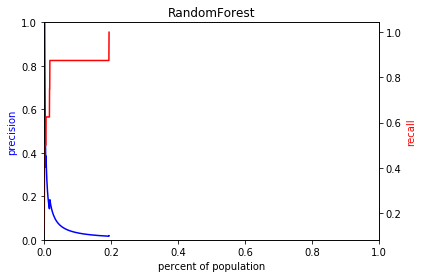

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

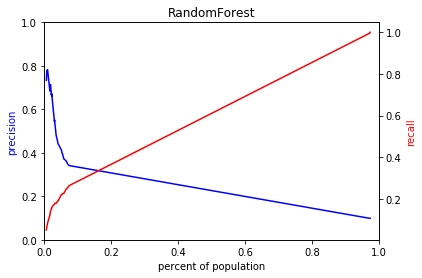

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

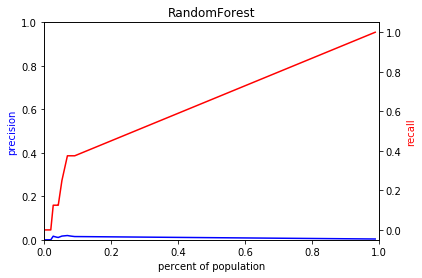

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

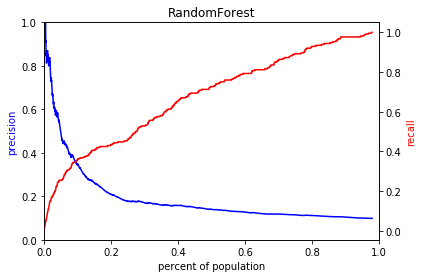

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

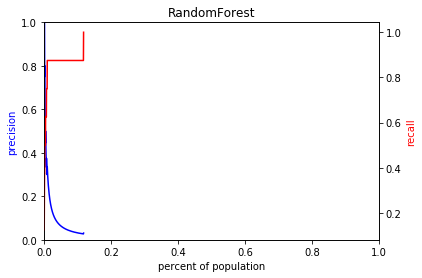

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

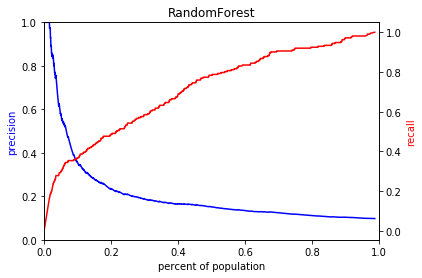

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

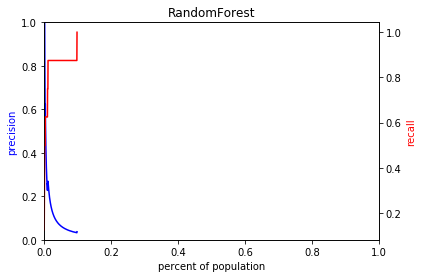

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

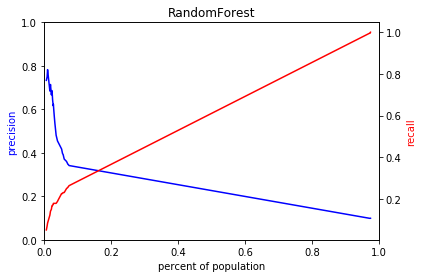

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

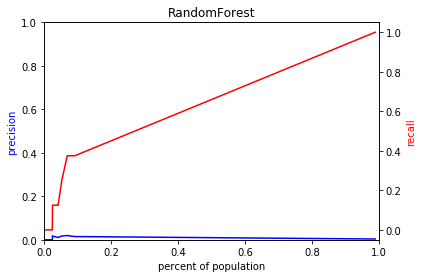

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

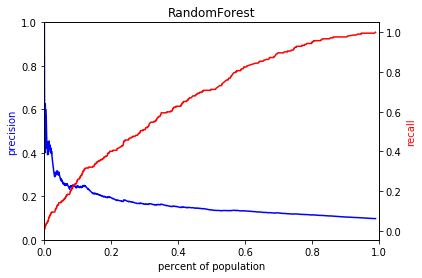

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

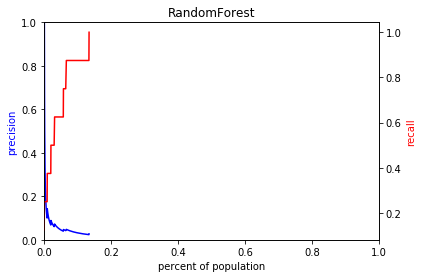

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

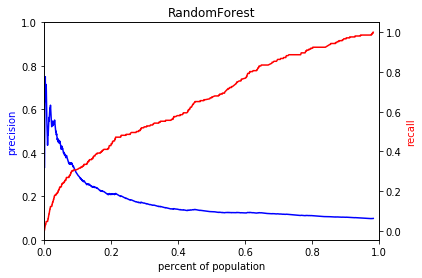

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

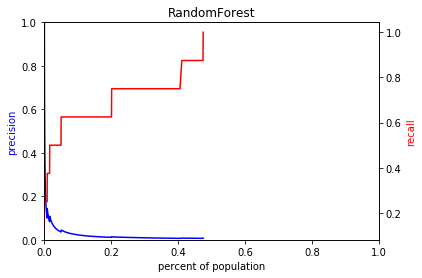

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

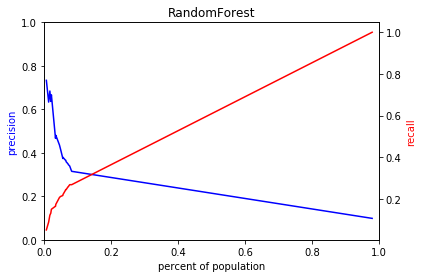

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

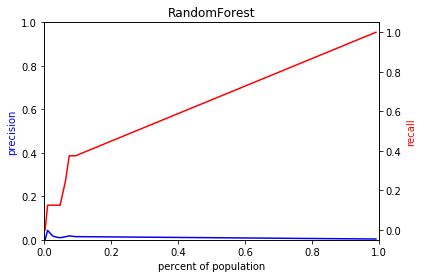

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

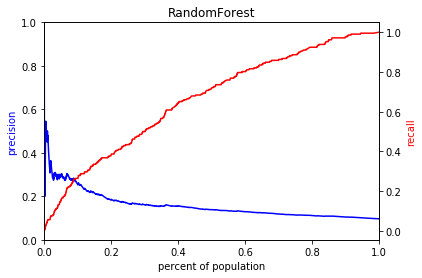

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

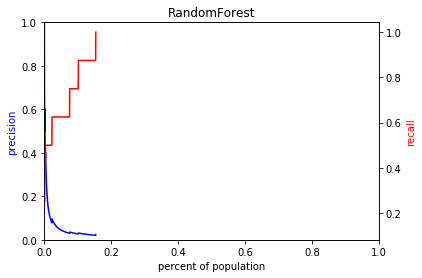

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

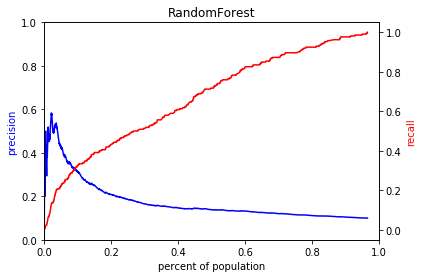

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

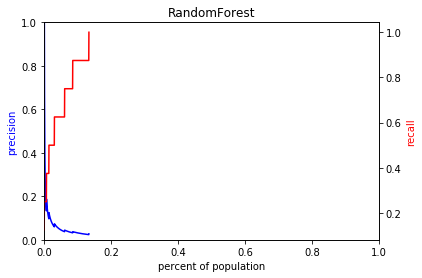

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

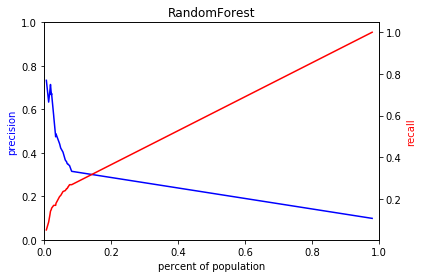

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

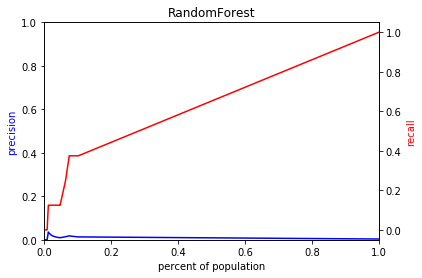

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

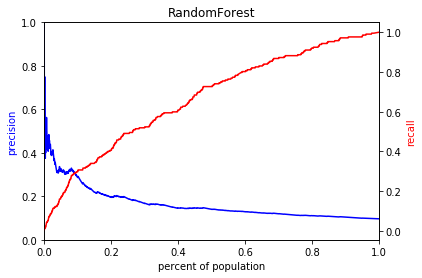

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

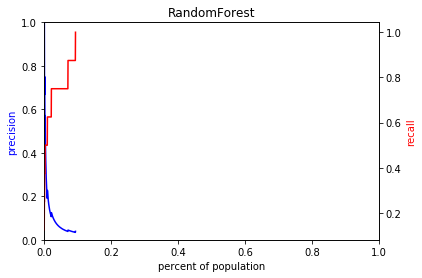

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

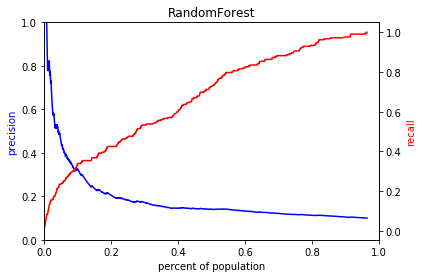

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

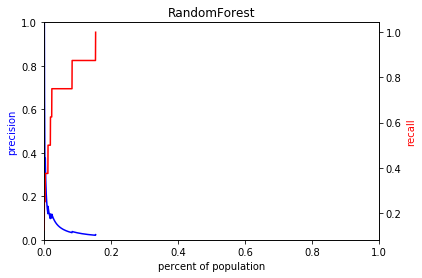

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

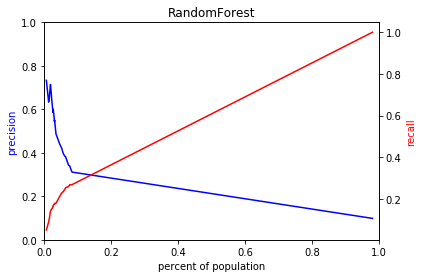

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

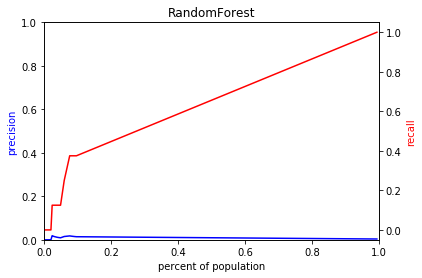

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

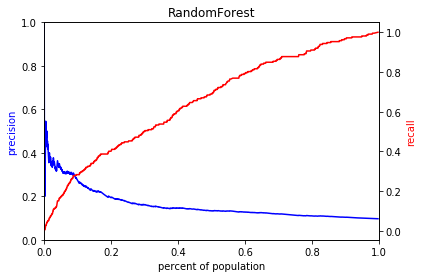

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

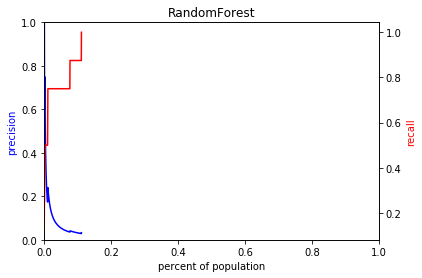

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

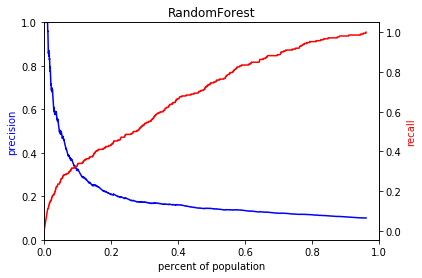

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

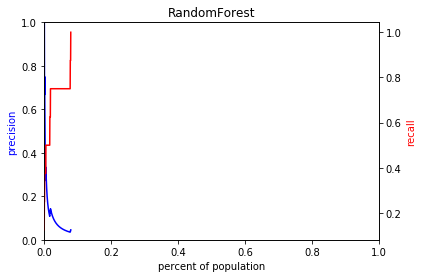

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

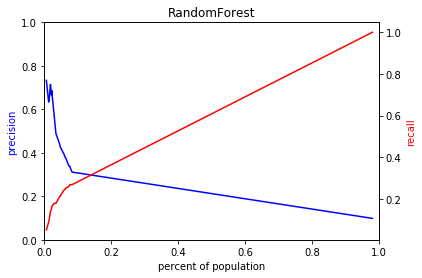

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

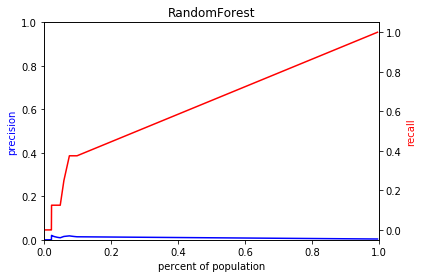

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

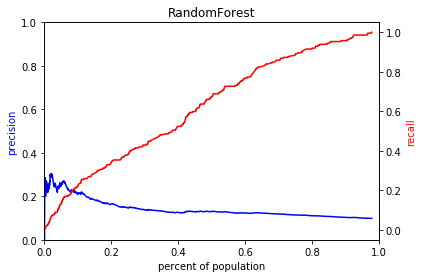

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

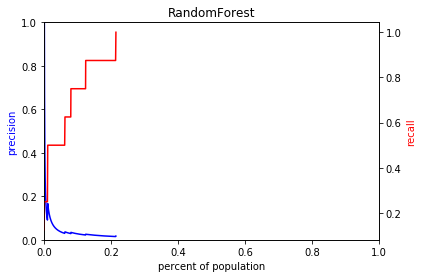

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

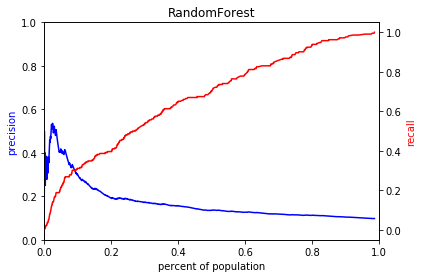

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

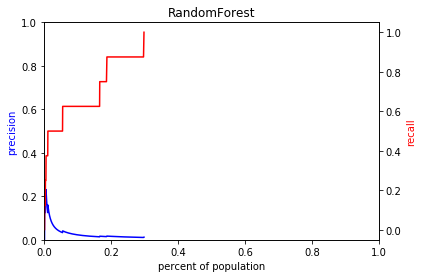

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

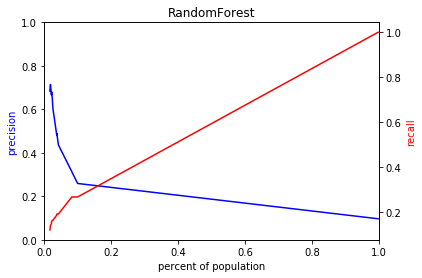

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

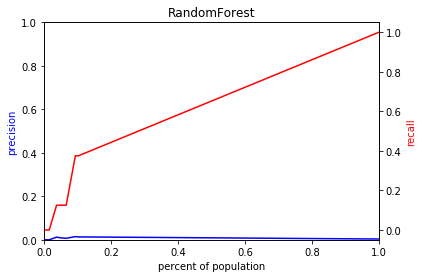

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

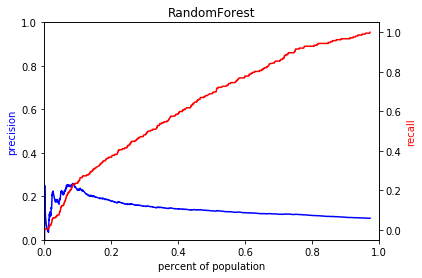

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

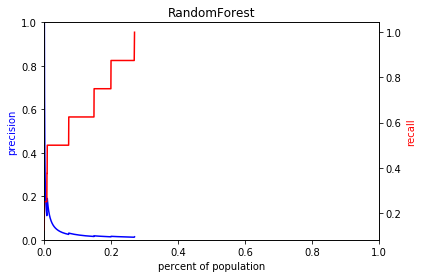

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

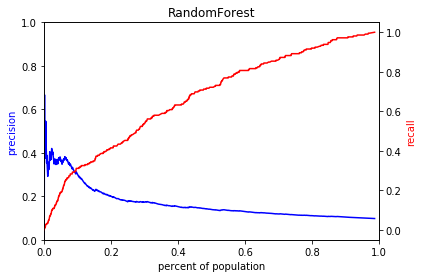

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

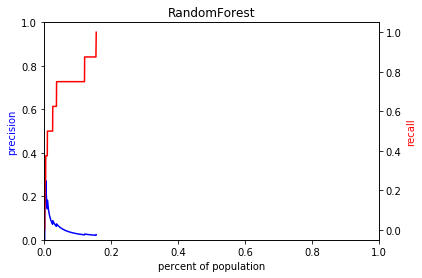

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

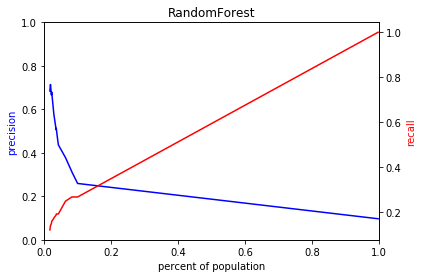

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

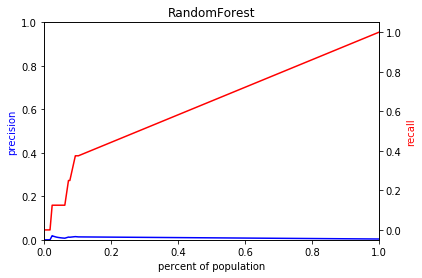

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

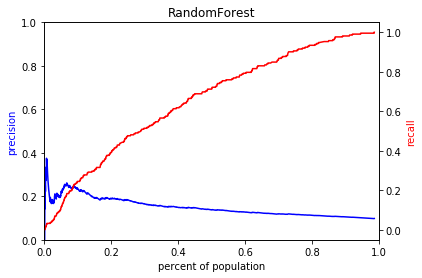

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

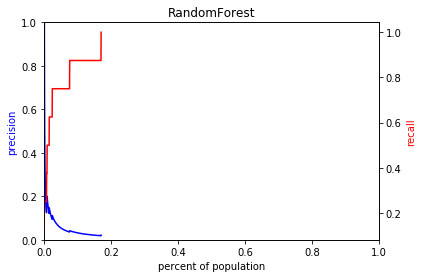

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

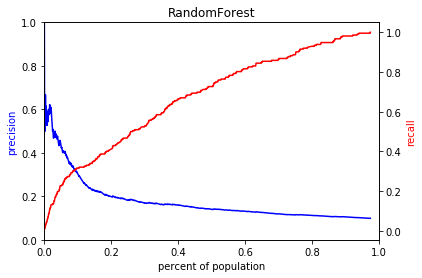

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

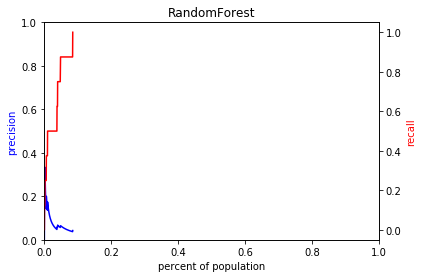

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

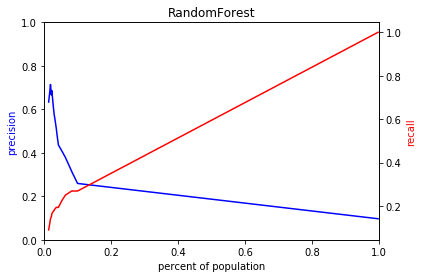

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

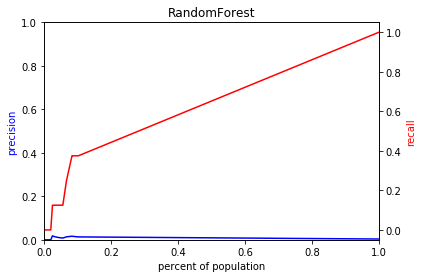

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

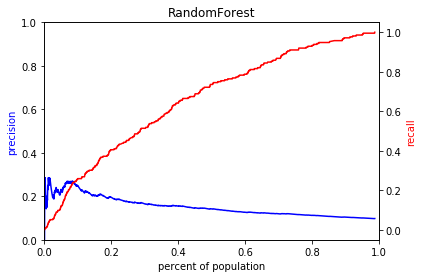

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

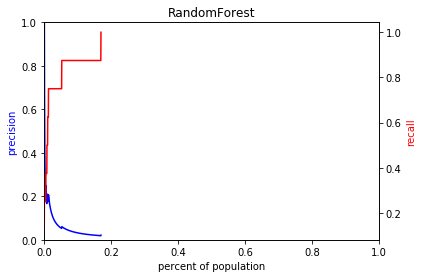

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

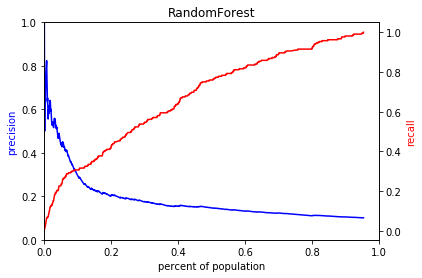

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

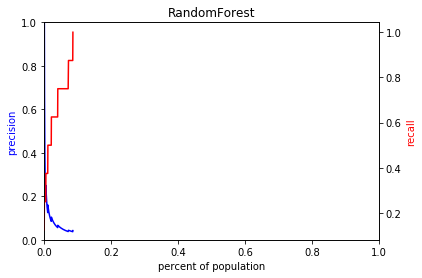

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

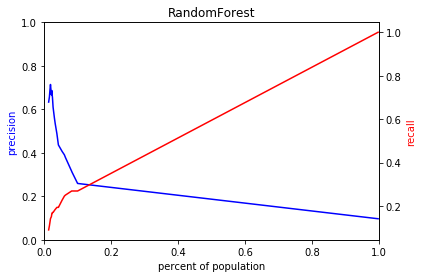

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

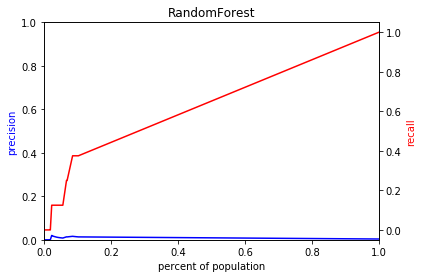

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

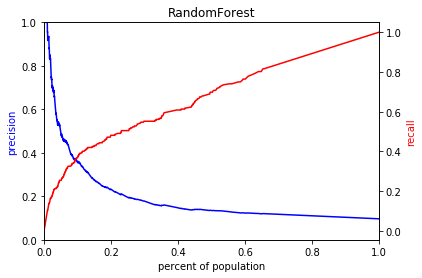

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

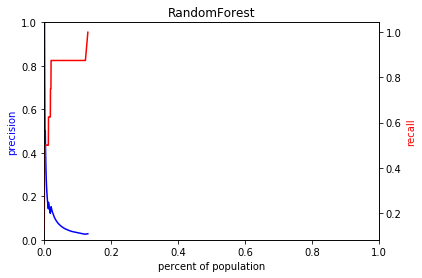

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

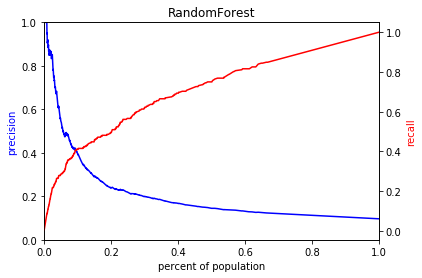

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

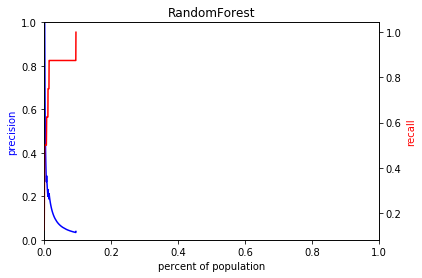

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

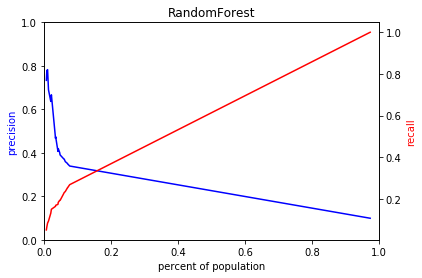

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

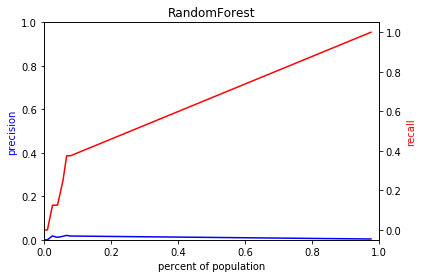

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

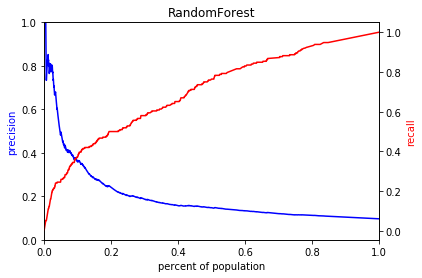

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

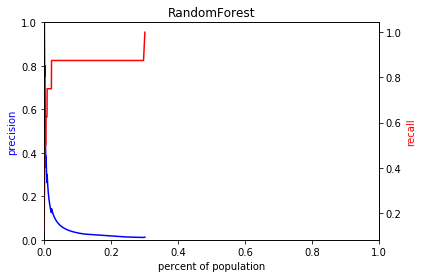

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

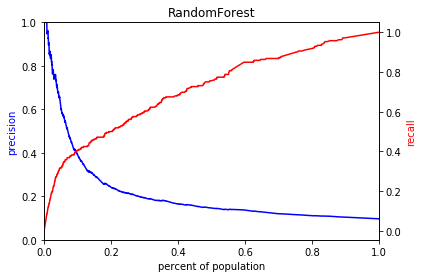

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

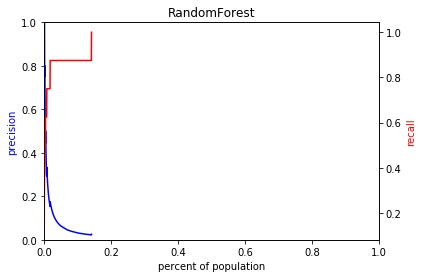

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

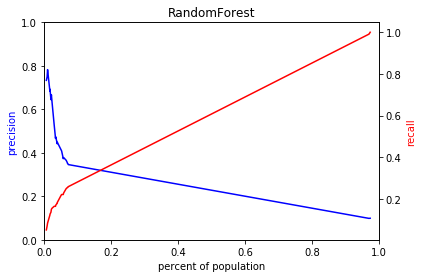

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

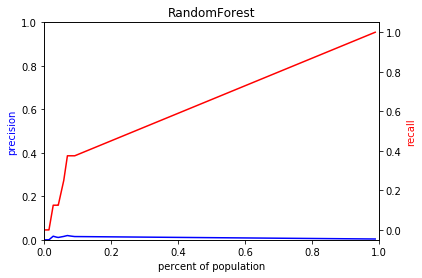

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

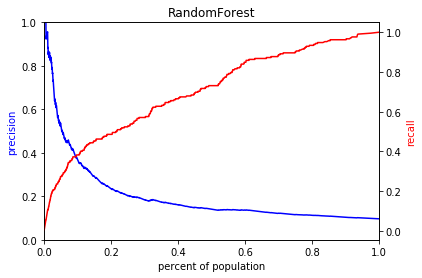

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

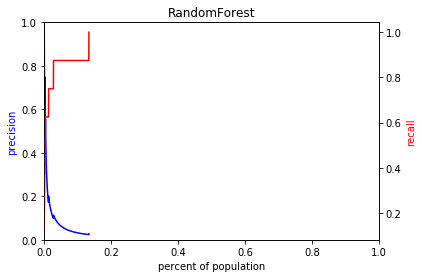

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

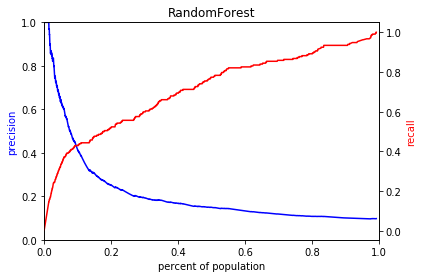

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

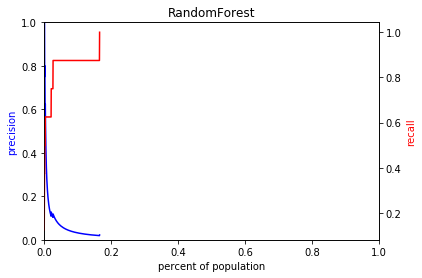

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

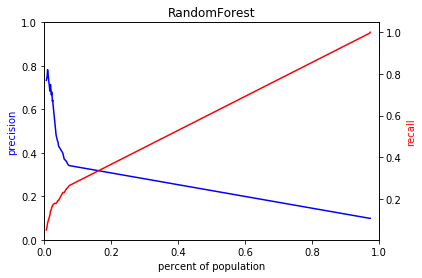

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

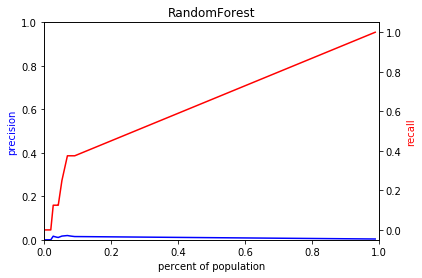

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

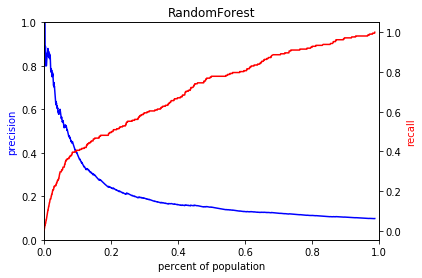

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

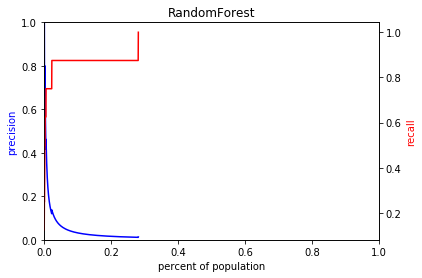

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

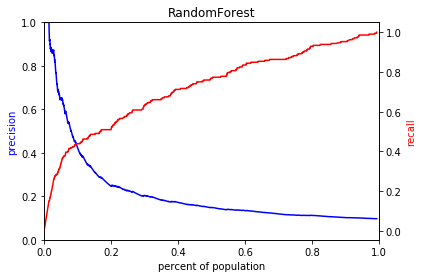

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

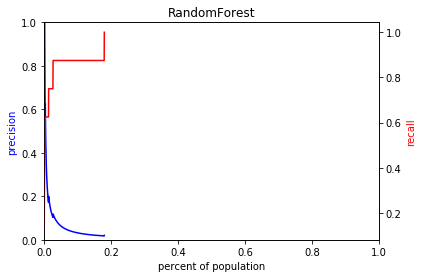

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

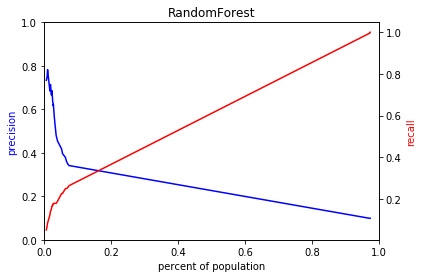

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

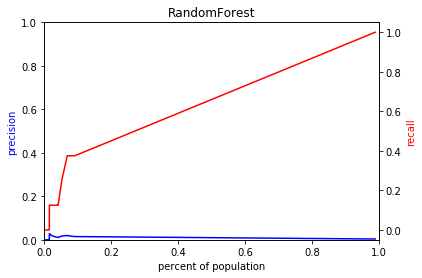

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

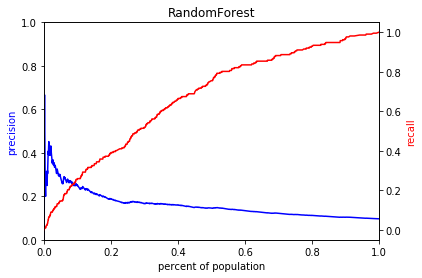

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

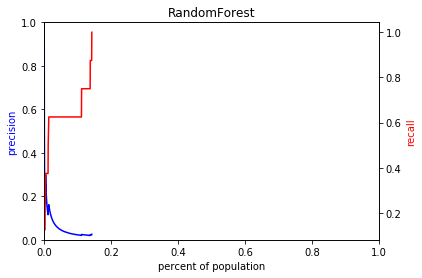

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

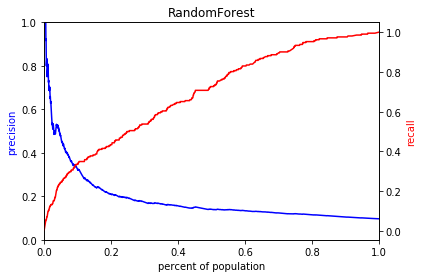

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

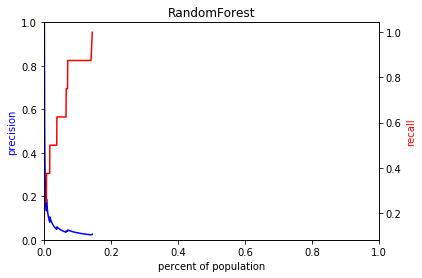

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

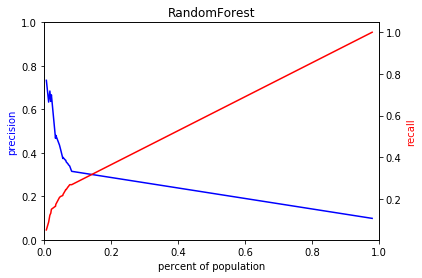

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

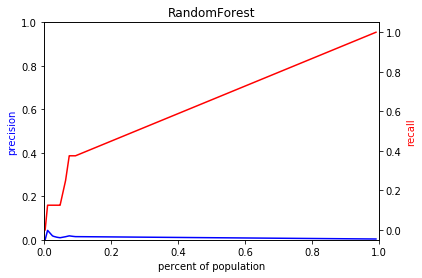

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

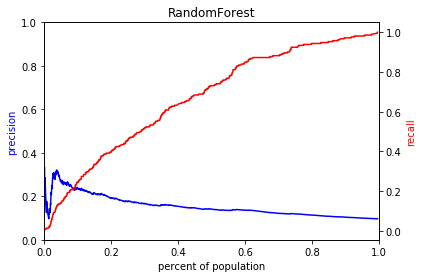

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

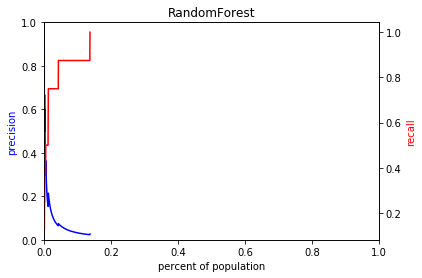

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

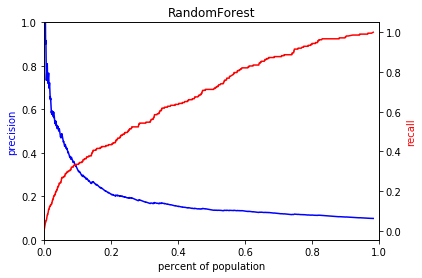

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

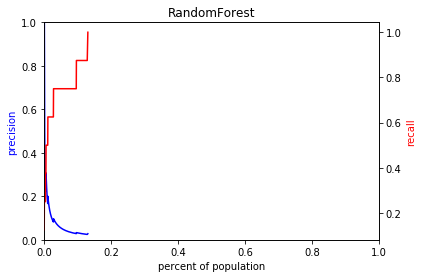

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

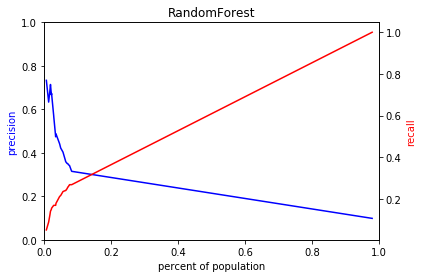

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

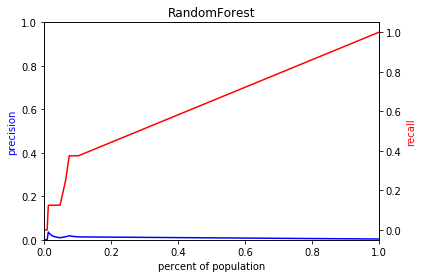

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

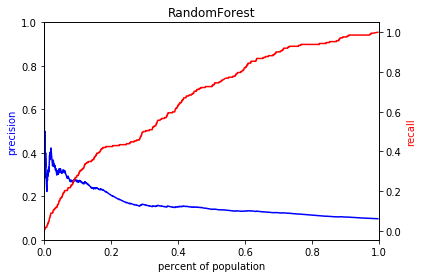

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

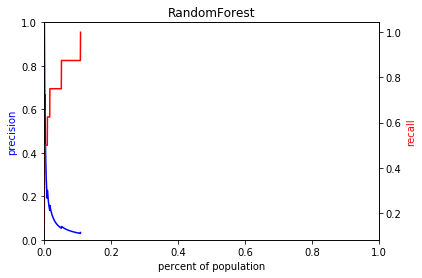

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

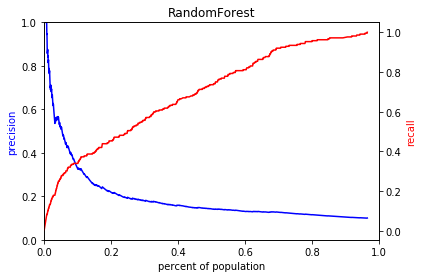

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

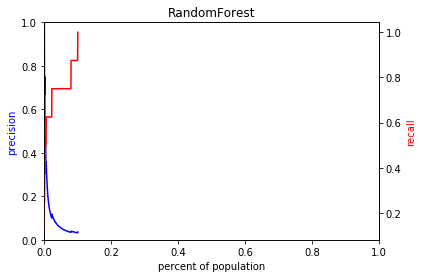

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

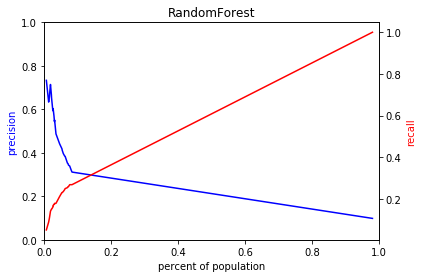

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

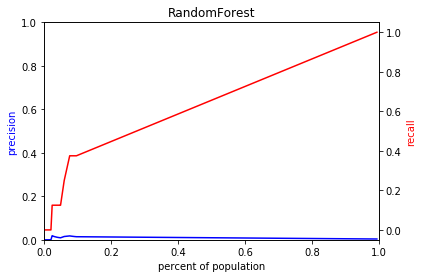

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

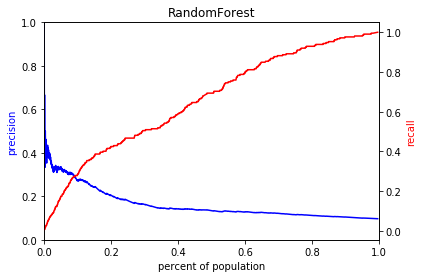

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

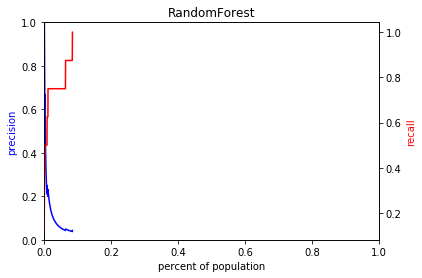

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

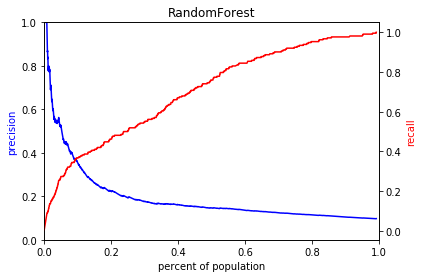

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

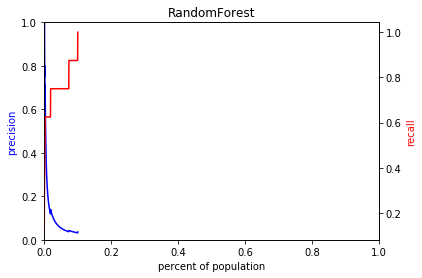

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

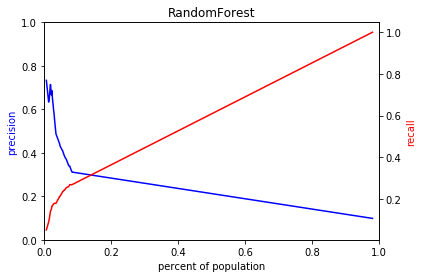

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

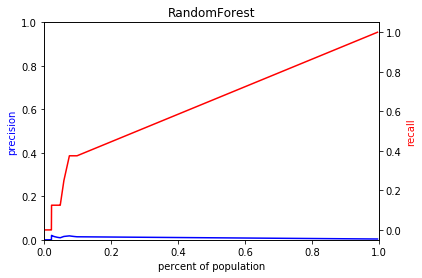

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

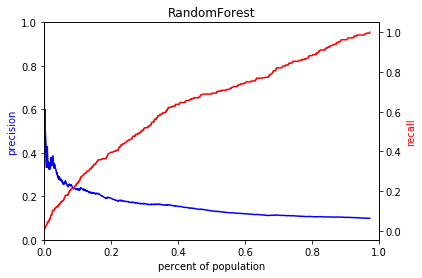

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

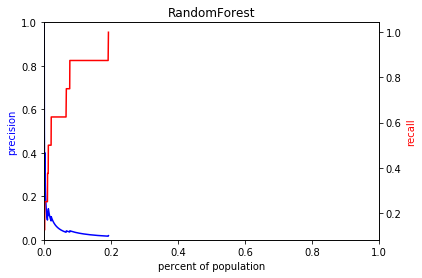

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

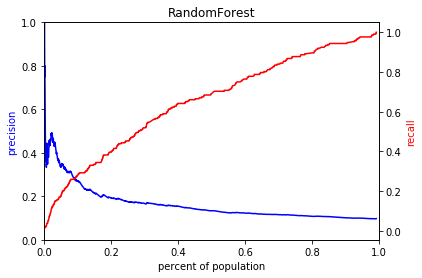

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

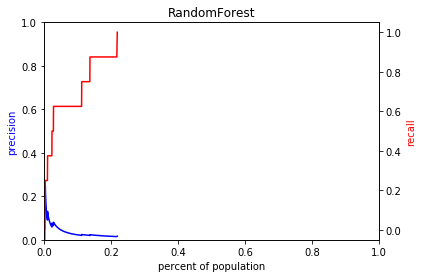

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

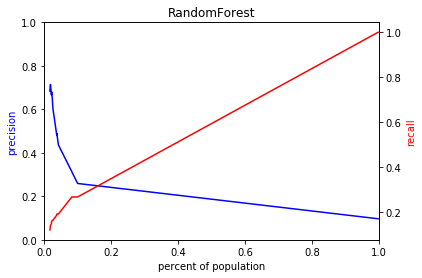

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

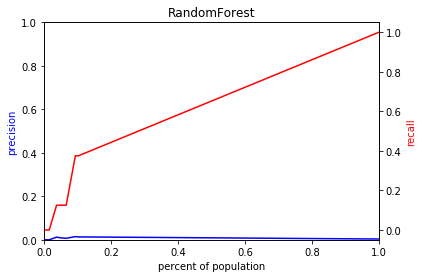

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

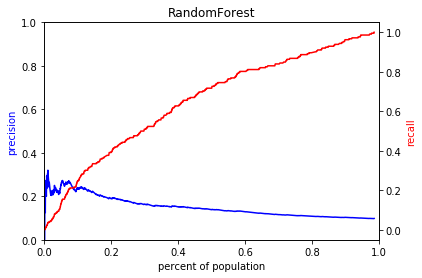

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

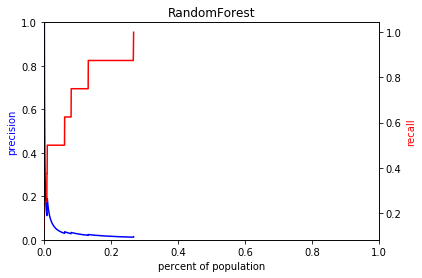

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

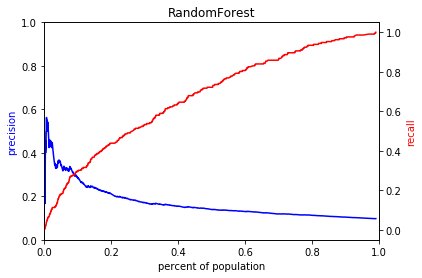

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

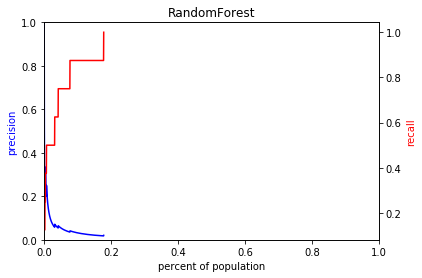

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

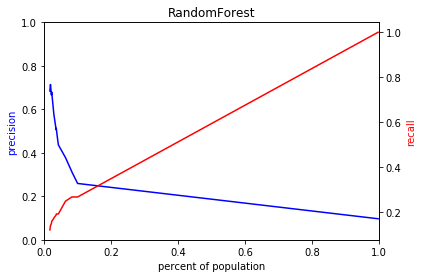

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

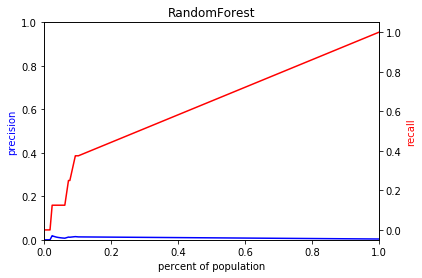

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

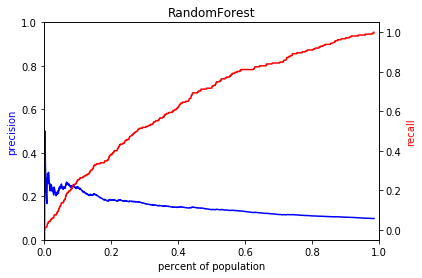

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

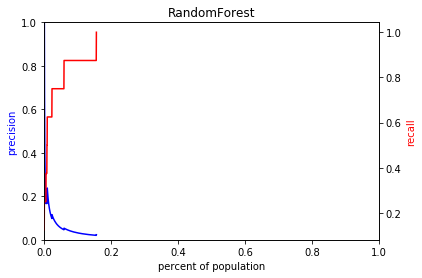

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

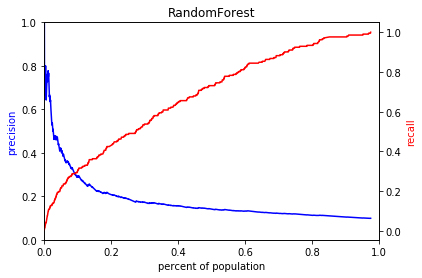

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

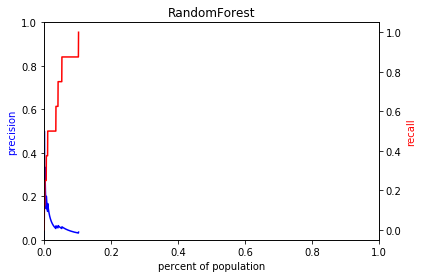

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

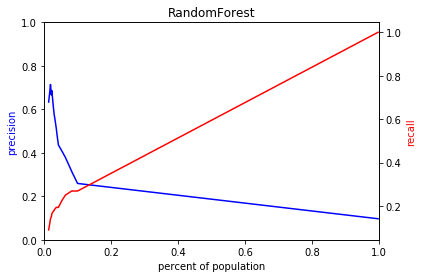

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

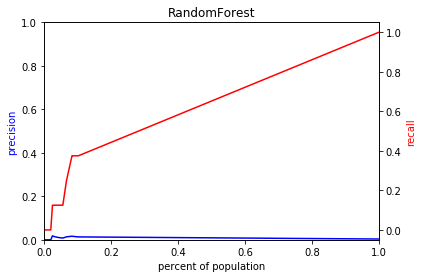

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

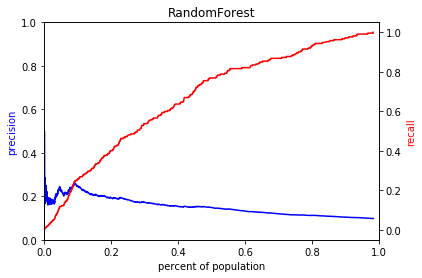

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

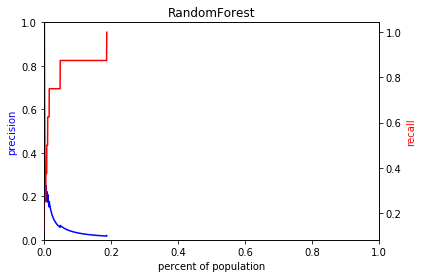

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

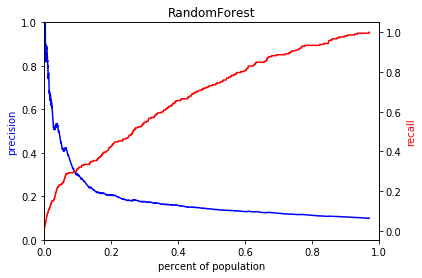

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

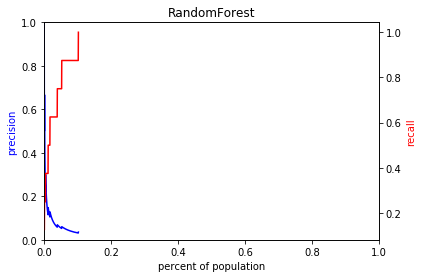

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

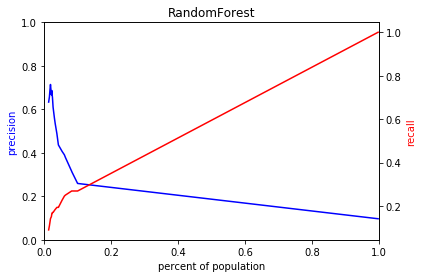

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

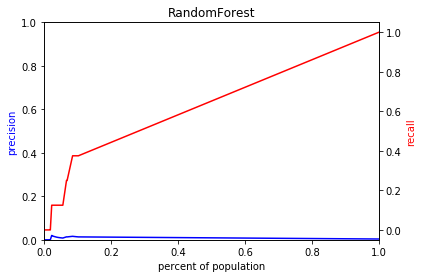

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

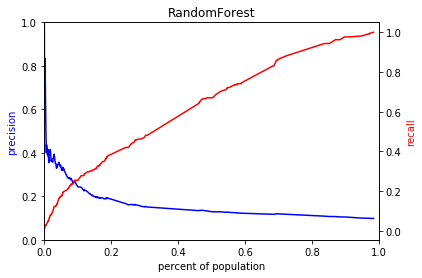

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

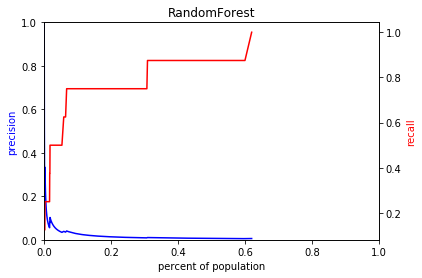

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

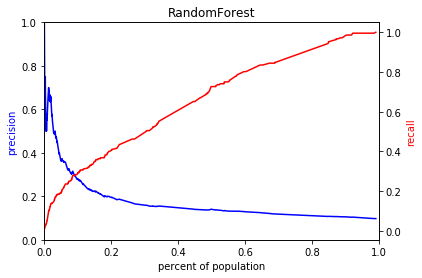

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

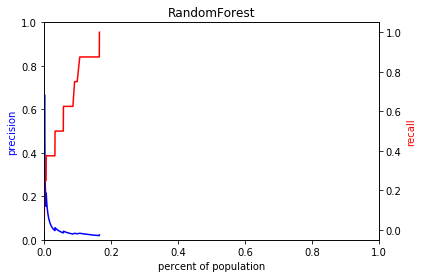

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

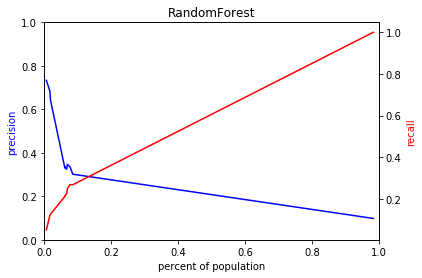

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

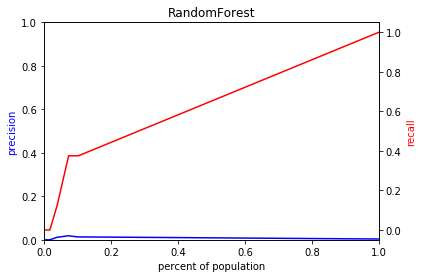

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

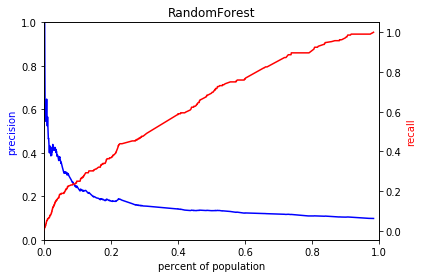

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

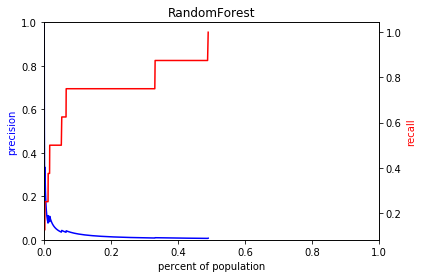

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

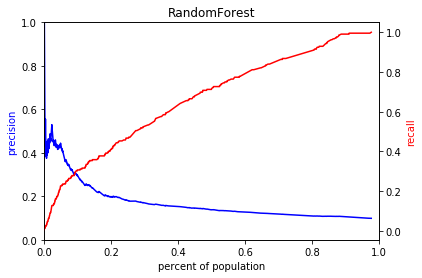

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

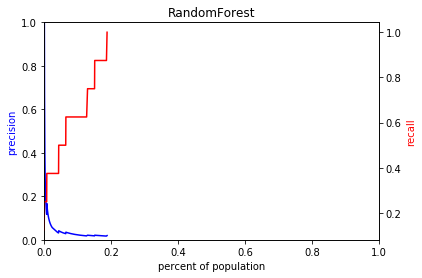

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

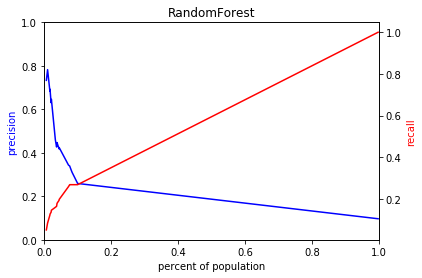

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

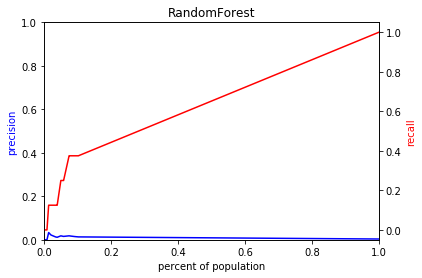

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

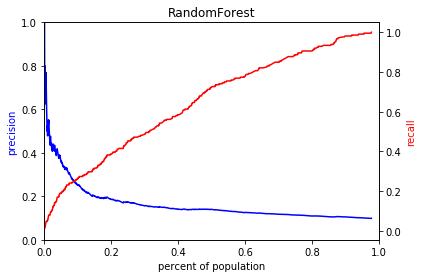

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

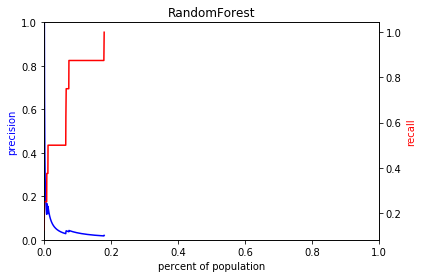

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

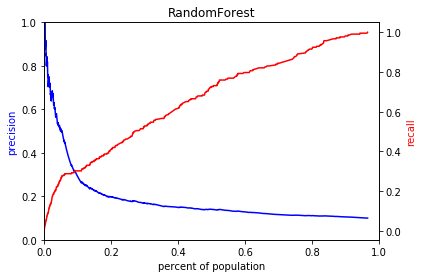

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

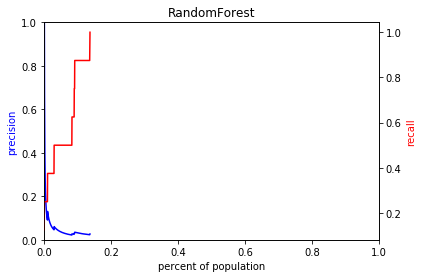

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

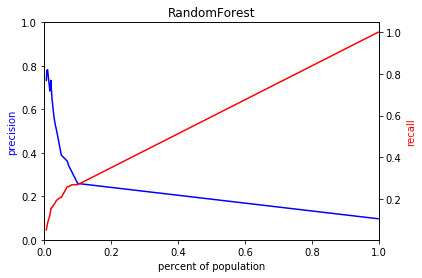

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

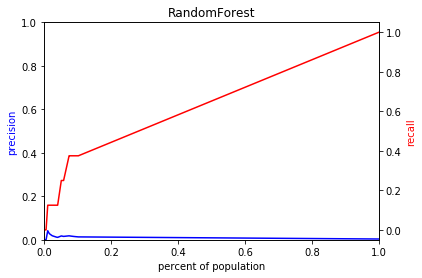

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

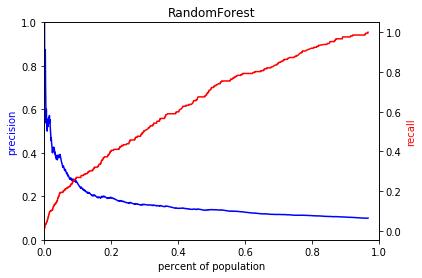

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

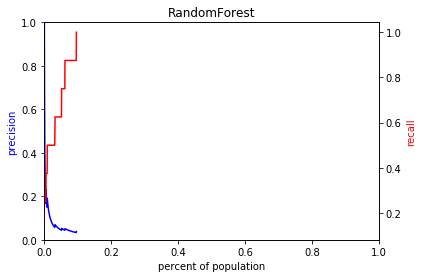

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

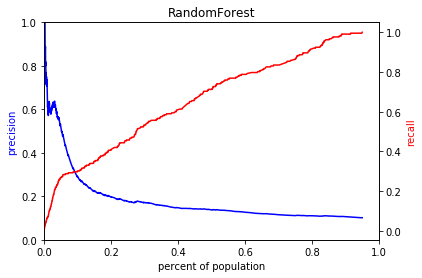

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

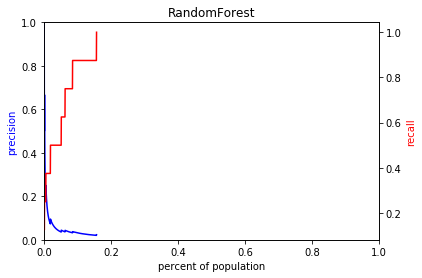

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

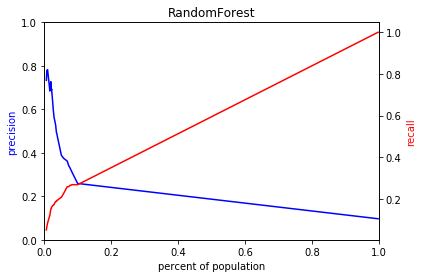

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

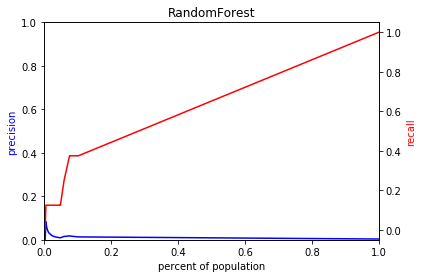

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

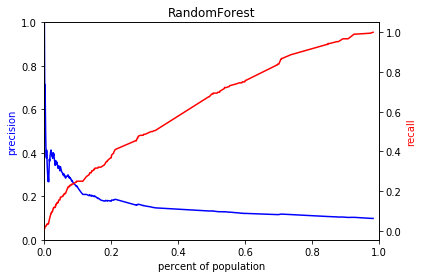

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

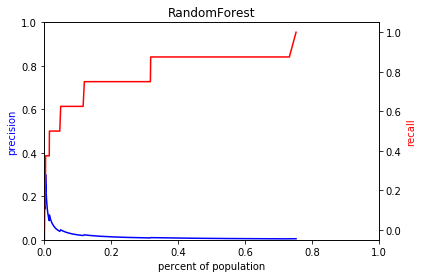

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

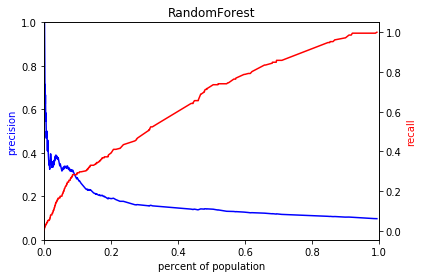

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

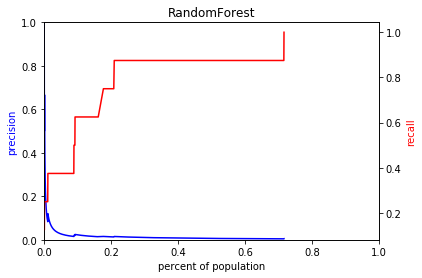

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

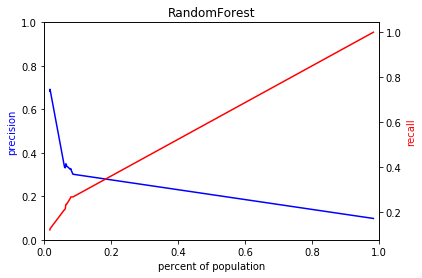

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

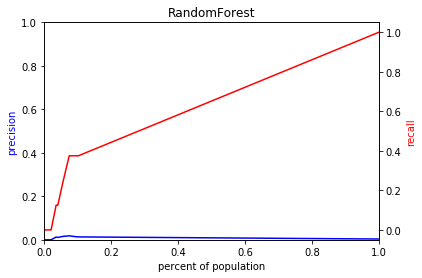

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

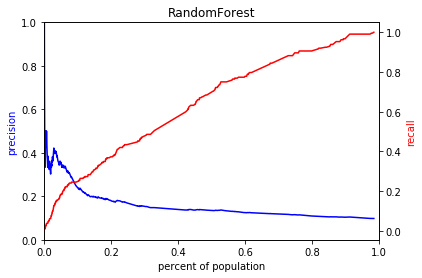

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

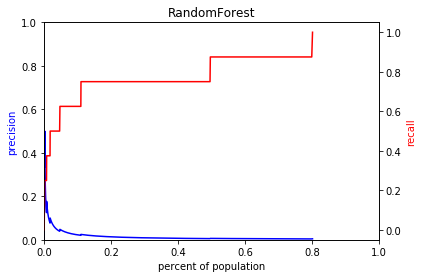

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

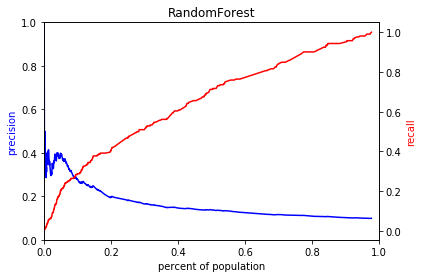

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

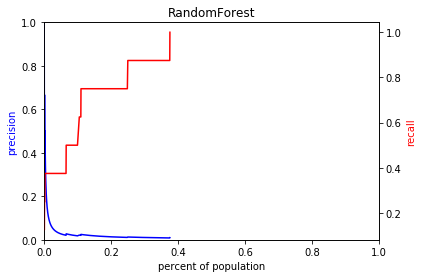

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

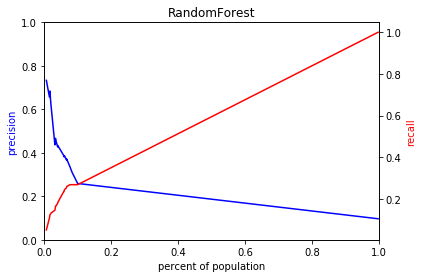

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

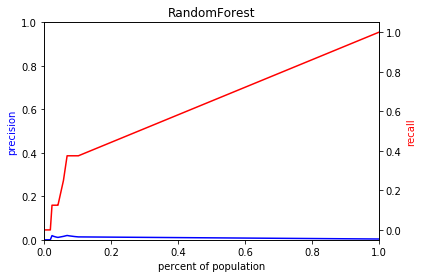

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

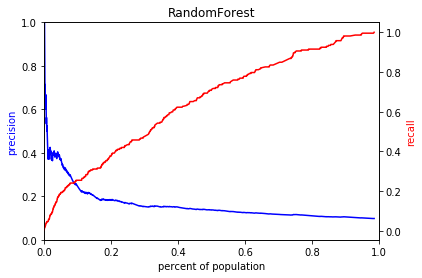

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

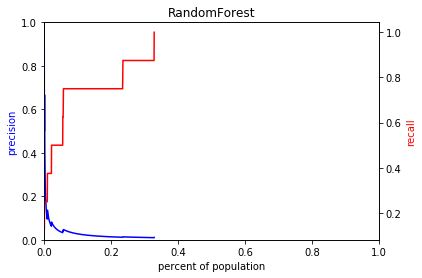

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

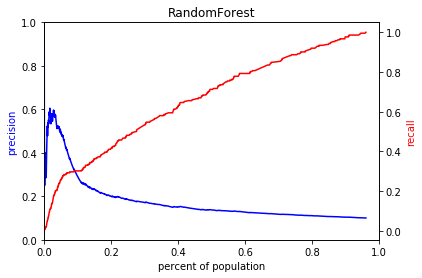

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

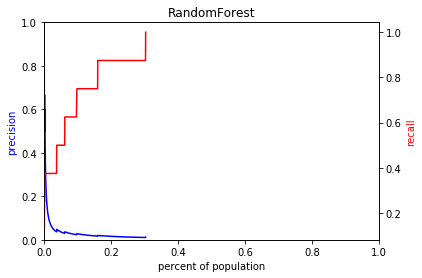

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

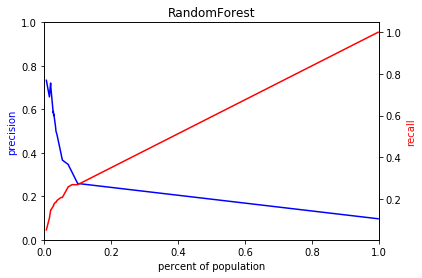

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

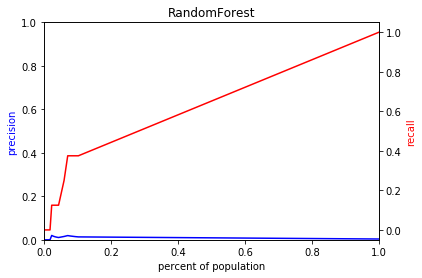

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

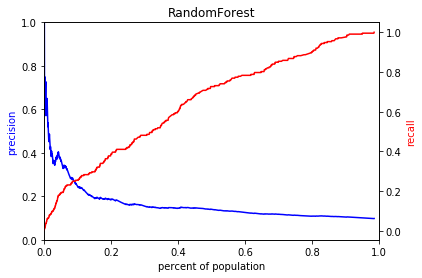

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

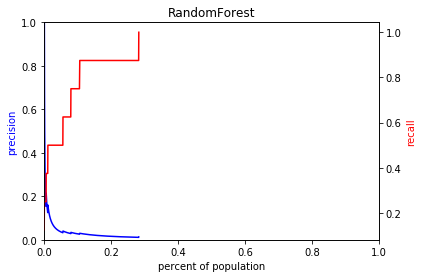

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

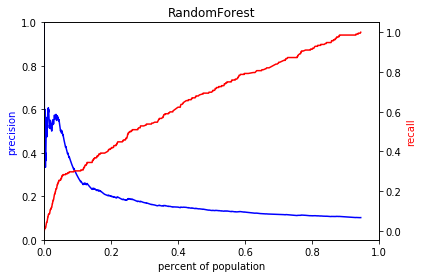

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

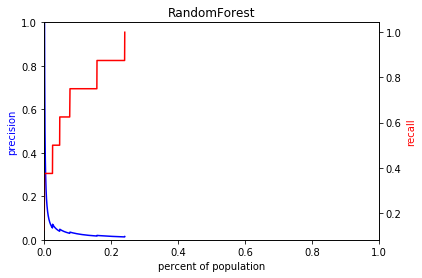

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

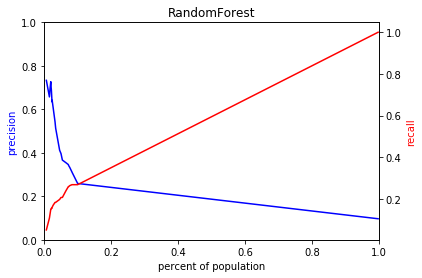

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

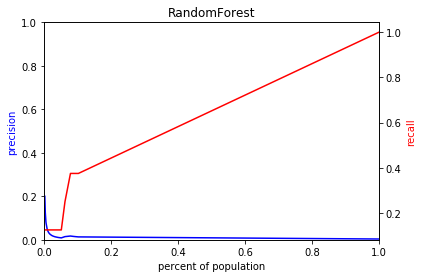

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

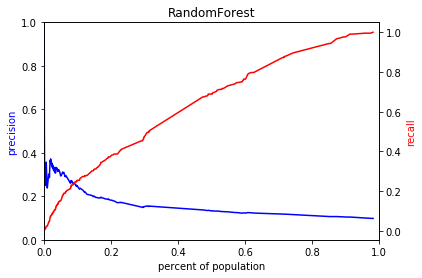

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

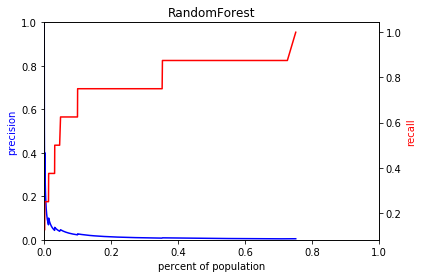

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

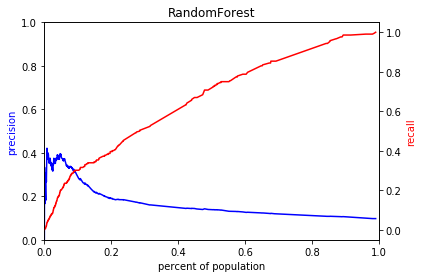

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

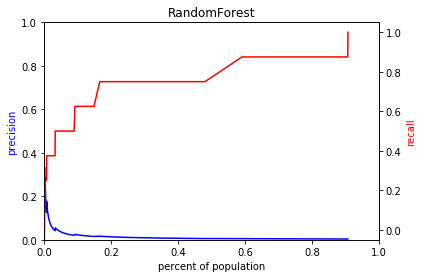

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

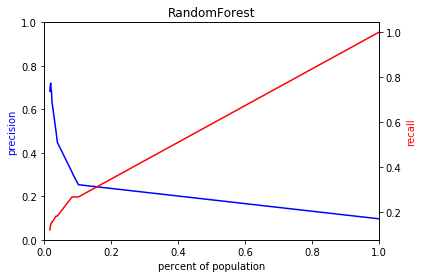

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

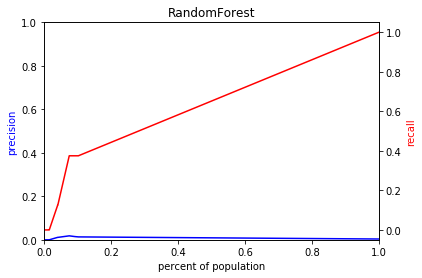

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

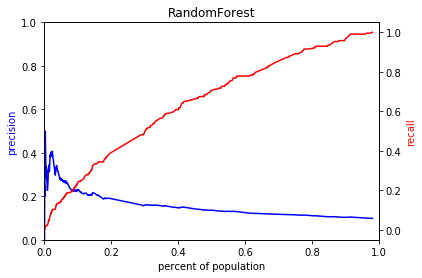

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

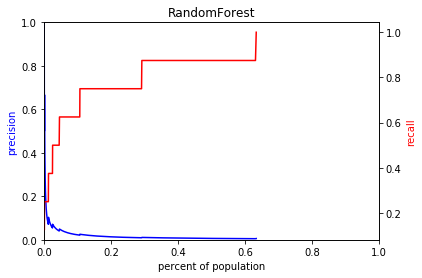

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

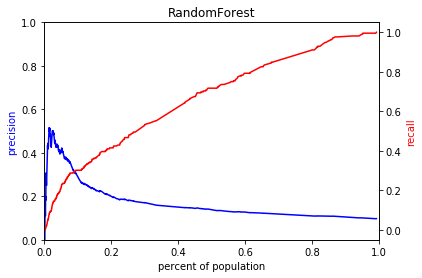

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

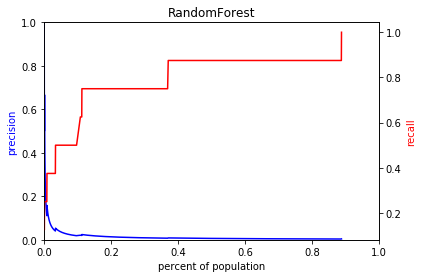

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

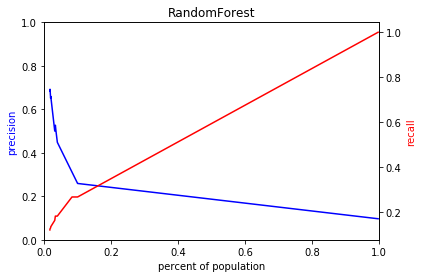

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

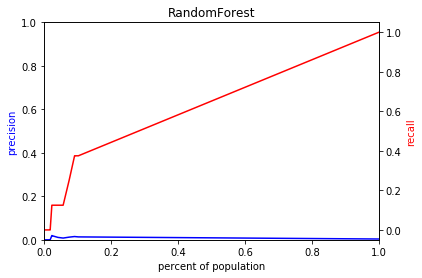

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

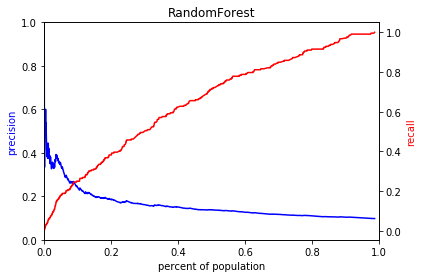

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

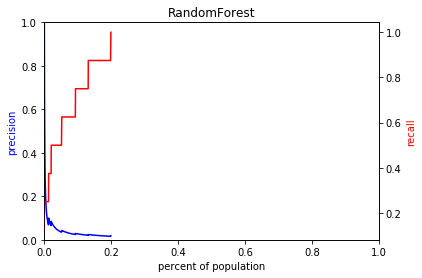

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

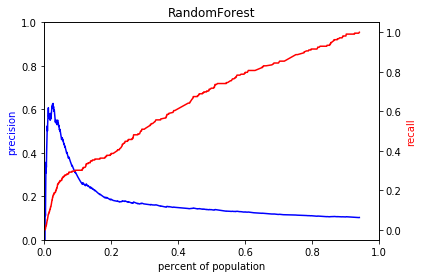

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

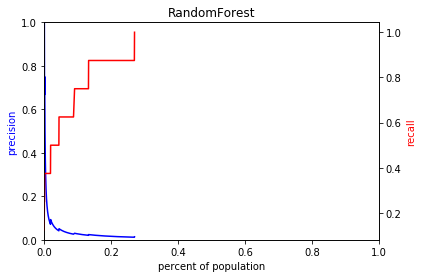

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

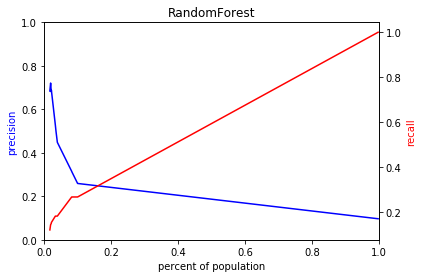

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

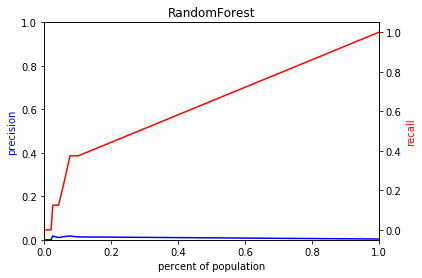

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

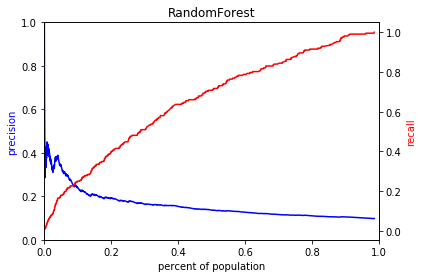

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

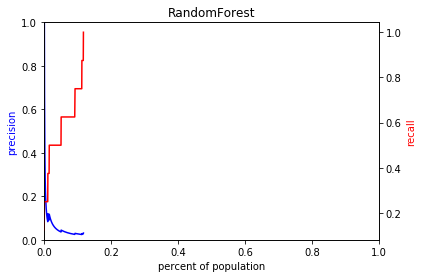

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

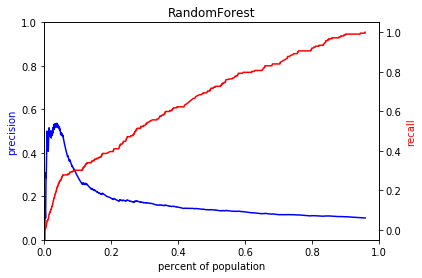

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

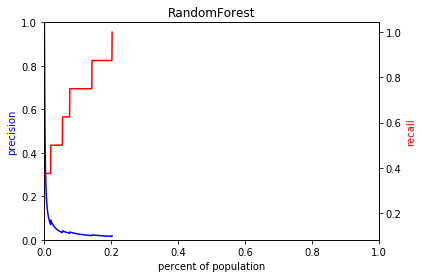

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

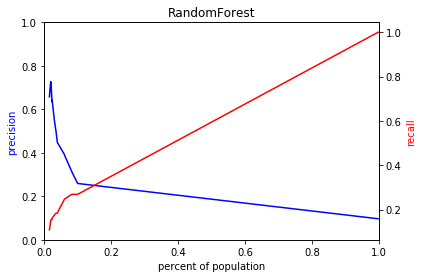

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

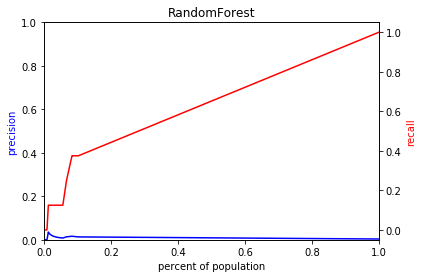

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

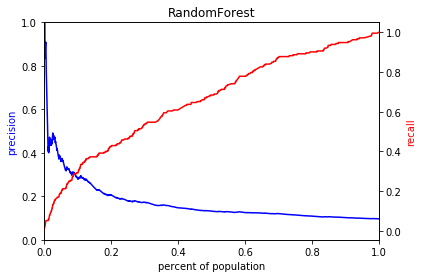

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

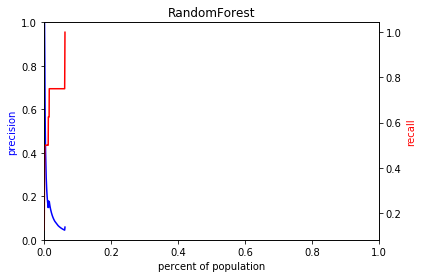

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

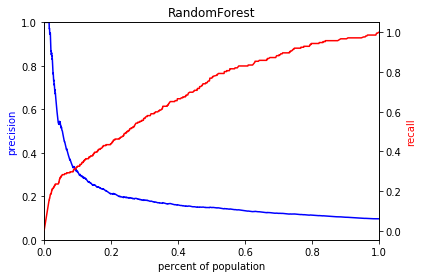

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

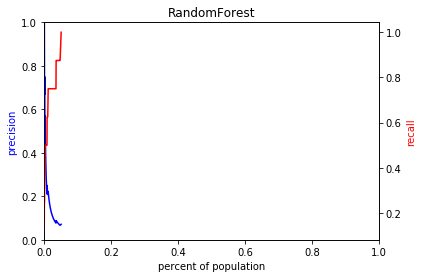

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

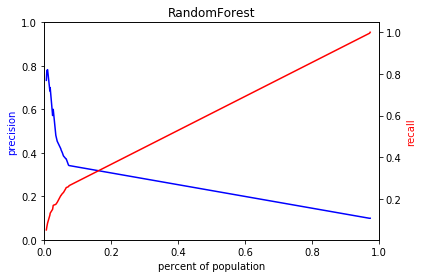

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

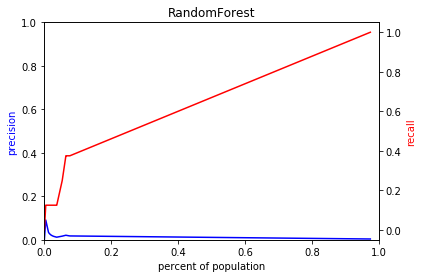

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

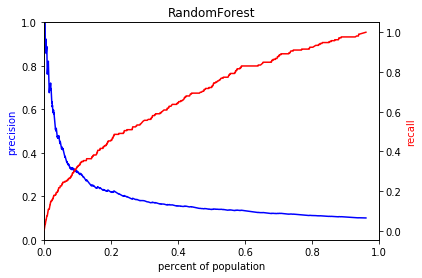

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

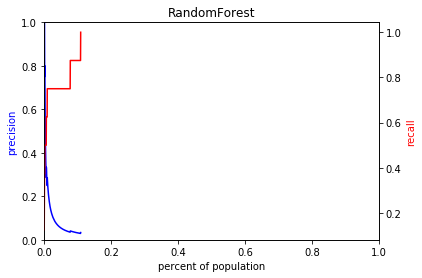

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

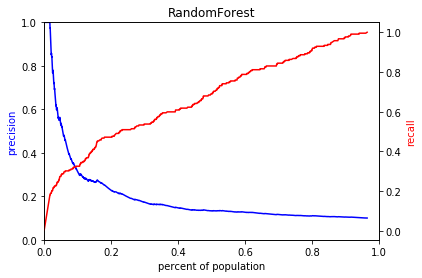

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

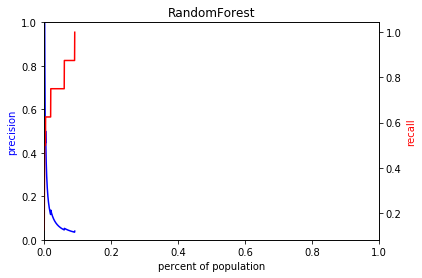

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

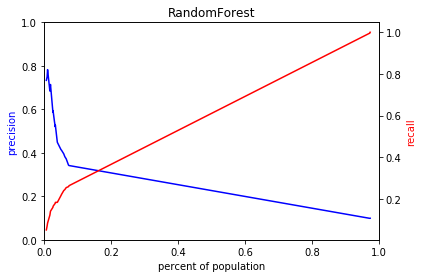

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

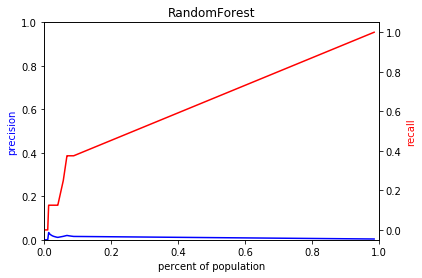

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

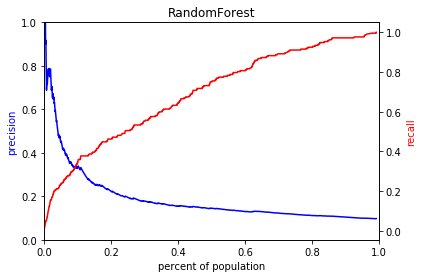

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

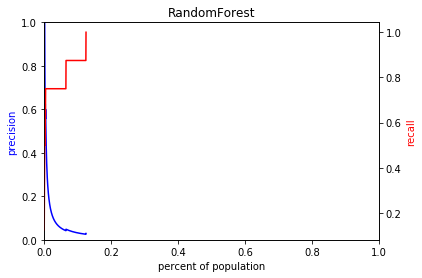

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

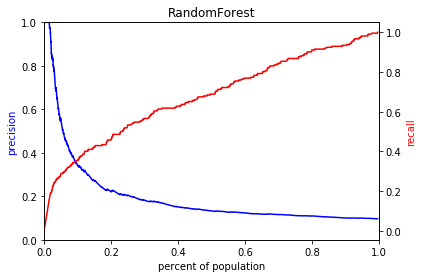

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

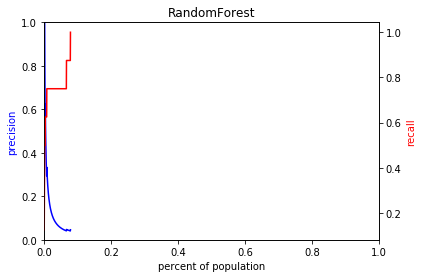

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

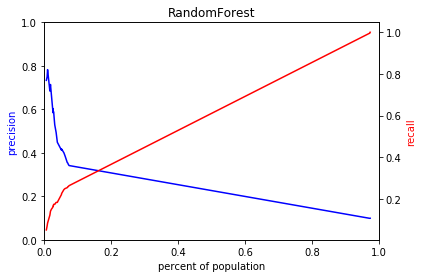

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

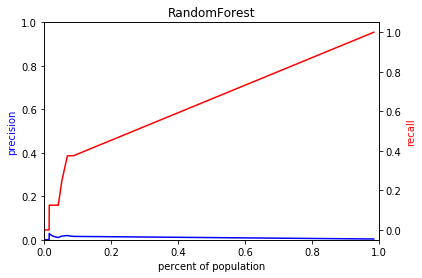

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

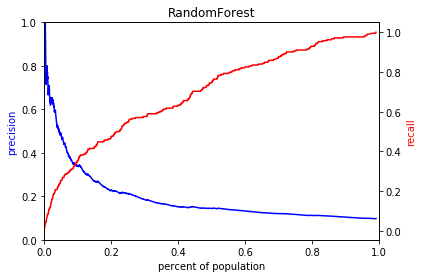

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

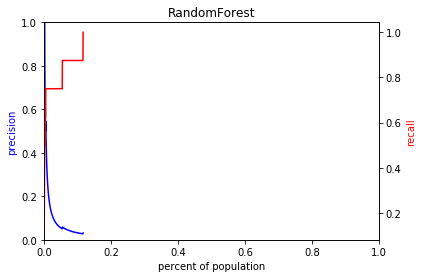

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

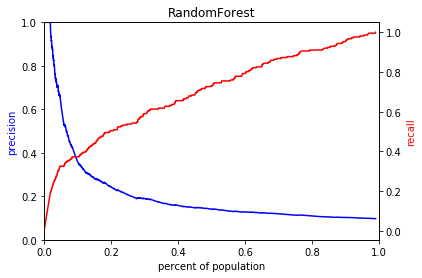

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

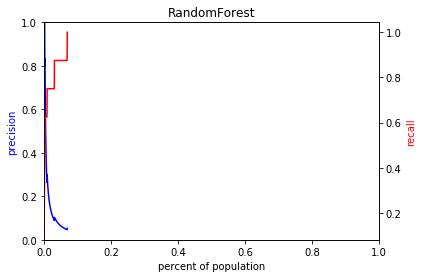

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

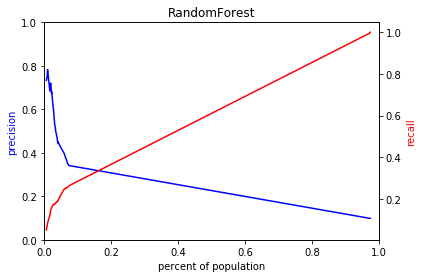

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

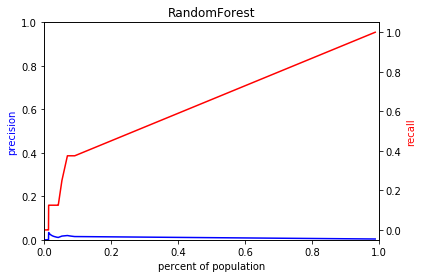

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

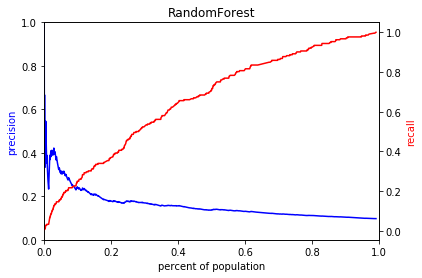

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

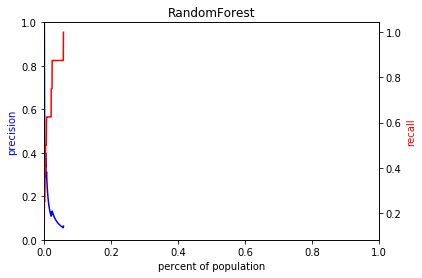

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

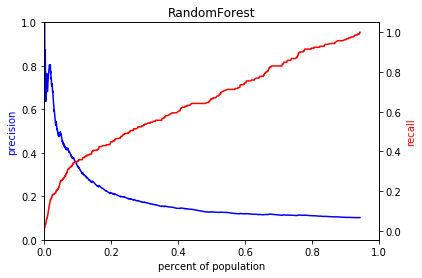

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

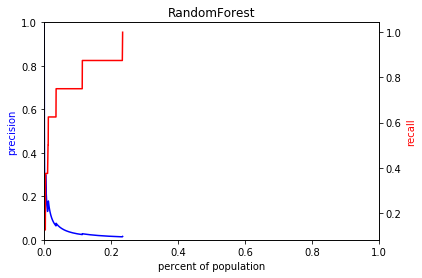

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

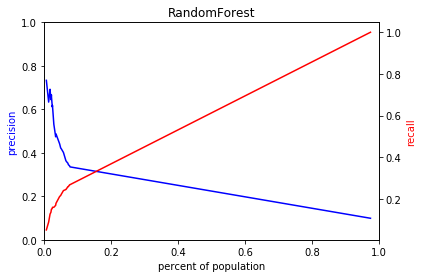

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

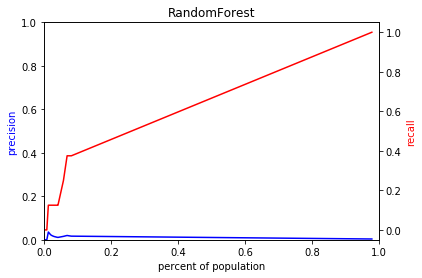

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

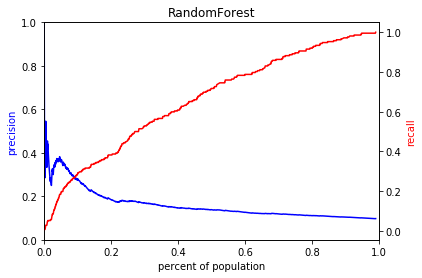

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

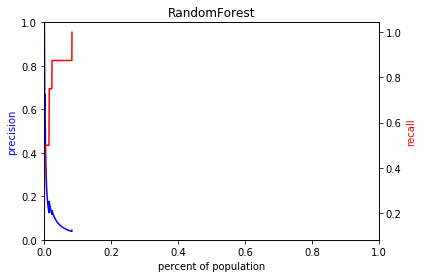

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

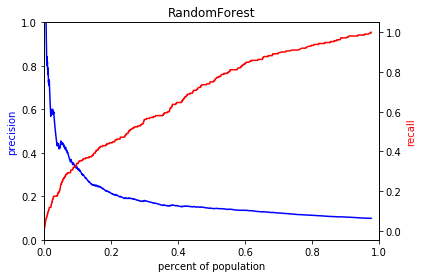

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

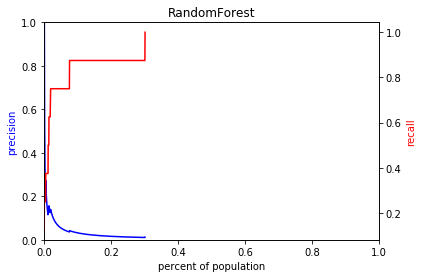

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

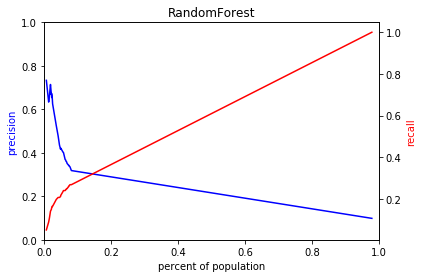

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

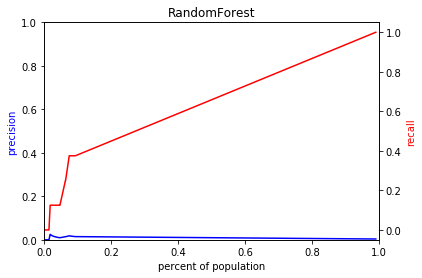

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

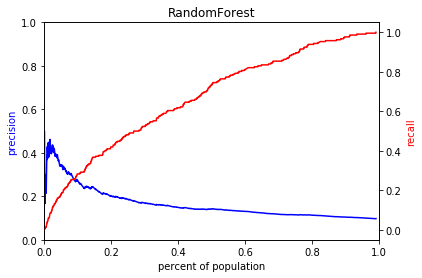

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

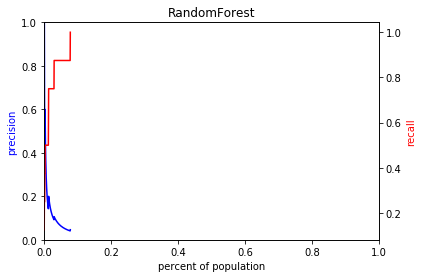

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

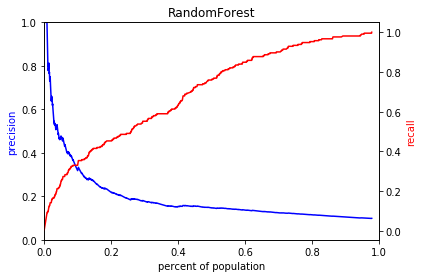

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

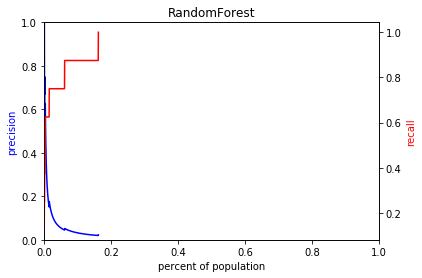

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

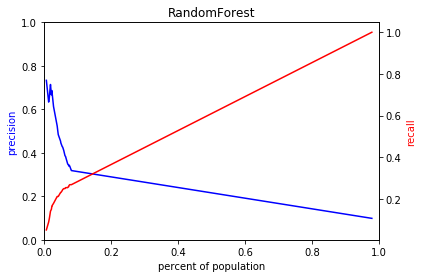

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

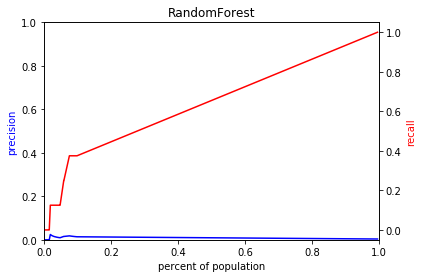

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

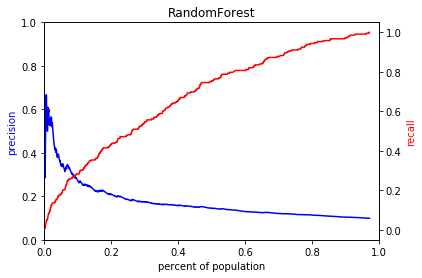

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

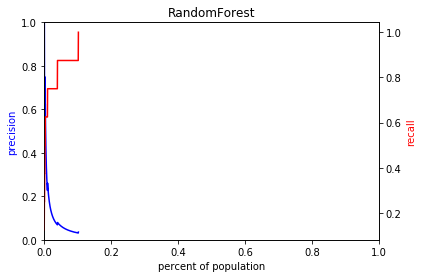

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

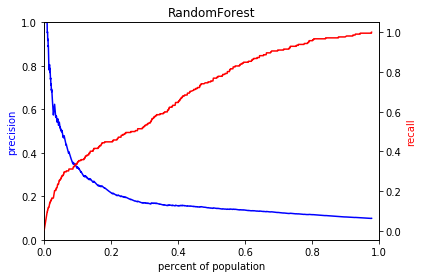

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

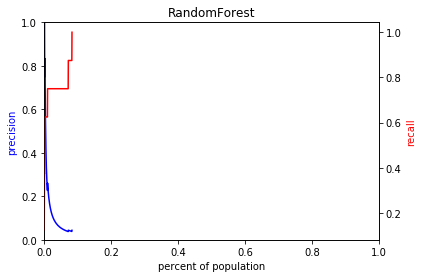

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

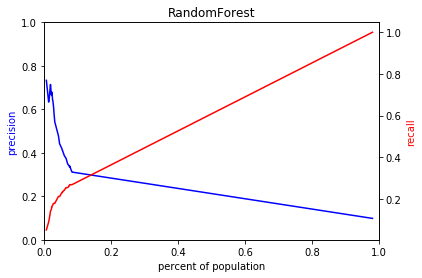

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

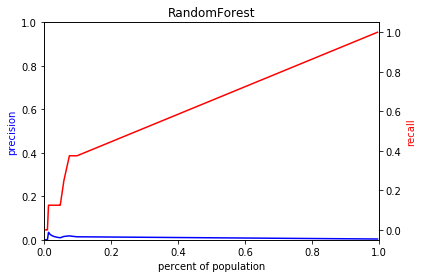

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

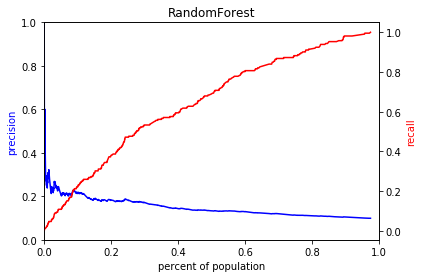

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

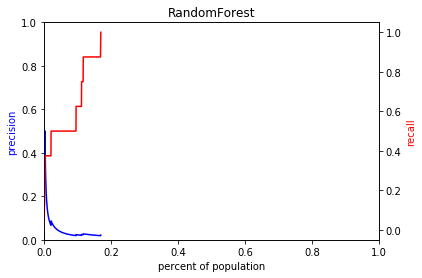

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

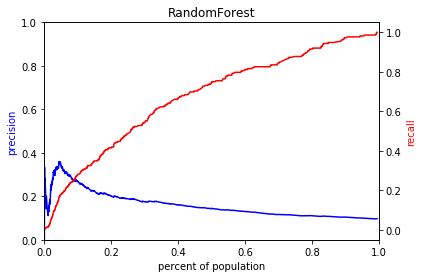

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

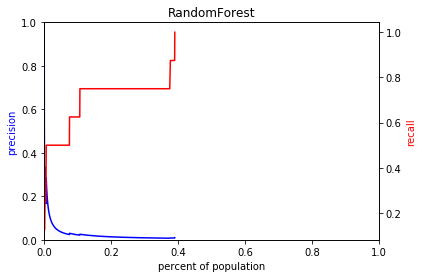

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

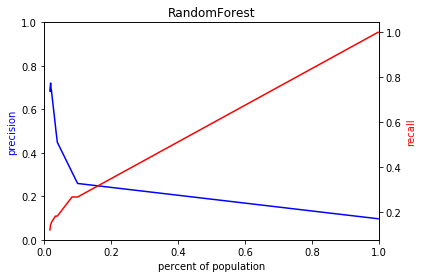

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

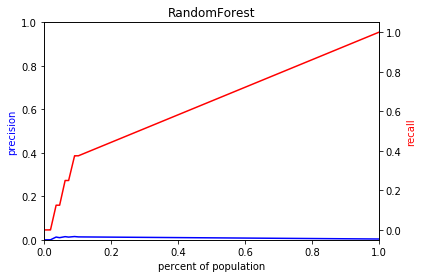

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

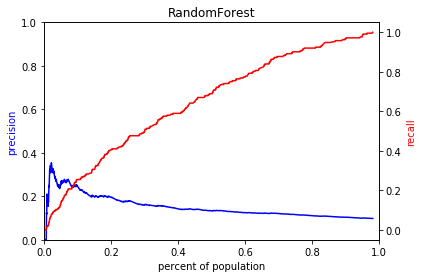

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

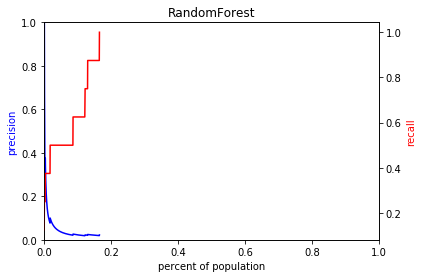

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

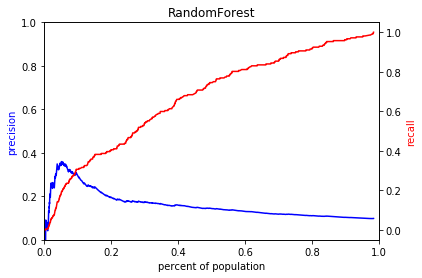

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

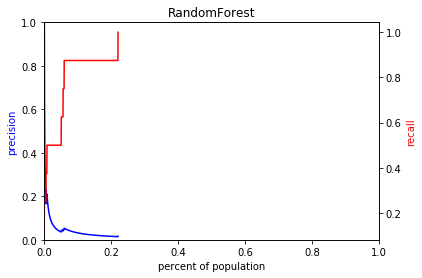

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

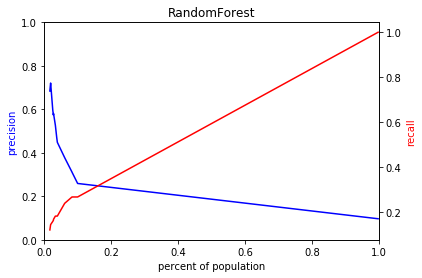

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

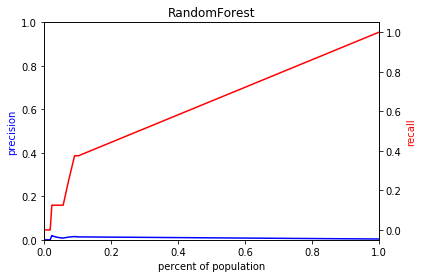

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

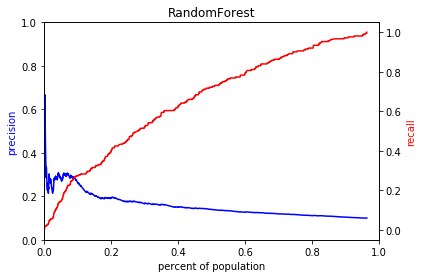

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

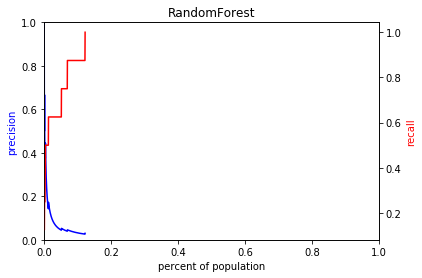

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

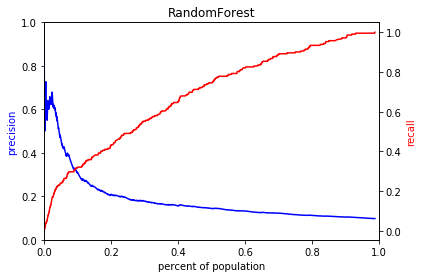

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

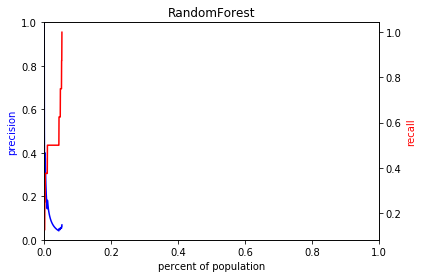

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

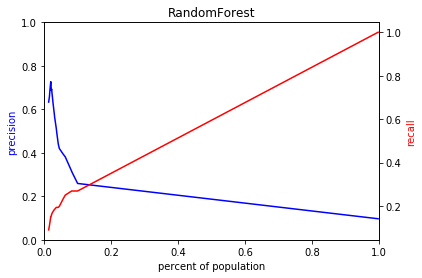

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

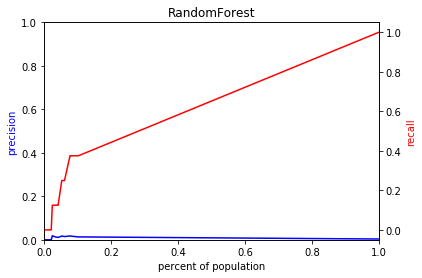

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

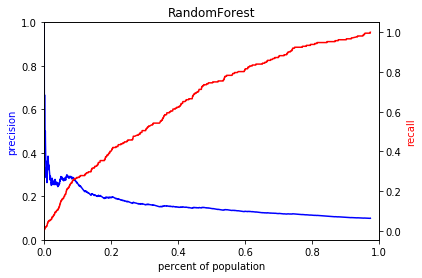

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

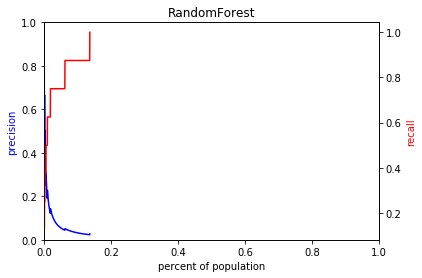

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

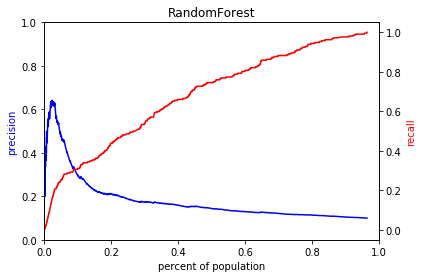

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

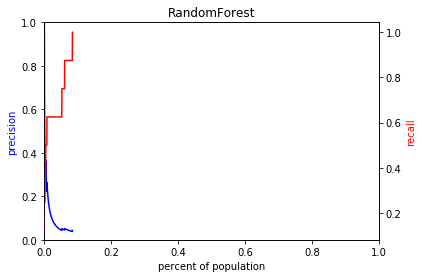

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

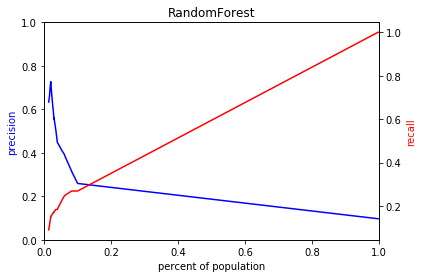

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

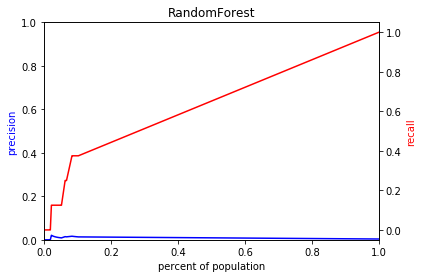

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

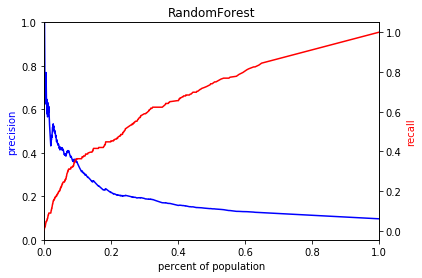

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

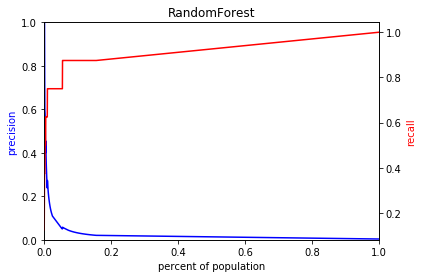

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

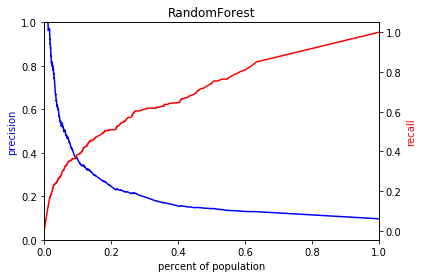

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

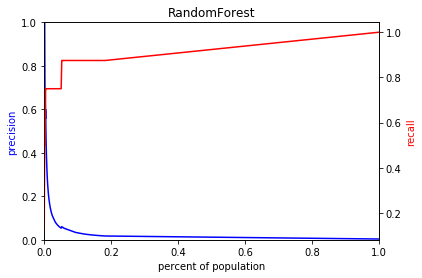

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

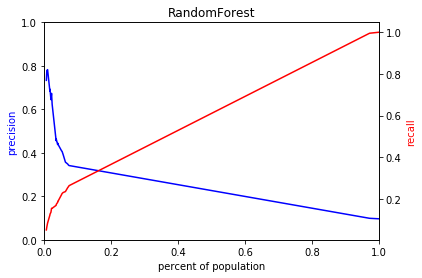

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

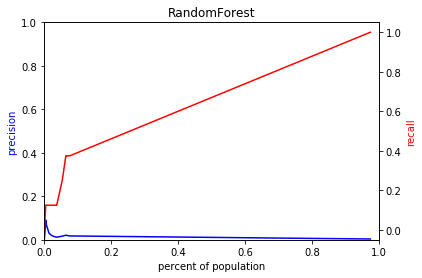

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

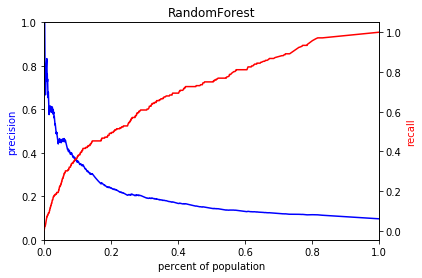

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

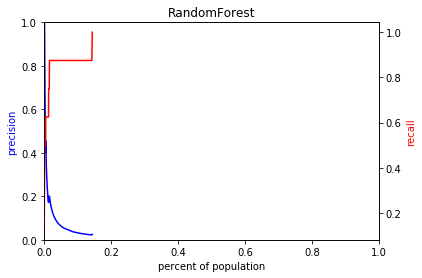

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

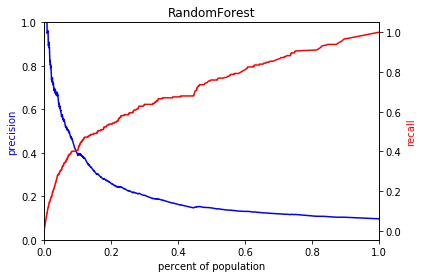

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

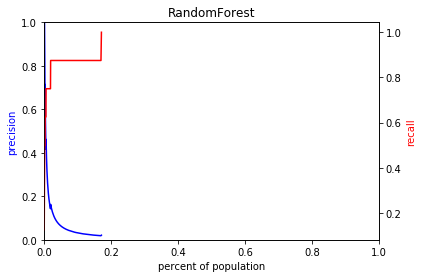

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

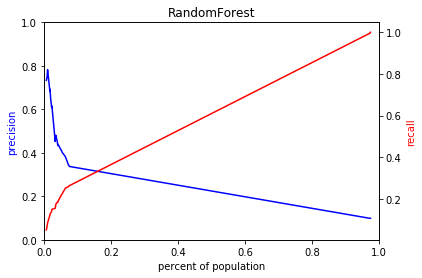

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

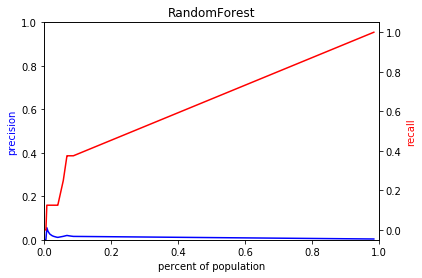

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

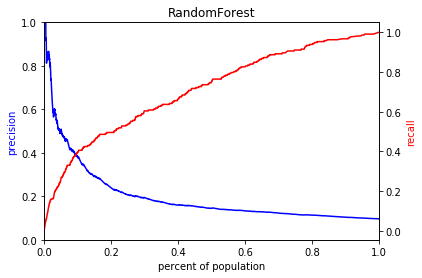

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

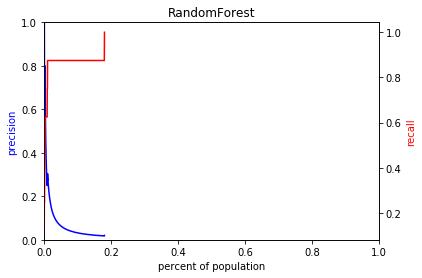

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

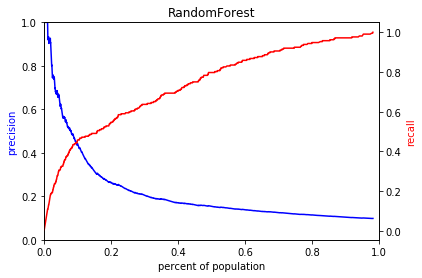

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

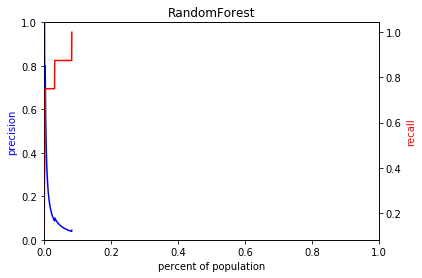

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

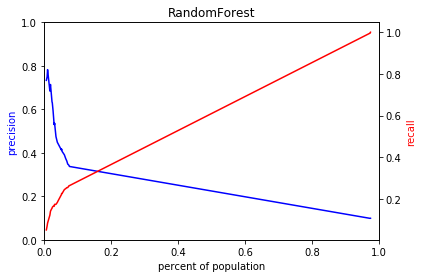

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

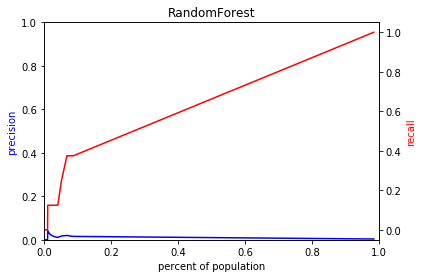

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

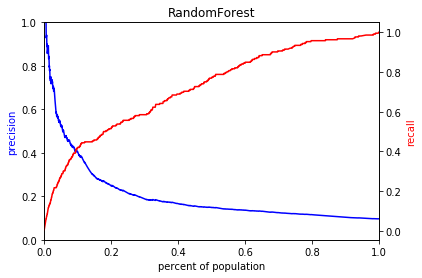

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

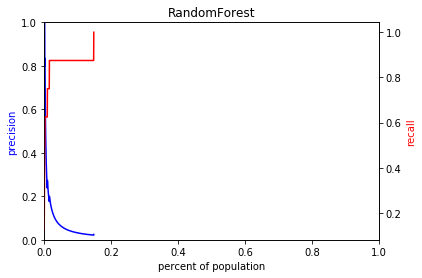

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

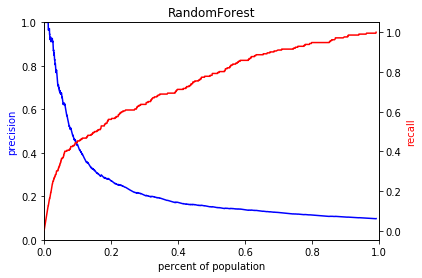

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

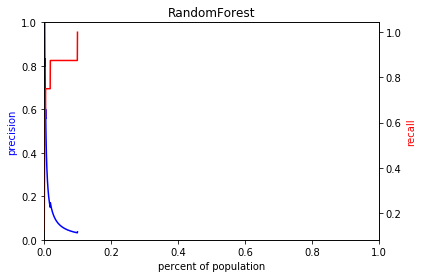

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

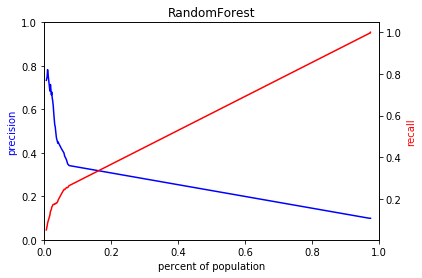

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

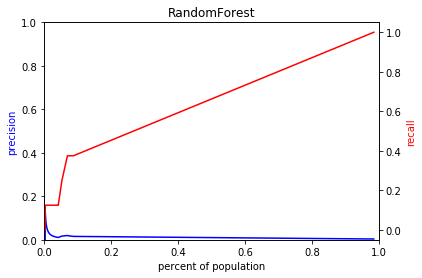

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

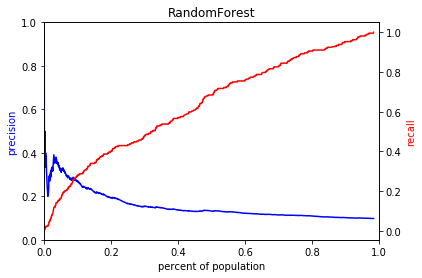

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

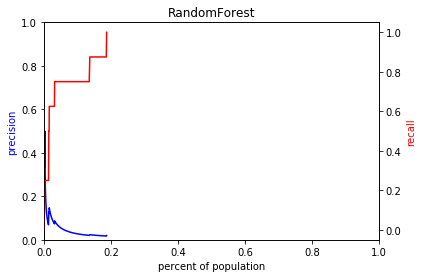

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

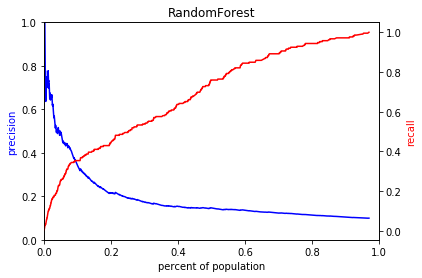

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

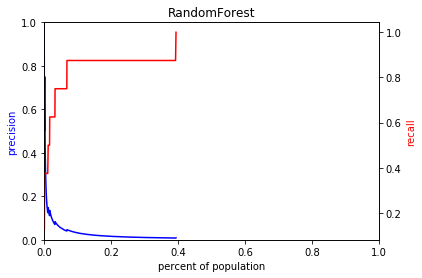

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

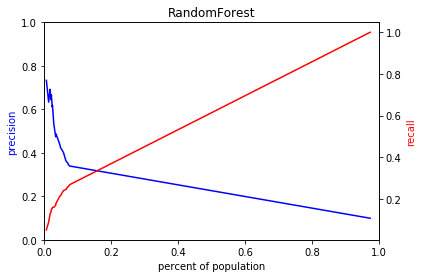

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

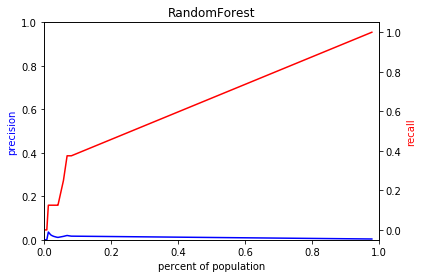

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

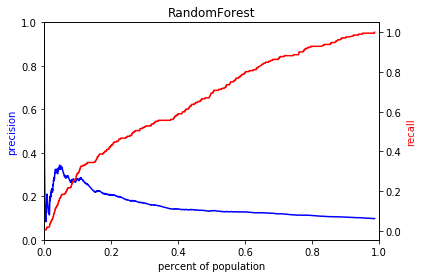

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

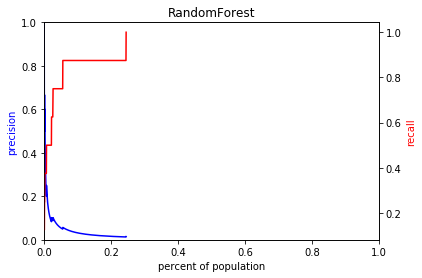

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

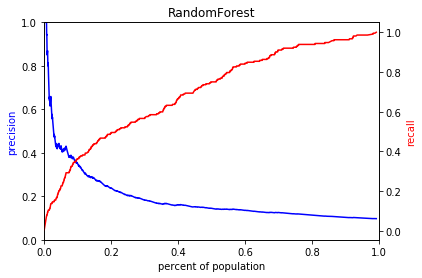

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

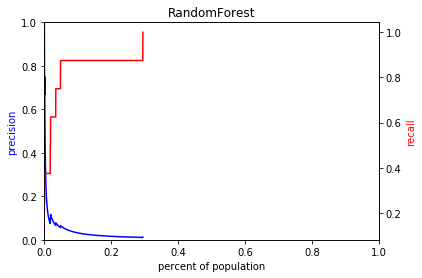

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

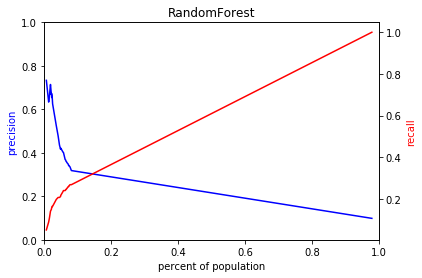

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

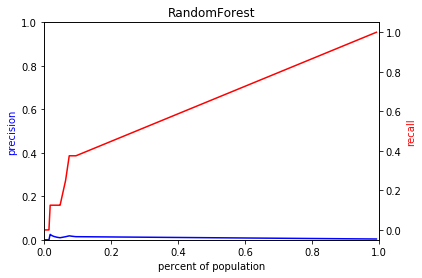

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

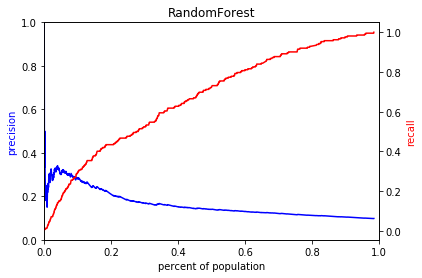

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

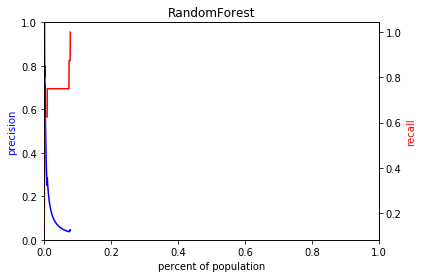

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

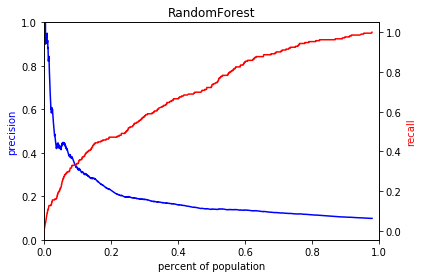

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

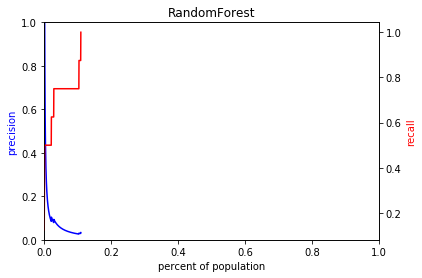

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

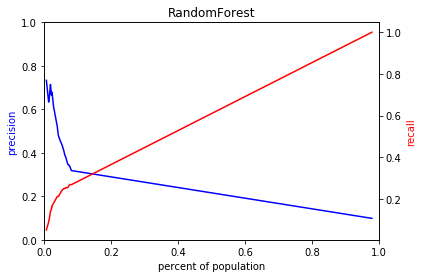

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

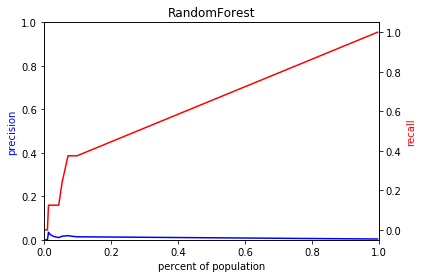

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

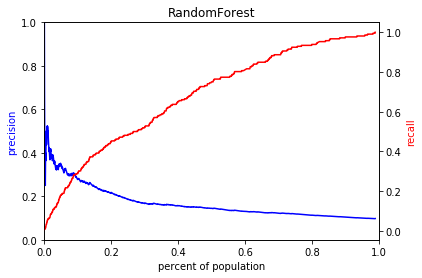

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

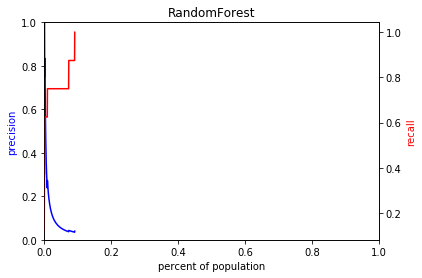

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

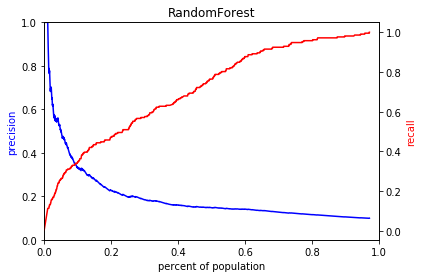

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

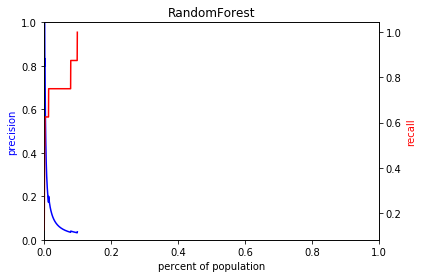

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

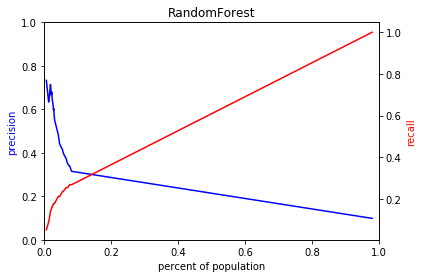

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

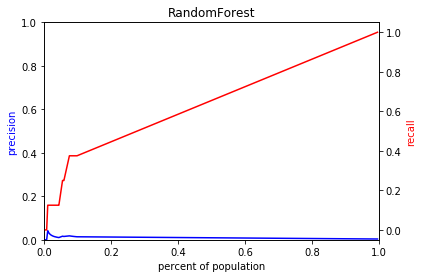

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

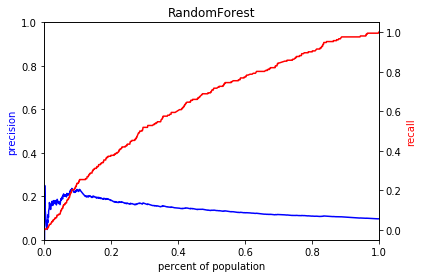

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

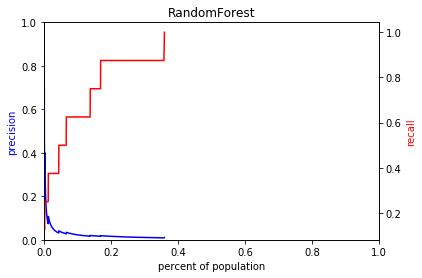

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

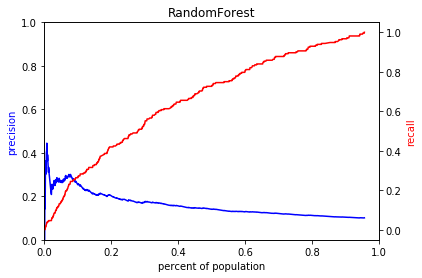

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

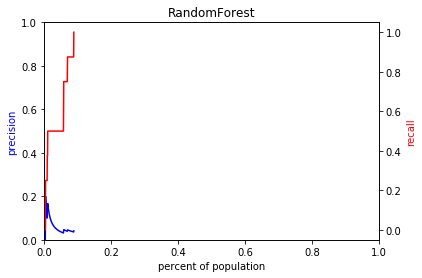

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

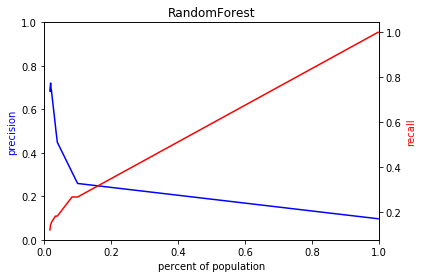

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

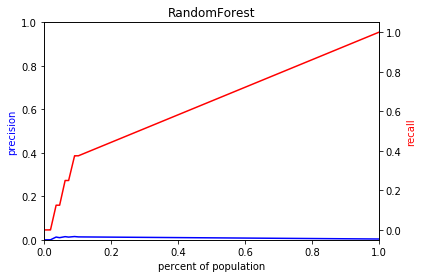

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

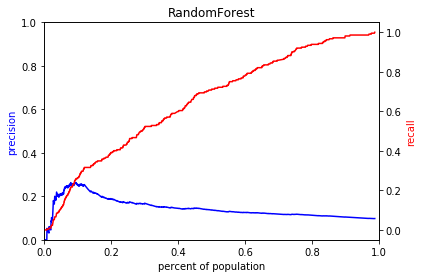

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

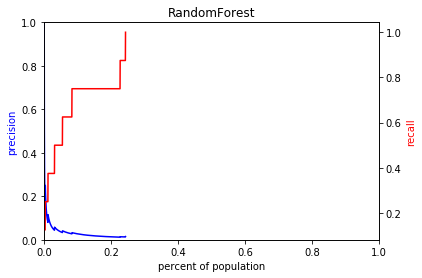

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

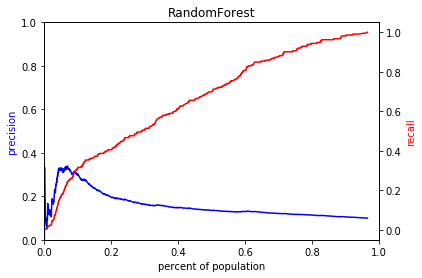

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

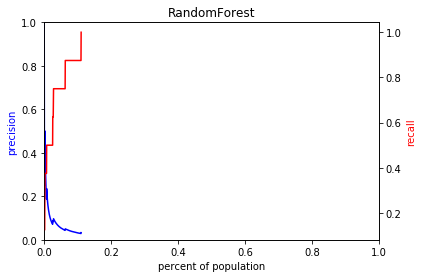

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

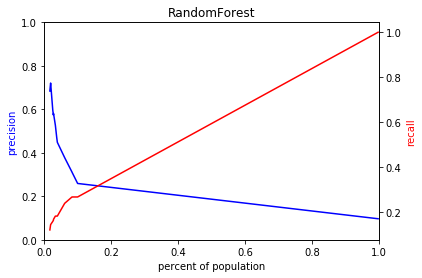

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

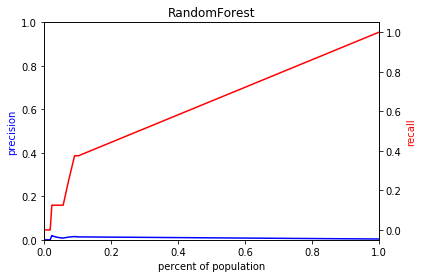

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

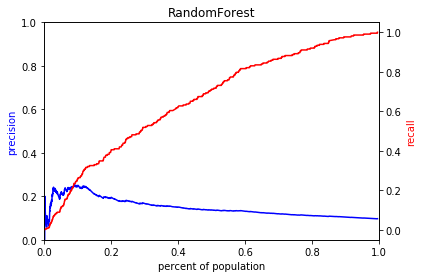

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

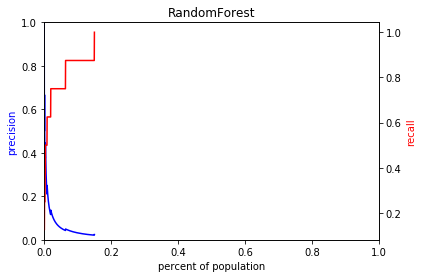

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

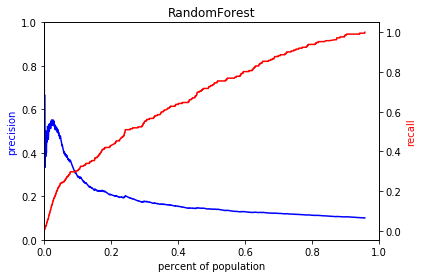

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

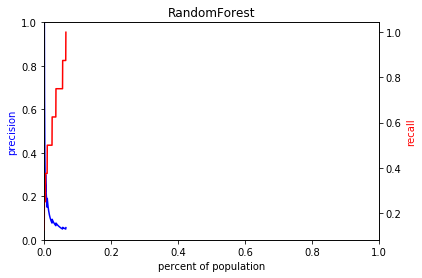

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

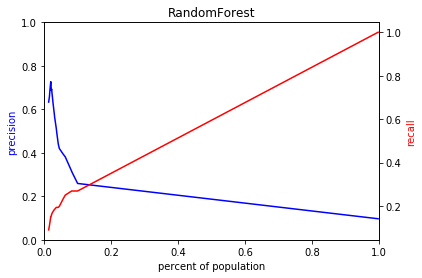

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

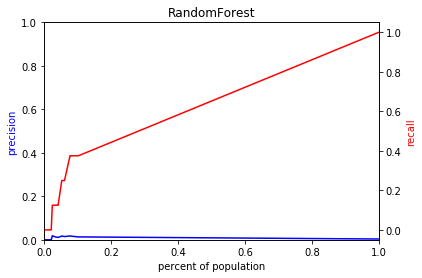

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

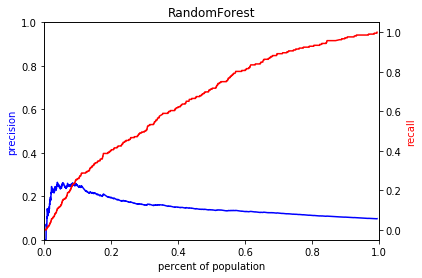

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

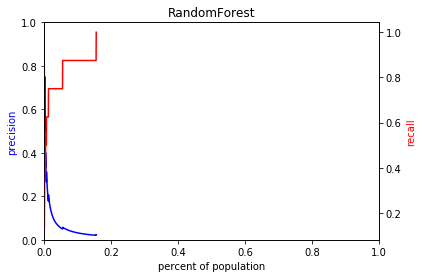

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

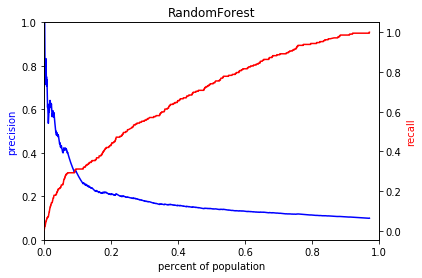

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

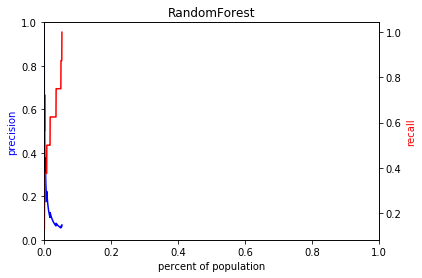

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

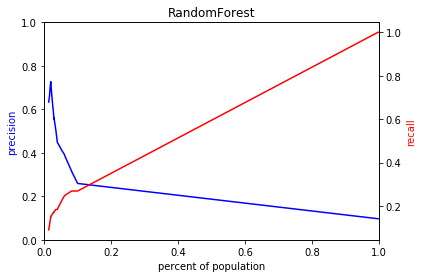

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

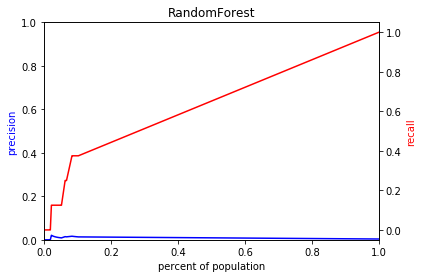

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

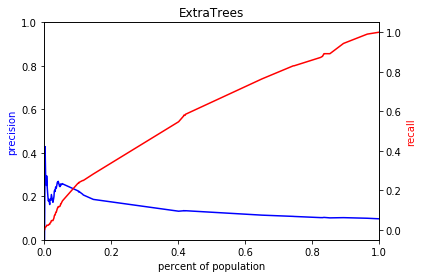

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

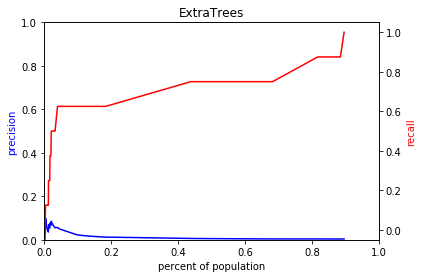

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

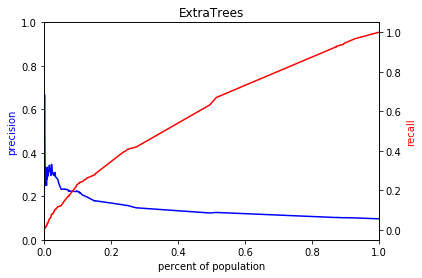

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

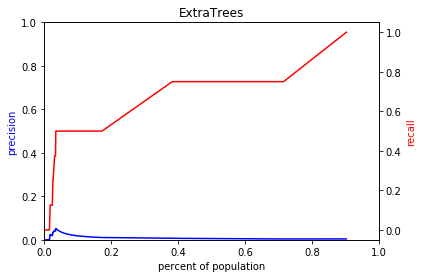

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

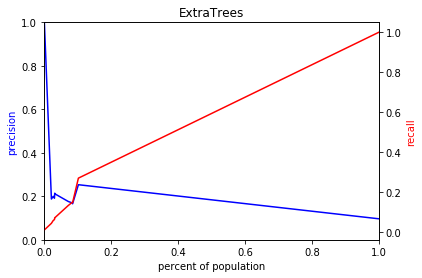

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

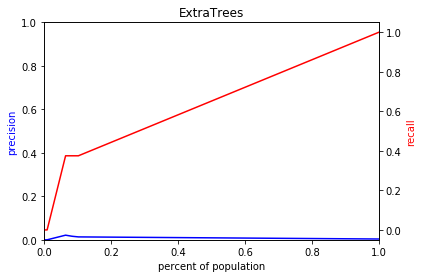

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

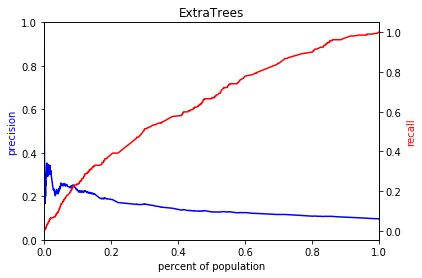

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

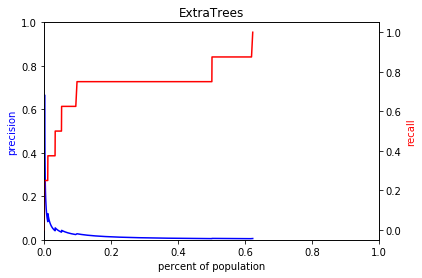

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

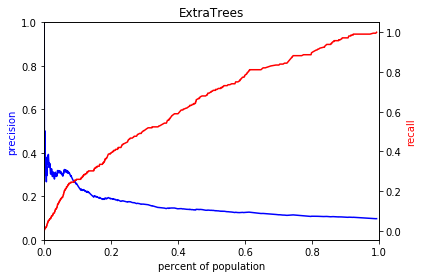

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

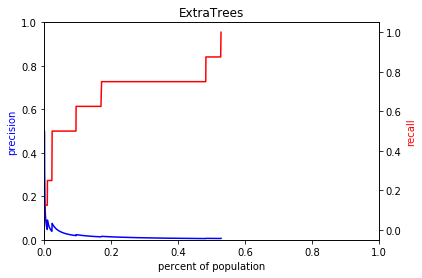

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

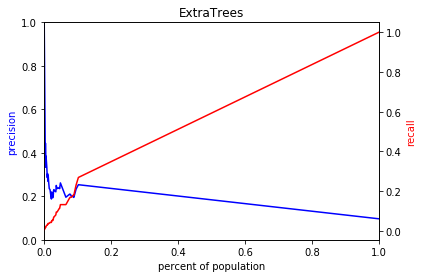

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

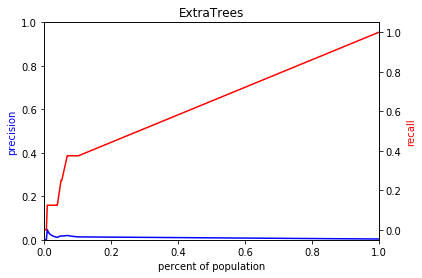

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

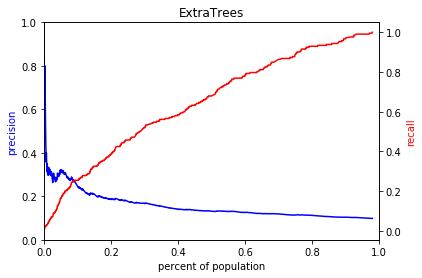

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

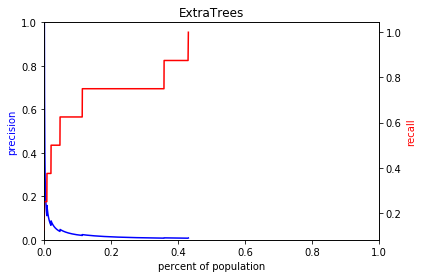

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

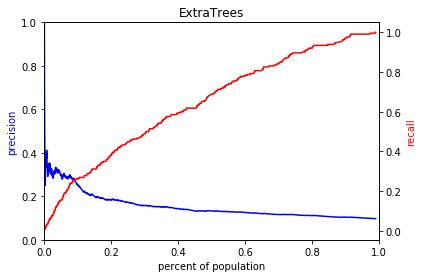

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

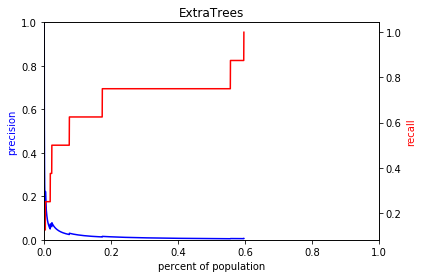

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

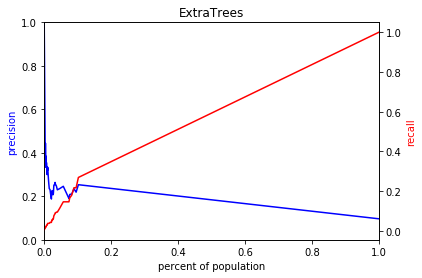

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

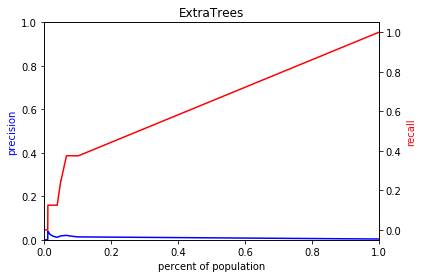

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

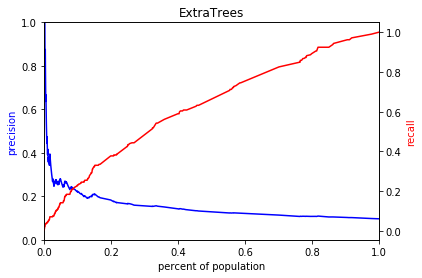

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

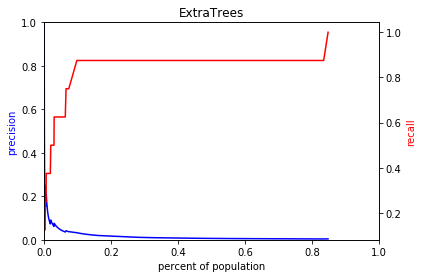

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

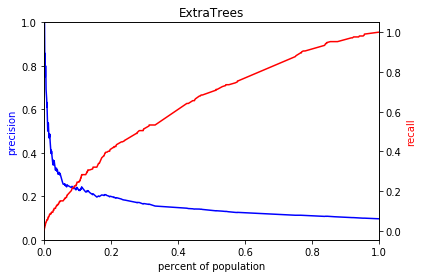

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

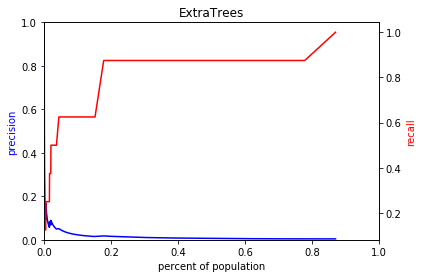

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

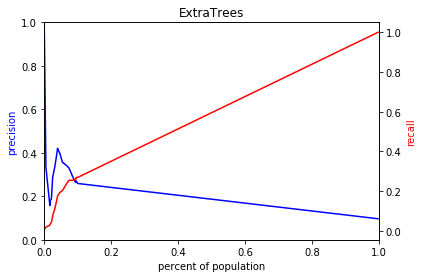

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

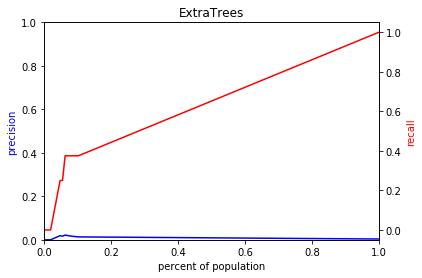

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

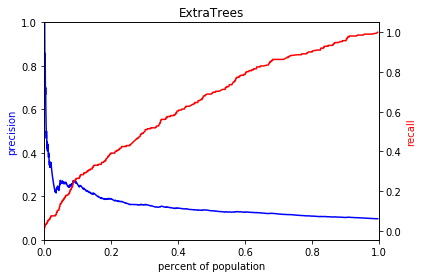

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

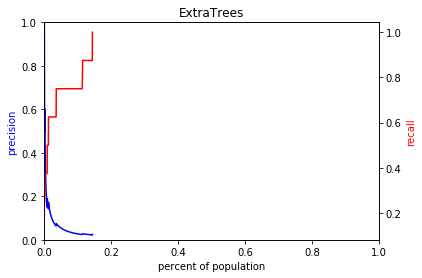

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

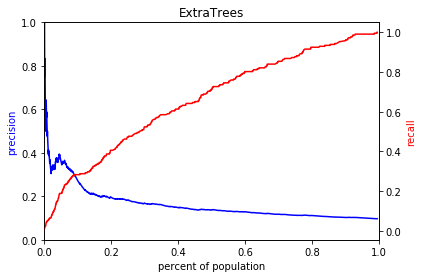

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

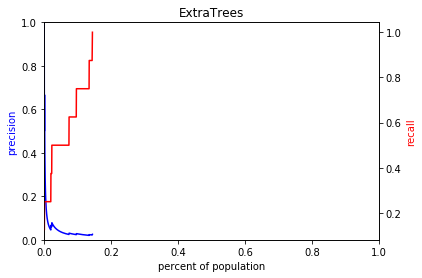

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

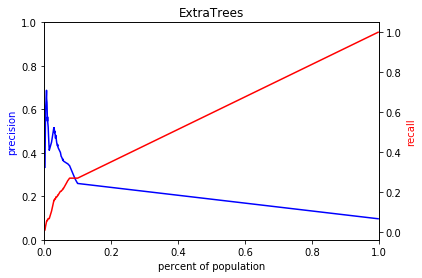

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

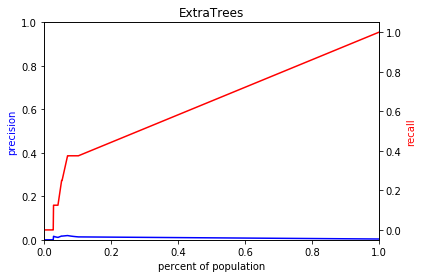

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

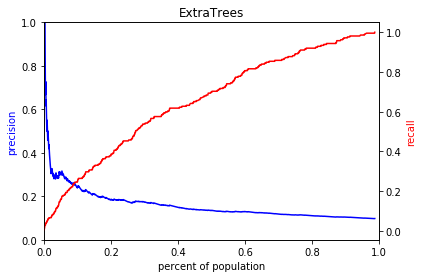

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

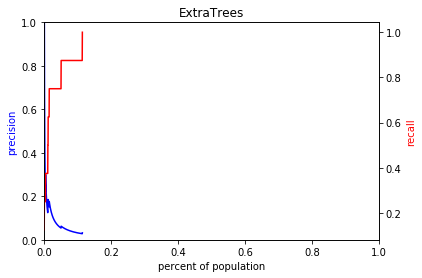

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

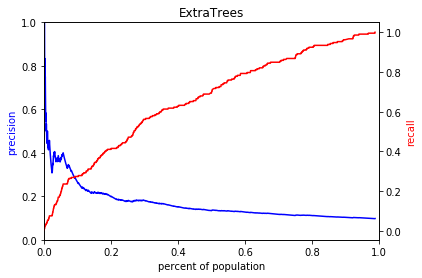

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

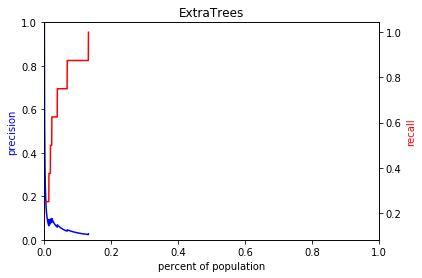

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

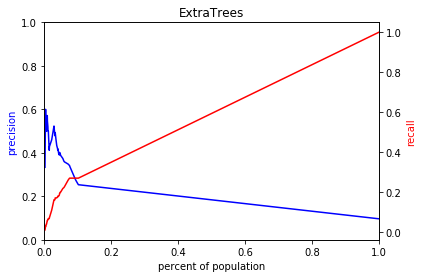

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

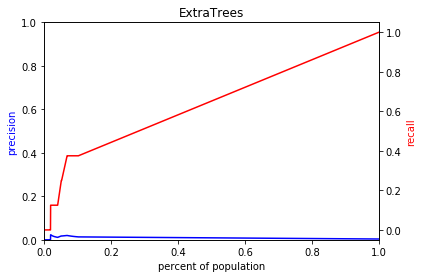

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

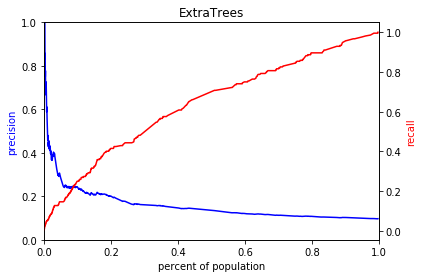

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

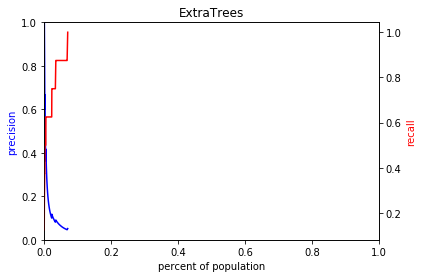

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

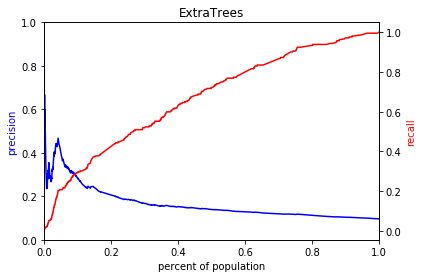

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

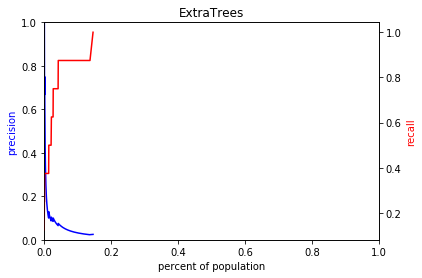

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

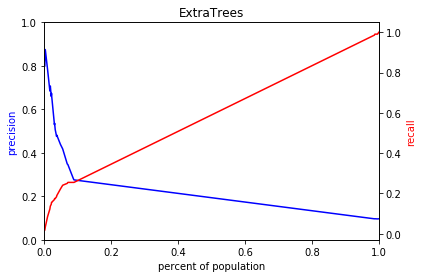

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

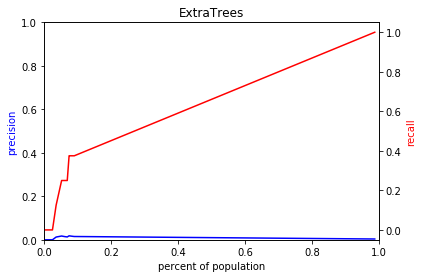

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

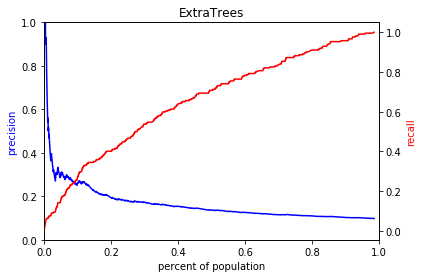

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

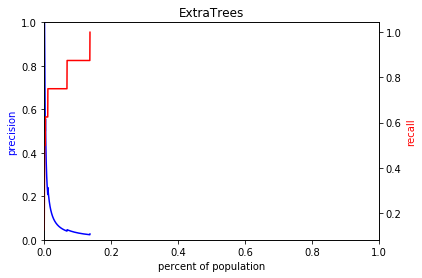

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

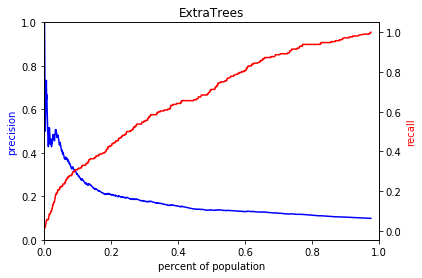

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

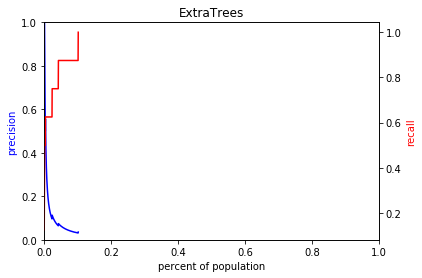

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

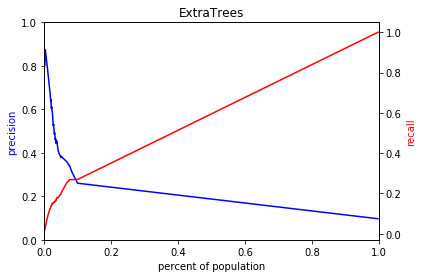

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

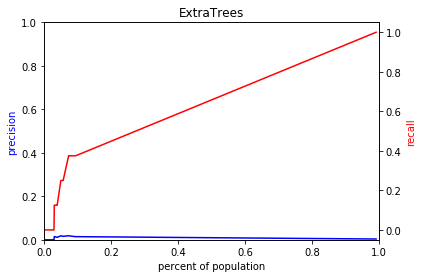

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

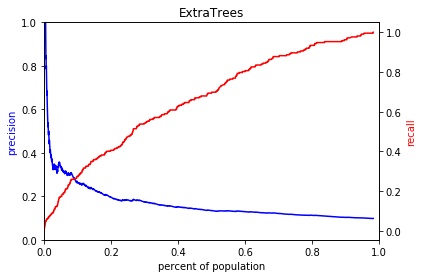

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

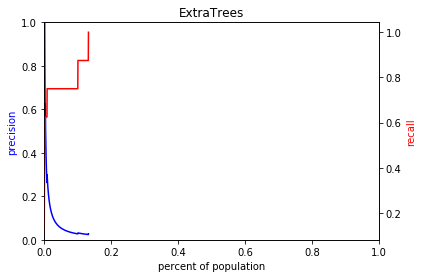

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

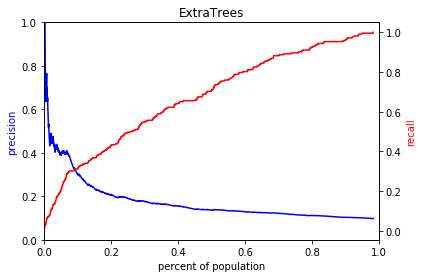

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

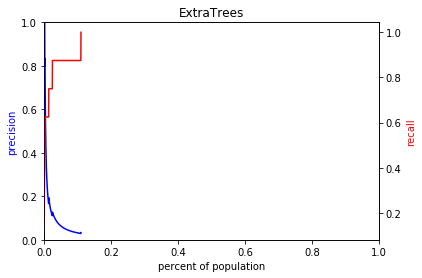

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

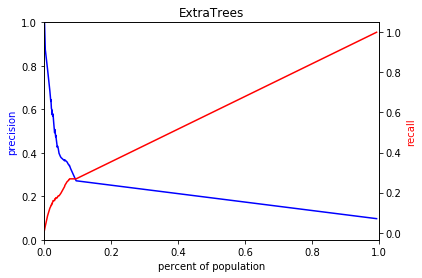

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

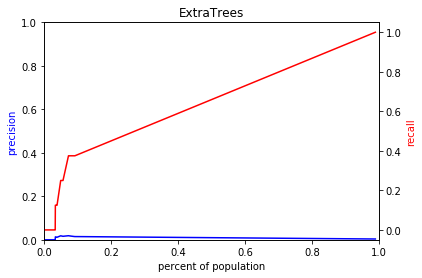

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

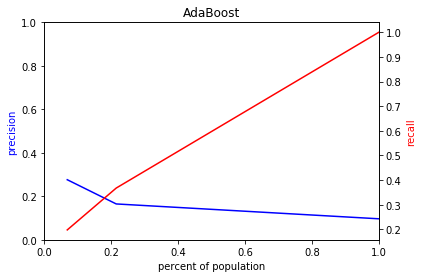

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

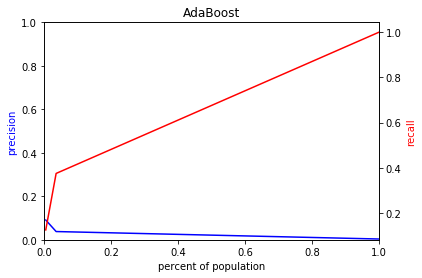

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

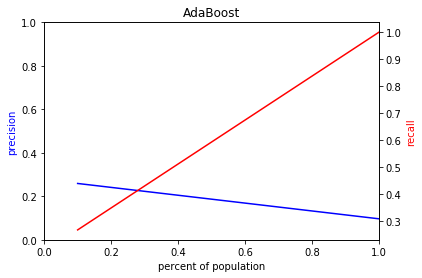

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

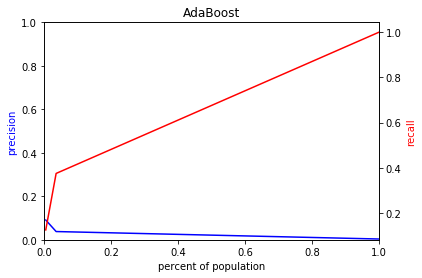

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

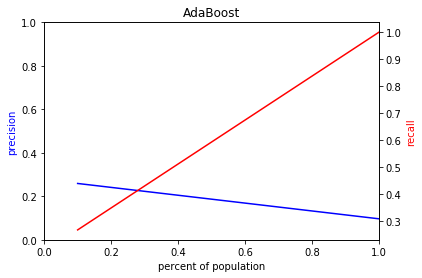

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

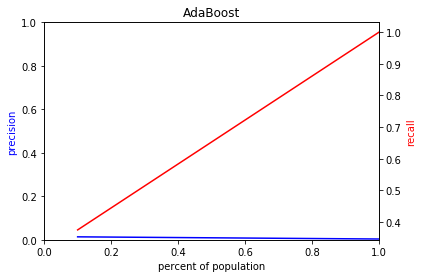

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

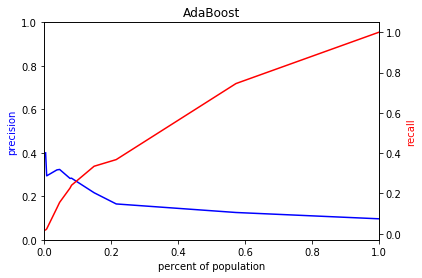

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

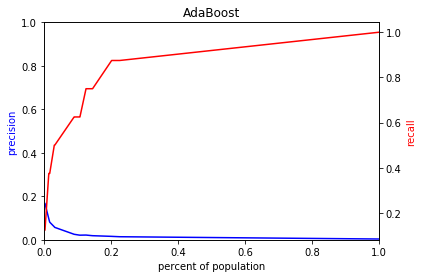

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

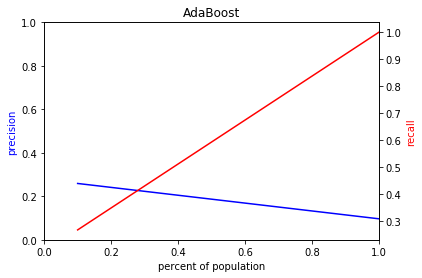

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

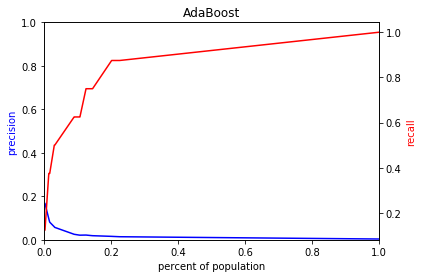

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

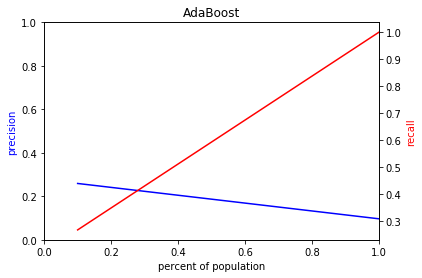

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

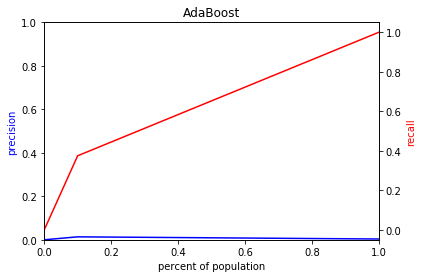

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

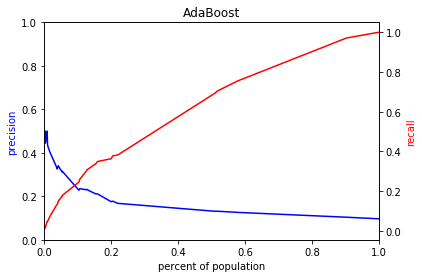

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

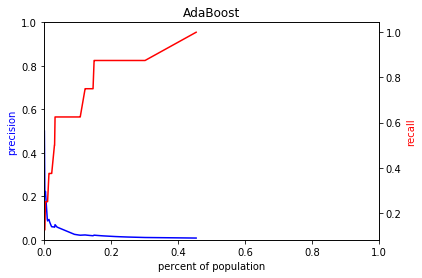

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

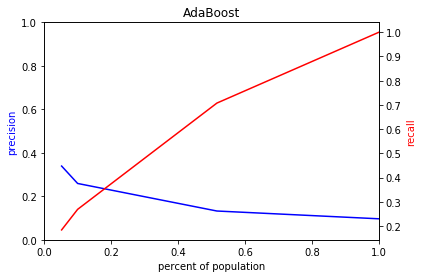

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

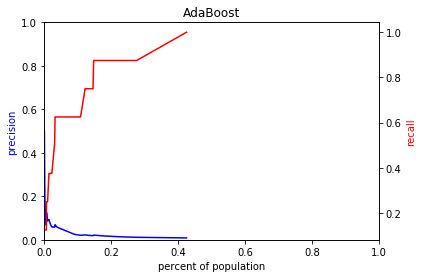

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

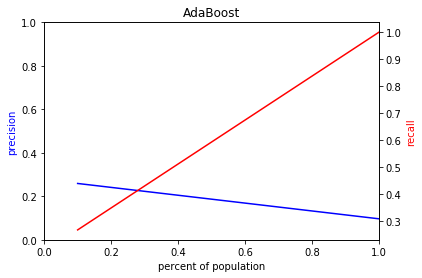

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

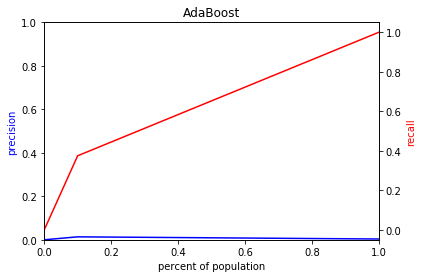

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

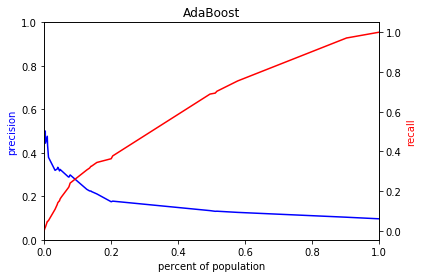

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

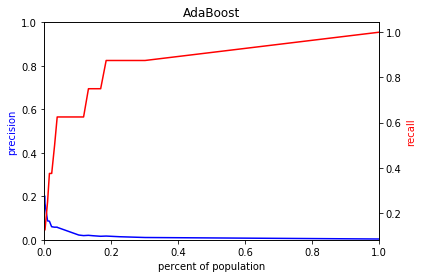

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

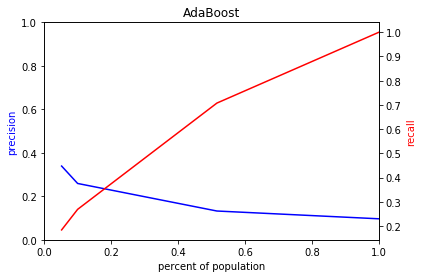

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

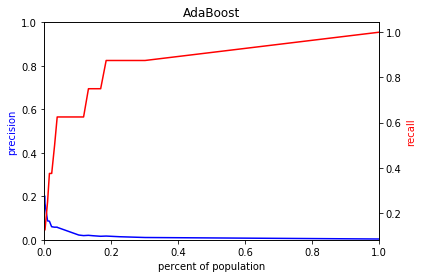

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

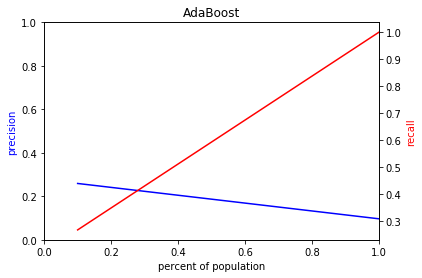

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

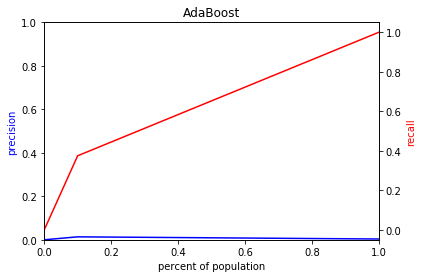

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

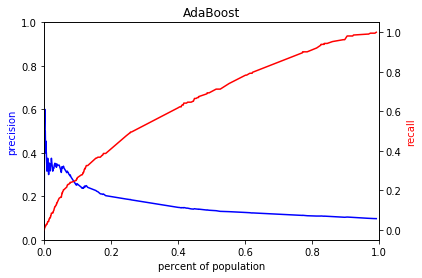

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

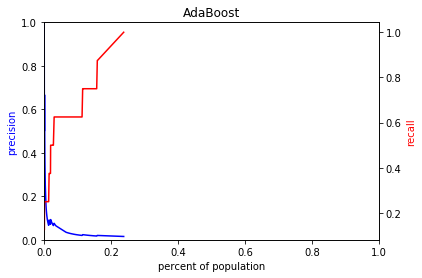

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

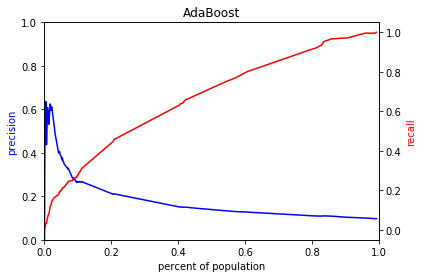

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

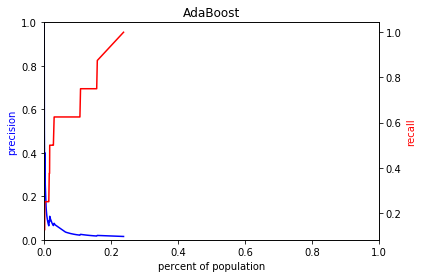

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

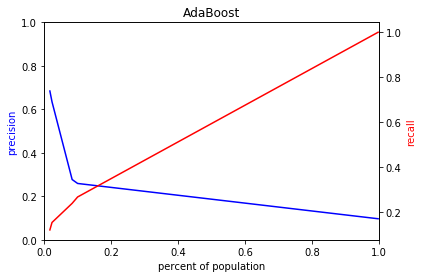

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

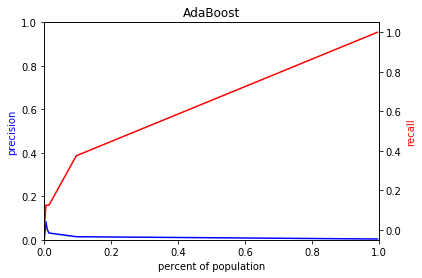

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

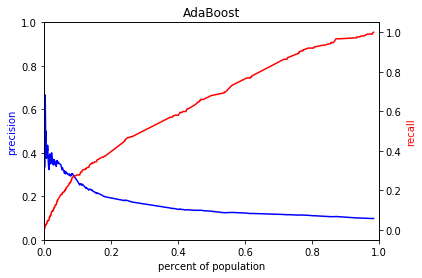

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

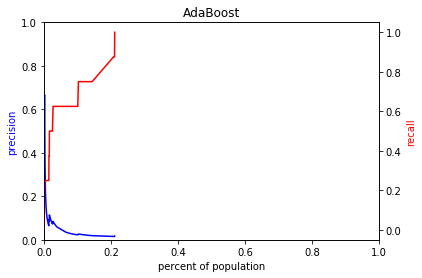

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

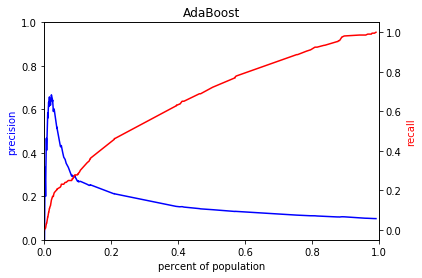

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

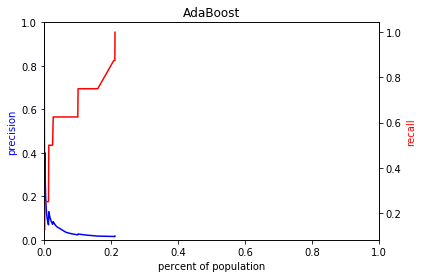

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

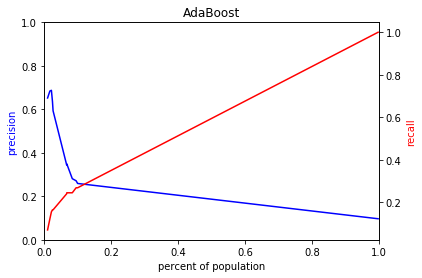

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

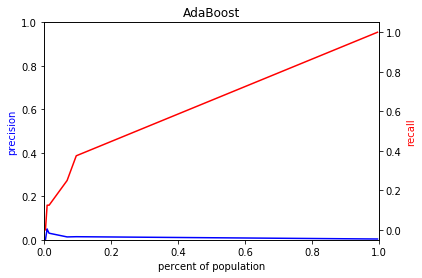

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

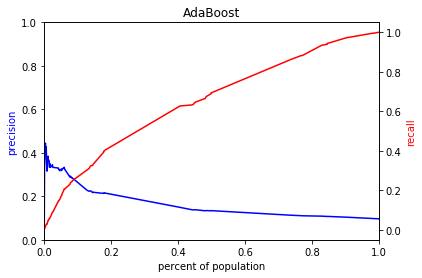

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

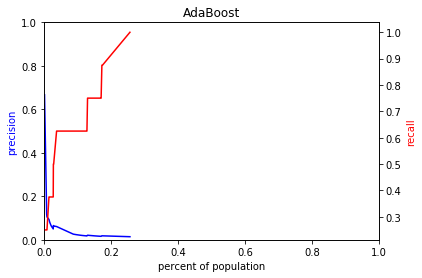

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

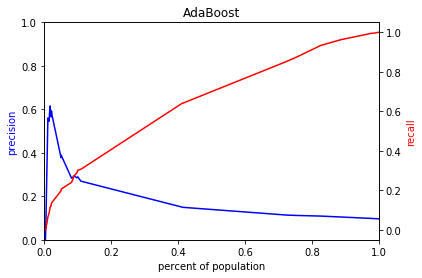

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

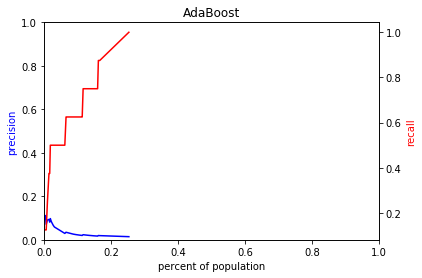

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

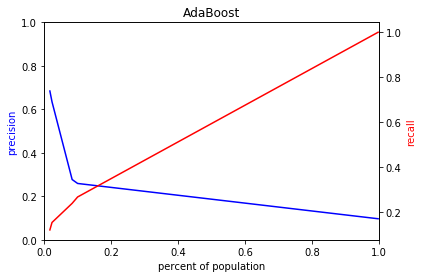

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

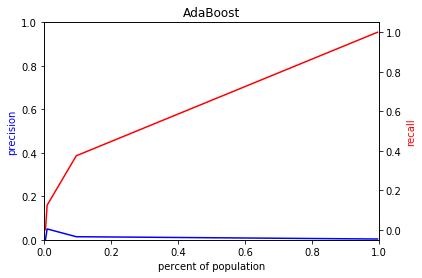

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

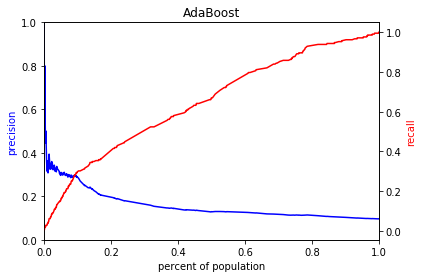

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

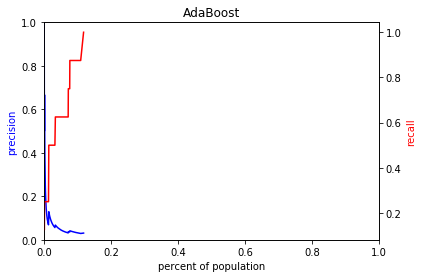

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

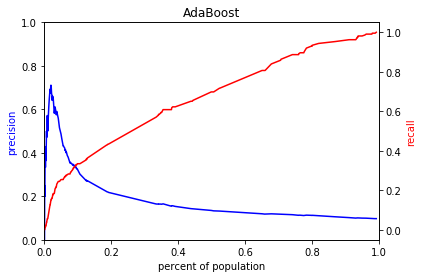

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

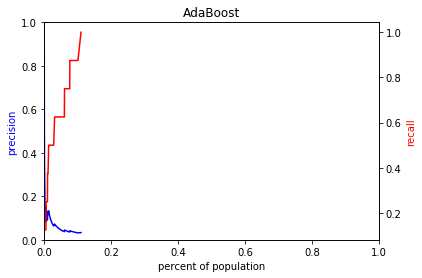

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

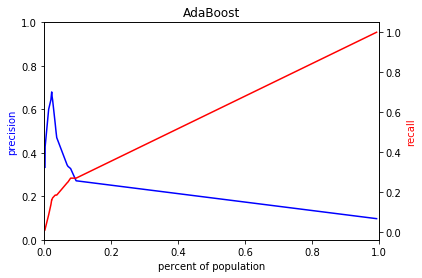

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

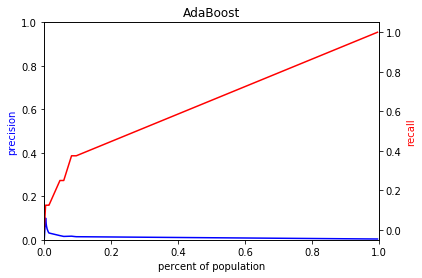

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

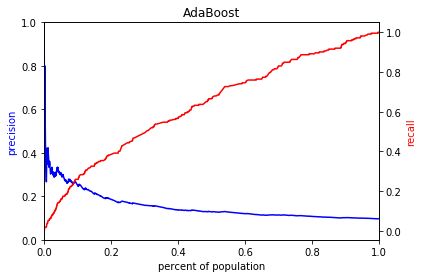

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

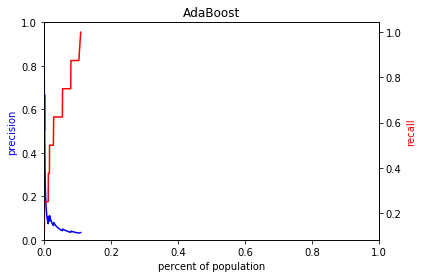

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

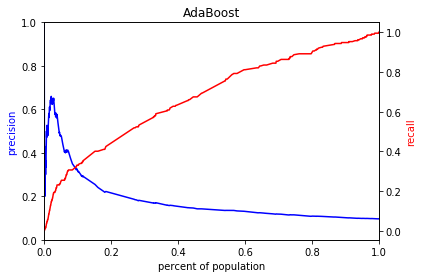

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

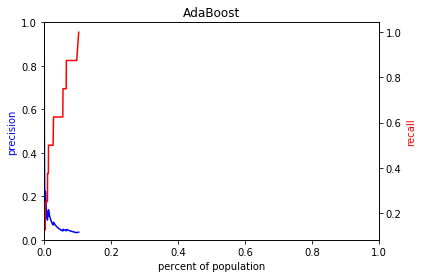

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

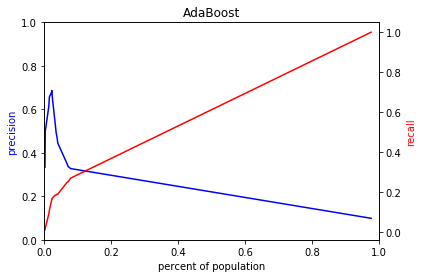

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

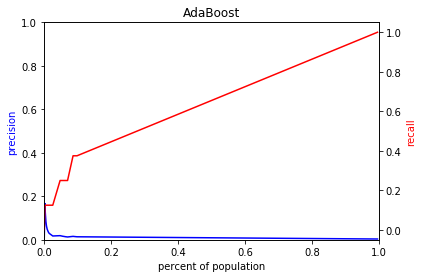

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

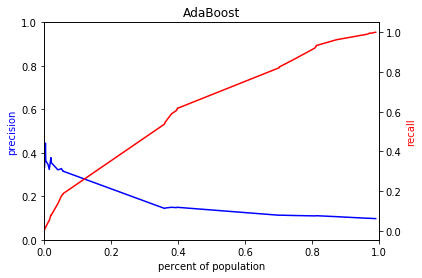

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

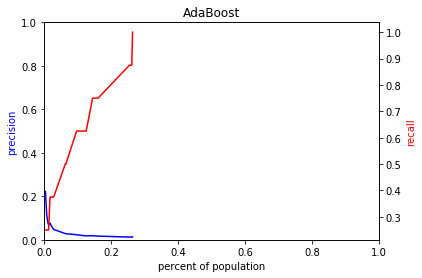

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

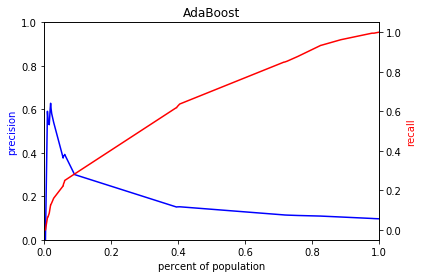

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

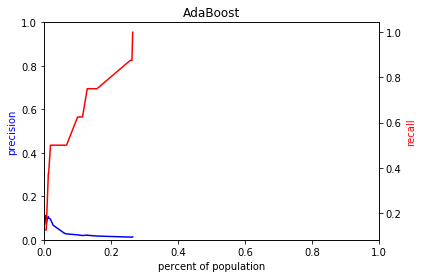

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

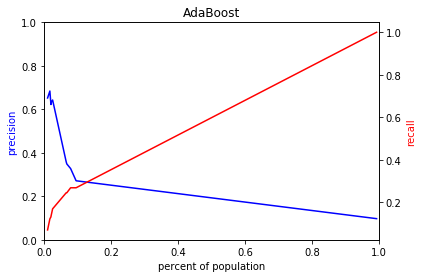

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

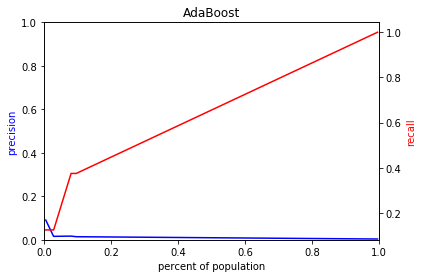

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

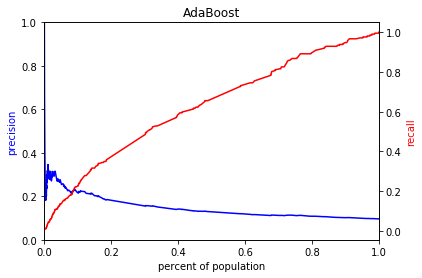

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

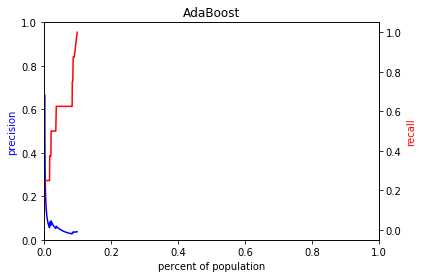

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

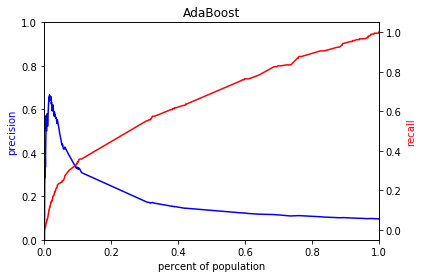

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

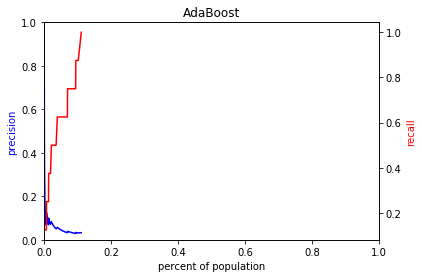

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

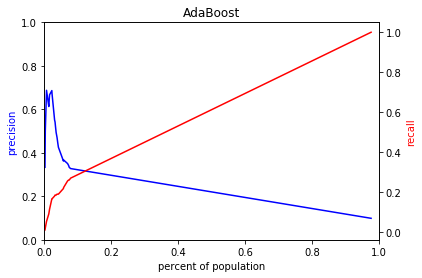

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

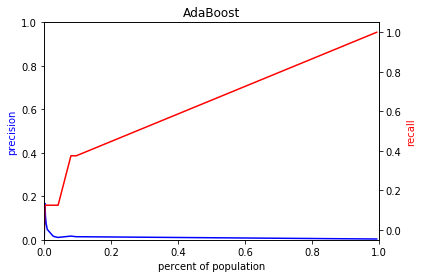

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

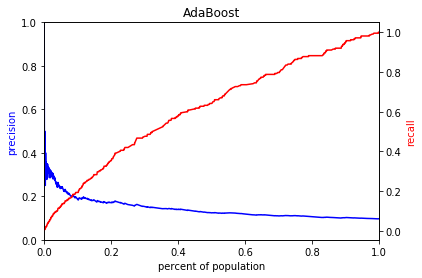

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

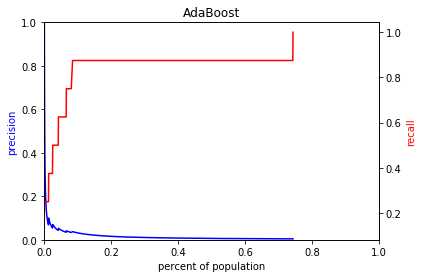

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

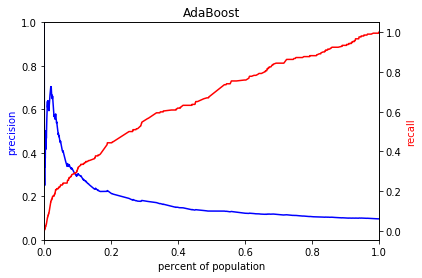

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

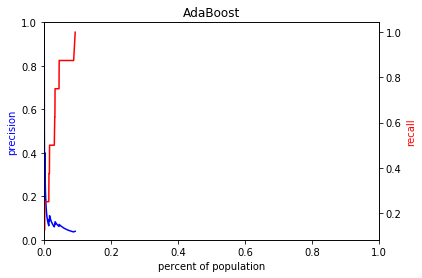

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

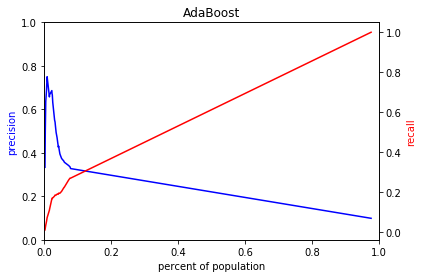

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

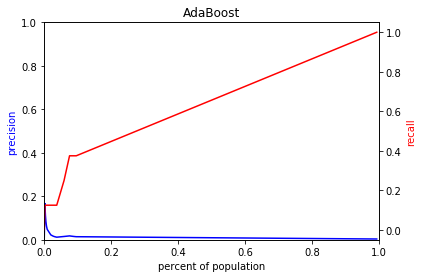

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

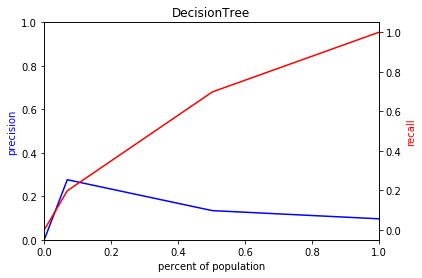

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

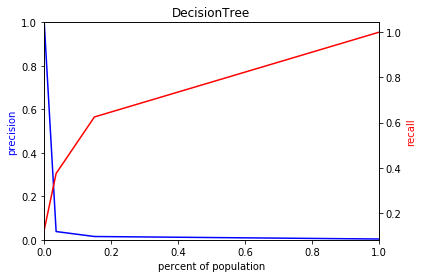

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

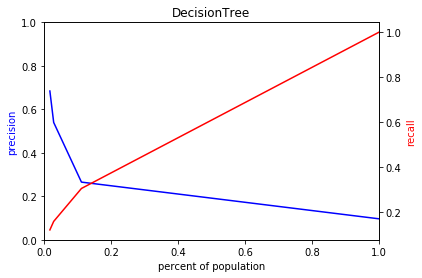

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

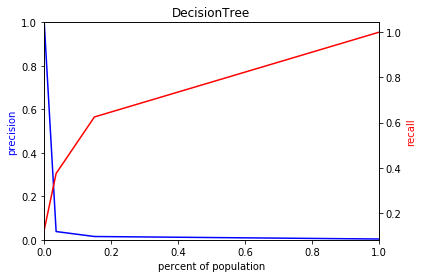

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

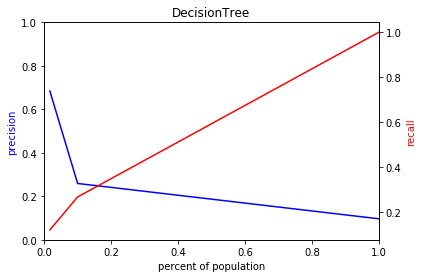

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

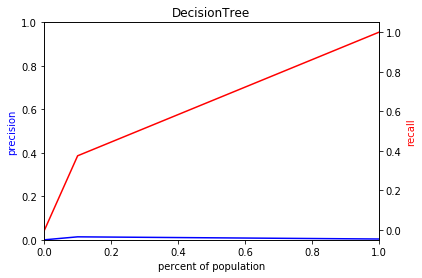

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

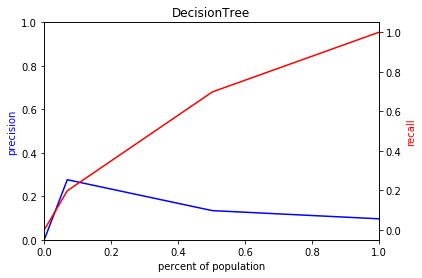

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

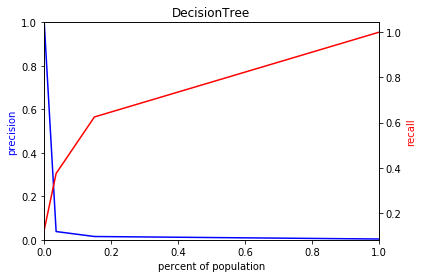

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

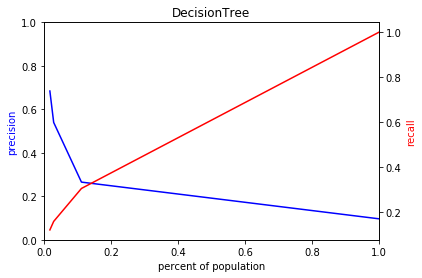

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

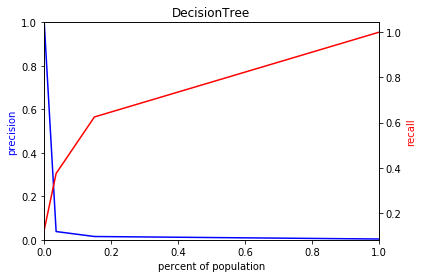

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

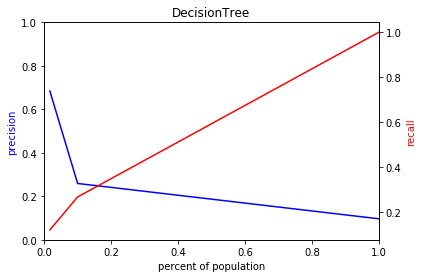

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

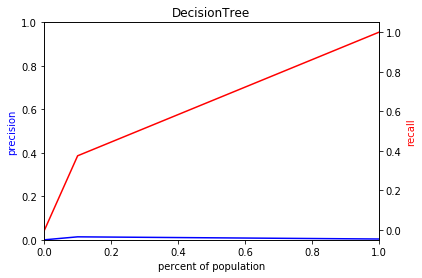

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

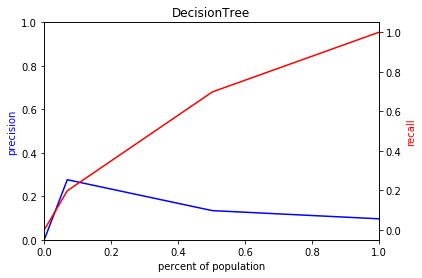

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

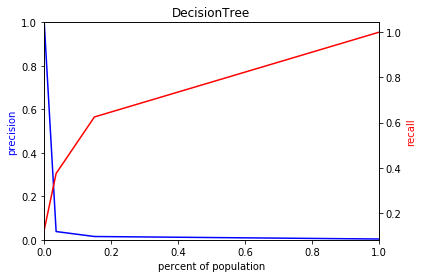

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

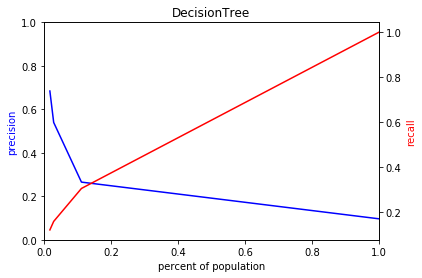

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

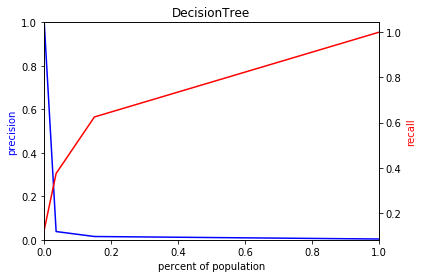

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

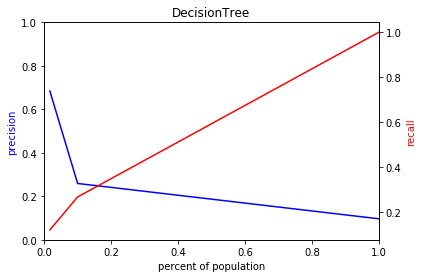

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

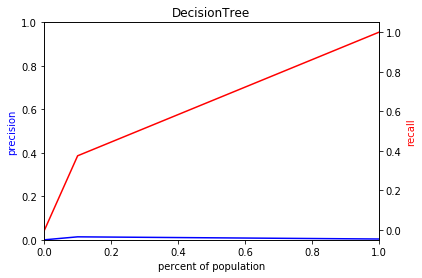

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

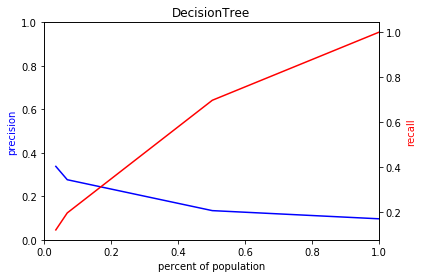

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

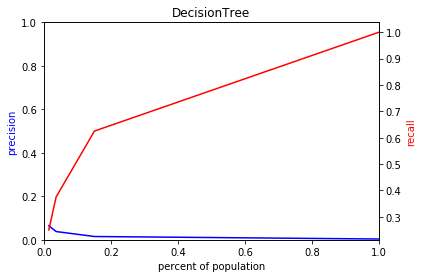

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

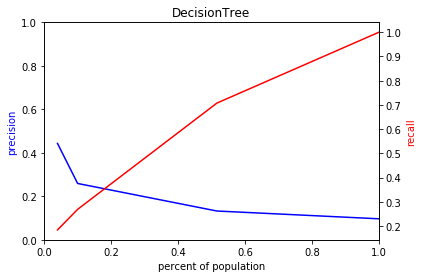

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

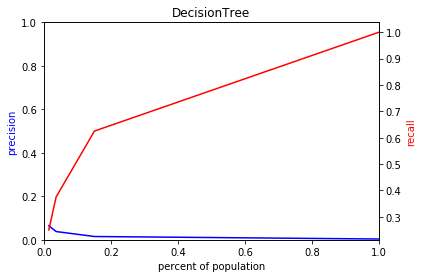

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

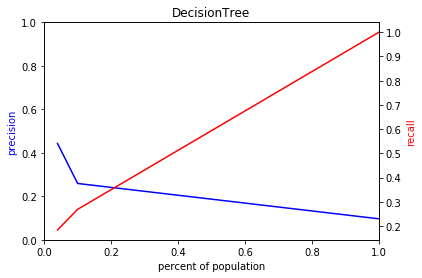

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

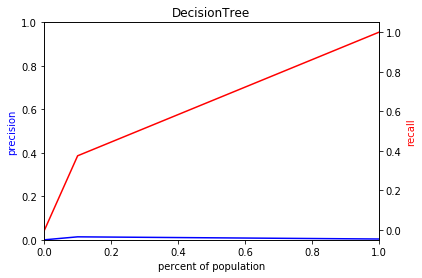

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

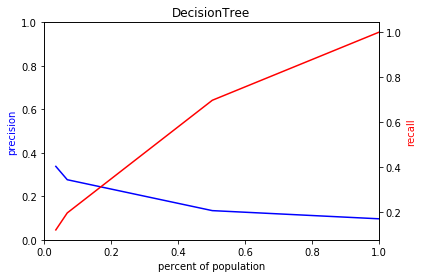

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

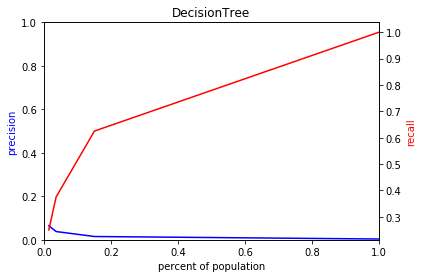

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

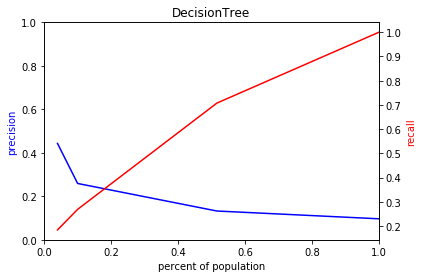

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

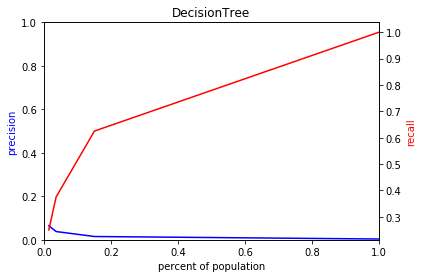

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

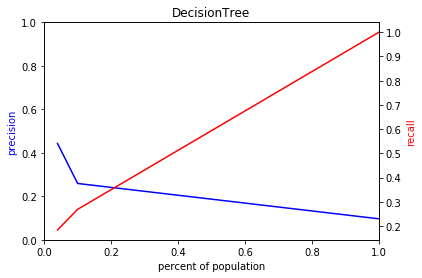

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

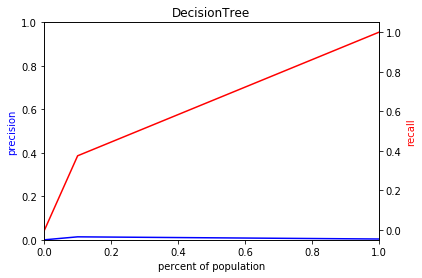

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

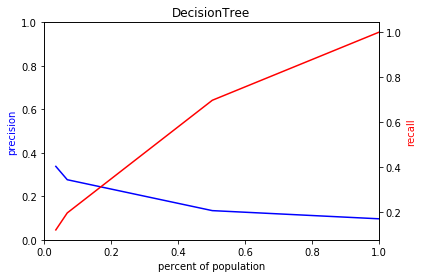

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

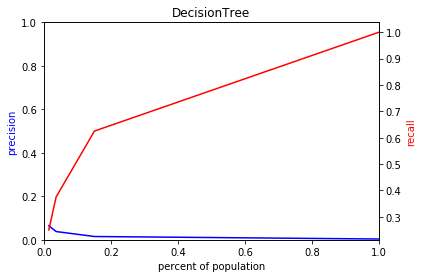

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

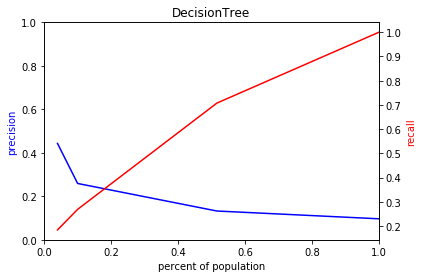

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

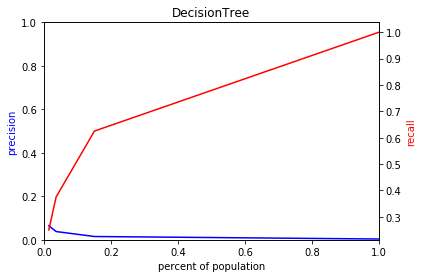

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

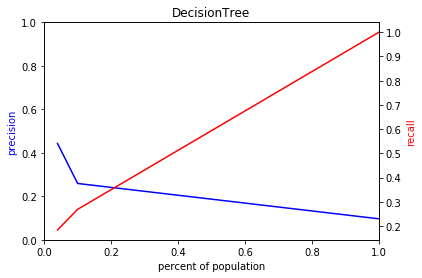

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

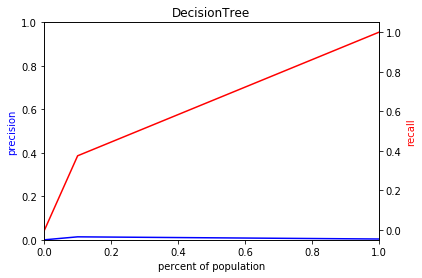

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

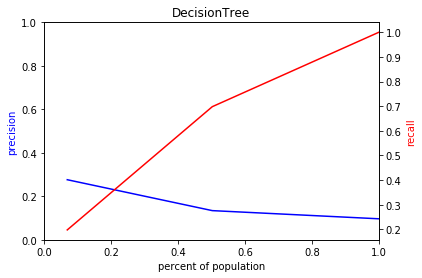

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

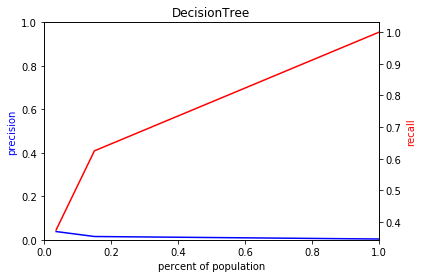

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

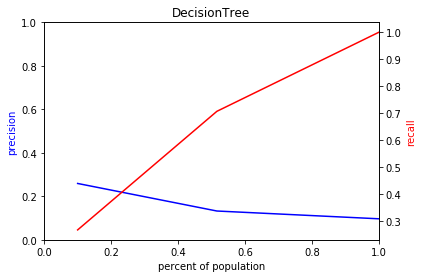

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

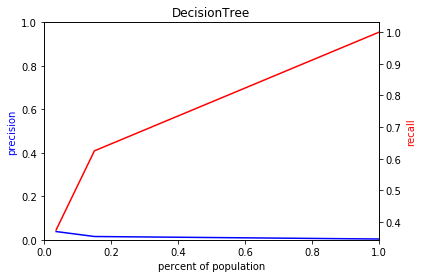

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

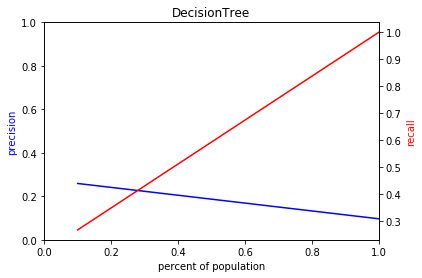

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

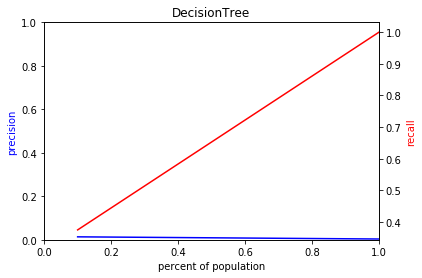

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

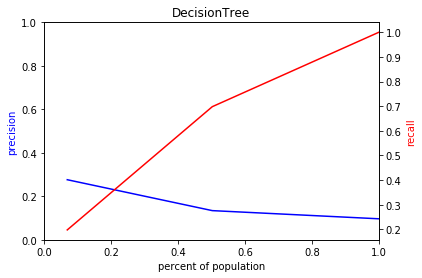

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

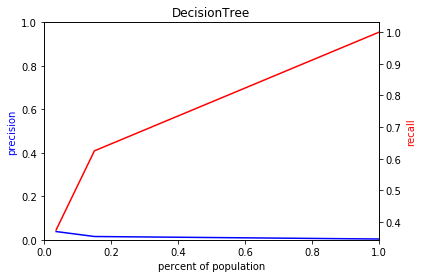

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

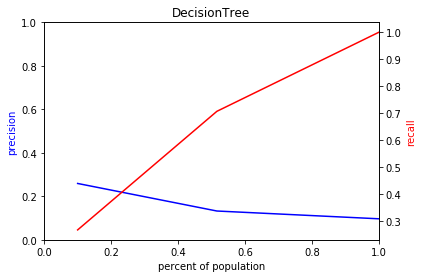

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

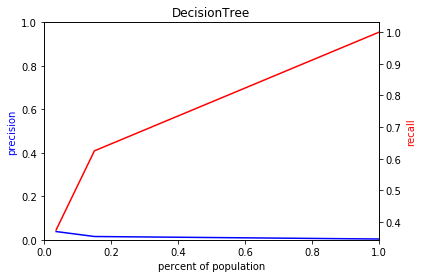

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

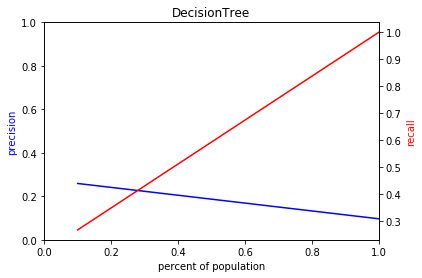

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

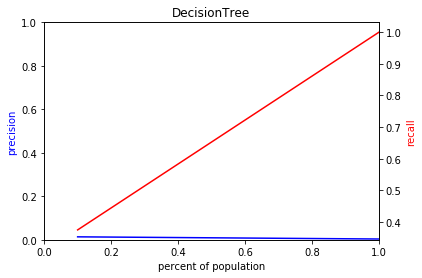

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

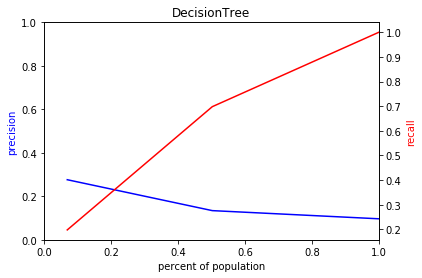

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

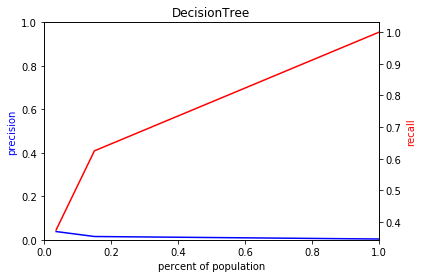

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

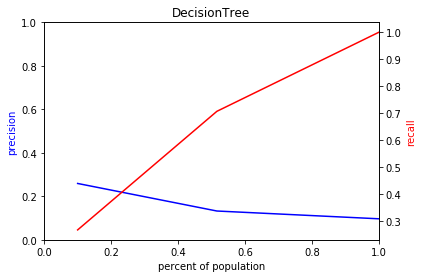

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

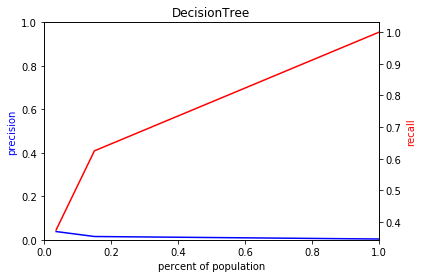

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

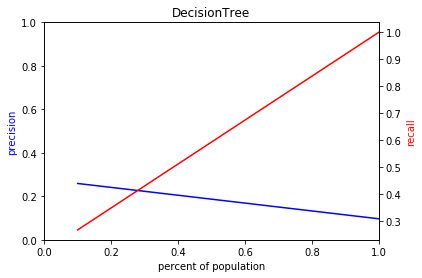

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

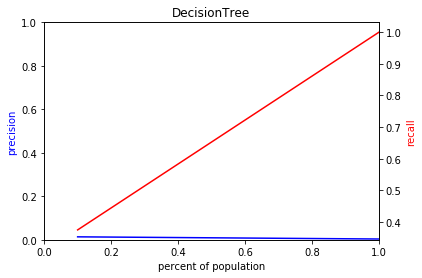

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

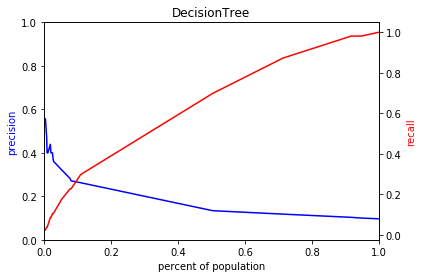

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

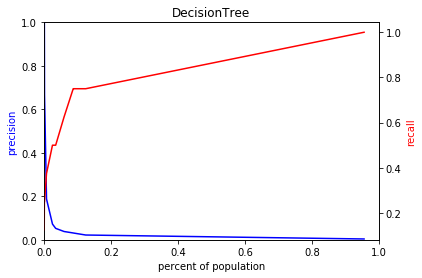

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

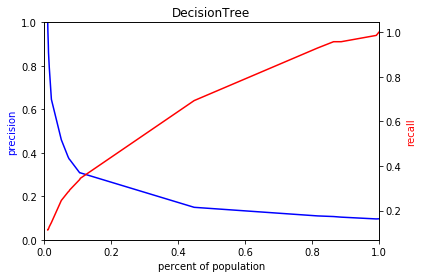

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

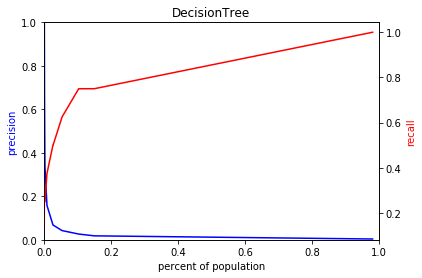

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

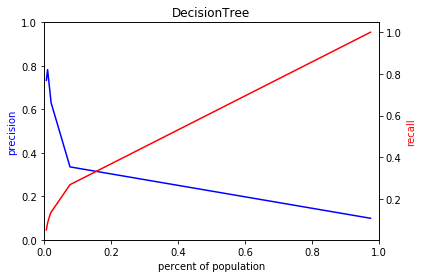

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

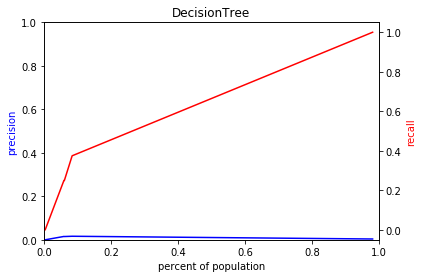

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

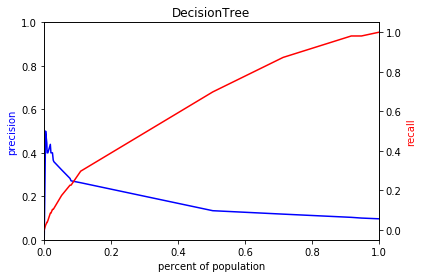

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

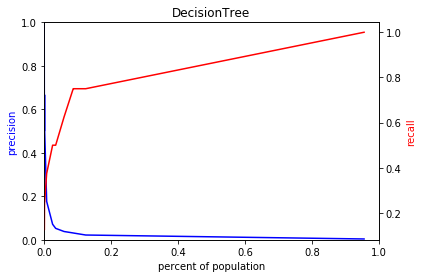

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

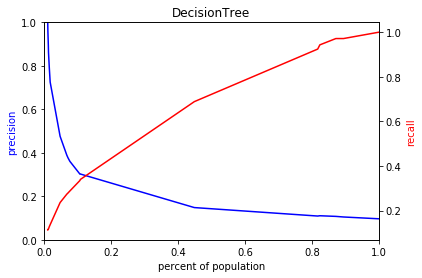

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

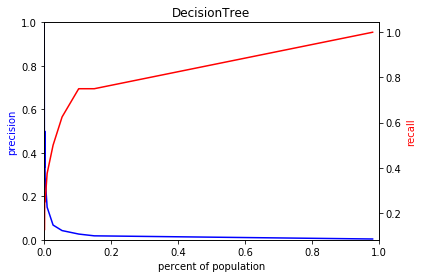

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

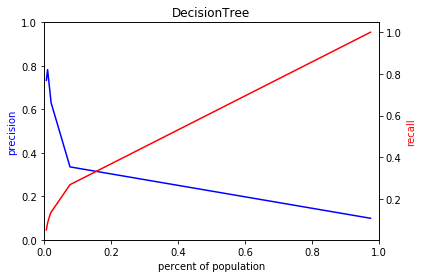

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

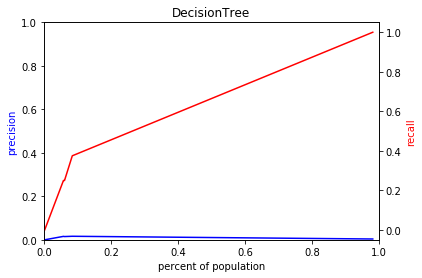

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

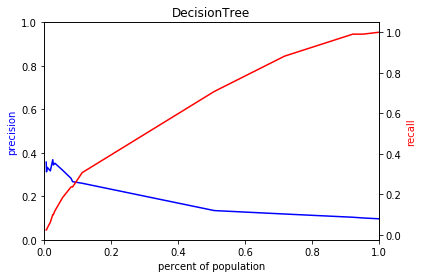

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

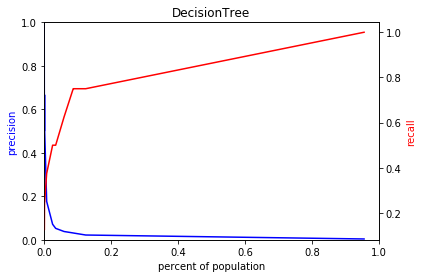

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

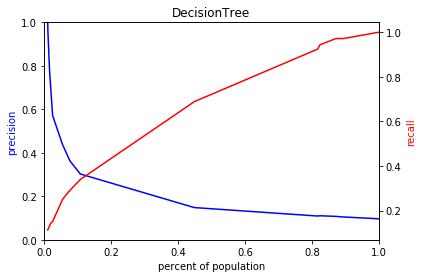

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

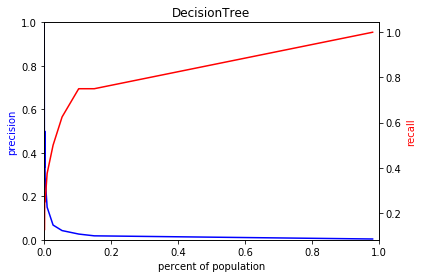

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

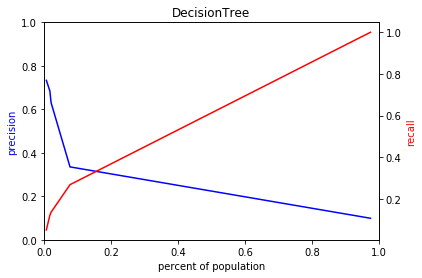

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

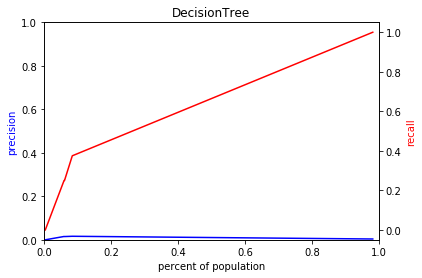

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

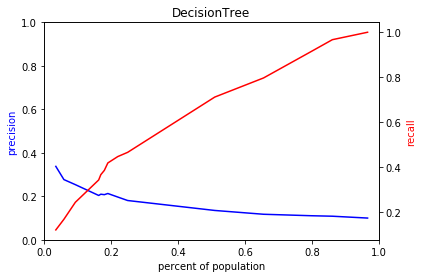

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

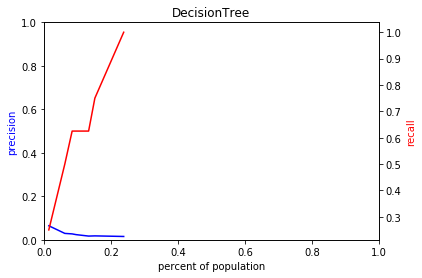

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

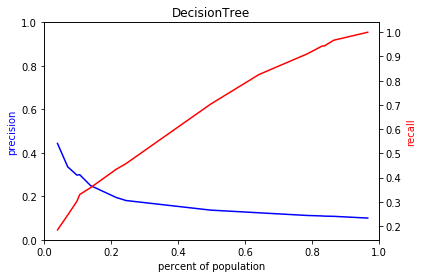

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

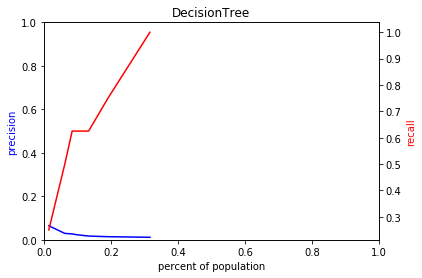

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

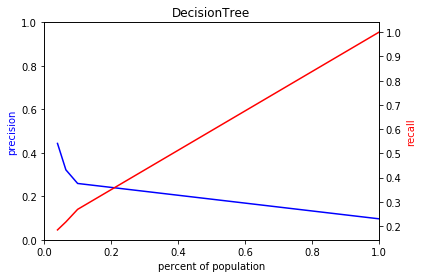

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

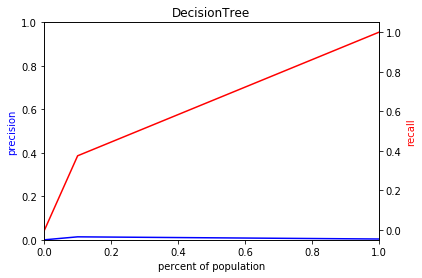

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

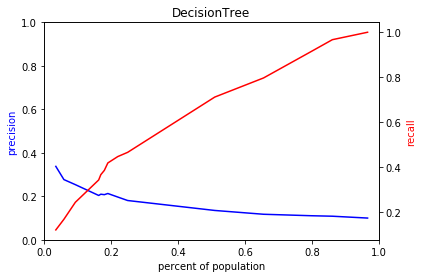

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

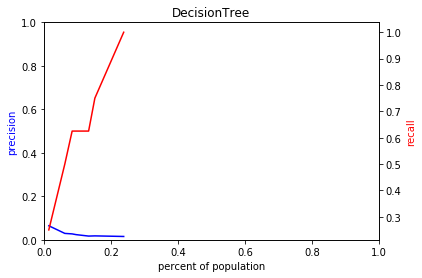

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

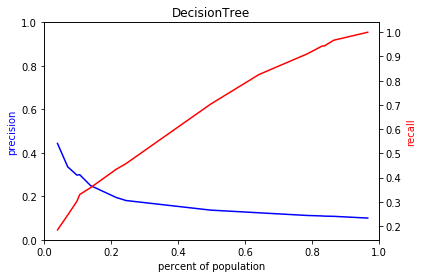

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

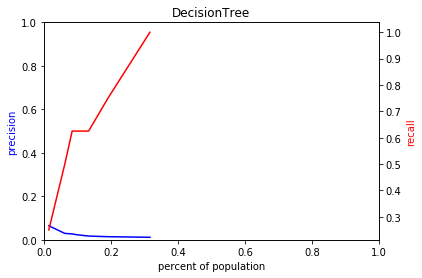

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

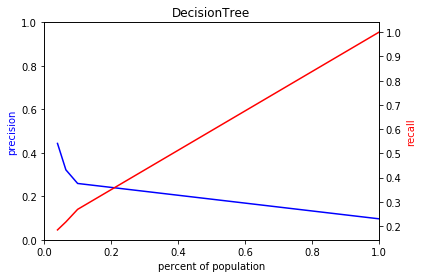

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

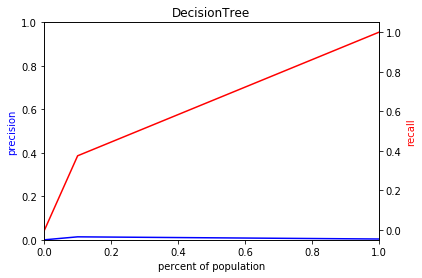

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

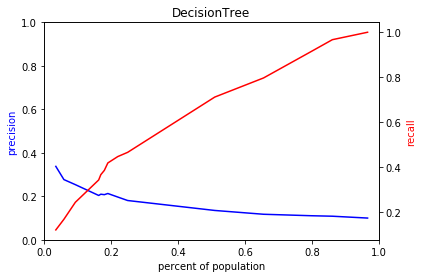

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

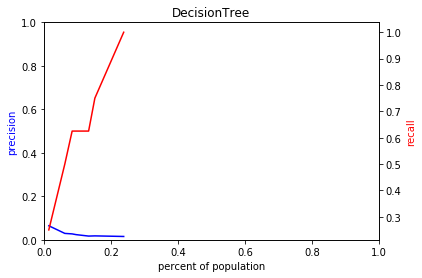

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

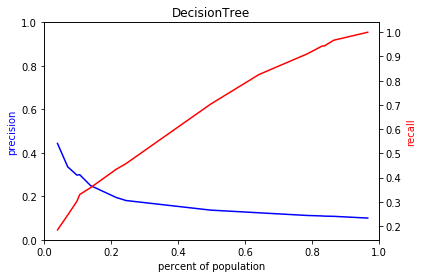

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

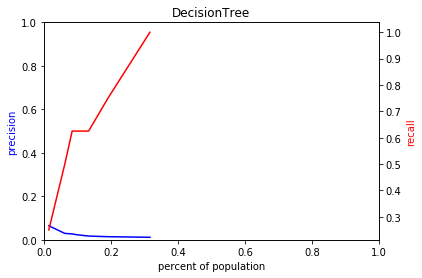

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

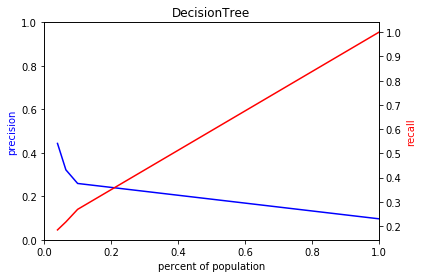

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

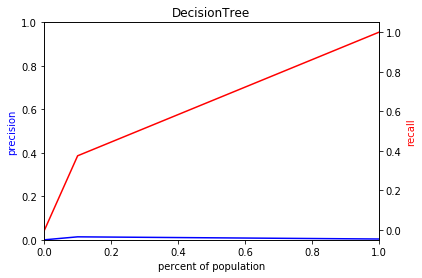

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

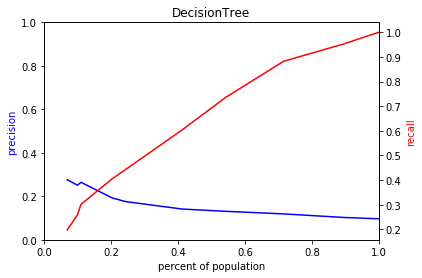

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

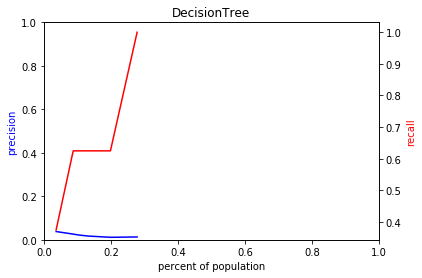

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

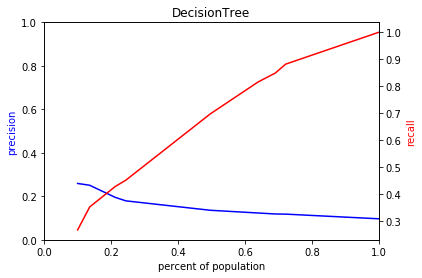

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

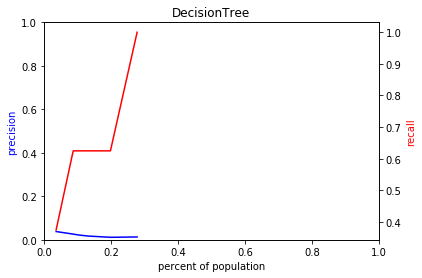

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

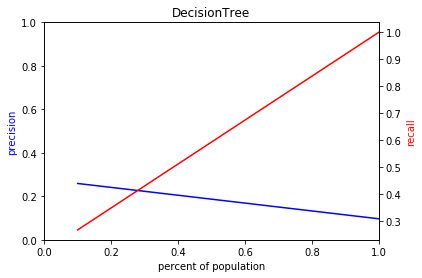

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

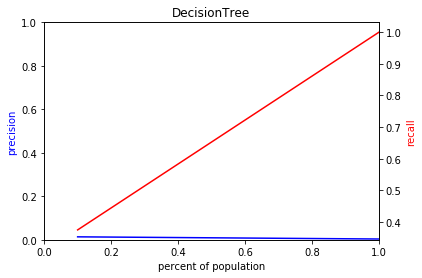

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

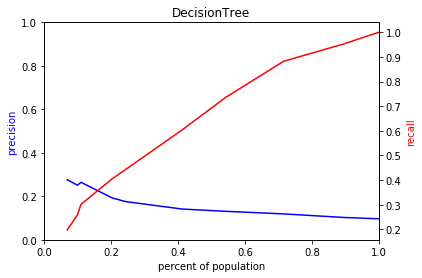

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

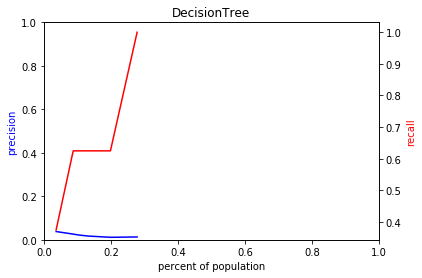

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

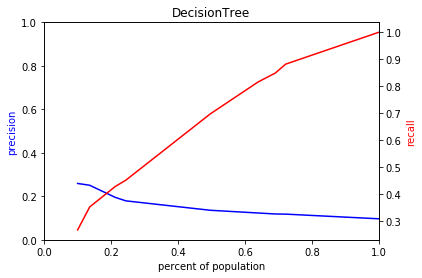

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

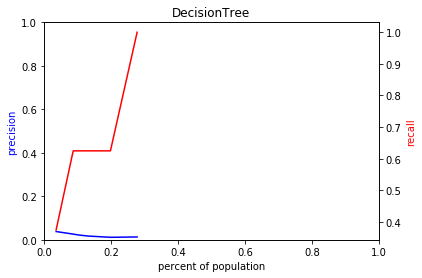

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

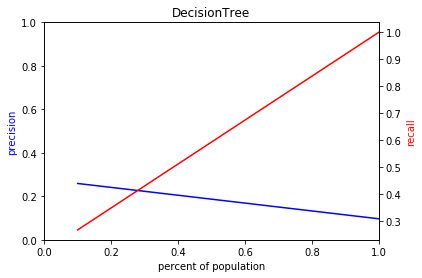

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

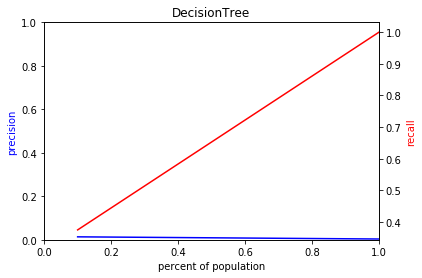

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

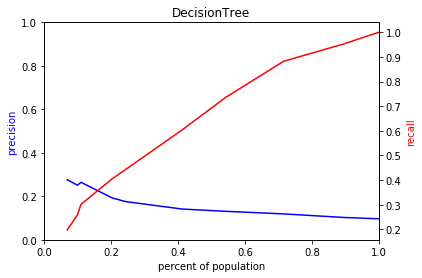

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

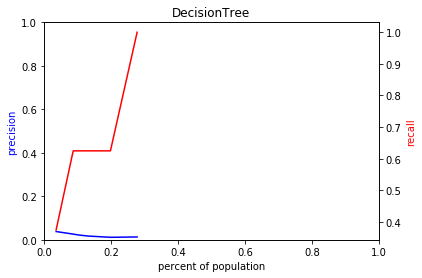

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

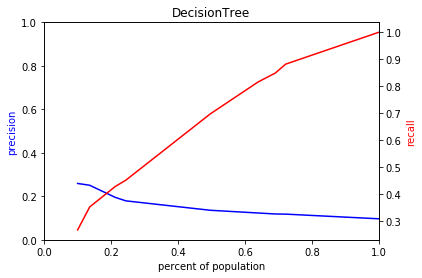

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

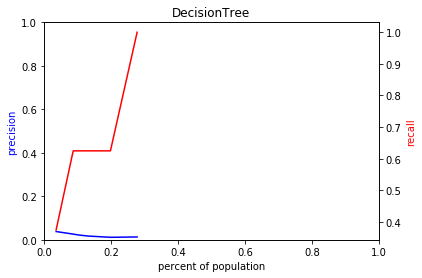

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

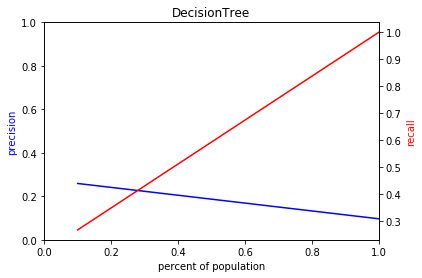

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

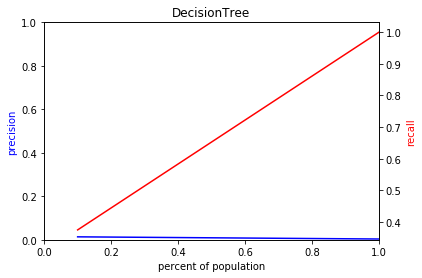

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

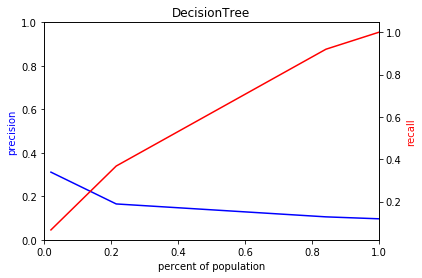

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

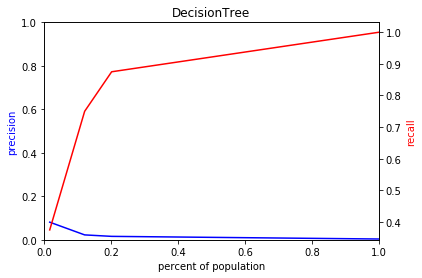

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

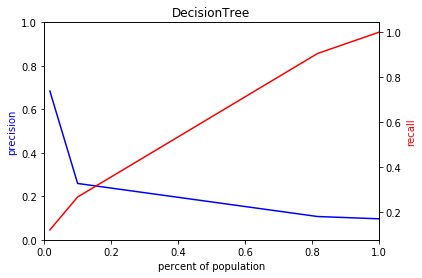

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

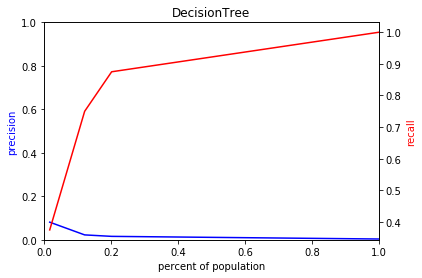

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

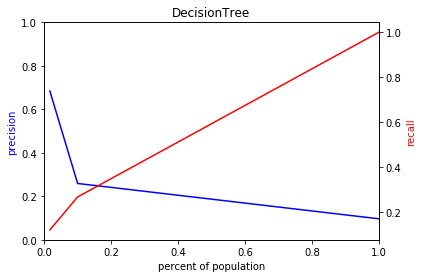

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

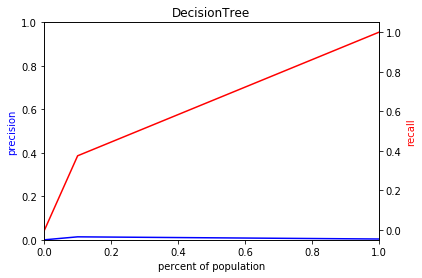

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

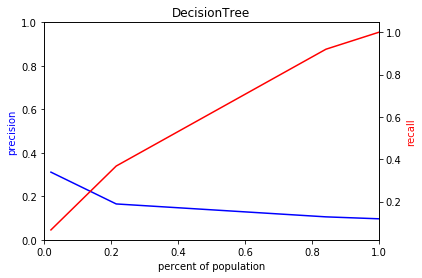

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

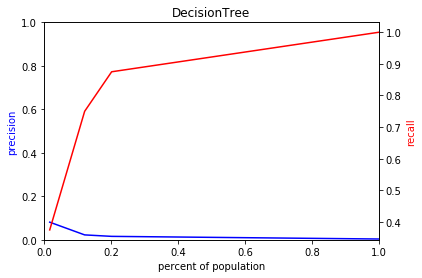

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

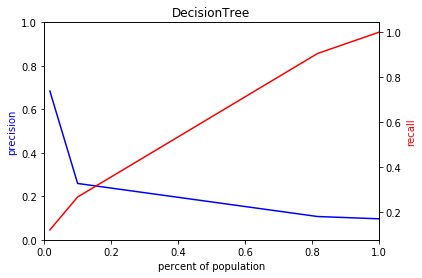

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

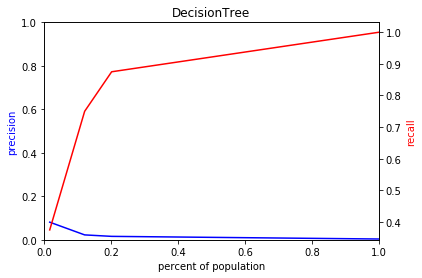

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

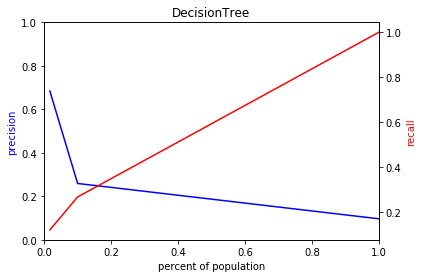

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

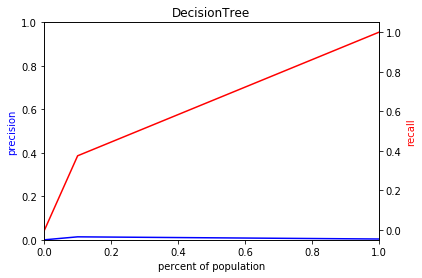

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

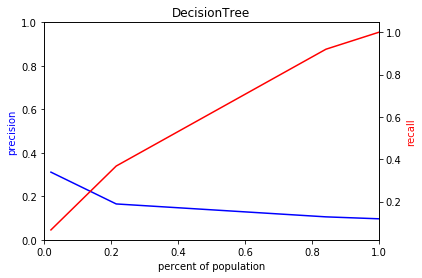

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

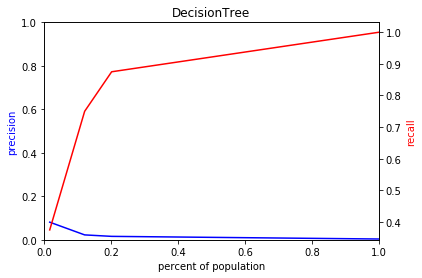

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

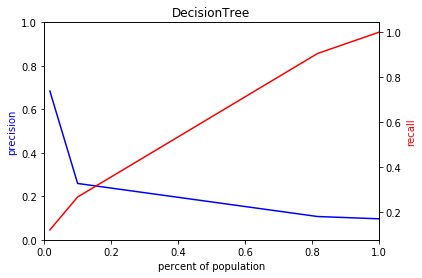

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

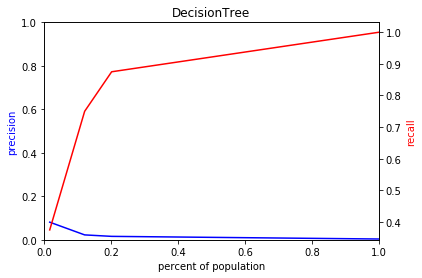

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

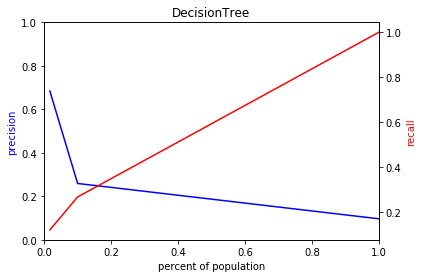

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

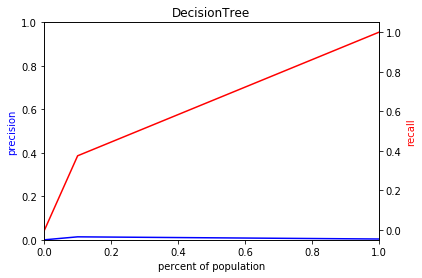

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

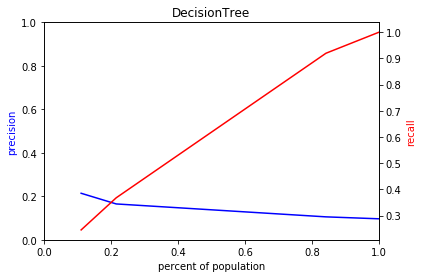

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

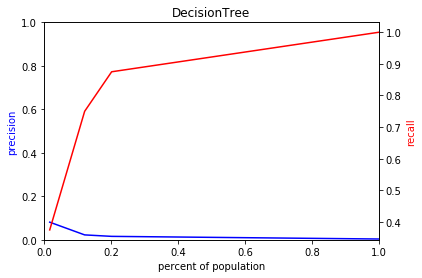

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

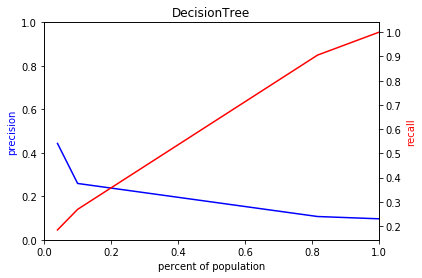

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

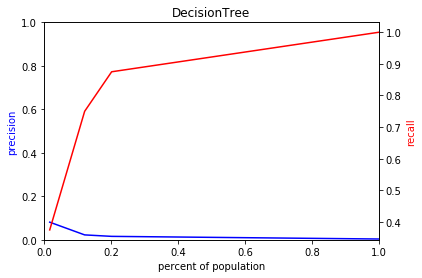

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

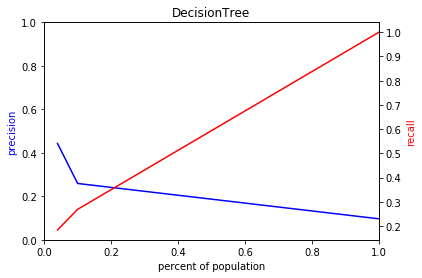

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

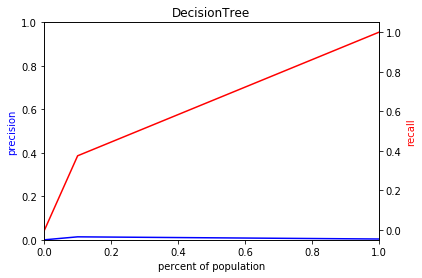

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

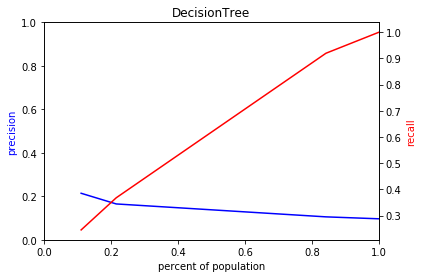

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

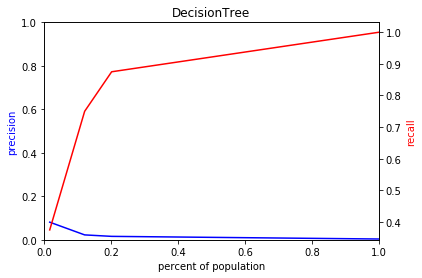

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

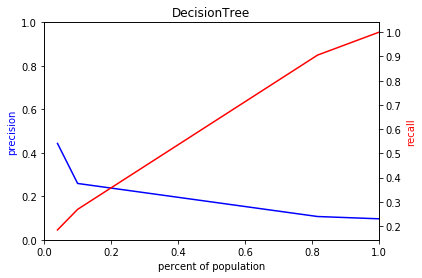

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

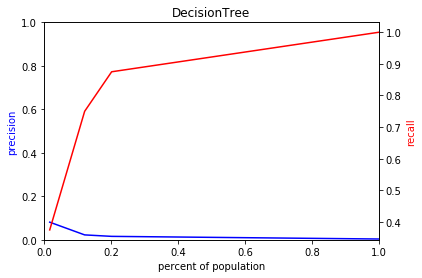

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

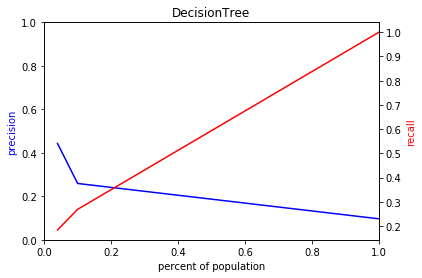

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

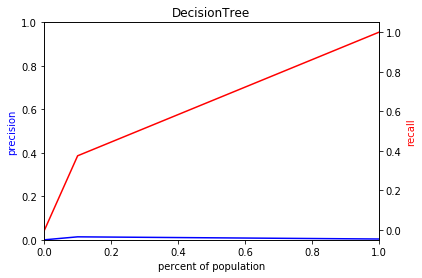

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

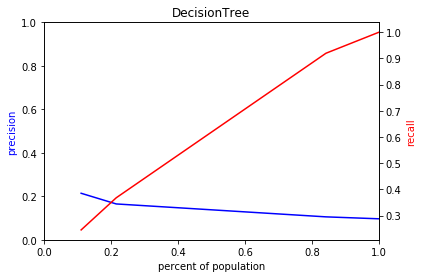

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

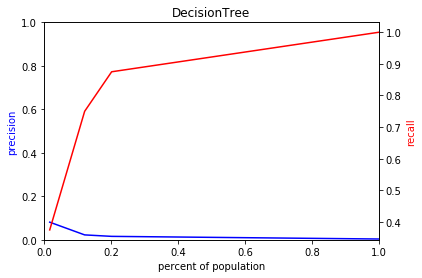

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

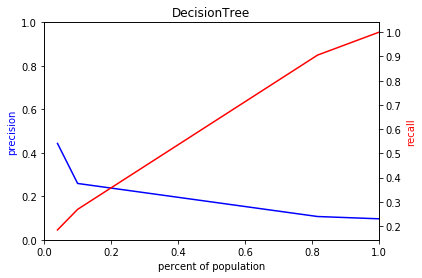

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

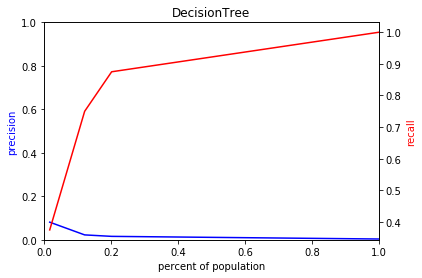

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

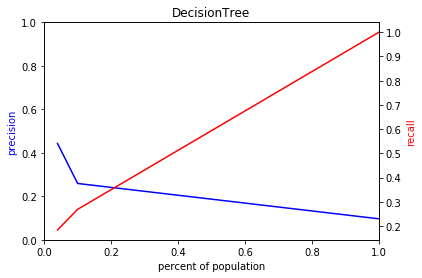

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

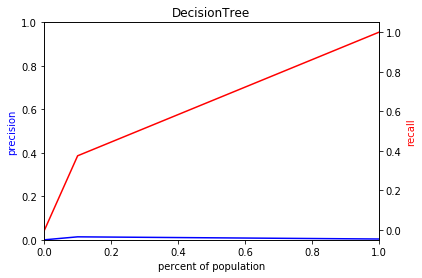

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

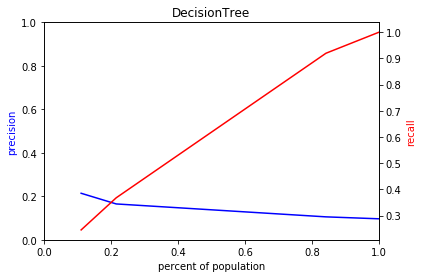

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

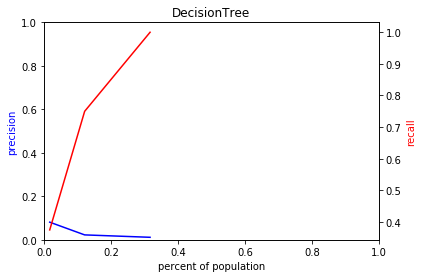

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

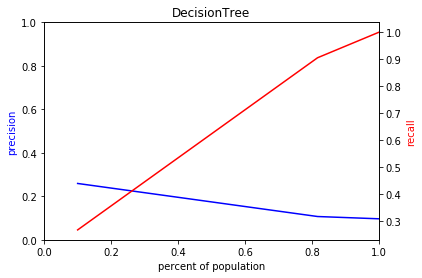

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

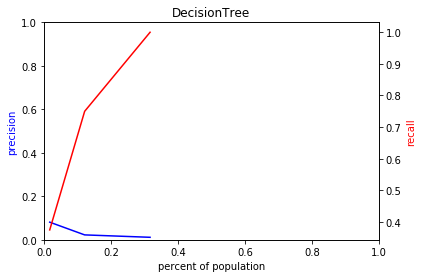

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

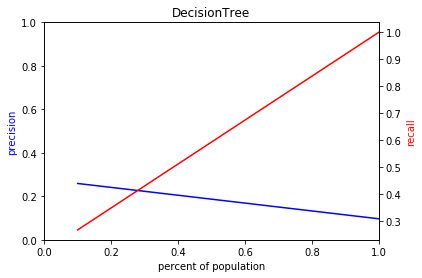

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

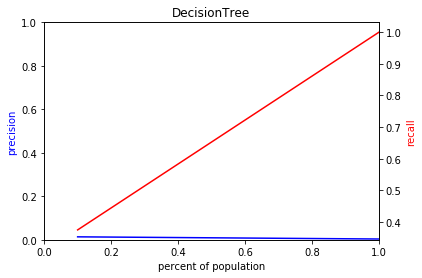

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

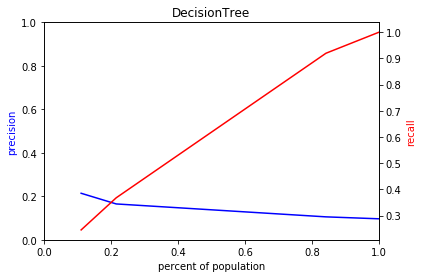

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

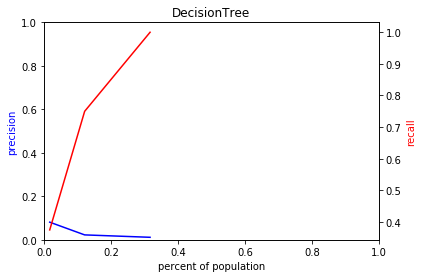

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

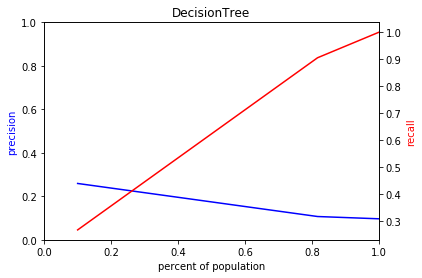

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

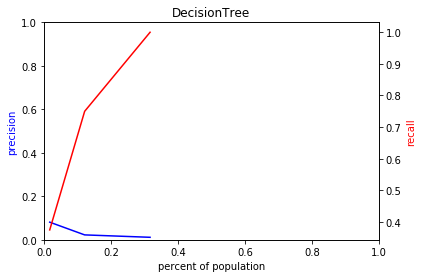

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

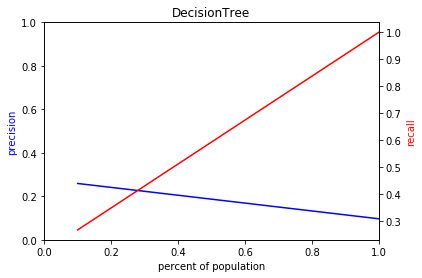

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

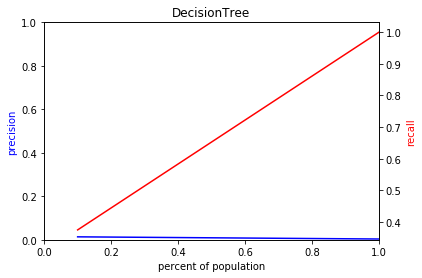

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

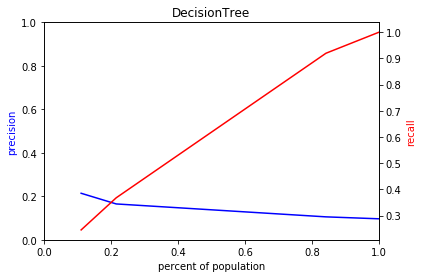

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

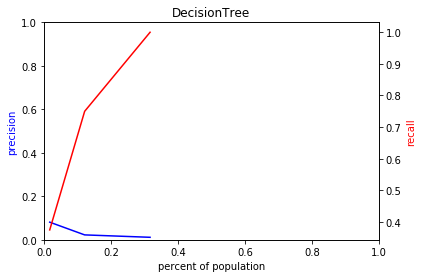

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

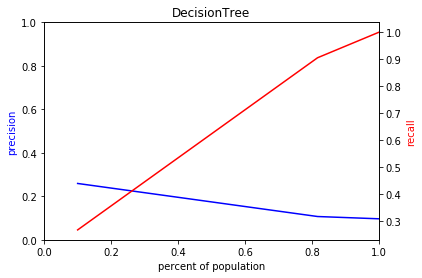

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

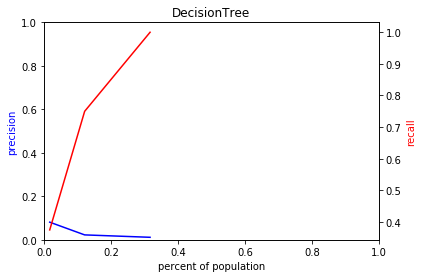

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

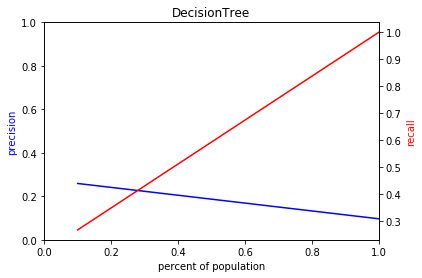

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

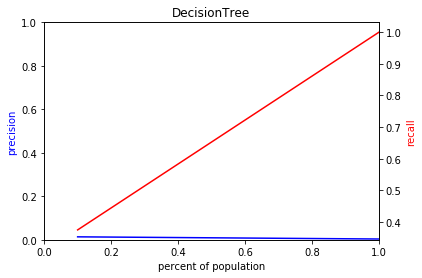

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

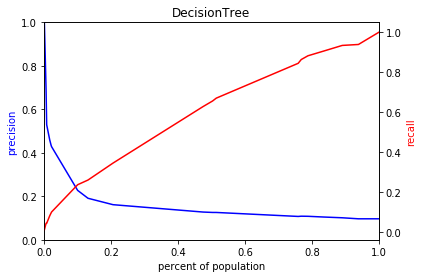

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

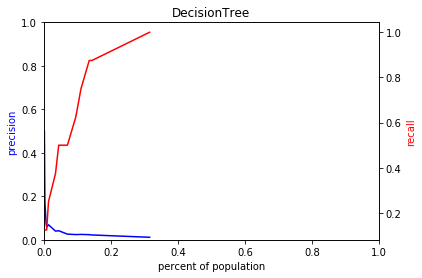

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

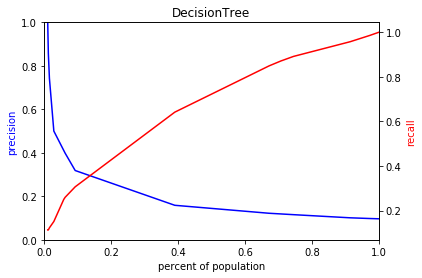

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

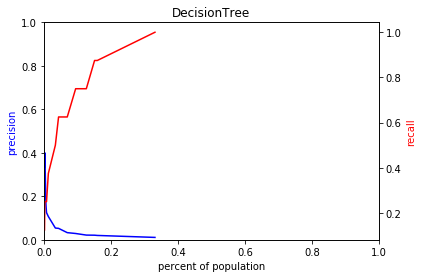

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

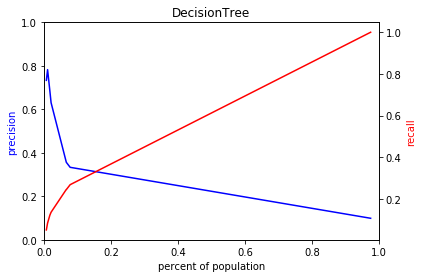

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

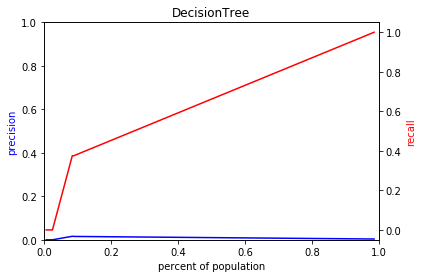

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

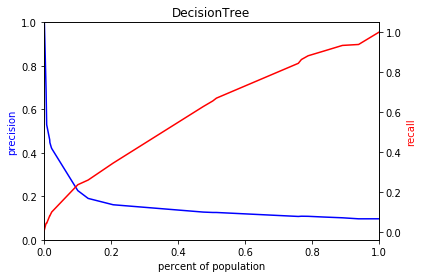

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

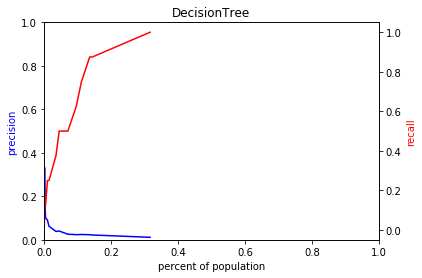

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

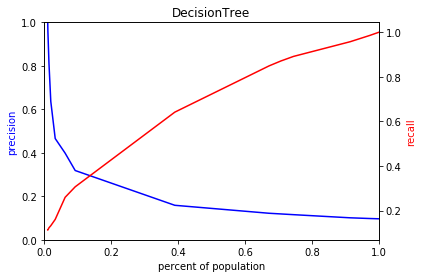

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

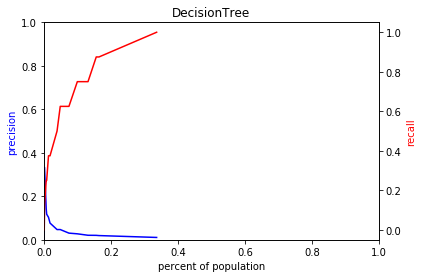

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

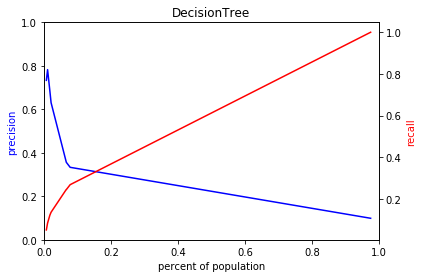

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

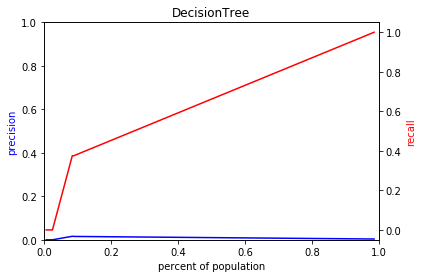

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

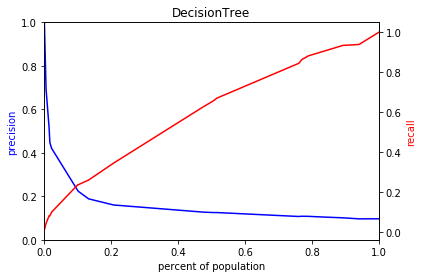

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

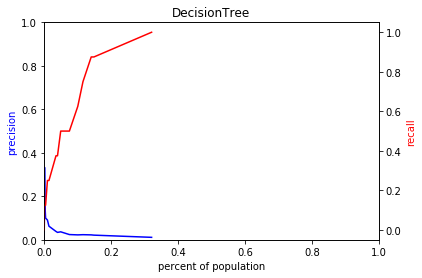

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

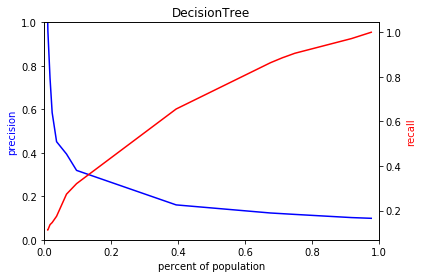

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

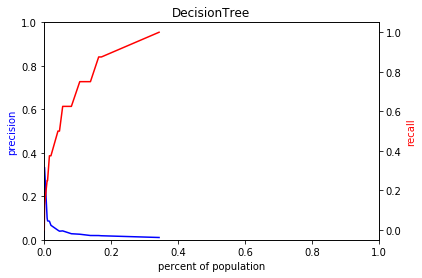

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

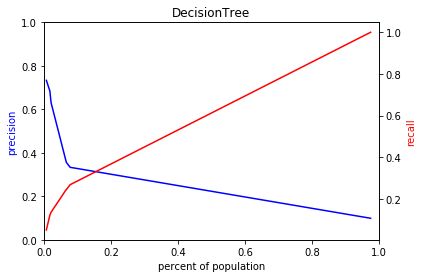

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

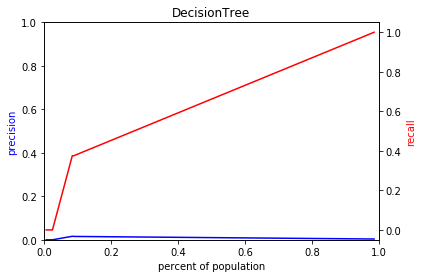

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

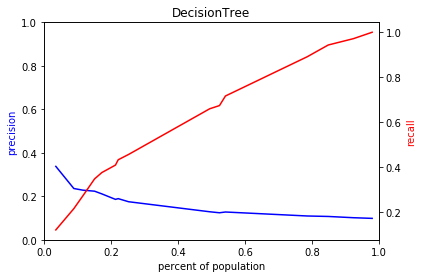

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

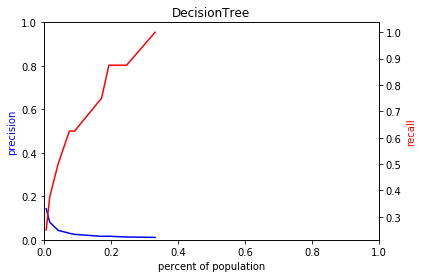

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

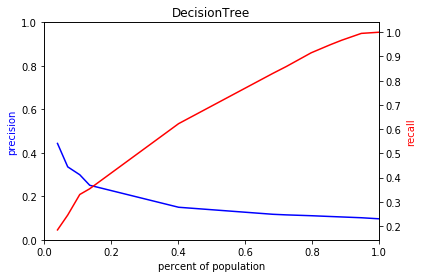

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

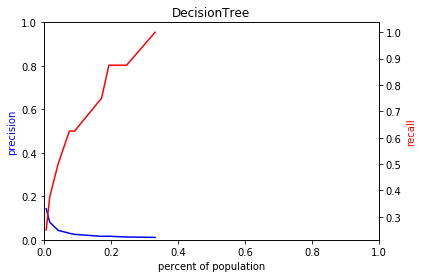

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

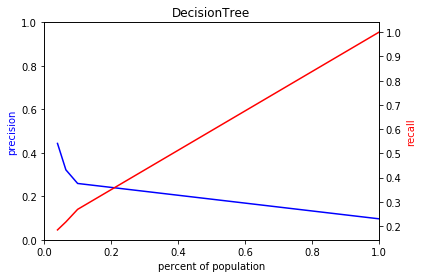

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

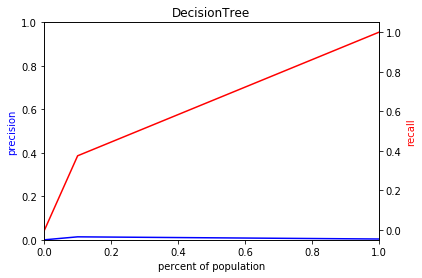

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

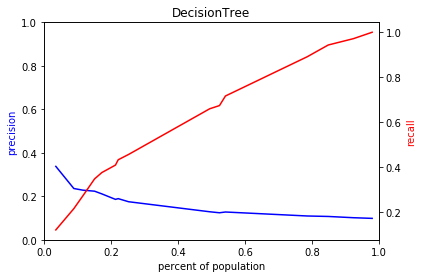

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

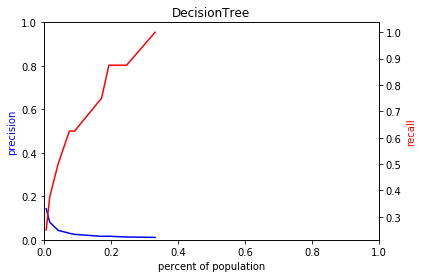

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

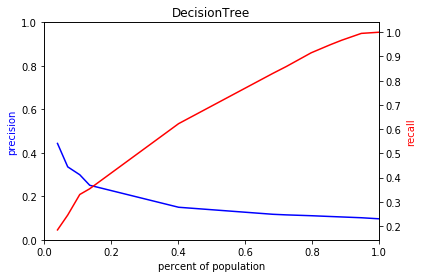

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

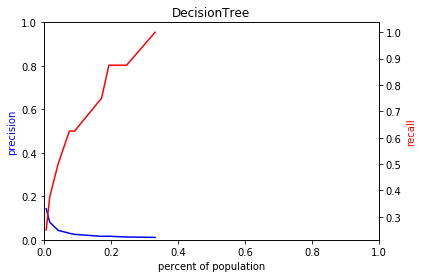

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

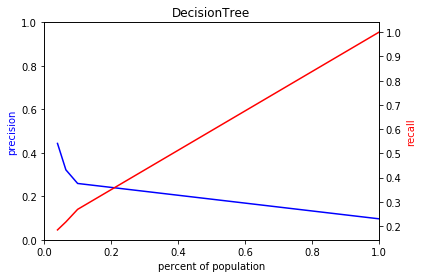

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

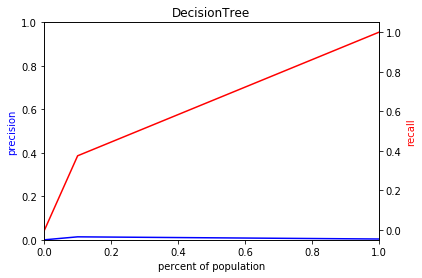

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

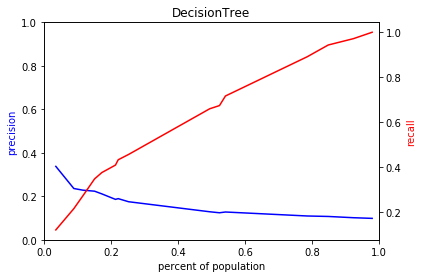

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

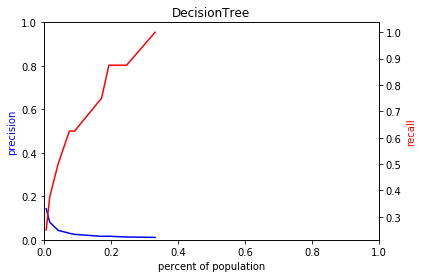

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

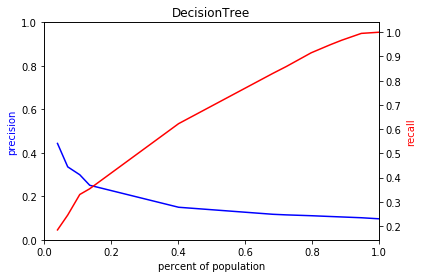

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

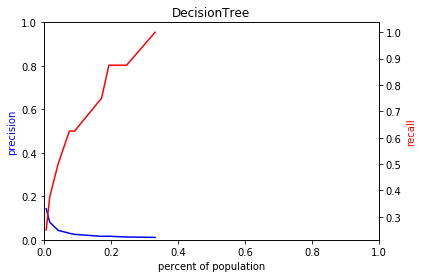

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

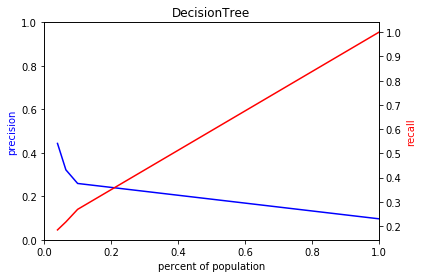

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

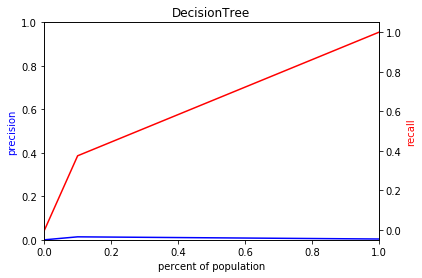

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

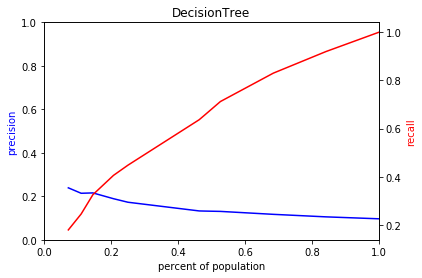

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

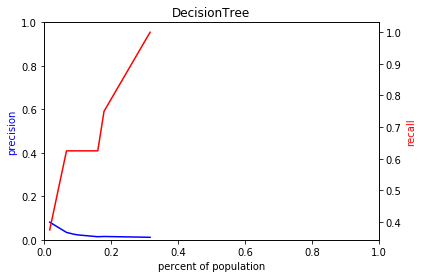

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

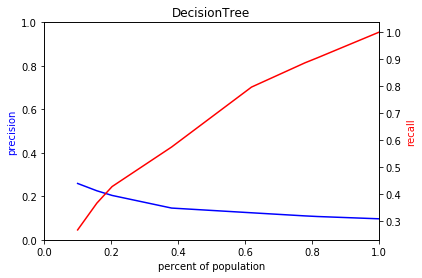

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

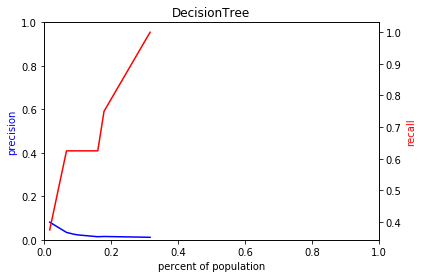

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

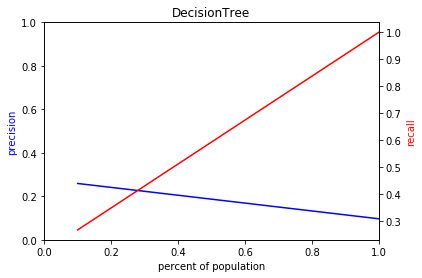

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

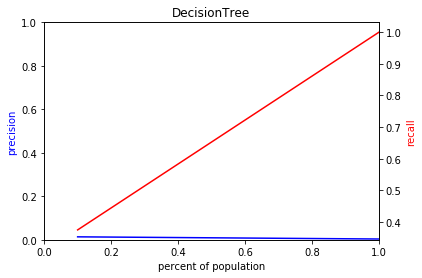

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

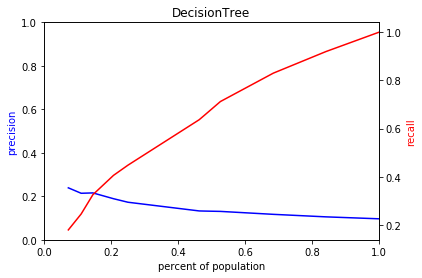

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

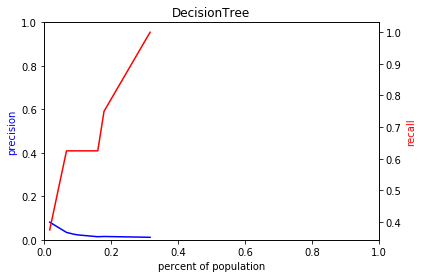

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

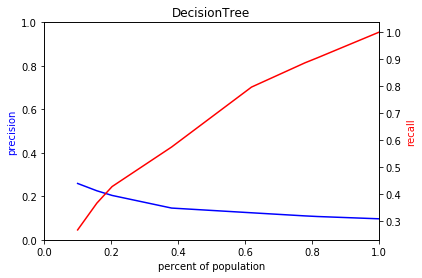

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

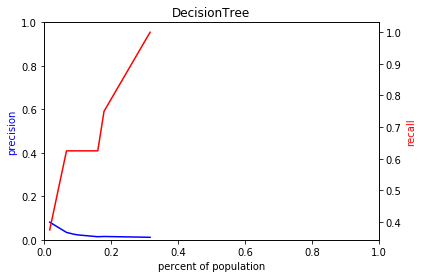

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

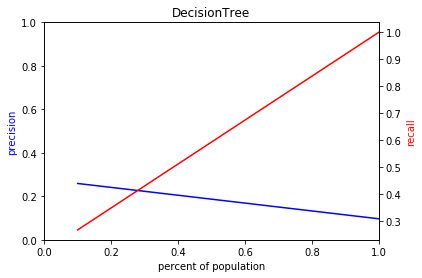

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

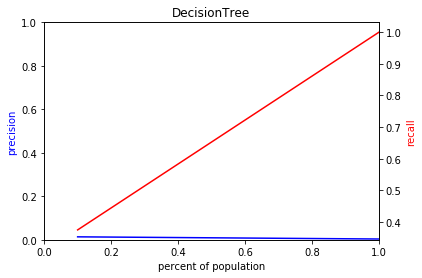

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

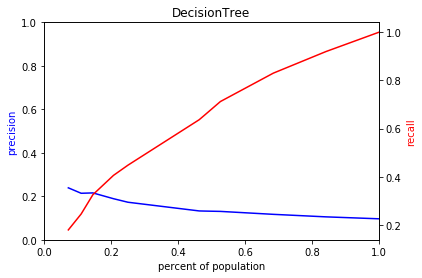

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

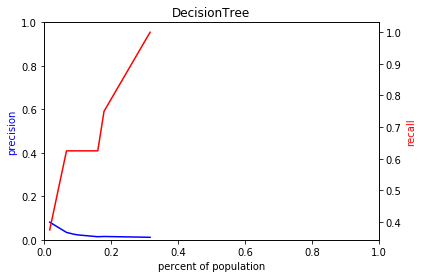

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

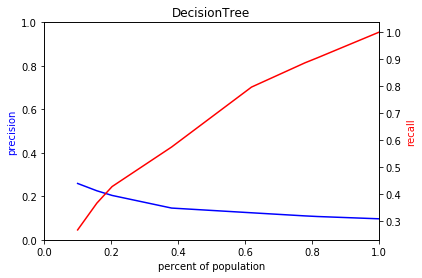

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

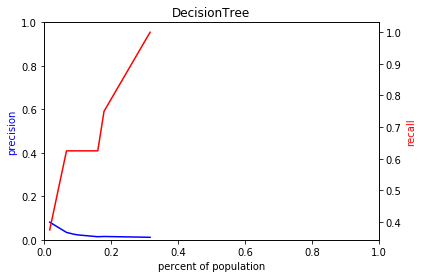

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

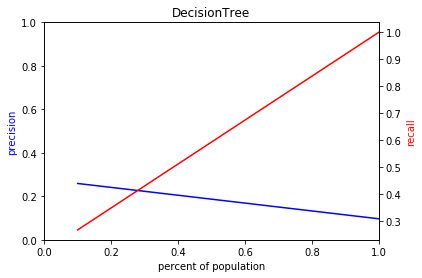

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

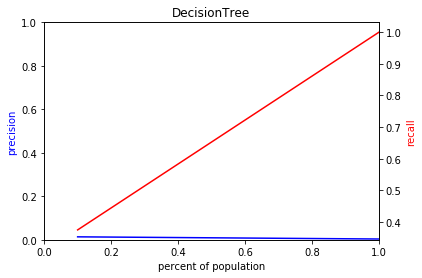

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

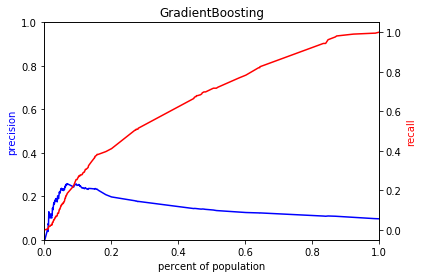

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

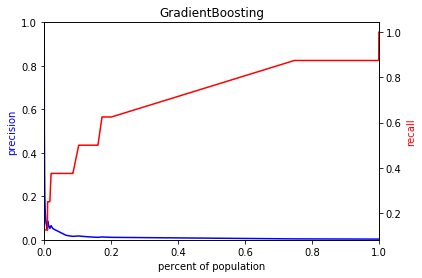

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

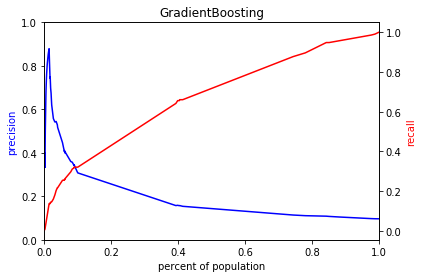

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

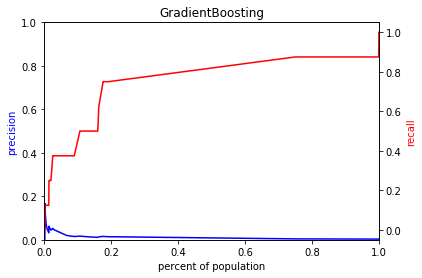

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

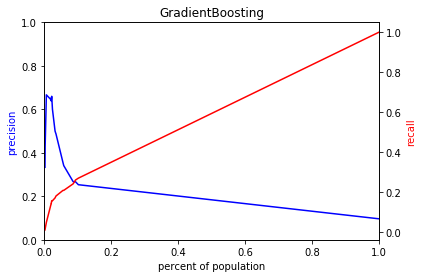

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

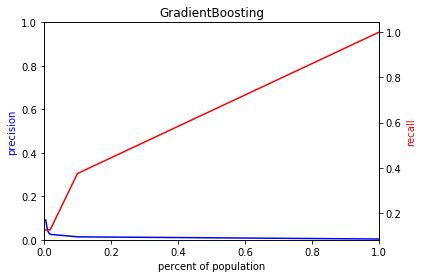

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

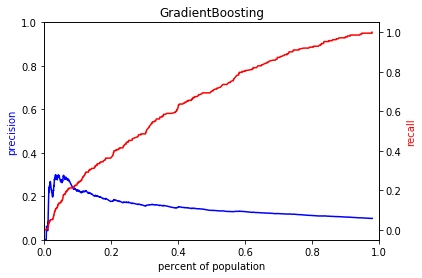

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

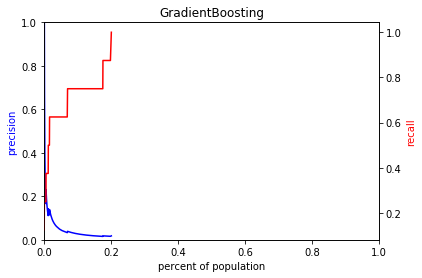

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

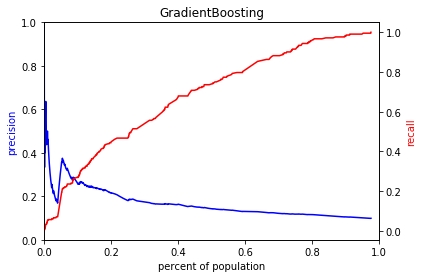

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

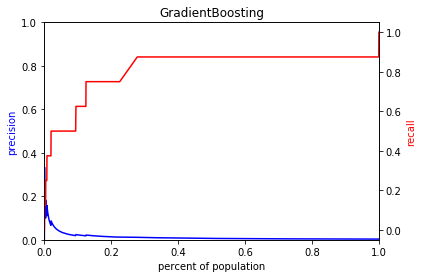

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

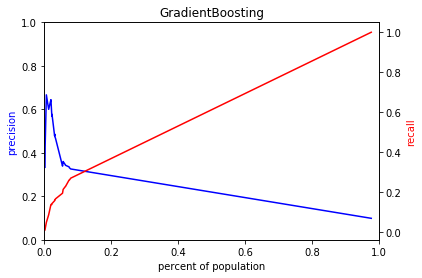

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

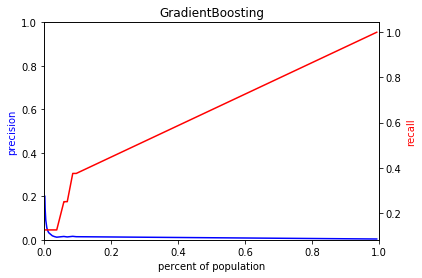

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

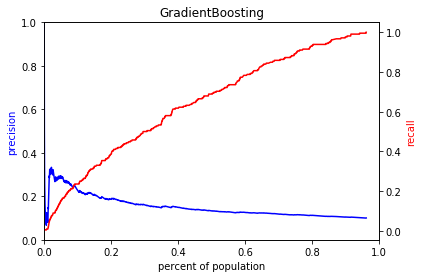

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

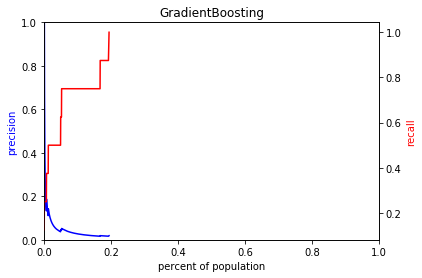

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

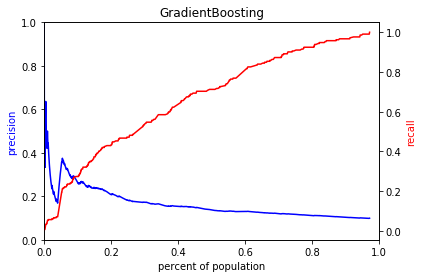

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

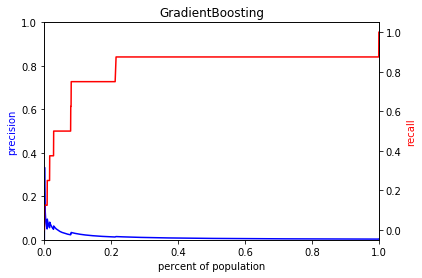

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

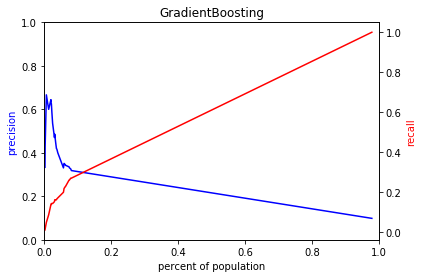

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

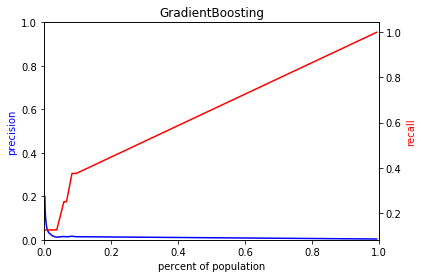

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

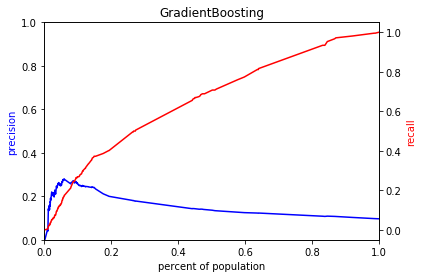

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

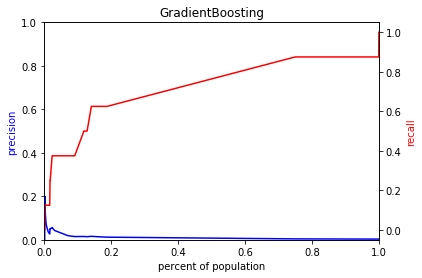

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

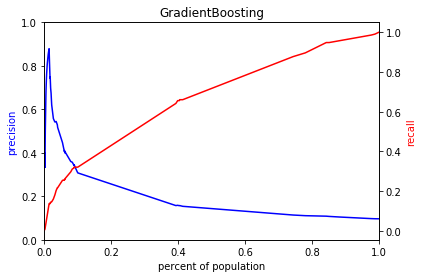

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

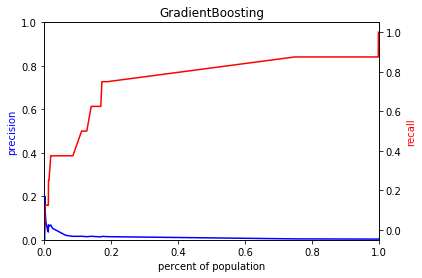

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

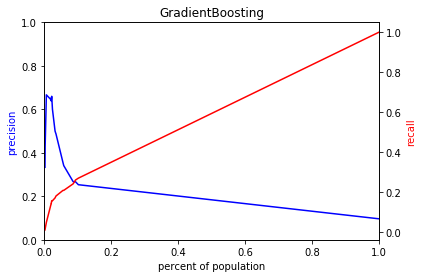

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

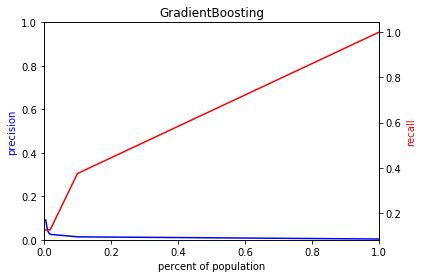

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

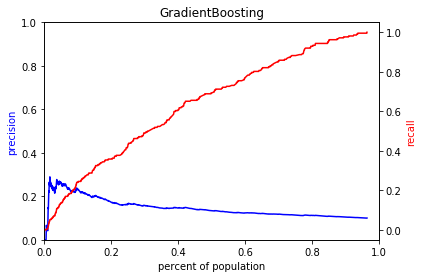

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

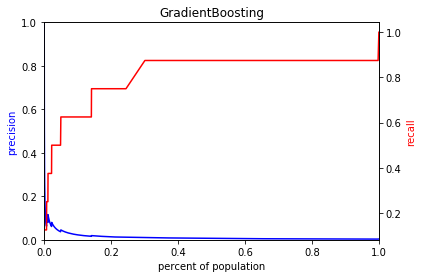

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

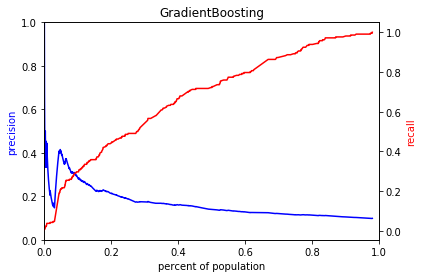

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

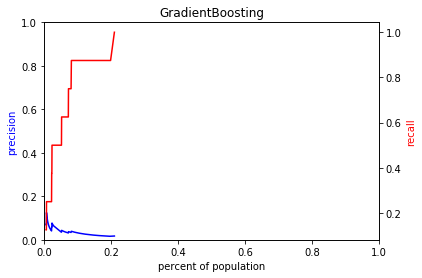

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

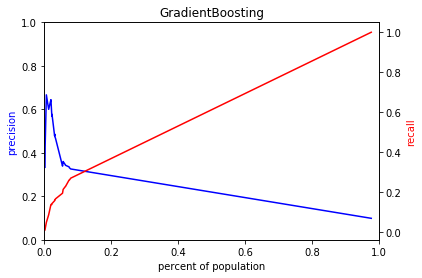

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

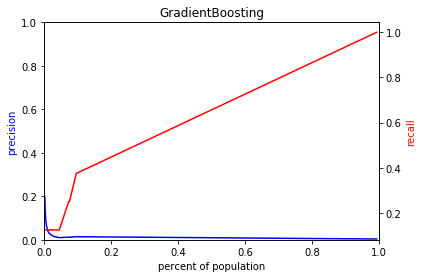

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

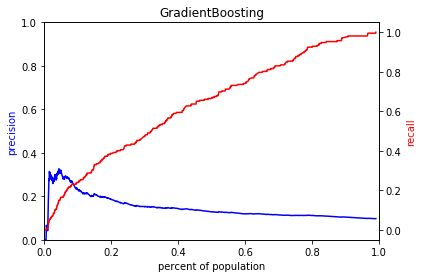

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

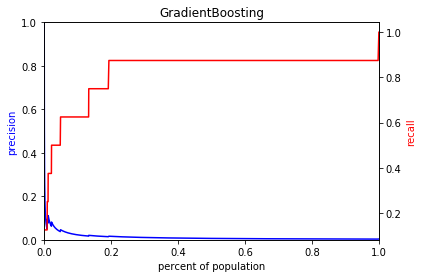

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

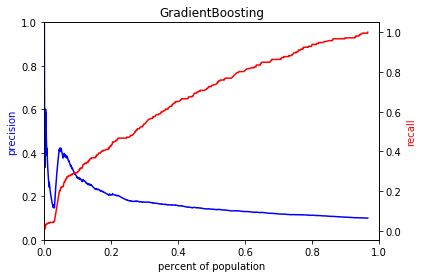

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

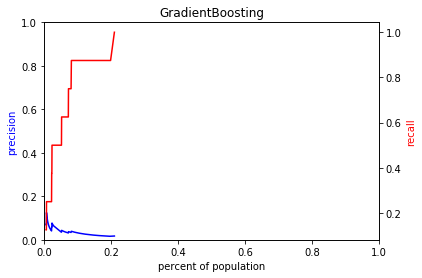

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

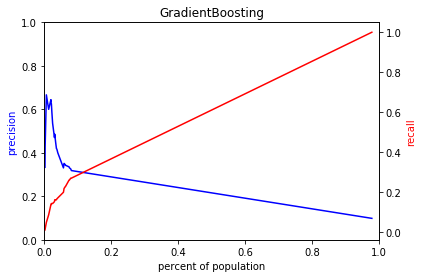

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

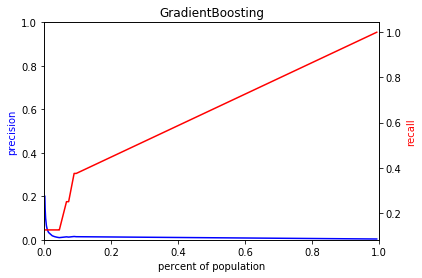

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

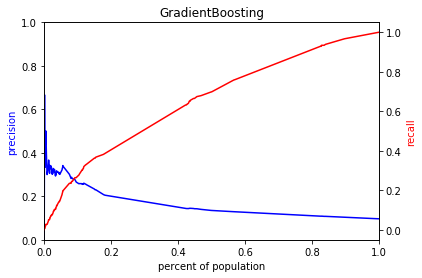

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

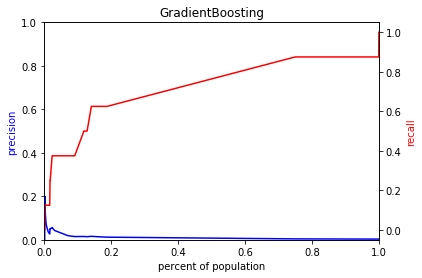

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

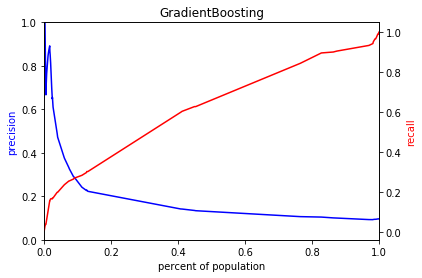

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

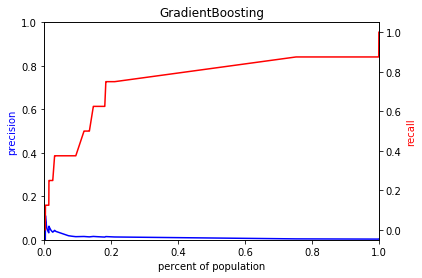

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

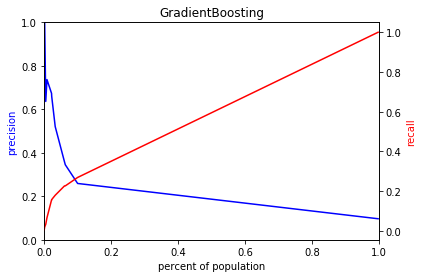

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

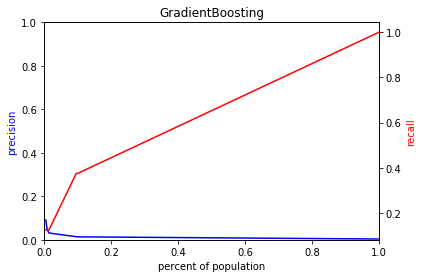

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

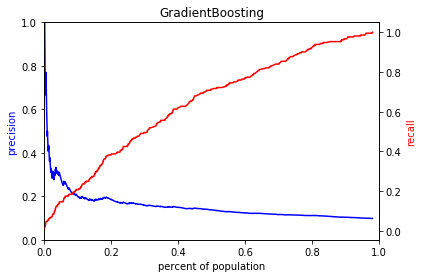

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

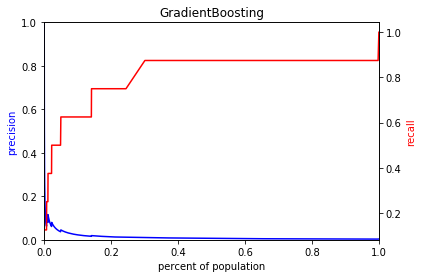

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

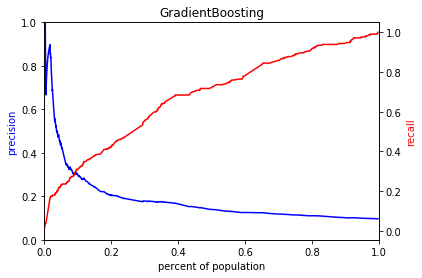

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

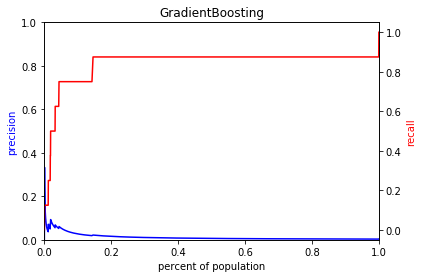

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

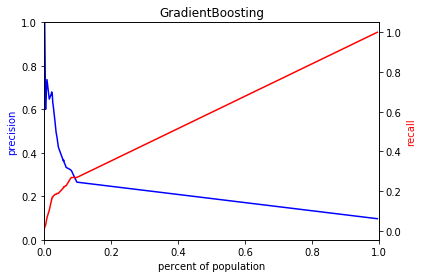

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

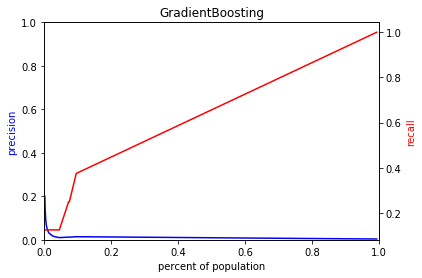

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

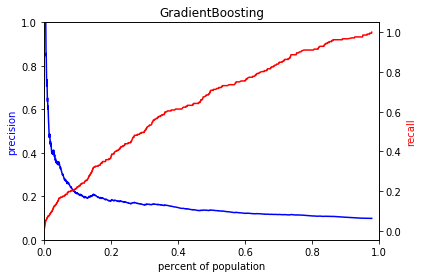

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

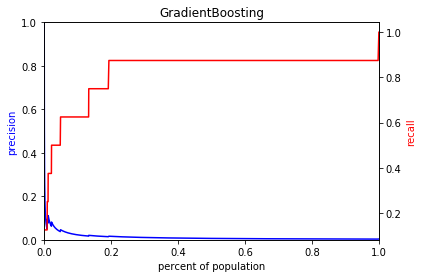

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

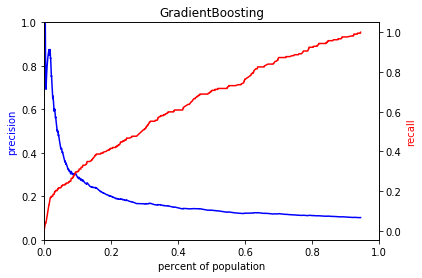

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

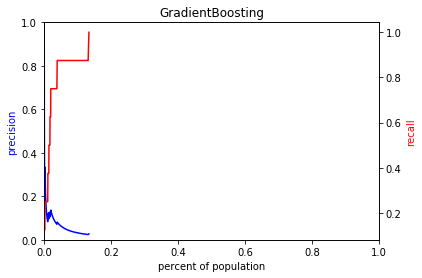

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

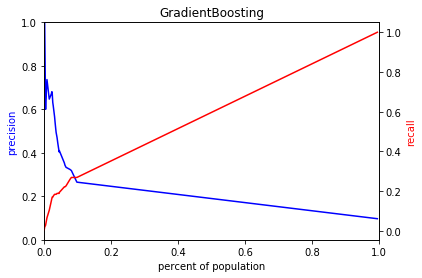

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

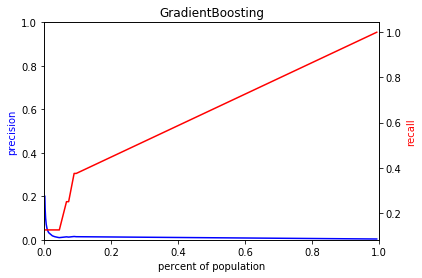

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

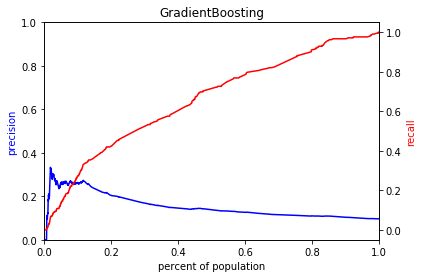

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

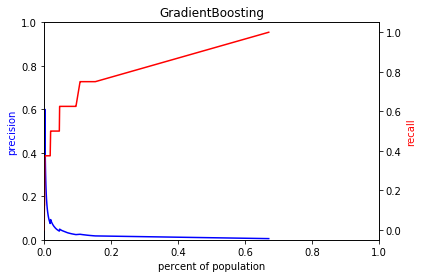

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

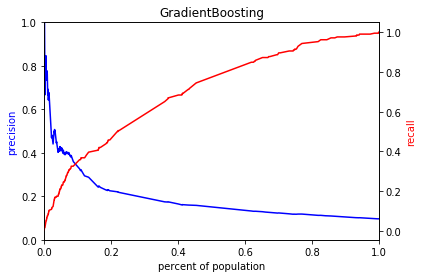

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

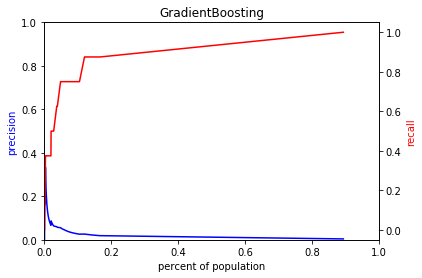

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

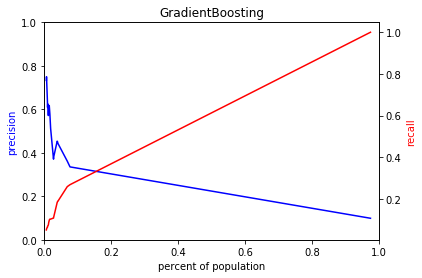

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

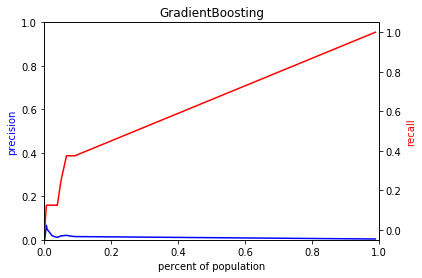

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

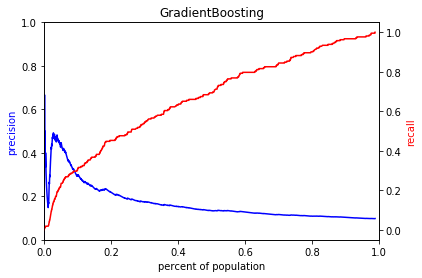

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

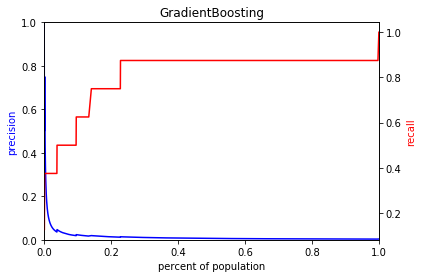

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

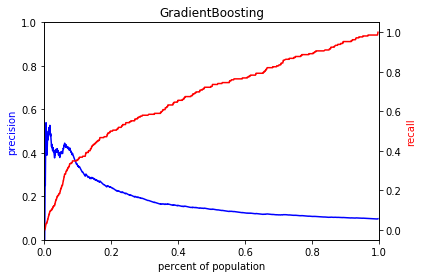

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

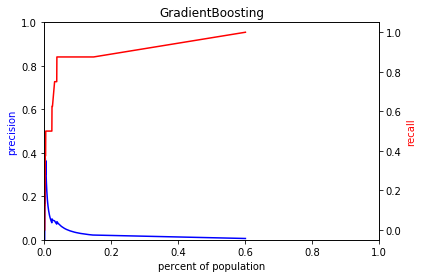

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

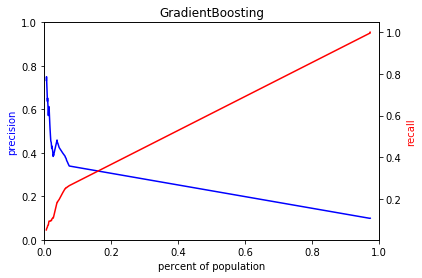

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

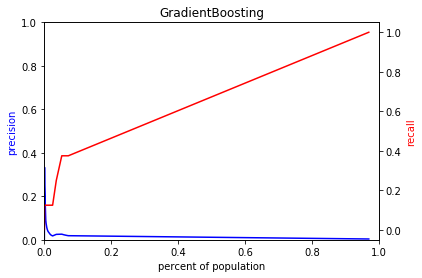

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

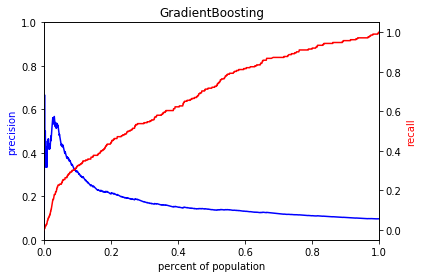

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

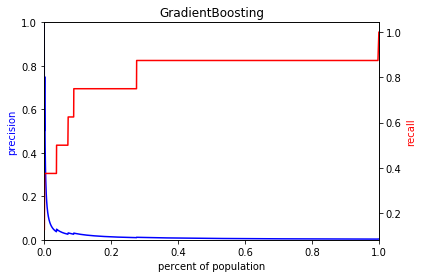

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

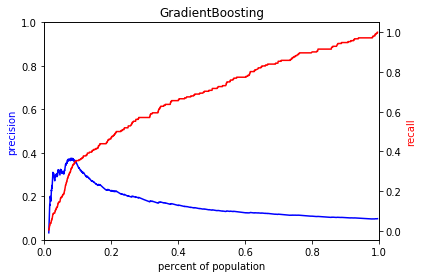

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

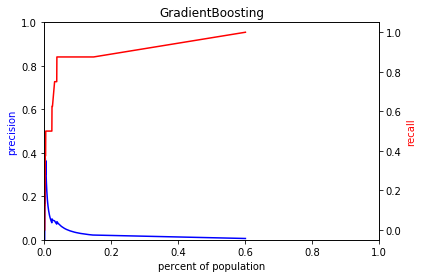

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

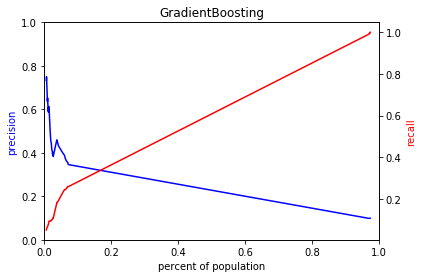

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

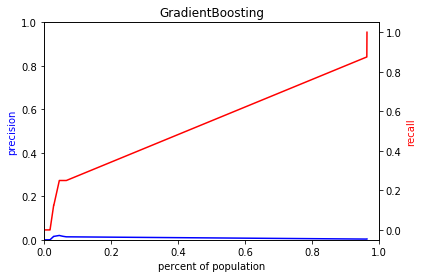

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

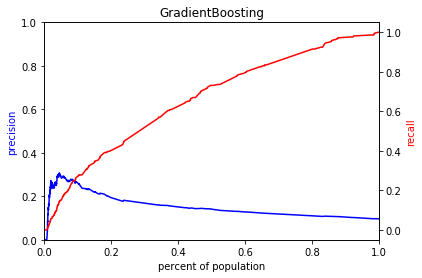

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

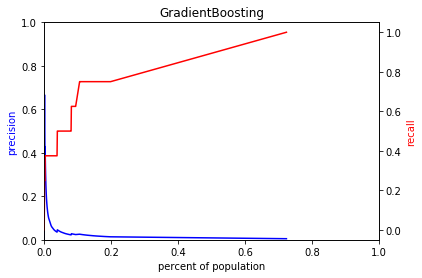

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

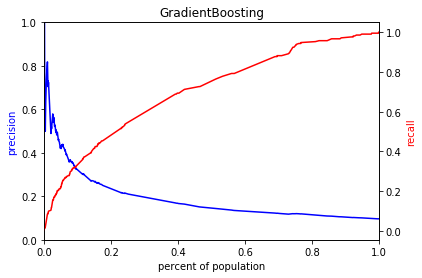

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

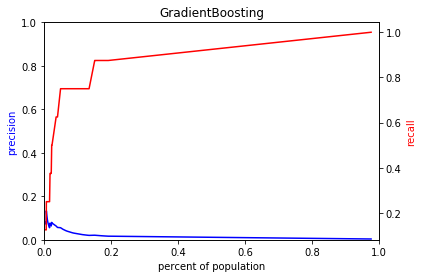

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

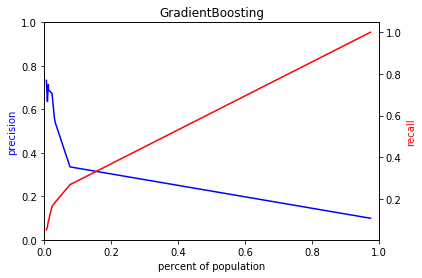

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

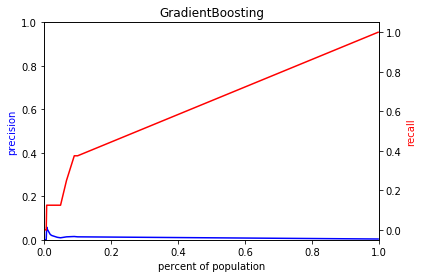

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

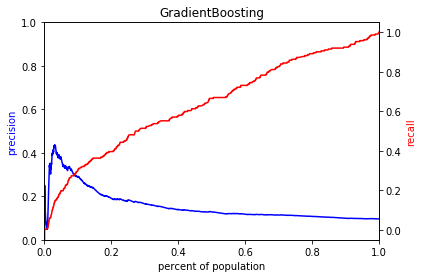

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

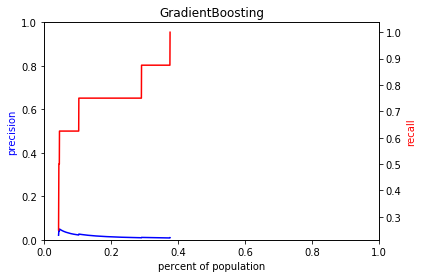

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

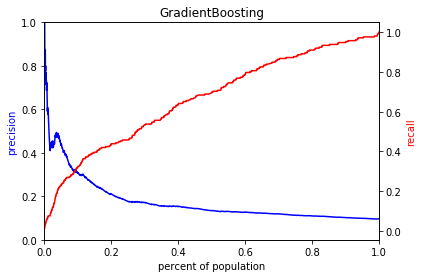

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

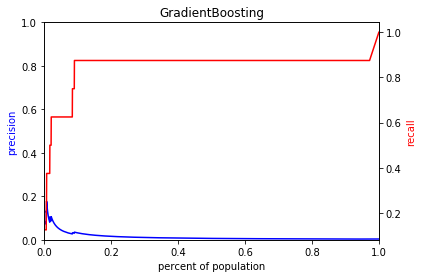

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

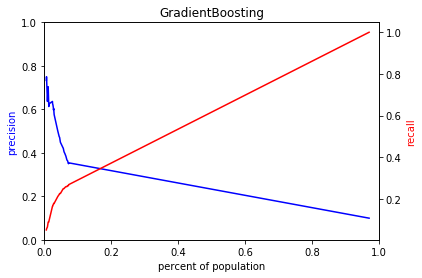

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

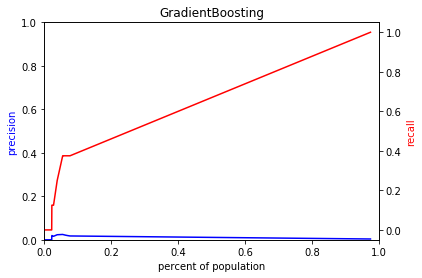

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

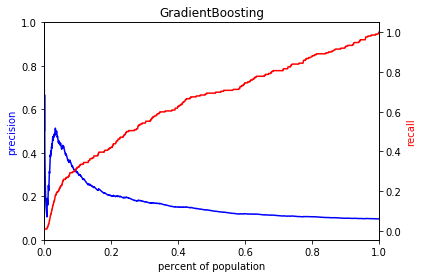

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

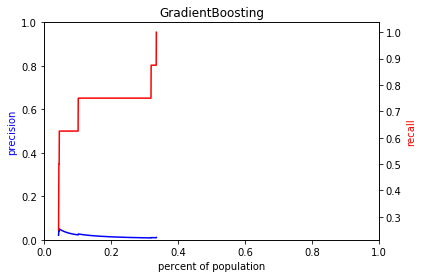

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

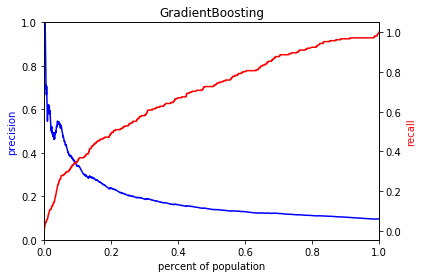

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

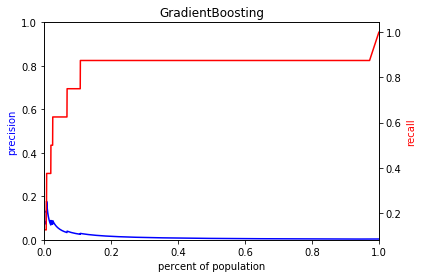

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

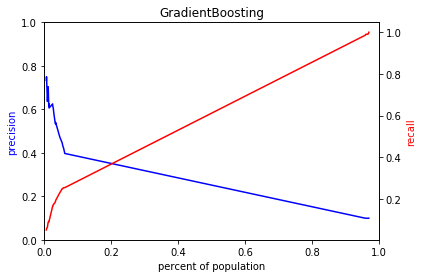

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

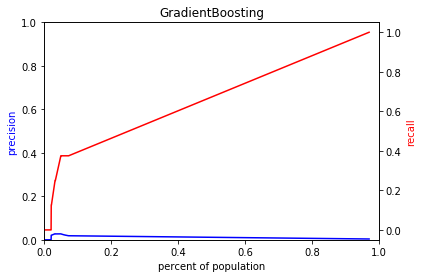

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

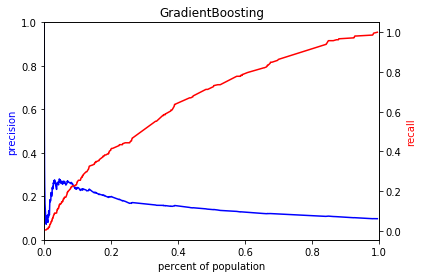

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

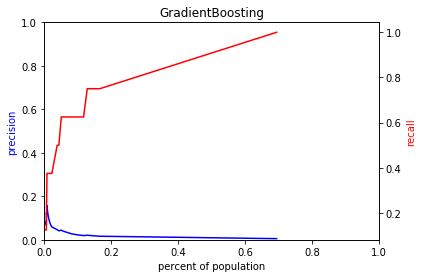

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

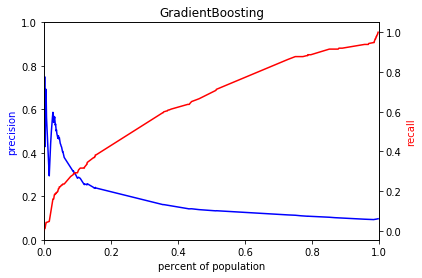

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

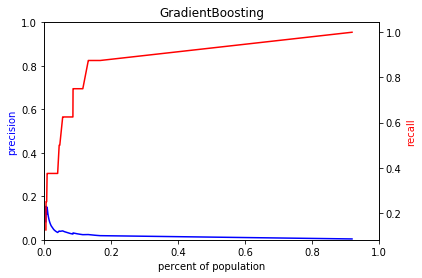

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

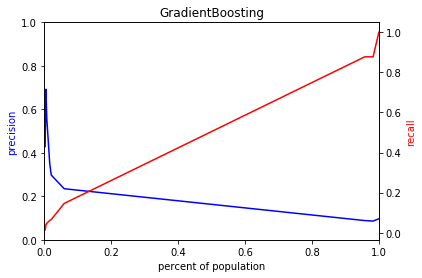

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

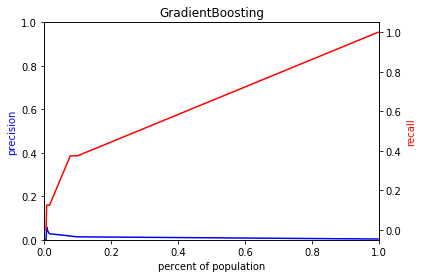

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

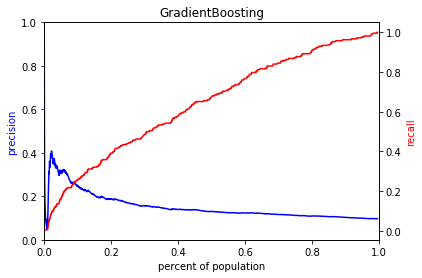

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

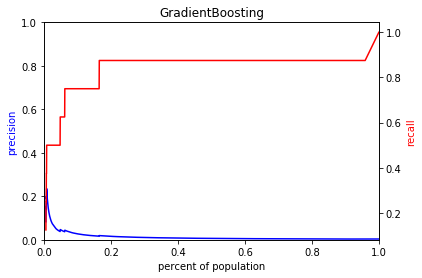

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

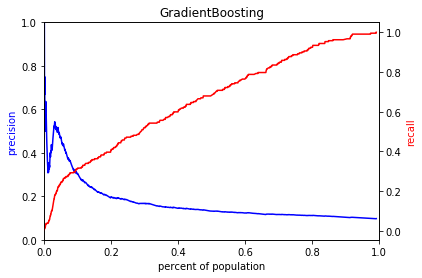

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

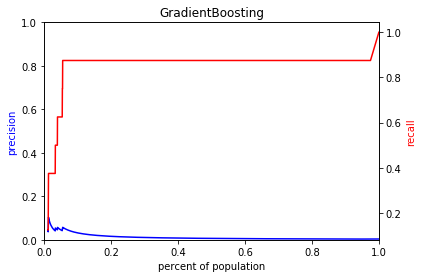

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

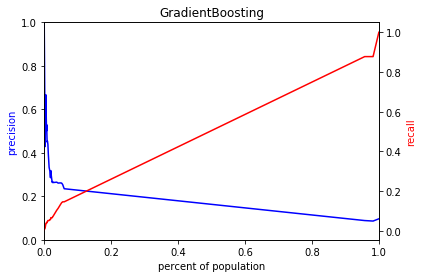

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

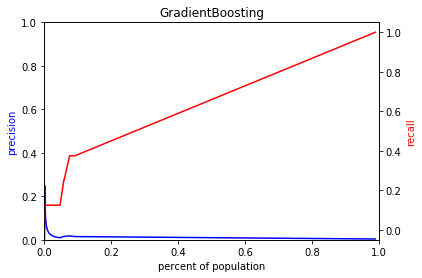

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

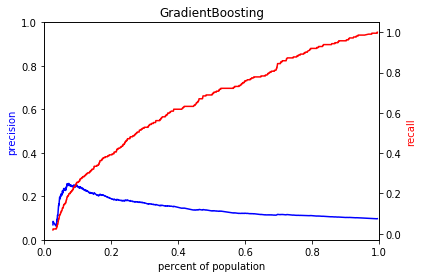

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

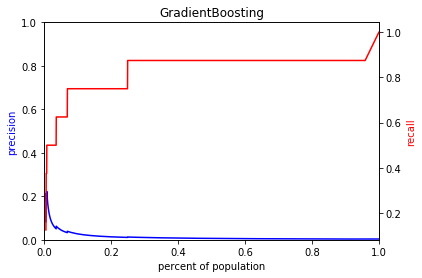

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

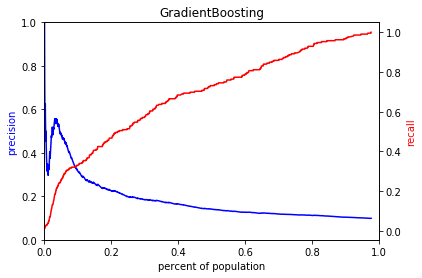

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

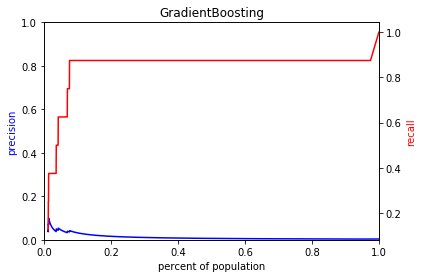

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

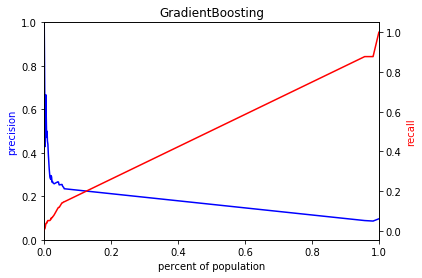

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

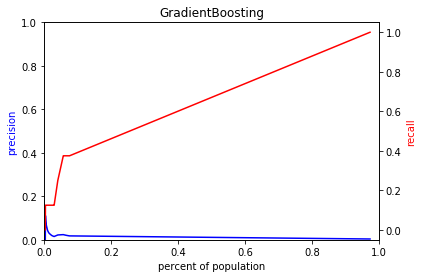

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

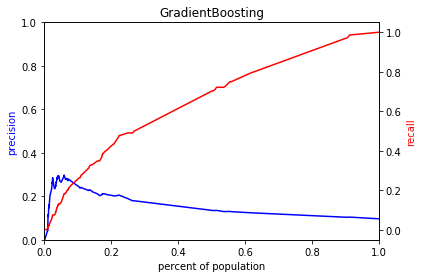

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

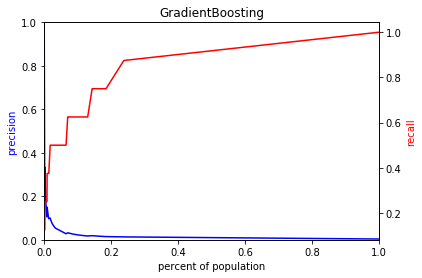

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

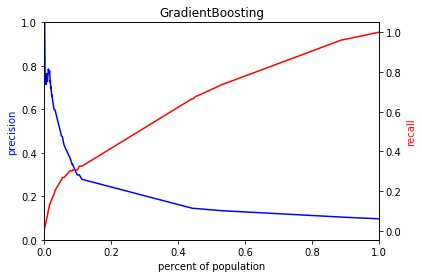

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

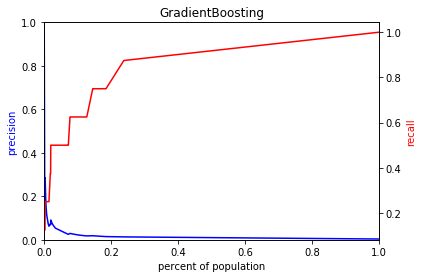

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

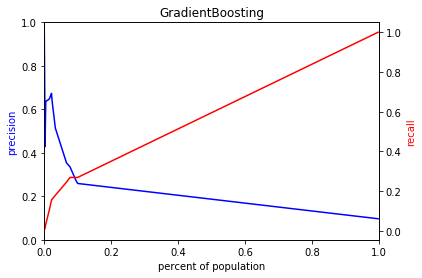

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

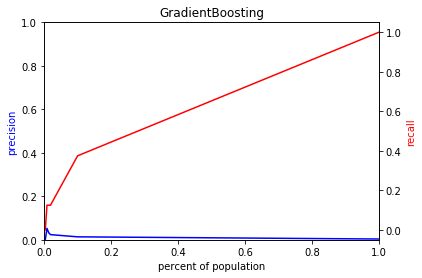

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

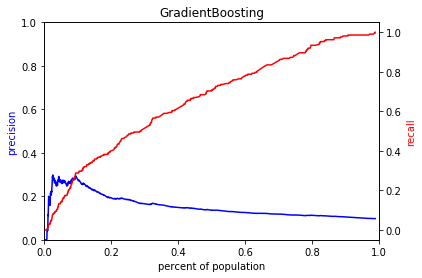

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

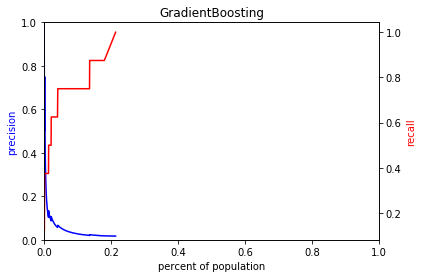

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

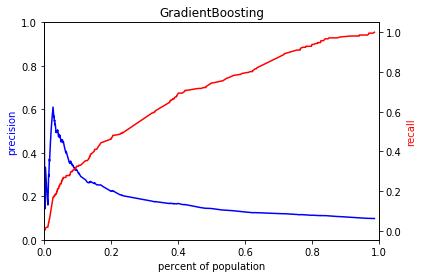

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

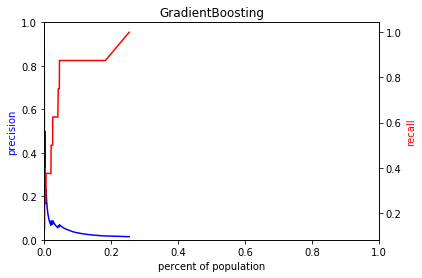

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

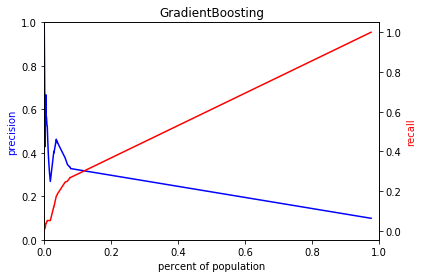

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

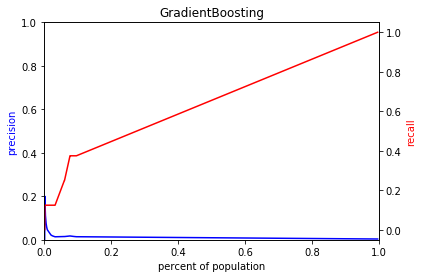

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

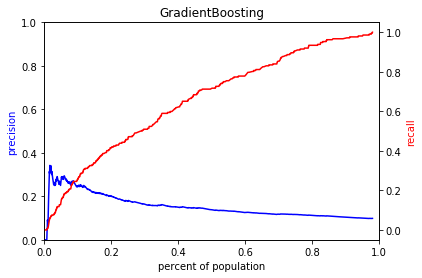

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

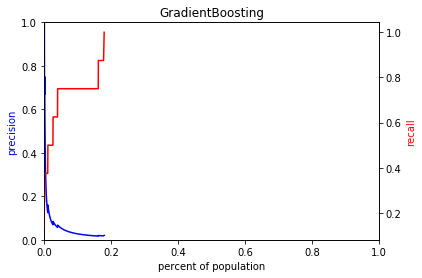

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

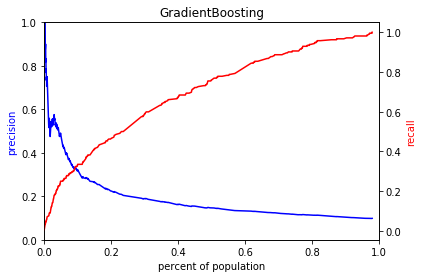

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

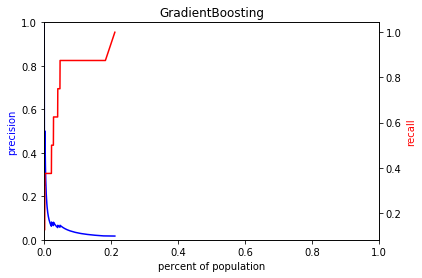

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

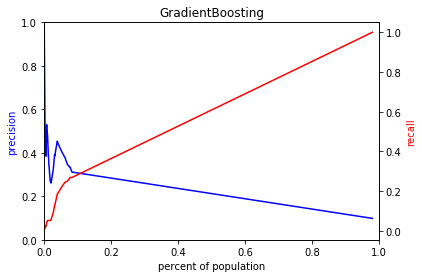

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

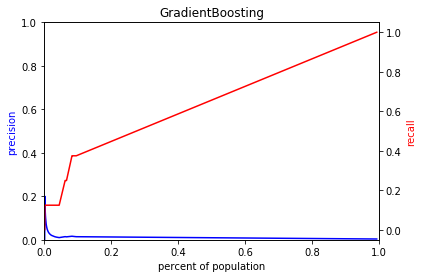

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

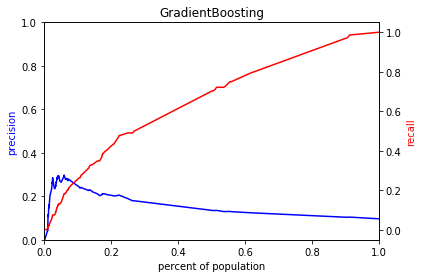

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

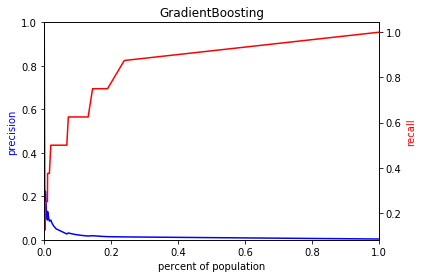

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

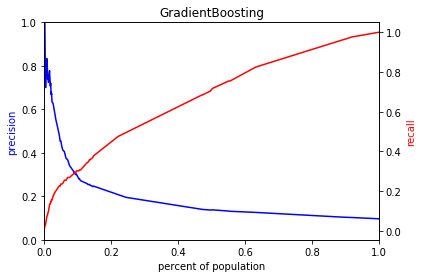

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

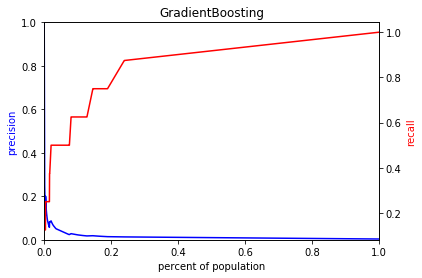

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

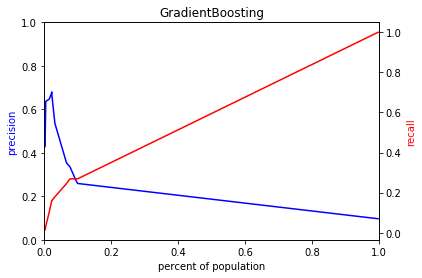

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

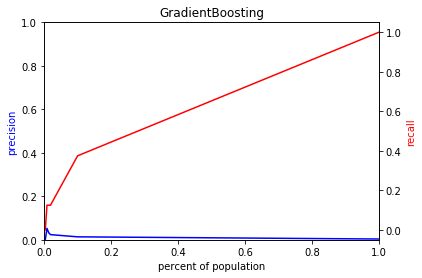

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

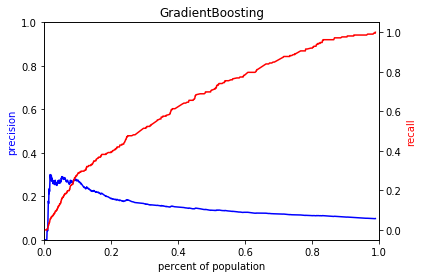

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

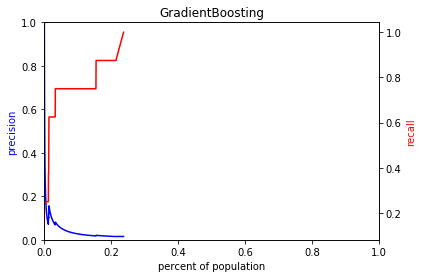

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

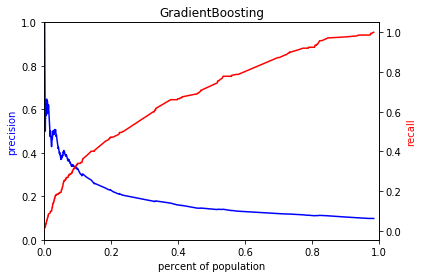

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

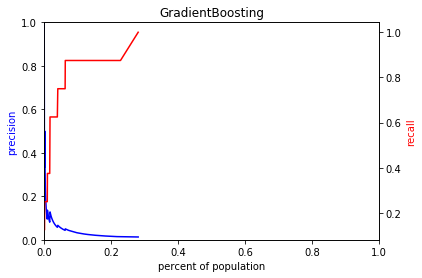

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

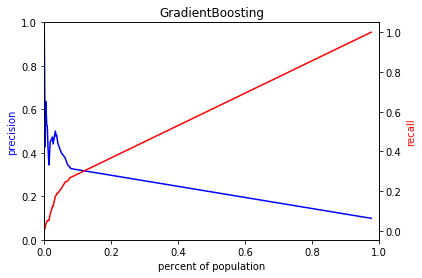

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

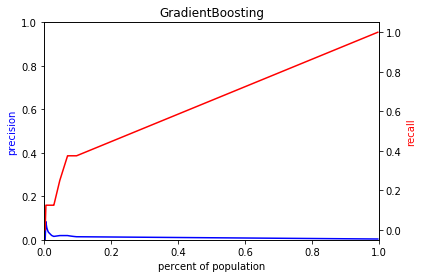

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

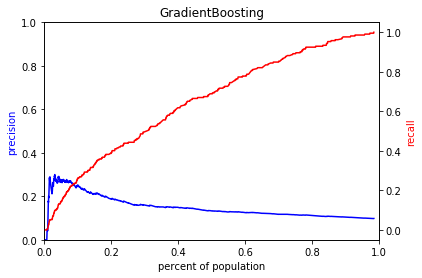

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

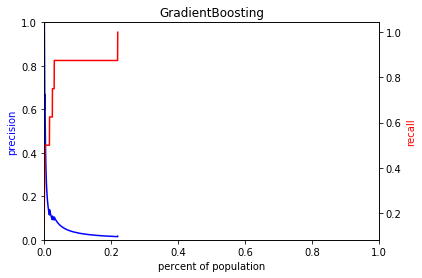

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

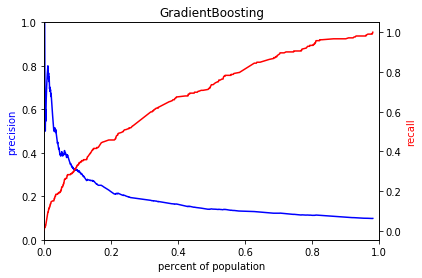

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

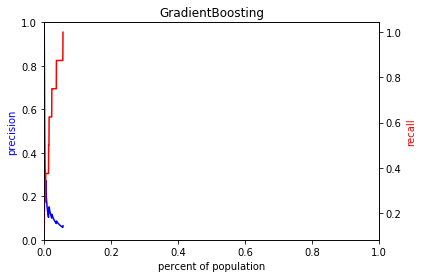

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

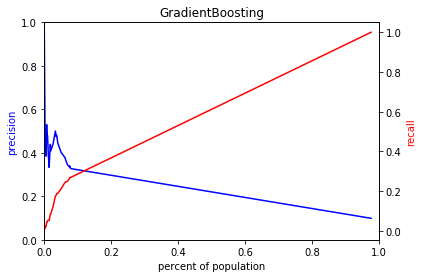

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

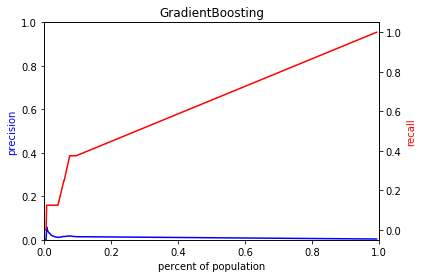

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

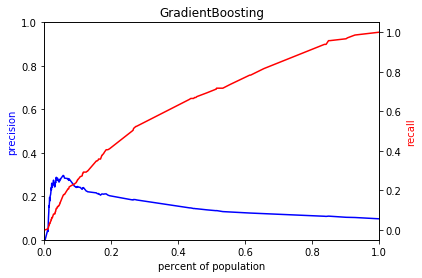

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

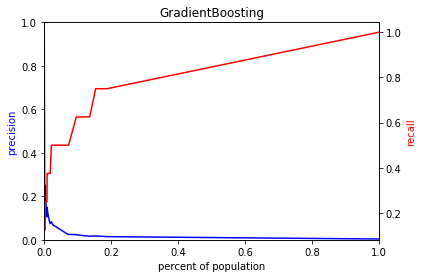

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

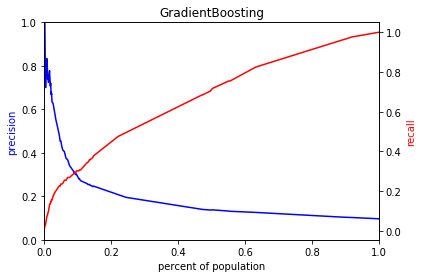

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

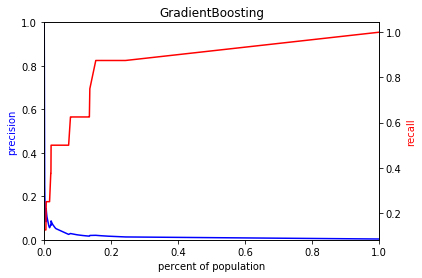

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

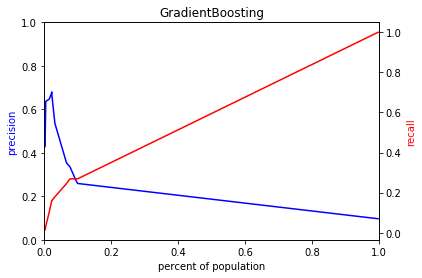

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

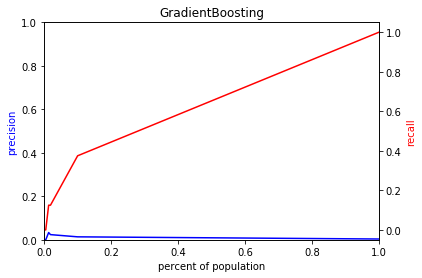

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

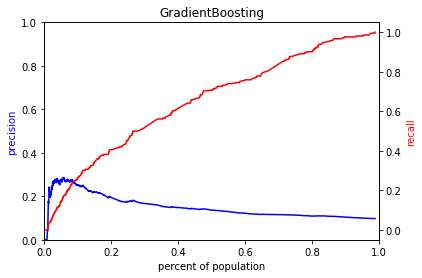

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

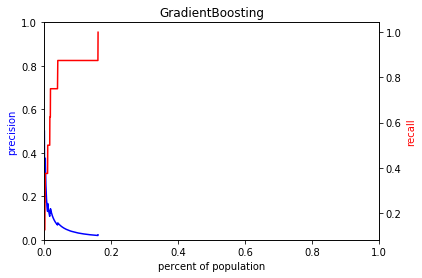

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

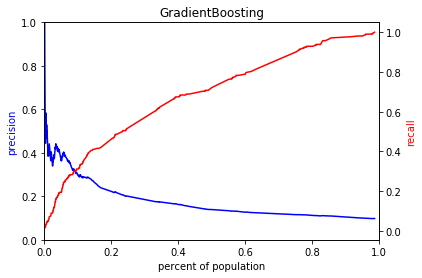

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

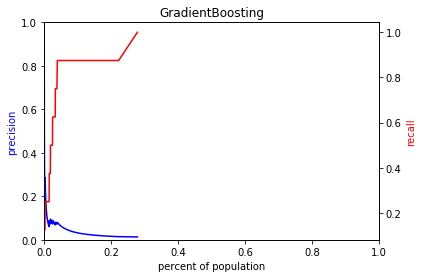

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

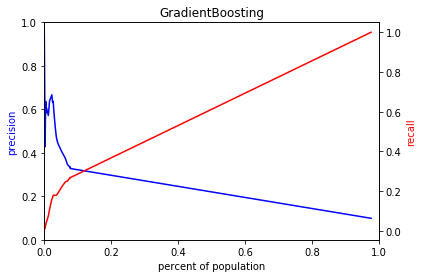

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

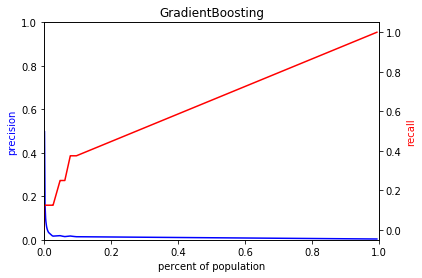

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

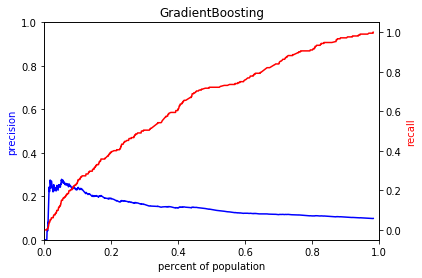

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

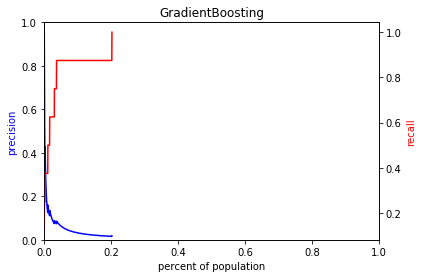

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

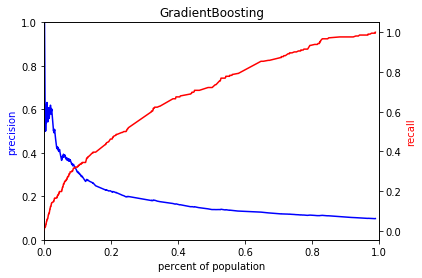

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

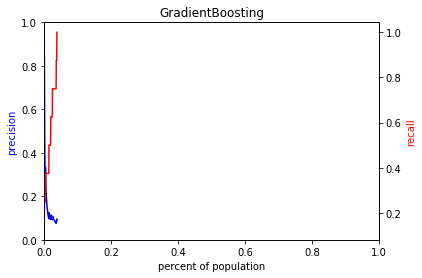

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

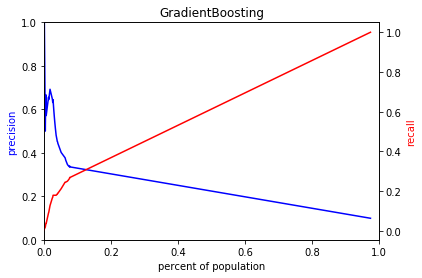

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

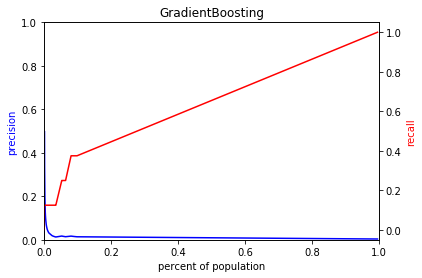

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

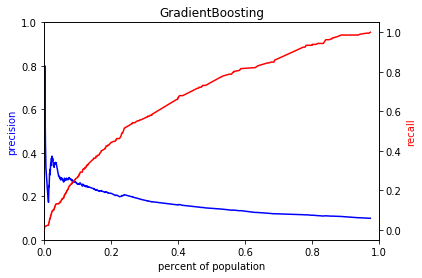

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

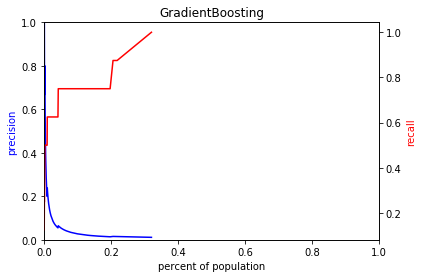

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

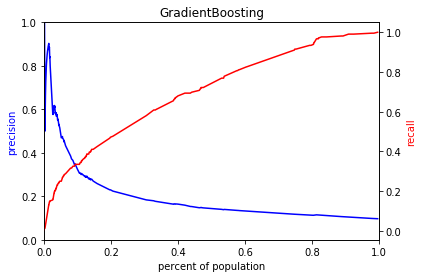

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

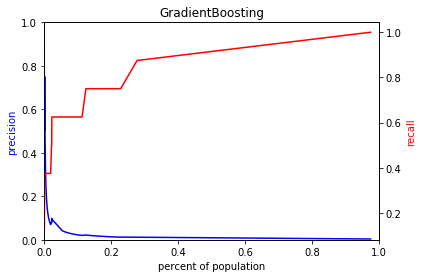

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

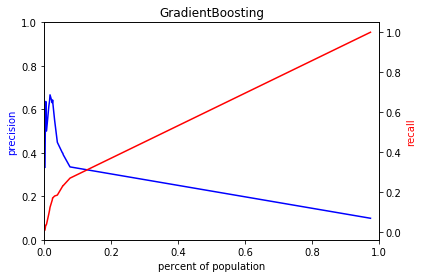

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

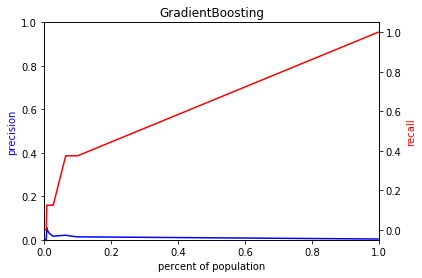

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

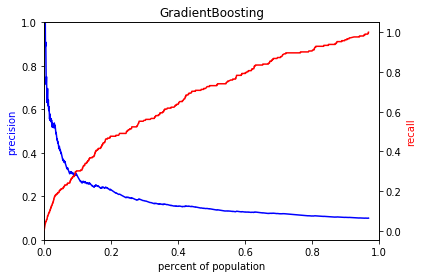

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

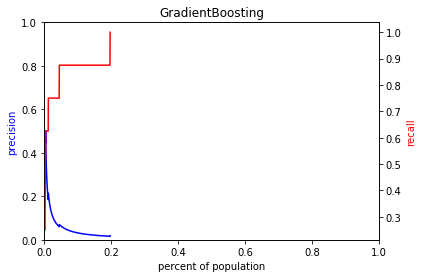

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

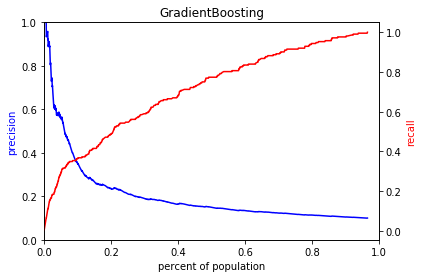

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

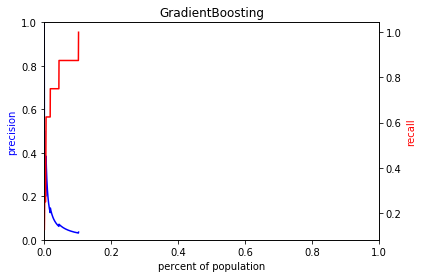

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

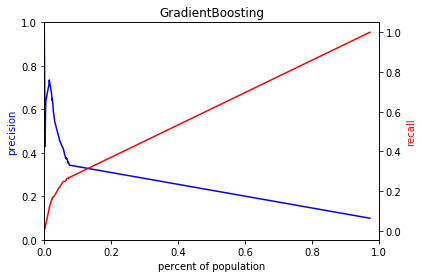

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

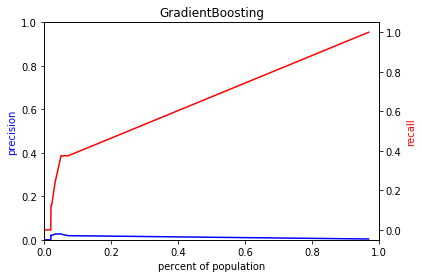

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

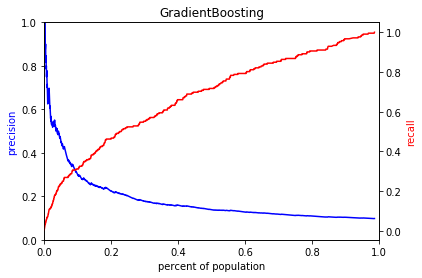

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

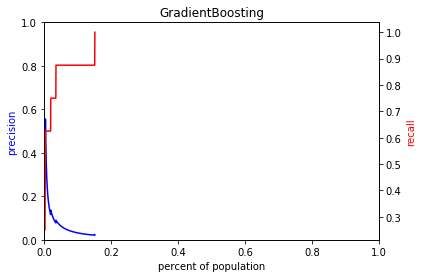

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

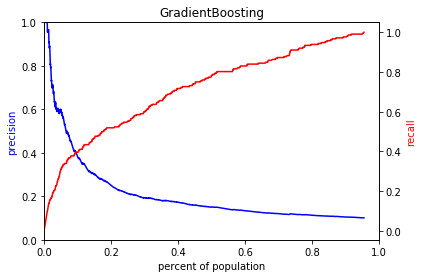

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

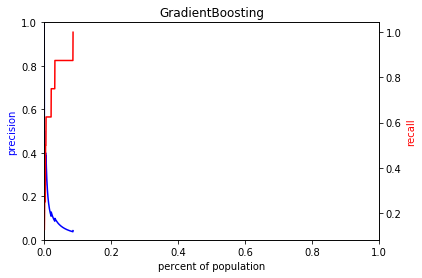

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

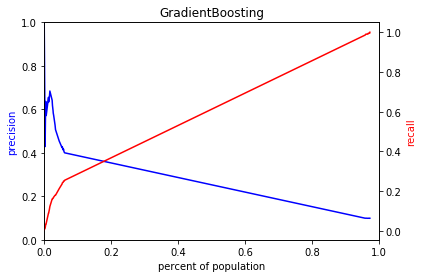

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

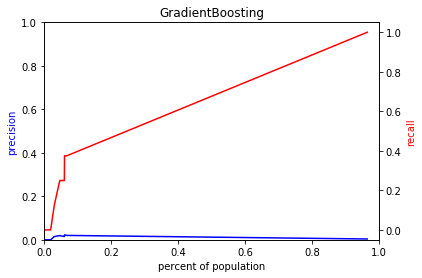

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

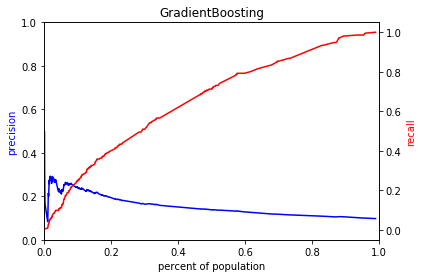

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

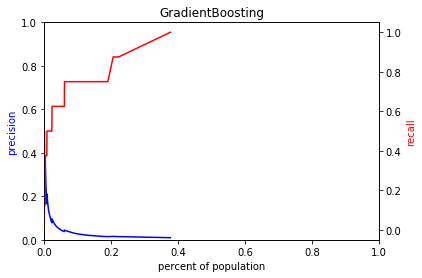

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

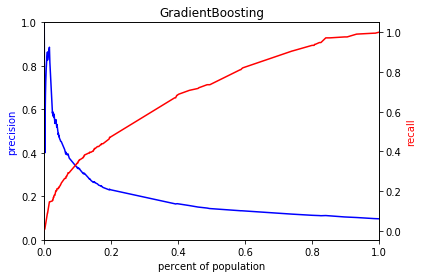

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

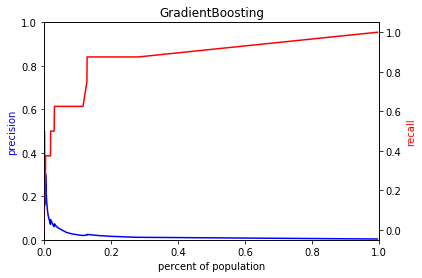

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

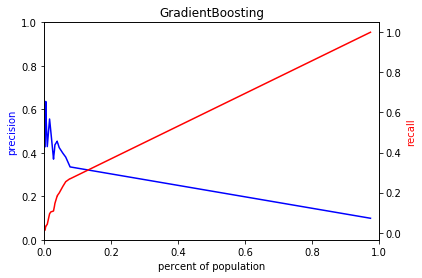

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

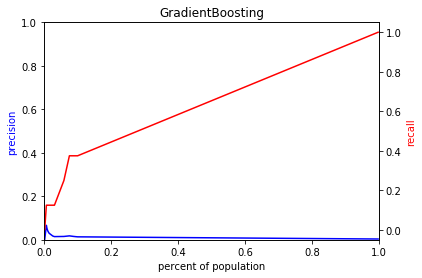

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

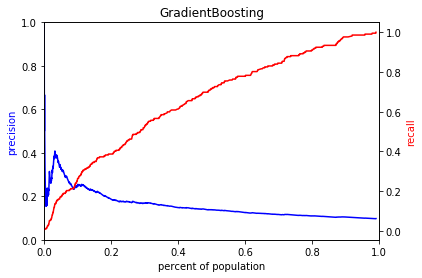

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

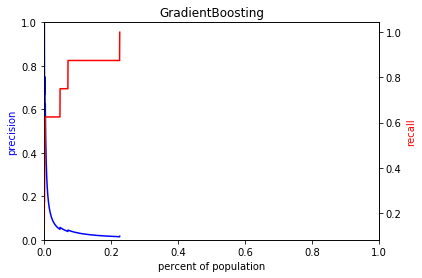

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

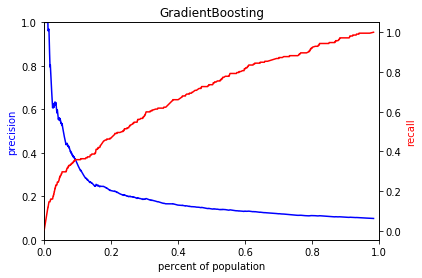

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

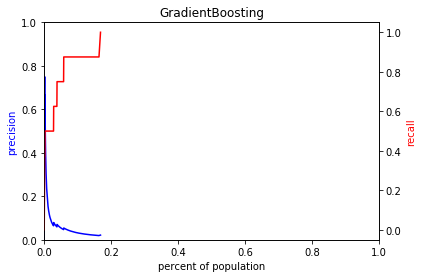

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

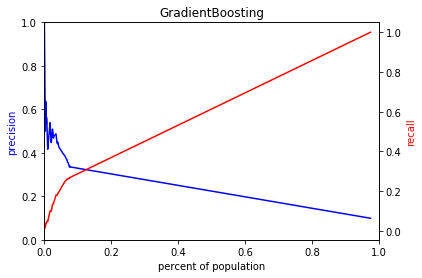

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

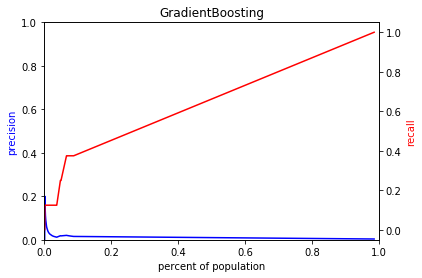

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

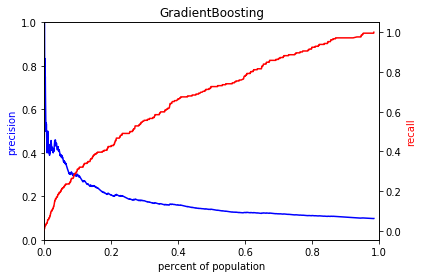

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

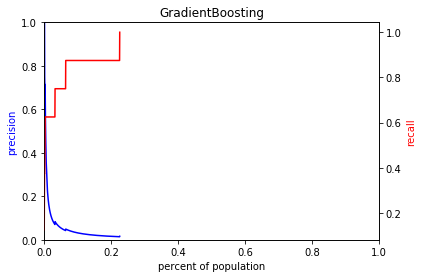

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

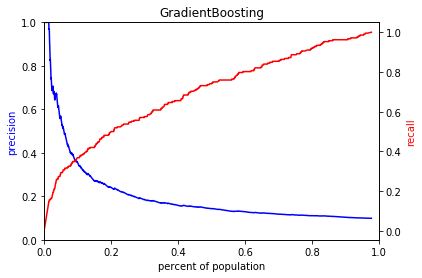

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

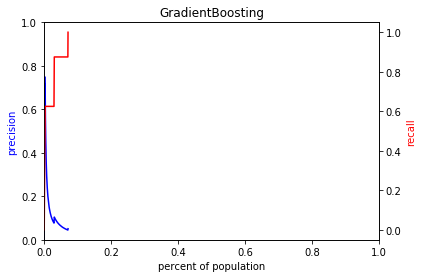

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

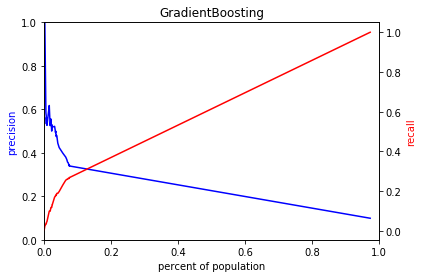

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

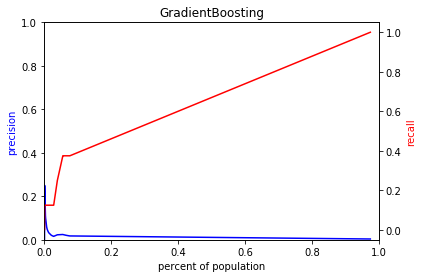

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

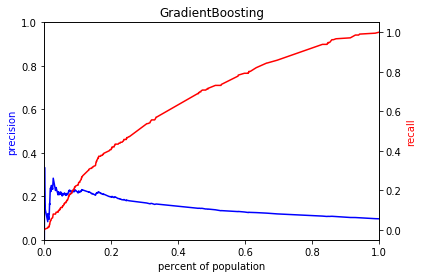

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

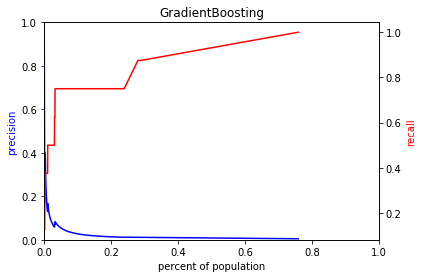

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

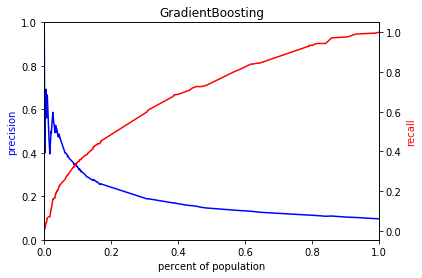

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

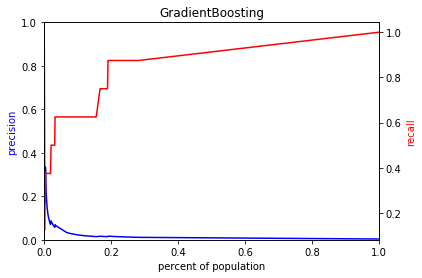

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

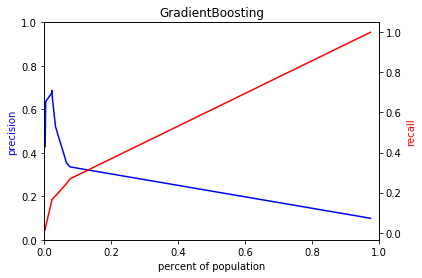

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

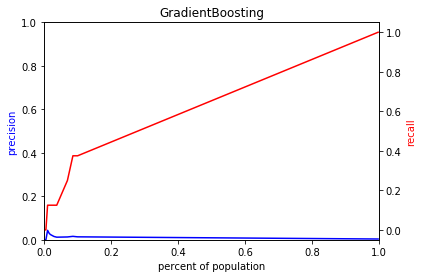

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

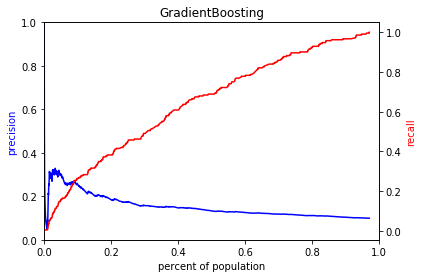

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

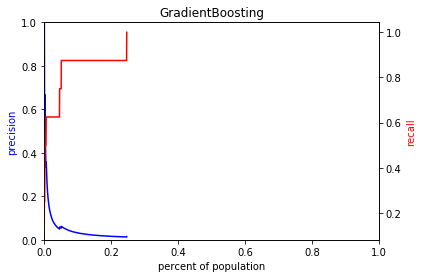

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

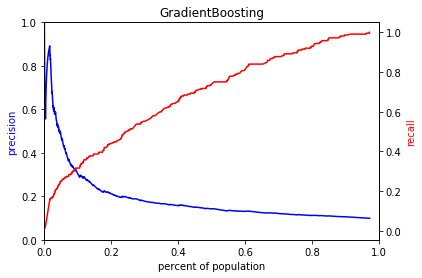

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

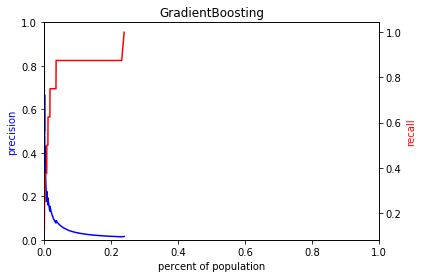

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

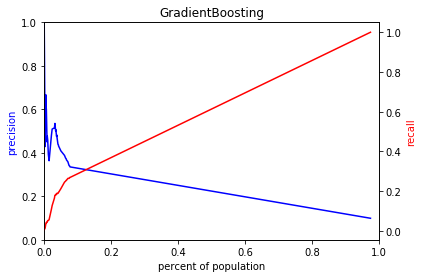

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

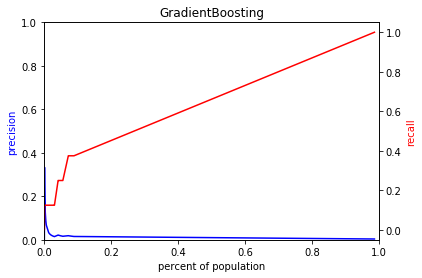

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

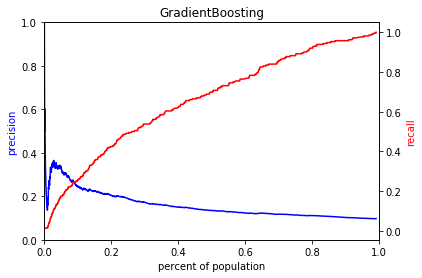

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

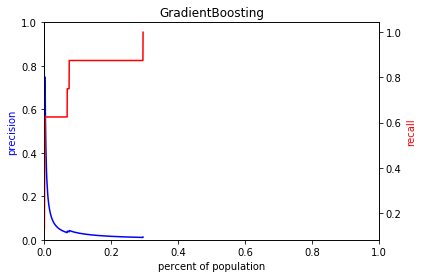

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

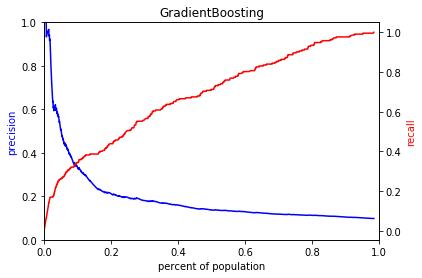

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

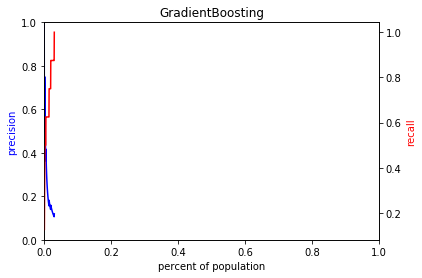

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

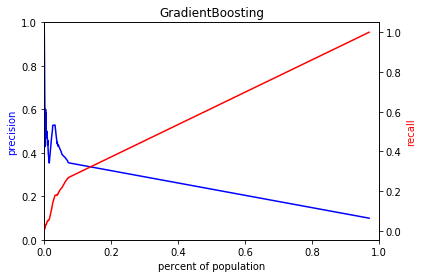

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

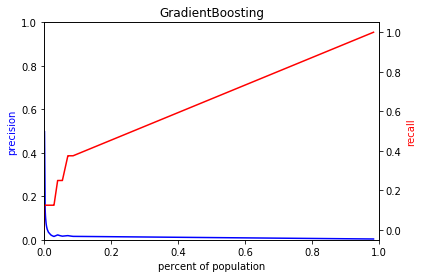

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

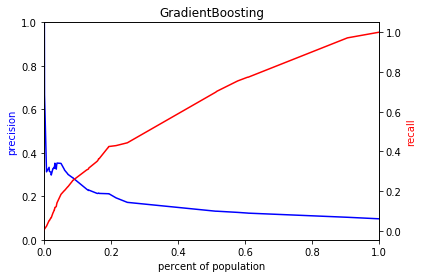

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

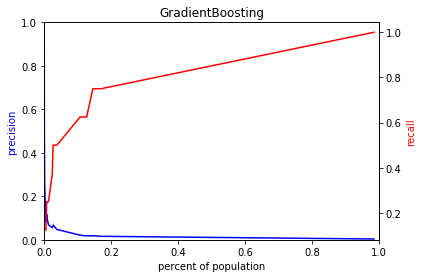

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

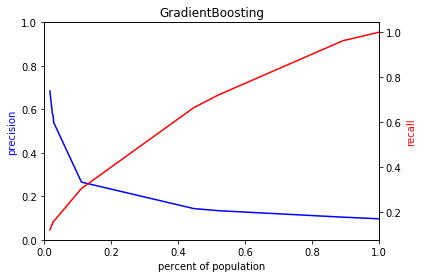

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

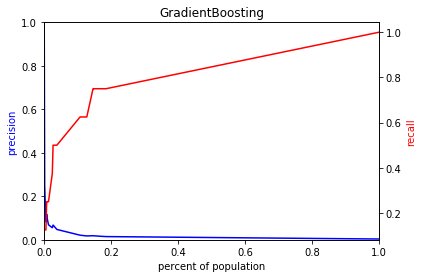

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

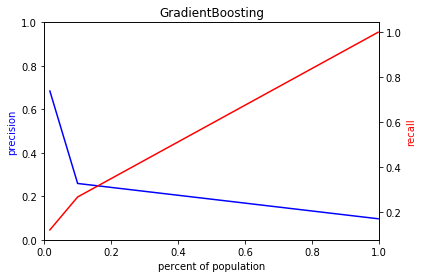

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

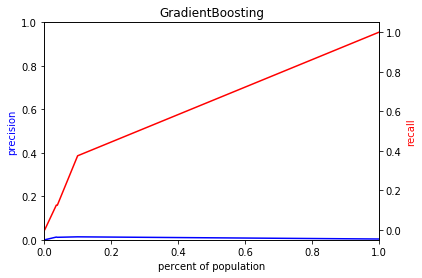

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

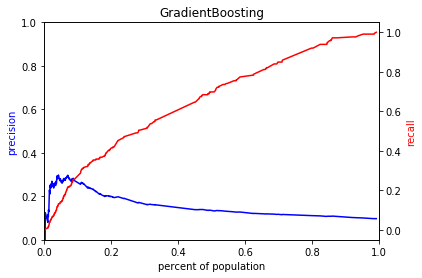

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

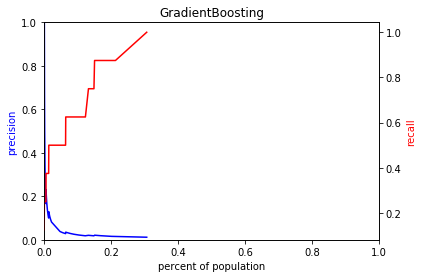

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

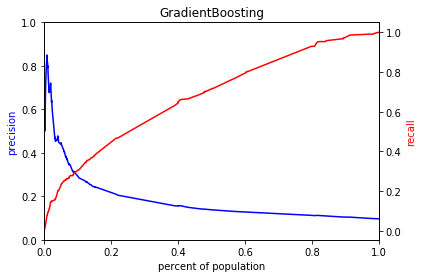

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

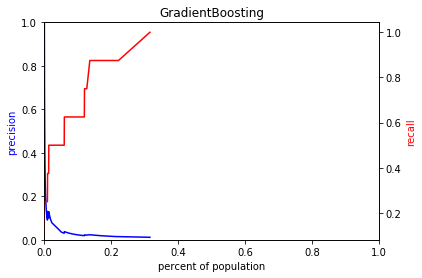

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

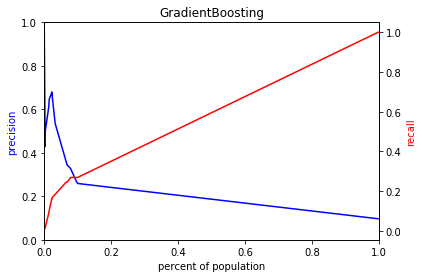

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

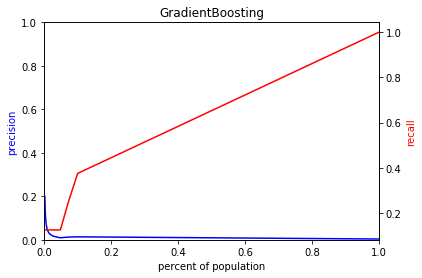

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

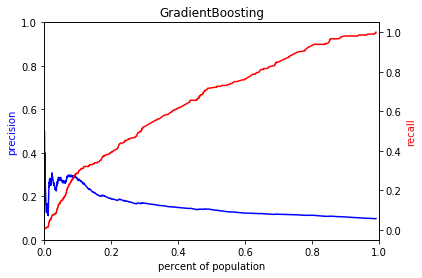

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

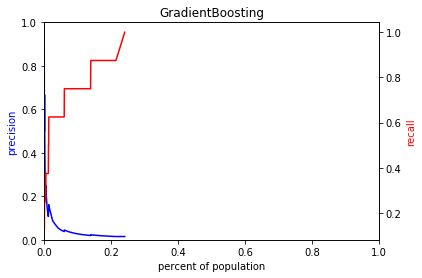

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

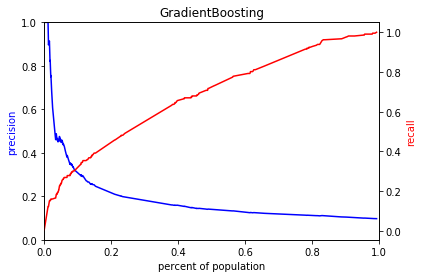

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

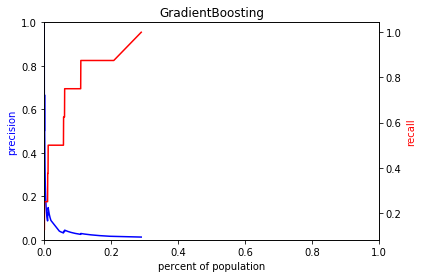

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

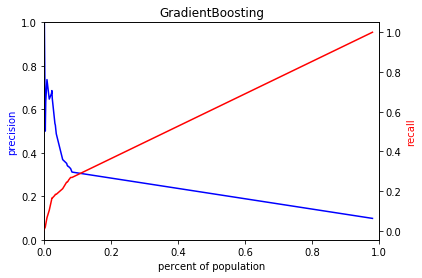

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

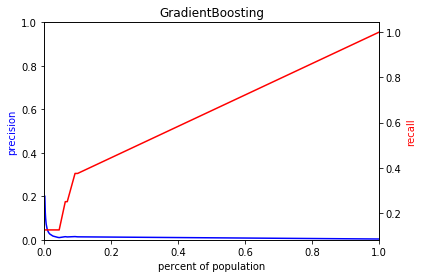

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

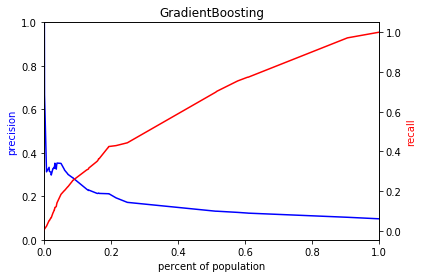

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

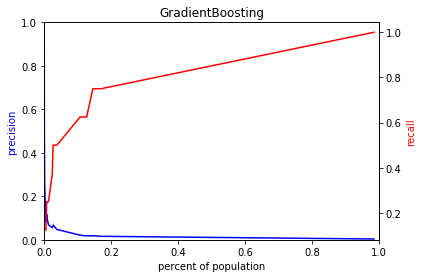

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

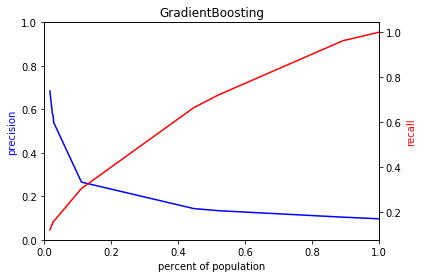

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

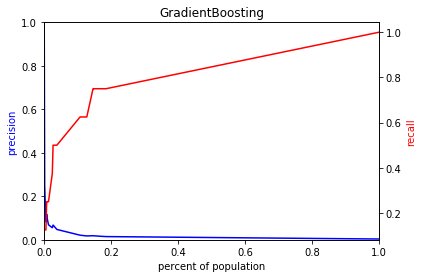

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

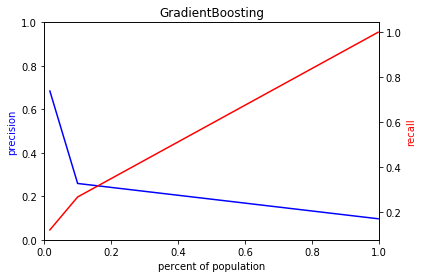

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

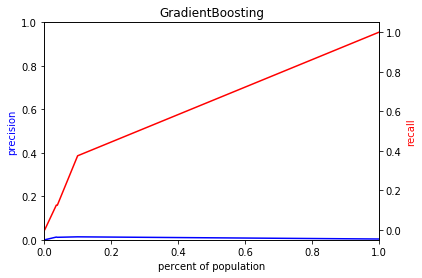

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

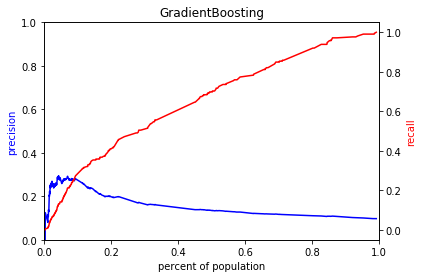

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

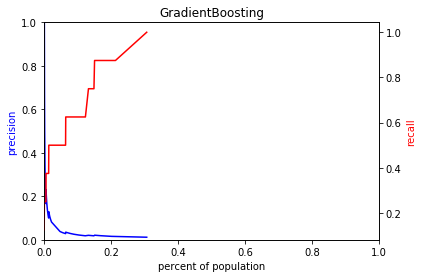

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

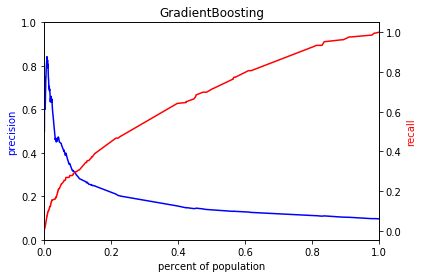

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

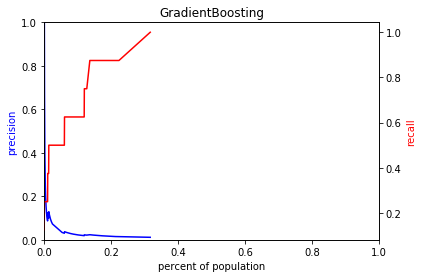

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

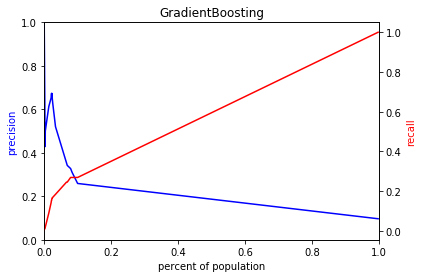

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

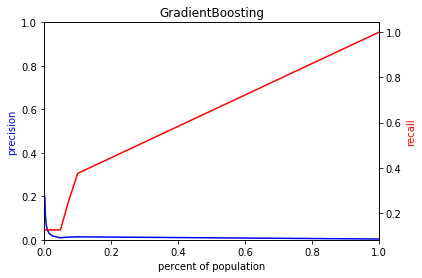

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

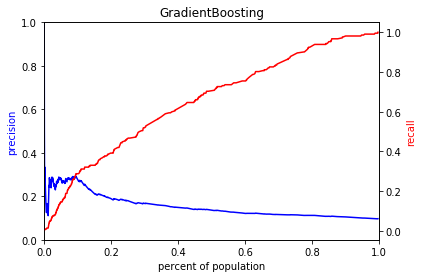

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

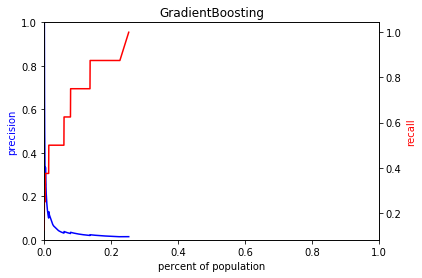

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

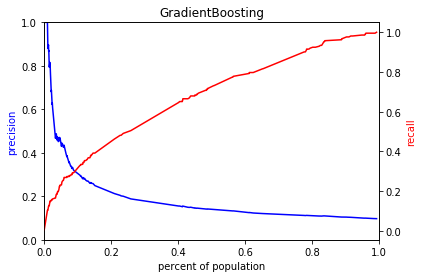

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

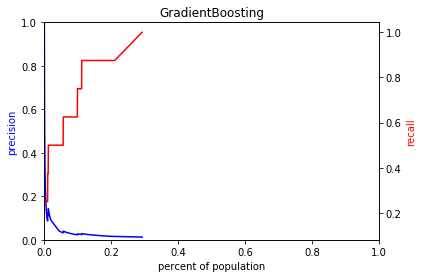

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

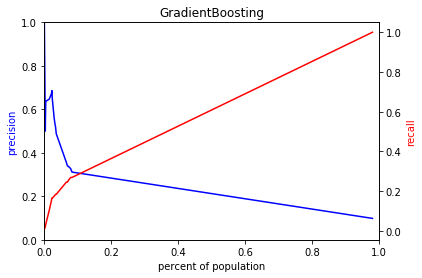

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

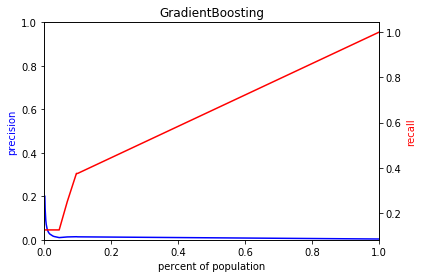

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

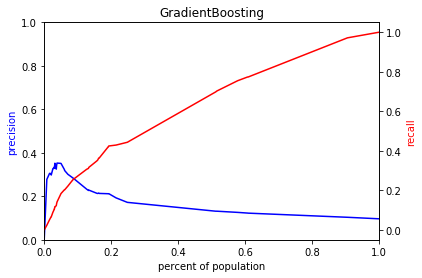

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

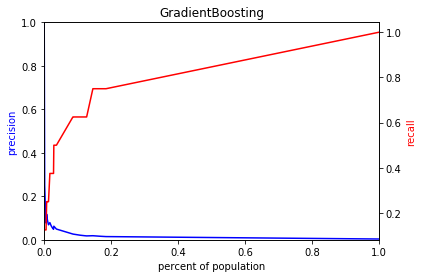

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

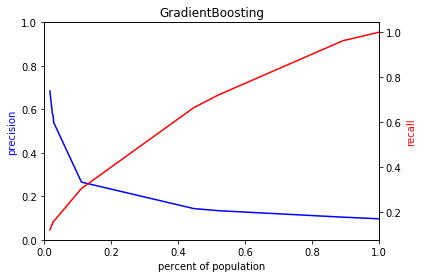

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

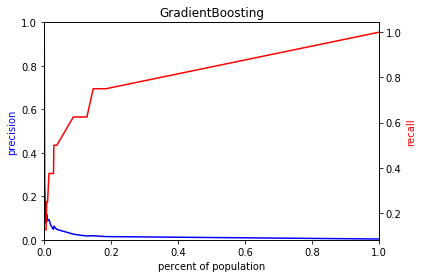

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

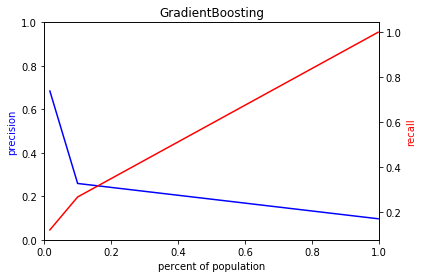

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

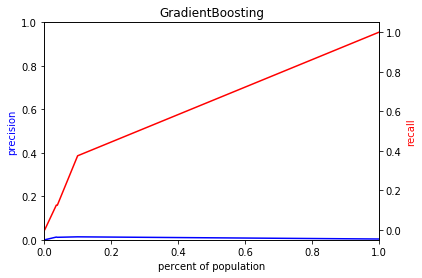

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

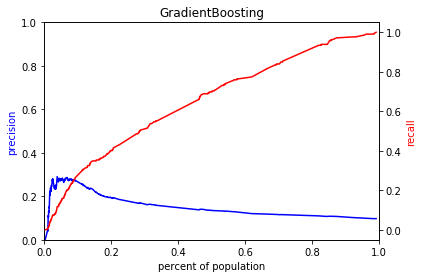

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

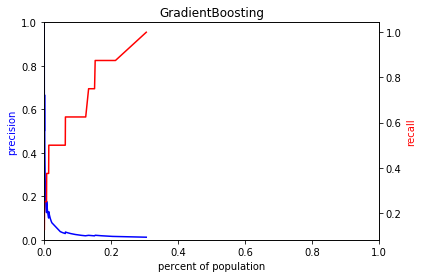

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

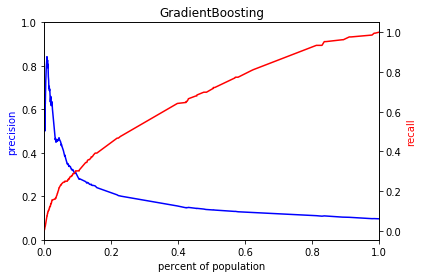

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

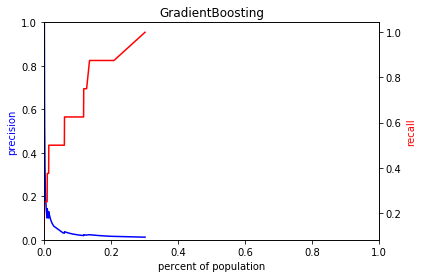

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

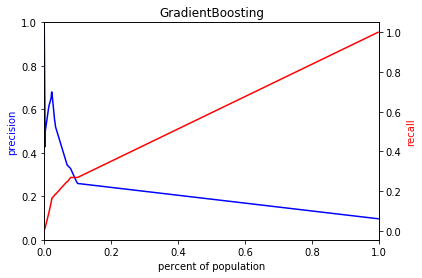

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

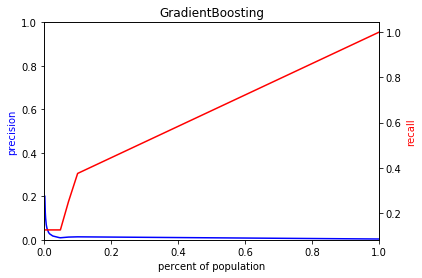

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

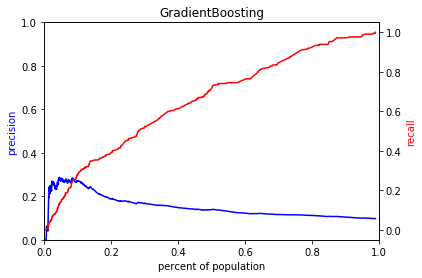

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

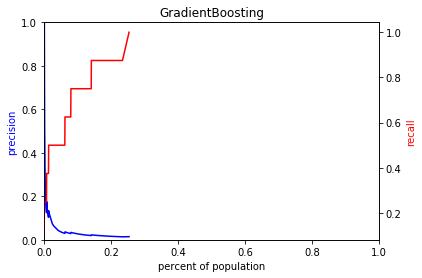

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

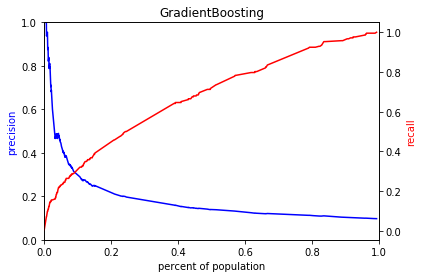

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

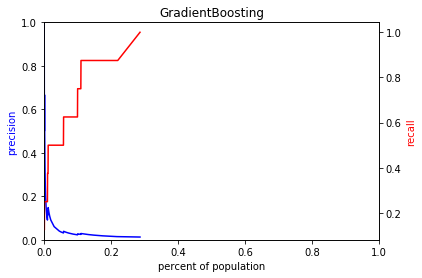

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

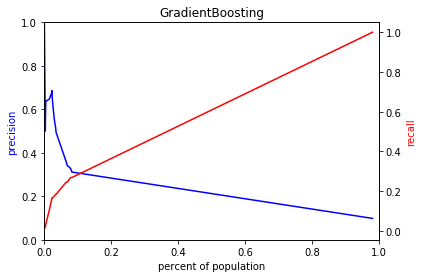

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

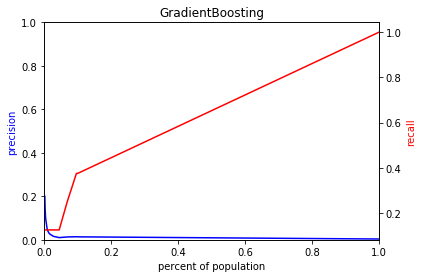

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

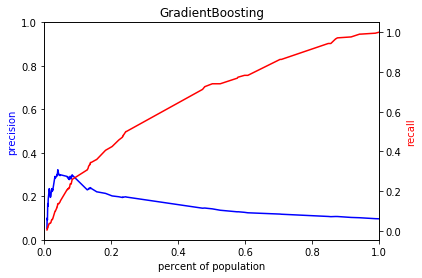

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

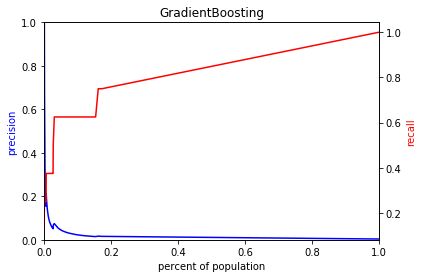

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

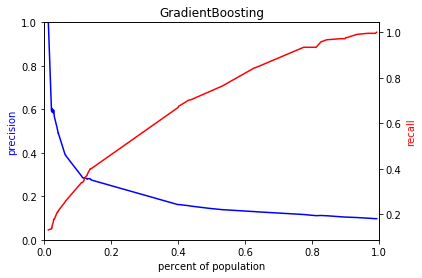

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

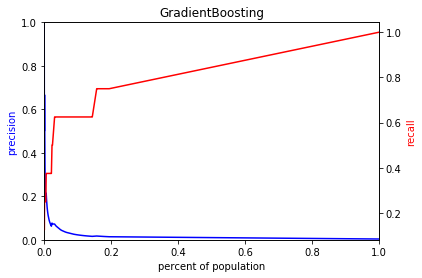

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

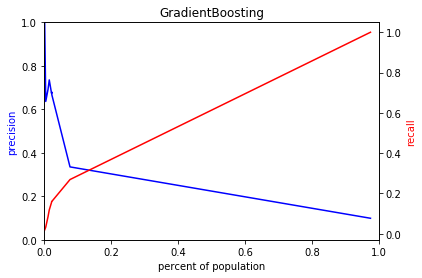

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

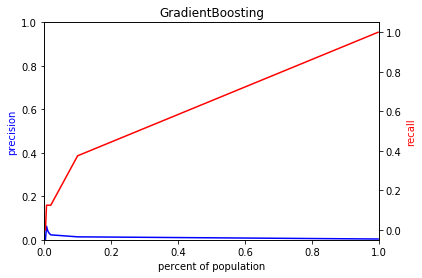

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

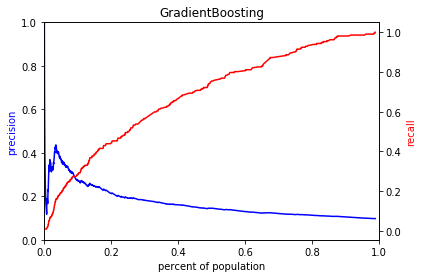

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

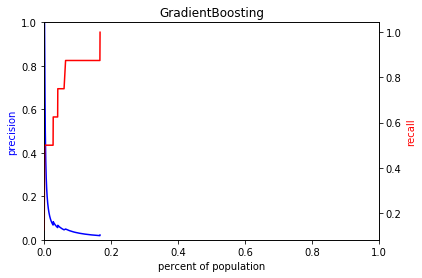

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

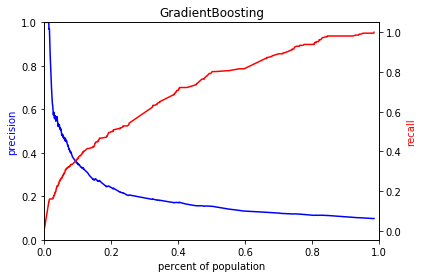

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

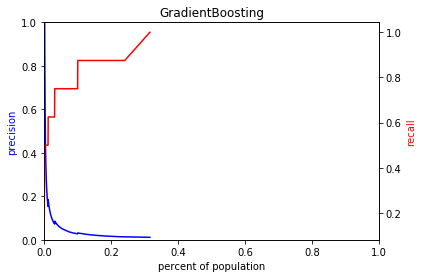

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

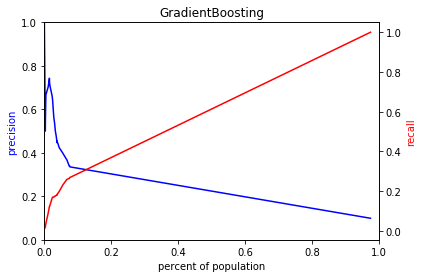

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

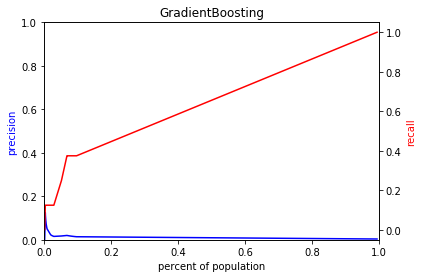

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

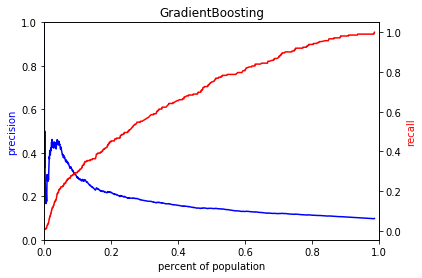

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

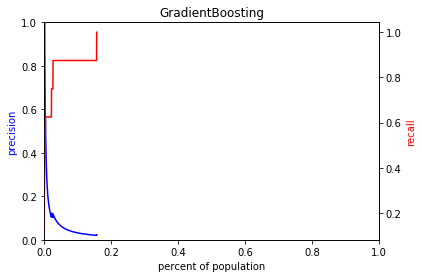

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

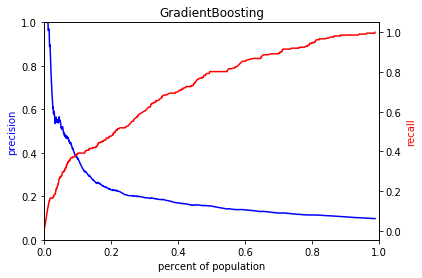

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

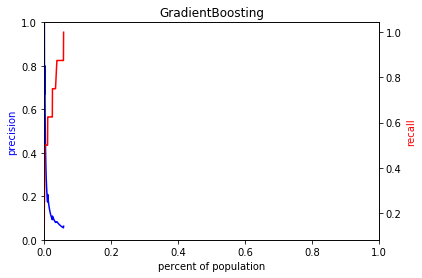

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

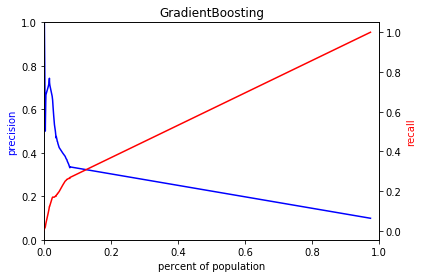

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

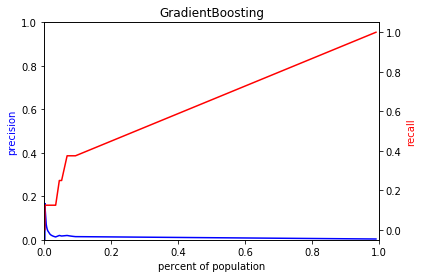

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

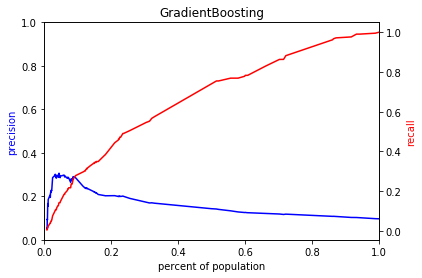

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

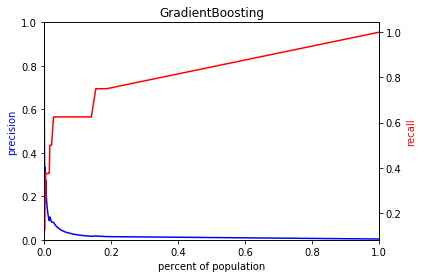

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

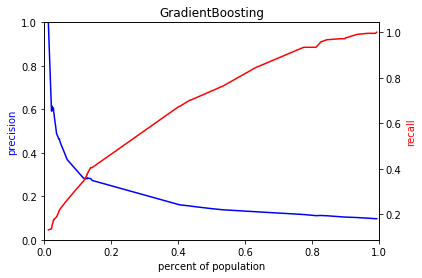

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

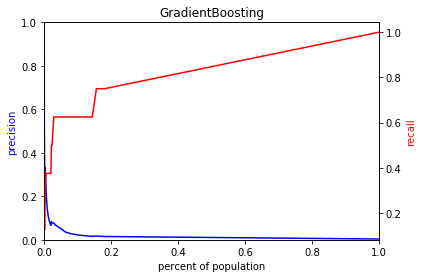

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

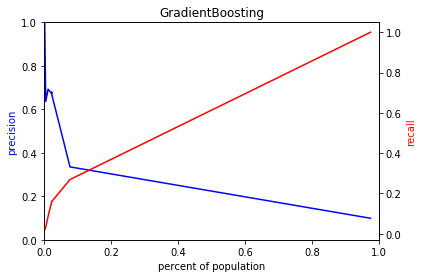

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

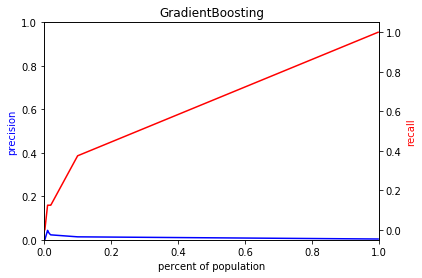

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

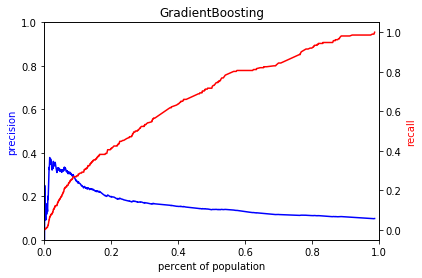

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

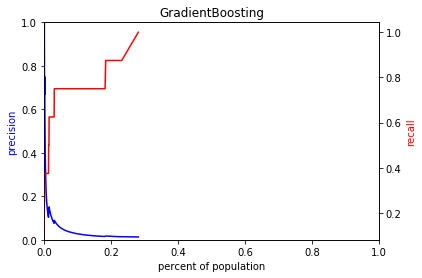

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

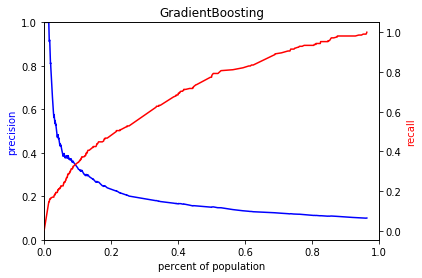

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

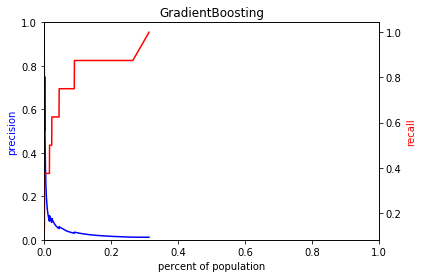

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

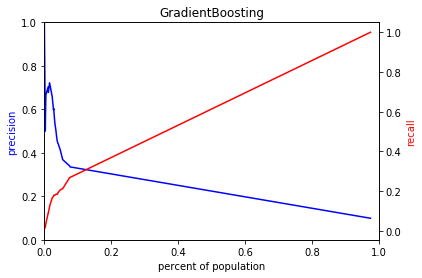

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

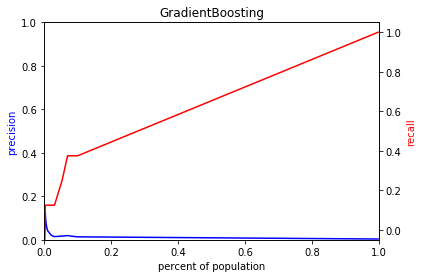

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

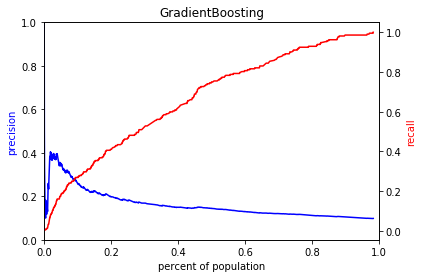

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

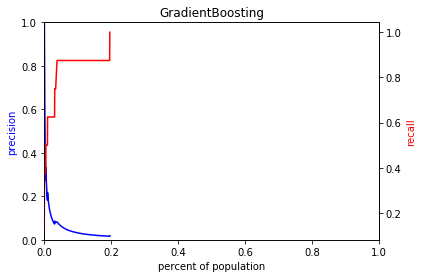

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

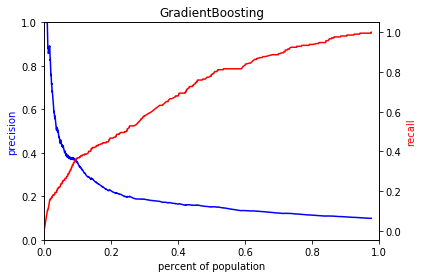

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

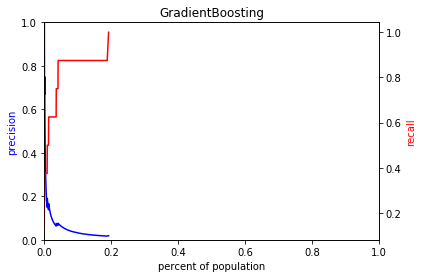

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

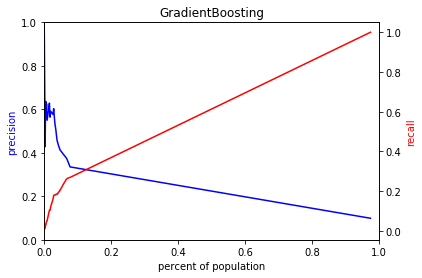

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

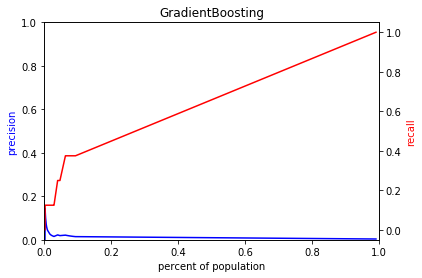

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

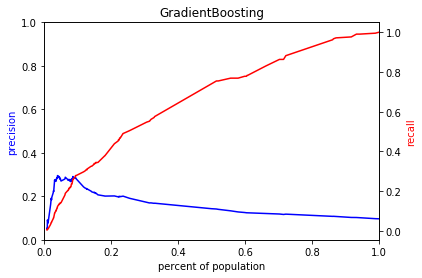

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

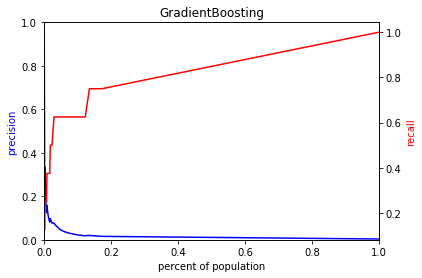

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

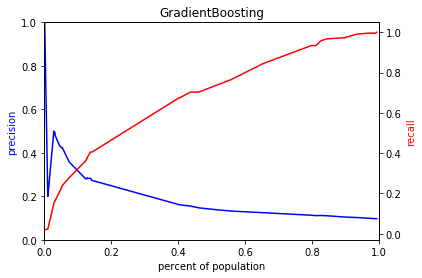

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

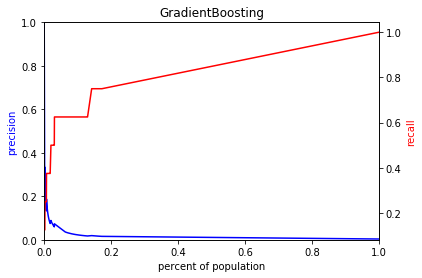

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

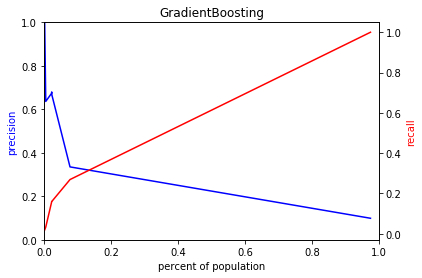

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

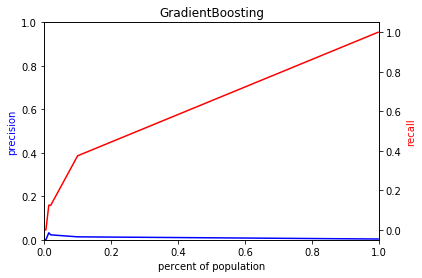

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

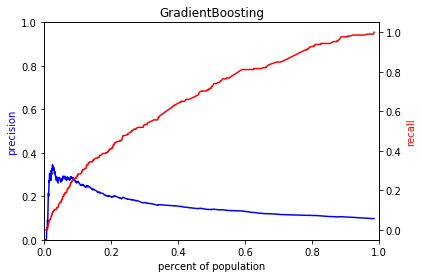

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

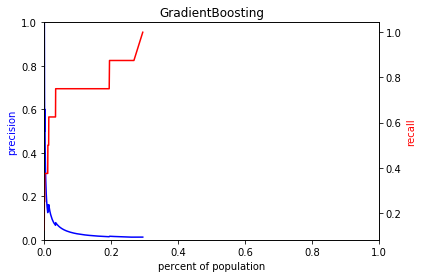

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

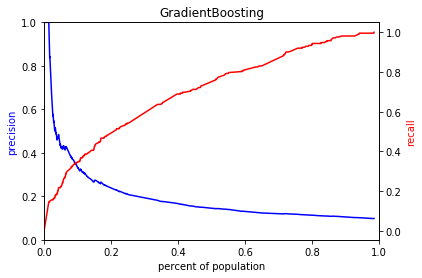

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

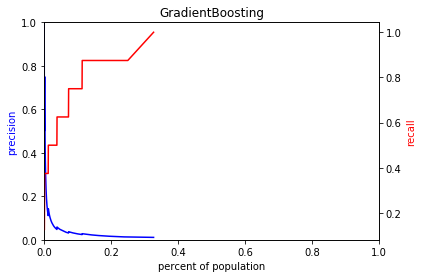

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

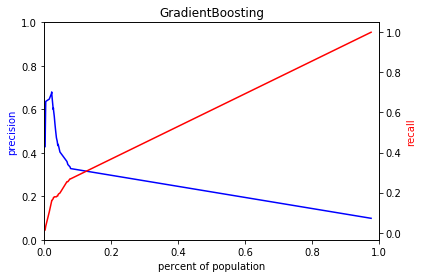

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

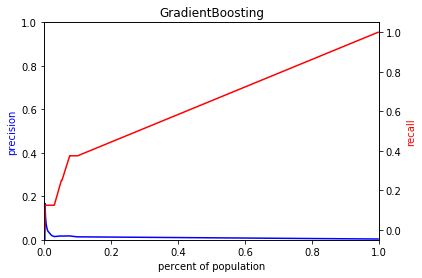

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

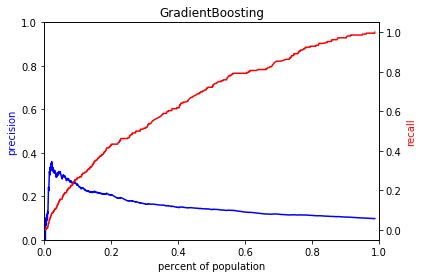

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

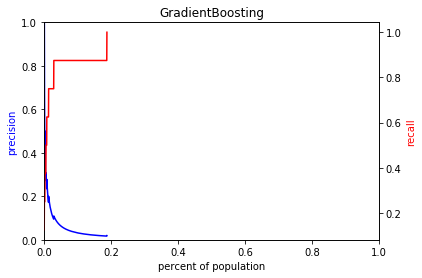

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

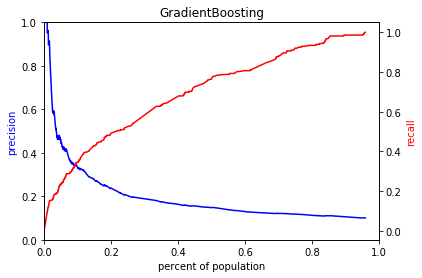

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

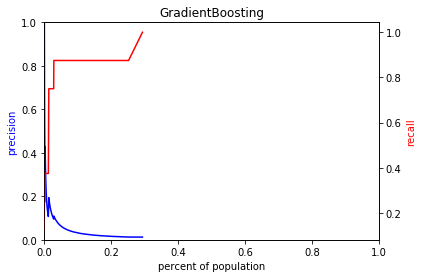

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

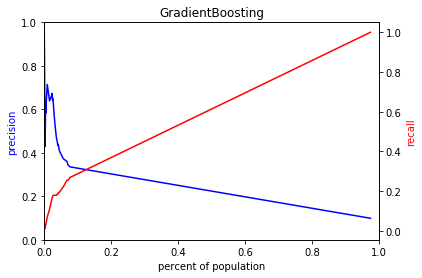

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

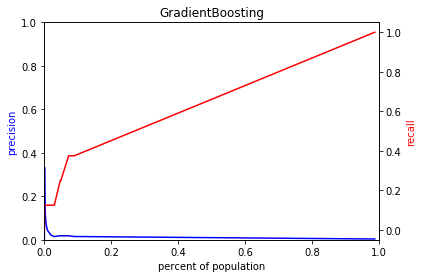

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

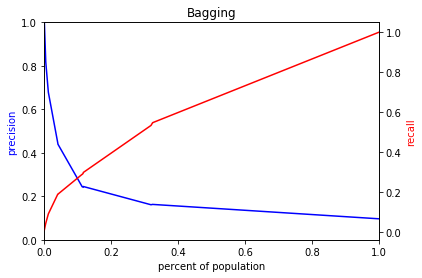

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

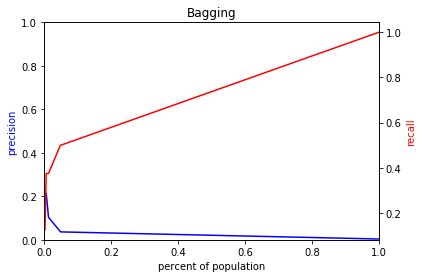

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

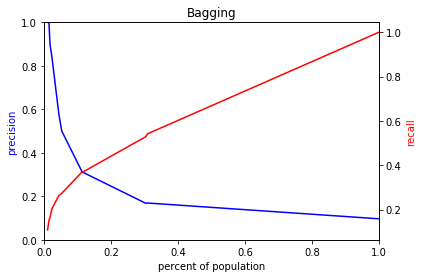

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

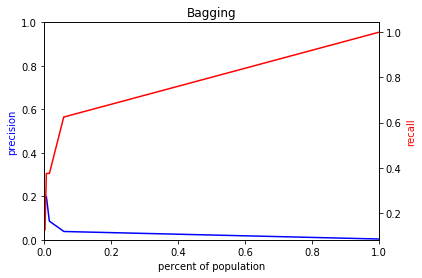

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

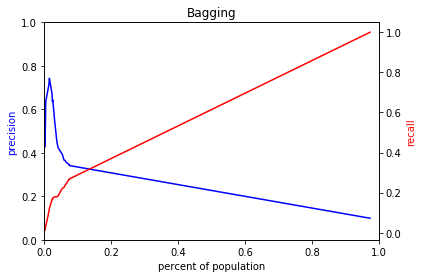

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

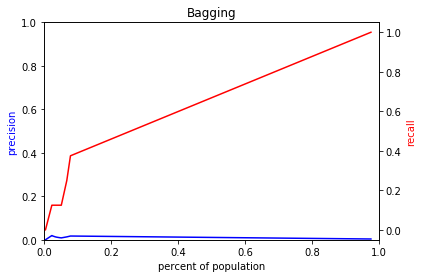

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

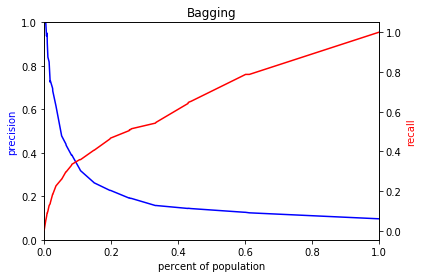

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

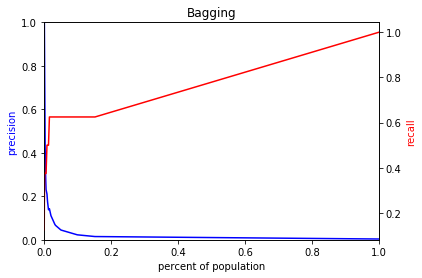

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

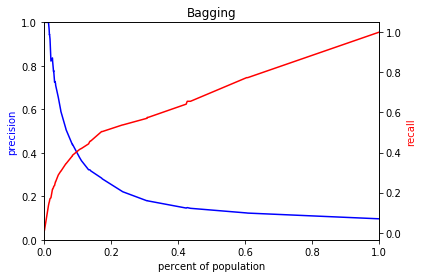

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

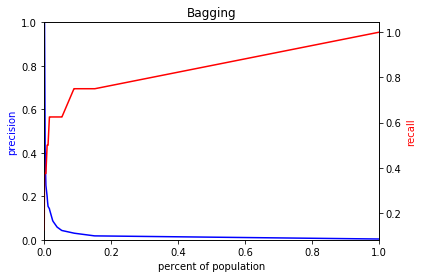

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

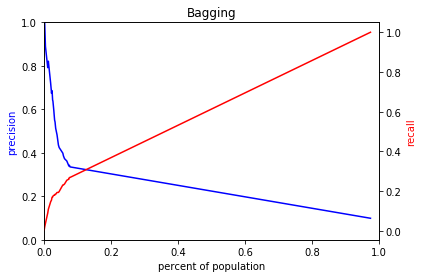

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

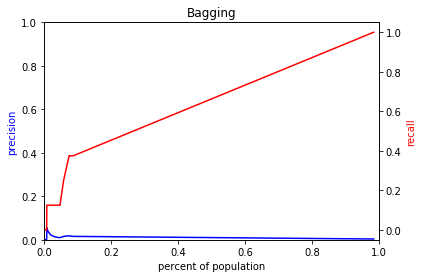

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

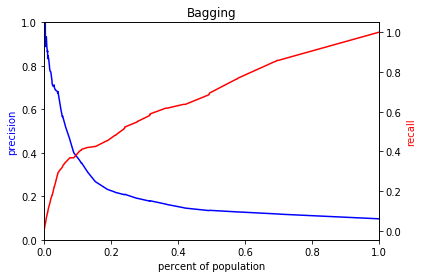

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

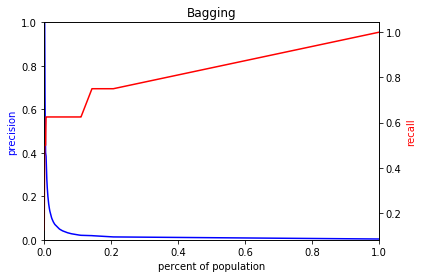

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

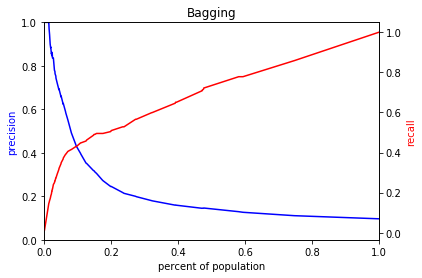

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

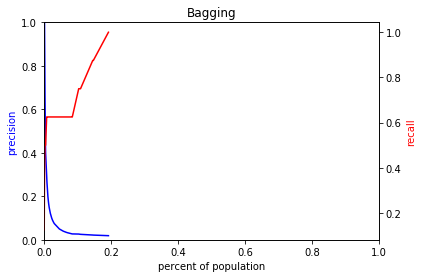

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

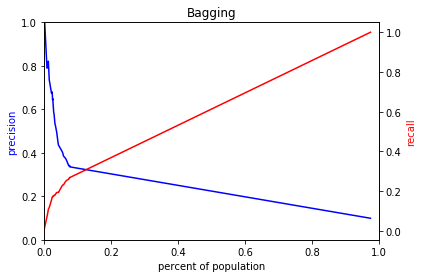

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

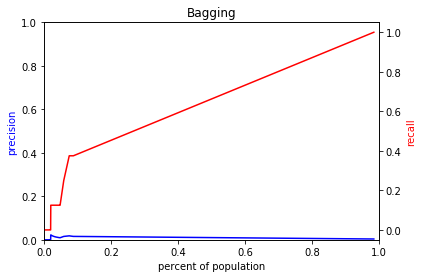

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

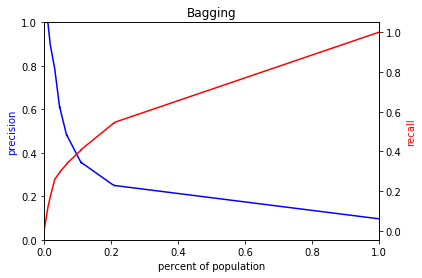

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

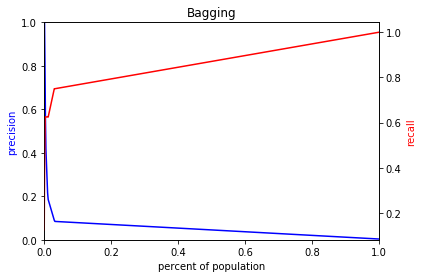

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

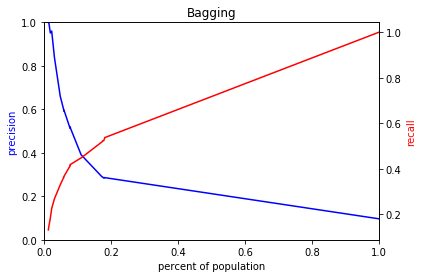

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

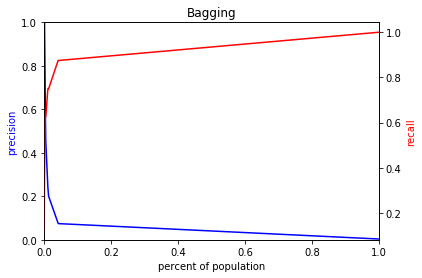

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

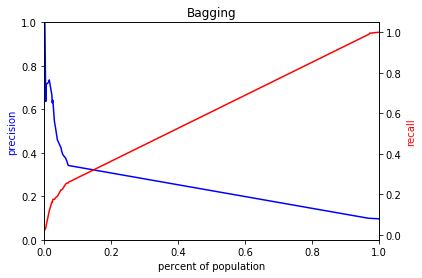

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

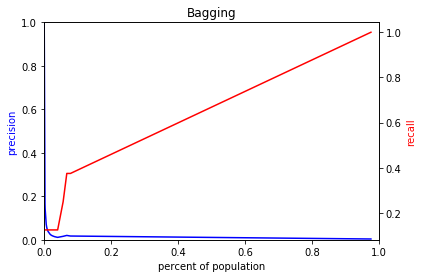

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

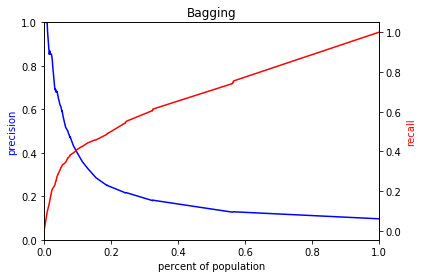

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

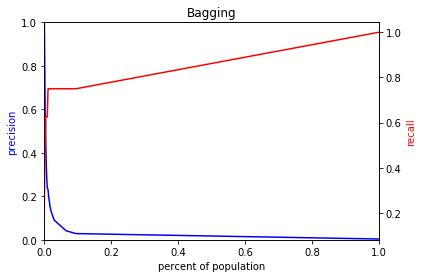

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

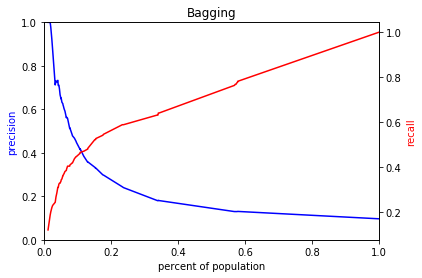

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

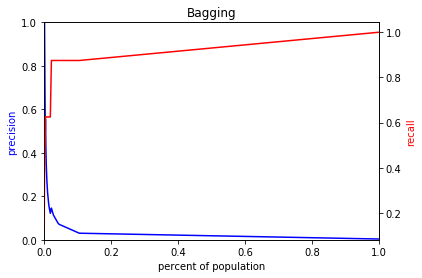

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

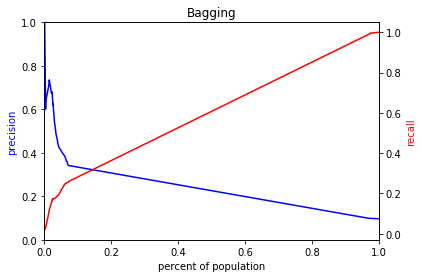

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

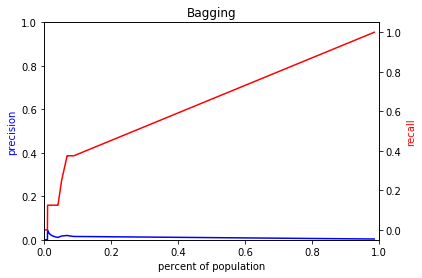

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

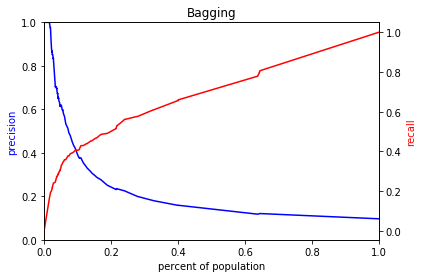

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

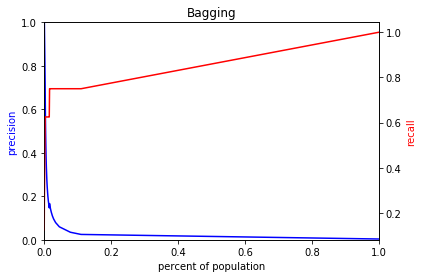

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

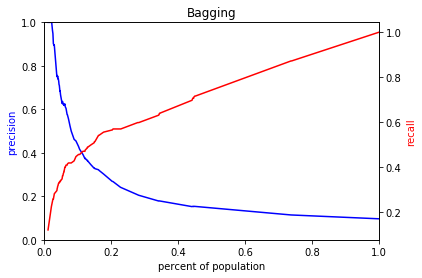

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

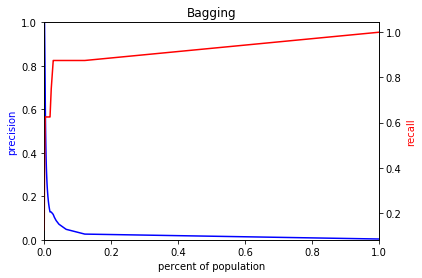

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

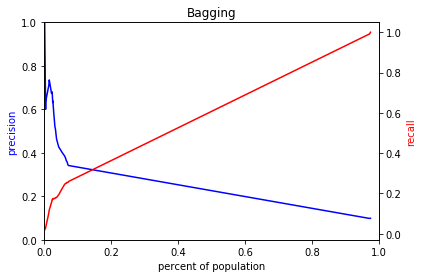

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

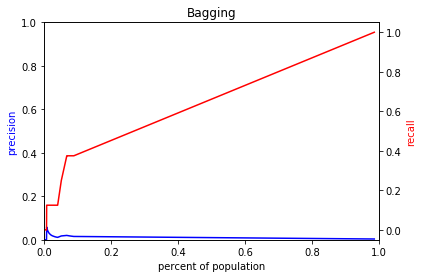

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

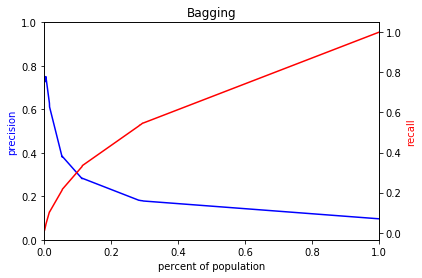

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

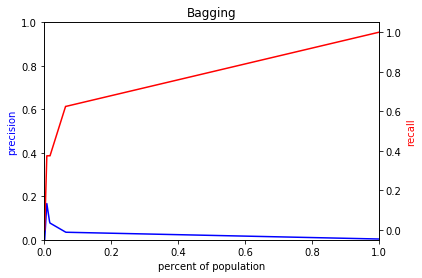

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

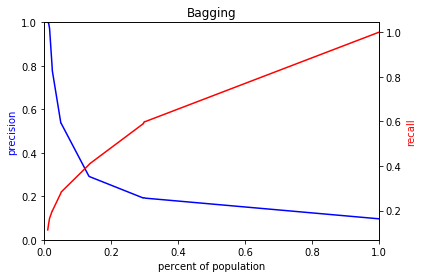

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

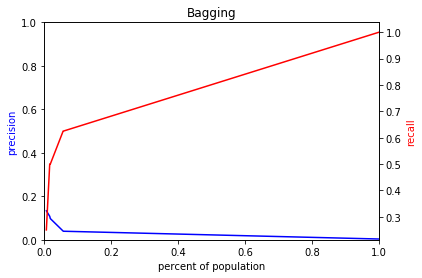

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

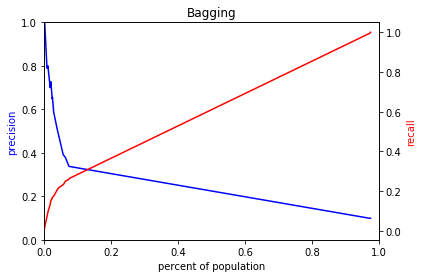

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

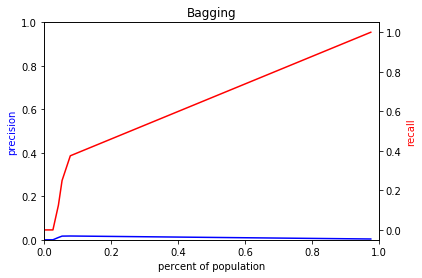

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

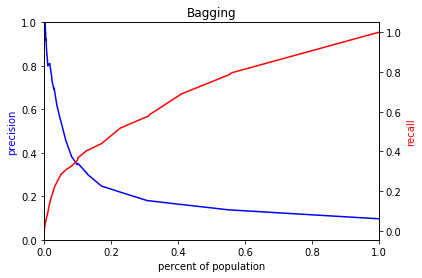

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

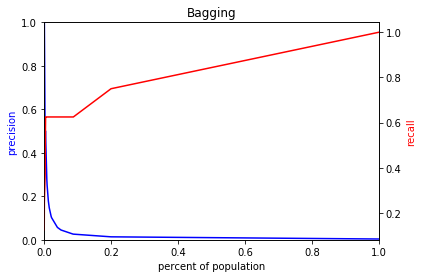

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

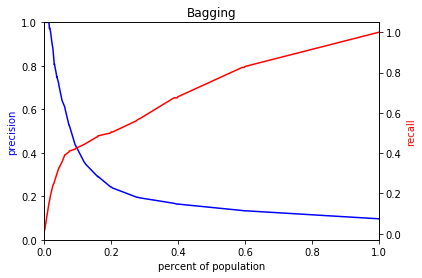

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

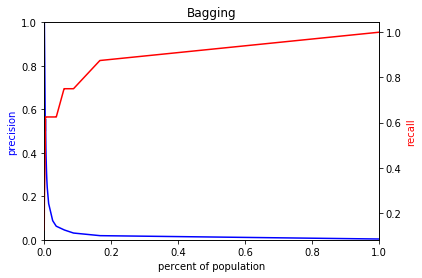

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

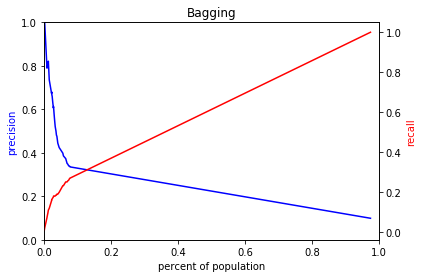

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

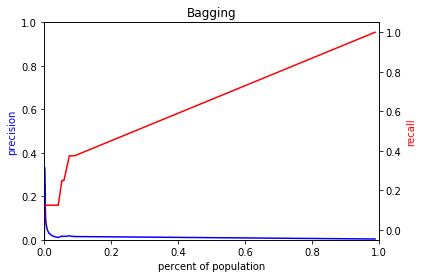

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

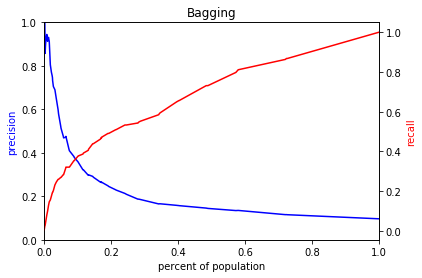

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

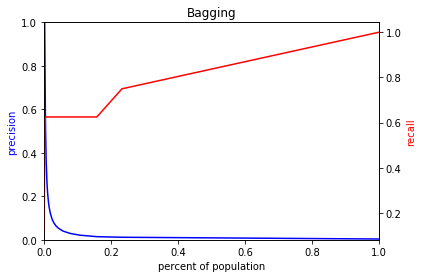

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

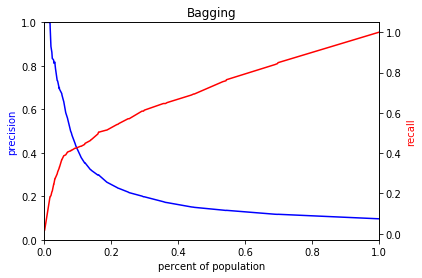

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

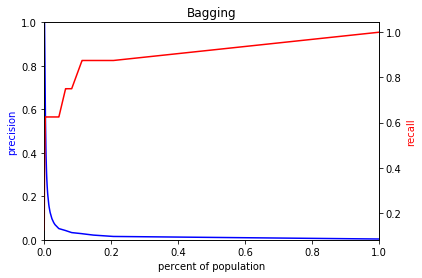

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

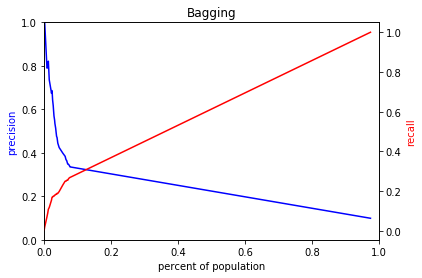

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

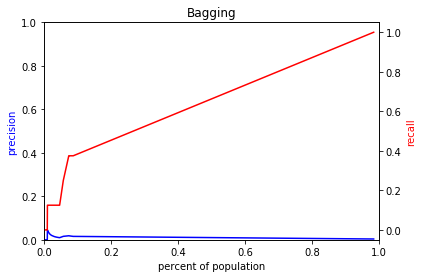

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

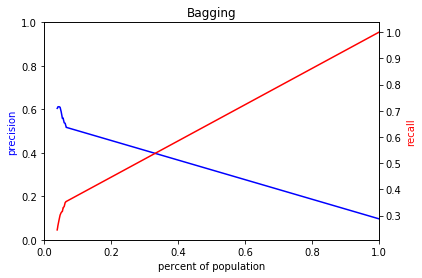

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

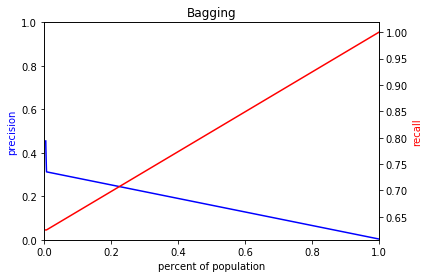

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

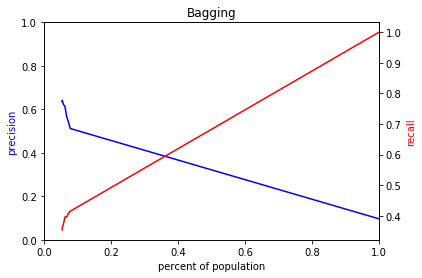

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

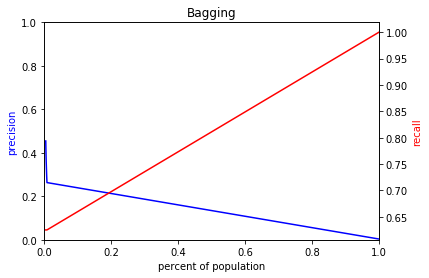

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

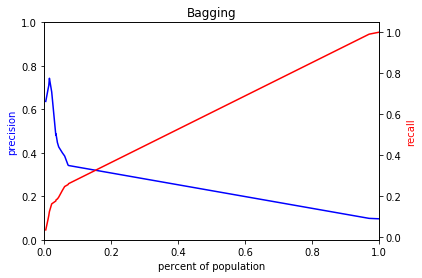

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

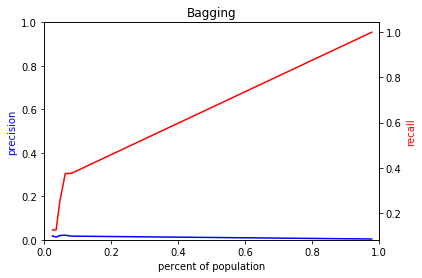

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

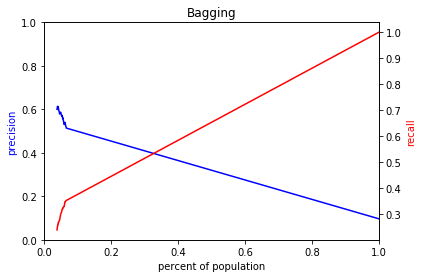

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

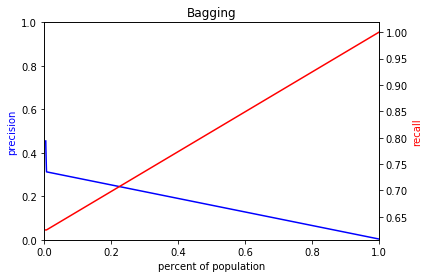

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

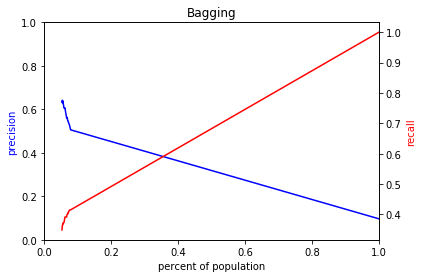

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

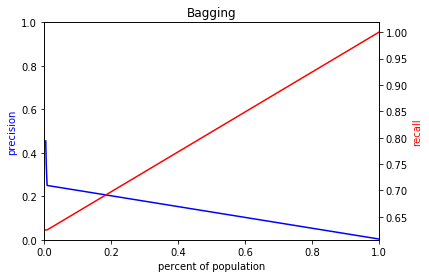

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

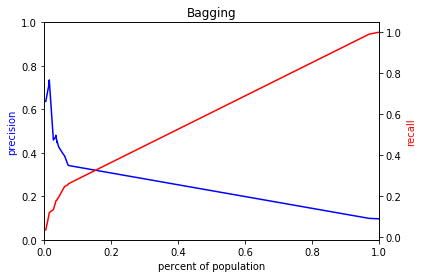

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

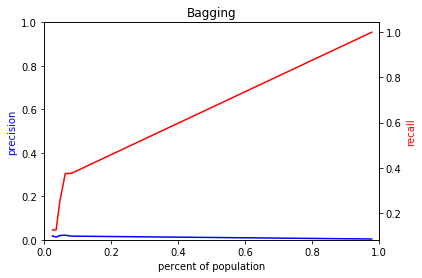

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

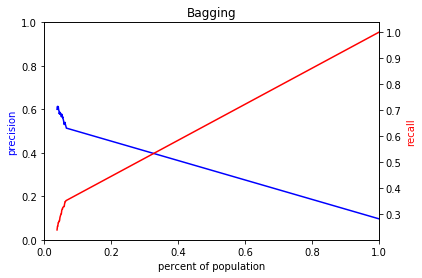

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

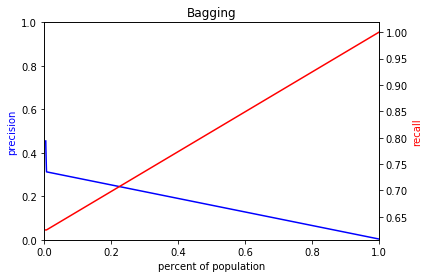

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

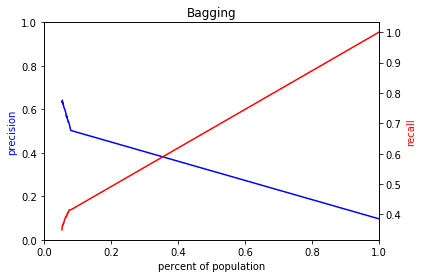

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

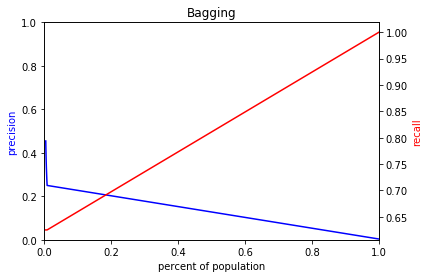

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

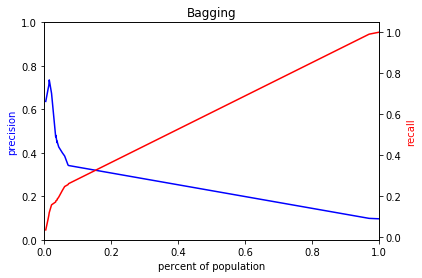

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

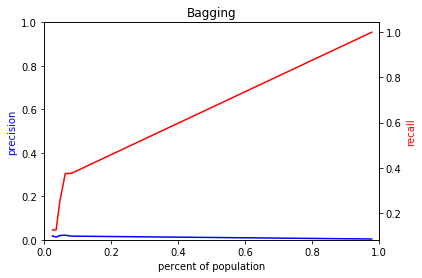

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

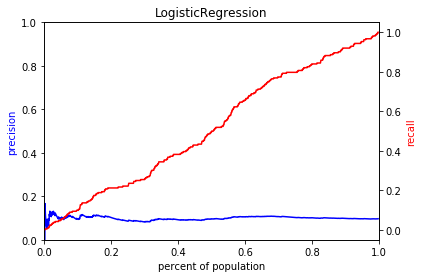

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

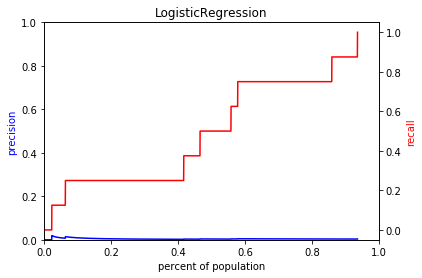

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

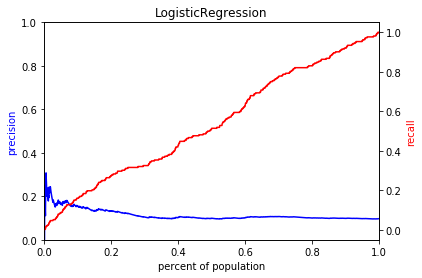

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

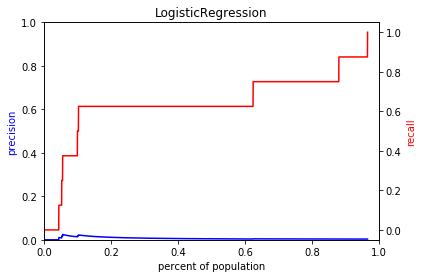

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

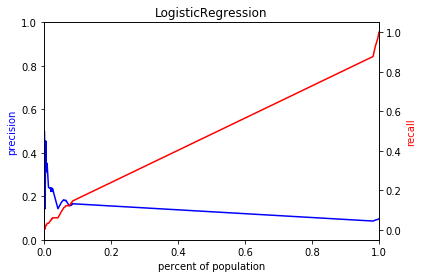

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

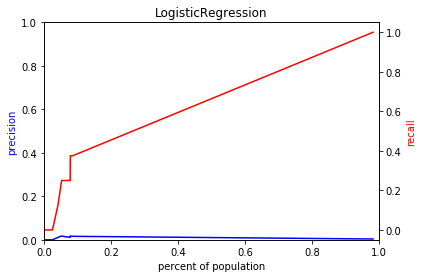

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

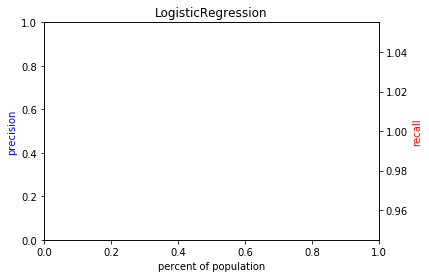

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

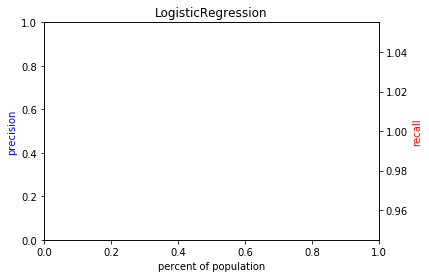

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

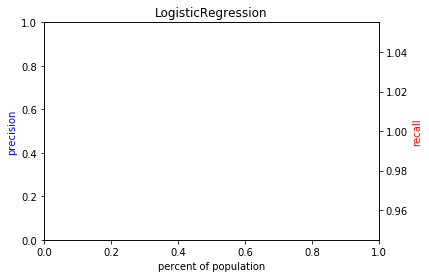

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

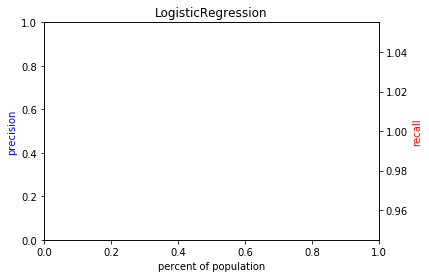

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

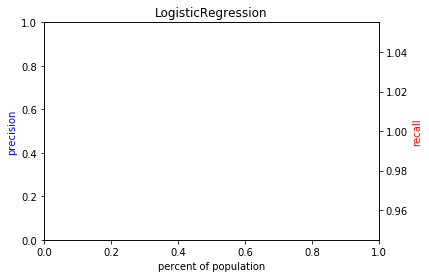

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

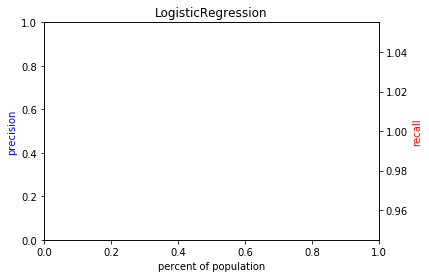

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

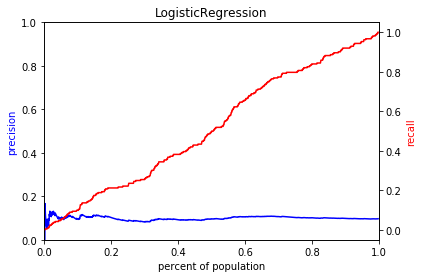

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

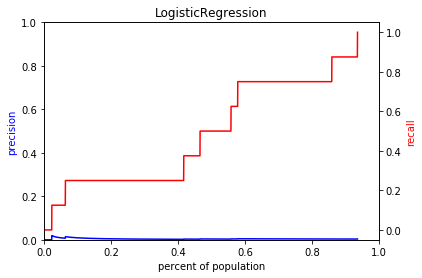

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

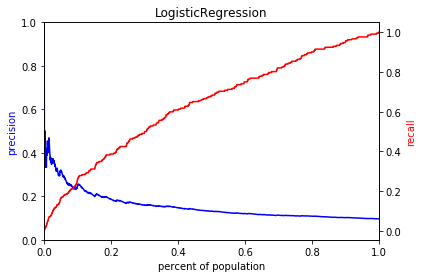

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

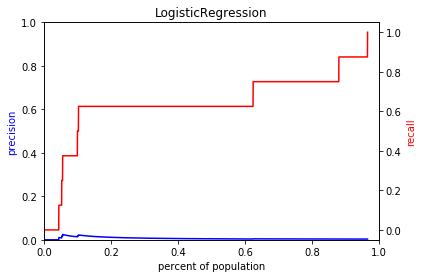

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

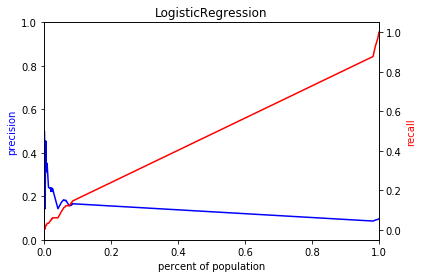

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

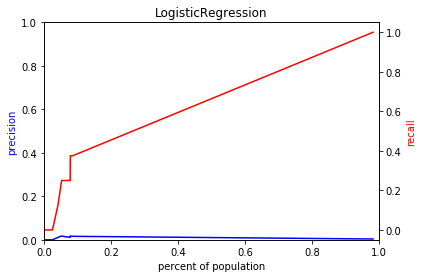

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

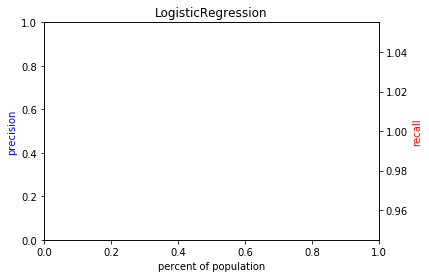

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

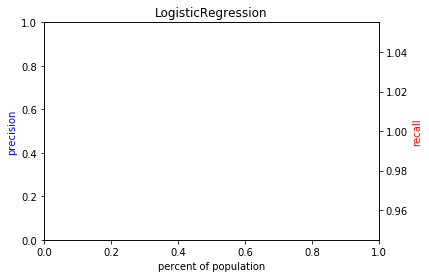

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

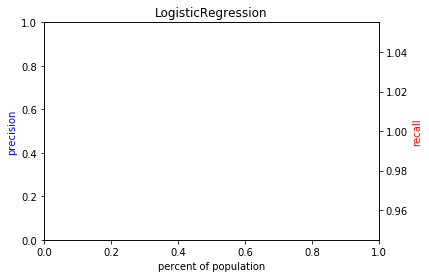

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

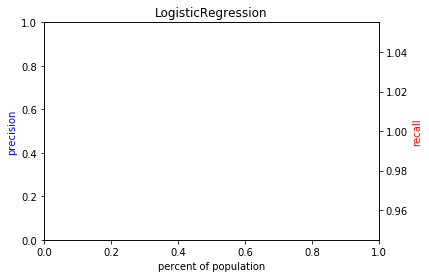

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

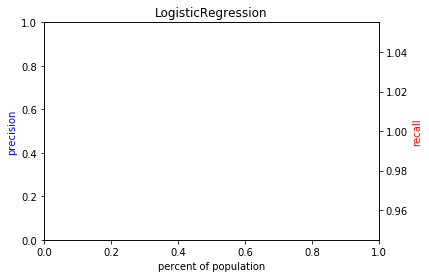

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

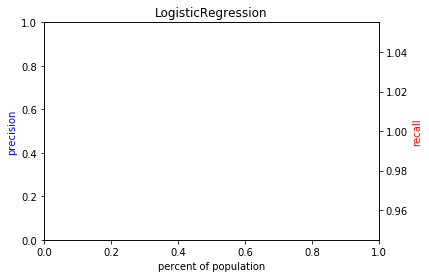

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

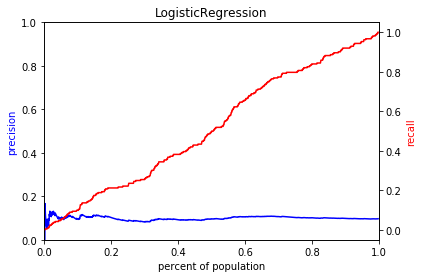

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

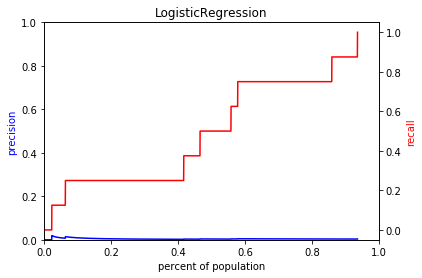

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

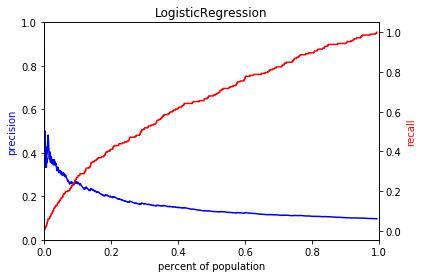

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

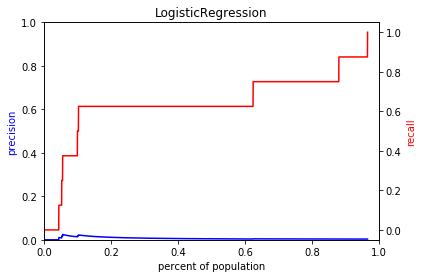

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

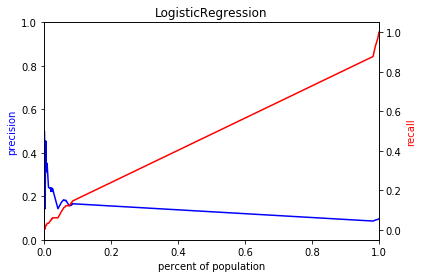

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

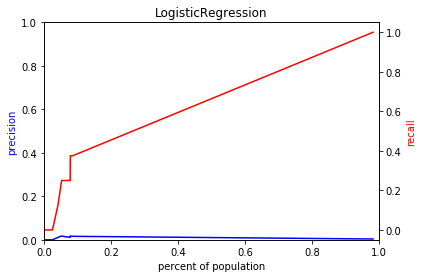

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

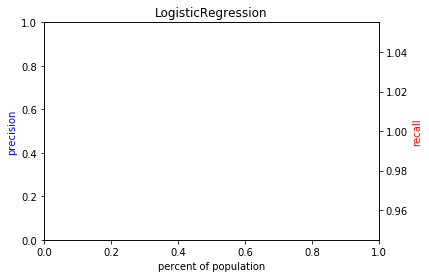

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

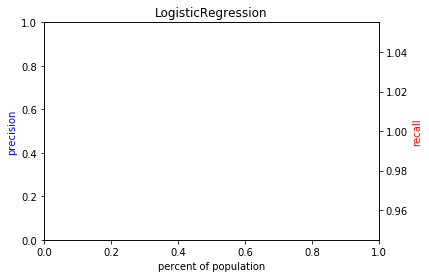

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

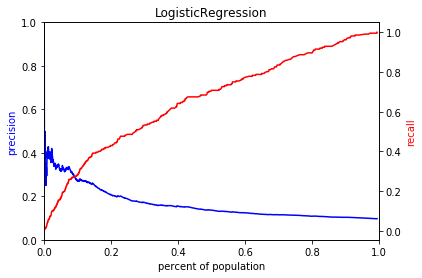

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

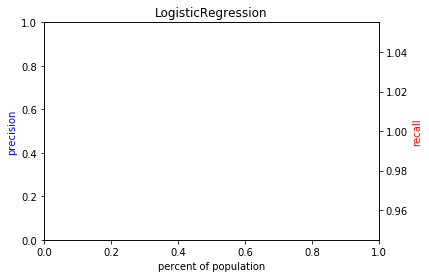

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

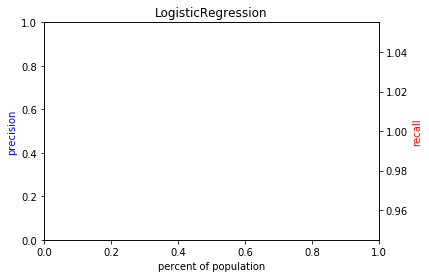

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


<Figure size 432x288 with 0 Axes>

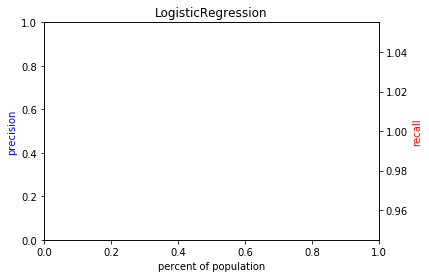

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

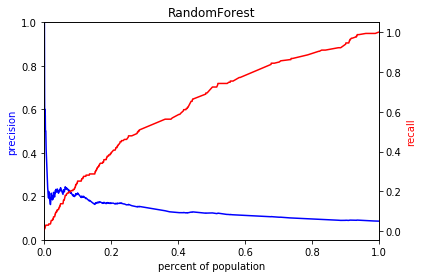

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

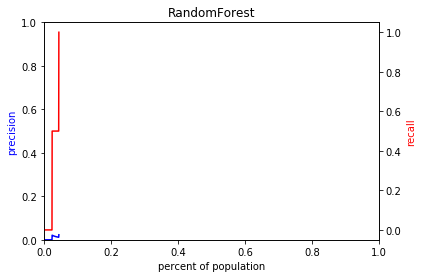

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

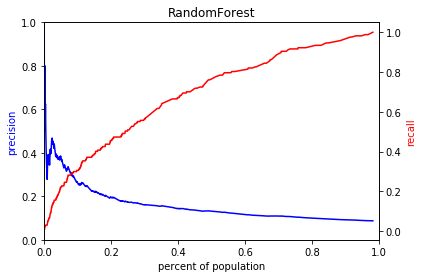

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

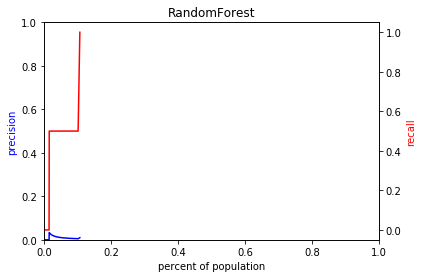

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

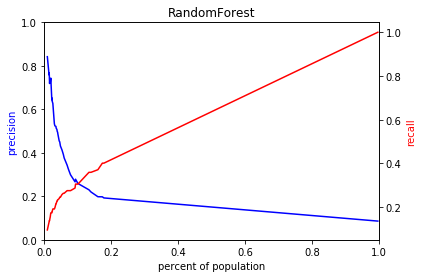

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

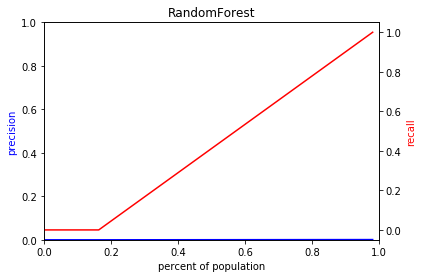

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

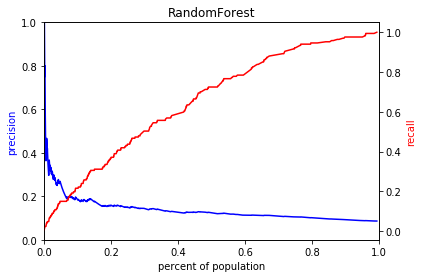

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

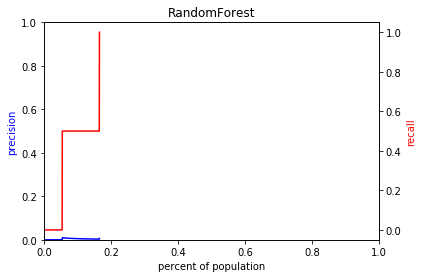

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

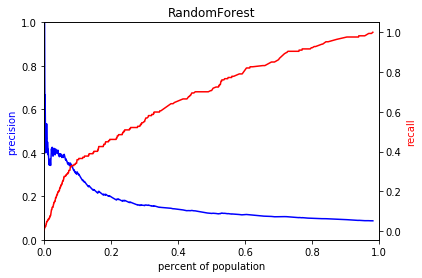

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

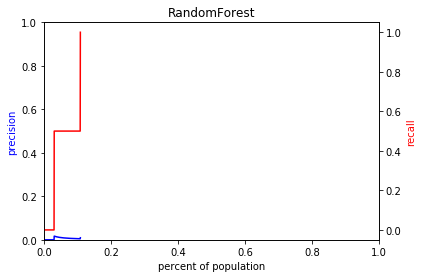

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

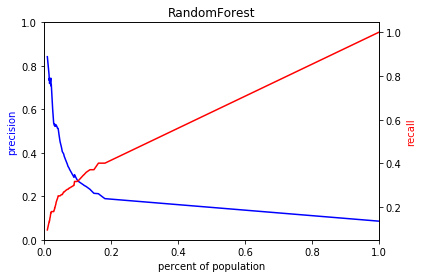

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

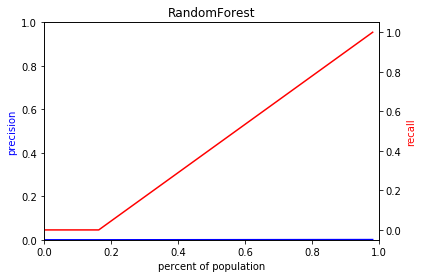

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

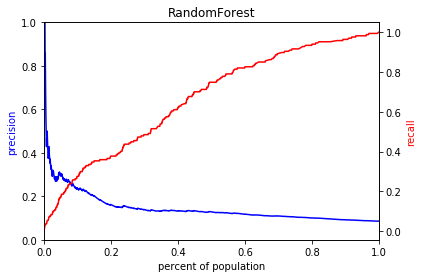

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

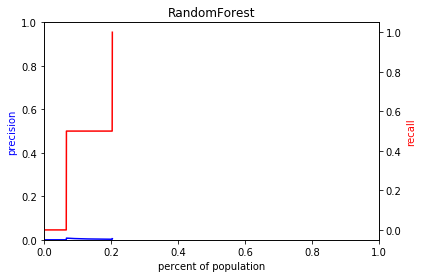

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

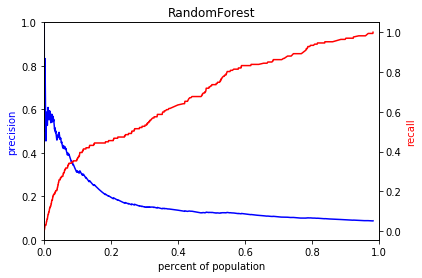

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

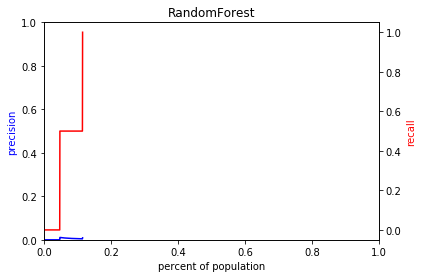

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

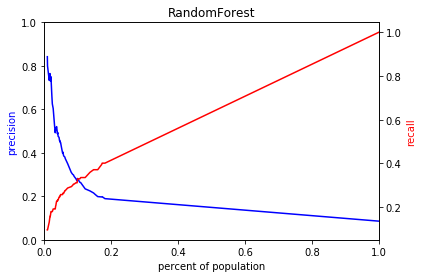

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

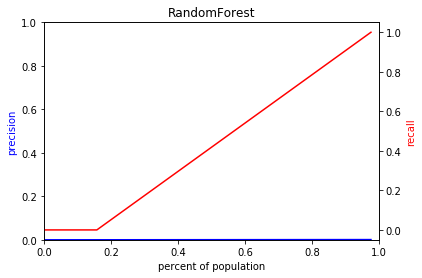

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

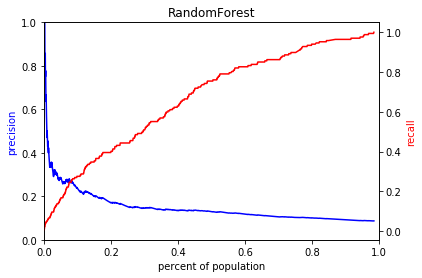

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

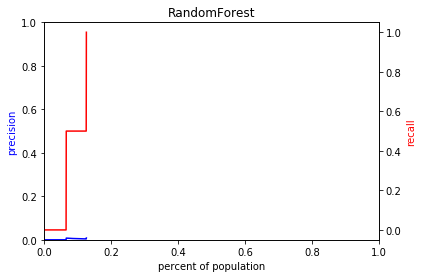

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

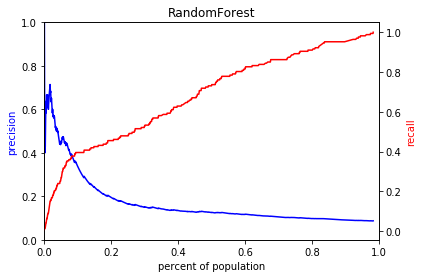

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

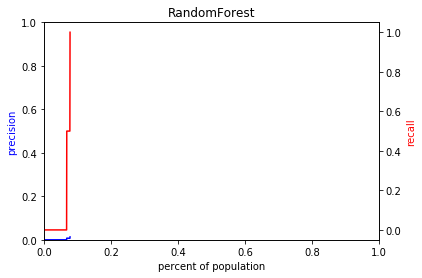

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

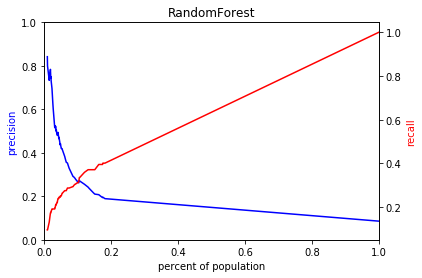

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

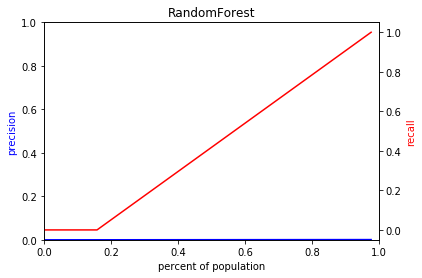

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

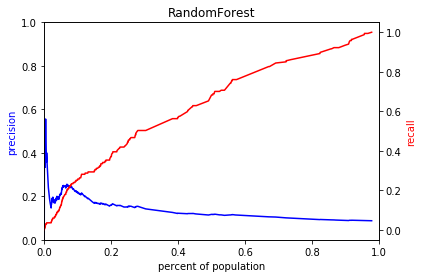

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

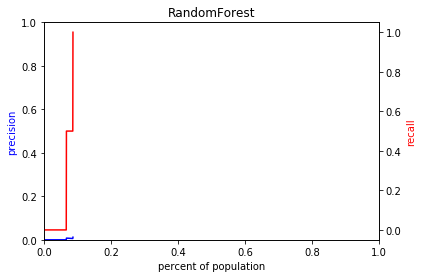

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

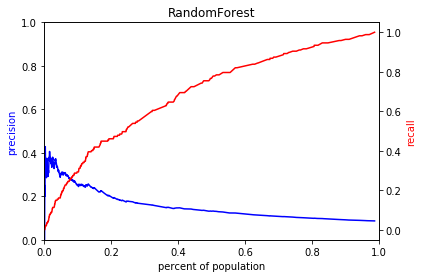

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

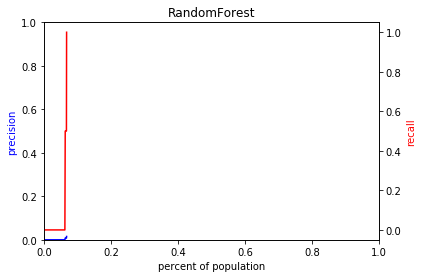

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

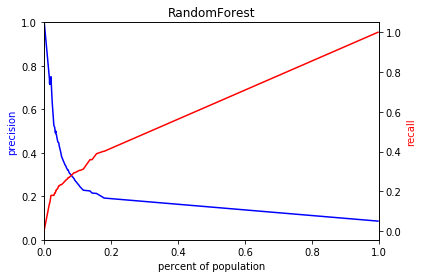

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

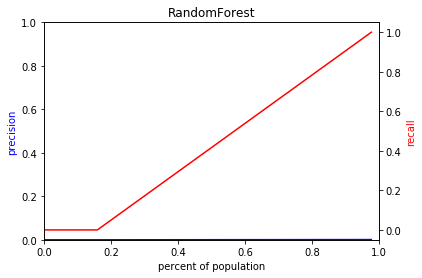

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

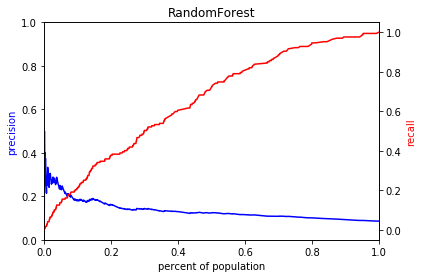

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

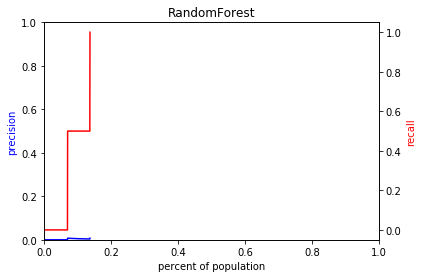

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

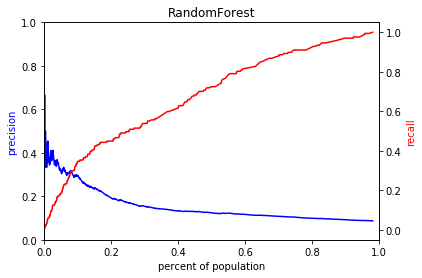

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

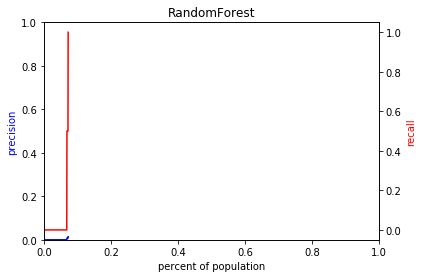

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

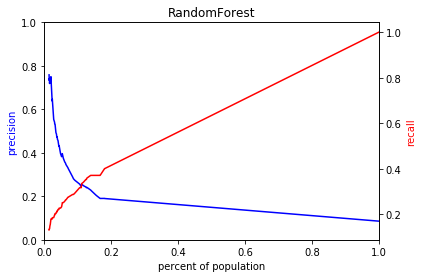

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

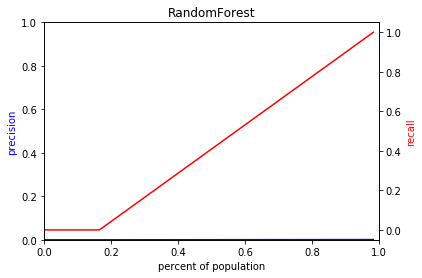

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

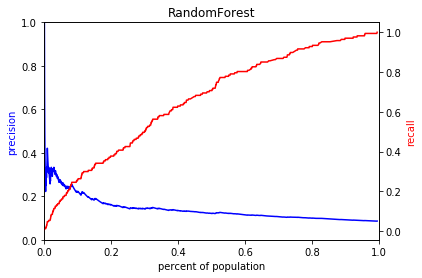

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

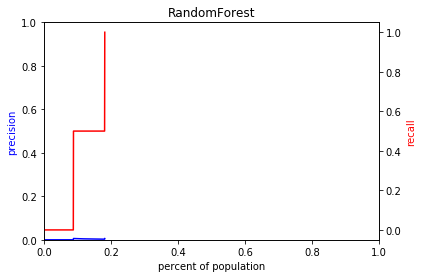

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

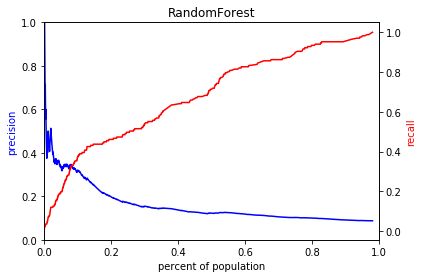

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

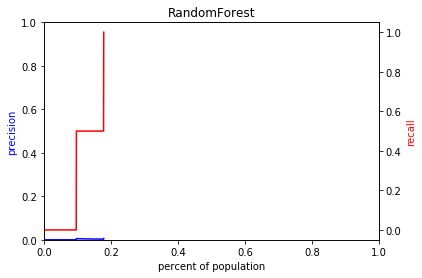

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

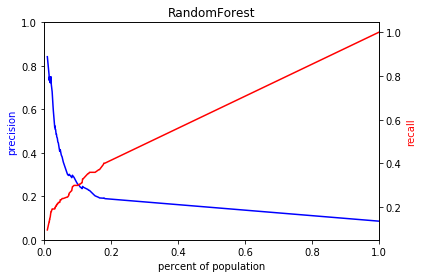

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

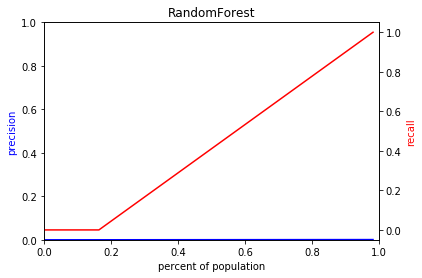

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

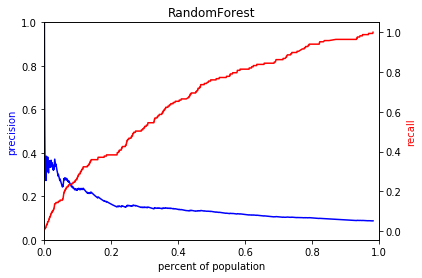

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

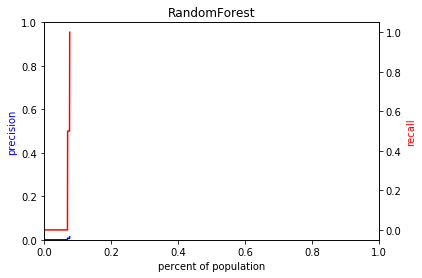

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

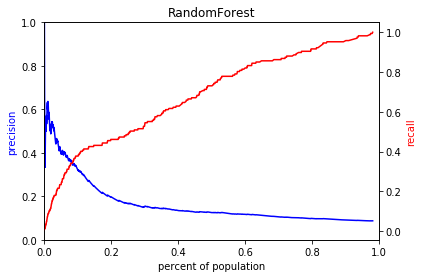

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

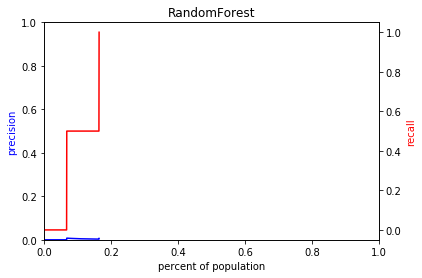

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

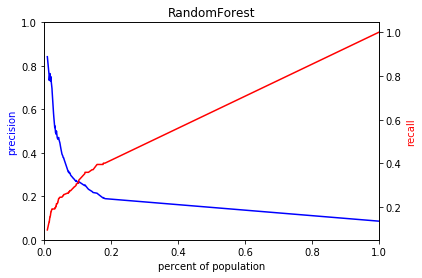

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

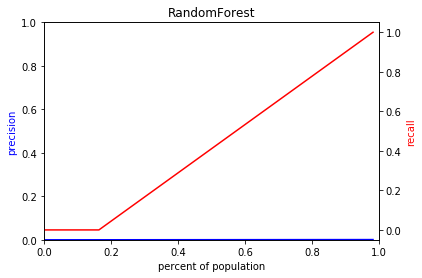

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

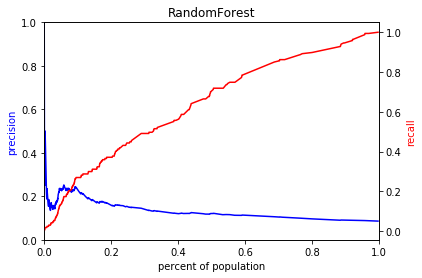

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

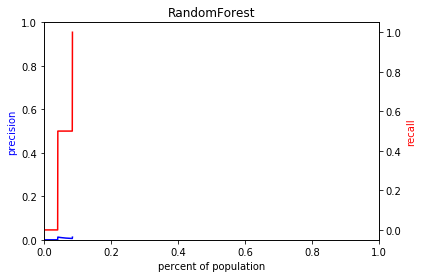

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

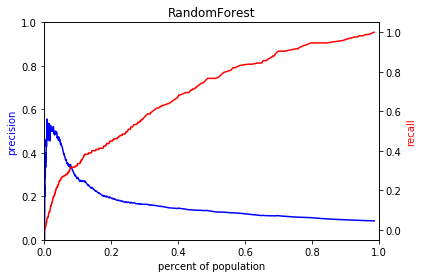

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

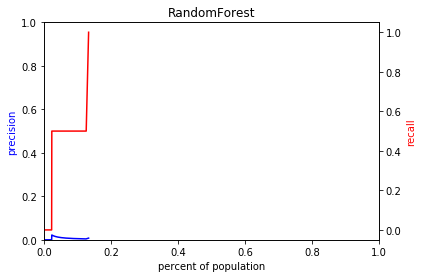

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

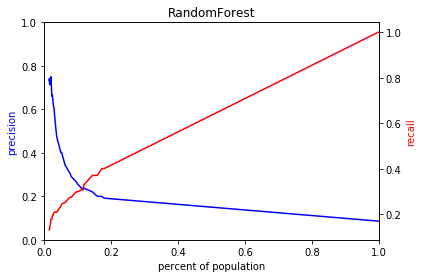

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

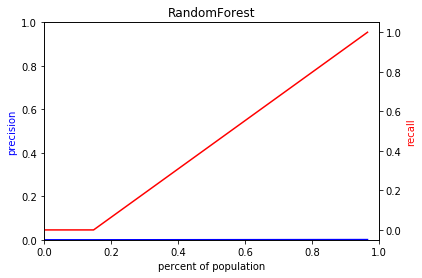

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

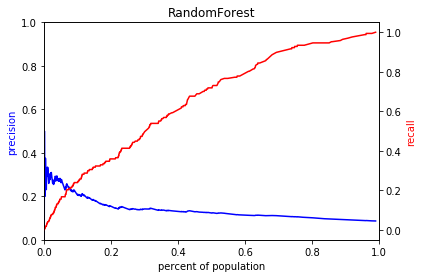

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

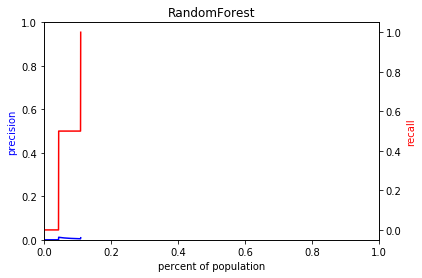

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

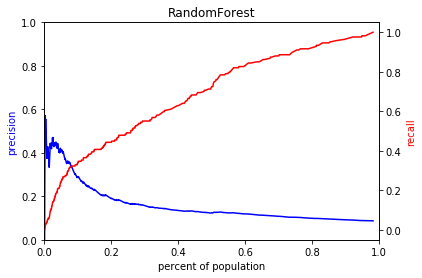

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

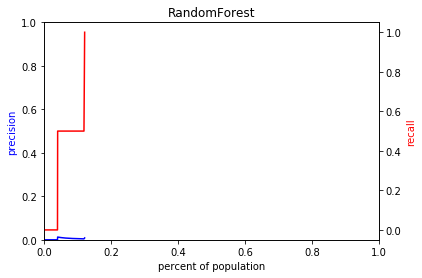

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

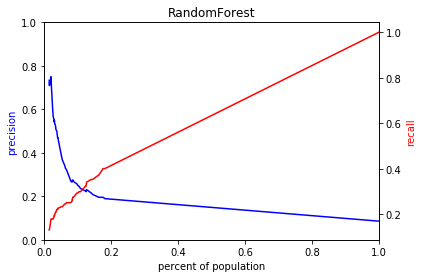

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

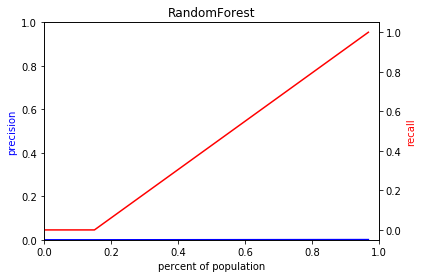

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

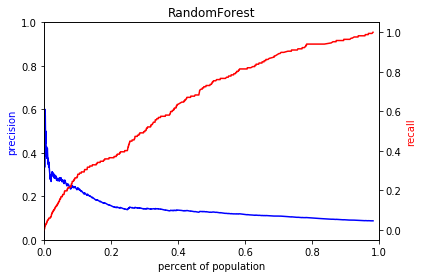

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

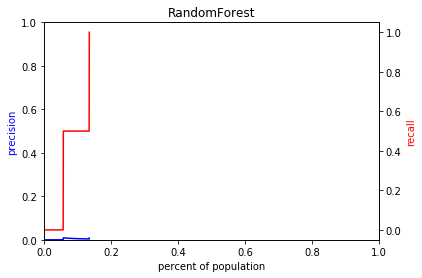

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

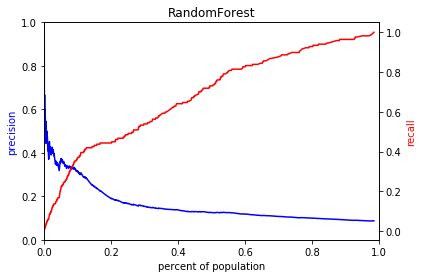

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

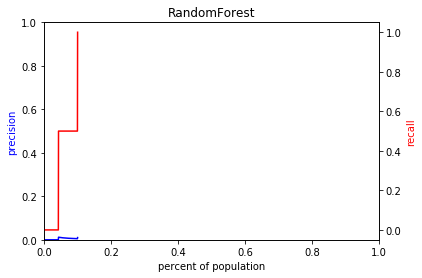

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

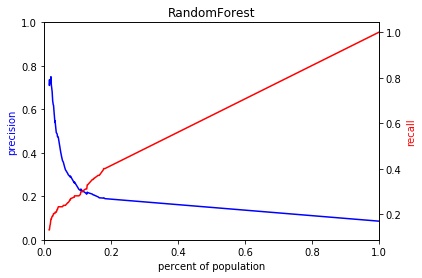

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

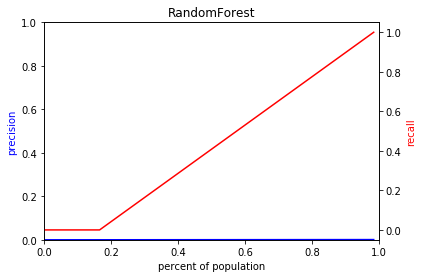

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

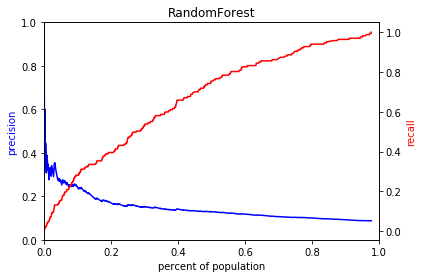

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

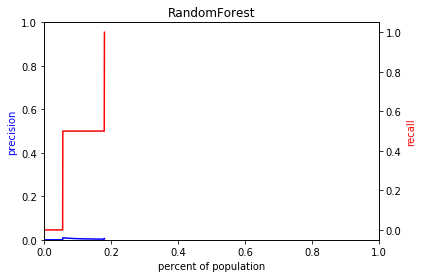

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

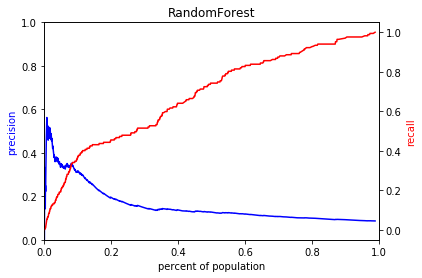

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

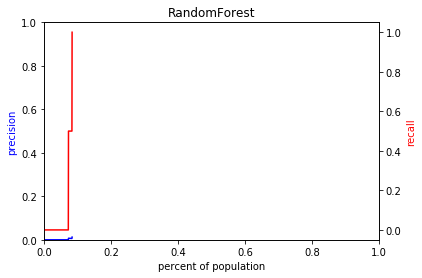

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

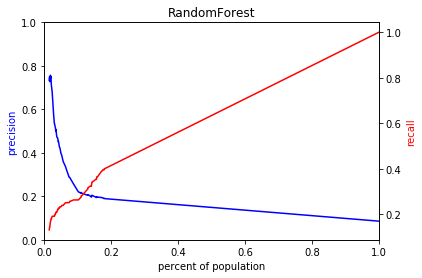

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

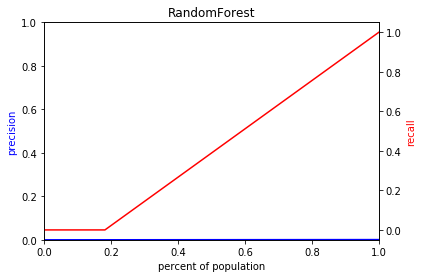

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

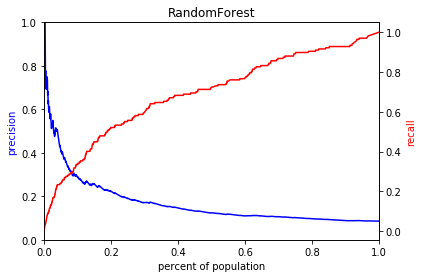

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

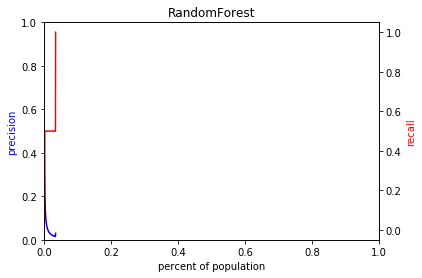

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

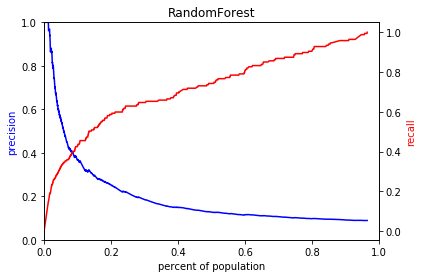

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

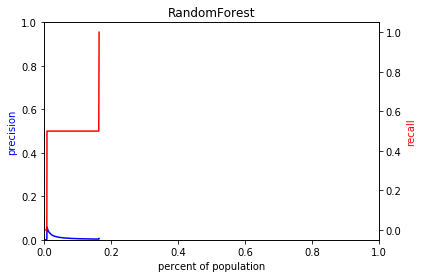

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

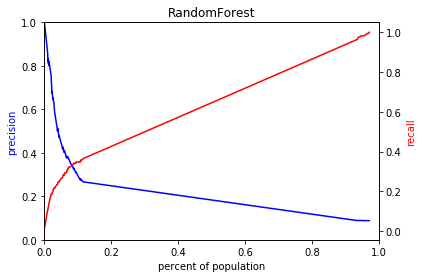

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

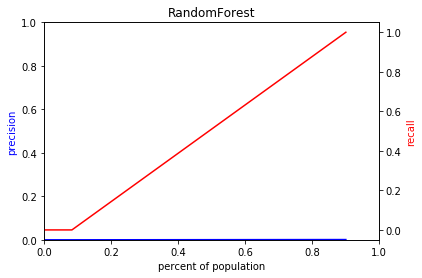

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

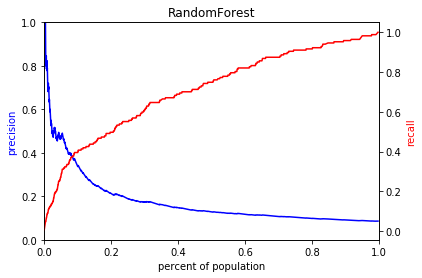

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

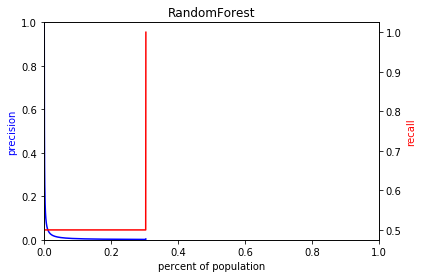

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

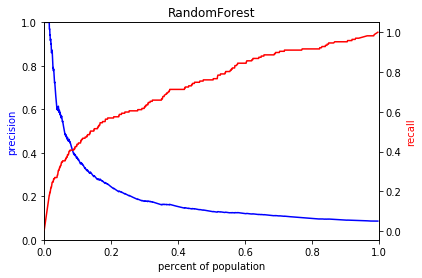

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

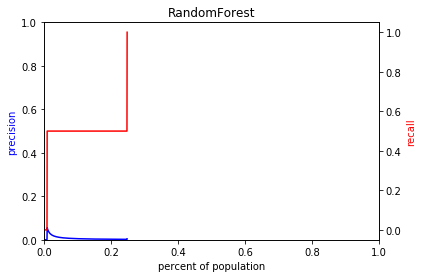

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

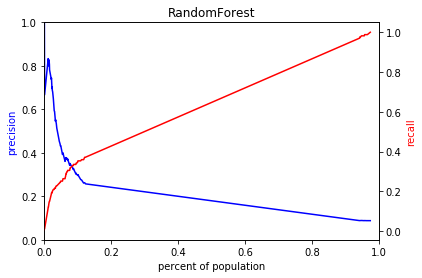

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

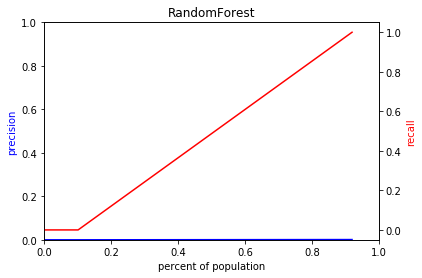

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

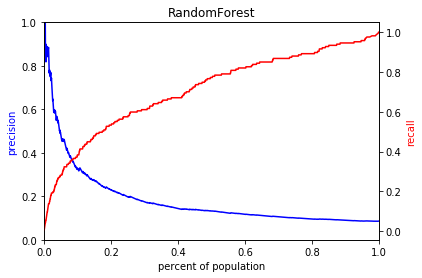

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

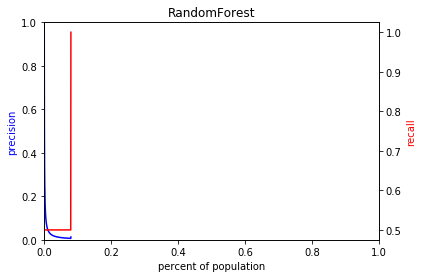

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

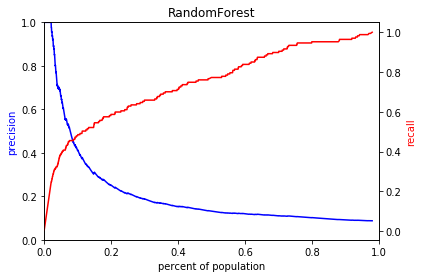

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

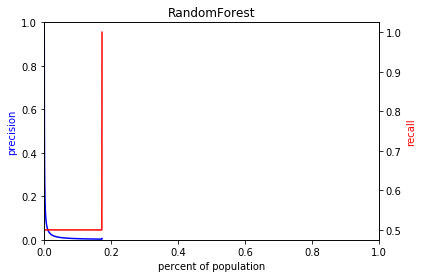

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

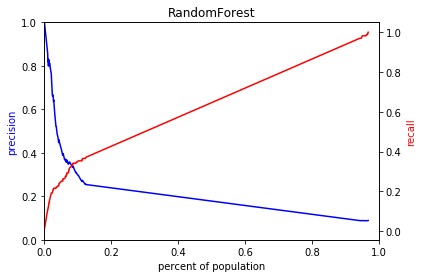

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

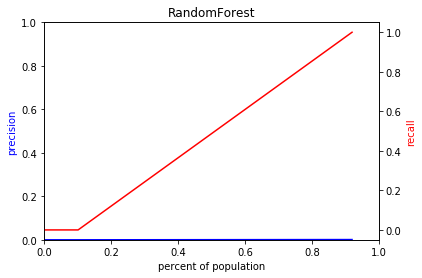

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

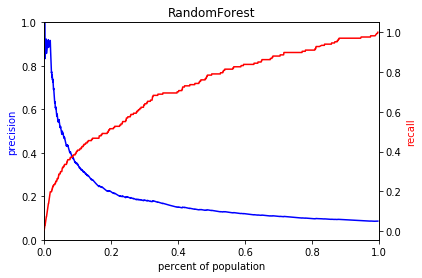

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

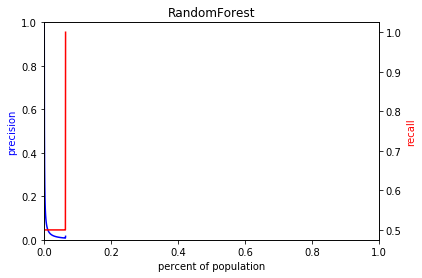

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

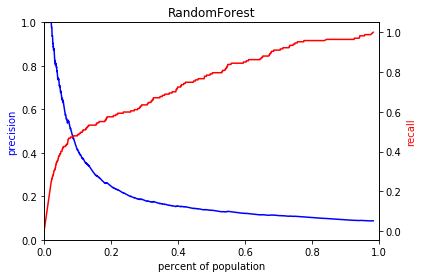

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

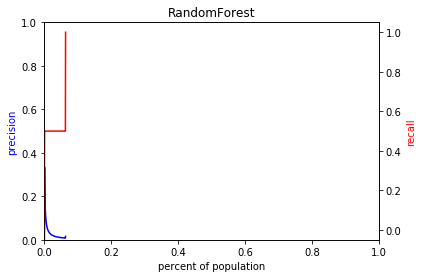

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

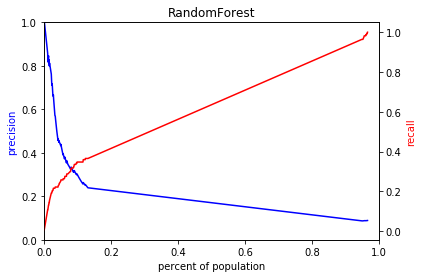

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

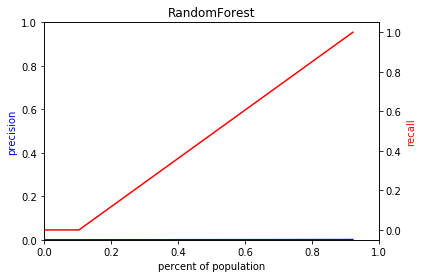

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

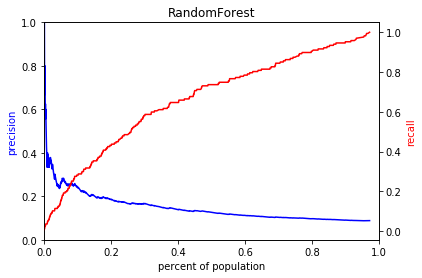

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

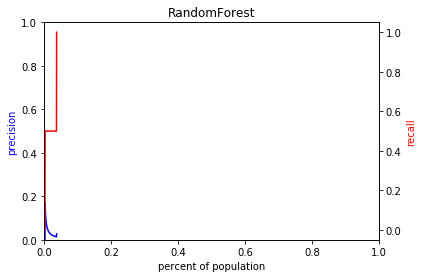

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

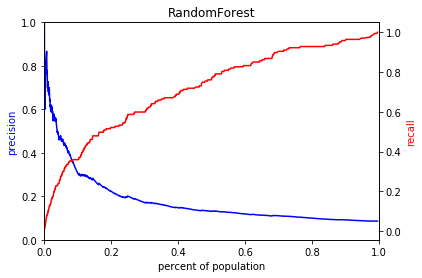

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

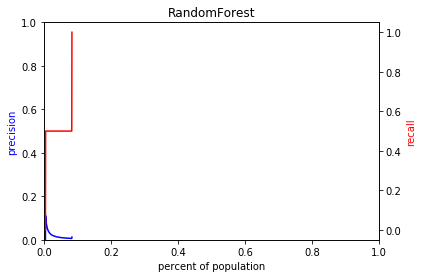

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

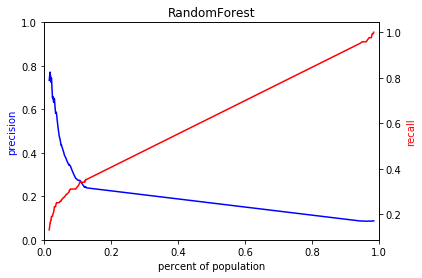

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

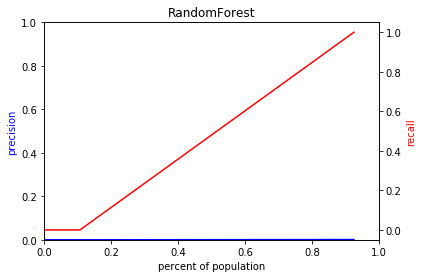

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

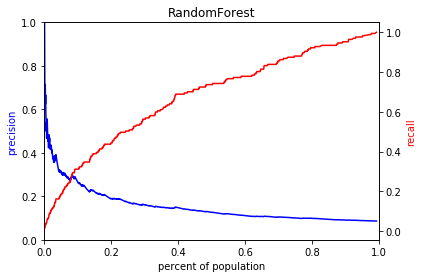

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

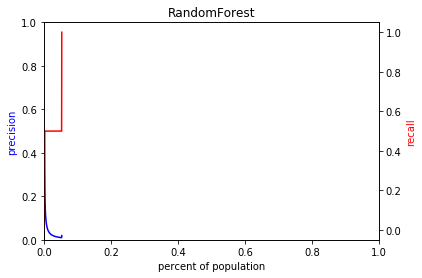

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

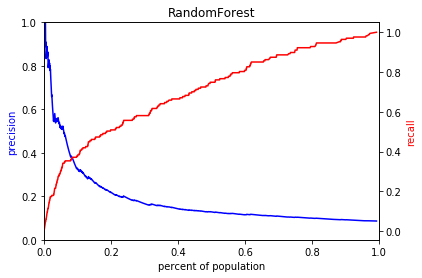

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

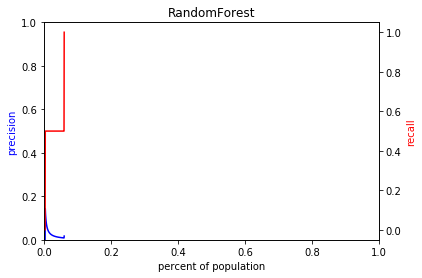

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

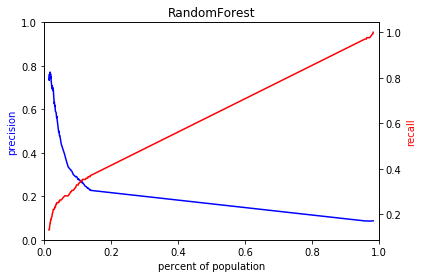

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

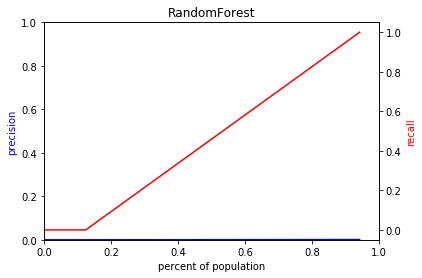

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

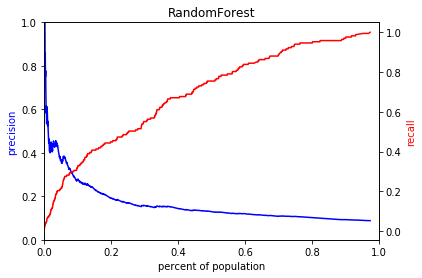

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

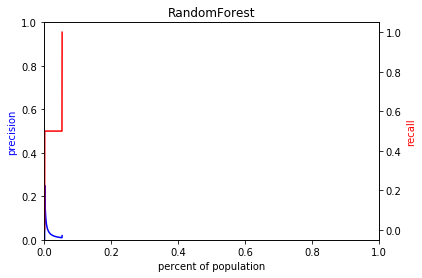

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

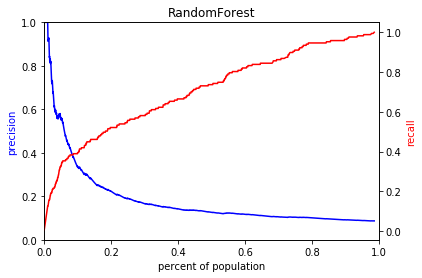

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

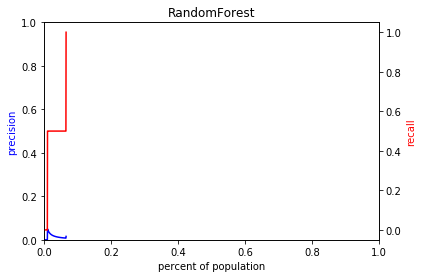

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

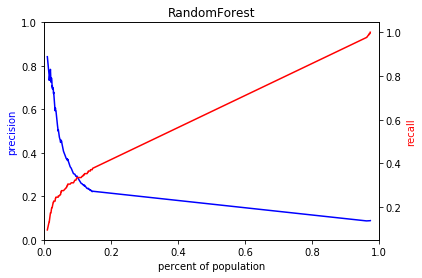

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

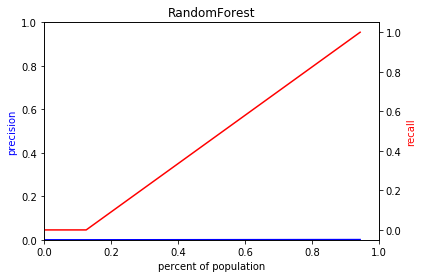

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

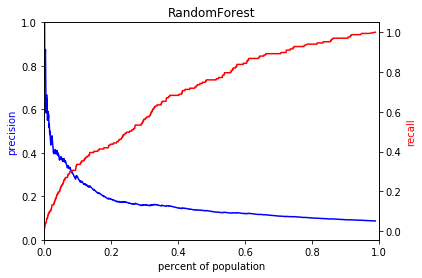

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

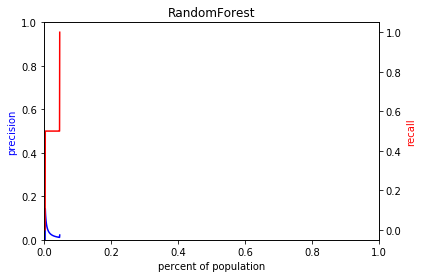

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

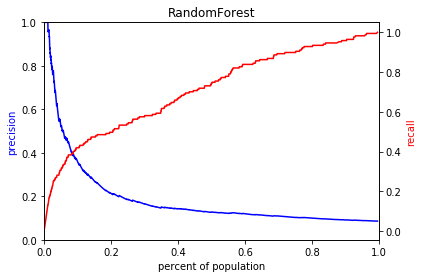

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

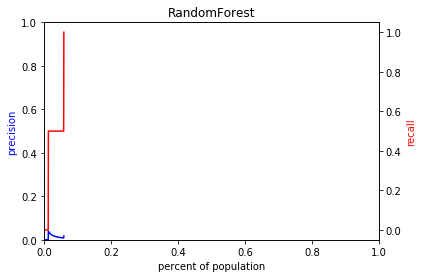

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

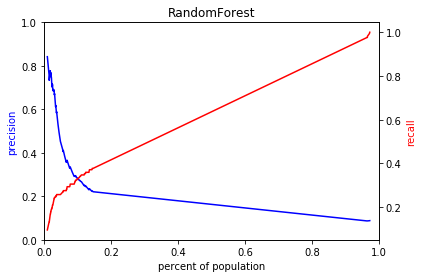

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

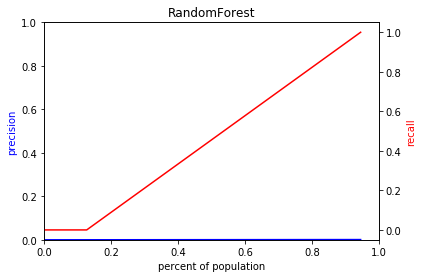

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

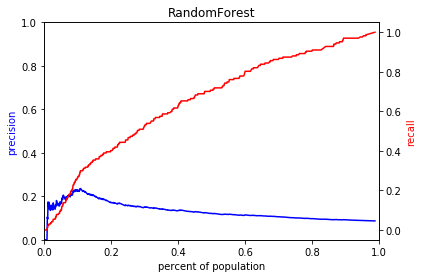

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

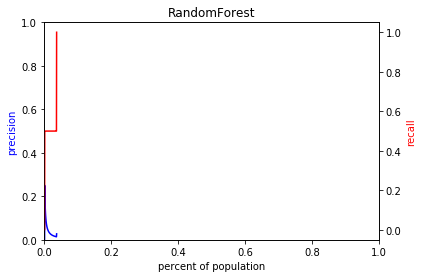

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

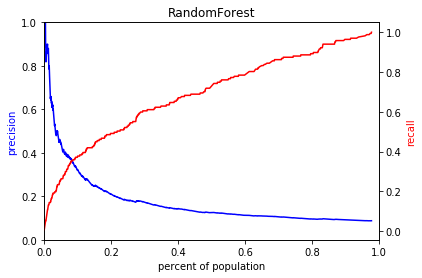

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

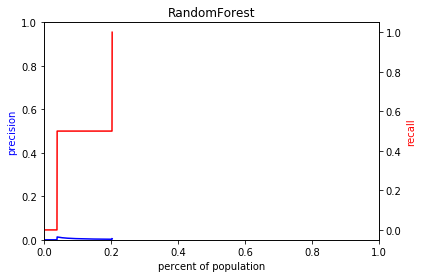

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

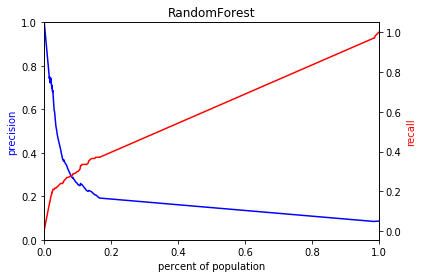

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

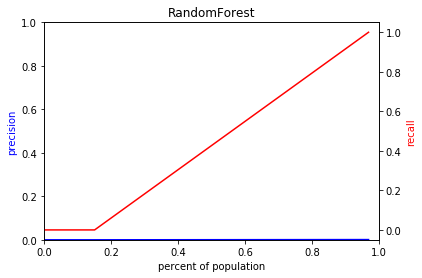

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

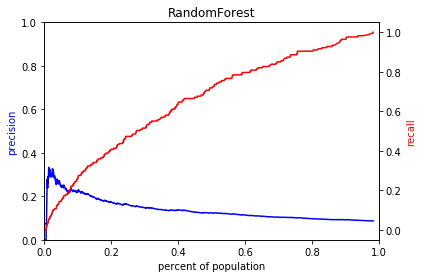

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

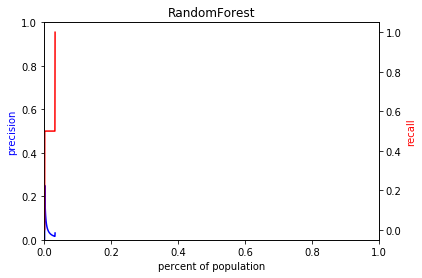

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

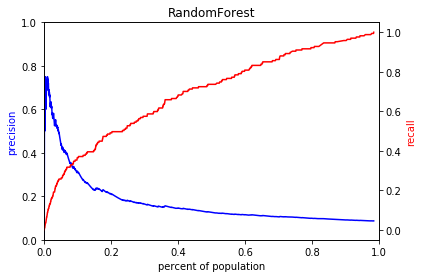

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

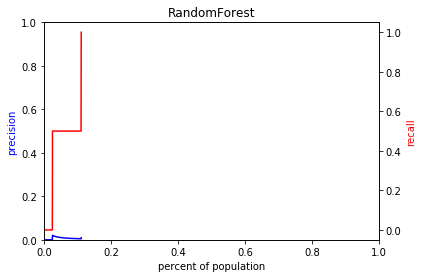

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

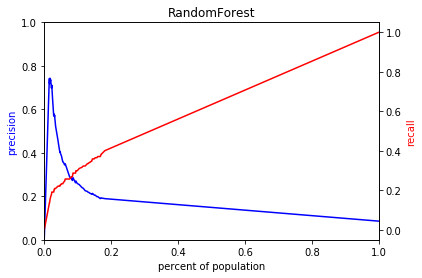

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

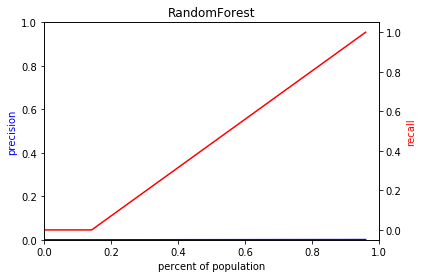

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

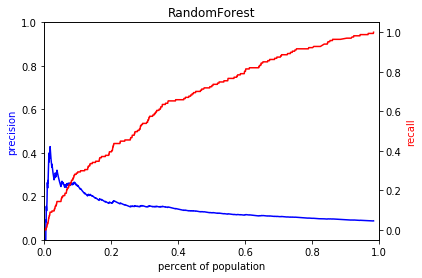

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

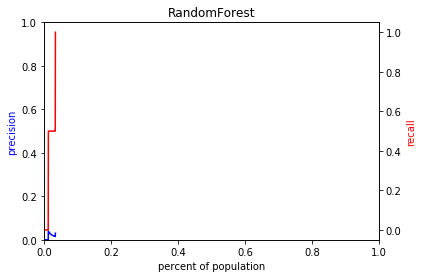

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

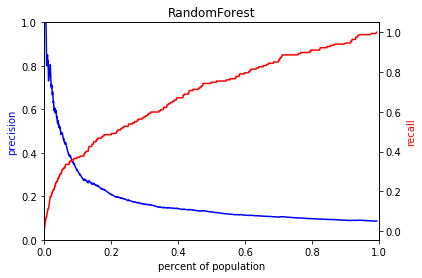

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

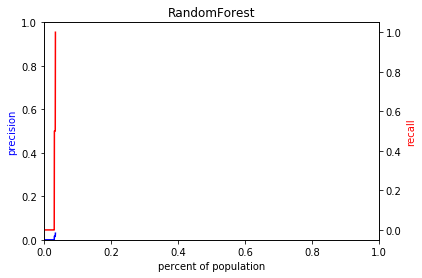

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

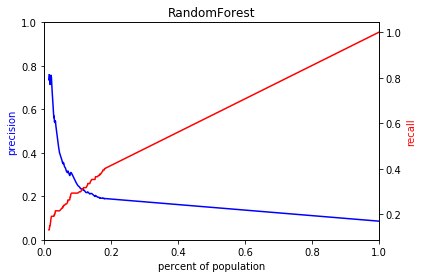

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

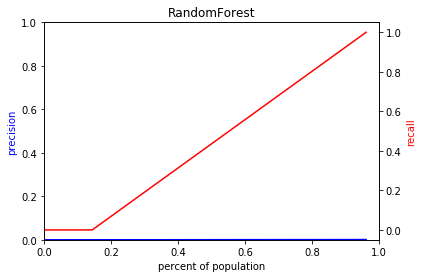

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

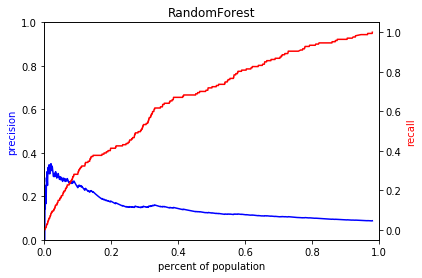

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

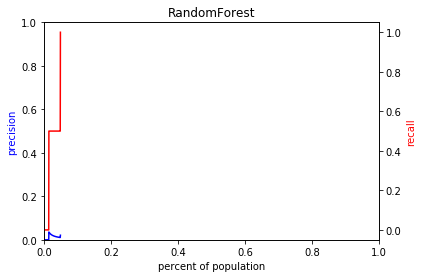

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

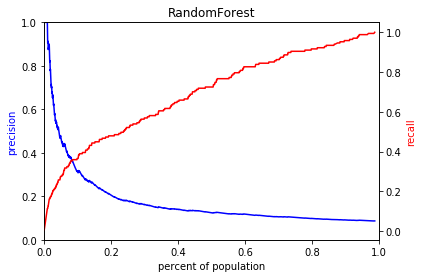

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

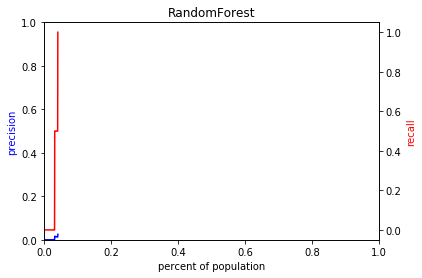

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

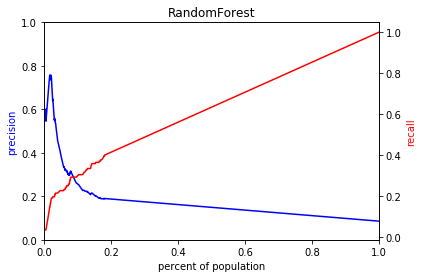

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

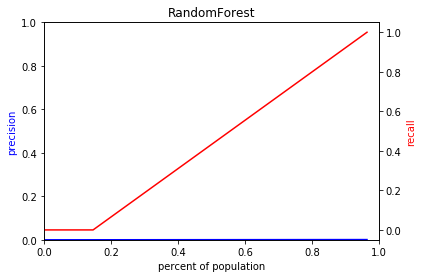

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

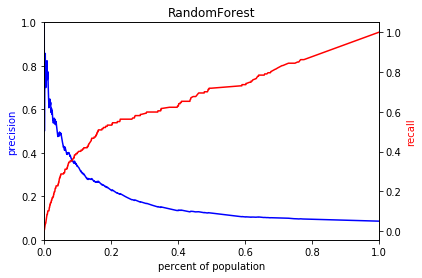

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

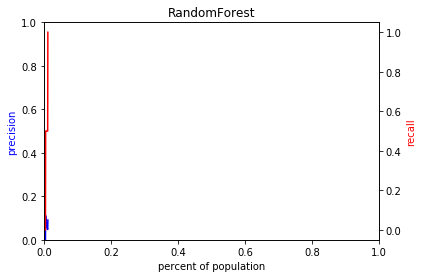

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

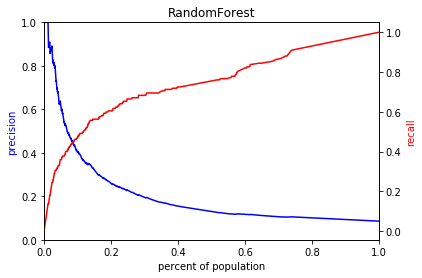

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

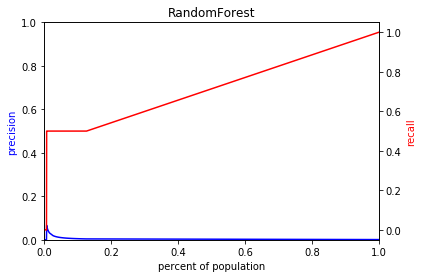

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

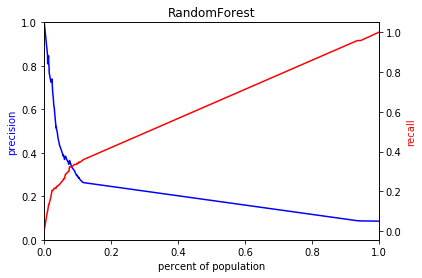

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

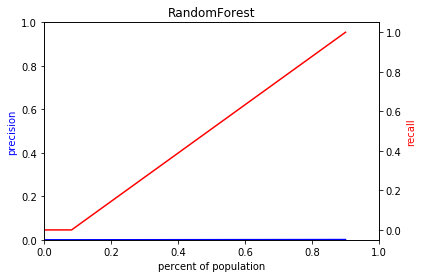

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

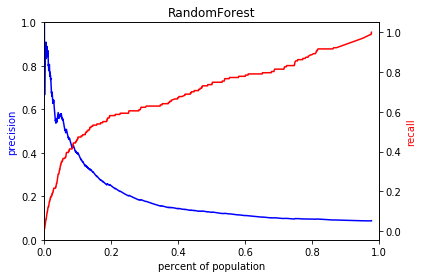

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

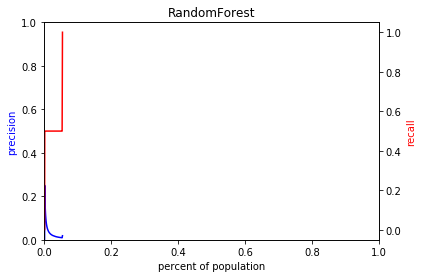

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

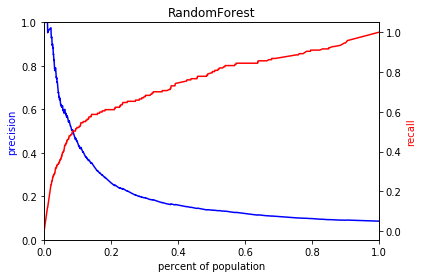

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

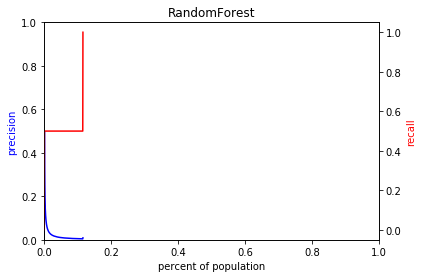

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

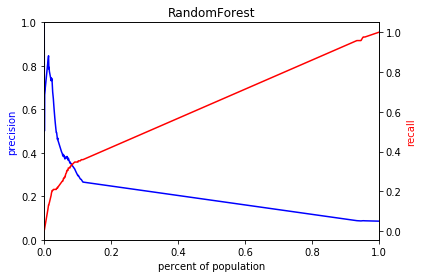

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

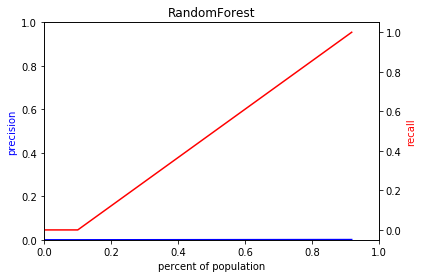

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

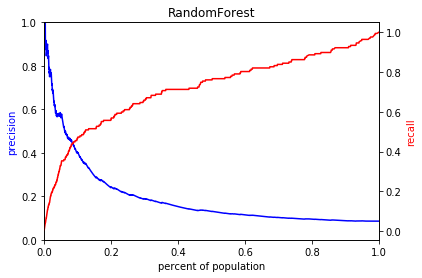

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

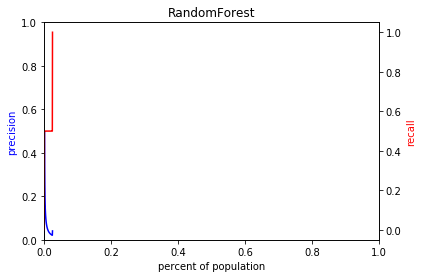

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

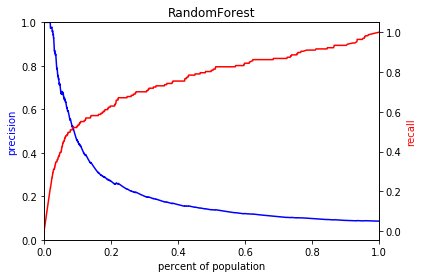

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

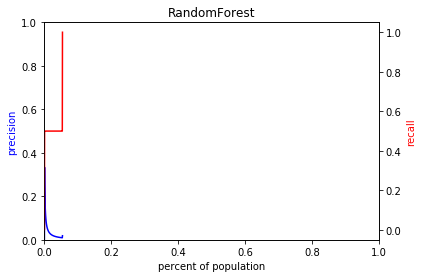

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

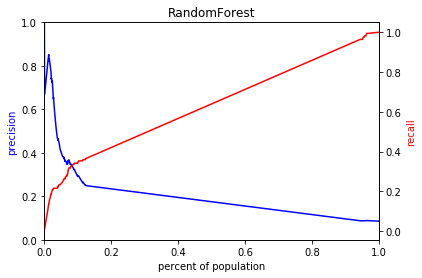

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

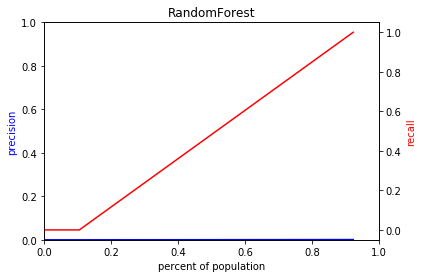

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

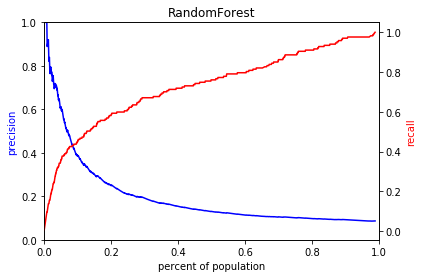

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

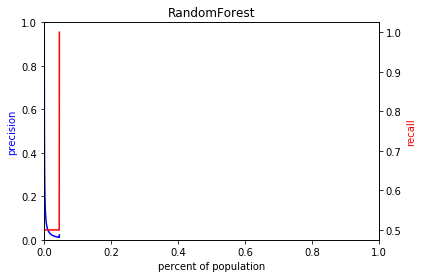

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

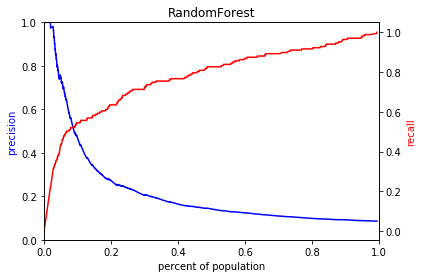

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

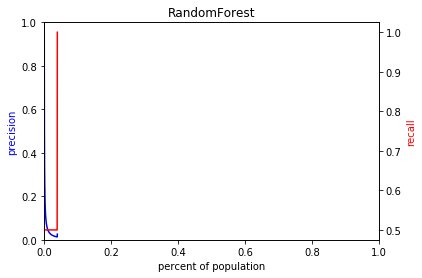

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

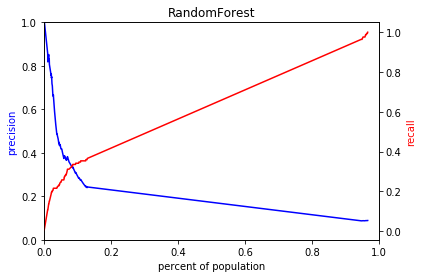

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

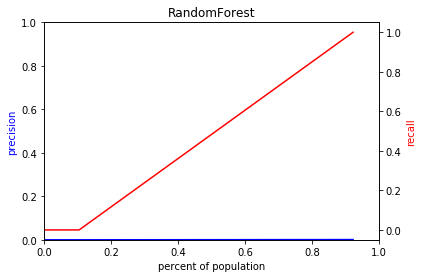

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

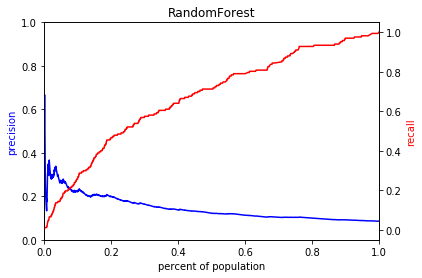

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

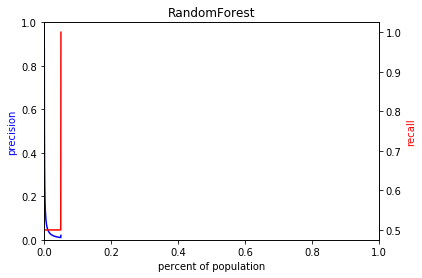

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

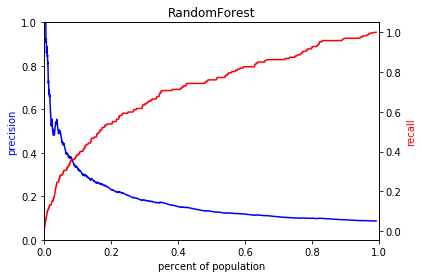

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

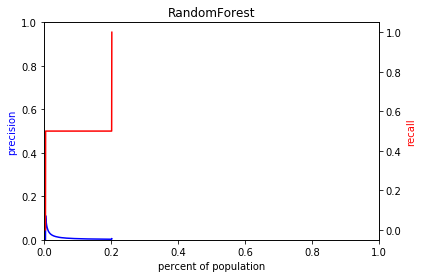

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

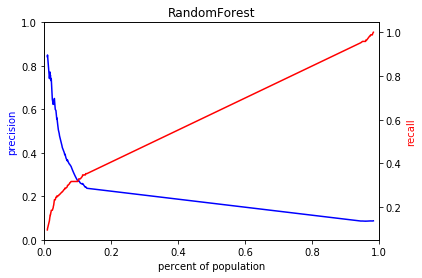

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

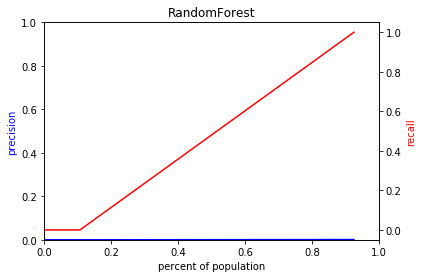

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

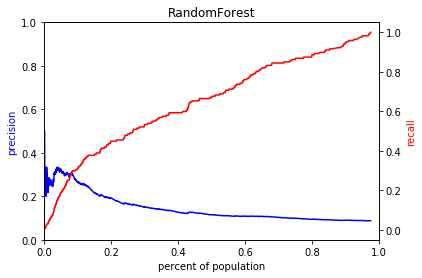

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

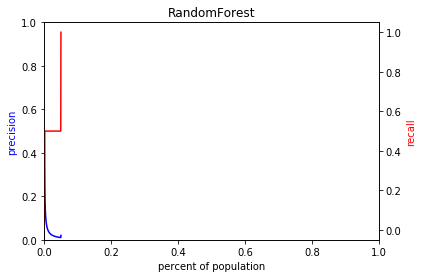

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

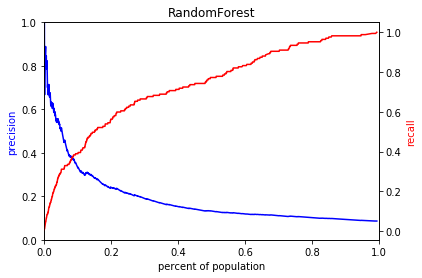

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

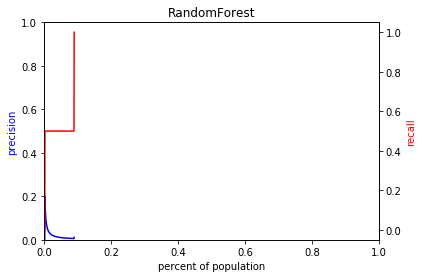

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

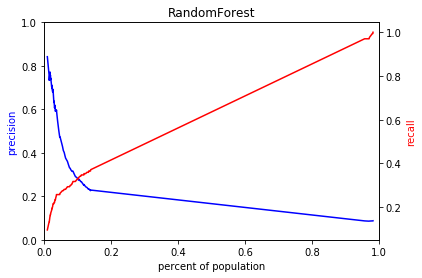

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

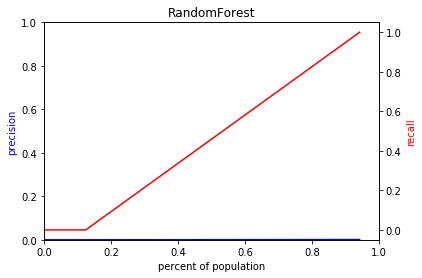

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

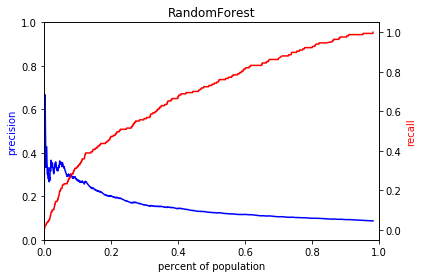

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

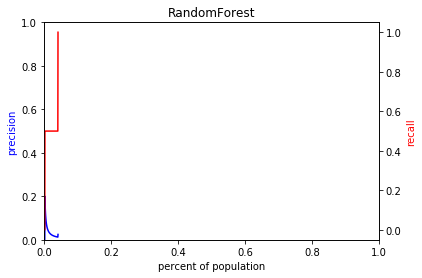

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

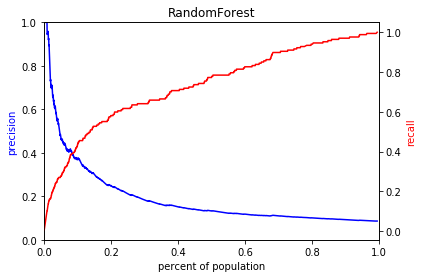

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

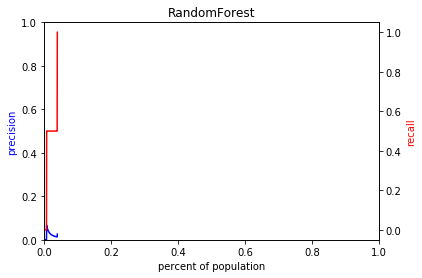

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

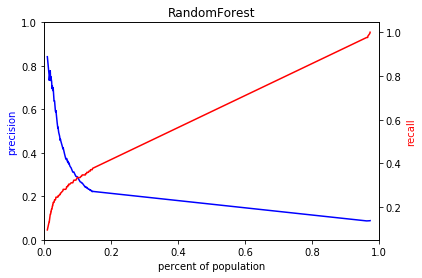

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

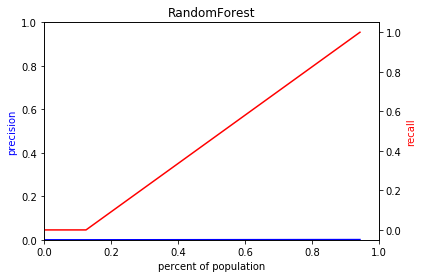

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

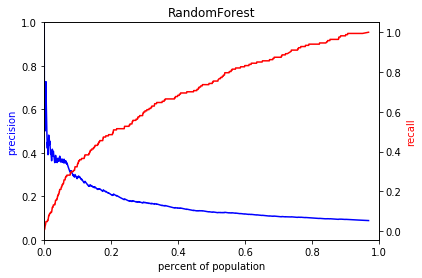

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

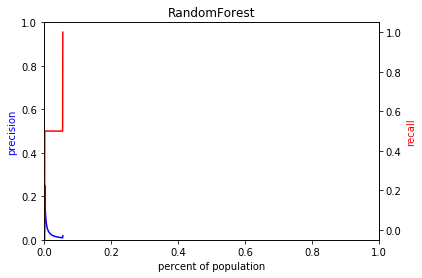

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

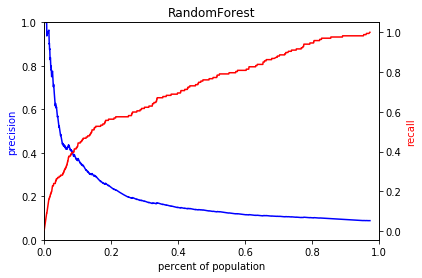

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

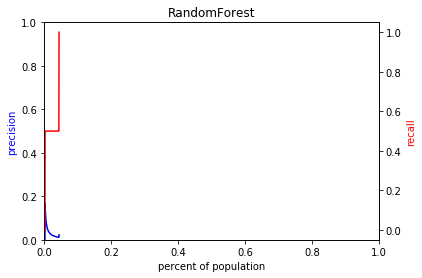

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

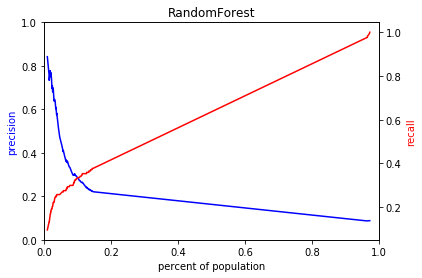

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

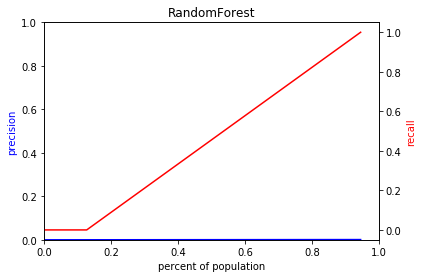

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

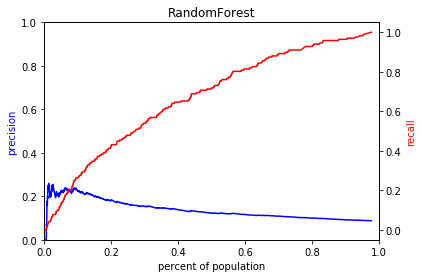

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

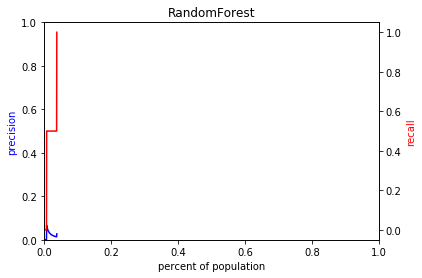

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

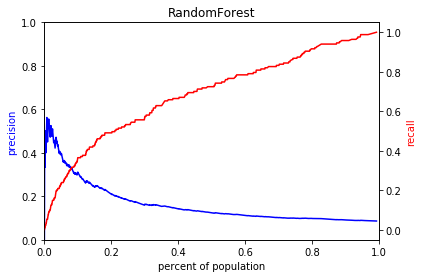

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

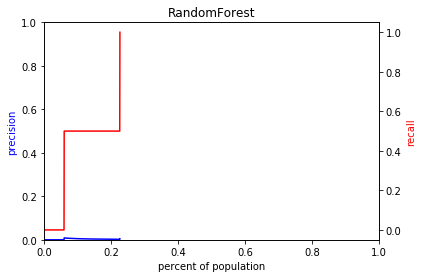

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

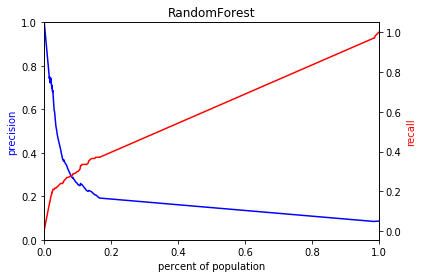

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

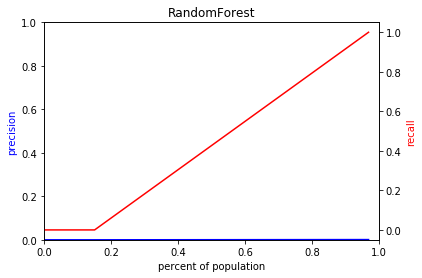

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

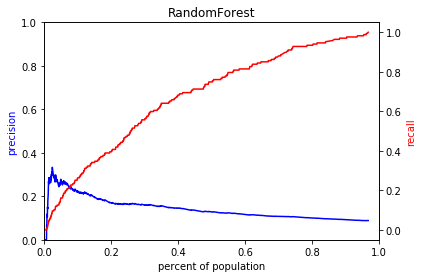

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

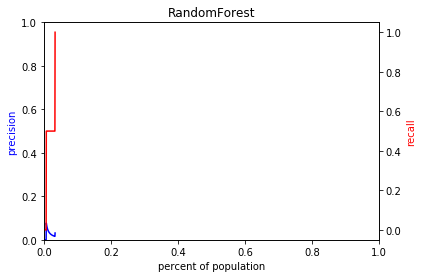

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

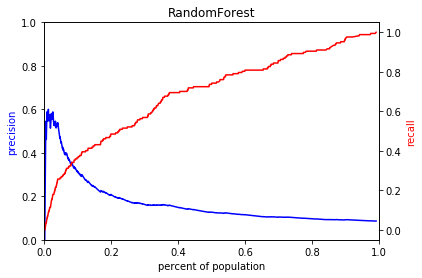

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

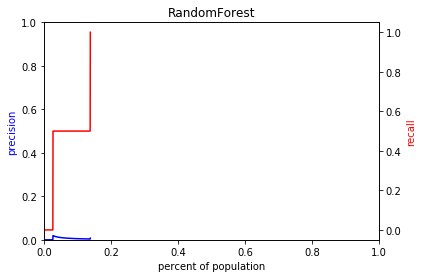

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

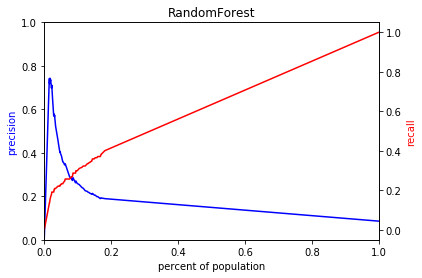

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

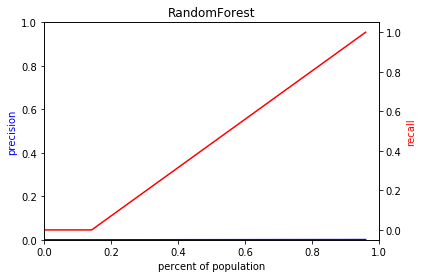

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

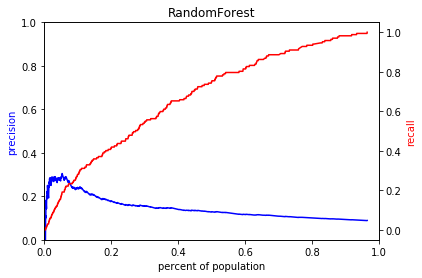

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

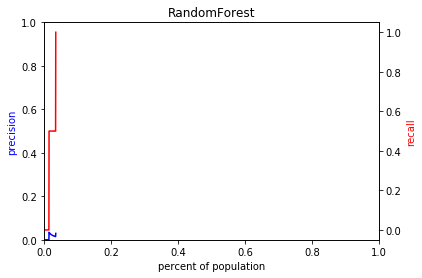

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

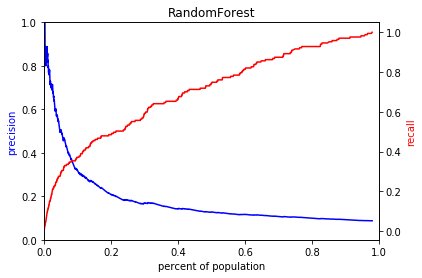

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

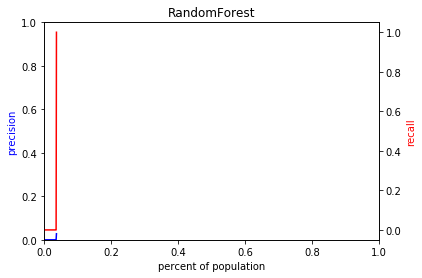

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

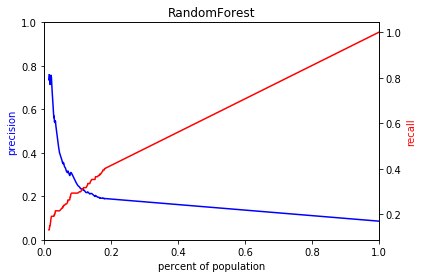

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

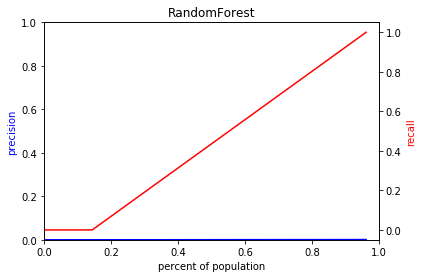

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

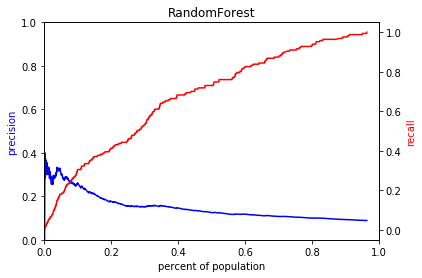

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

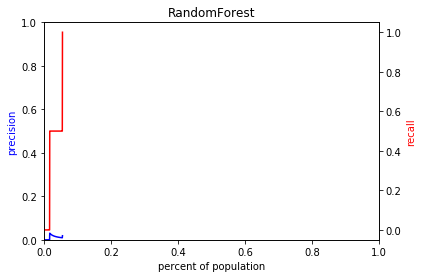

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

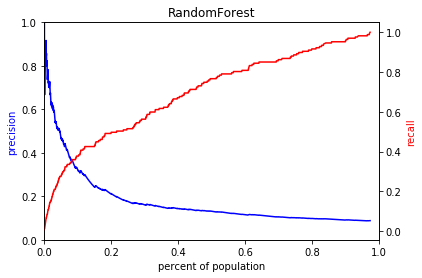

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

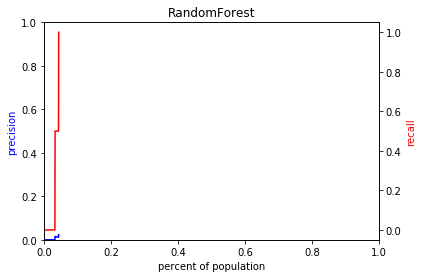

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

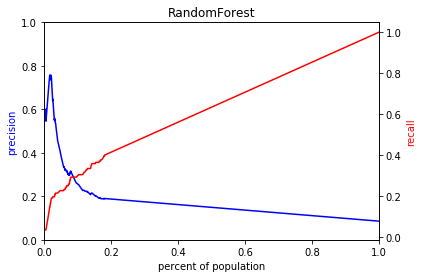

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

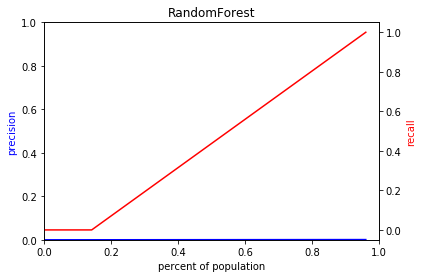

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

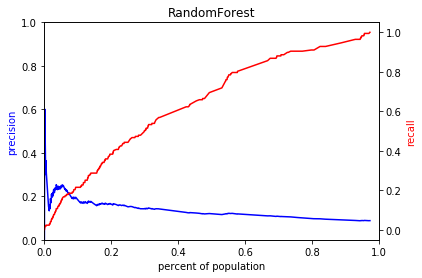

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

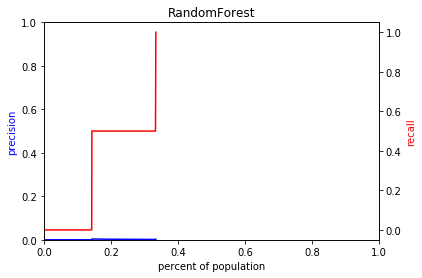

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

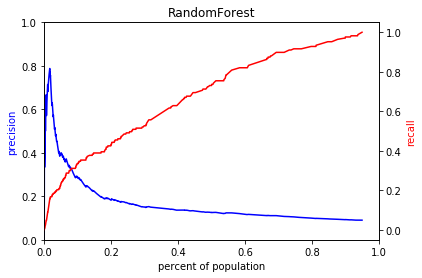

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

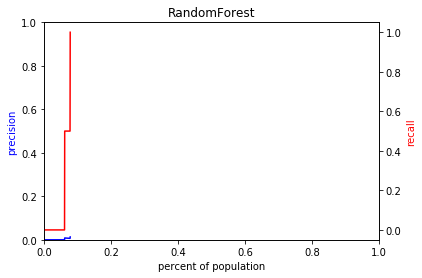

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

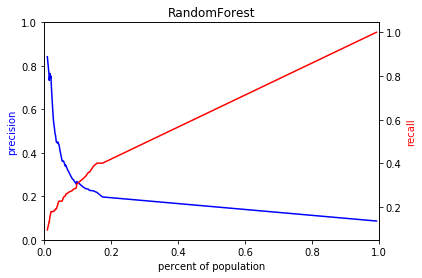

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

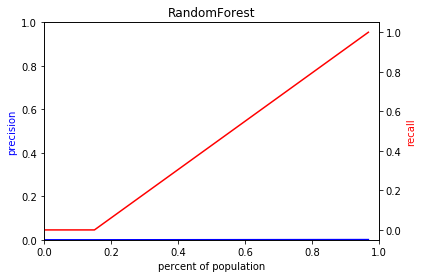

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

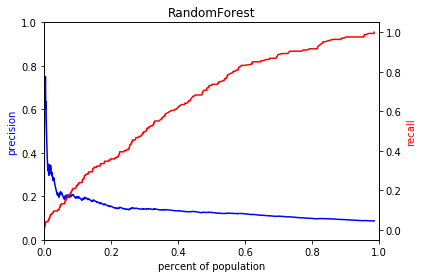

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

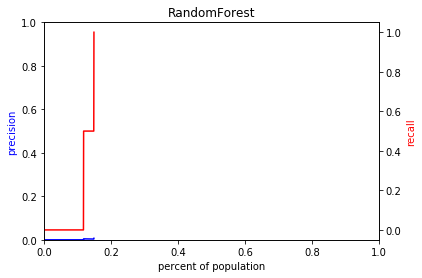

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

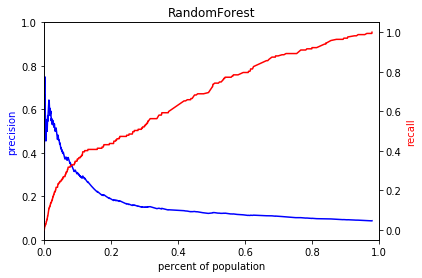

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

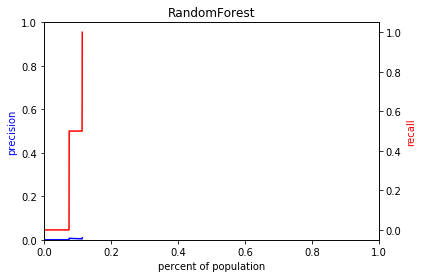

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

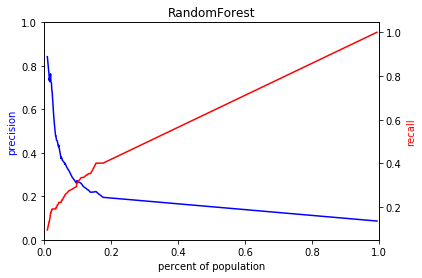

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

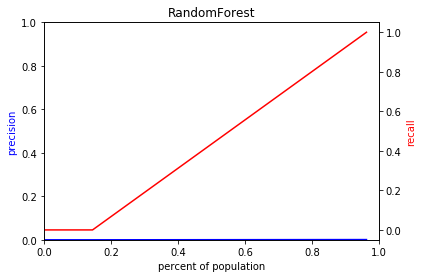

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

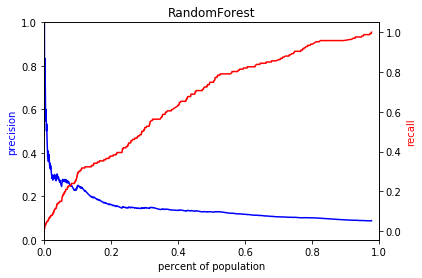

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

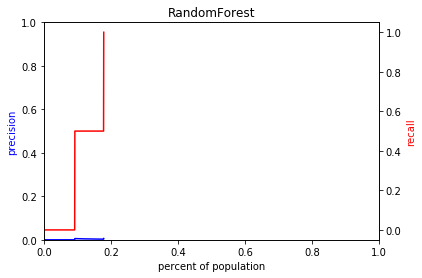

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

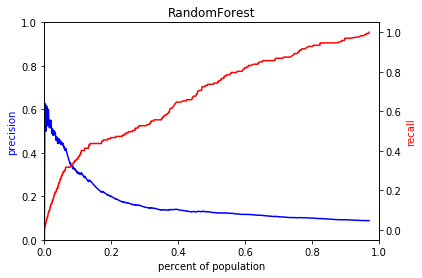

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

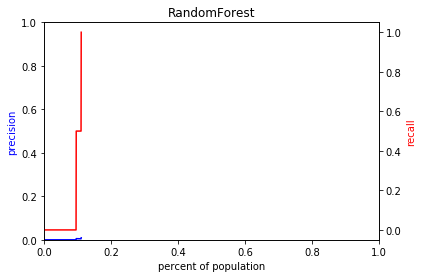

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

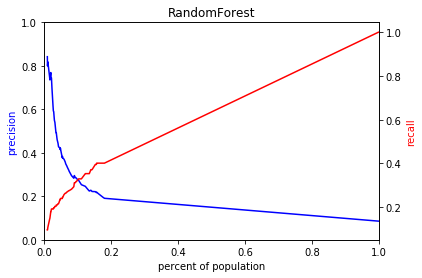

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

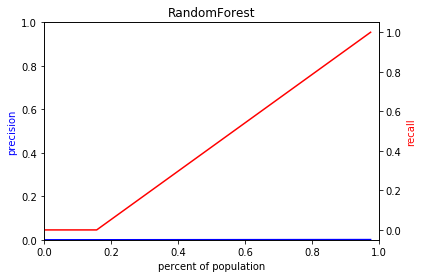

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

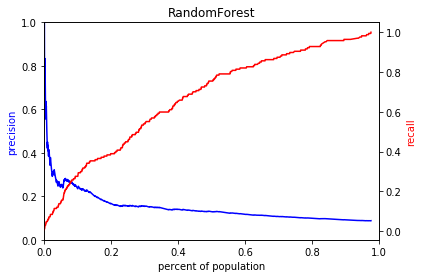

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

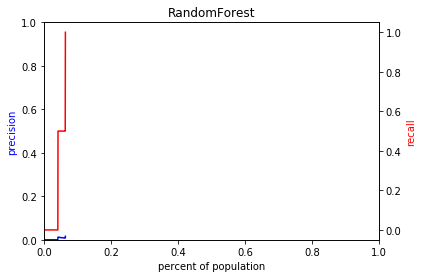

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

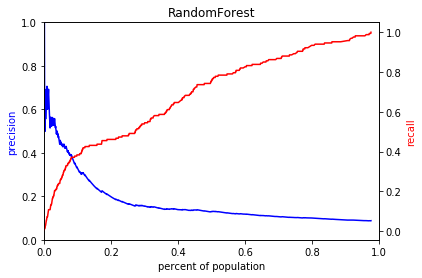

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

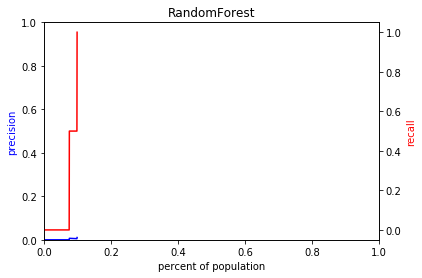

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

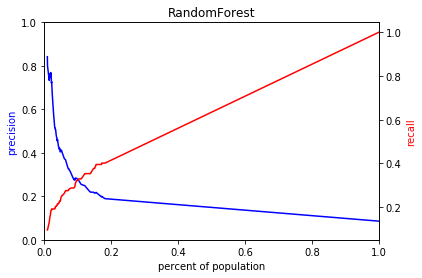

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

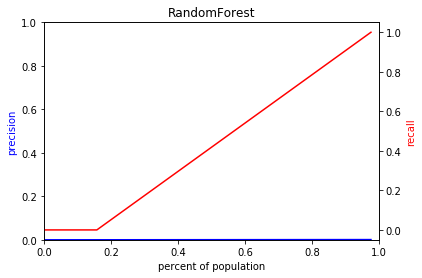

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

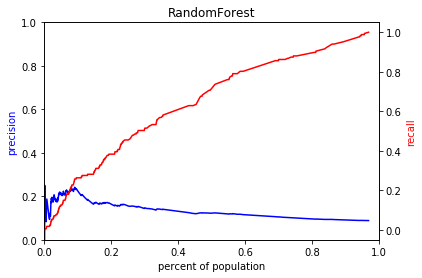

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

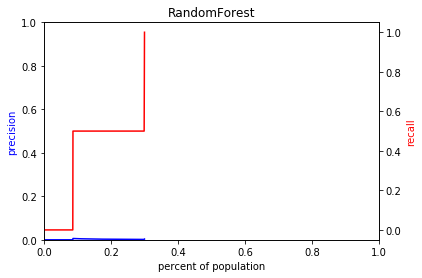

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

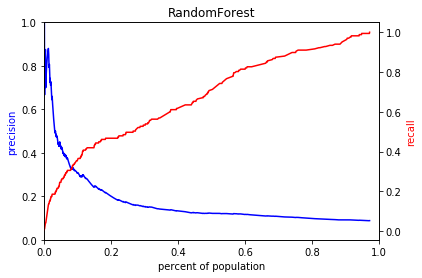

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

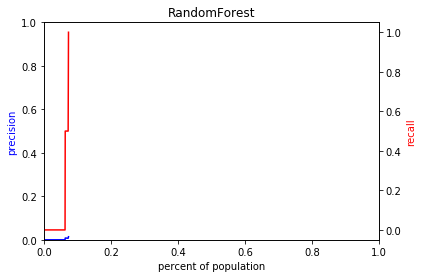

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

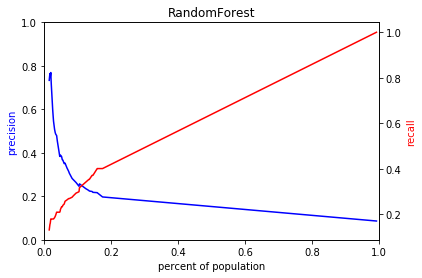

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

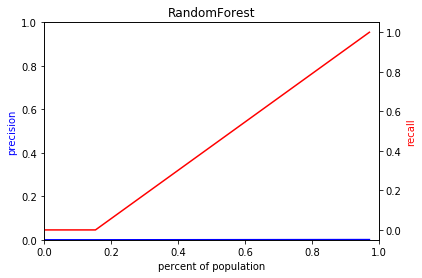

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

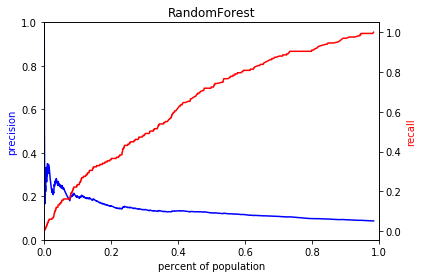

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

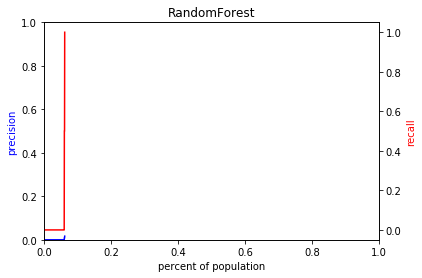

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

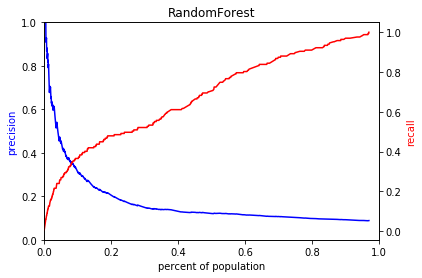

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

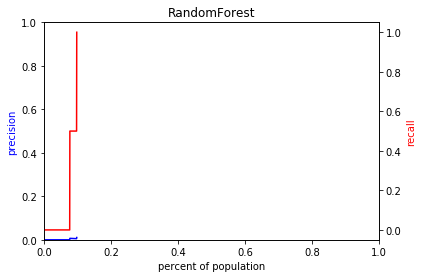

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

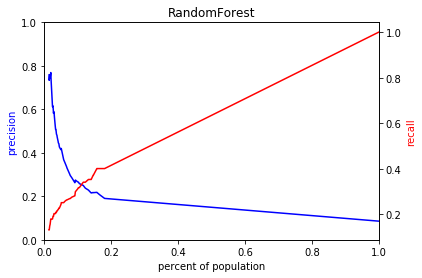

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

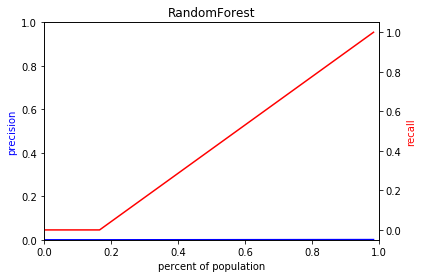

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

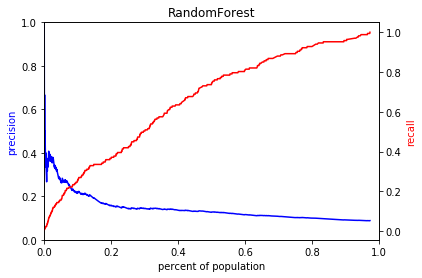

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

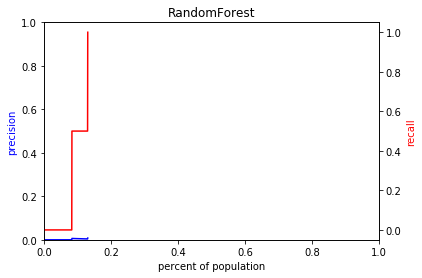

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

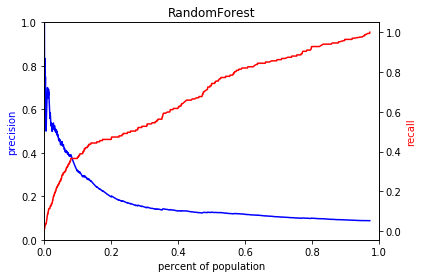

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

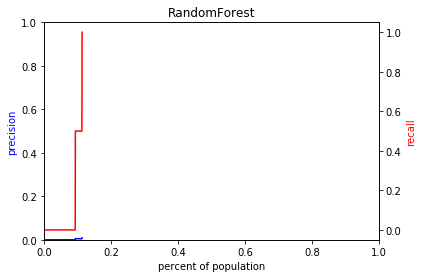

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

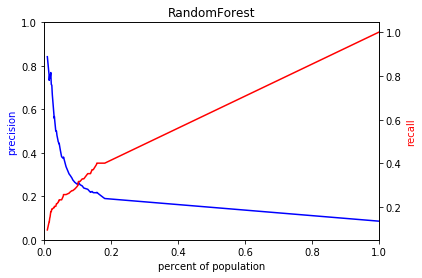

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

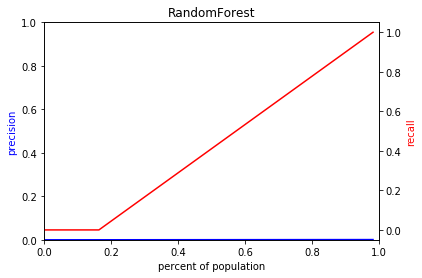

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

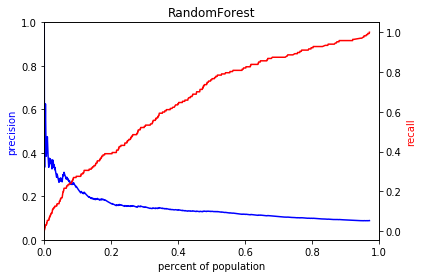

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

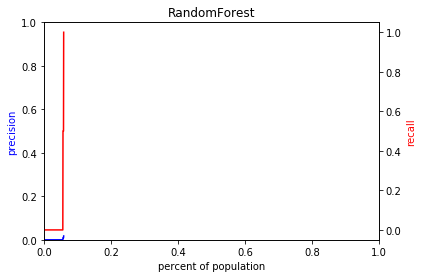

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

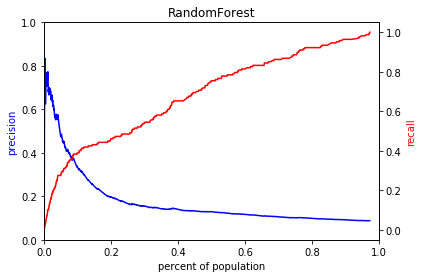

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

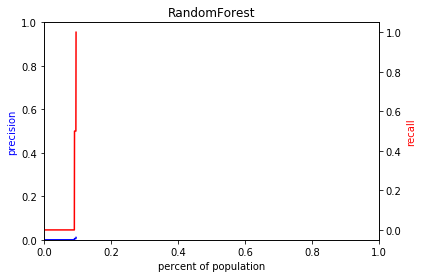

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

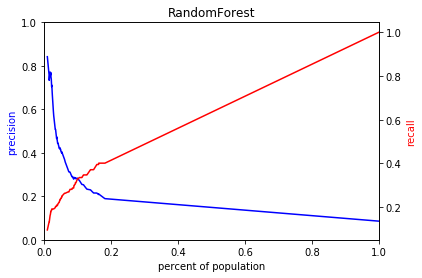

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

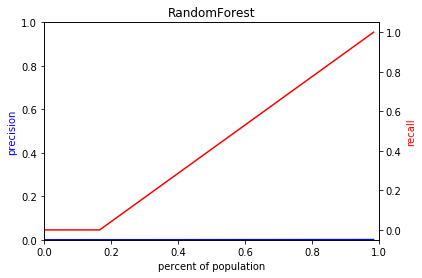

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

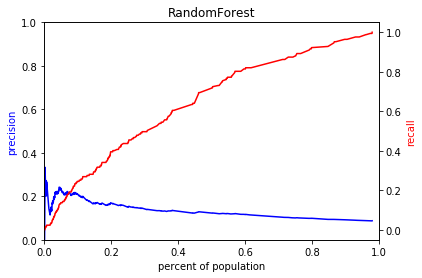

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

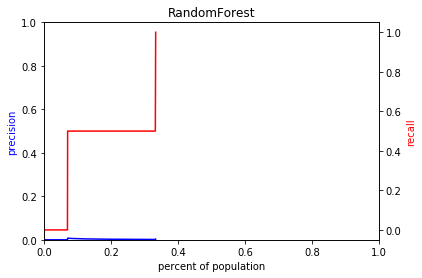

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

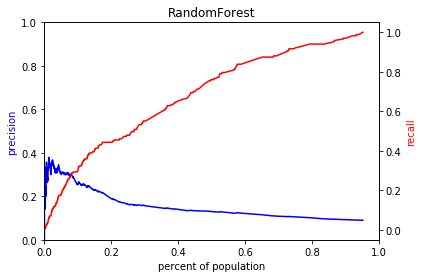

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

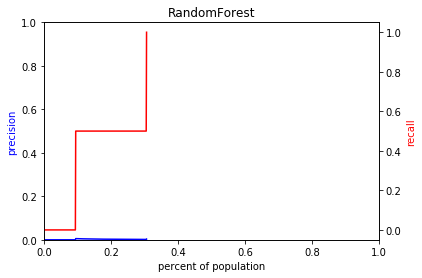

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

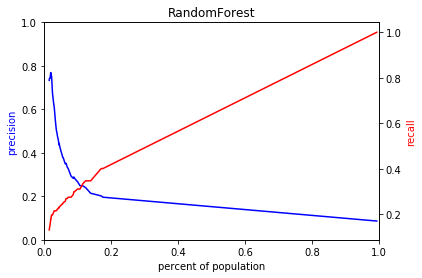

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

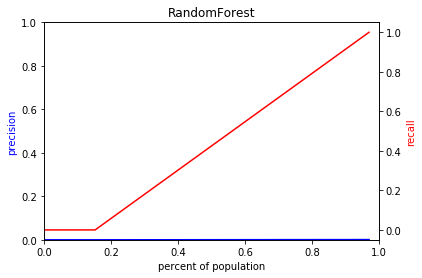

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

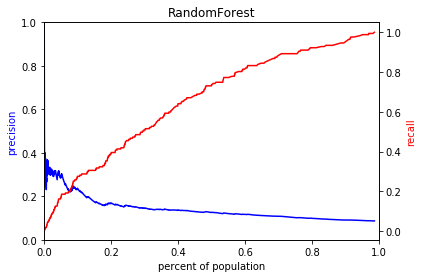

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

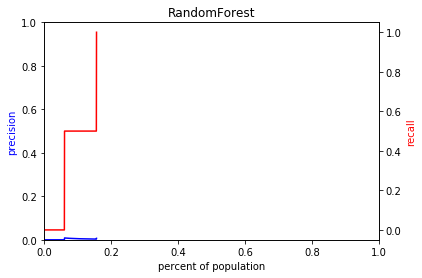

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

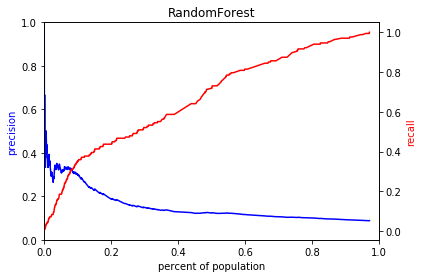

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

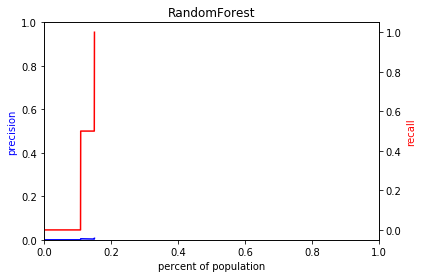

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

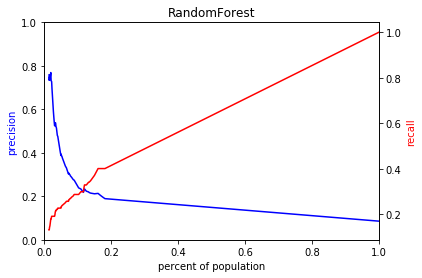

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

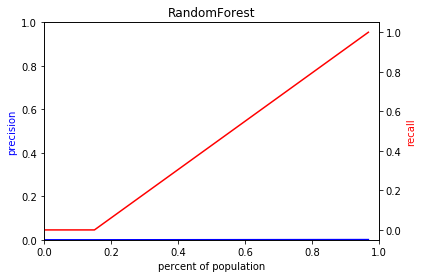

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

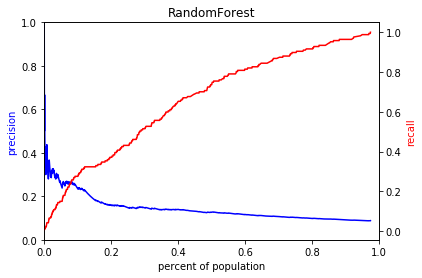

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

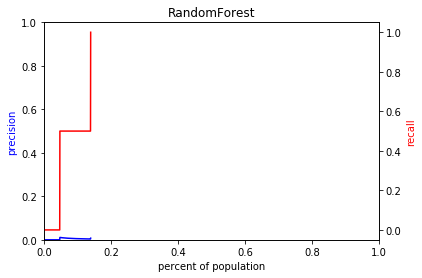

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

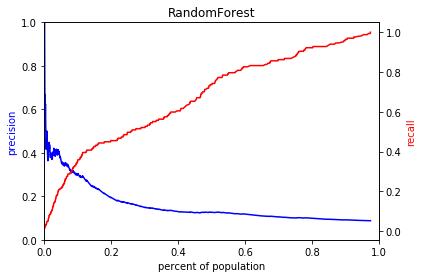

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

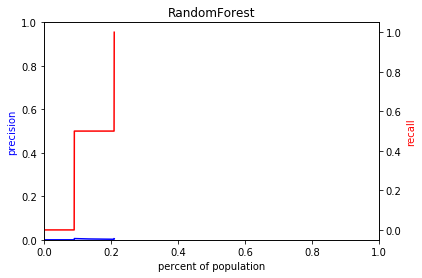

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

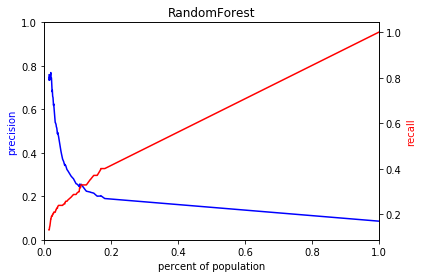

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

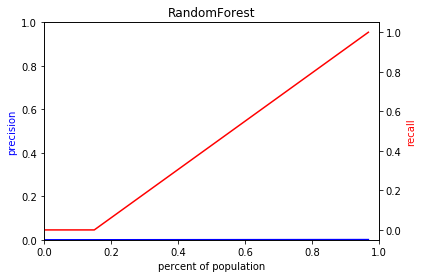

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

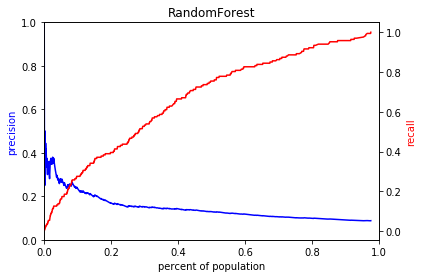

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

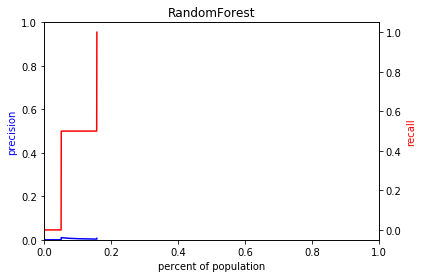

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

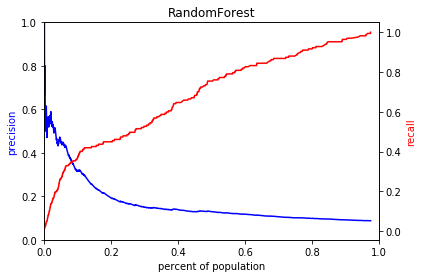

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

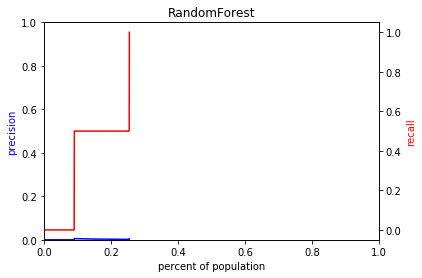

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

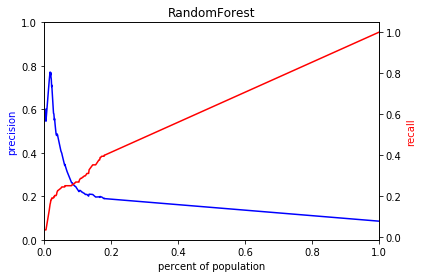

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

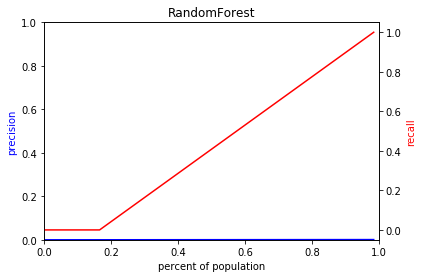

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

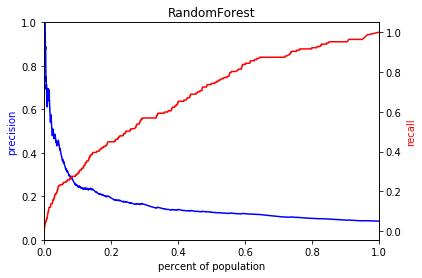

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

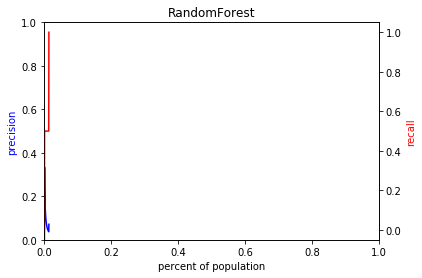

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

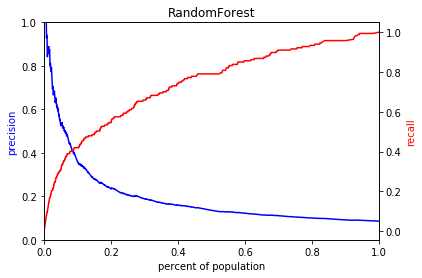

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

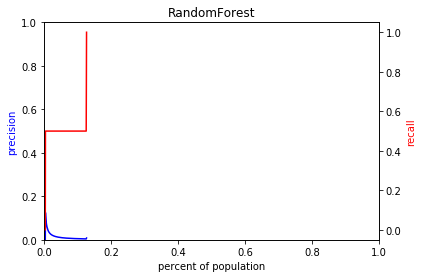

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

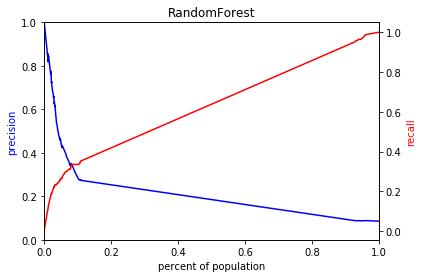

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

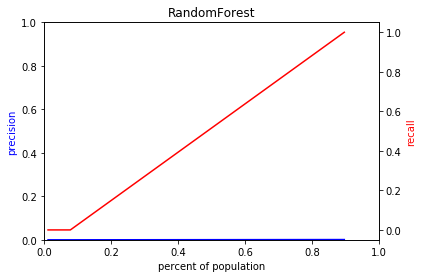

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

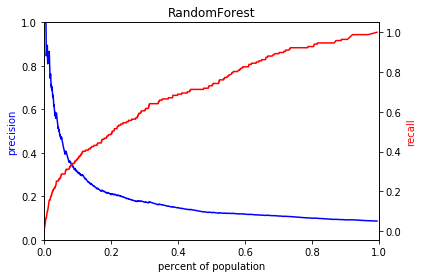

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

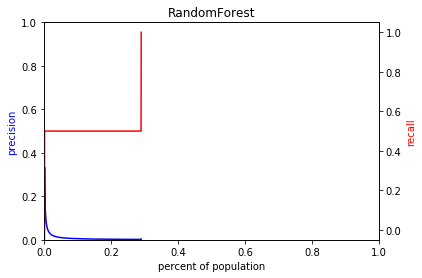

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

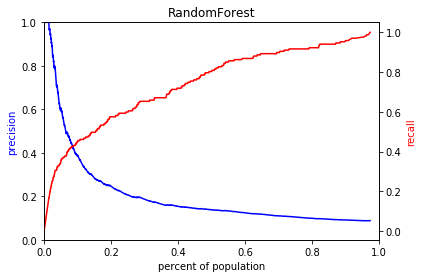

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

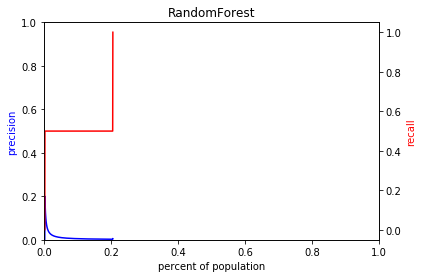

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

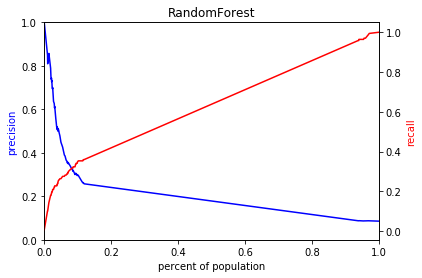

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

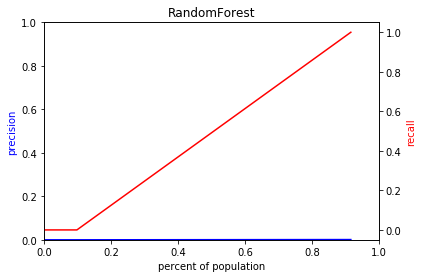

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

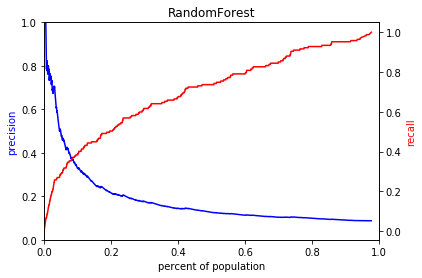

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

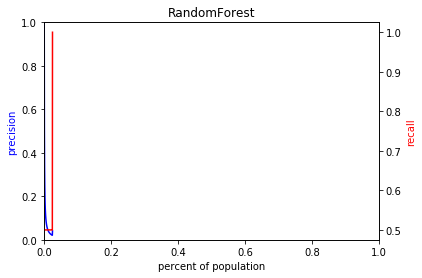

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

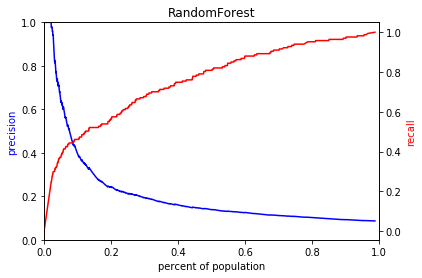

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

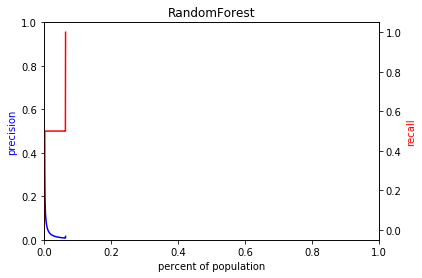

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

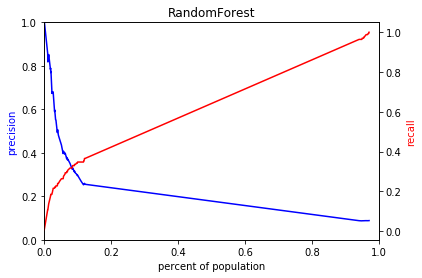

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

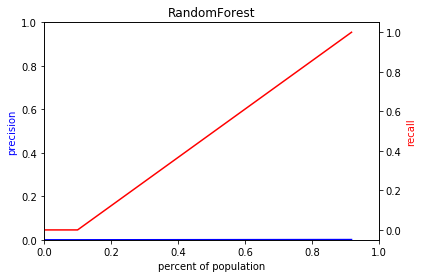

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

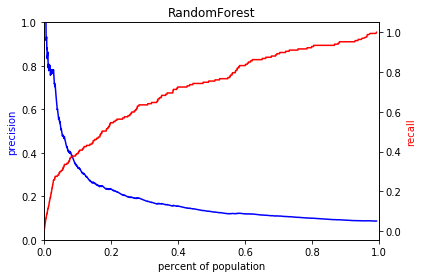

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

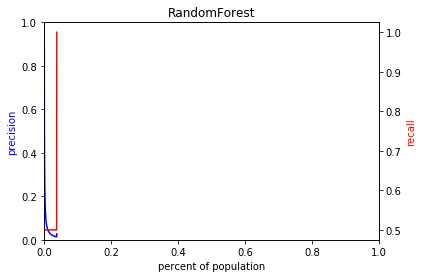

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

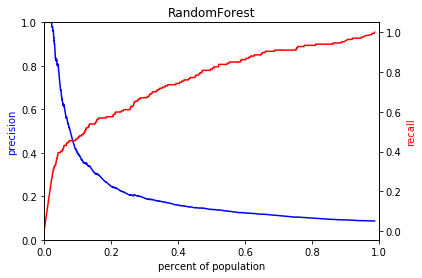

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

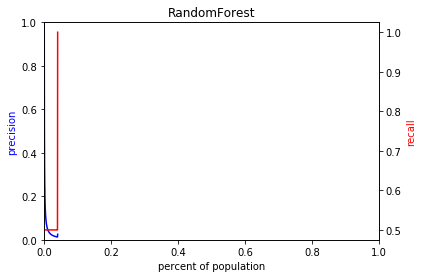

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

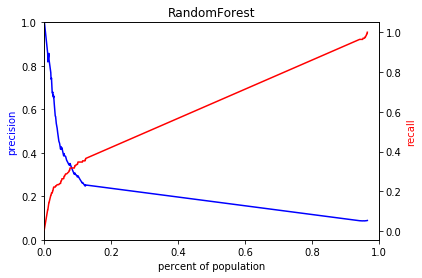

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

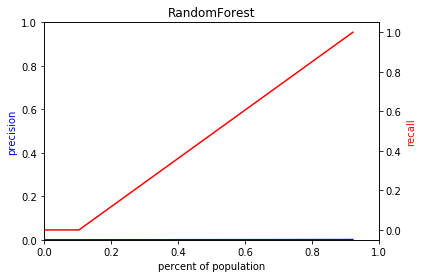

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

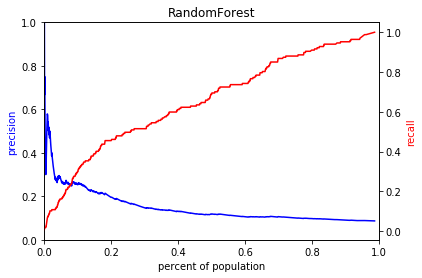

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

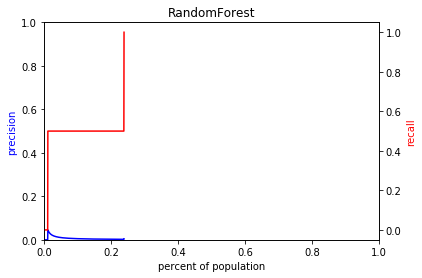

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

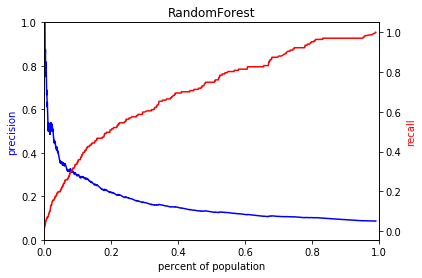

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

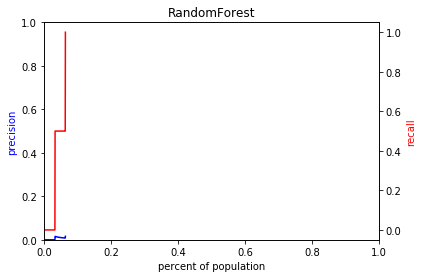

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

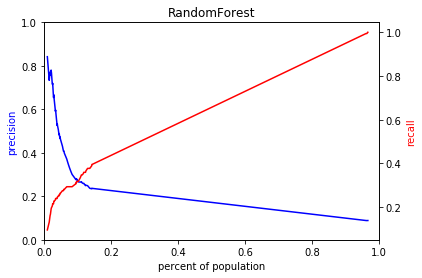

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

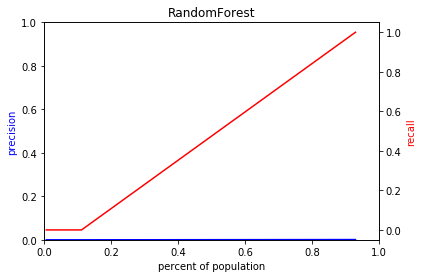

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

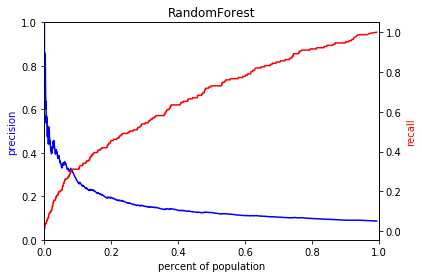

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

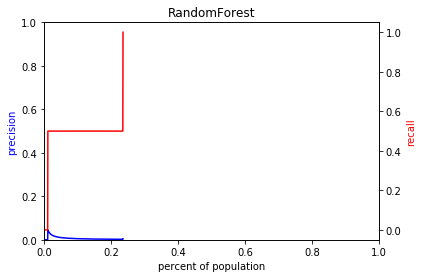

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

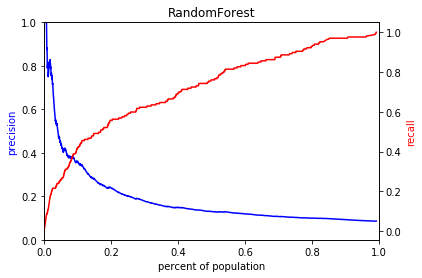

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

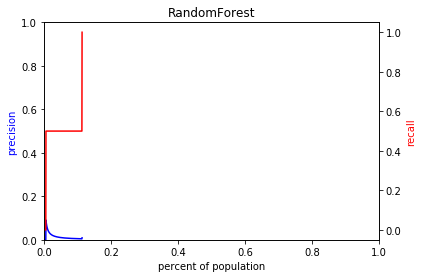

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

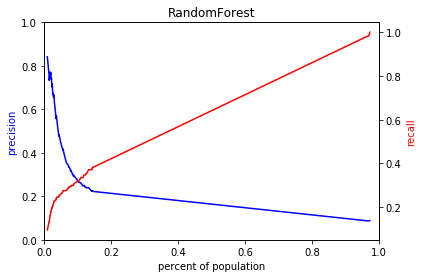

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

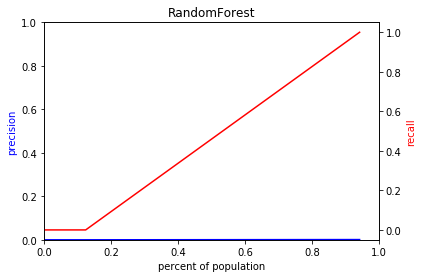

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

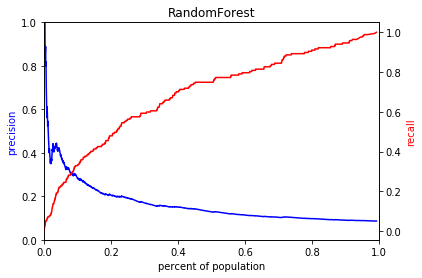

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

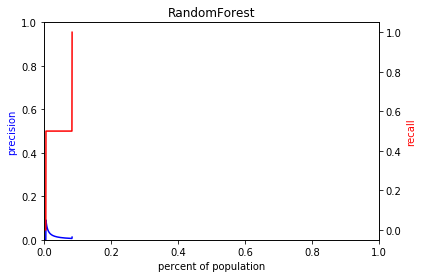

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

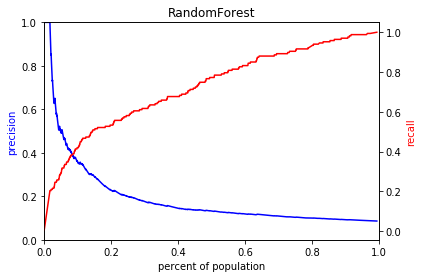

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

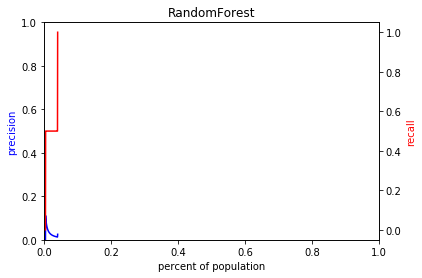

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

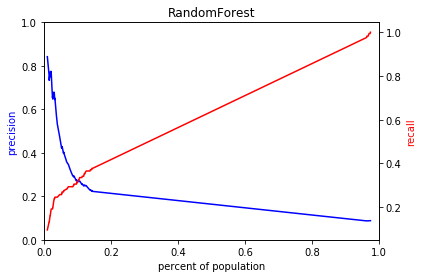

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

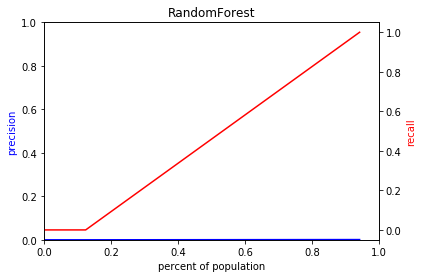

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

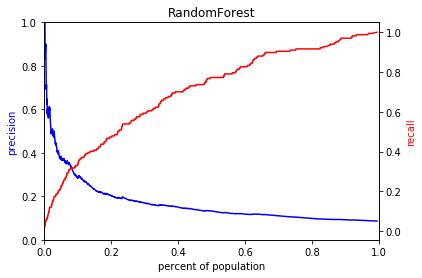

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

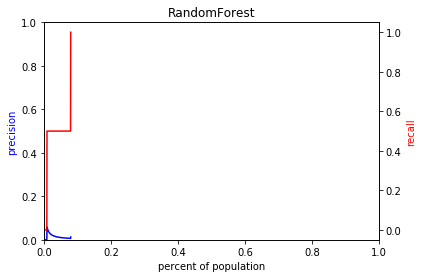

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

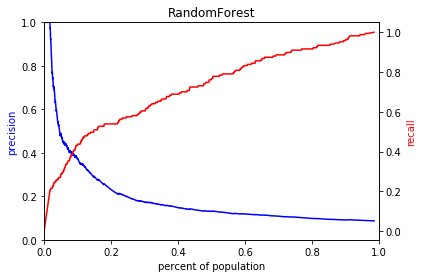

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

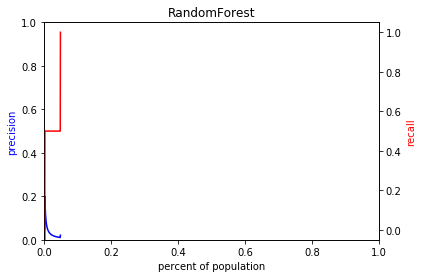

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

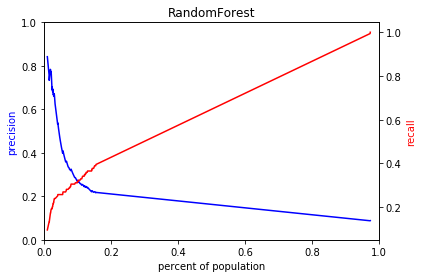

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

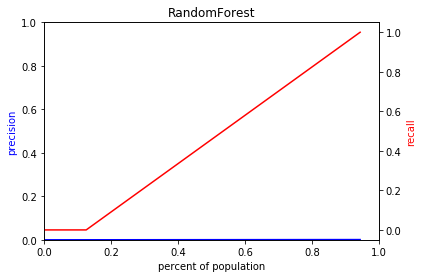

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

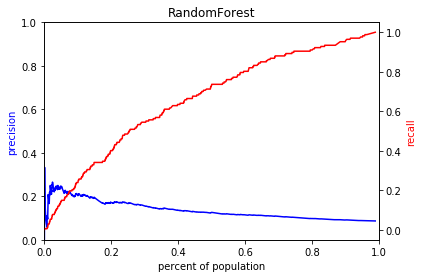

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

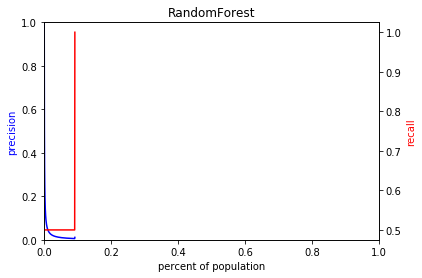

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

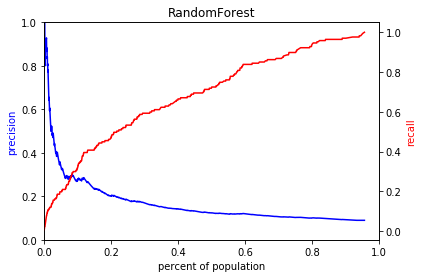

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

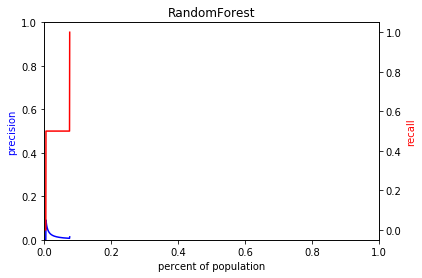

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

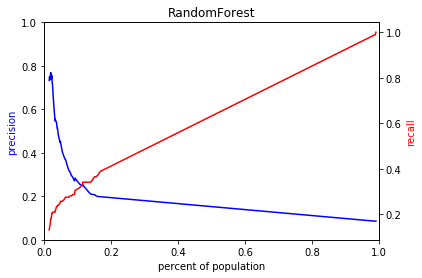

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

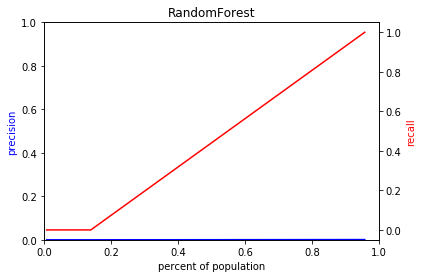

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

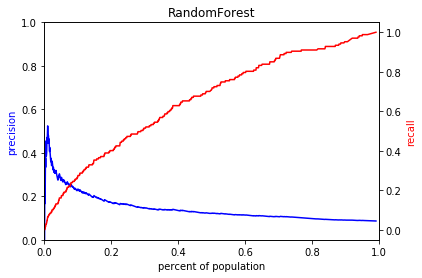

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

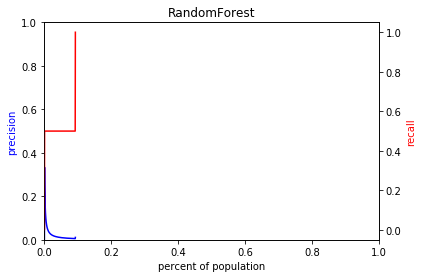

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

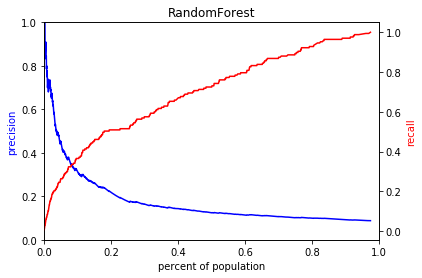

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

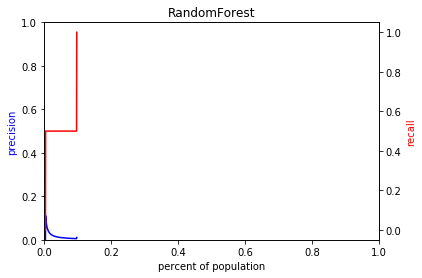

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

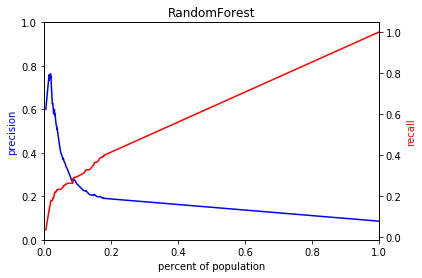

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

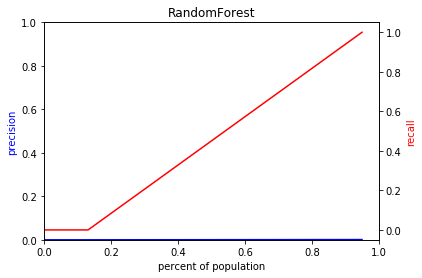

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

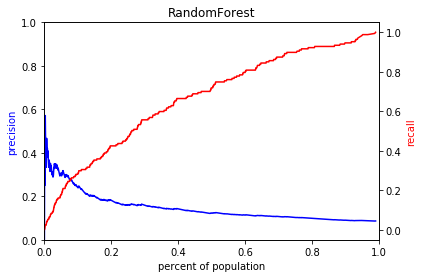

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

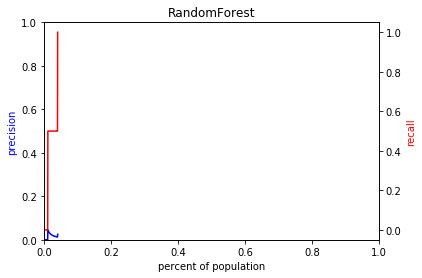

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

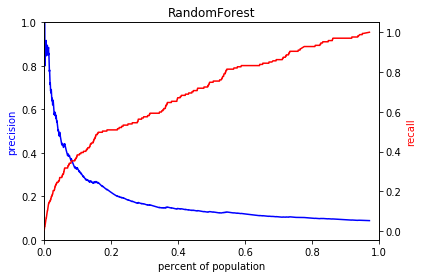

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

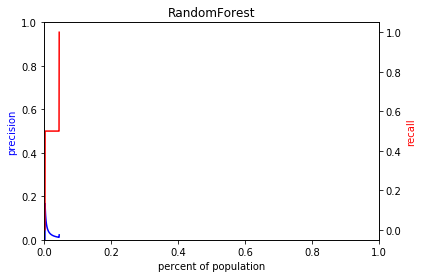

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

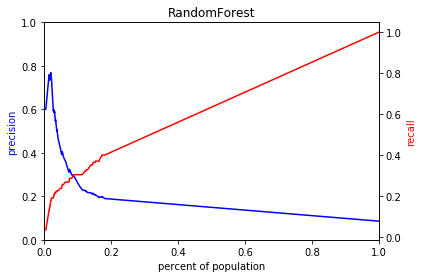

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

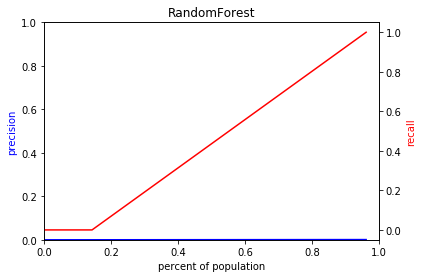

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

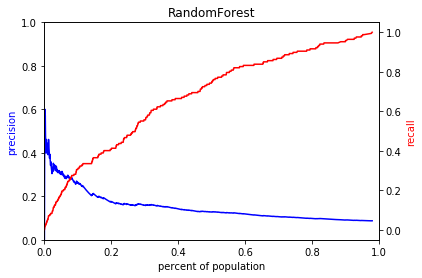

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

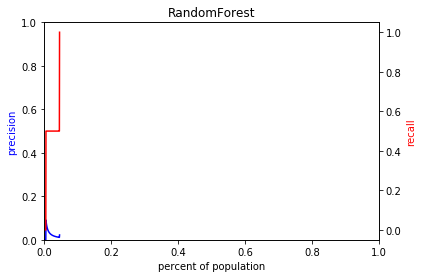

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

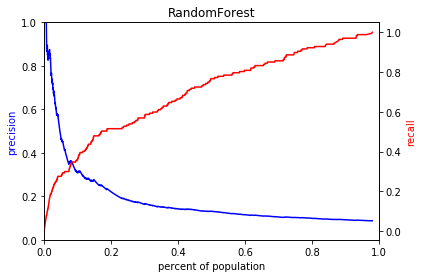

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

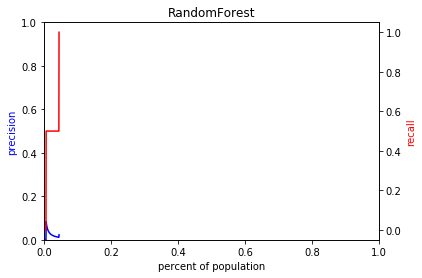

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

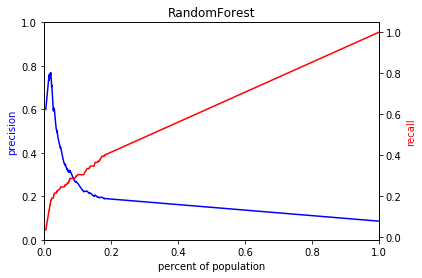

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

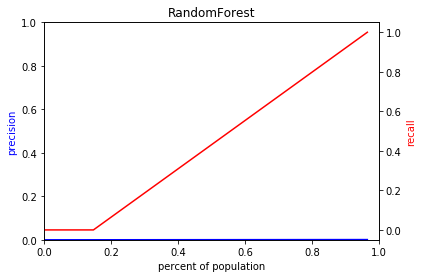

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

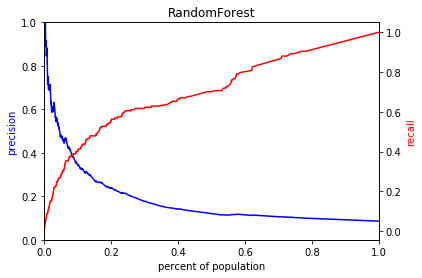

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

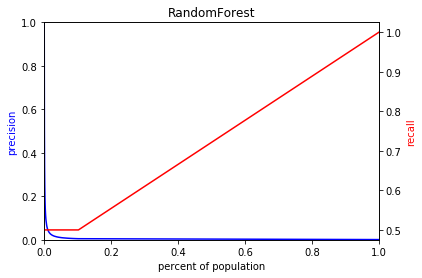

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

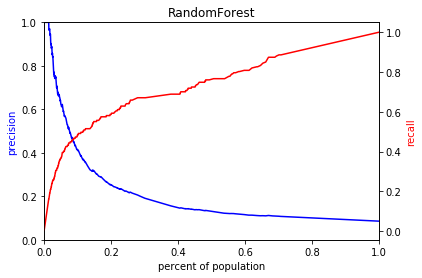

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

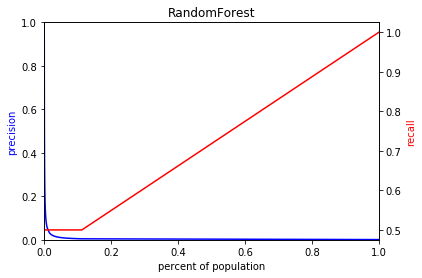

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

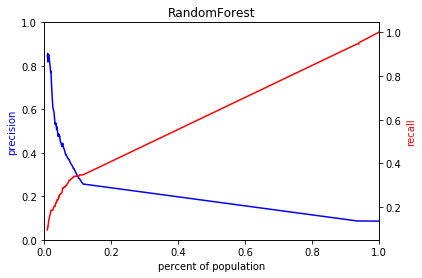

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

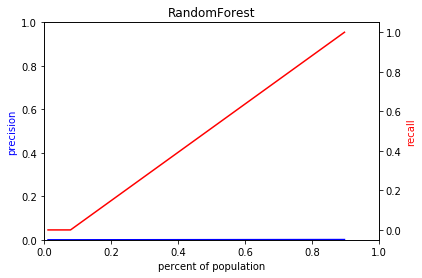

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

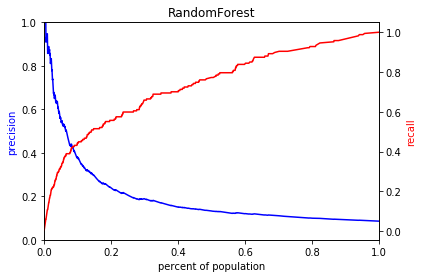

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

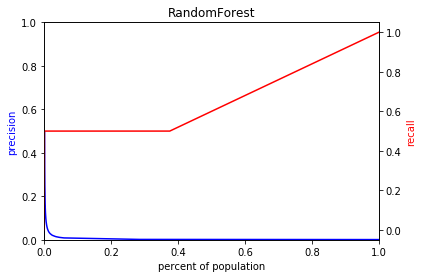

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

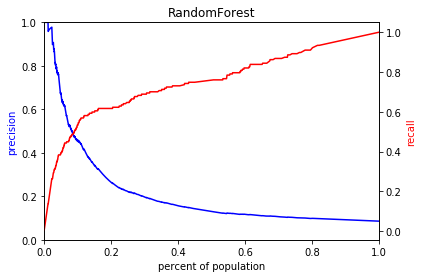

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

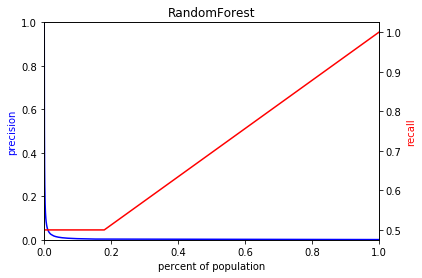

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

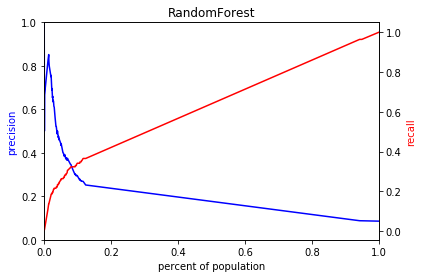

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

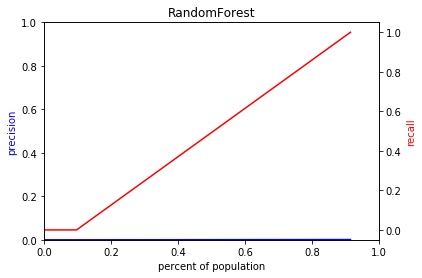

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

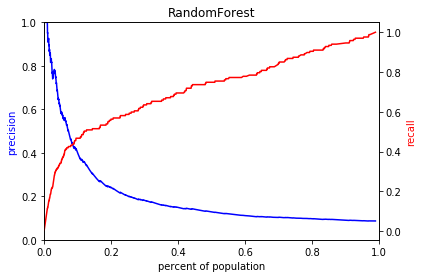

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

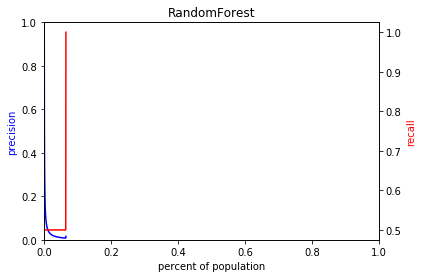

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

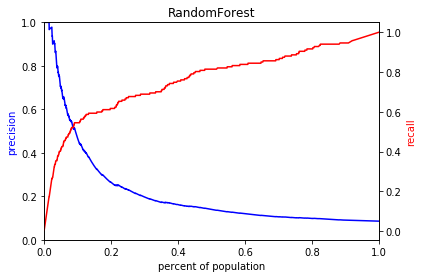

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

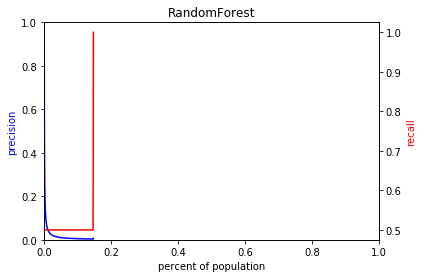

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

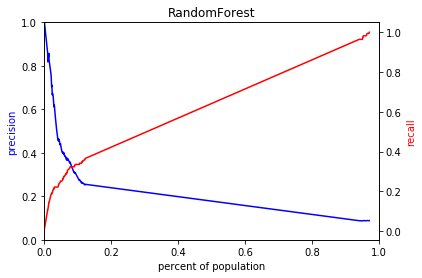

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

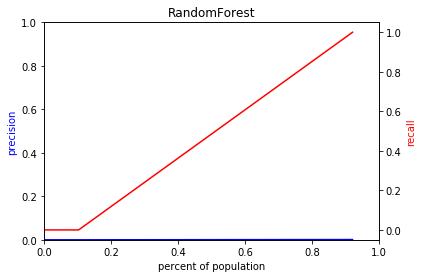

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

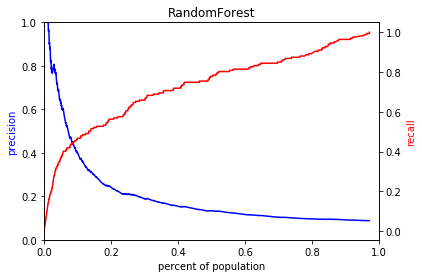

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

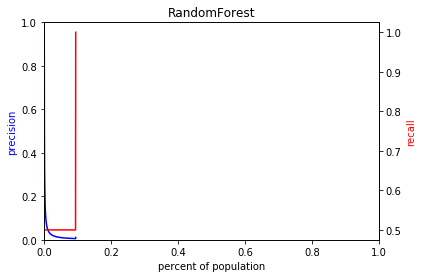

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

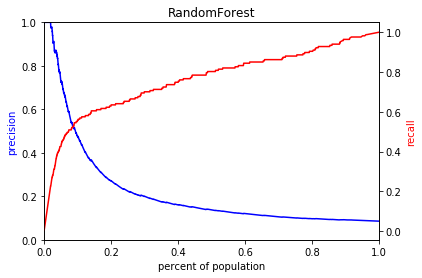

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

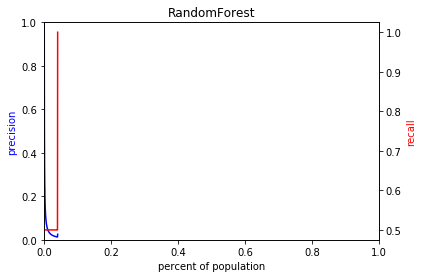

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

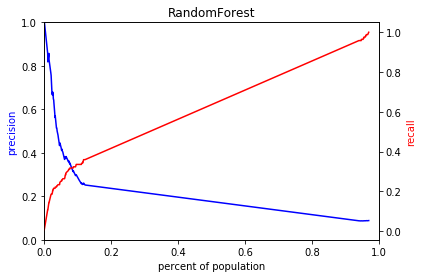

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

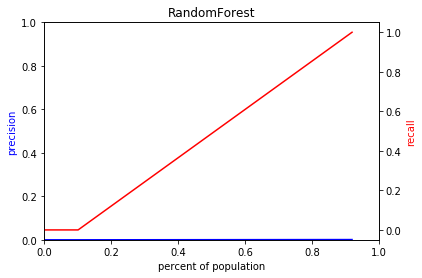

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

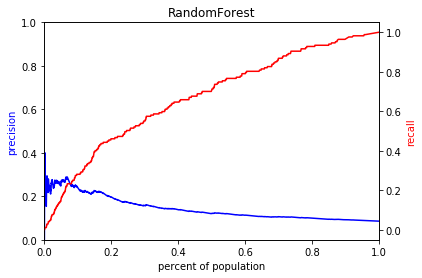

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

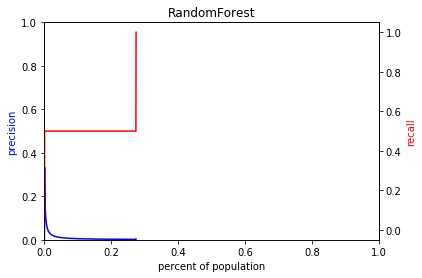

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

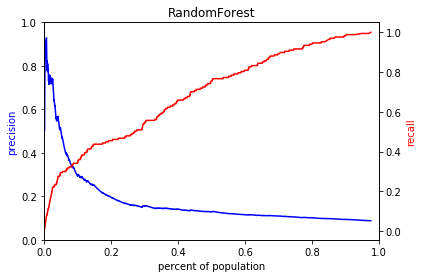

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

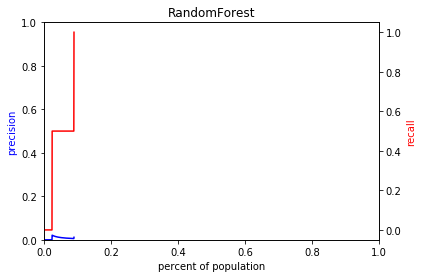

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

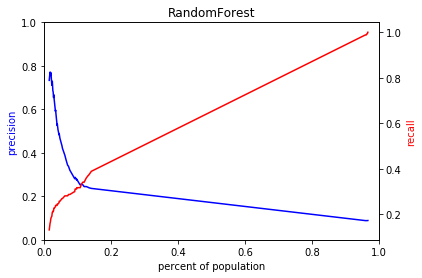

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

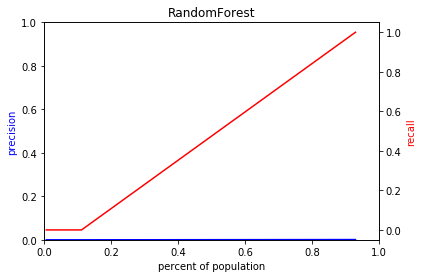

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

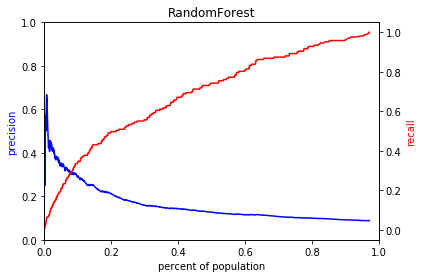

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

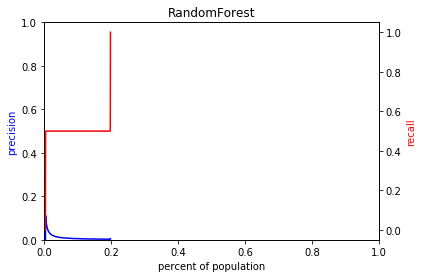

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

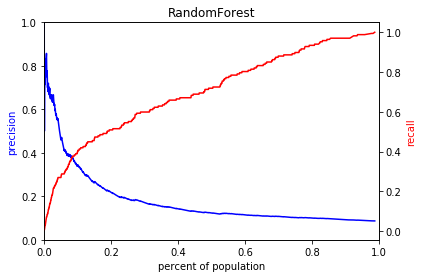

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

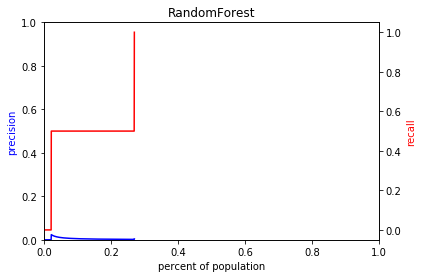

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

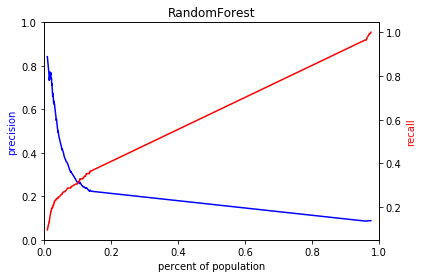

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

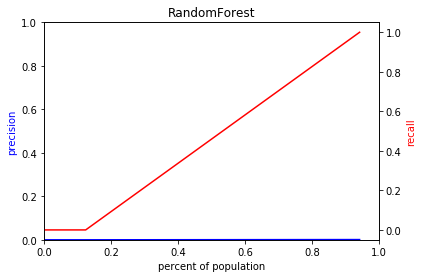

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

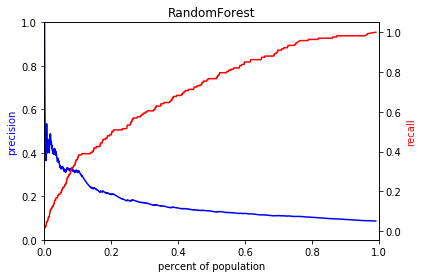

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

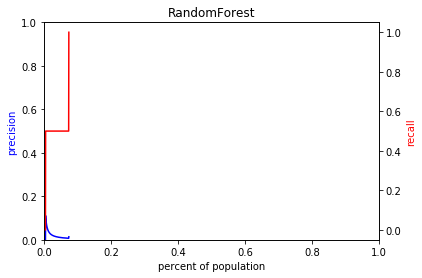

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

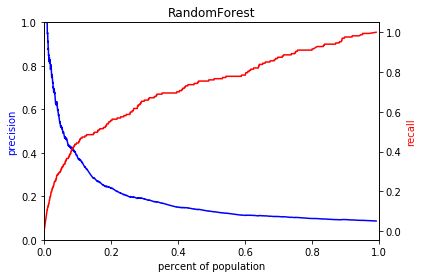

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

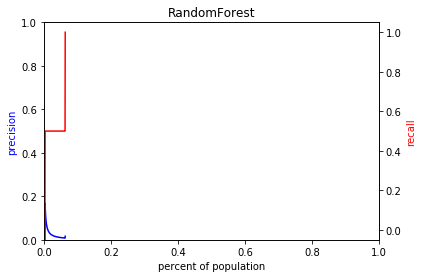

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

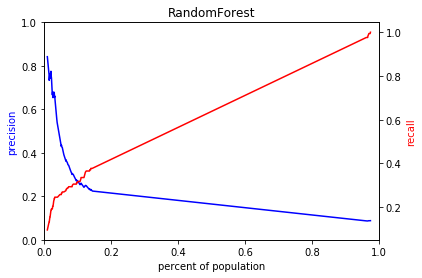

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

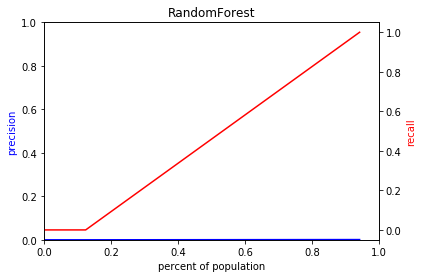

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

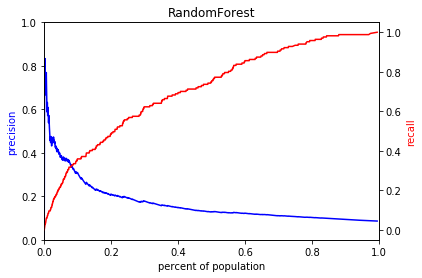

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

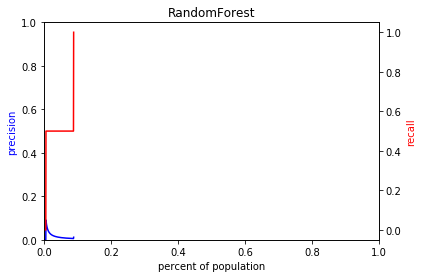

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

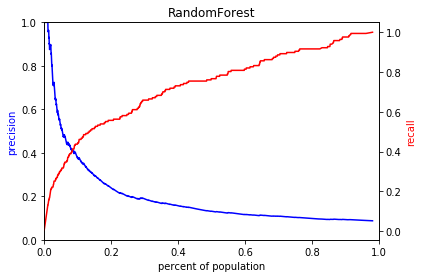

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

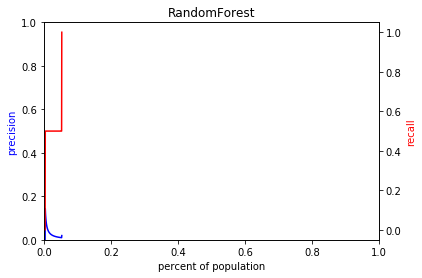

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

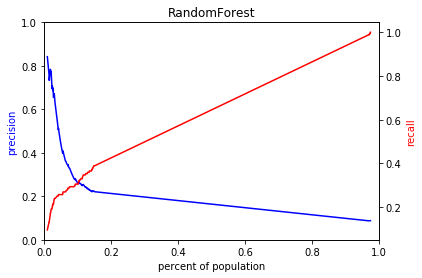

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

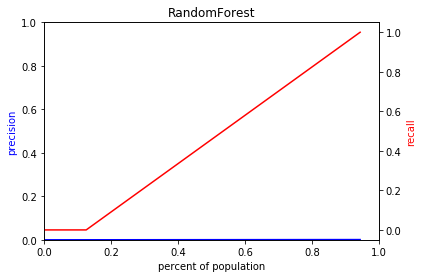

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

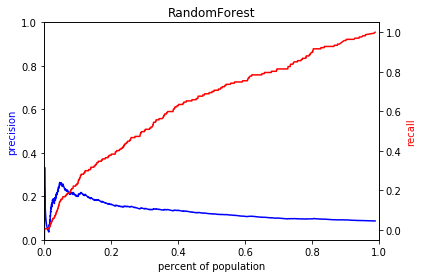

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

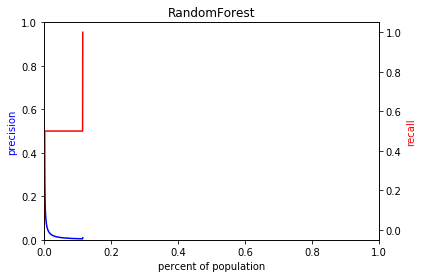

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

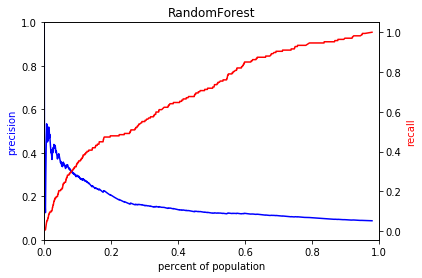

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

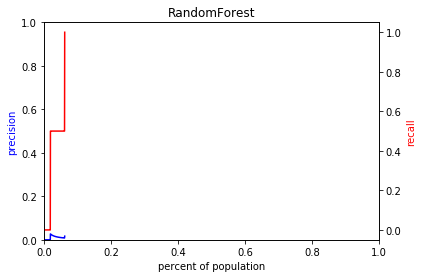

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

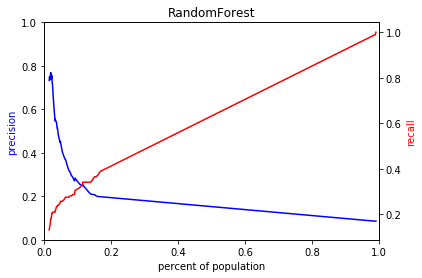

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

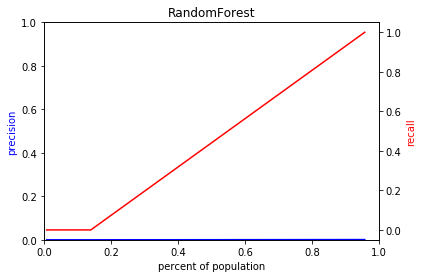

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

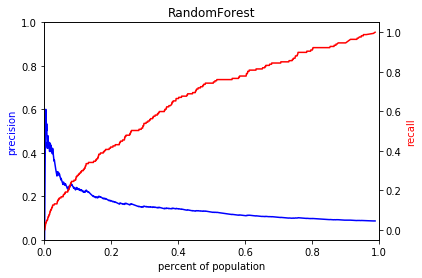

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

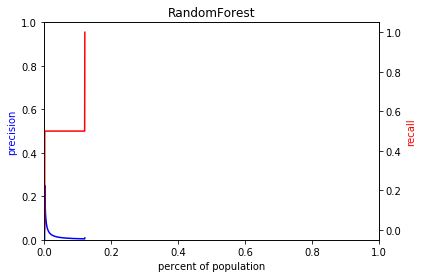

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

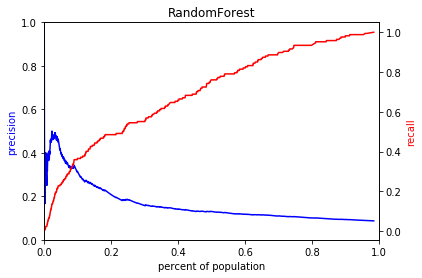

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

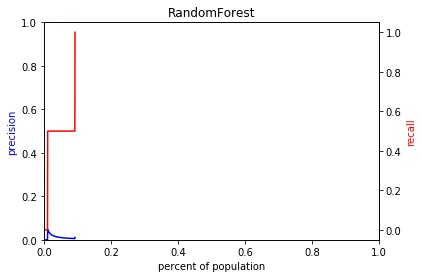

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

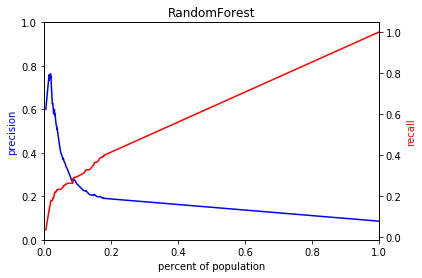

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

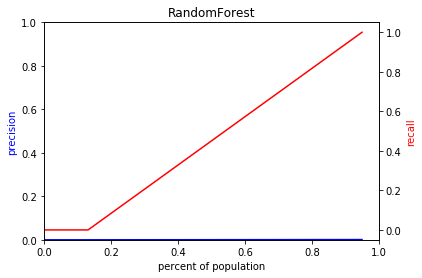

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

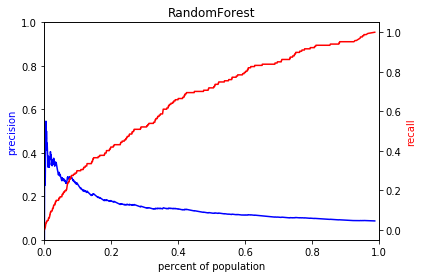

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

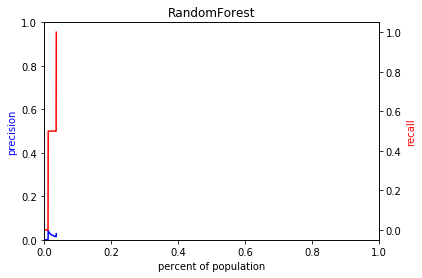

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

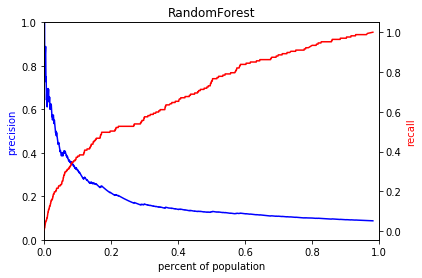

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

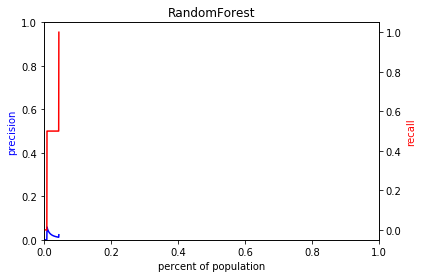

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

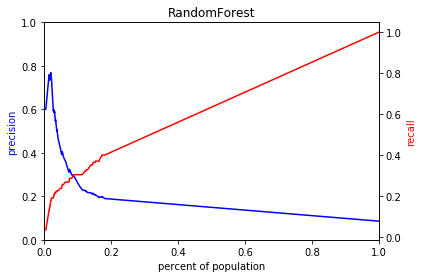

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

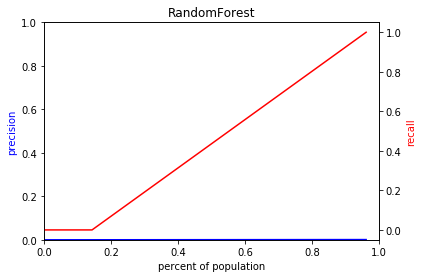

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

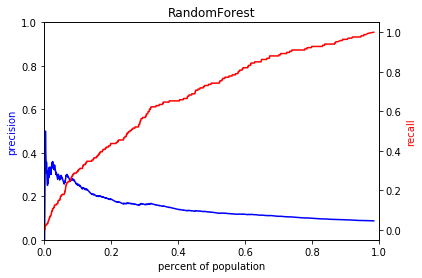

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

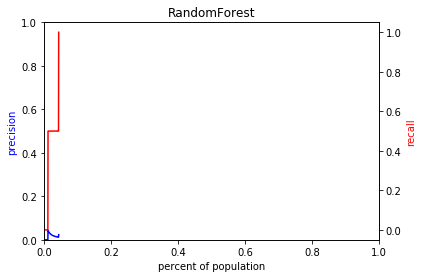

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

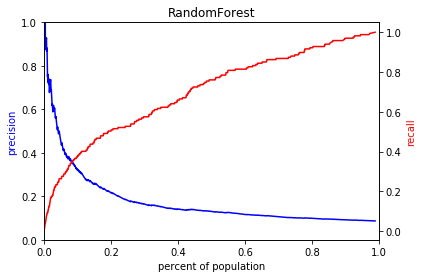

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

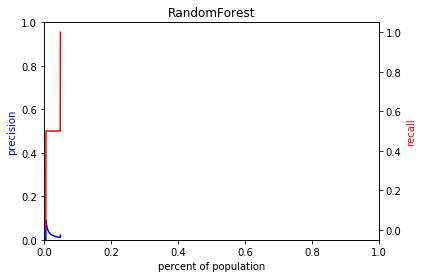

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

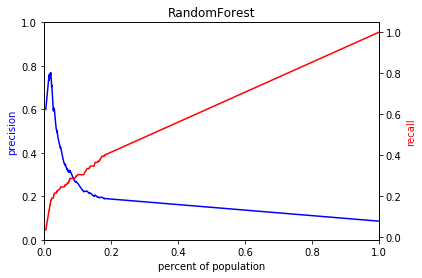

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

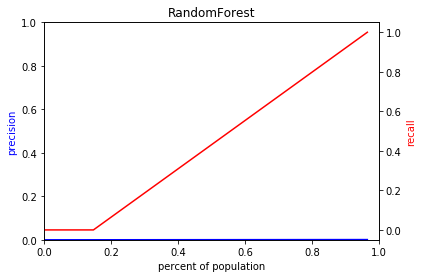

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

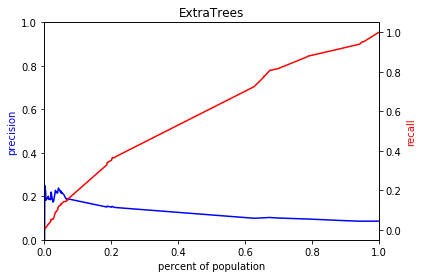

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

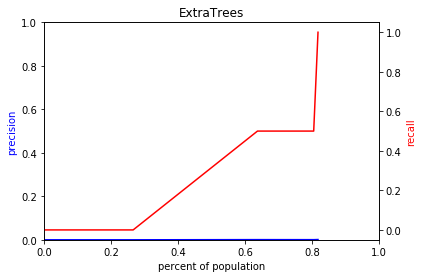

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

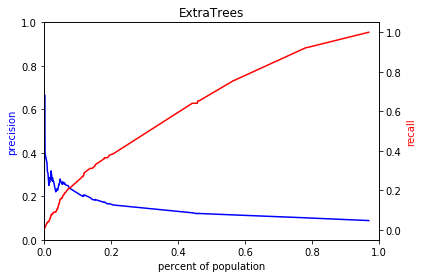

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

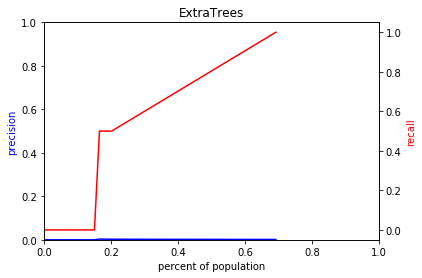

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

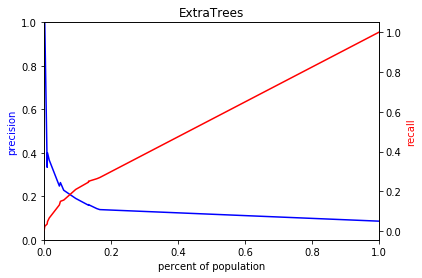

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

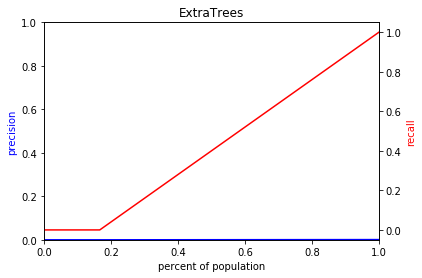

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

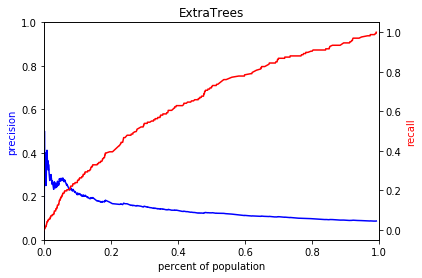

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

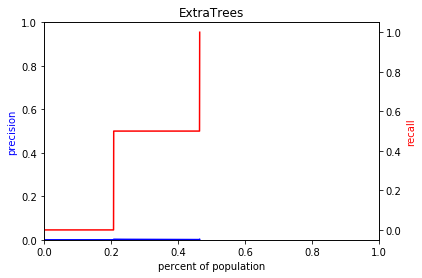

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

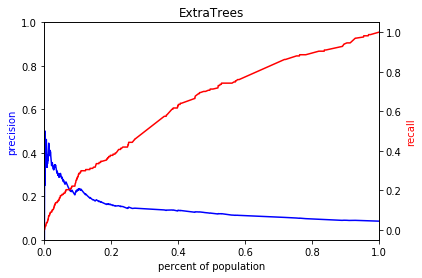

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

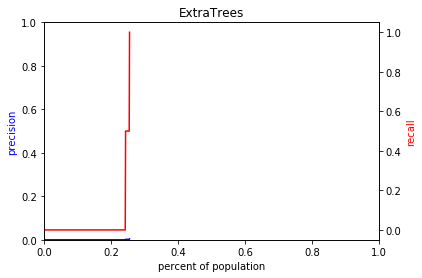

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

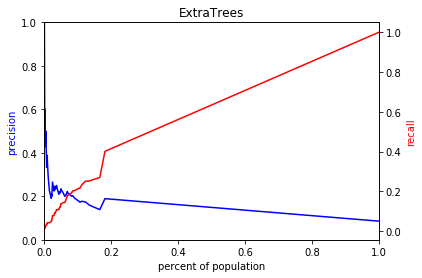

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

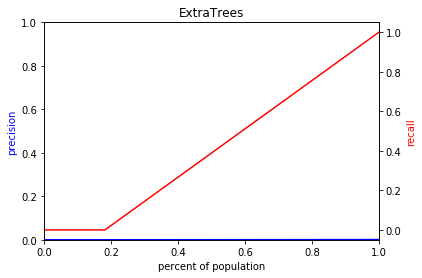

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

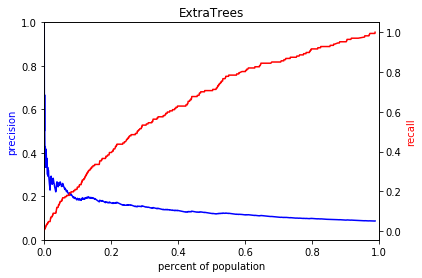

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

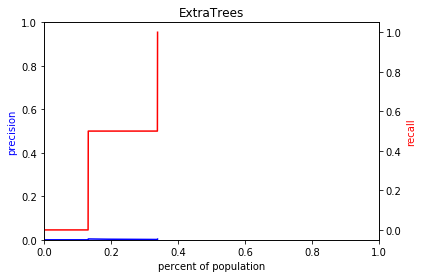

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

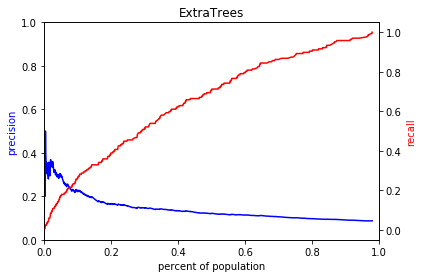

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

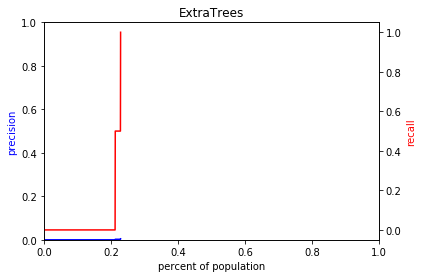

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

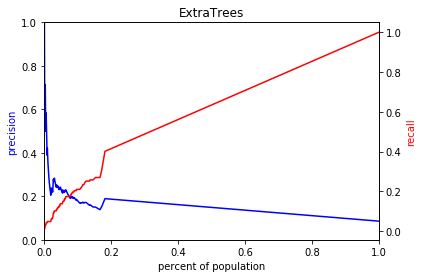

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

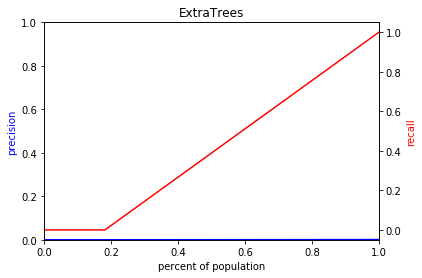

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

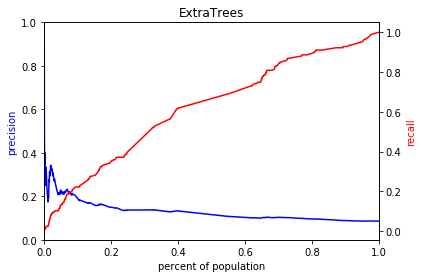

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

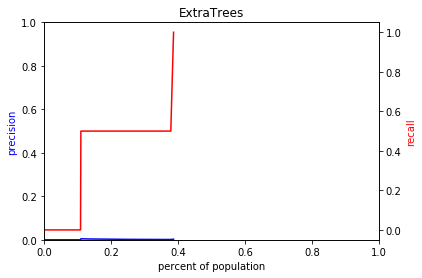

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

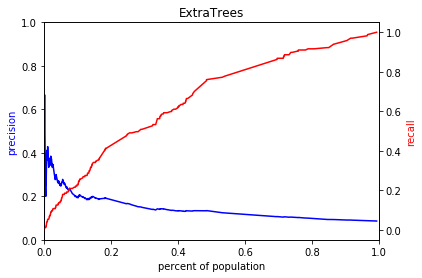

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

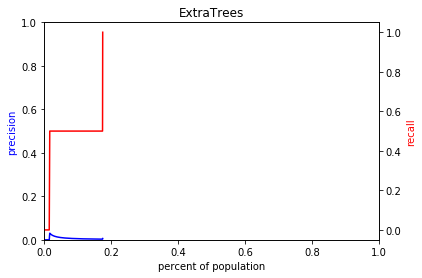

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

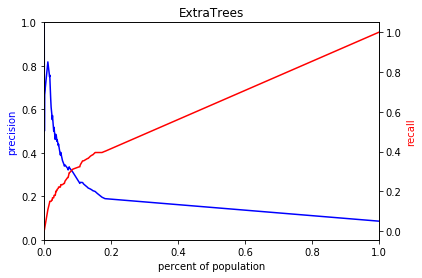

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

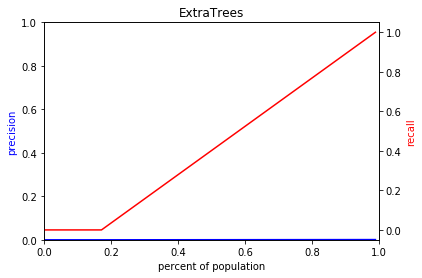

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

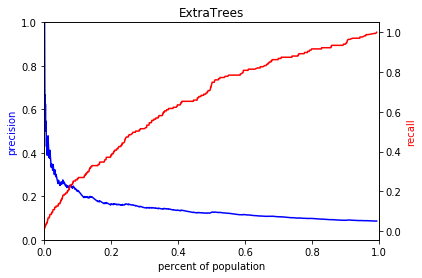

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

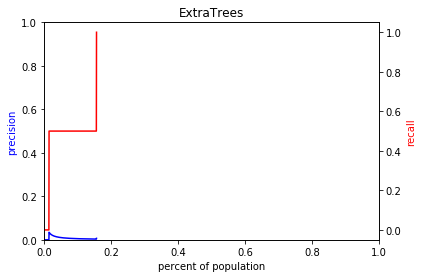

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

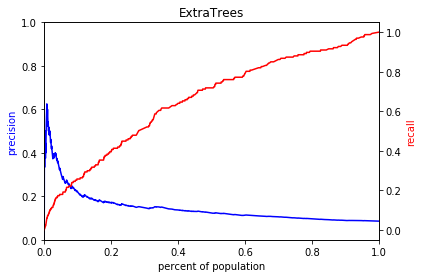

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

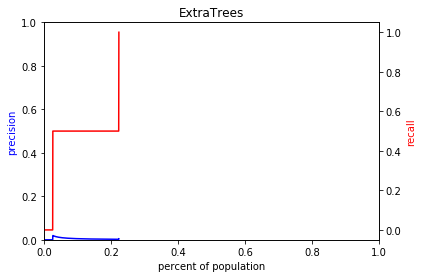

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

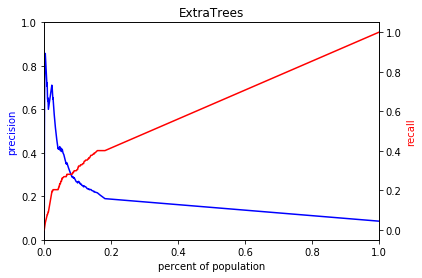

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

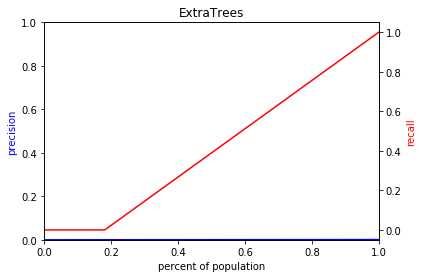

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

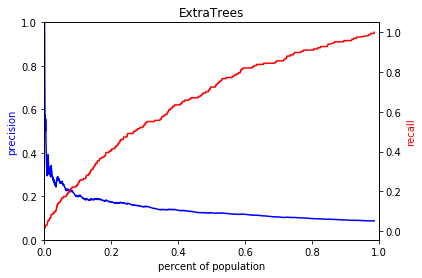

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

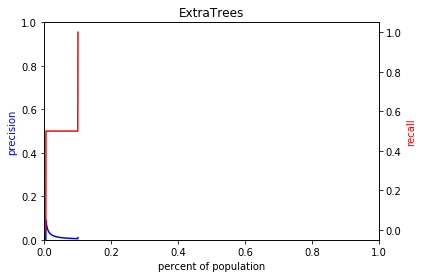

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

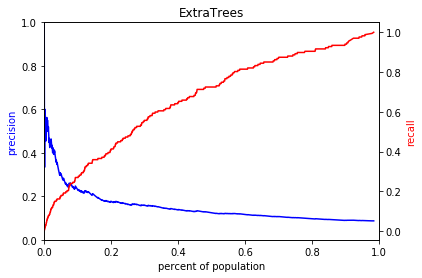

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

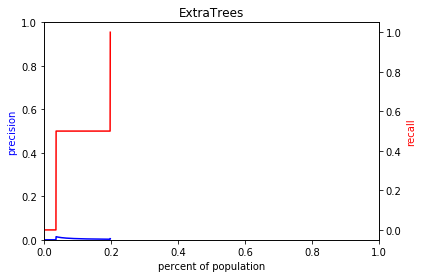

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

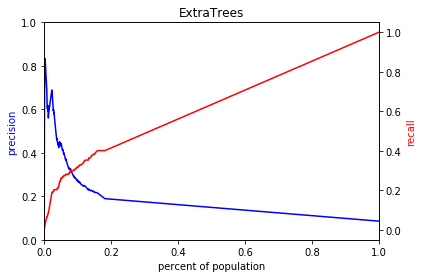

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

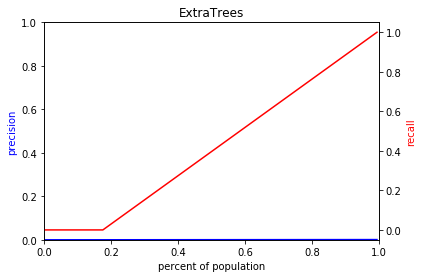

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

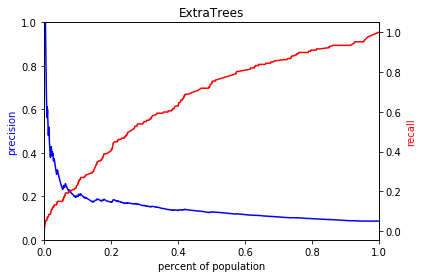

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

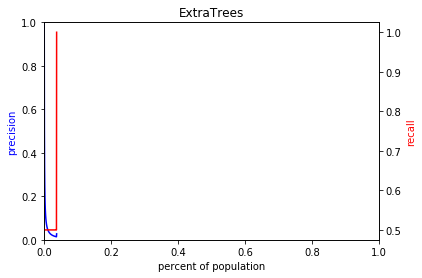

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

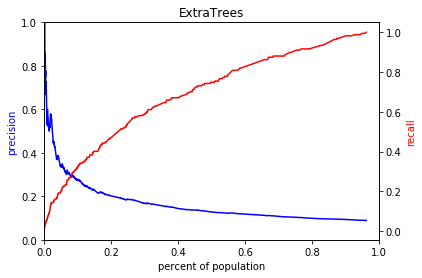

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

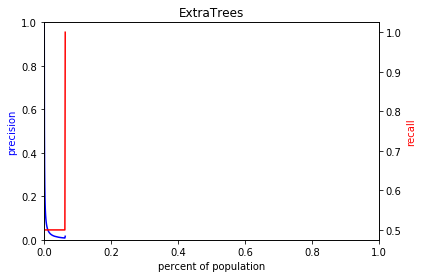

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

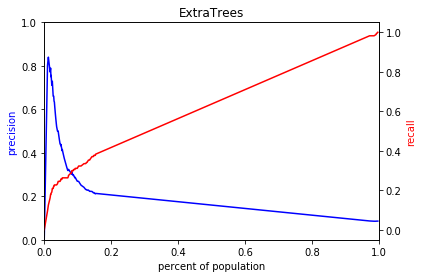

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

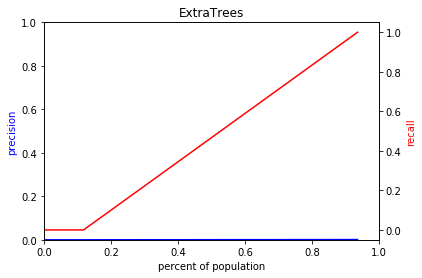

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

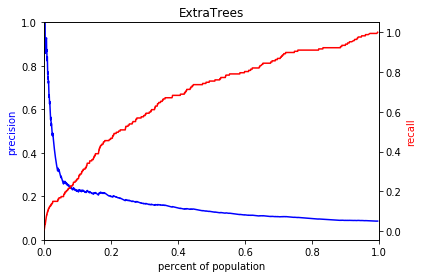

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

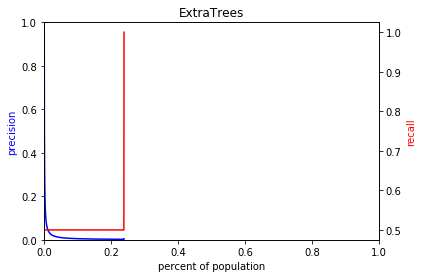

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

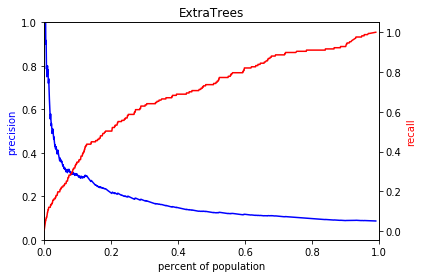

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

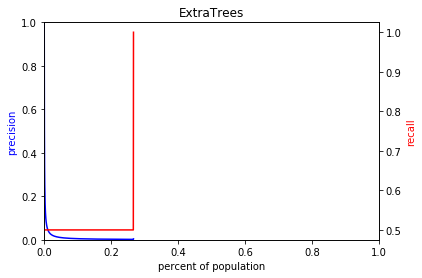

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

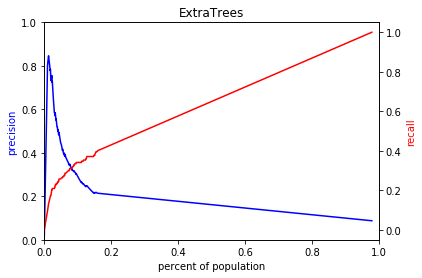

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

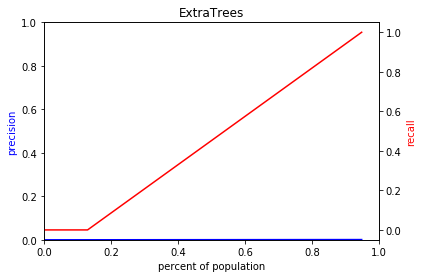

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

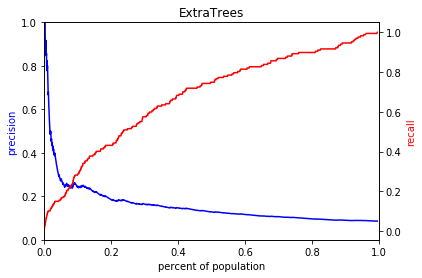

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

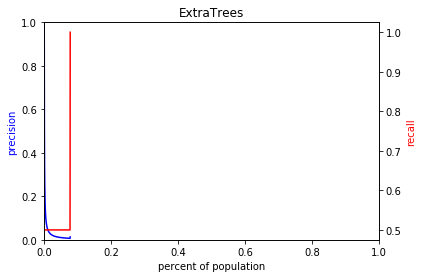

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

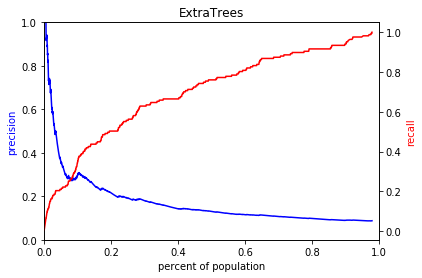

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

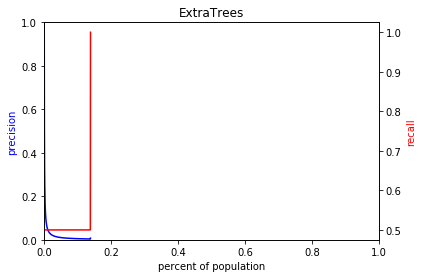

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

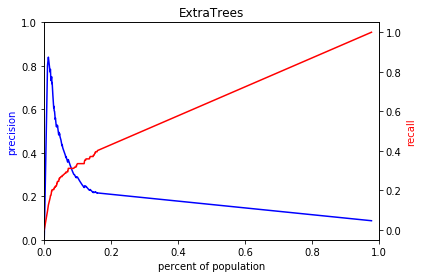

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

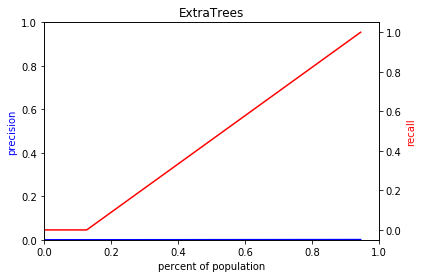

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

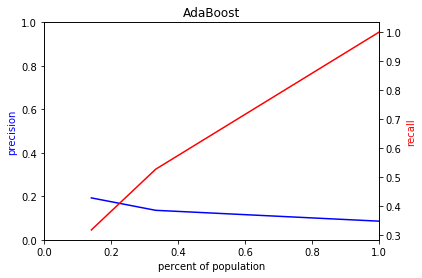

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

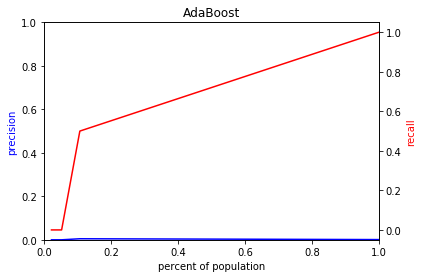

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

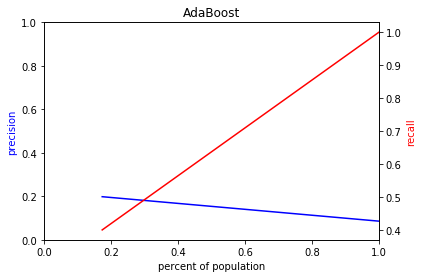

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

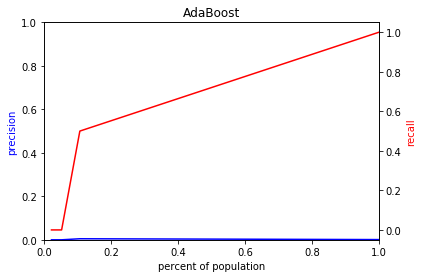

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

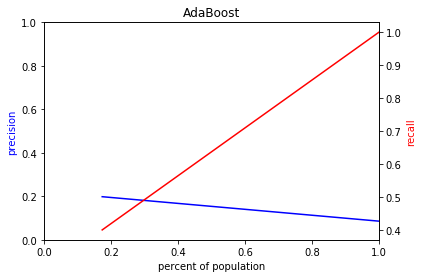

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

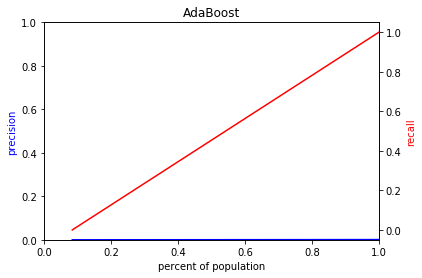

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

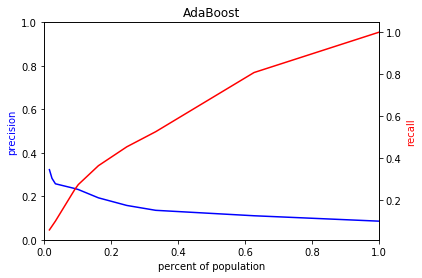

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

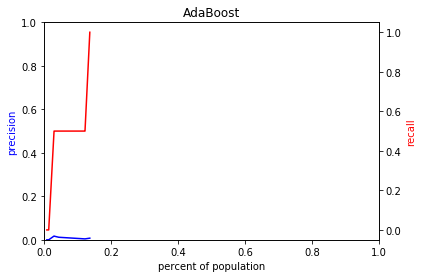

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

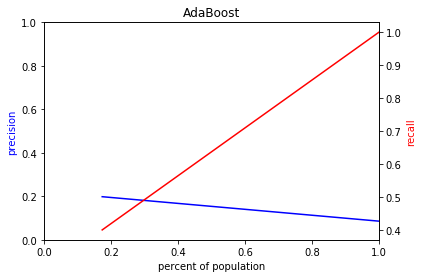

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

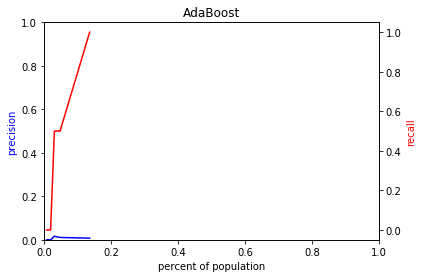

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

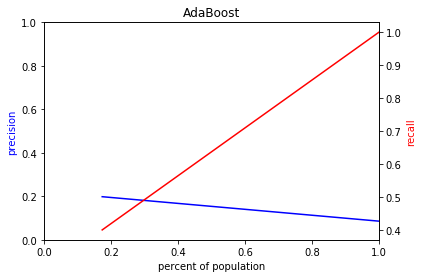

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

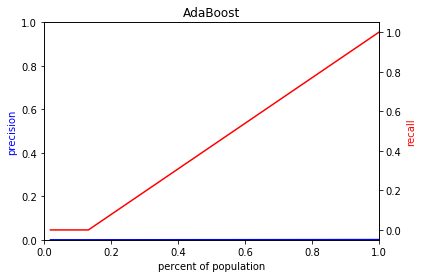

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

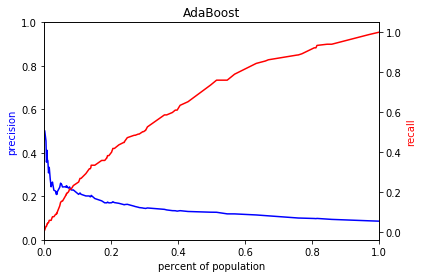

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

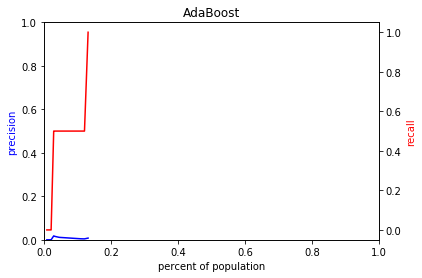

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

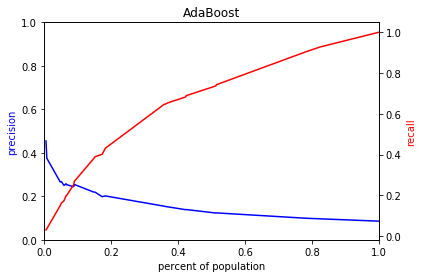

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

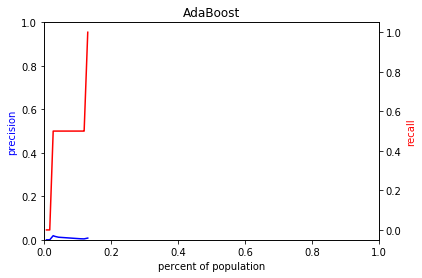

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

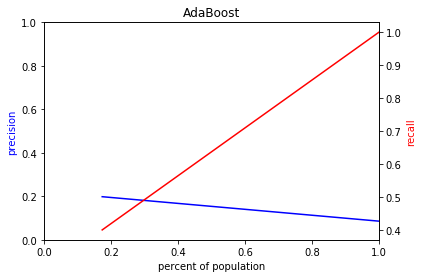

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

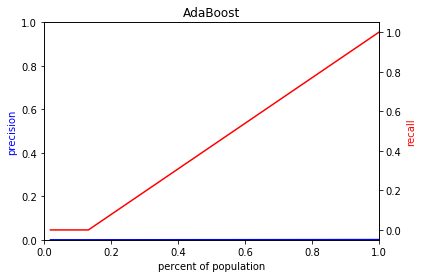

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

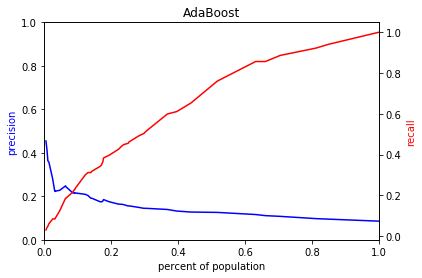

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

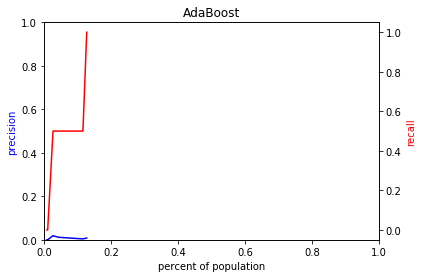

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

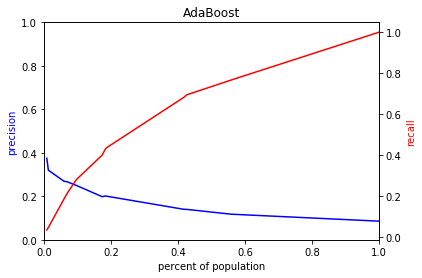

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

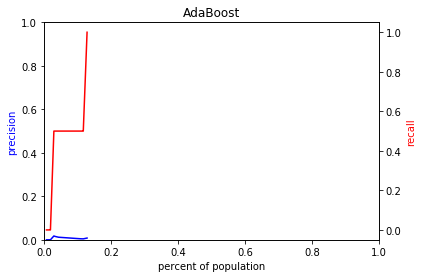

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

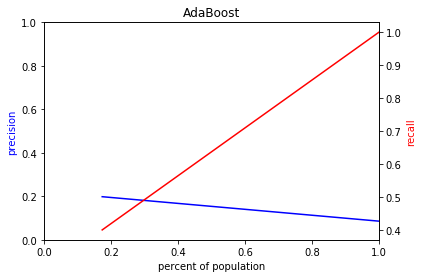

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

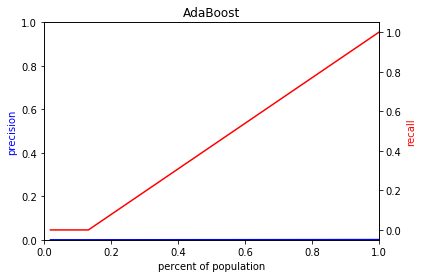

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

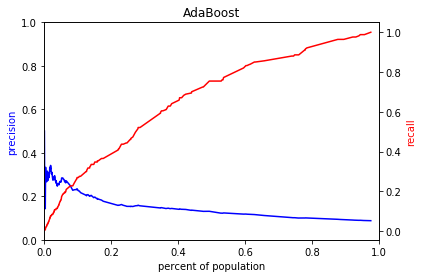

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

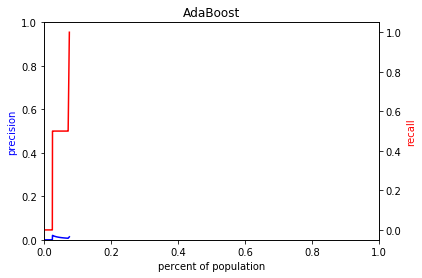

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

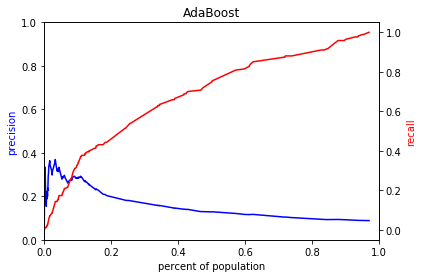

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

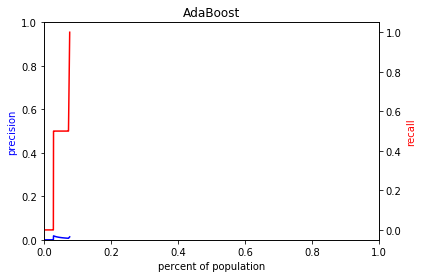

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

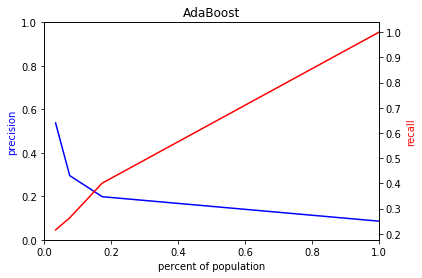

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

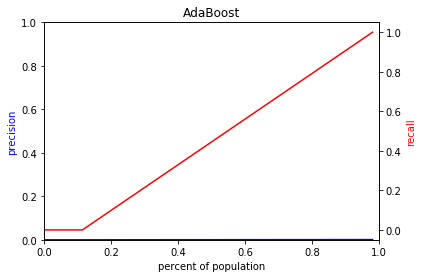

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

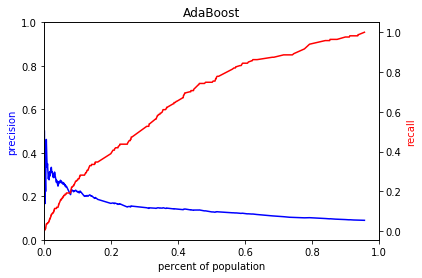

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

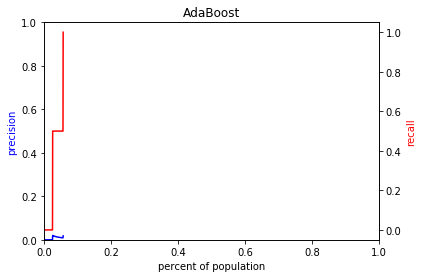

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

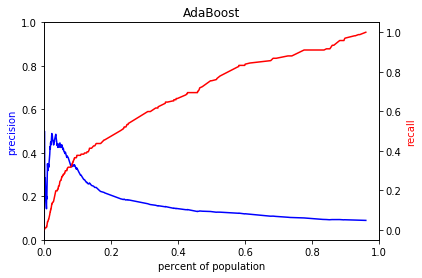

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

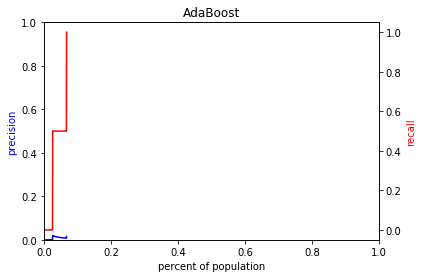

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

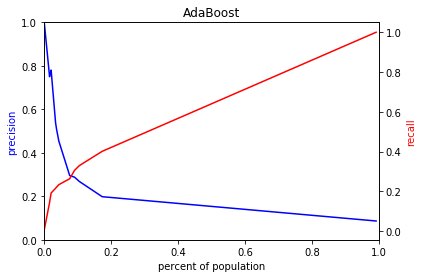

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

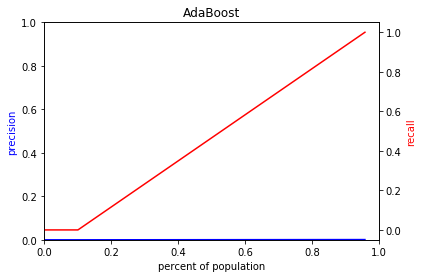

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

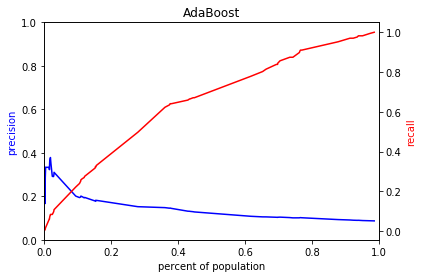

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

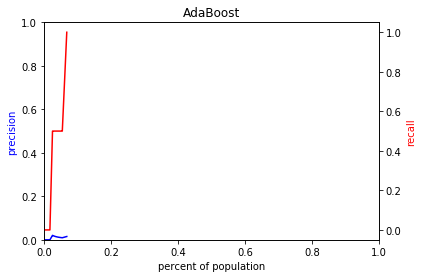

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

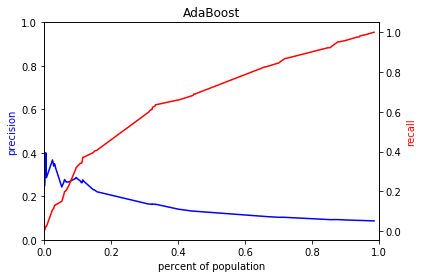

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

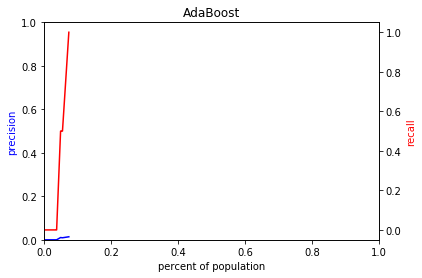

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

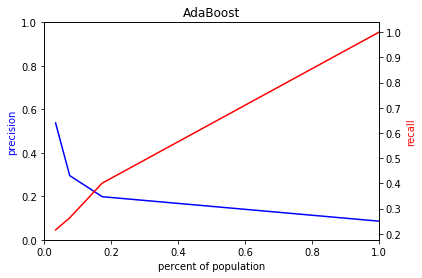

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

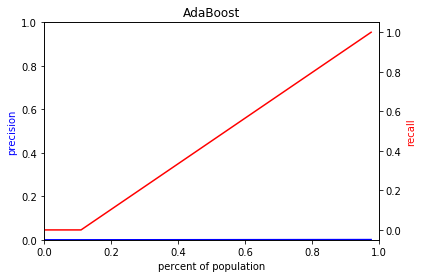

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

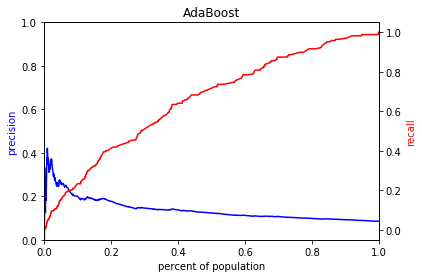

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

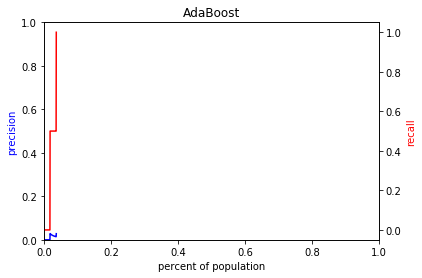

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

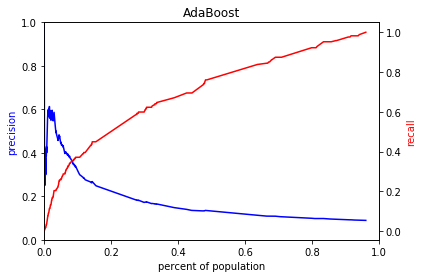

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

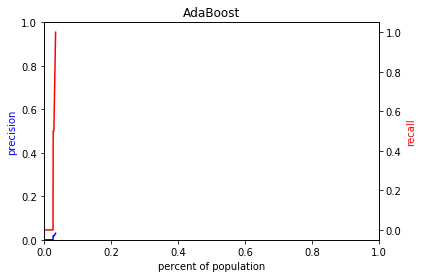

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

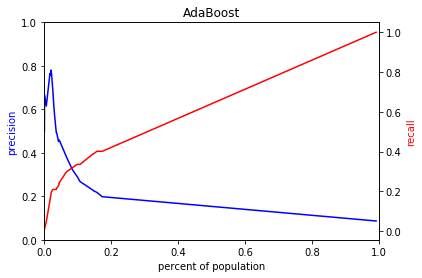

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

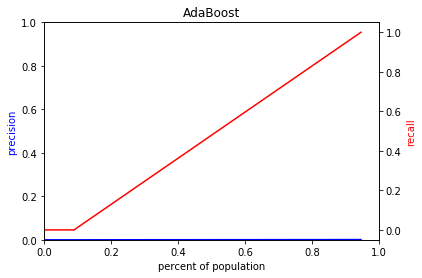

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

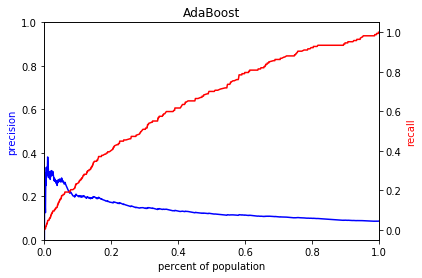

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

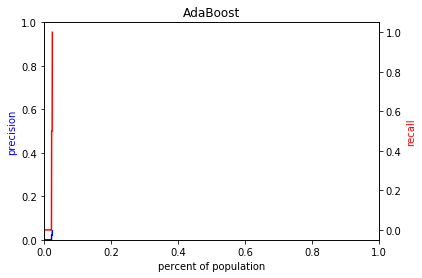

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

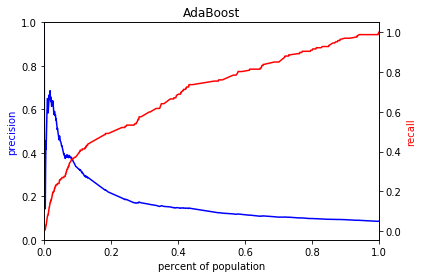

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

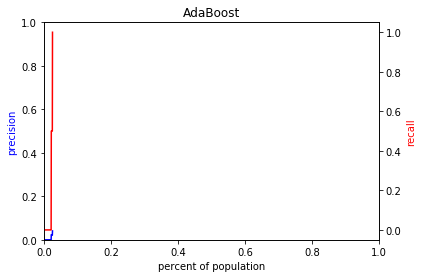

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

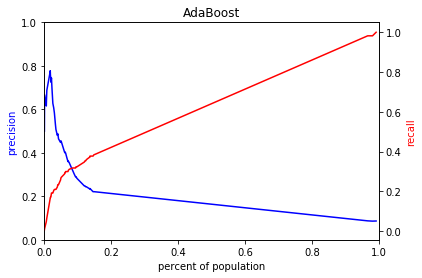

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

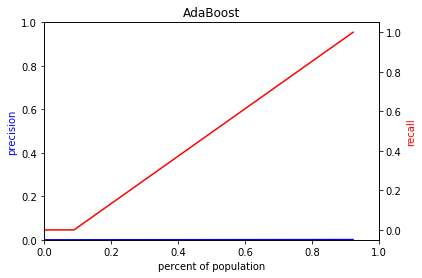

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

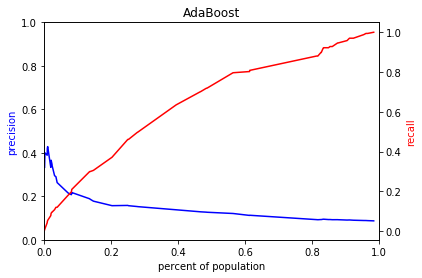

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

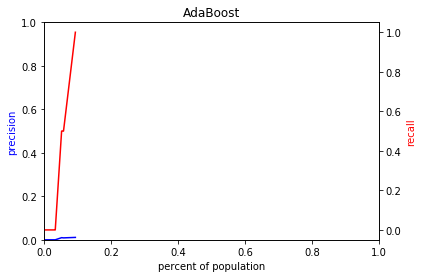

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

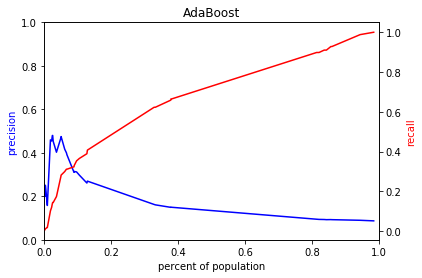

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

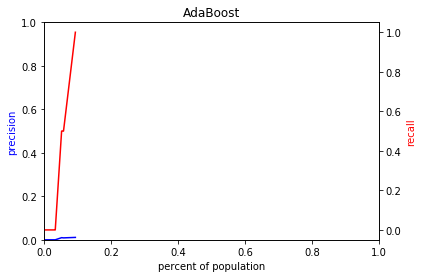

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

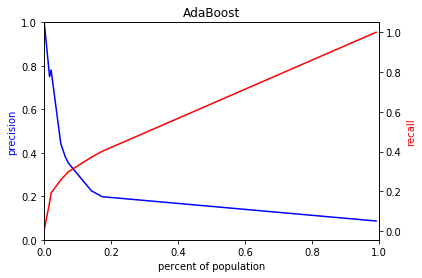

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

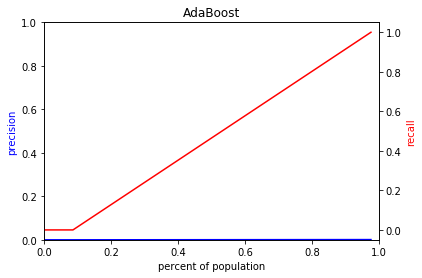

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

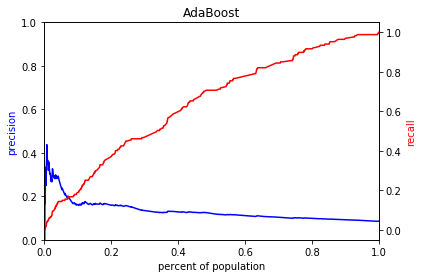

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

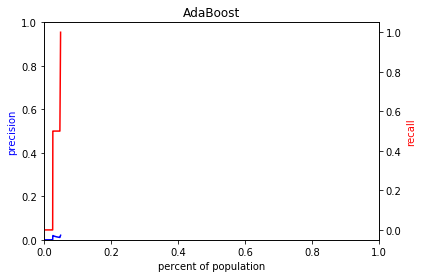

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

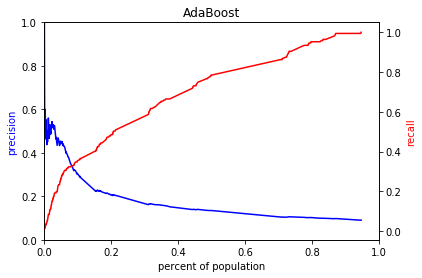

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

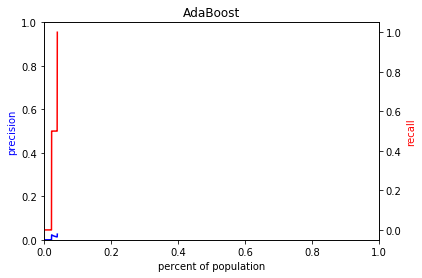

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

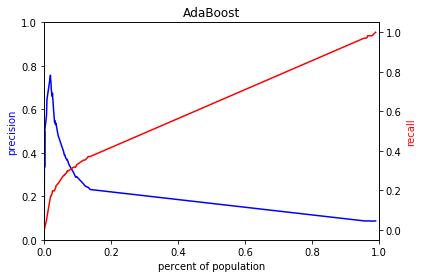

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

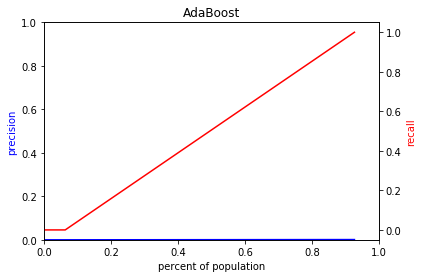

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

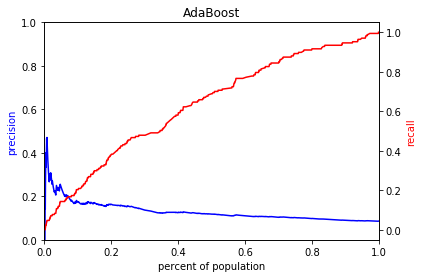

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

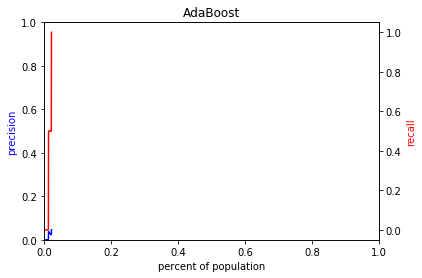

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

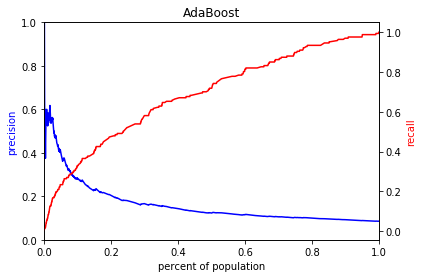

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

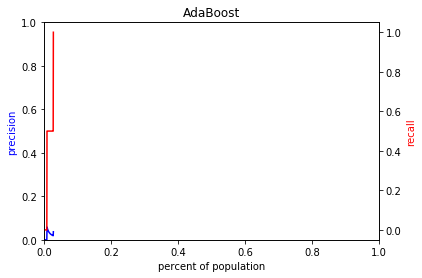

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

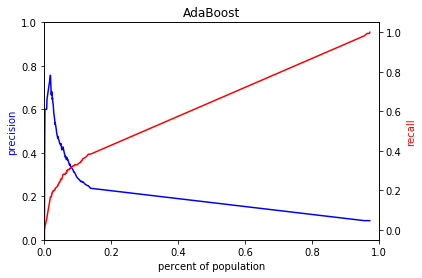

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

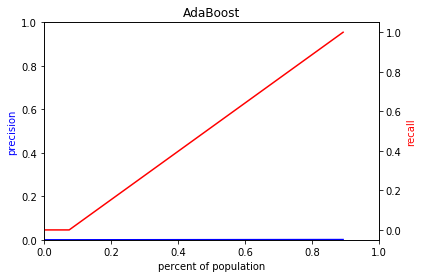

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

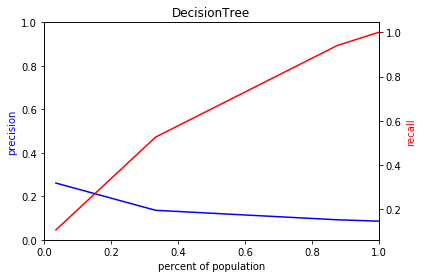

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

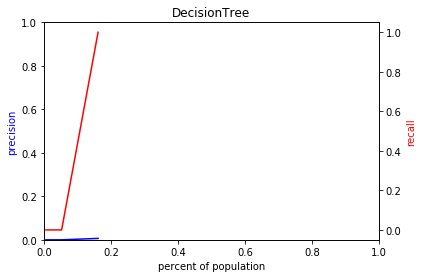

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

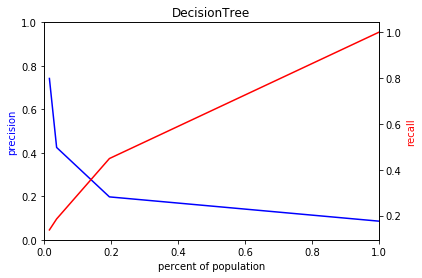

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

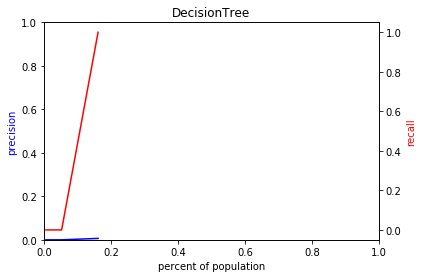

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

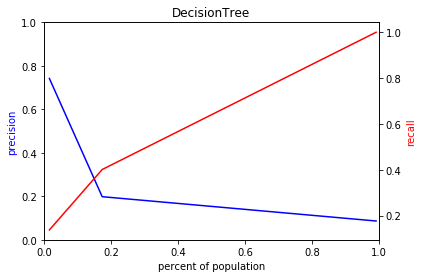

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

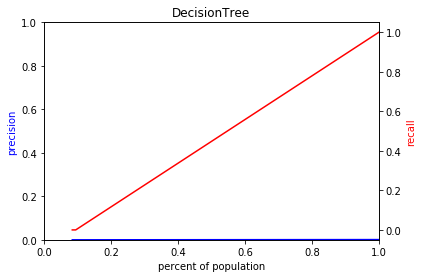

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

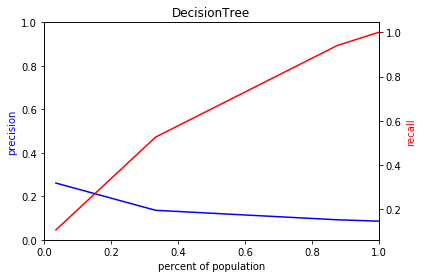

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

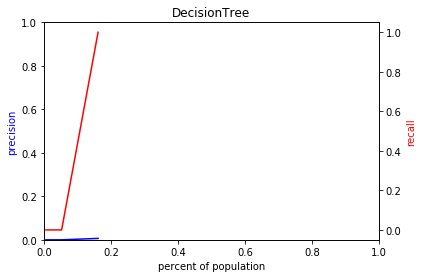

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

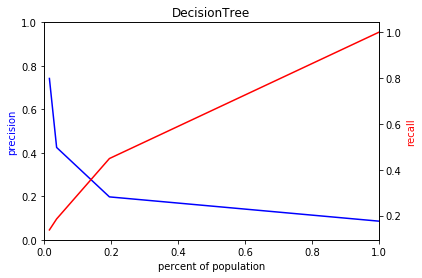

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

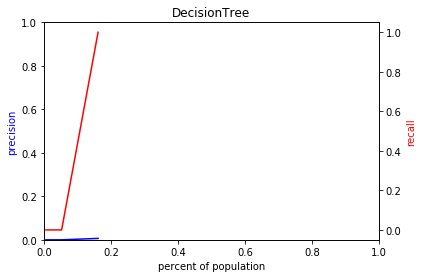

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

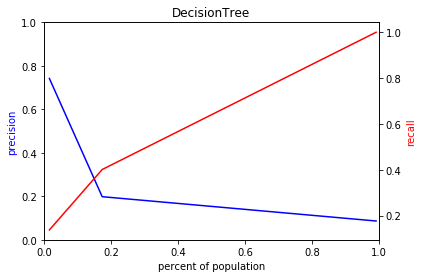

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

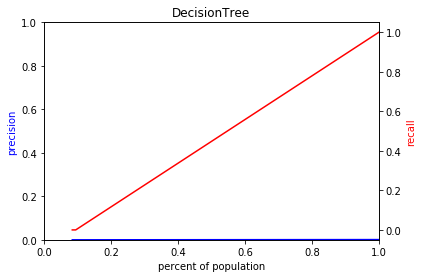

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

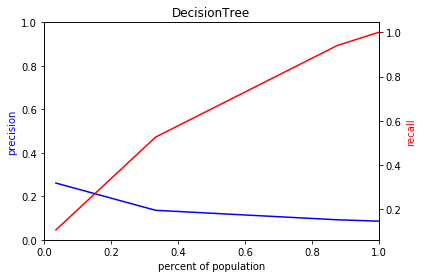

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

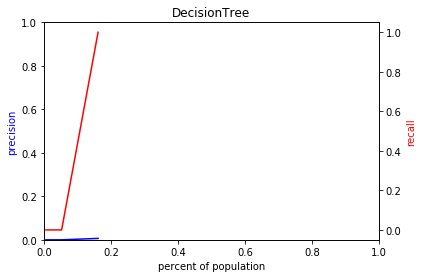

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

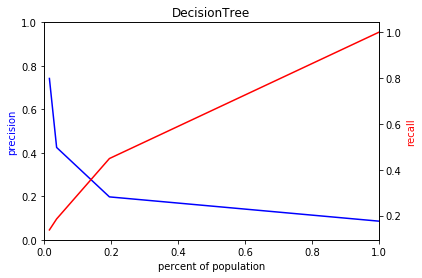

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

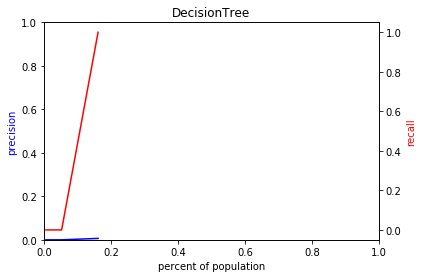

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

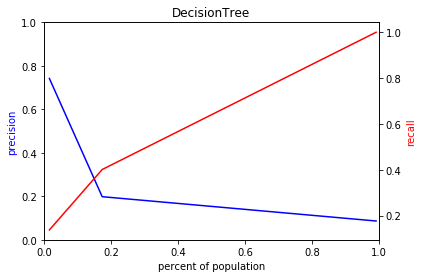

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

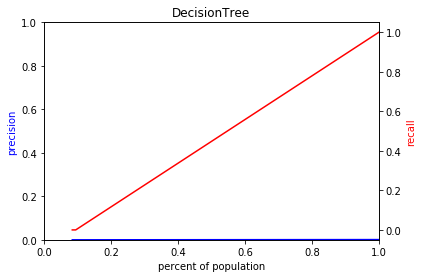

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

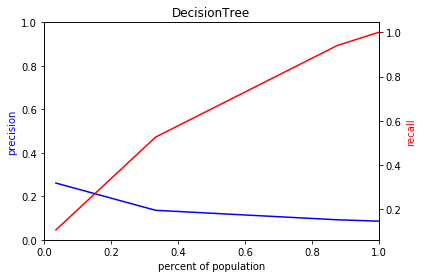

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

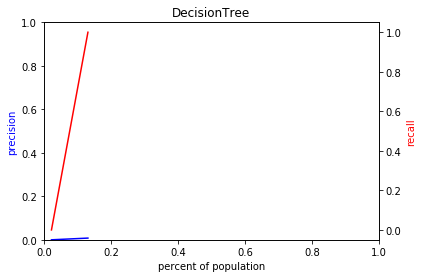

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

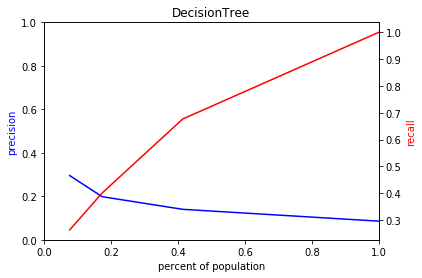

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

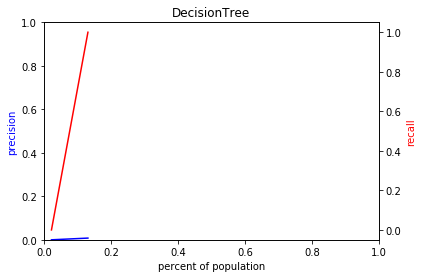

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

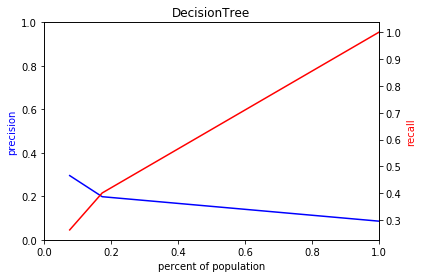

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

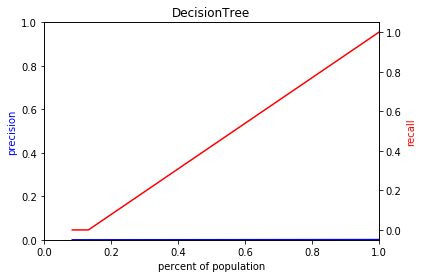

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

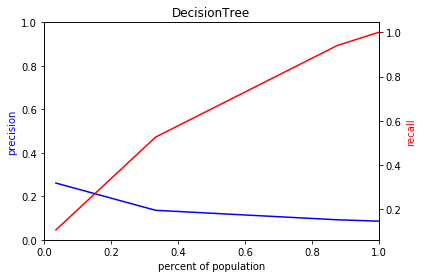

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

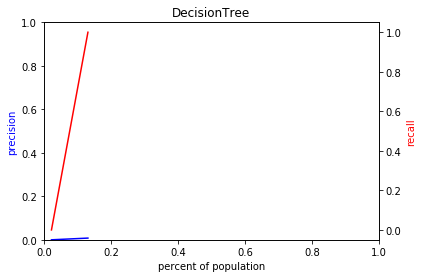

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

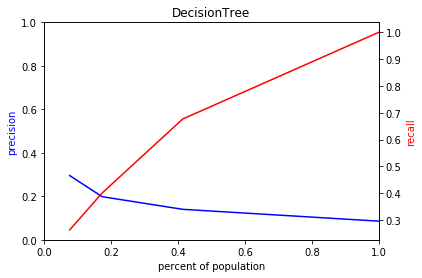

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

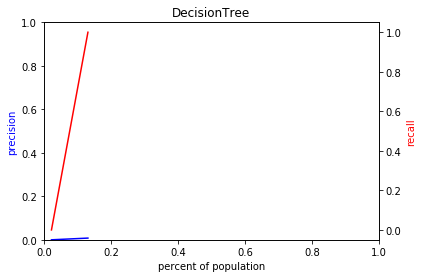

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

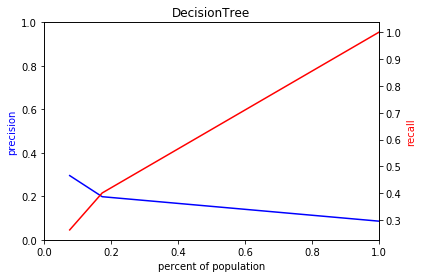

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

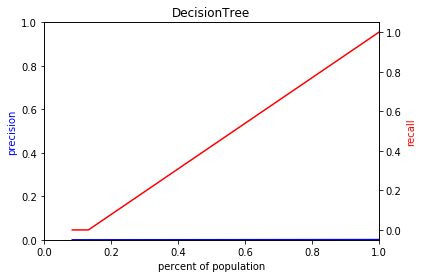

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

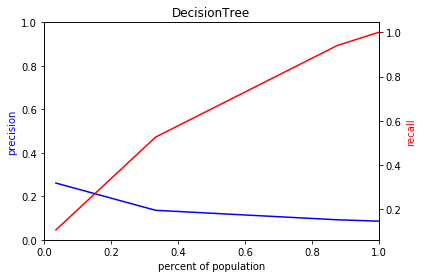

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

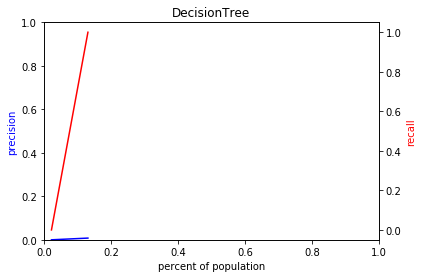

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

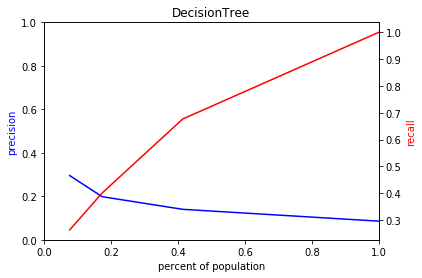

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

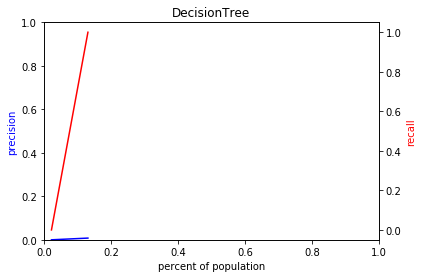

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

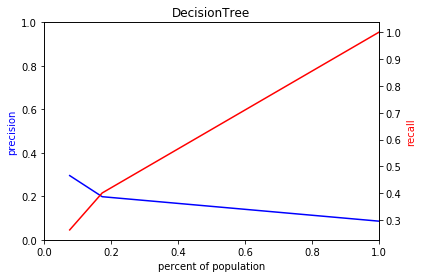

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

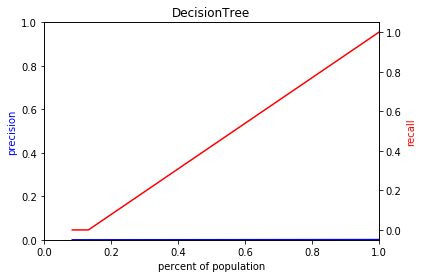

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

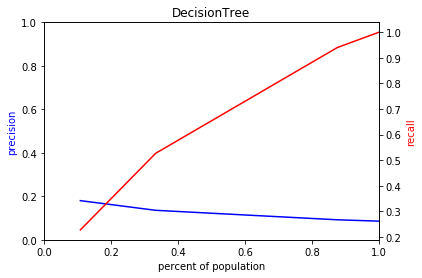

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

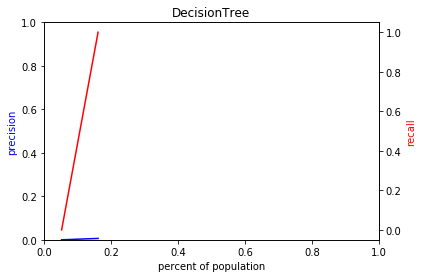

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

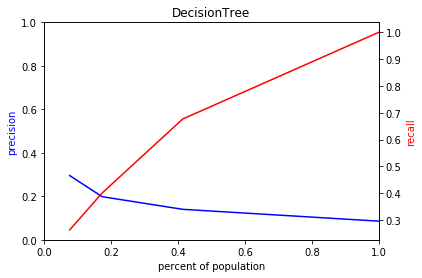

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

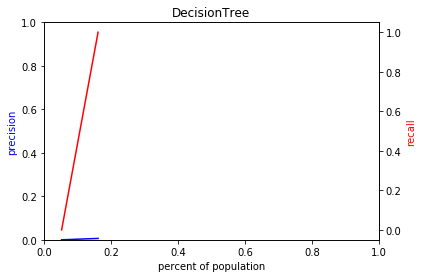

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

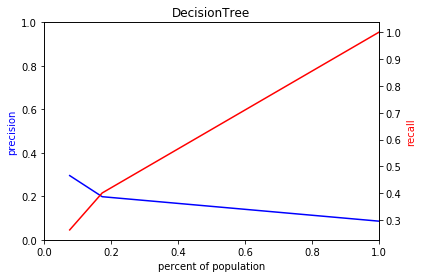

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

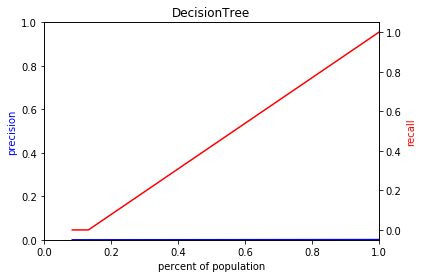

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

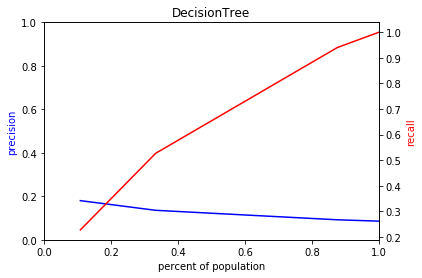

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

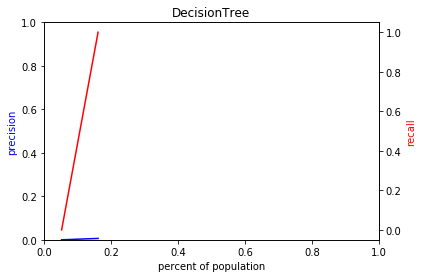

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

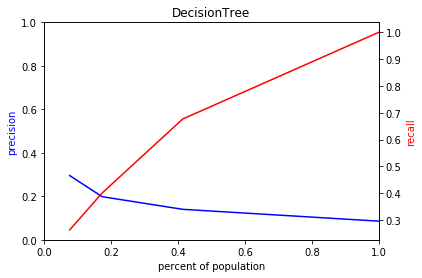

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

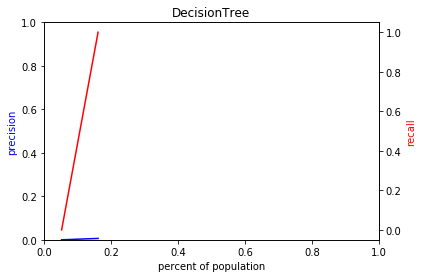

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

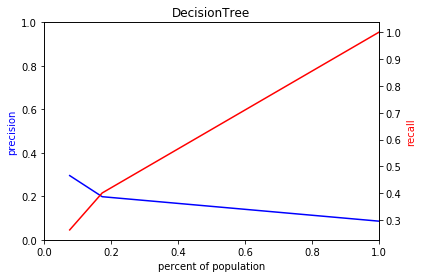

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

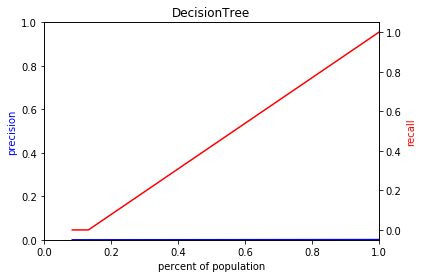

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

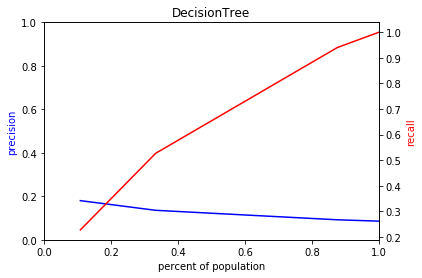

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

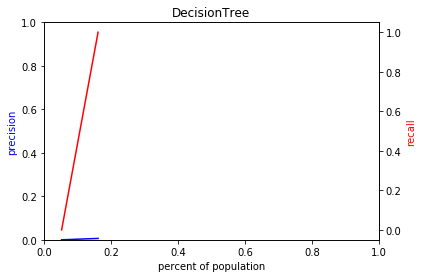

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

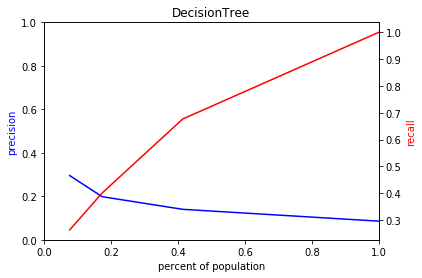

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

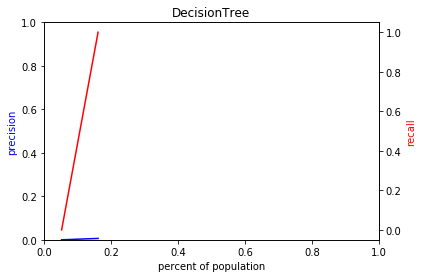

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

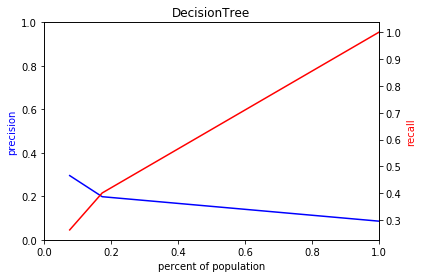

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

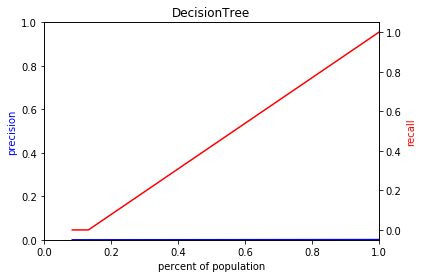

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

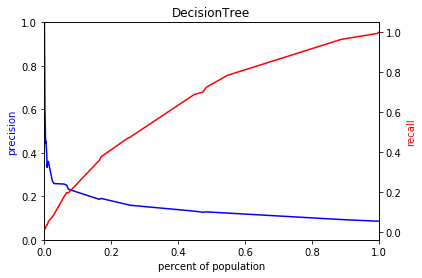

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

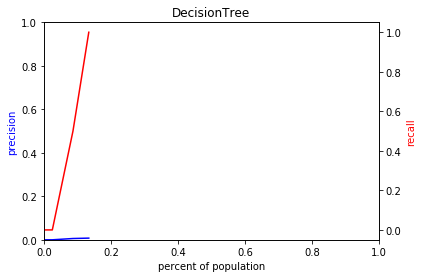

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

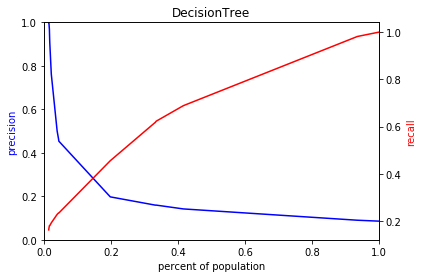

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

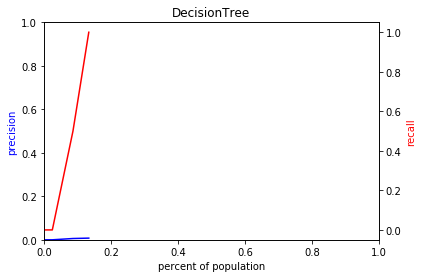

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

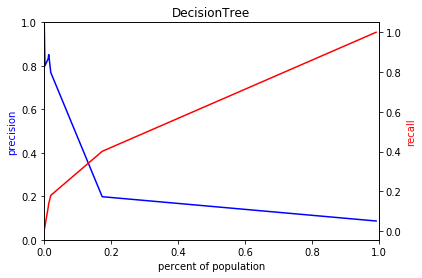

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

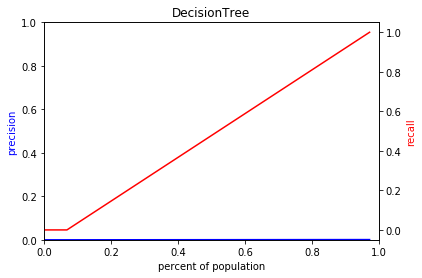

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

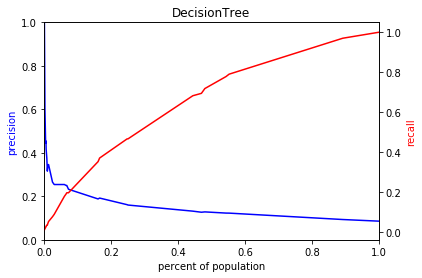

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

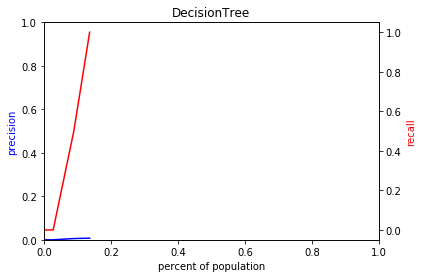

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

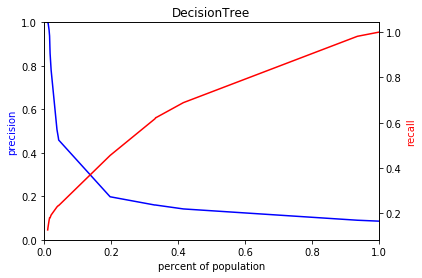

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

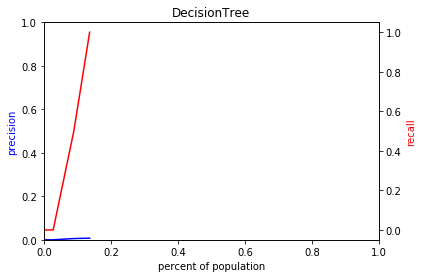

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

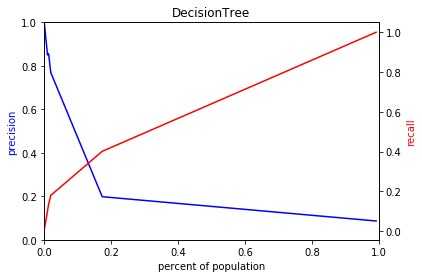

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

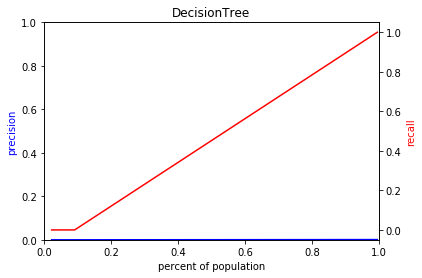

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

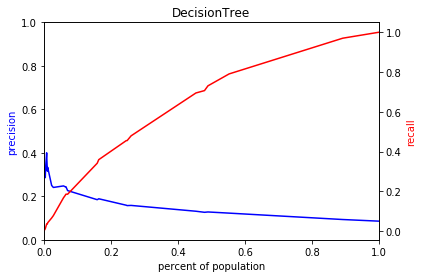

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

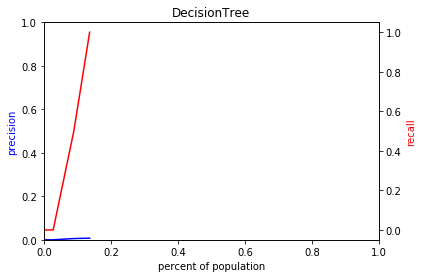

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

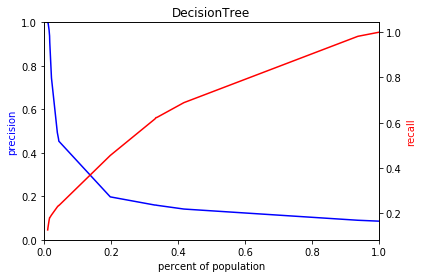

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

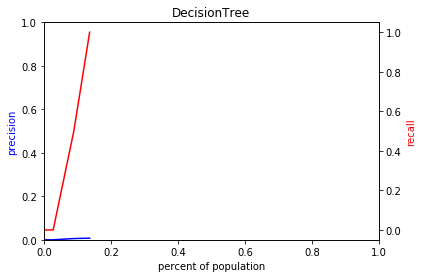

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

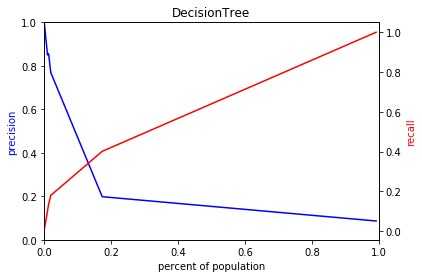

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

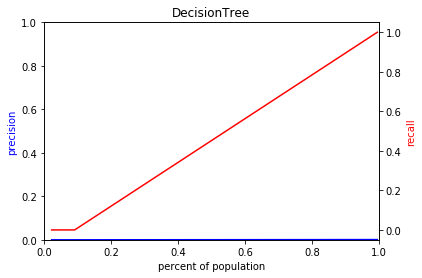

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

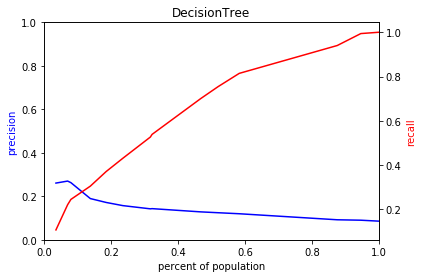

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

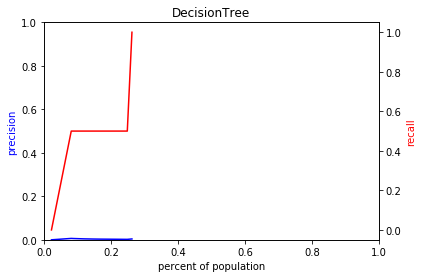

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

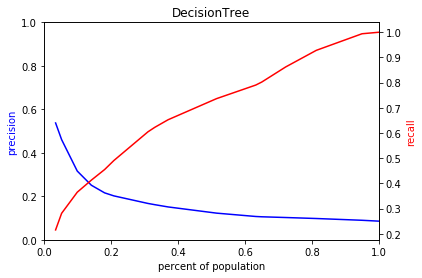

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

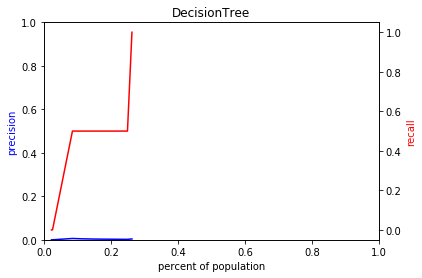

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

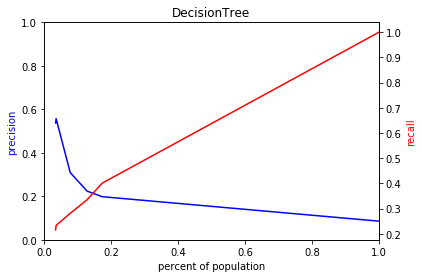

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

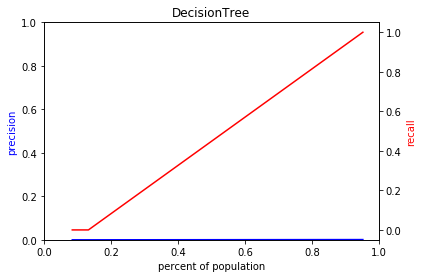

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

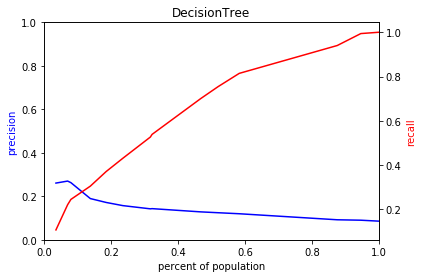

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

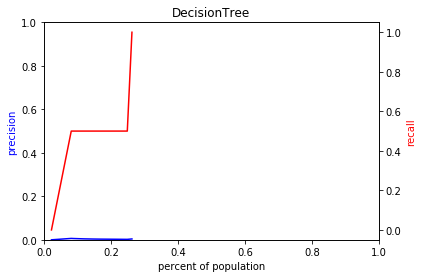

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

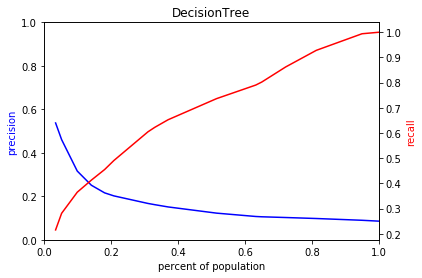

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

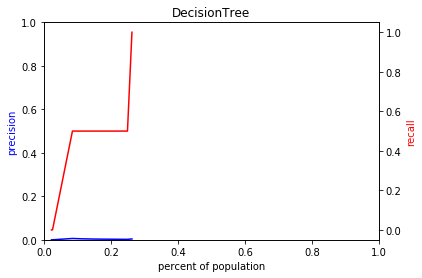

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

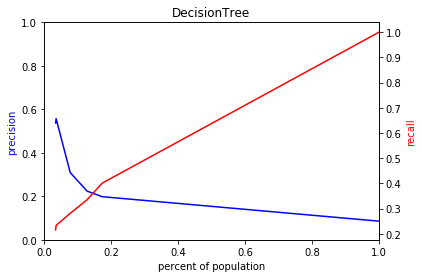

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

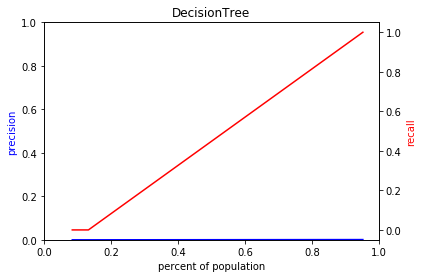

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

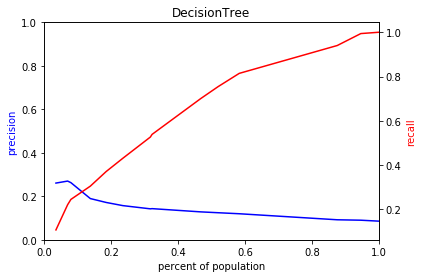

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

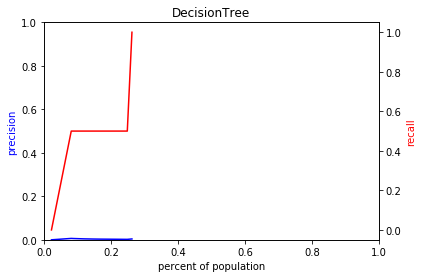

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

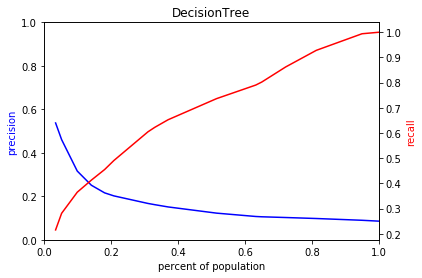

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

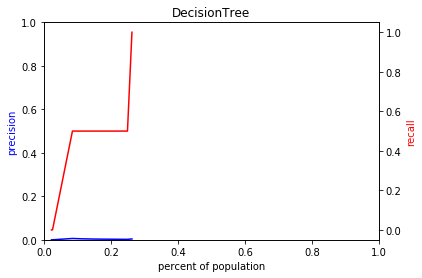

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

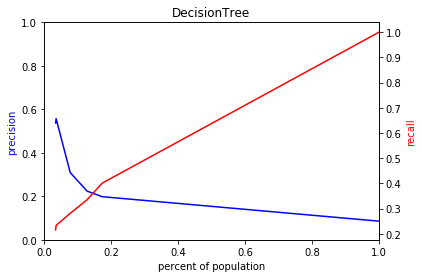

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

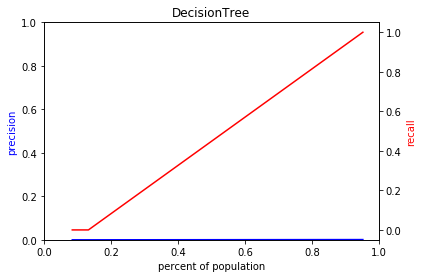

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

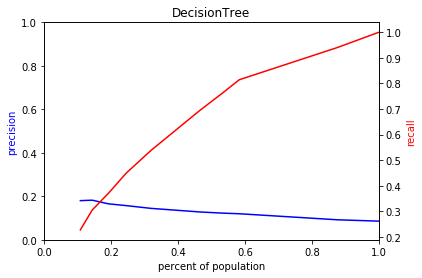

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

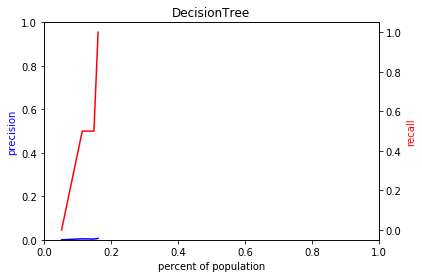

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

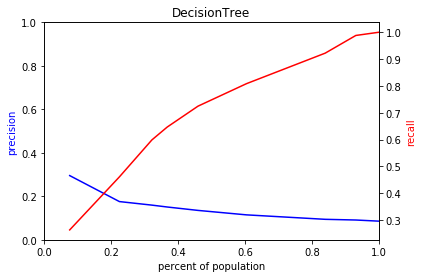

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

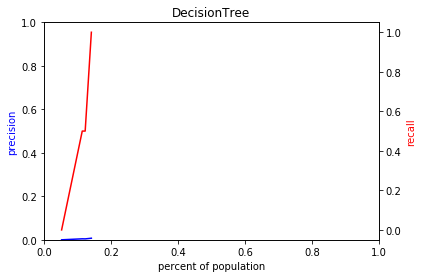

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

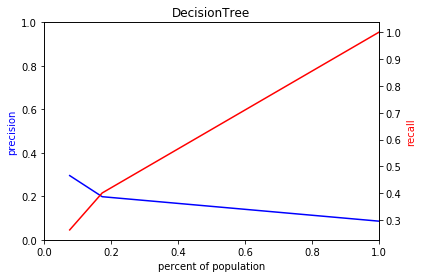

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

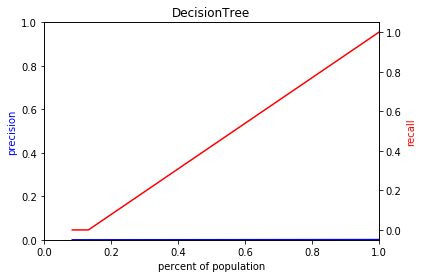

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

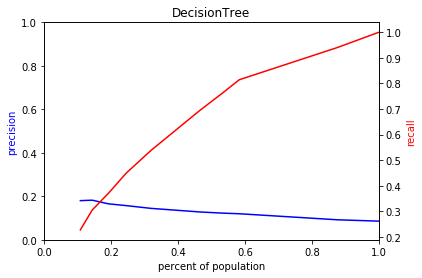

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

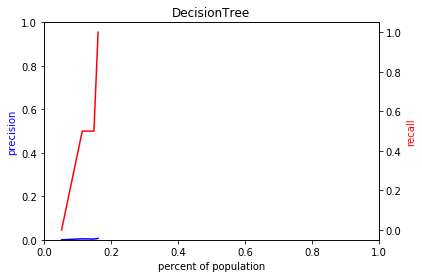

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

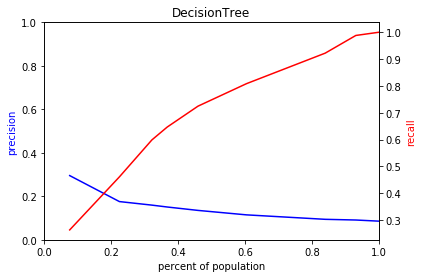

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

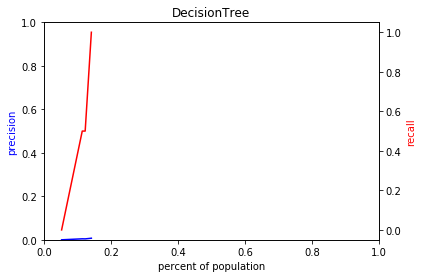

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

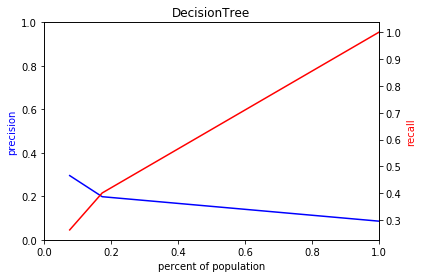

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

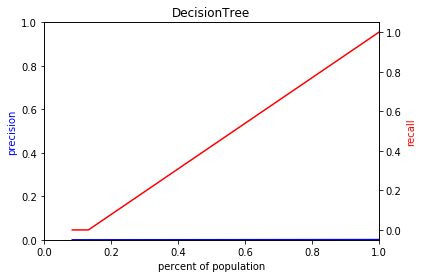

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

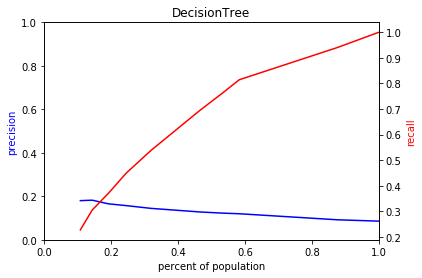

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

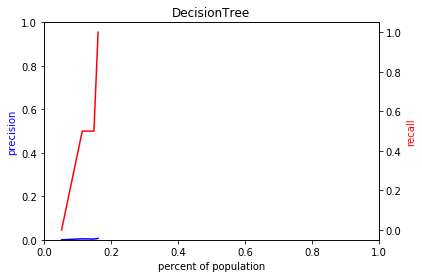

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

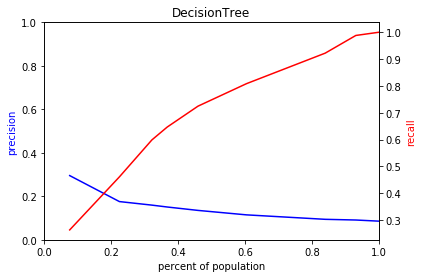

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

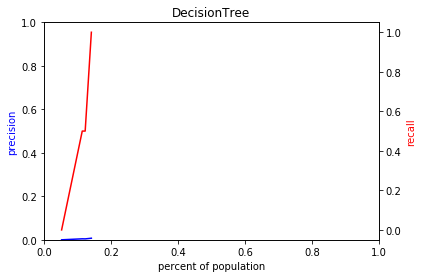

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

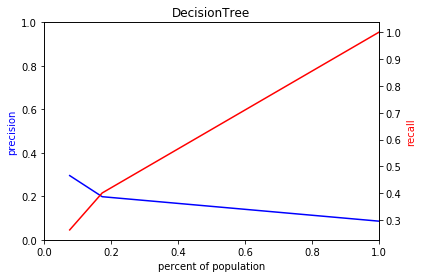

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

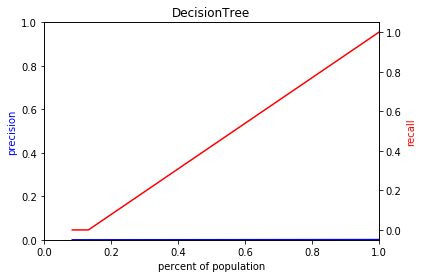

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

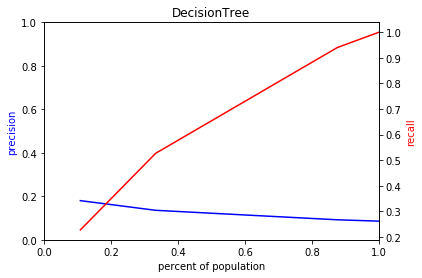

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

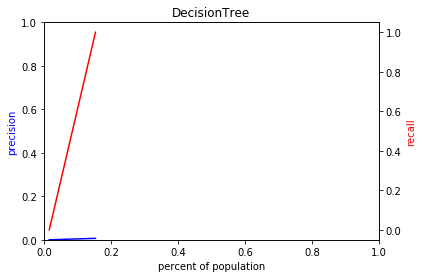

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

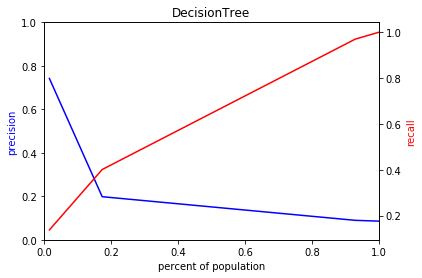

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

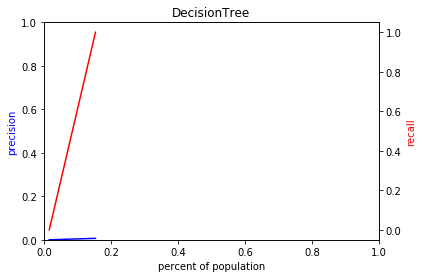

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

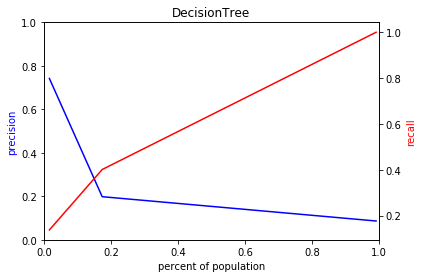

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

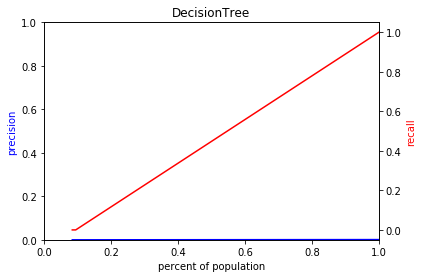

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

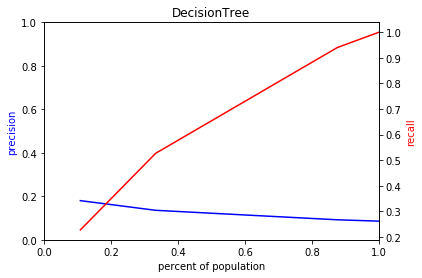

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

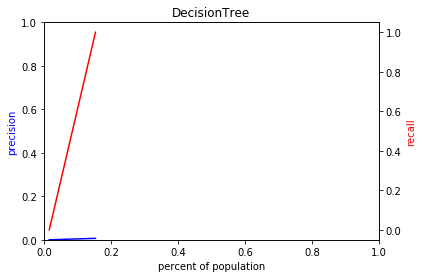

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

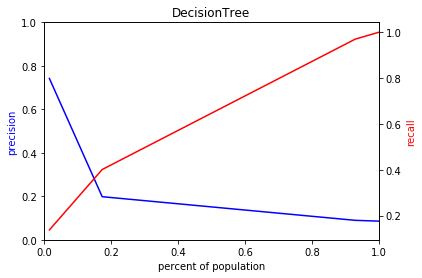

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

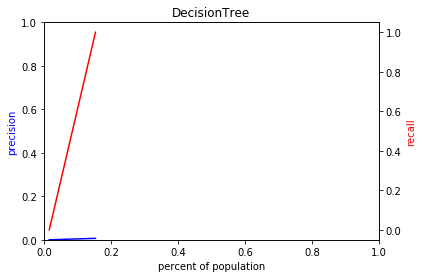

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

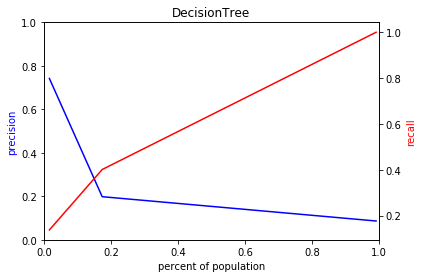

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

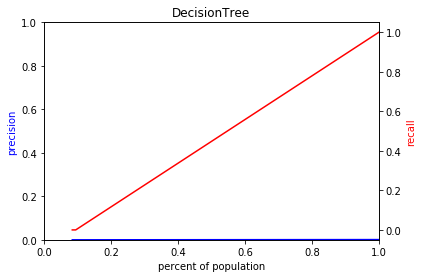

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

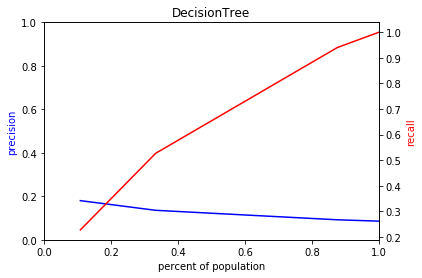

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

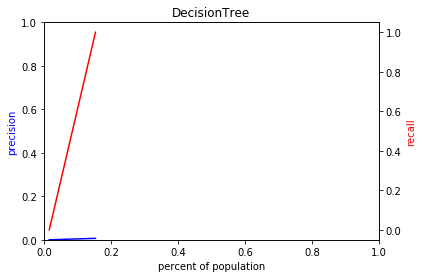

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

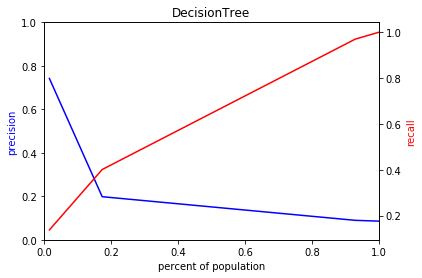

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

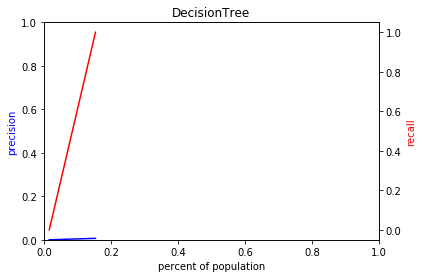

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

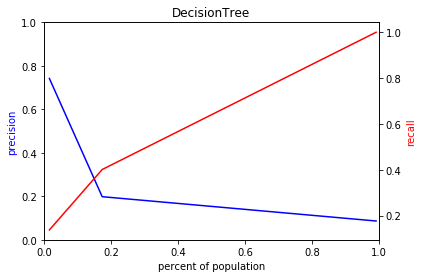

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

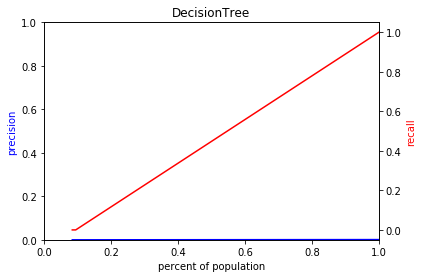

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

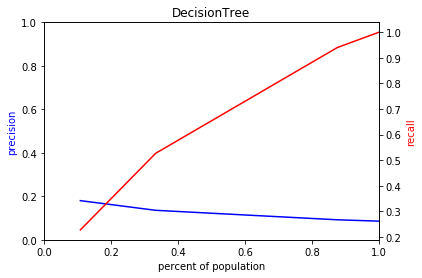

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

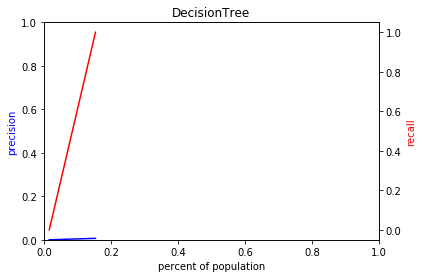

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

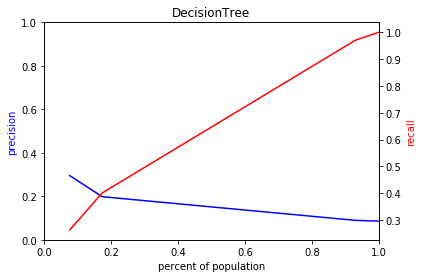

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

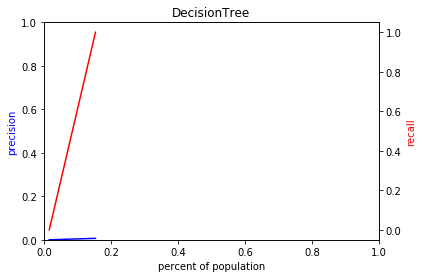

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

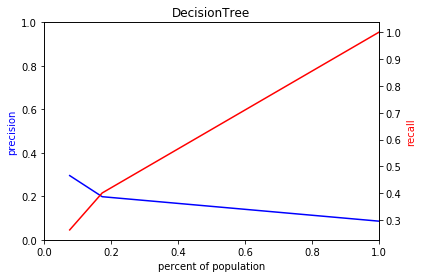

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

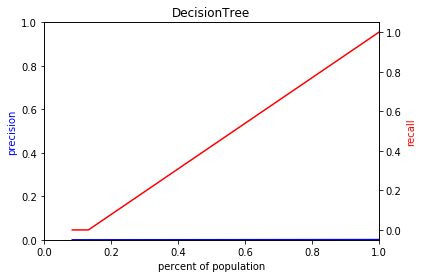

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

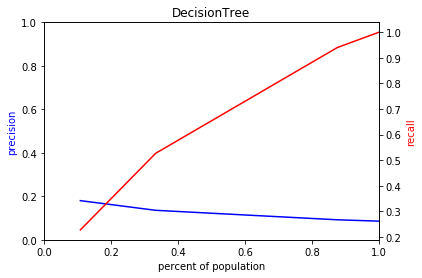

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

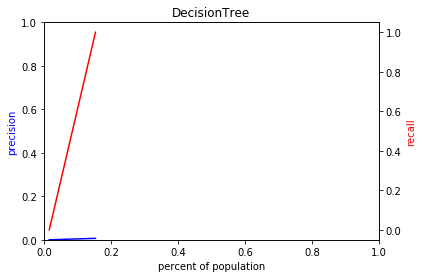

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

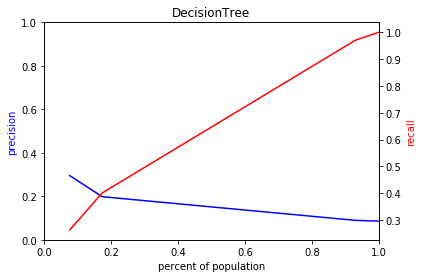

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

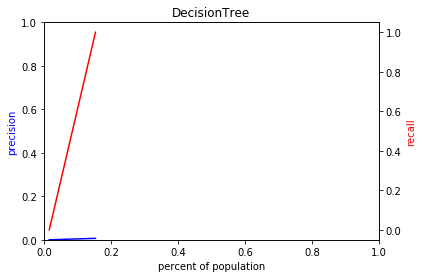

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

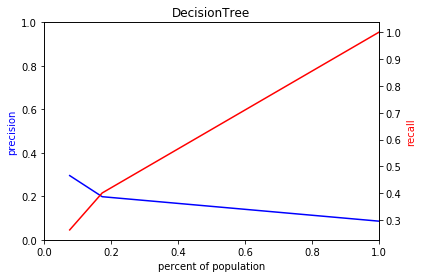

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

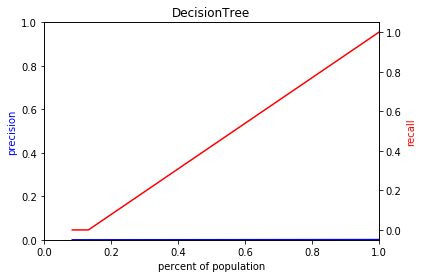

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

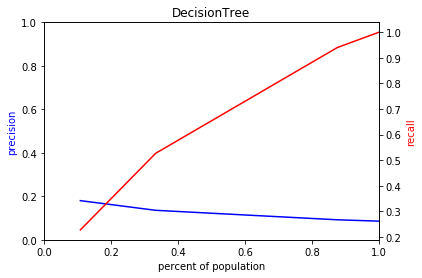

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

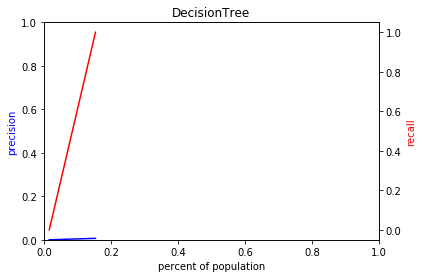

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

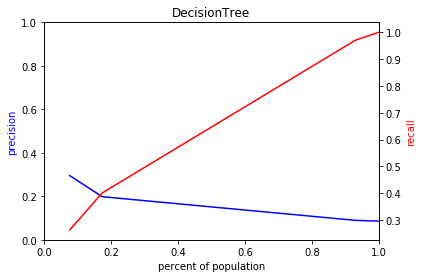

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

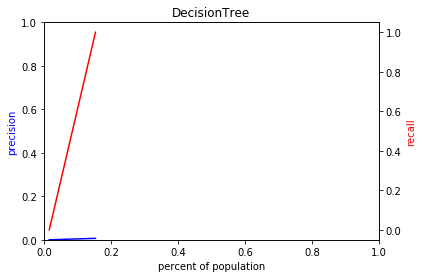

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

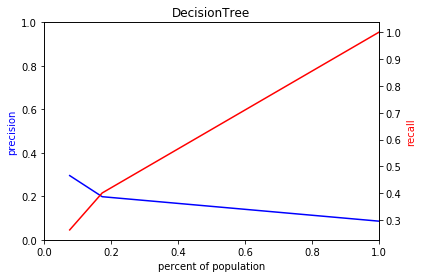

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

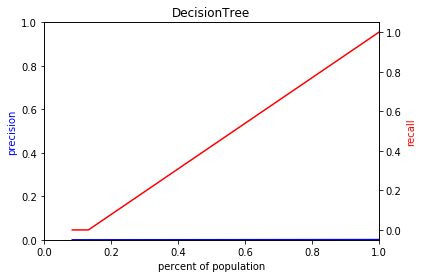

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

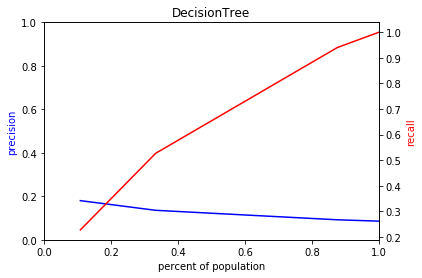

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

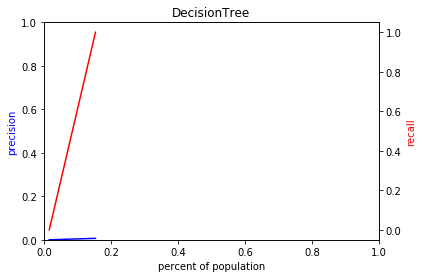

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

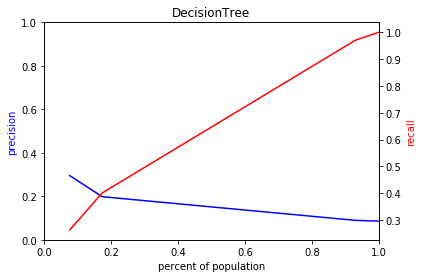

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

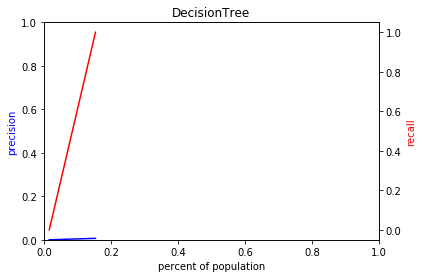

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

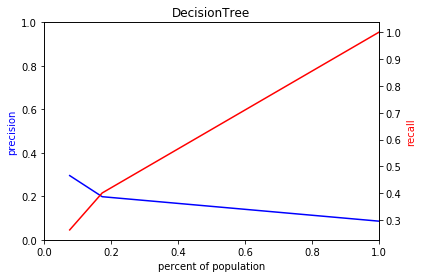

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

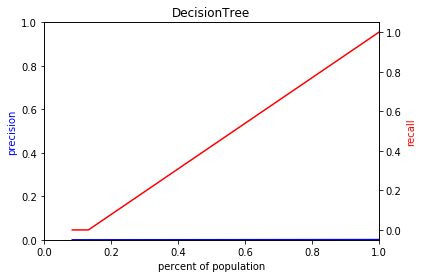

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

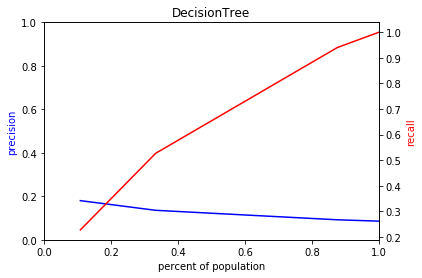

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

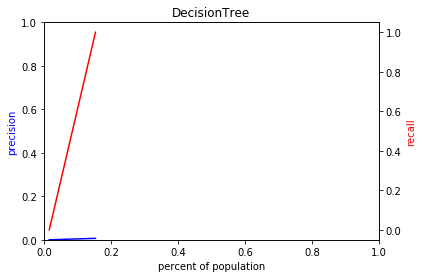

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

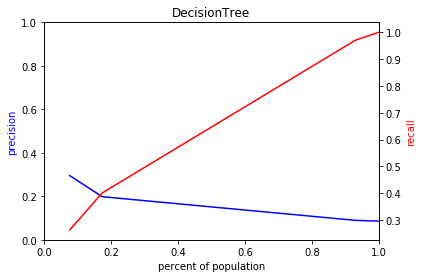

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

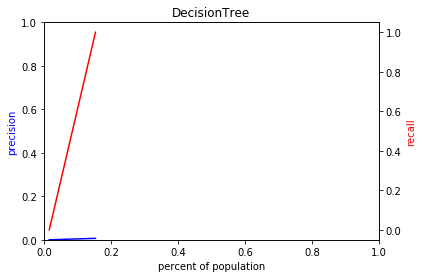

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

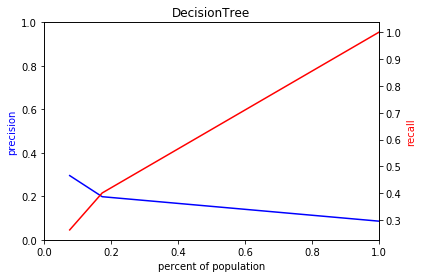

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

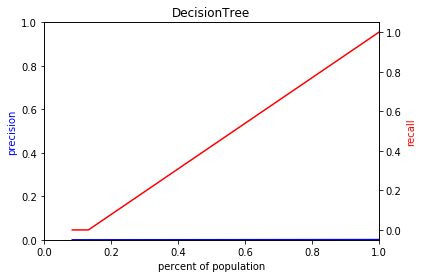

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

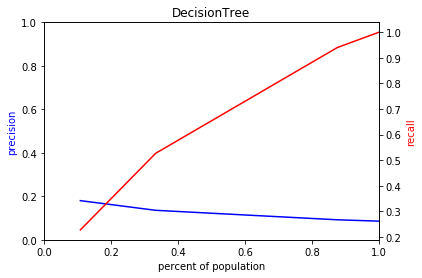

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

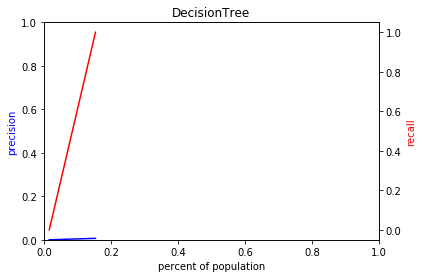

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

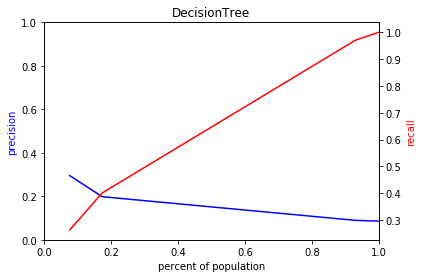

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

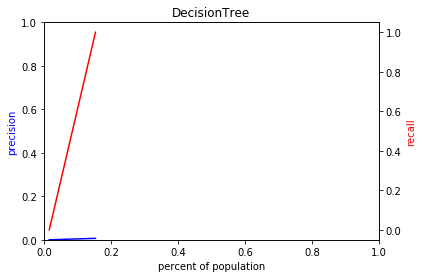

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

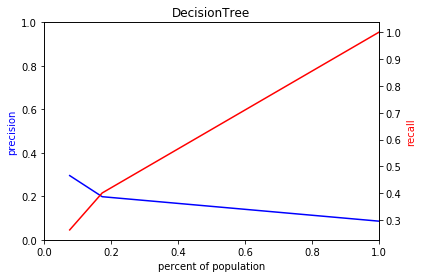

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

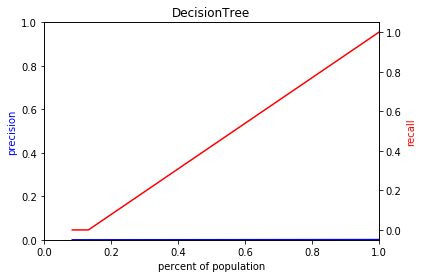

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

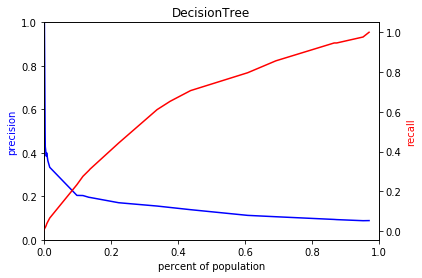

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

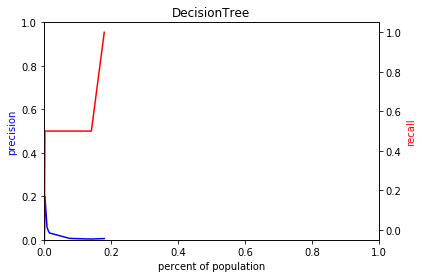

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

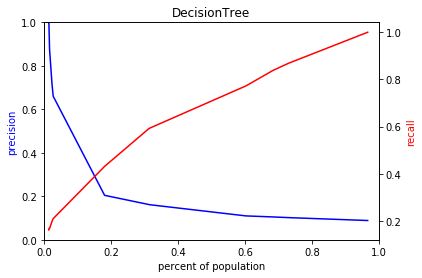

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

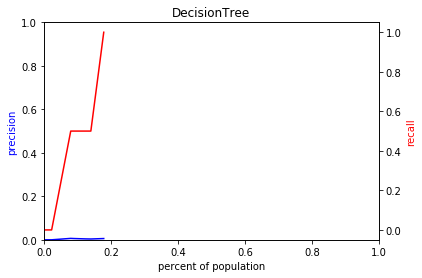

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

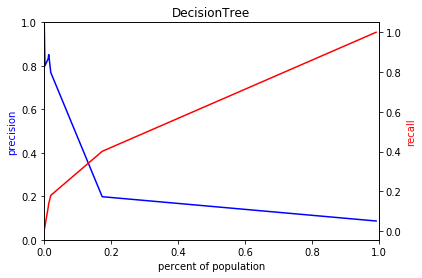

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

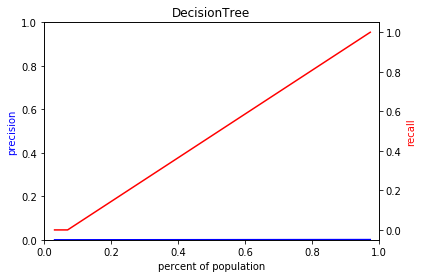

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

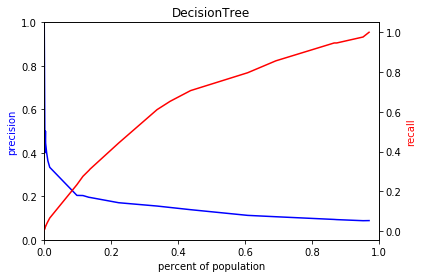

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

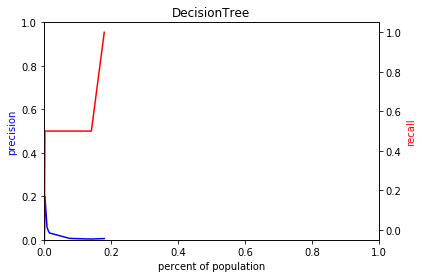

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

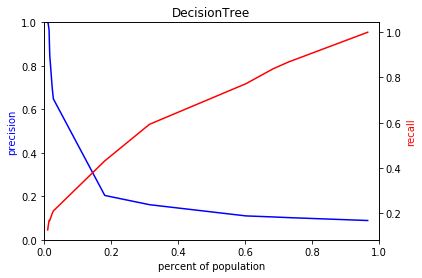

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

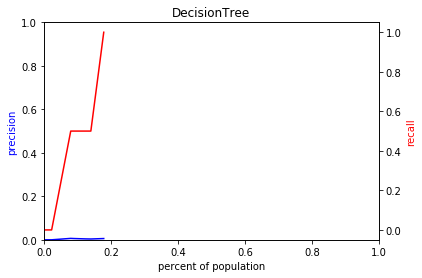

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

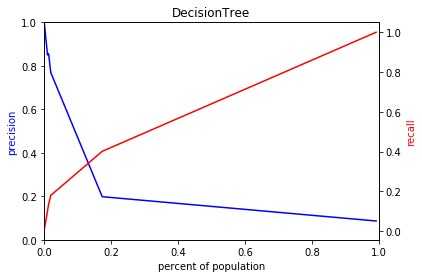

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

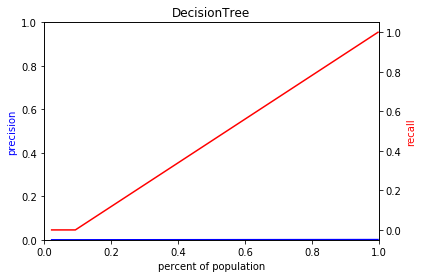

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

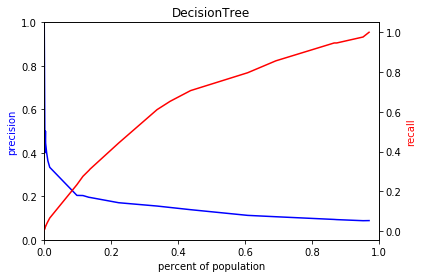

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

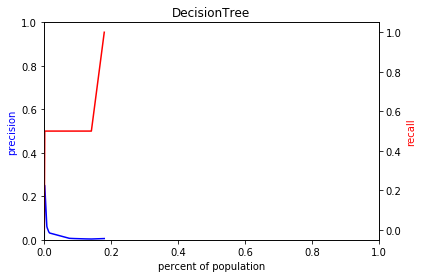

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

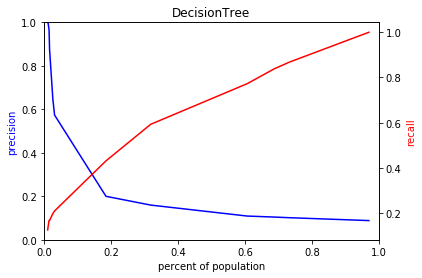

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

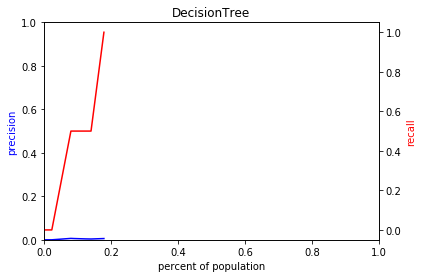

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

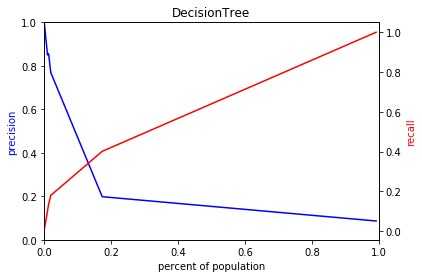

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

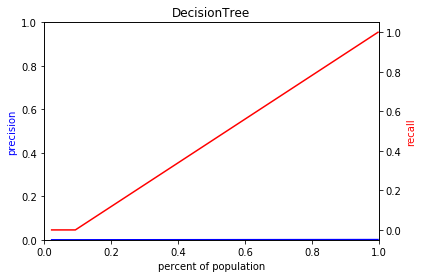

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

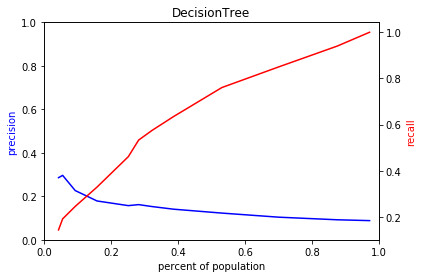

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

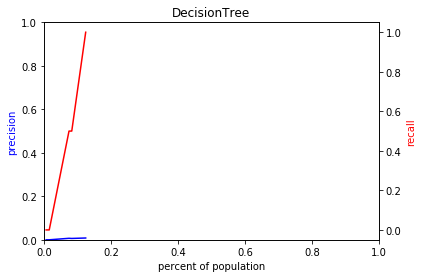

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

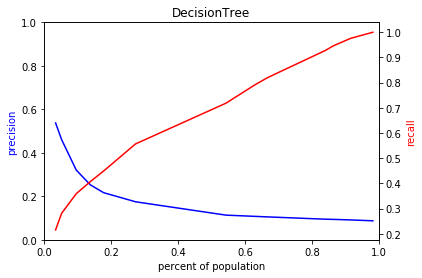

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

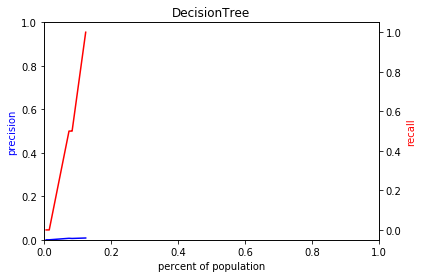

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

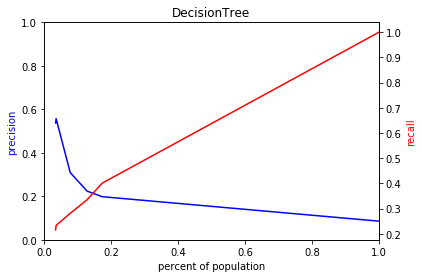

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

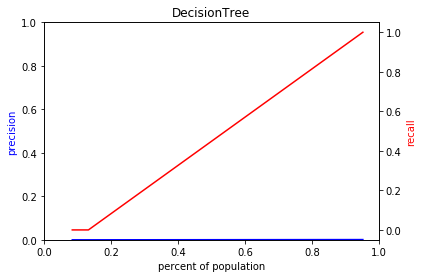

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

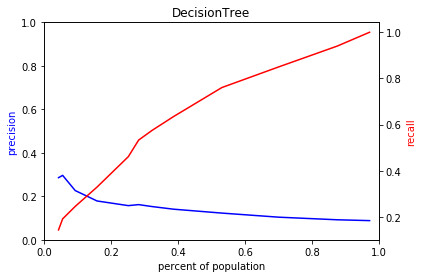

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

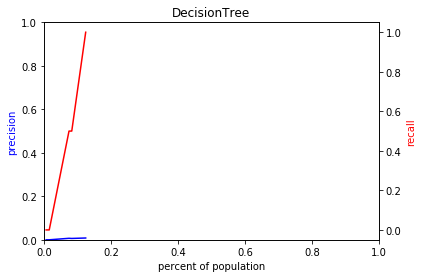

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

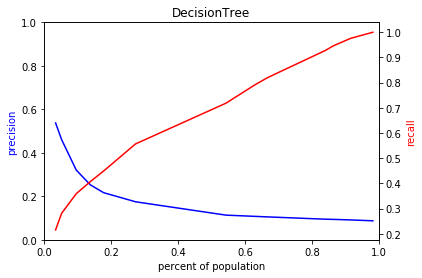

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

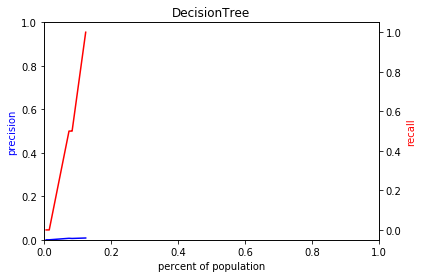

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

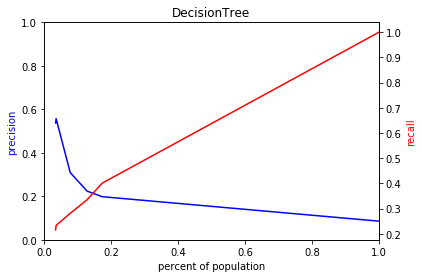

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

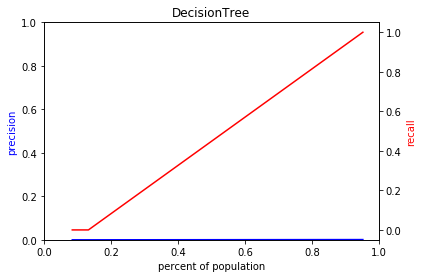

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

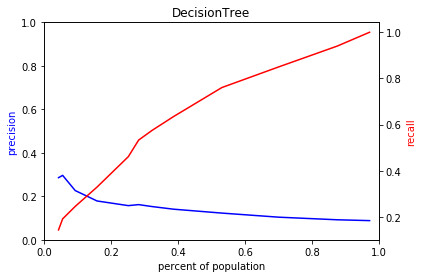

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

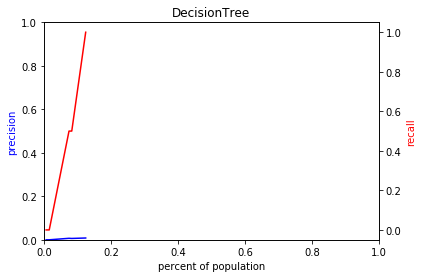

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

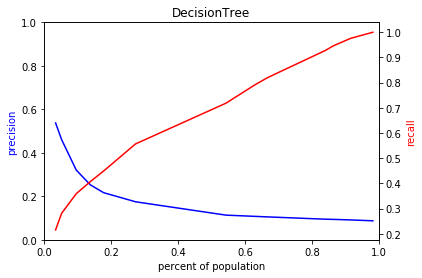

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

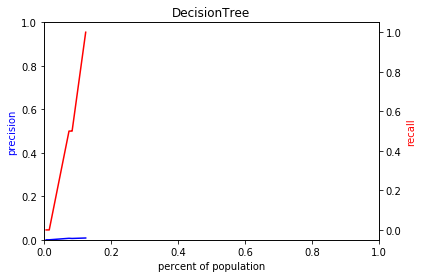

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

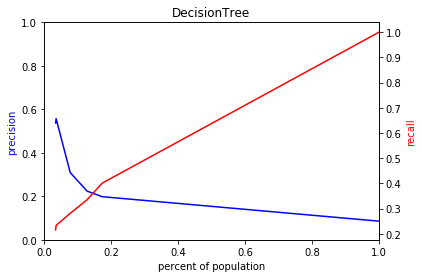

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

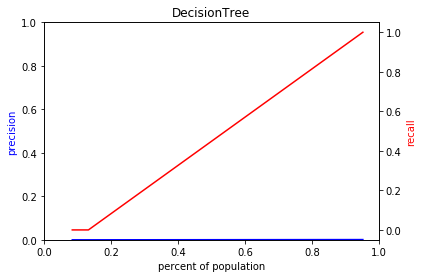

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

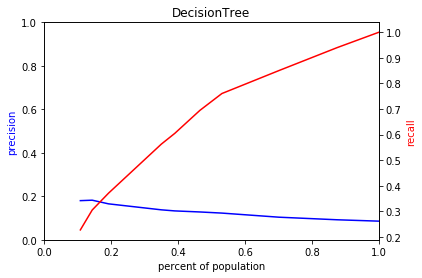

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

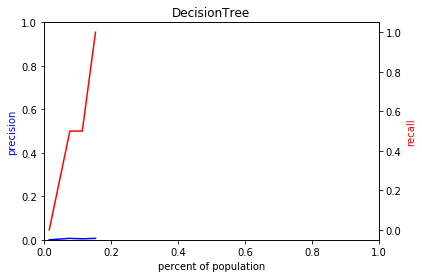

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

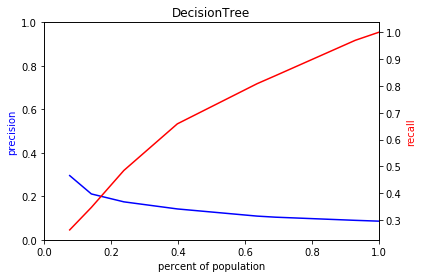

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

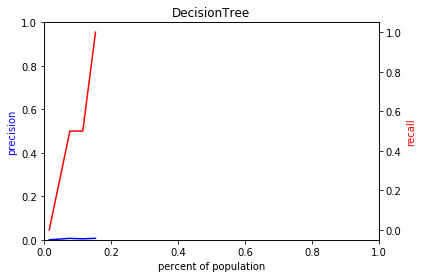

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

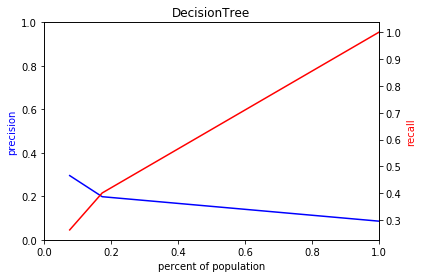

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

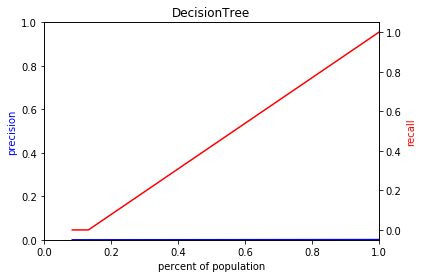

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

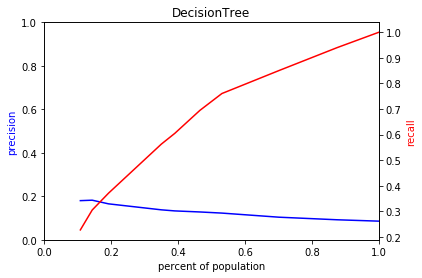

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

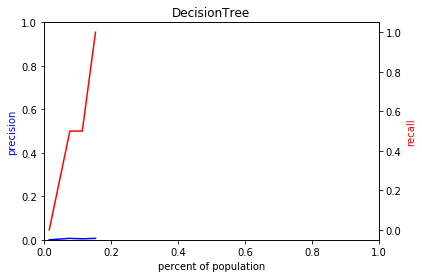

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

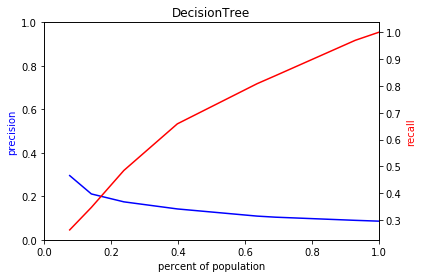

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

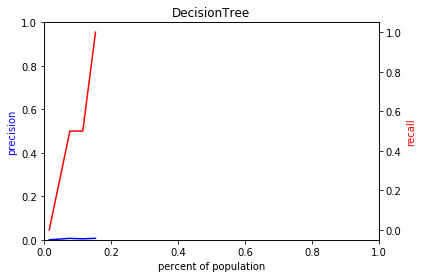

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

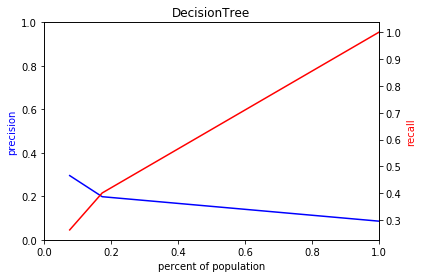

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

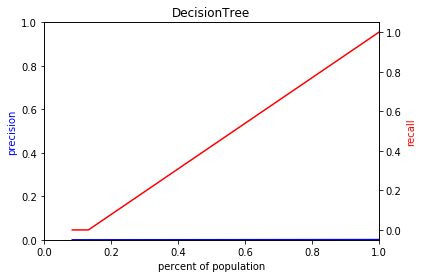

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

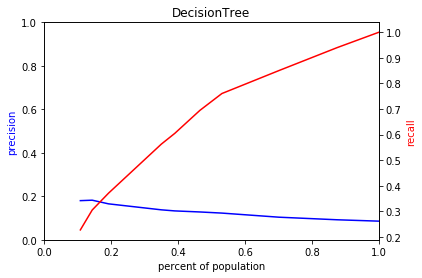

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

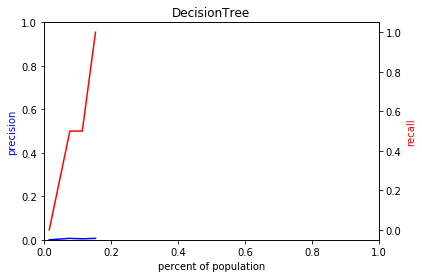

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

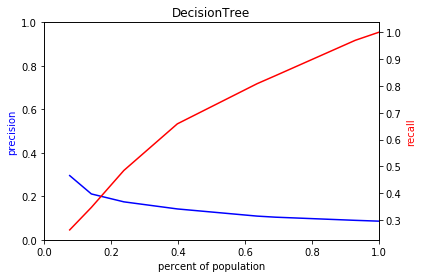

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

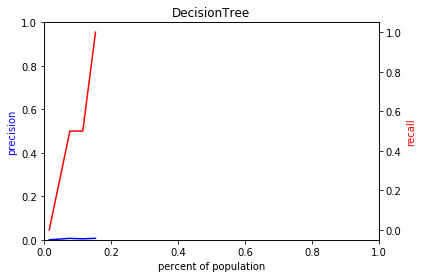

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

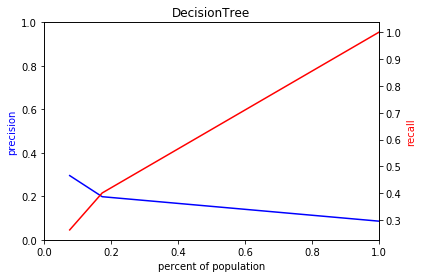

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

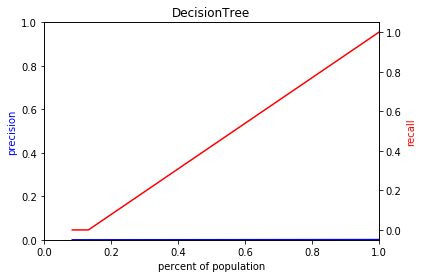

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

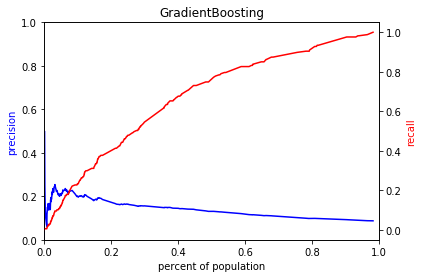

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

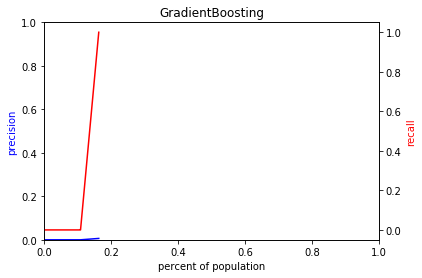

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

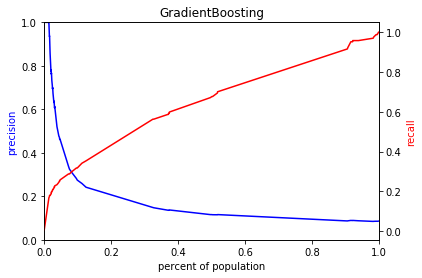

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

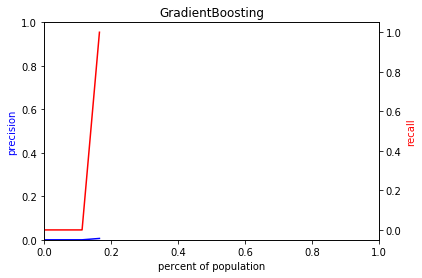

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

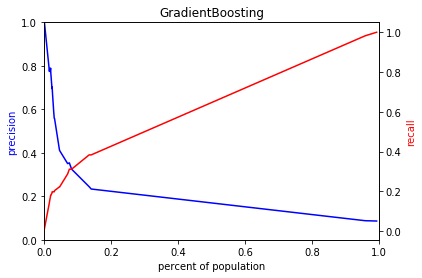

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

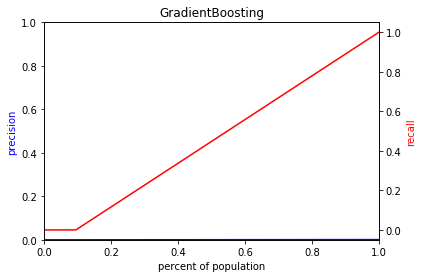

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

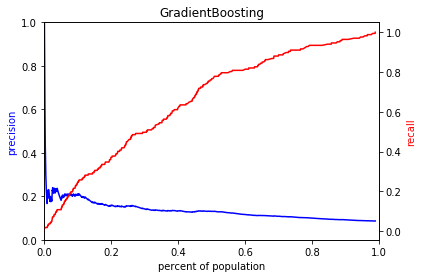

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

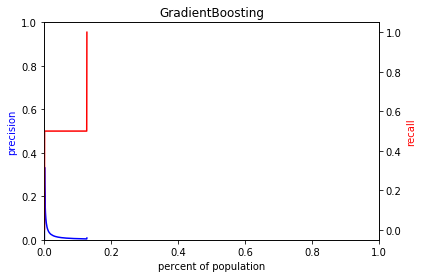

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

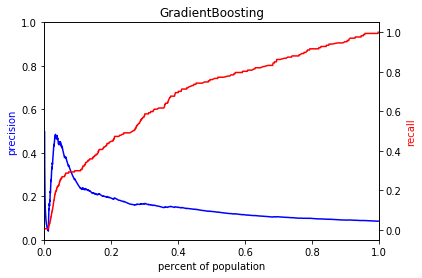

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

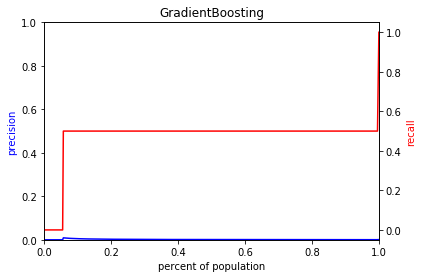

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

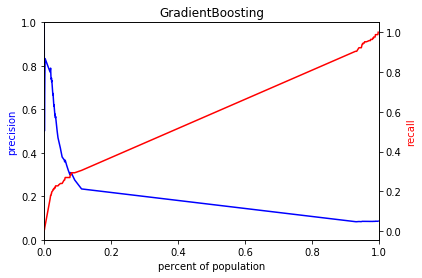

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

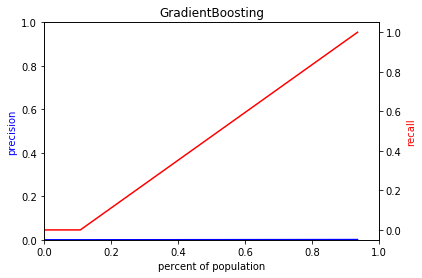

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

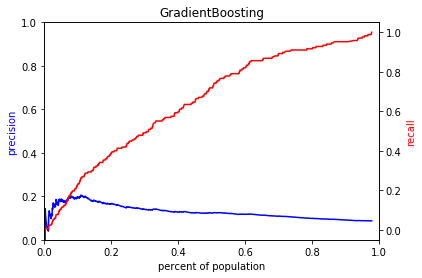

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

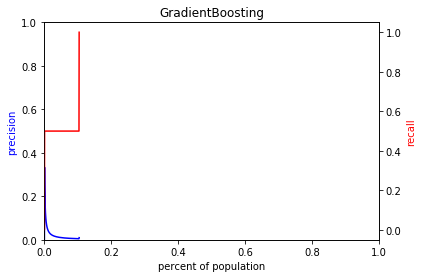

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

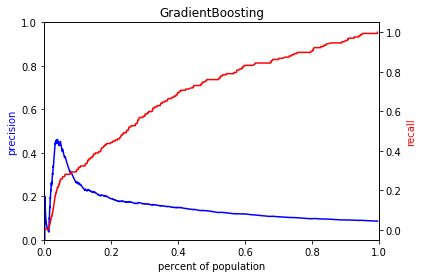

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

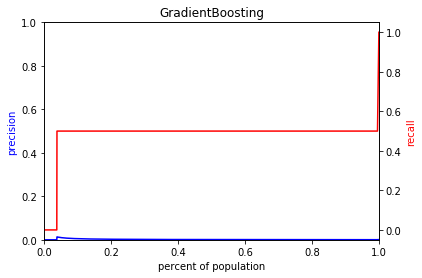

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

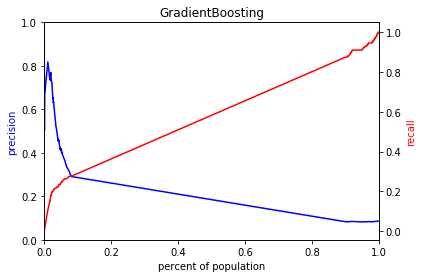

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

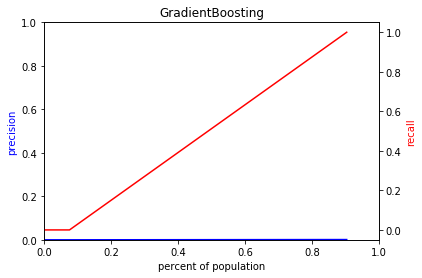

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

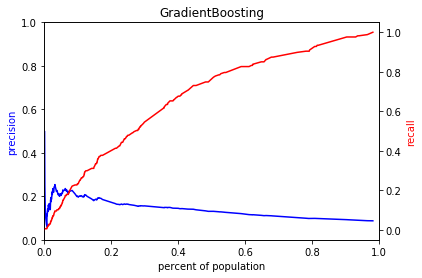

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

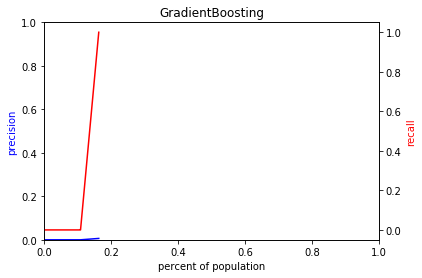

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

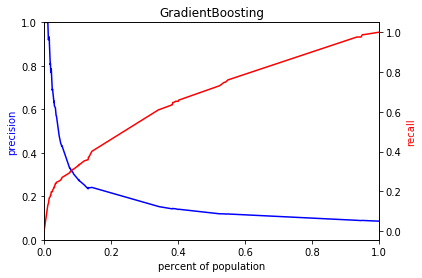

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

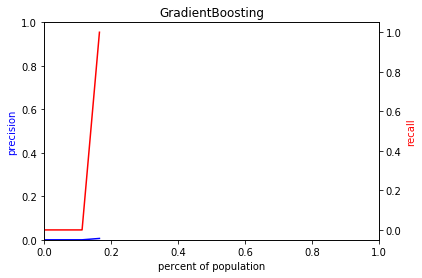

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

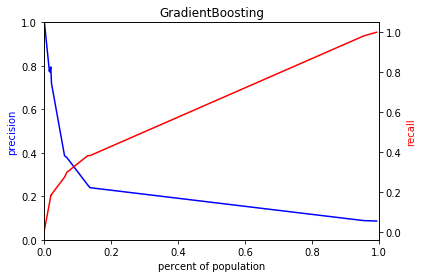

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

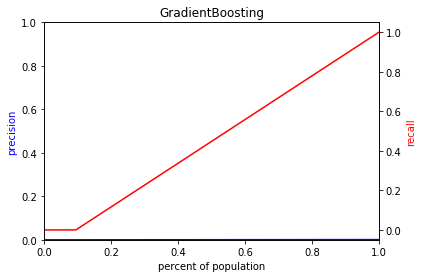

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

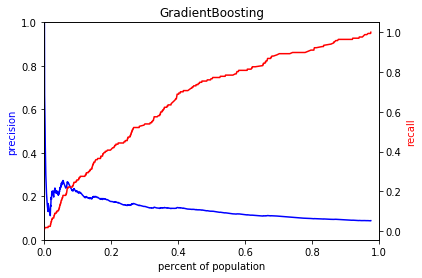

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

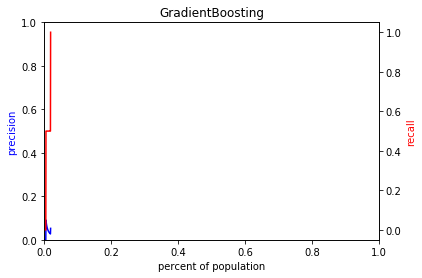

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

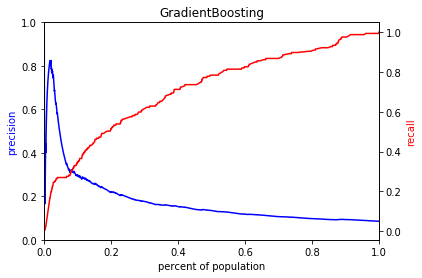

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

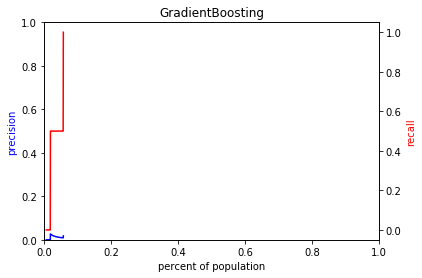

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

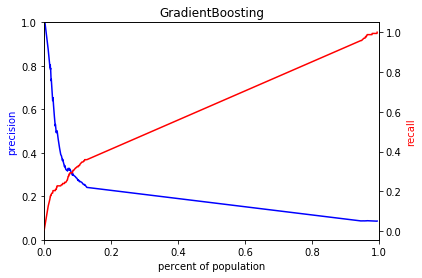

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

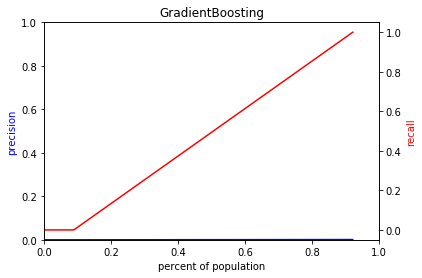

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

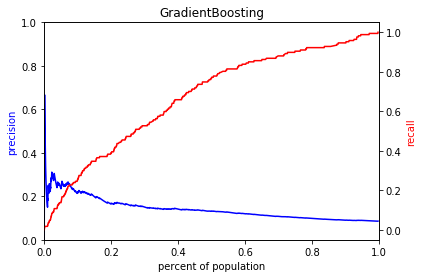

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

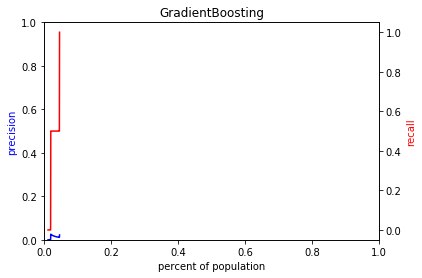

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

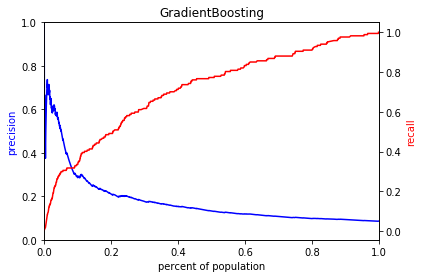

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

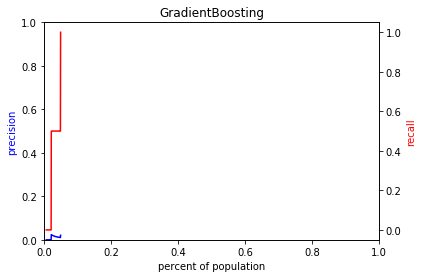

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

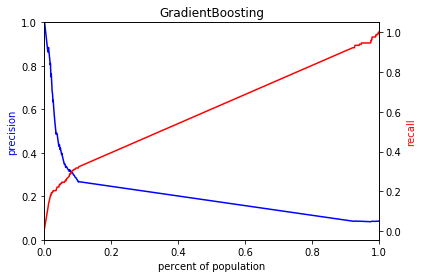

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

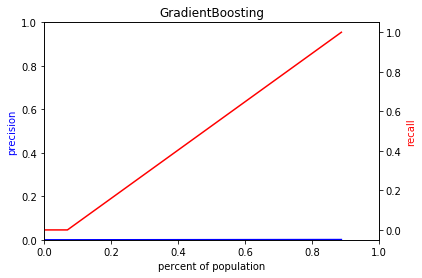

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

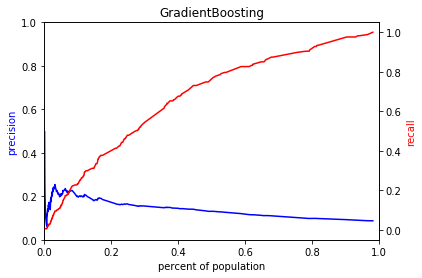

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

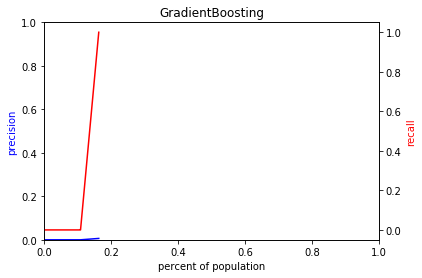

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

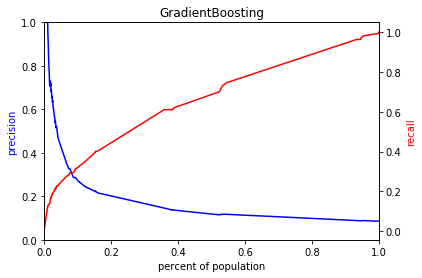

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

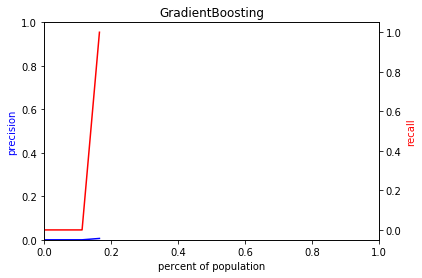

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

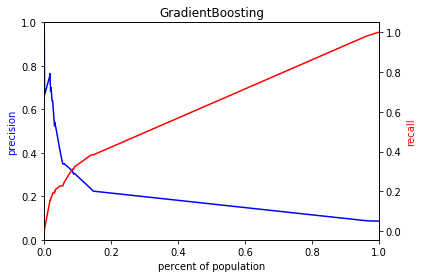

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

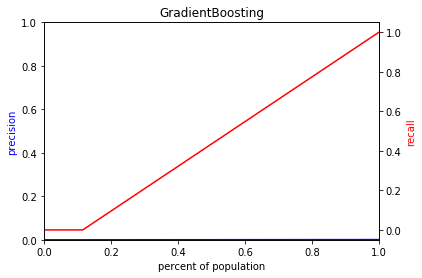

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

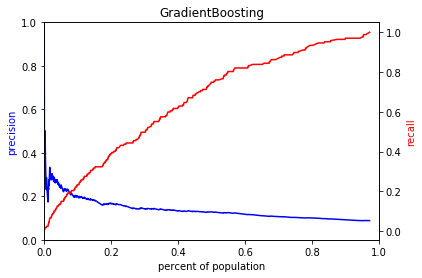

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

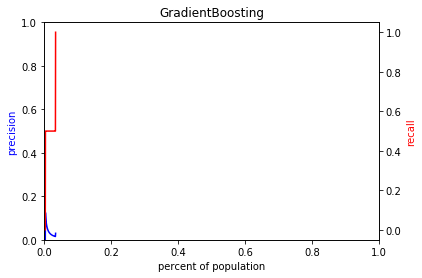

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

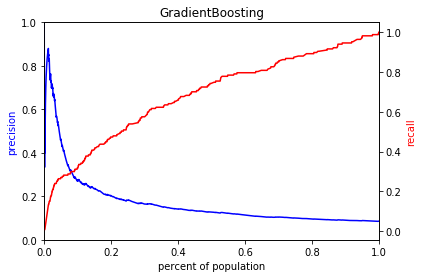

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

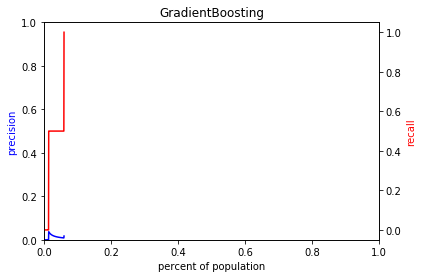

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

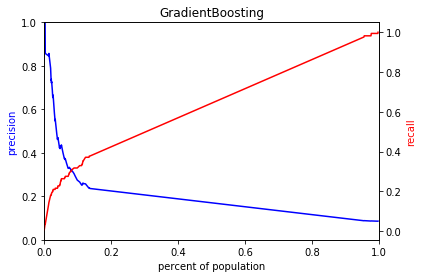

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

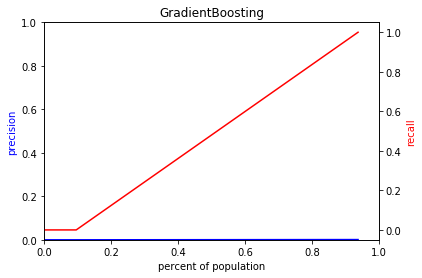

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

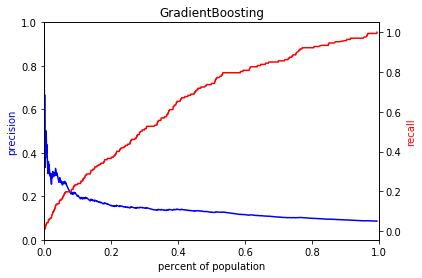

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

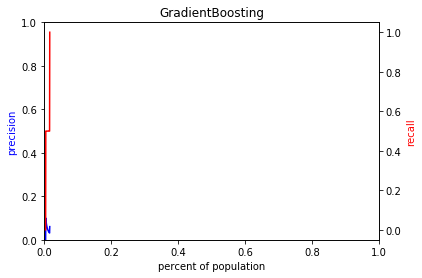

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

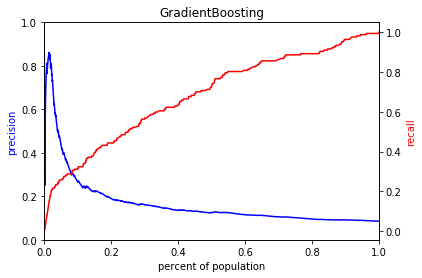

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

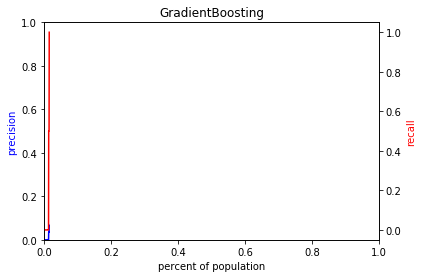

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

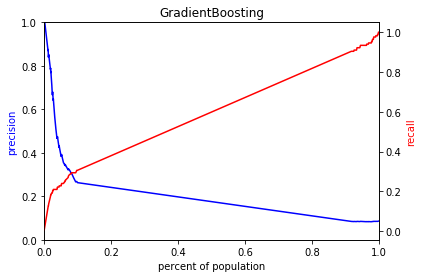

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

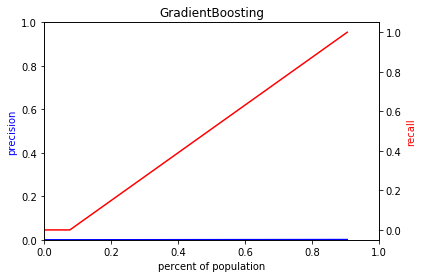

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

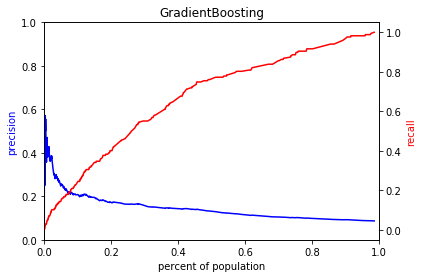

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

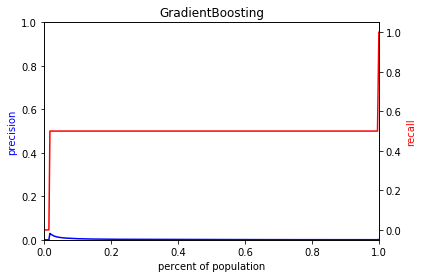

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

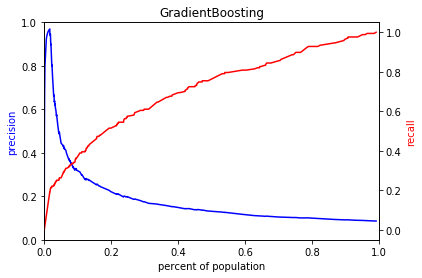

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

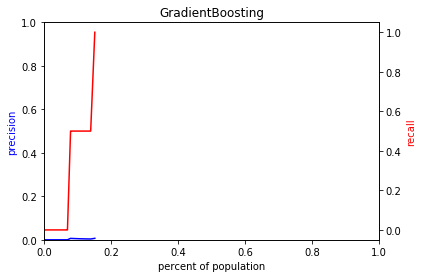

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

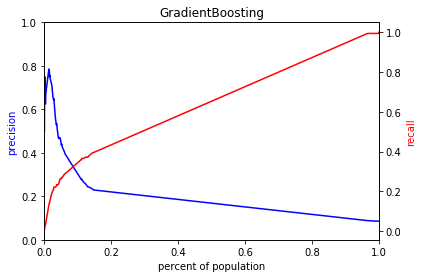

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

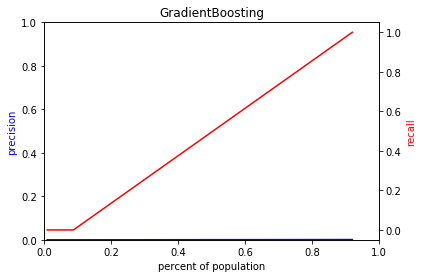

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

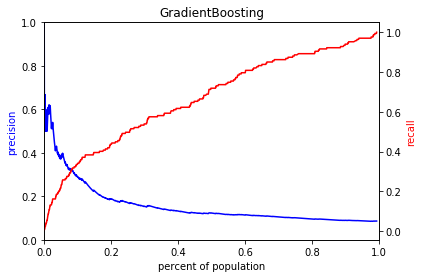

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

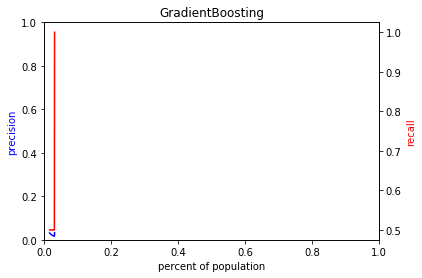

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

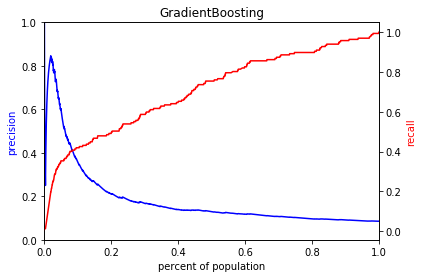

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

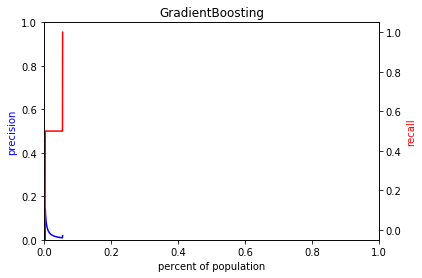

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

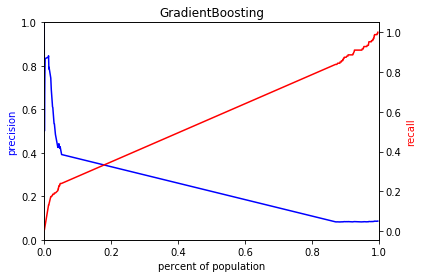

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

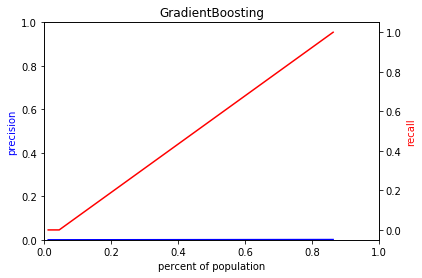

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

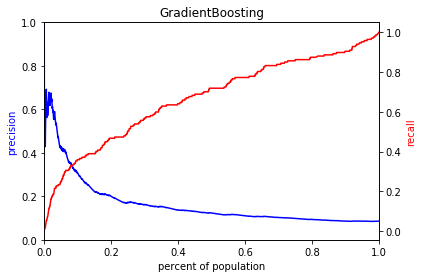

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

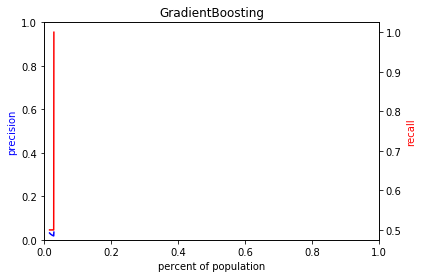

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

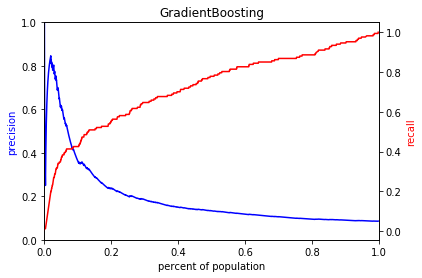

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

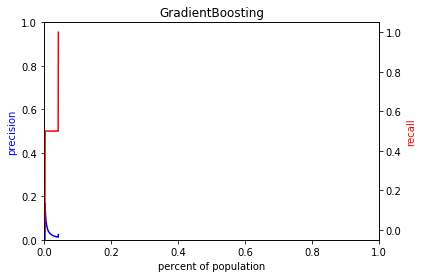

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

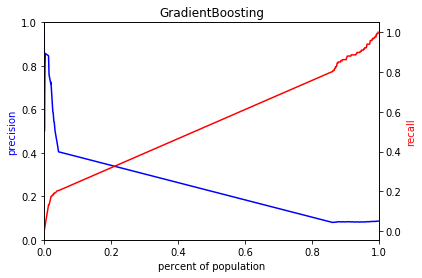

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

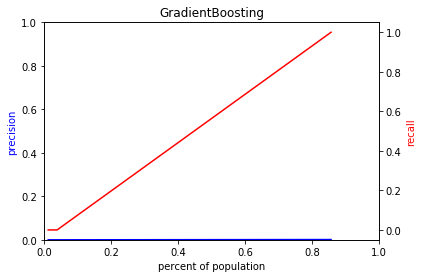

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

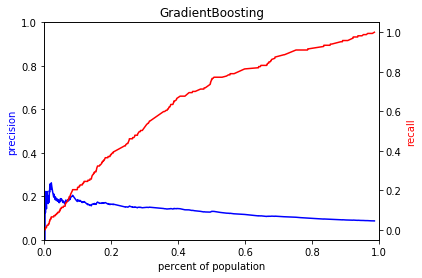

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

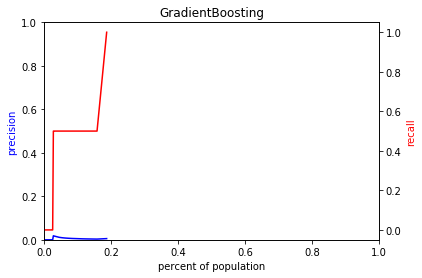

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

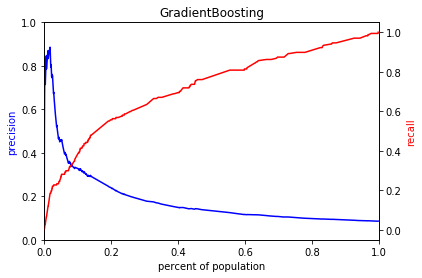

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

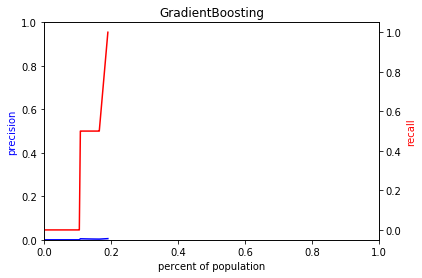

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

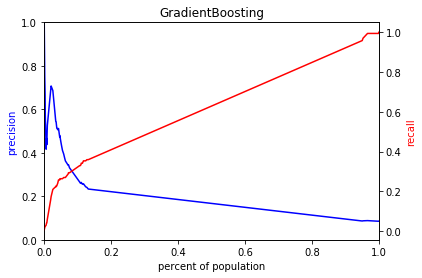

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

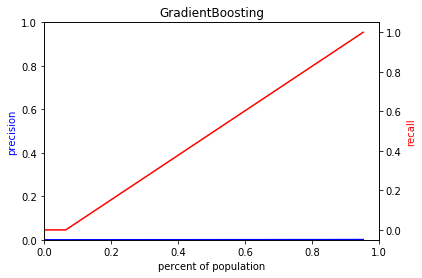

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

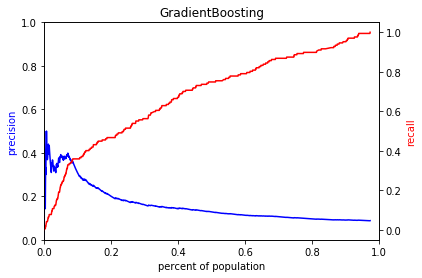

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

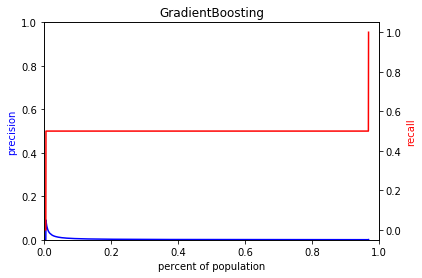

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

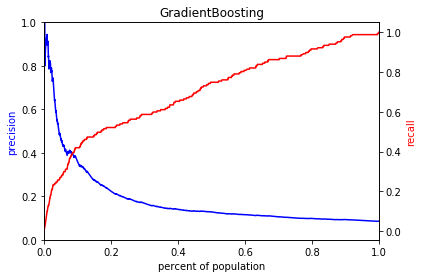

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

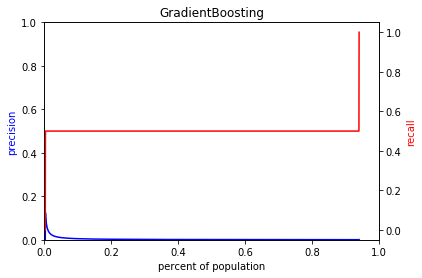

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

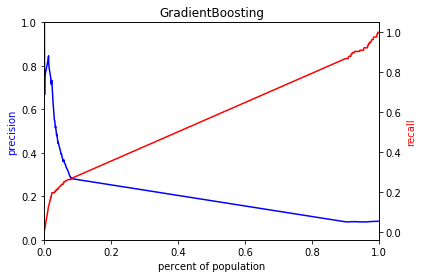

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

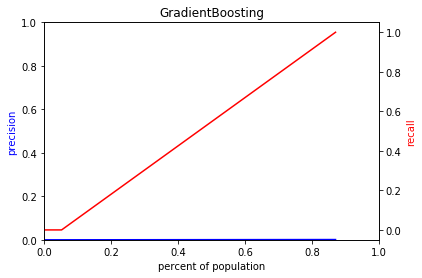

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

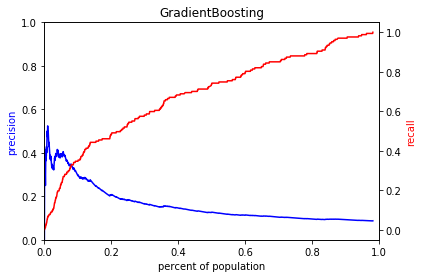

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

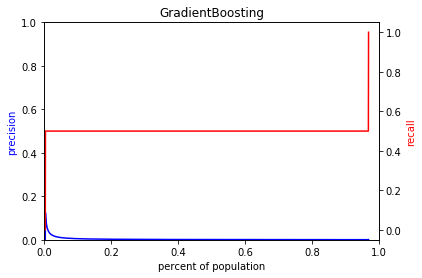

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

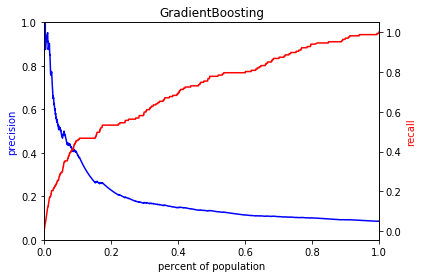

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

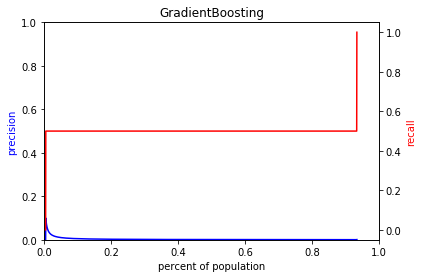

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

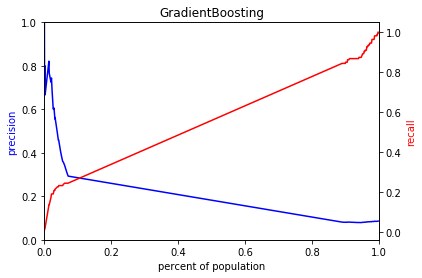

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

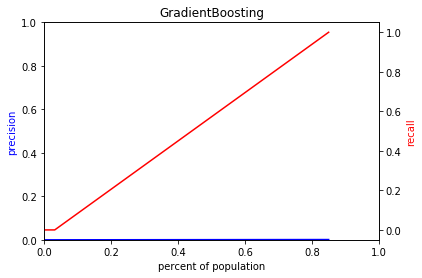

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

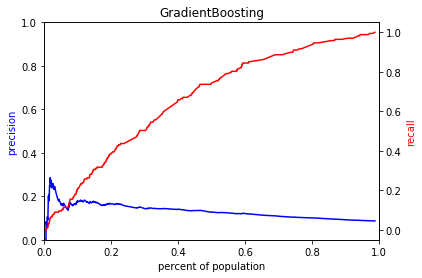

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

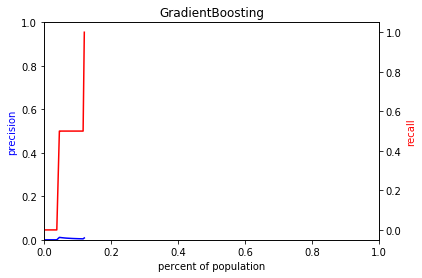

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

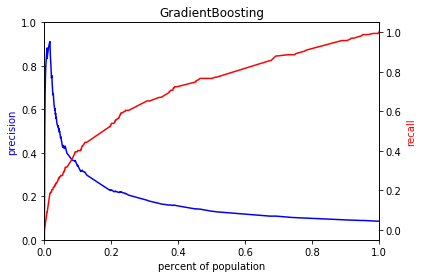

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

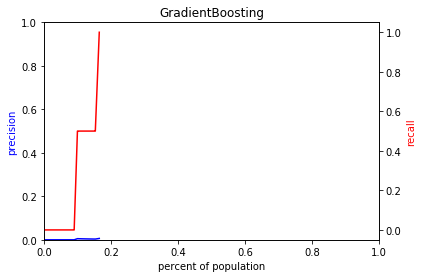

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

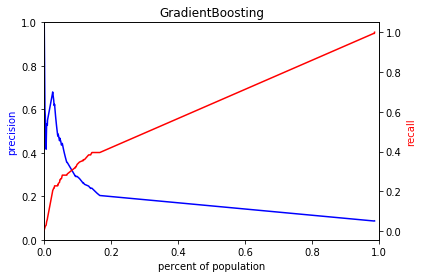

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

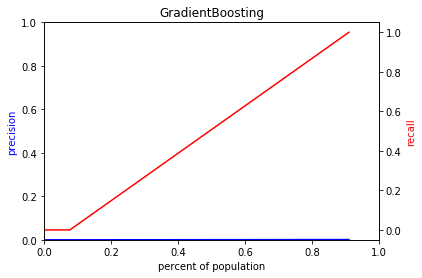

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

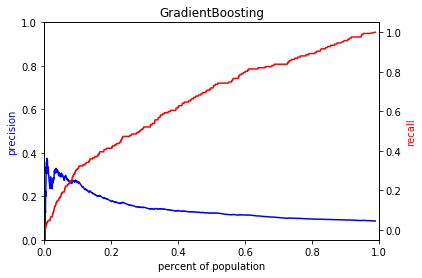

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

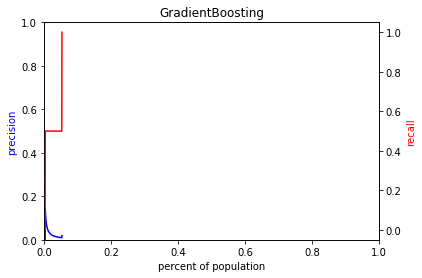

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

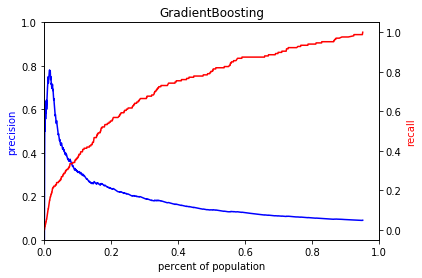

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

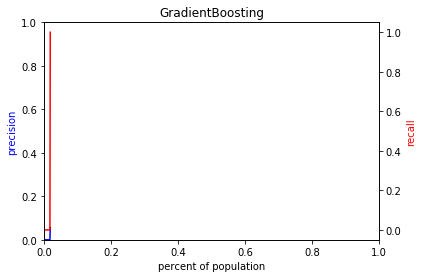

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

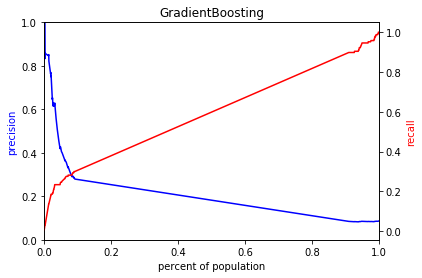

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

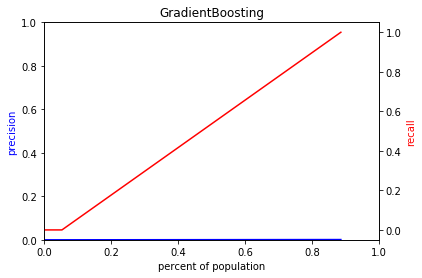

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

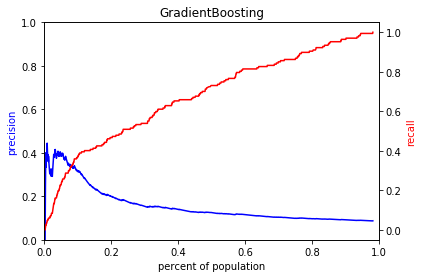

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

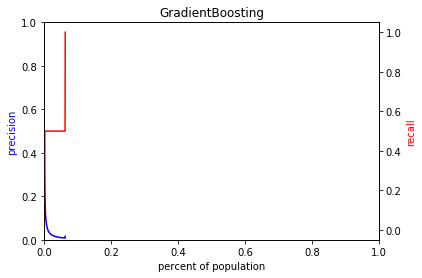

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

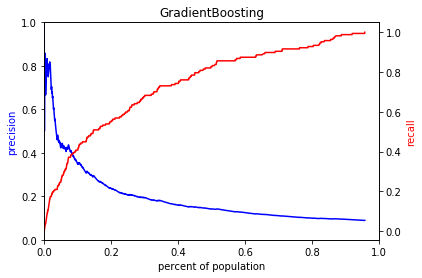

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

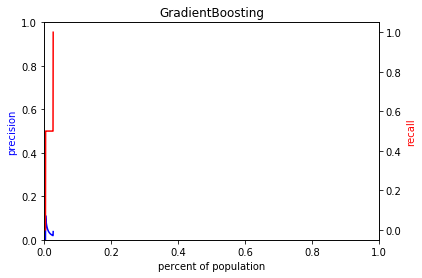

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

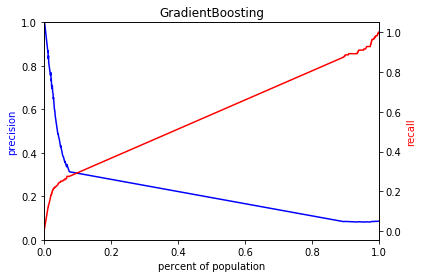

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

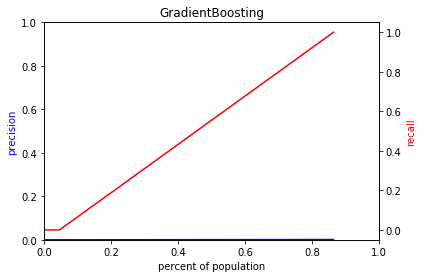

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

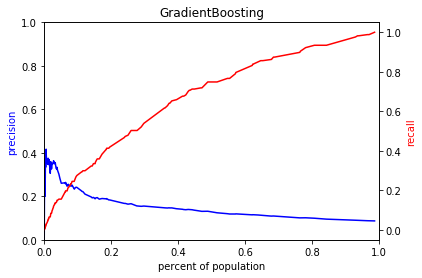

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

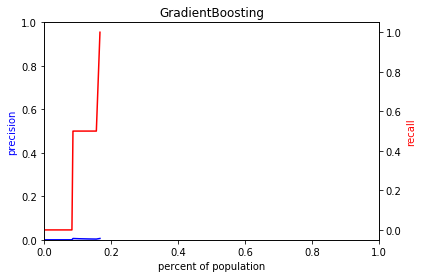

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

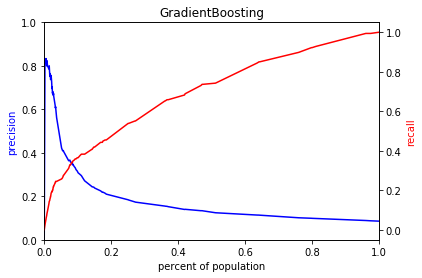

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

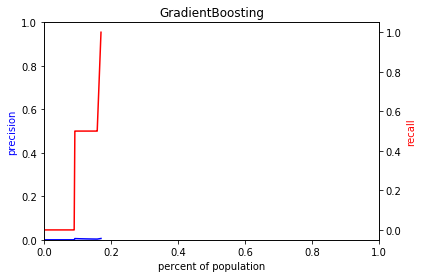

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

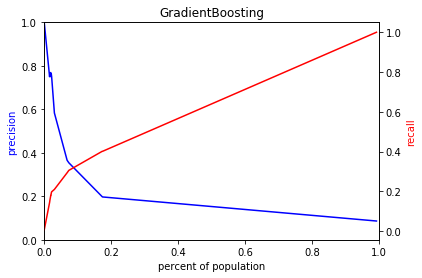

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

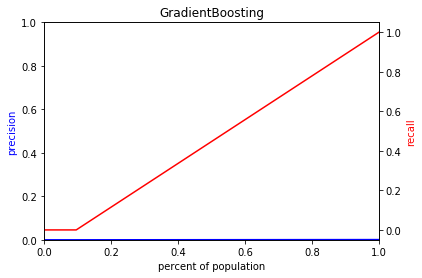

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

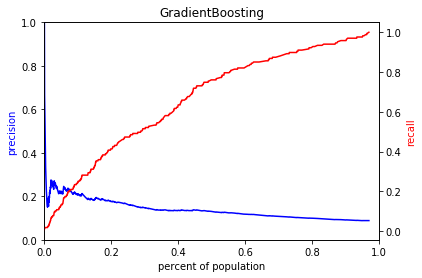

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

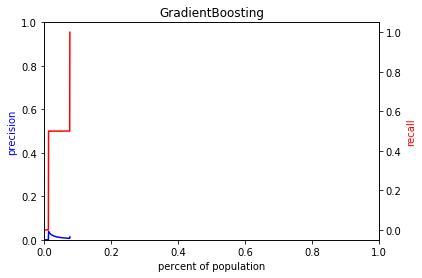

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

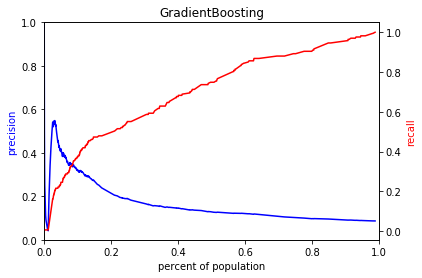

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

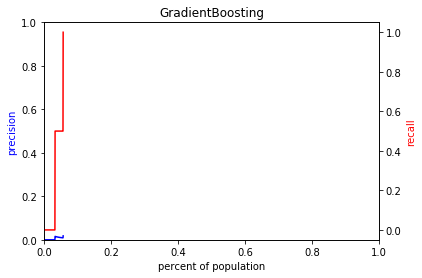

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

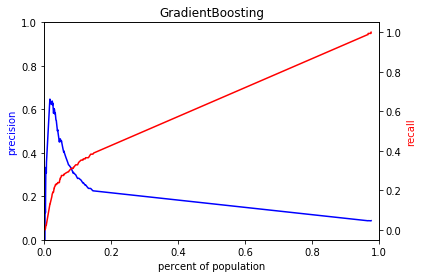

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

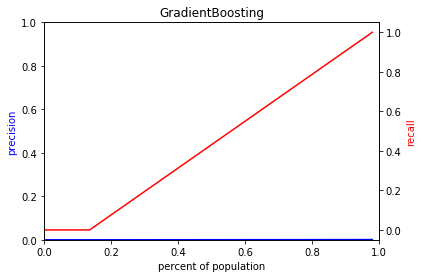

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

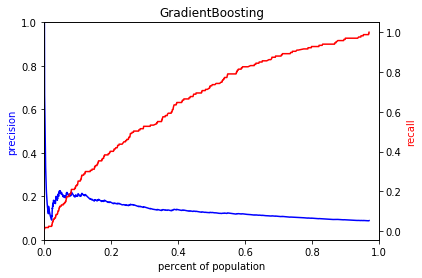

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

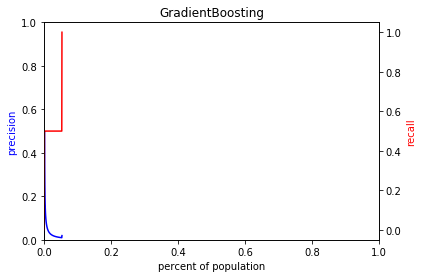

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

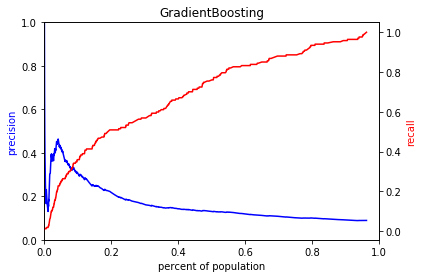

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

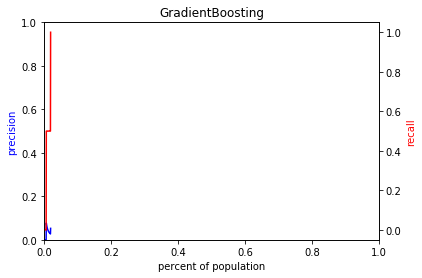

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

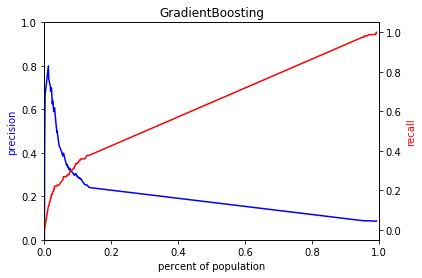

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

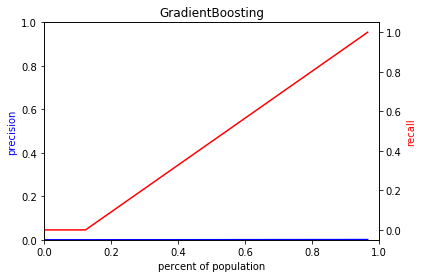

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

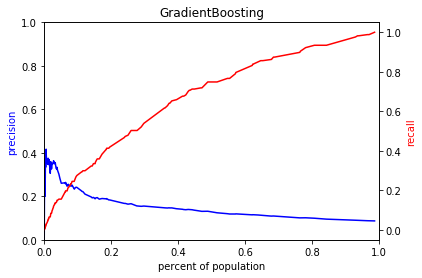

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

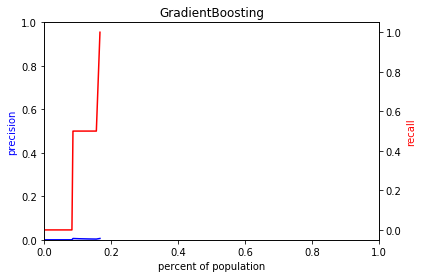

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

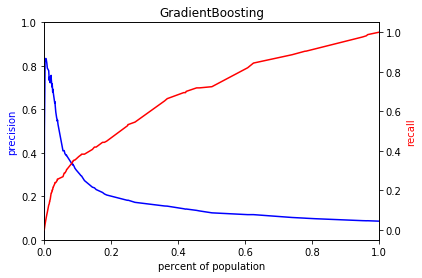

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

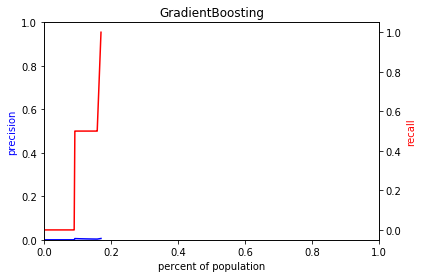

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

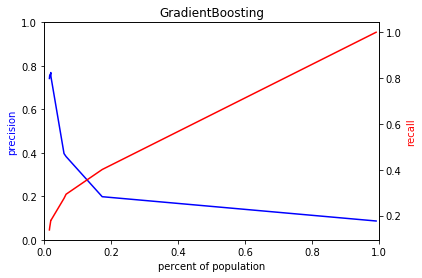

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

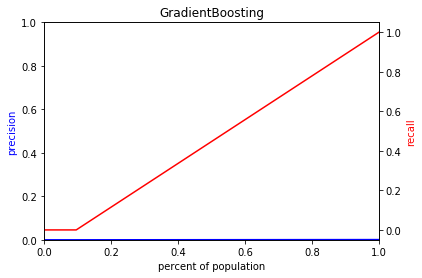

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

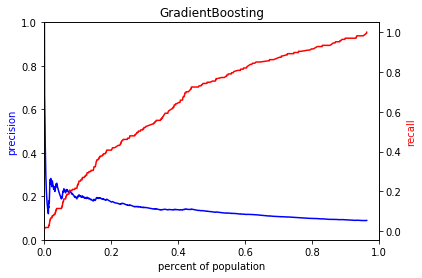

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

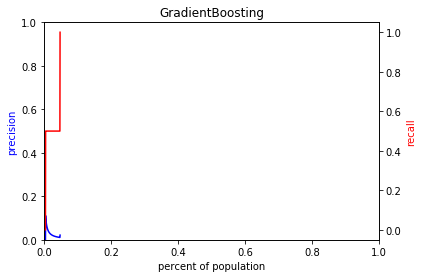

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

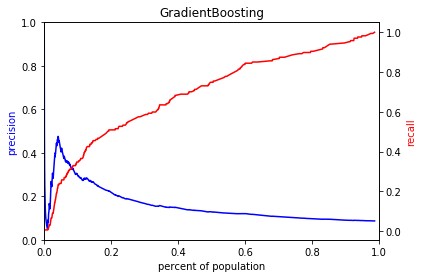

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

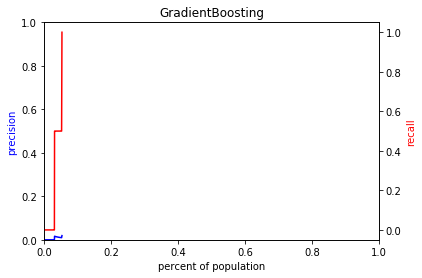

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

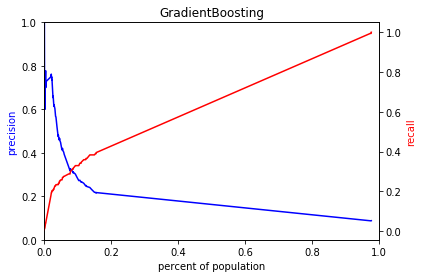

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

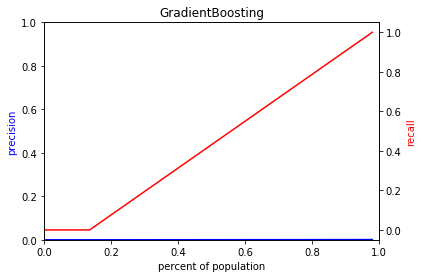

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

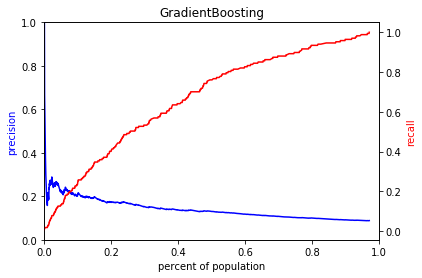

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

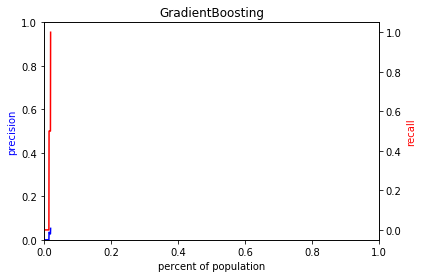

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

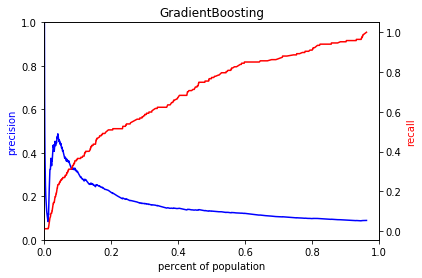

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

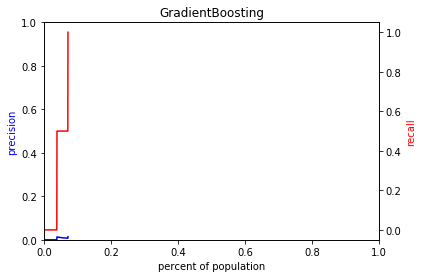

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

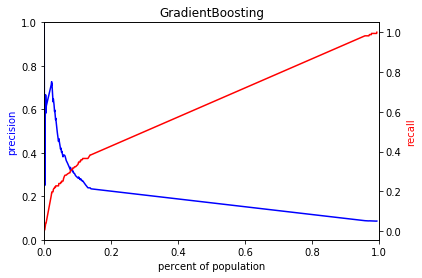

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

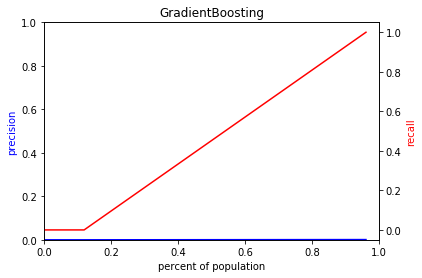

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

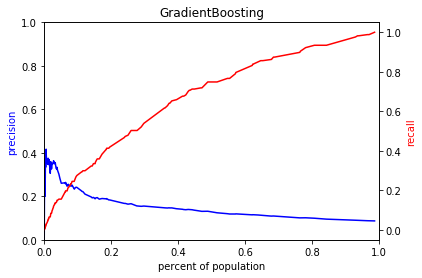

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

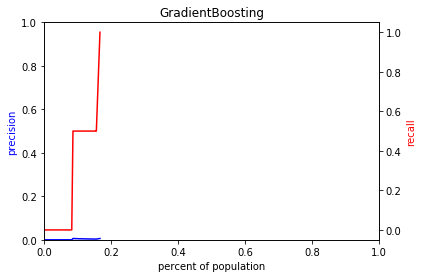

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

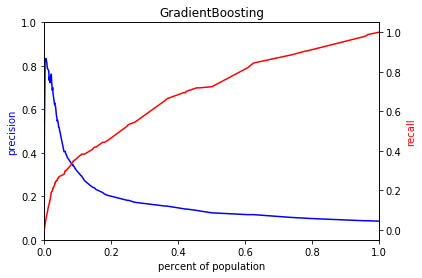

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

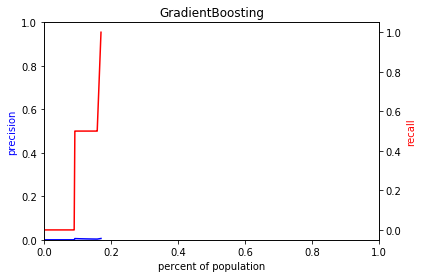

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

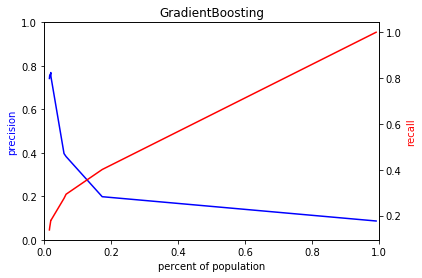

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

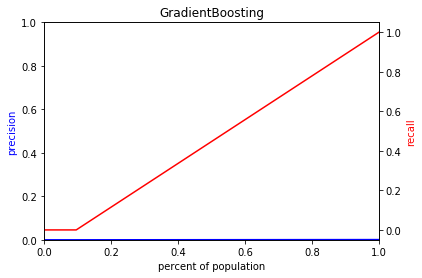

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

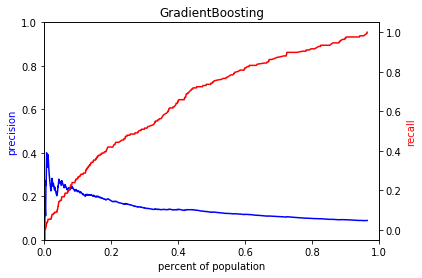

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

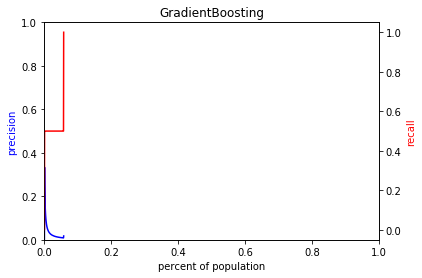

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

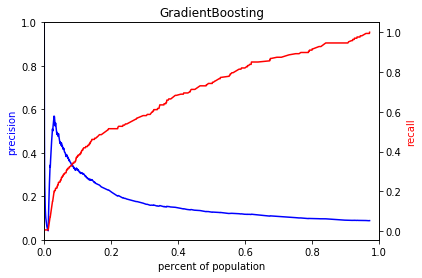

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

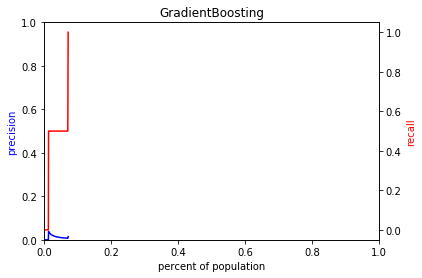

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

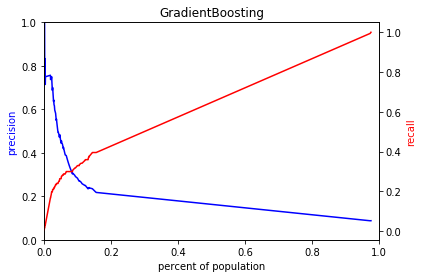

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

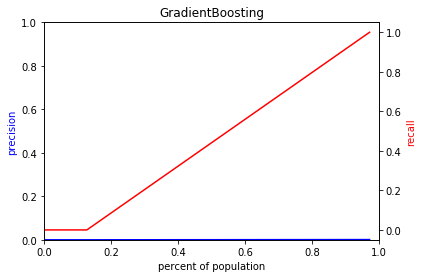

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

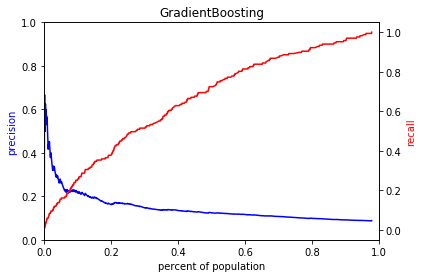

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

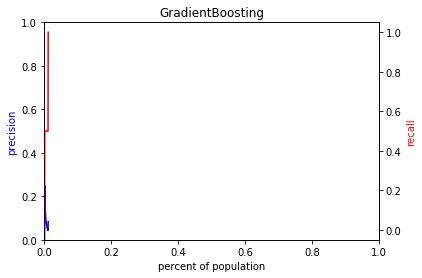

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

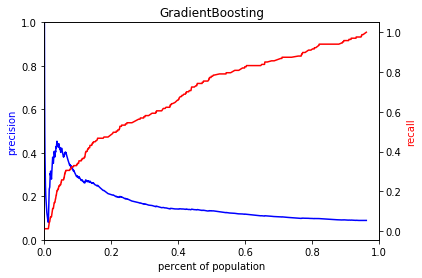

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

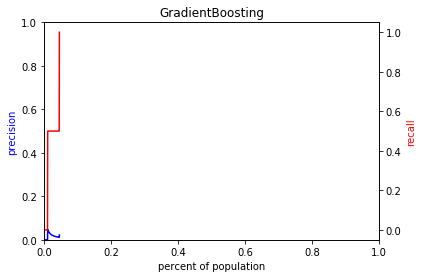

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

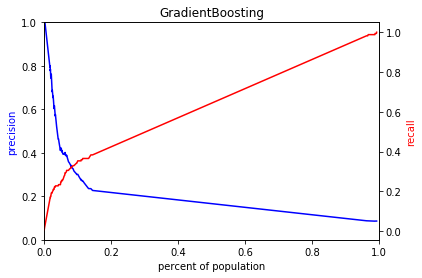

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

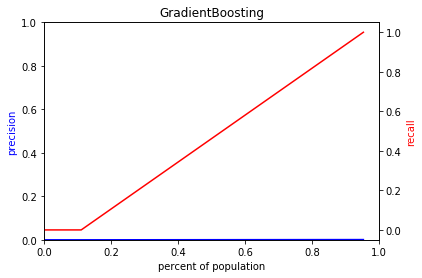

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

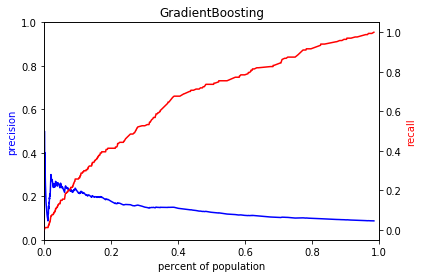

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

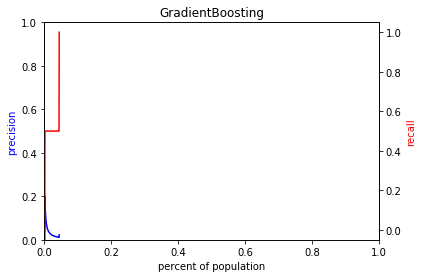

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

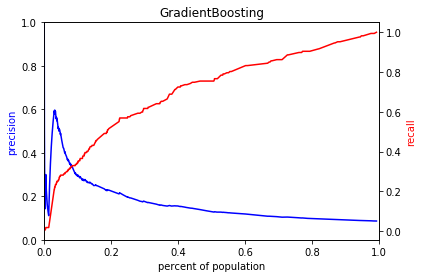

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

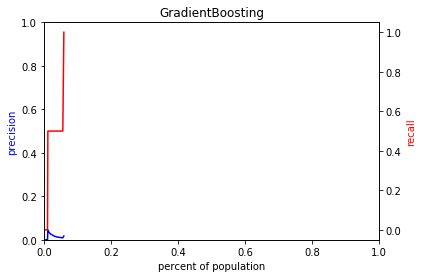

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

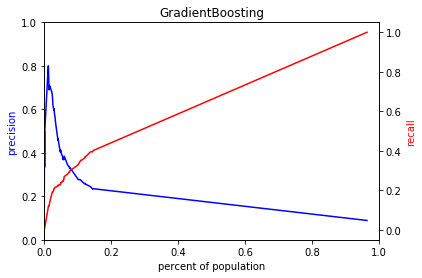

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

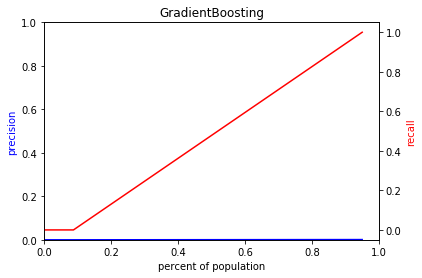

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

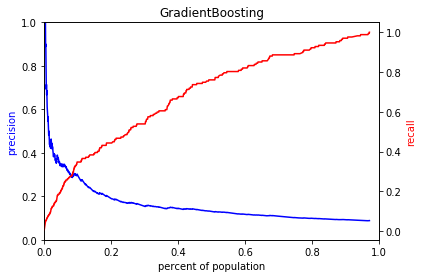

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

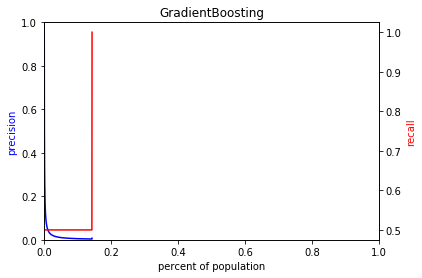

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

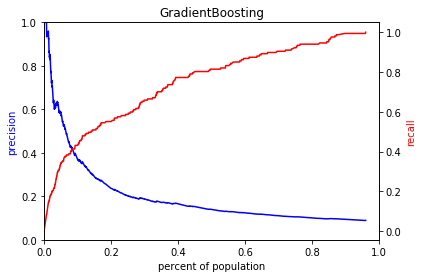

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

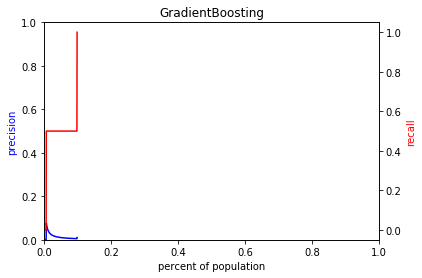

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

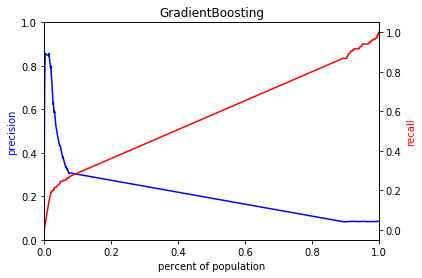

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

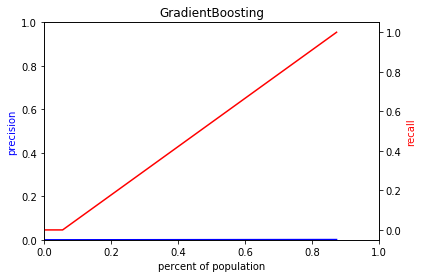

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

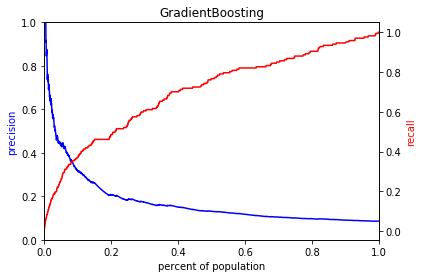

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

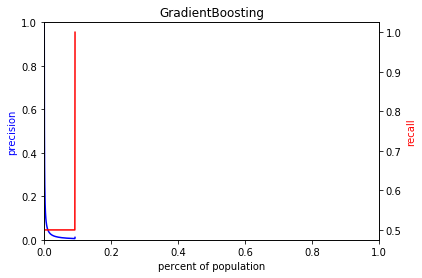

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

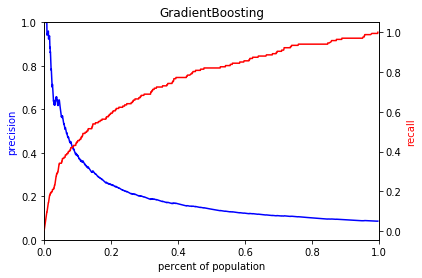

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

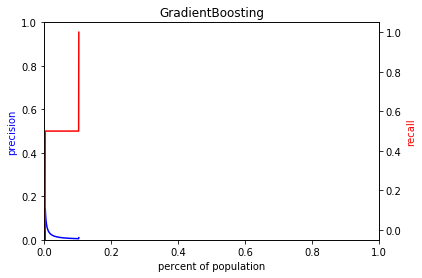

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

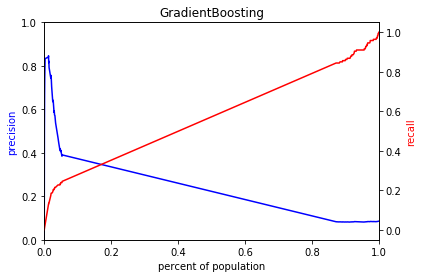

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

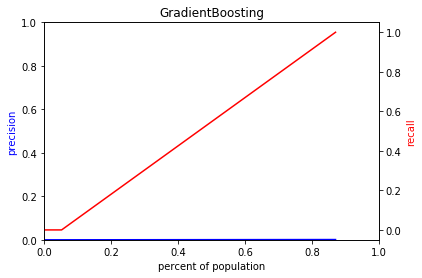

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

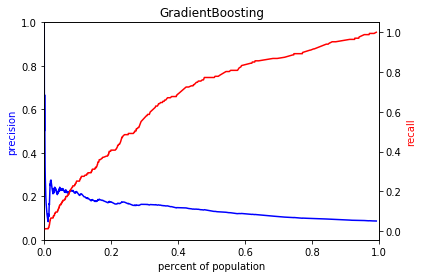

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

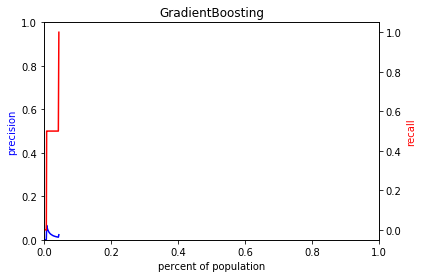

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

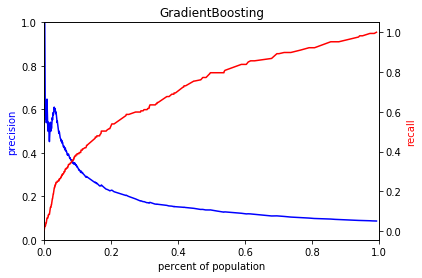

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

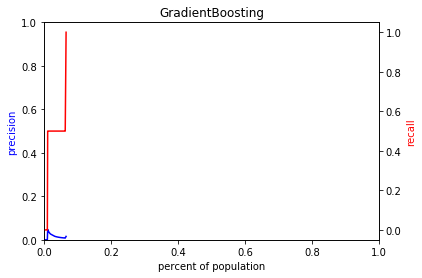

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

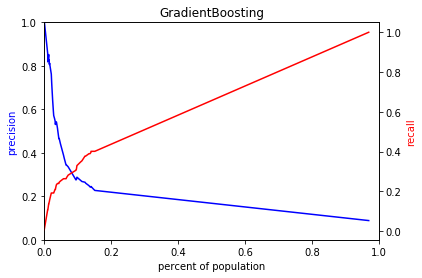

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

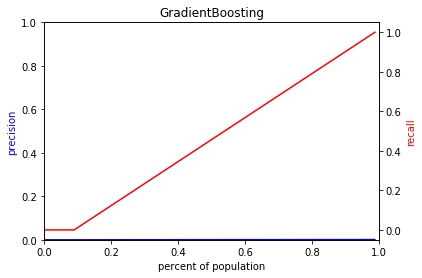

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

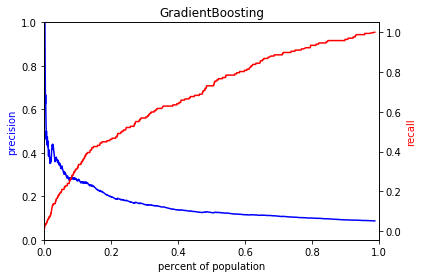

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

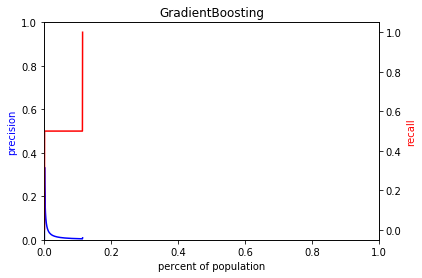

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

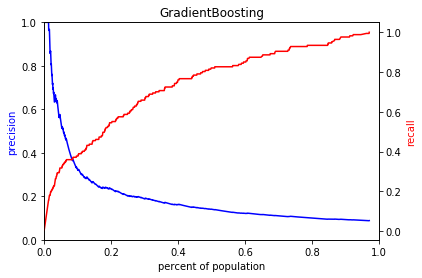

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

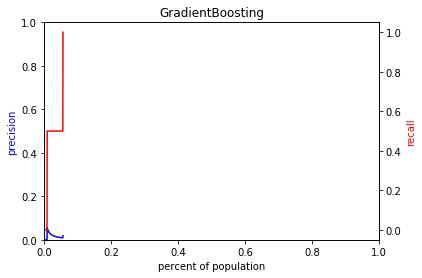

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

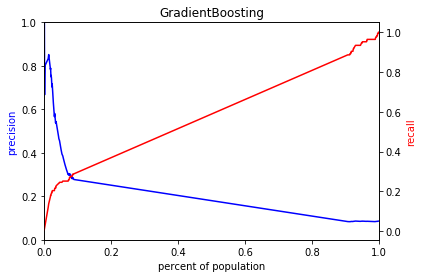

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

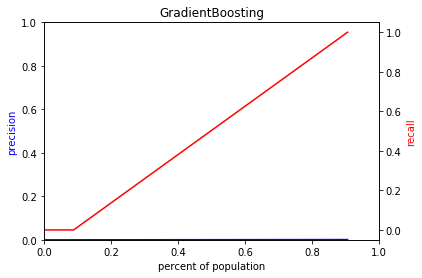

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

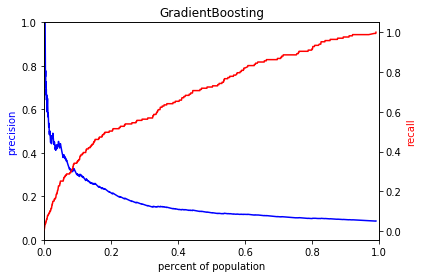

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

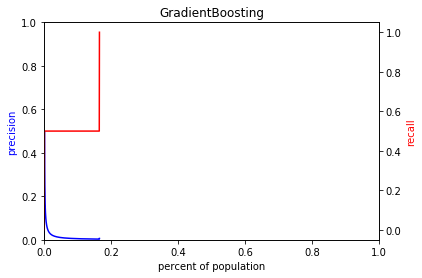

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

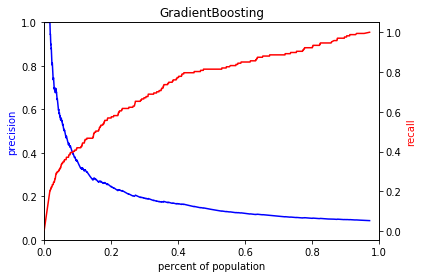

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

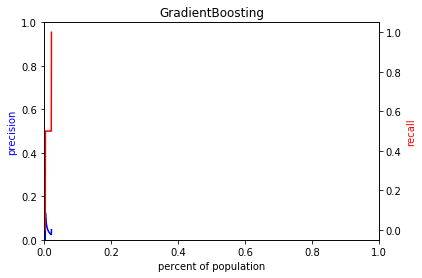

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

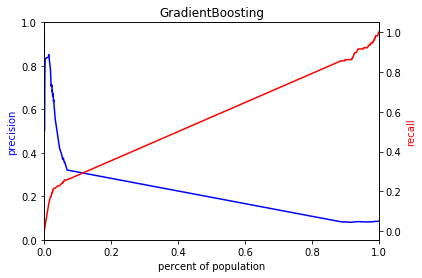

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

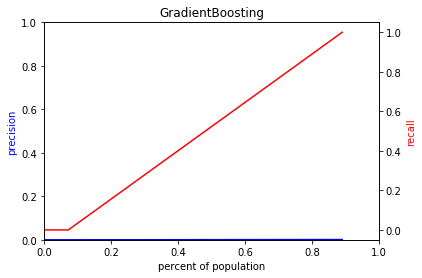

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

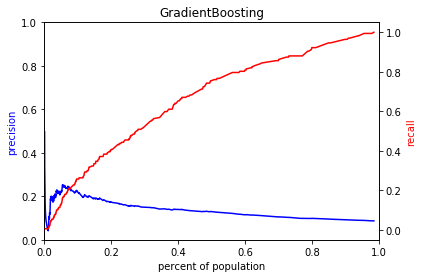

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

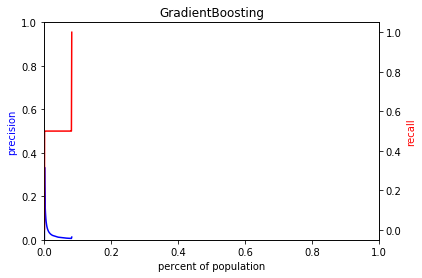

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

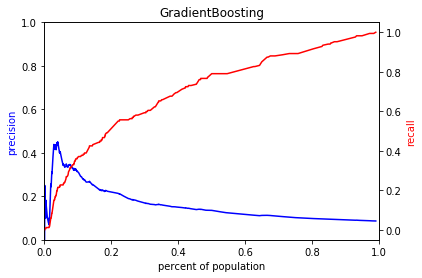

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

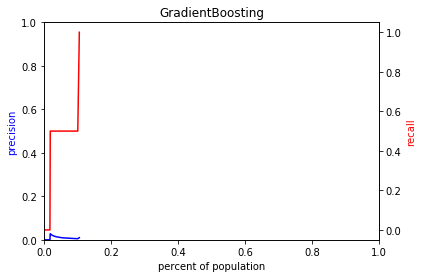

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

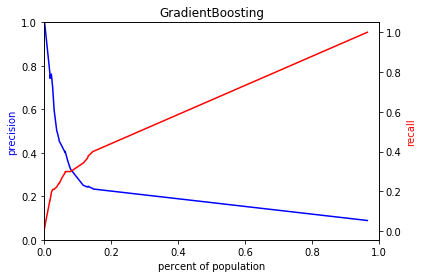

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

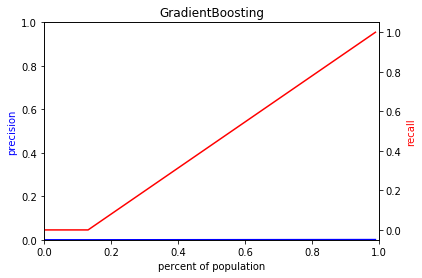

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

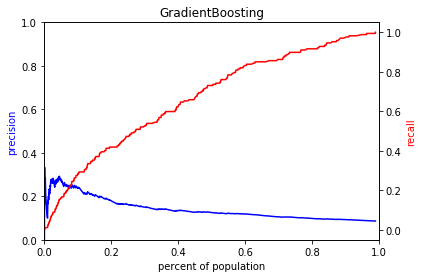

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

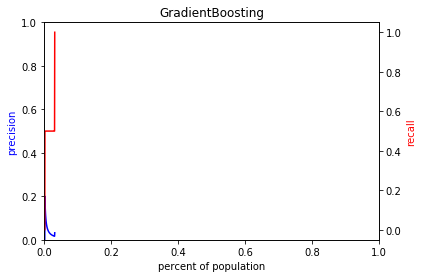

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

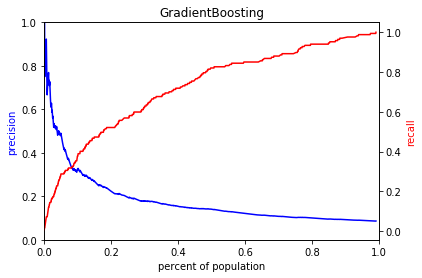

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

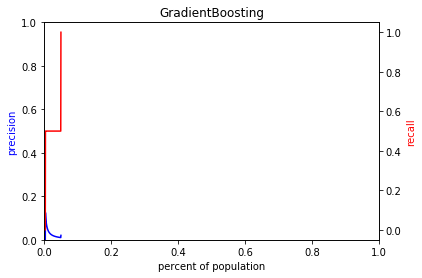

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

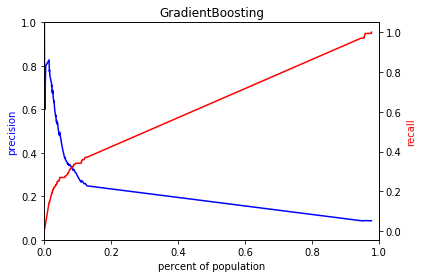

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

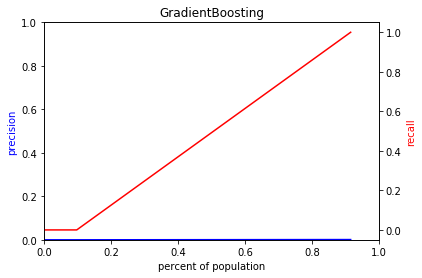

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

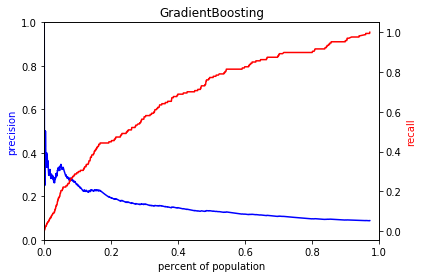

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

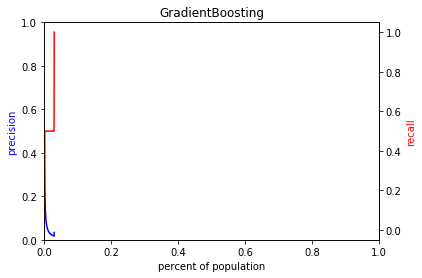

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

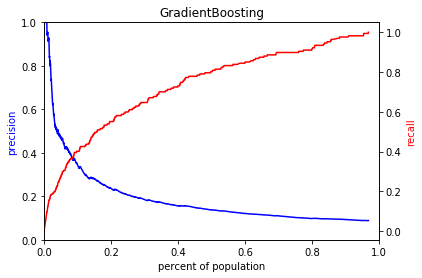

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

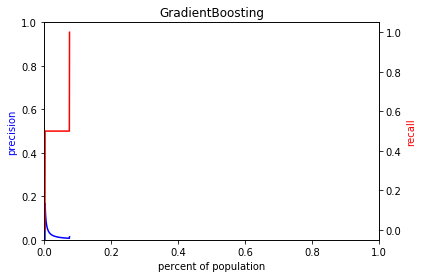

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

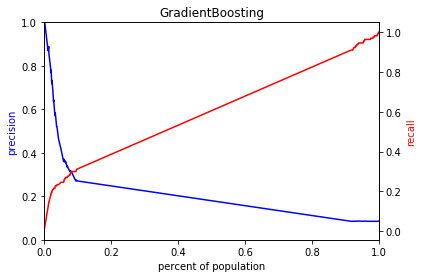

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

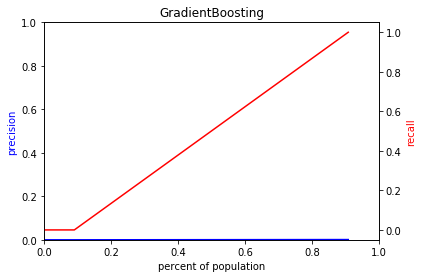

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

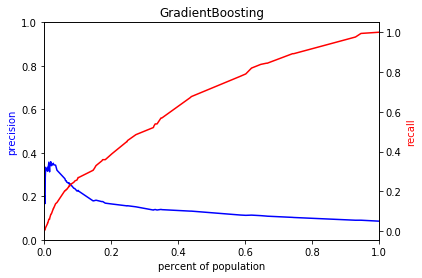

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

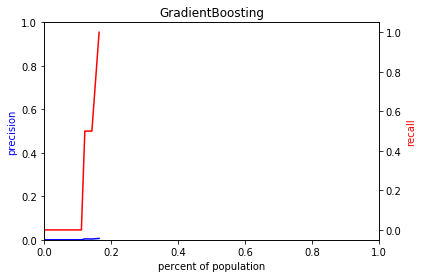

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

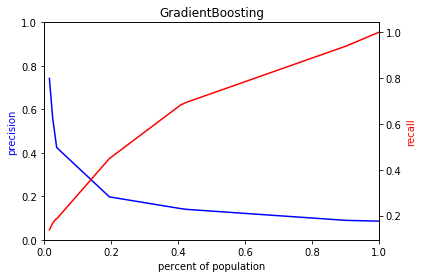

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

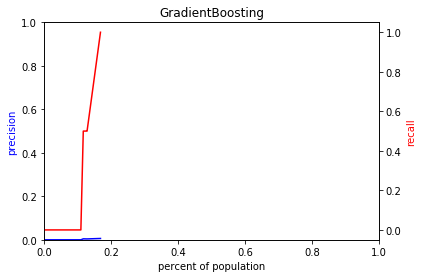

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

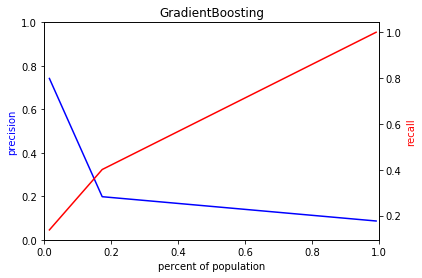

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

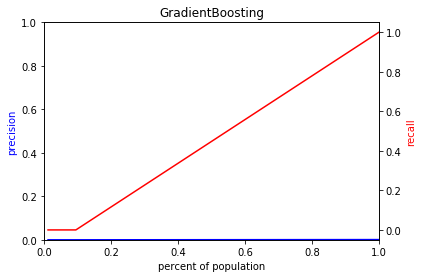

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

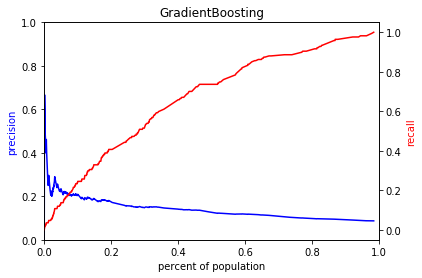

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

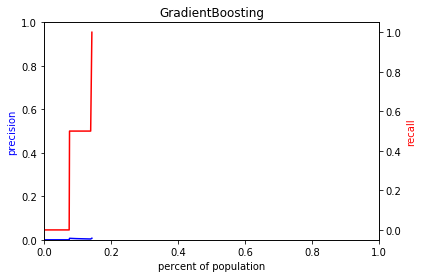

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

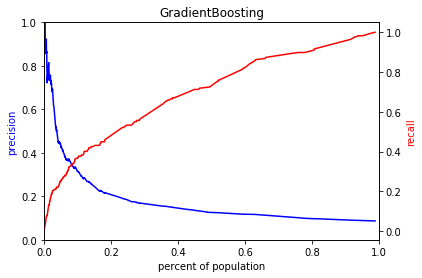

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

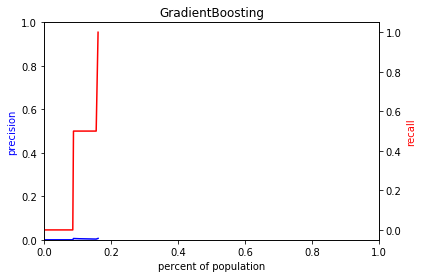

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

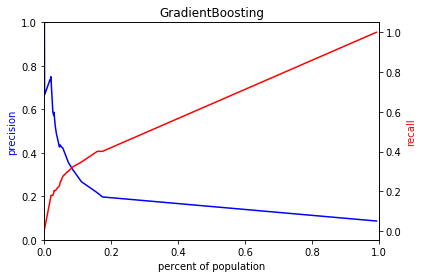

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

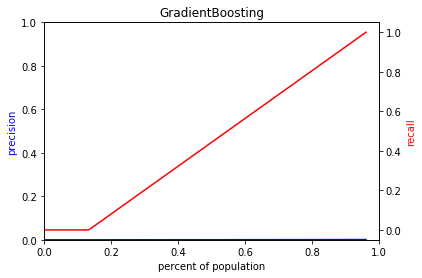

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

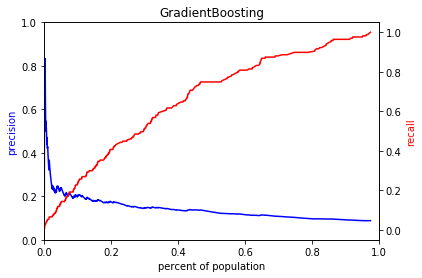

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

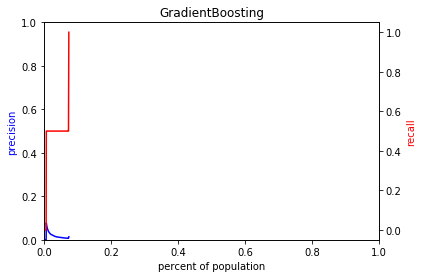

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

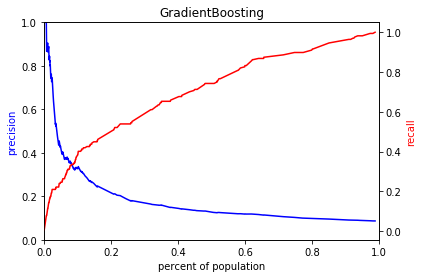

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

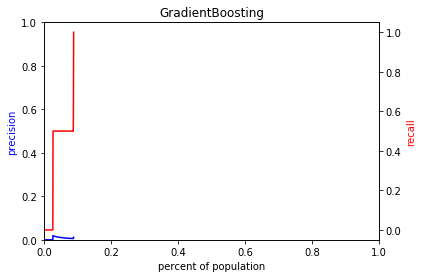

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

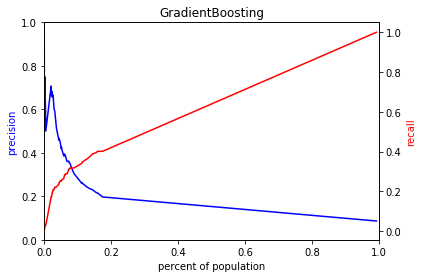

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

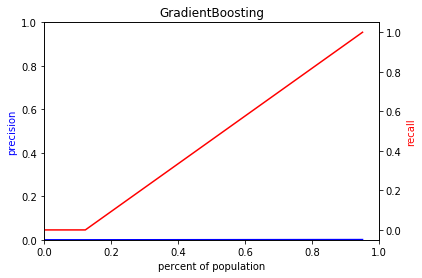

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

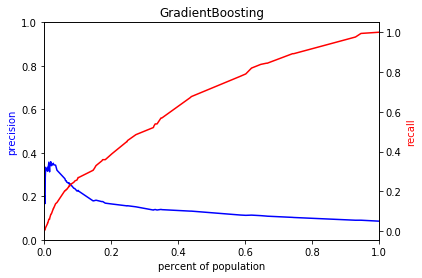

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

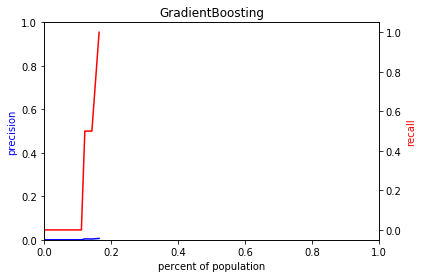

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

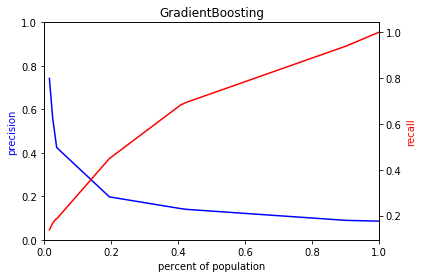

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

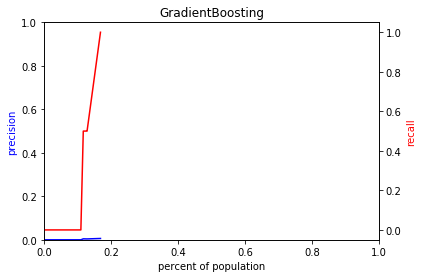

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

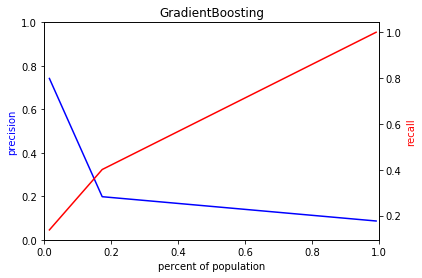

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

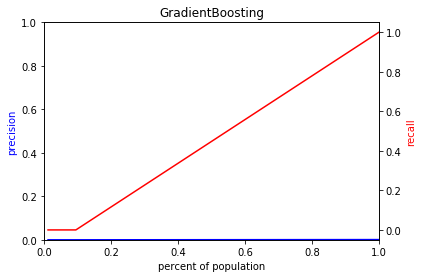

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

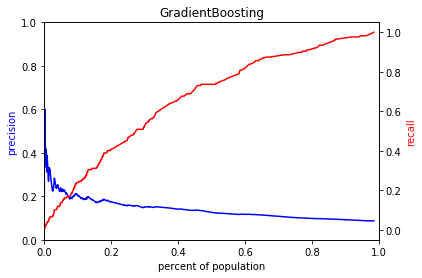

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

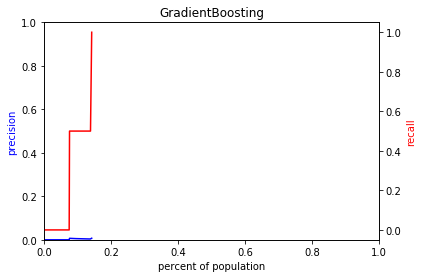

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

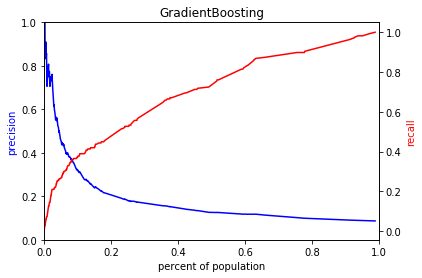

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

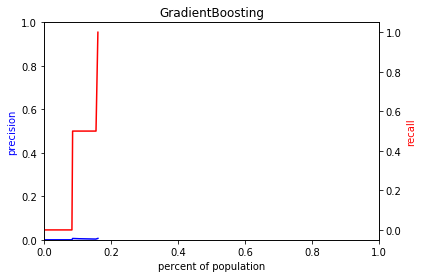

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

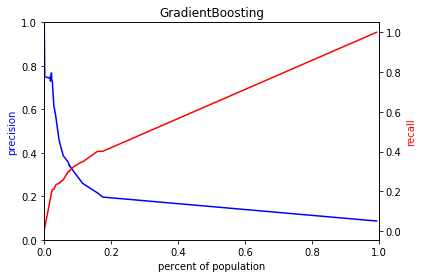

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

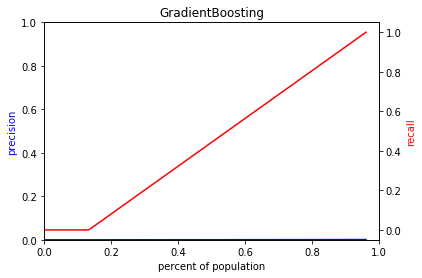

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

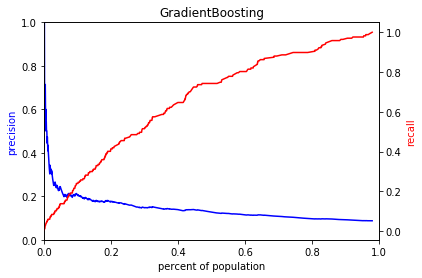

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

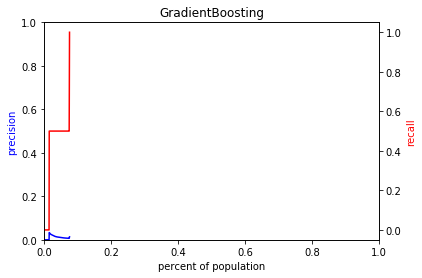

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

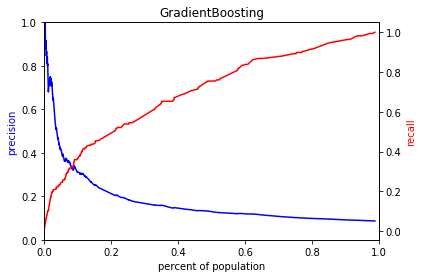

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

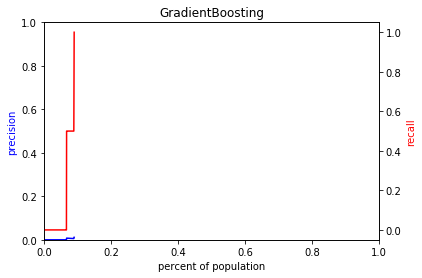

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

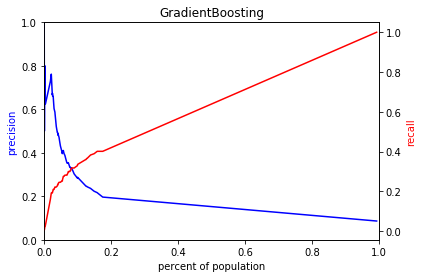

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

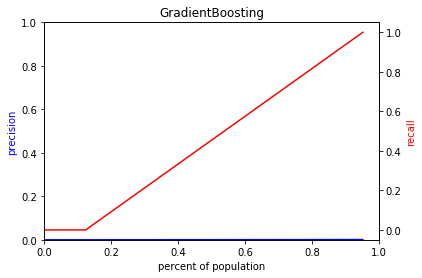

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

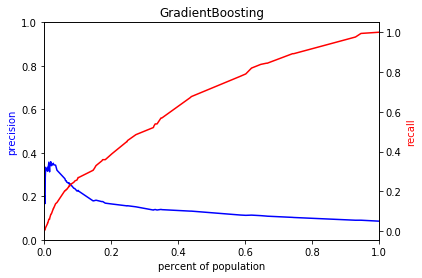

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

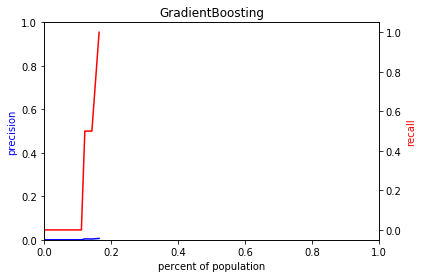

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

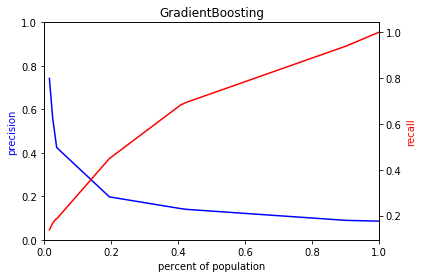

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

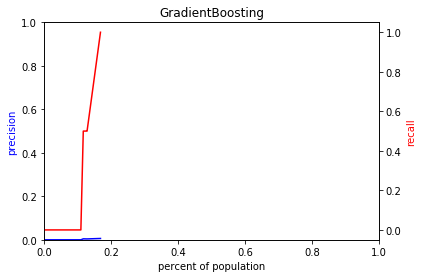

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

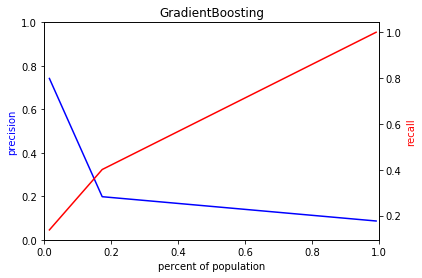

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

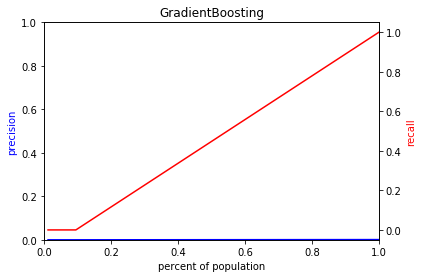

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

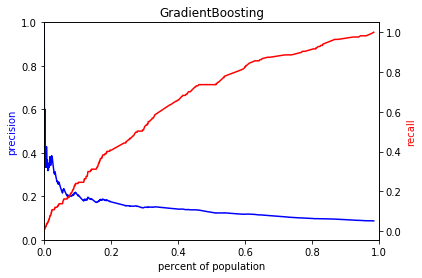

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

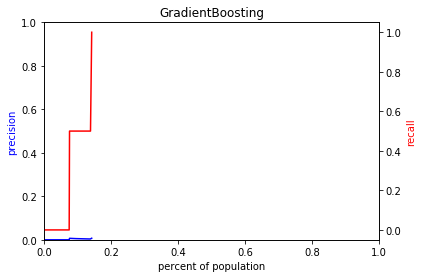

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

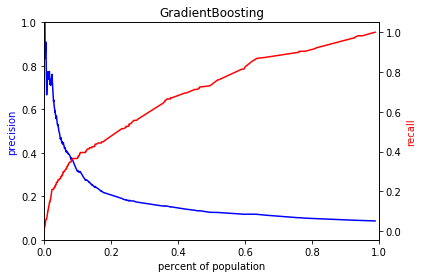

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

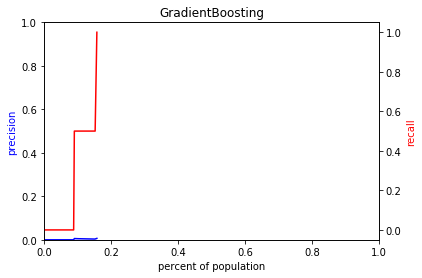

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

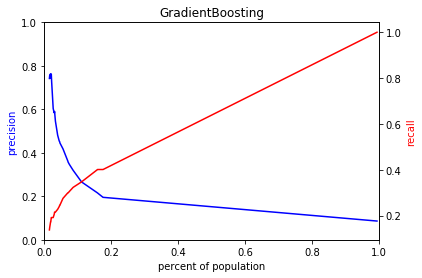

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

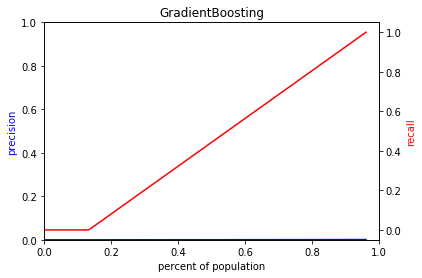

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

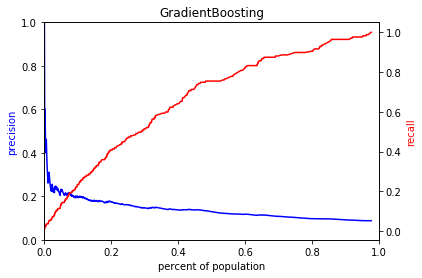

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

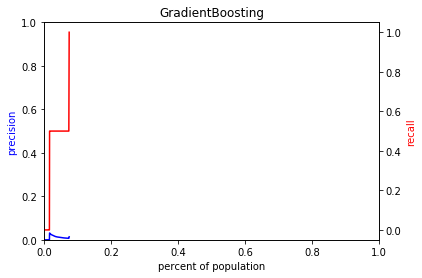

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

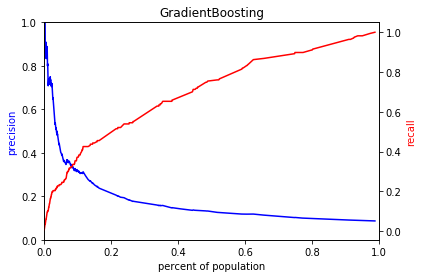

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

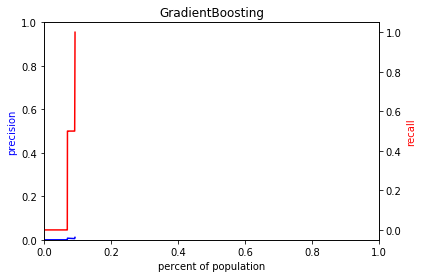

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

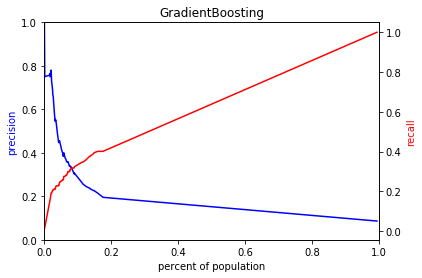

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

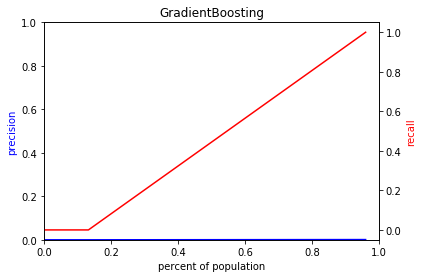

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

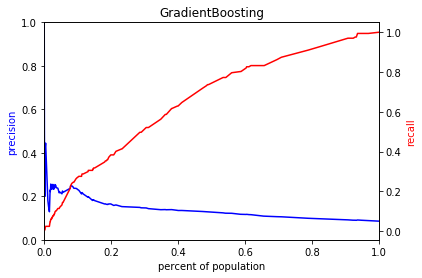

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

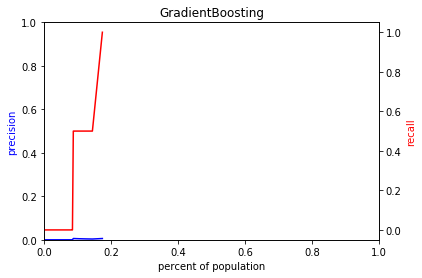

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

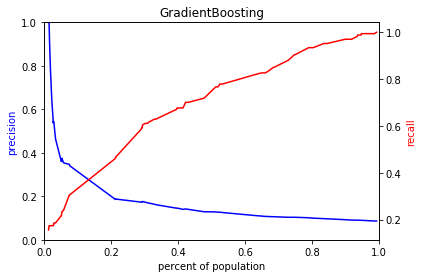

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

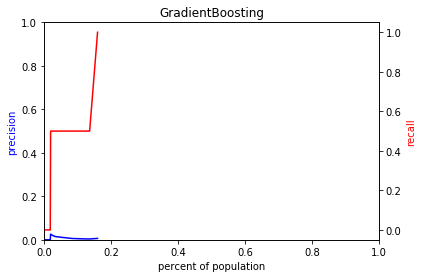

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

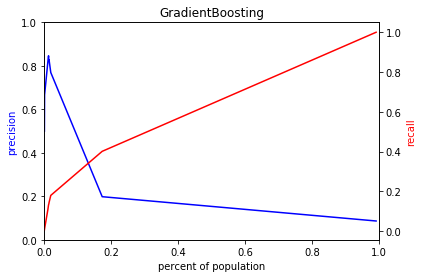

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

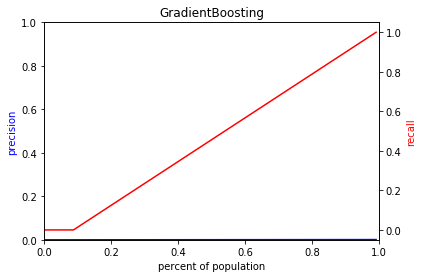

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

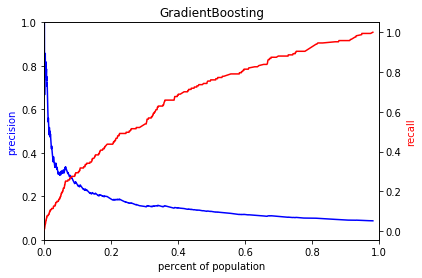

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

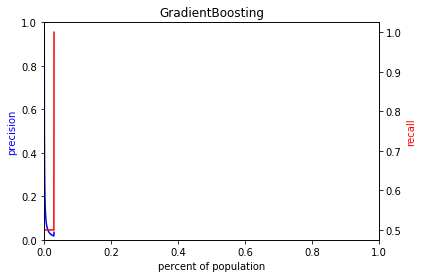

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

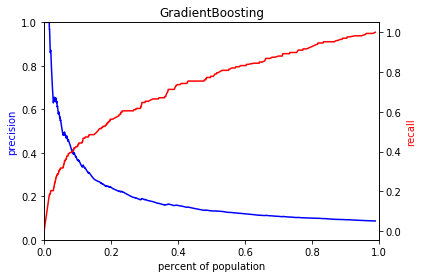

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

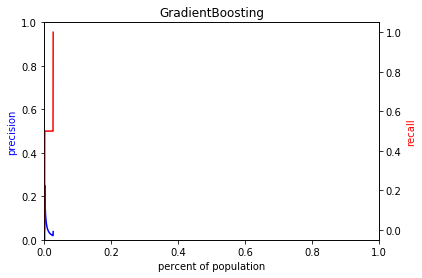

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

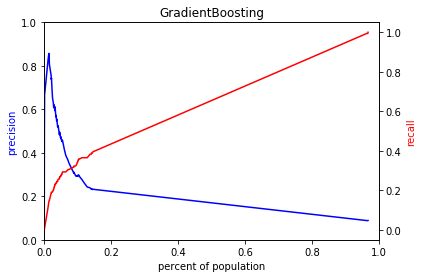

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

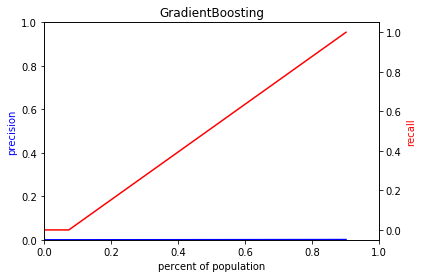

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

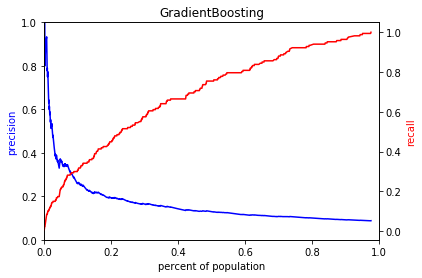

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

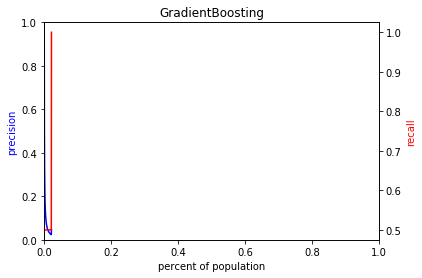

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

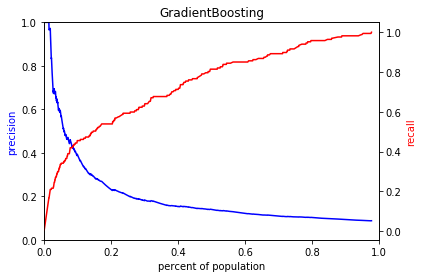

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

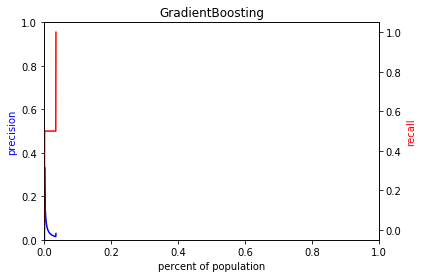

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

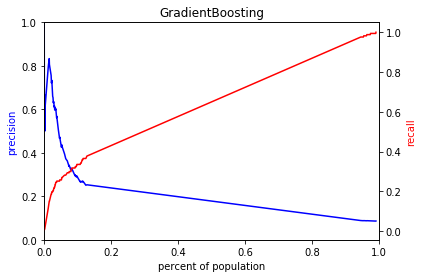

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

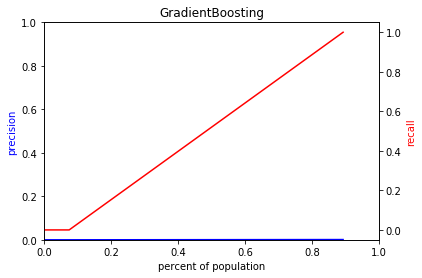

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

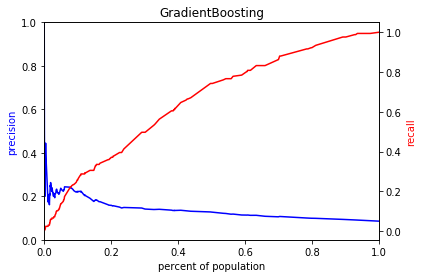

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

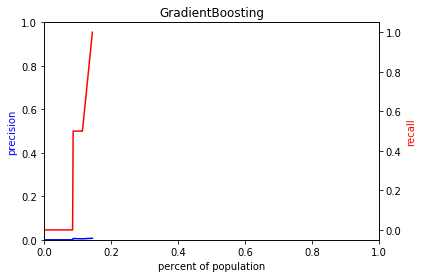

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

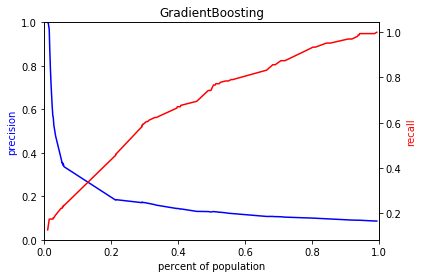

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

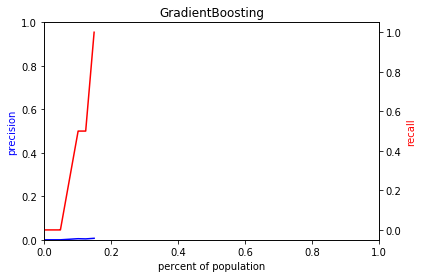

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

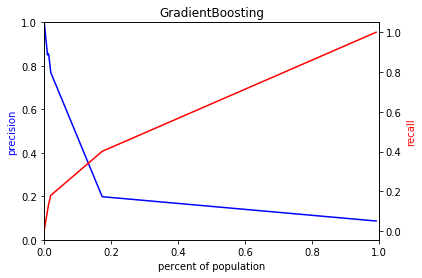

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

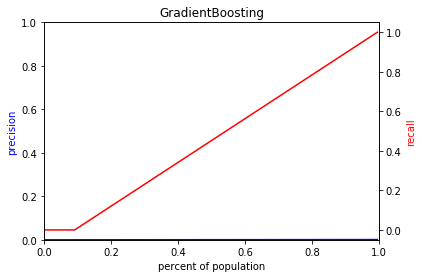

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

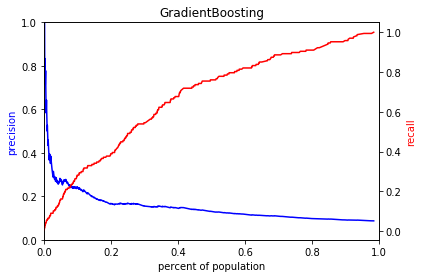

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

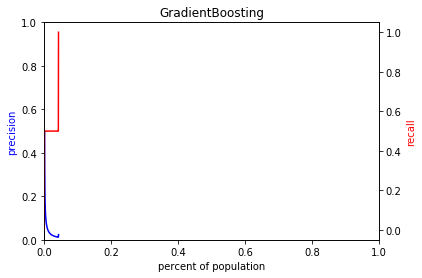

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

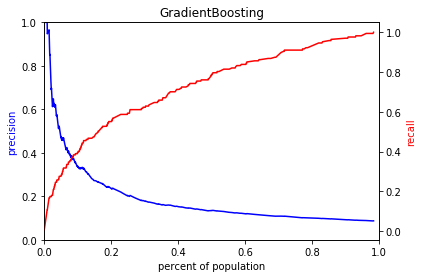

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

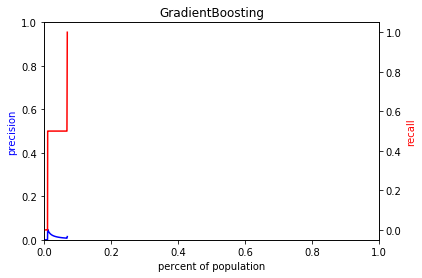

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

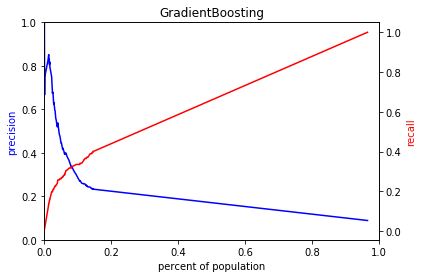

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

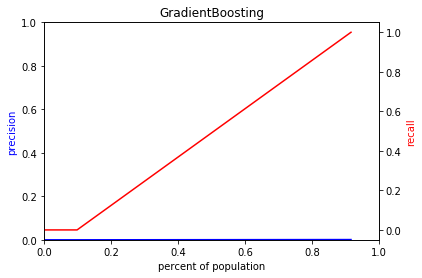

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

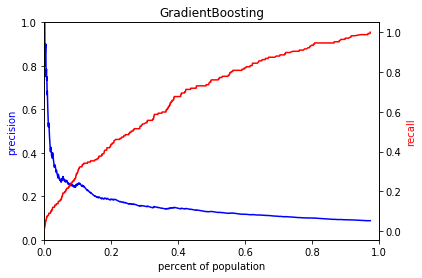

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

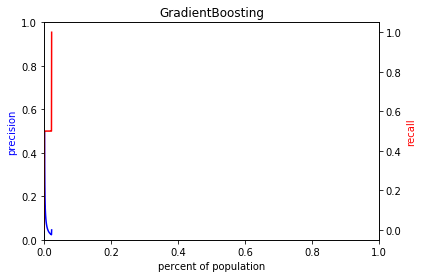

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

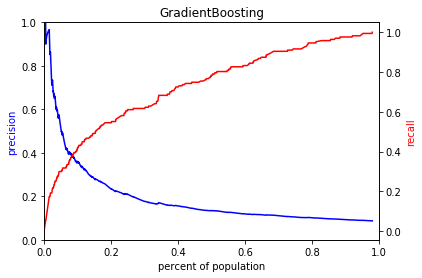

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

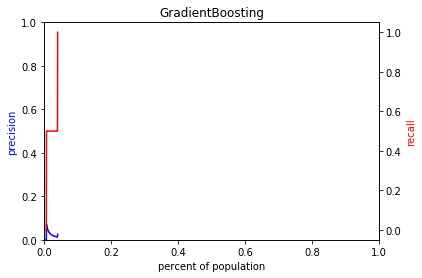

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

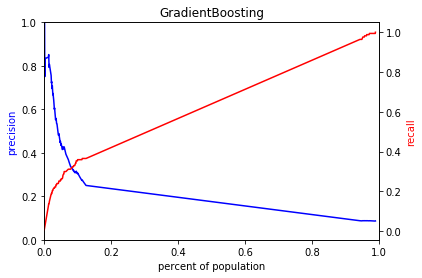

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

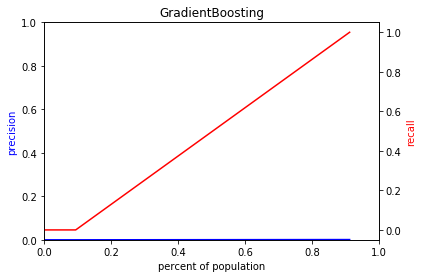

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

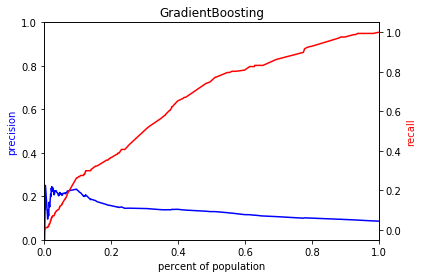

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

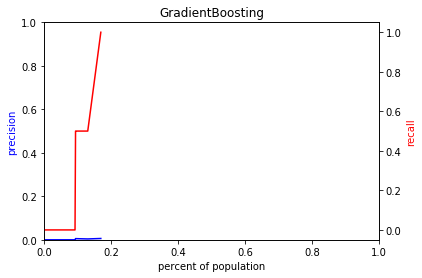

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

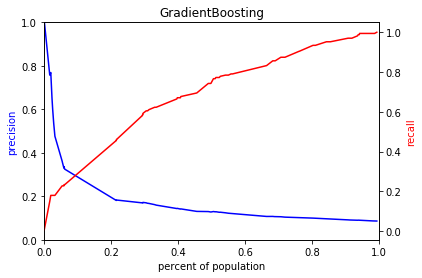

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

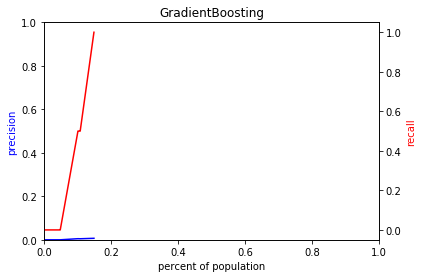

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

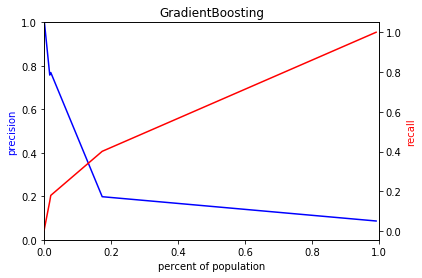

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

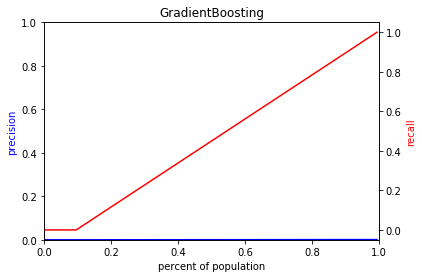

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

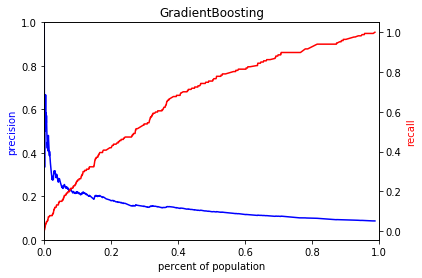

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

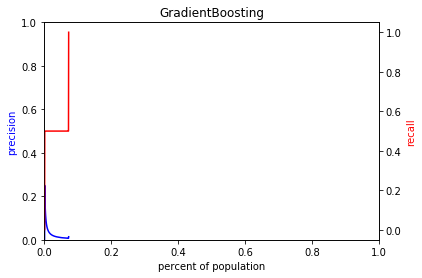

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

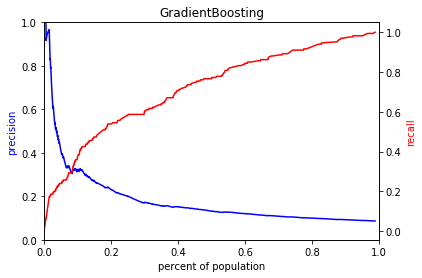

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

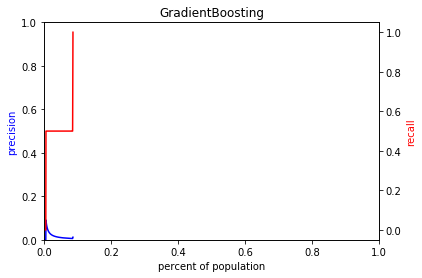

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

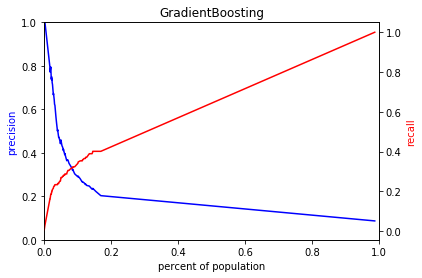

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

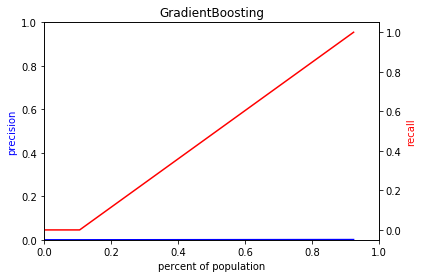

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

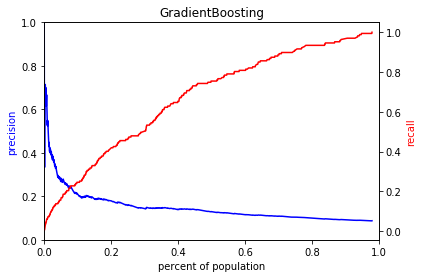

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

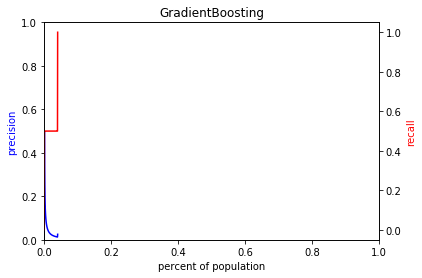

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

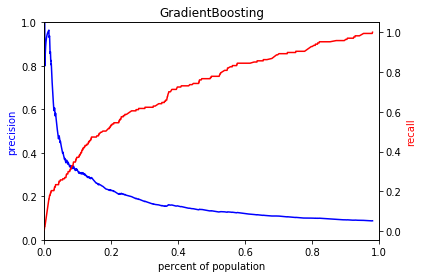

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

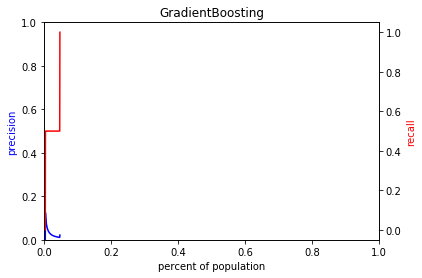

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

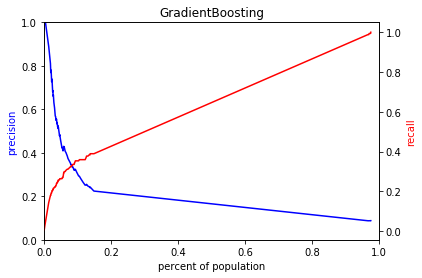

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

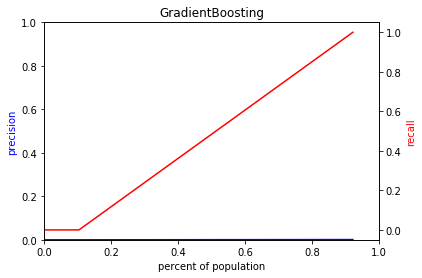

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

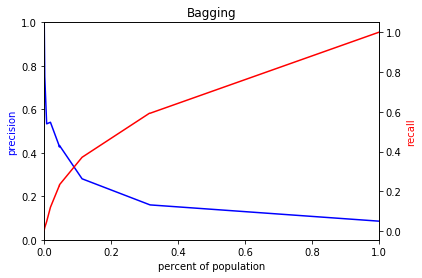

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

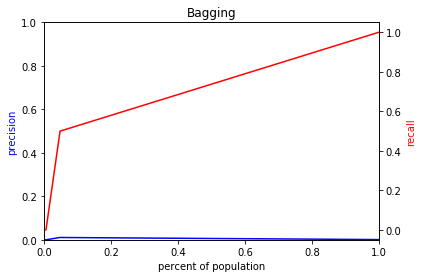

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

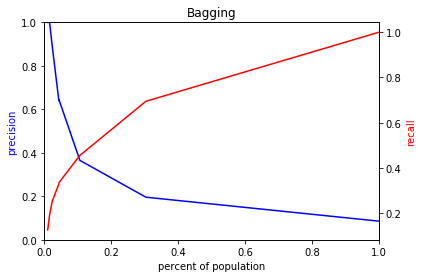

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

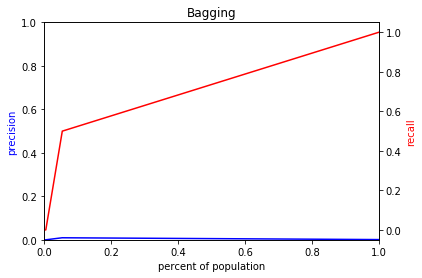

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

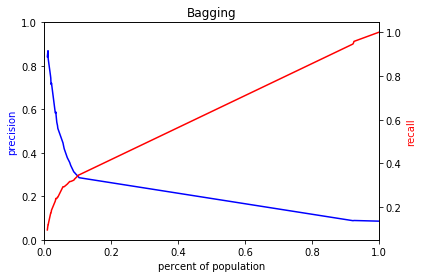

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

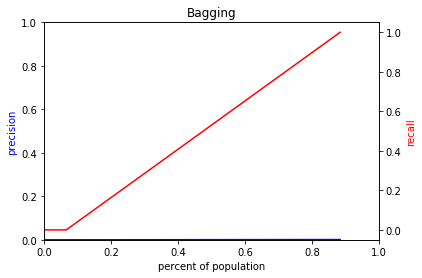

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

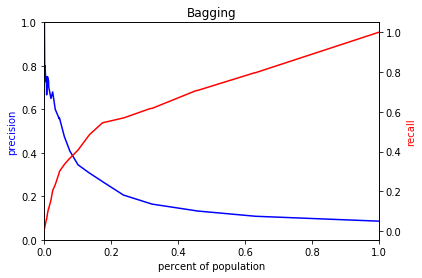

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

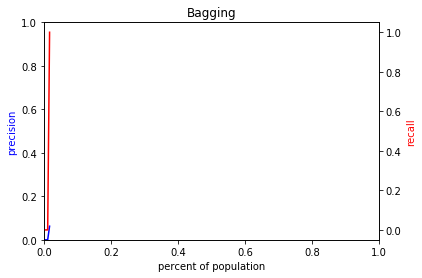

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

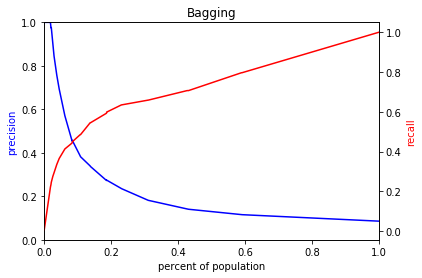

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

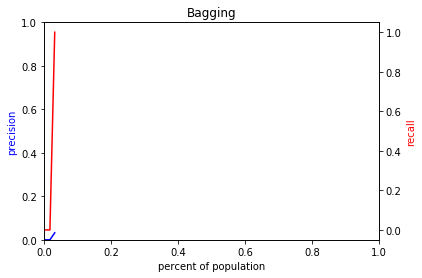

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

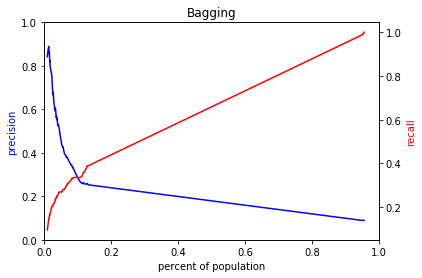

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

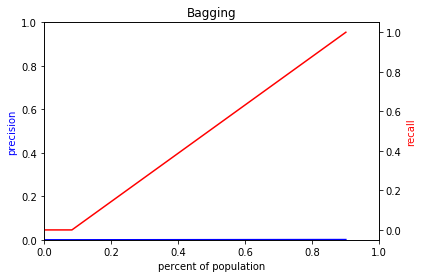

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

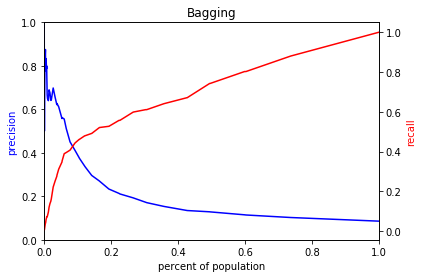

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

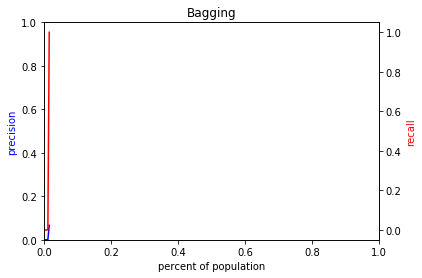

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

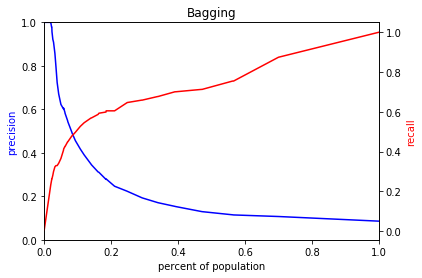

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

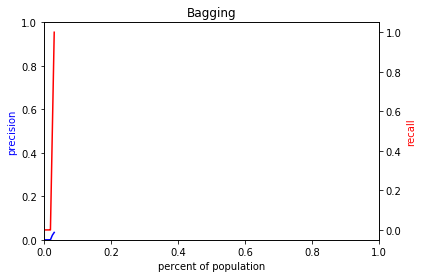

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

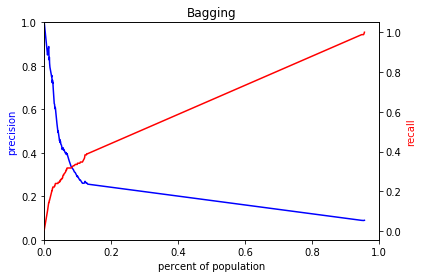

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

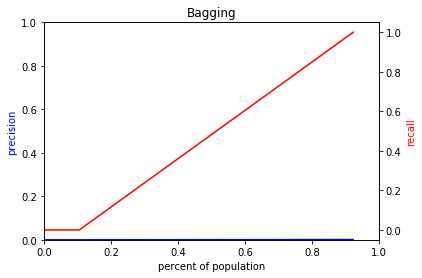

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

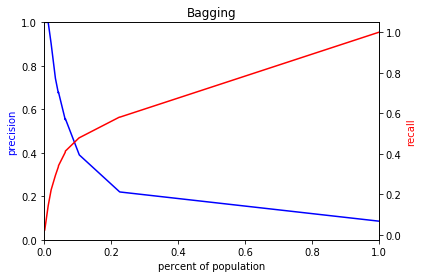

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

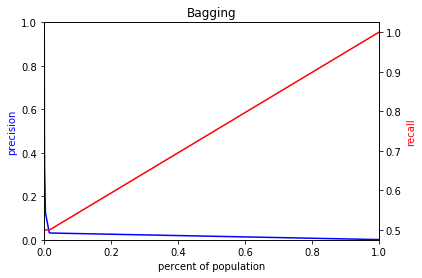

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

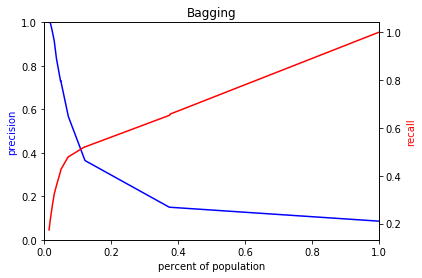

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

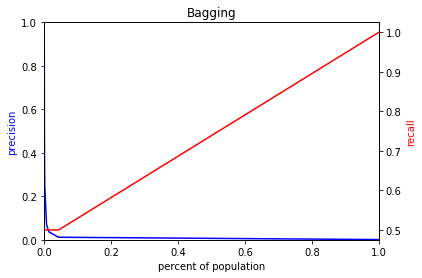

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

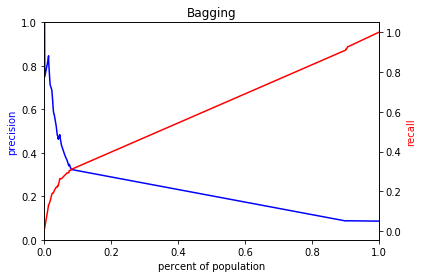

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

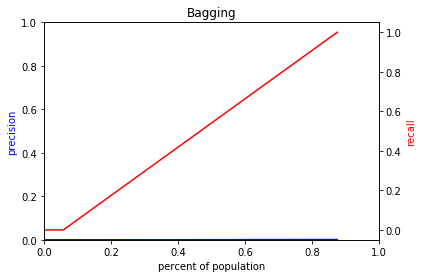

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

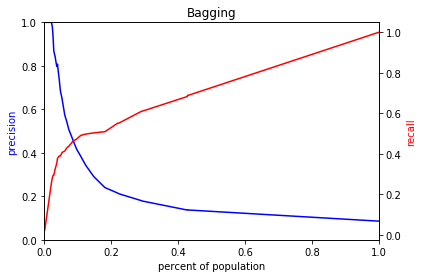

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

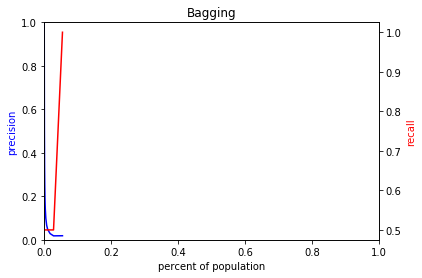

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

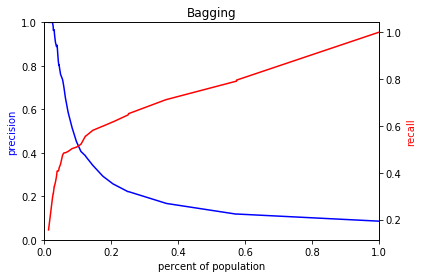

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

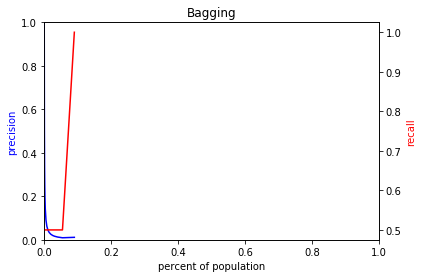

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

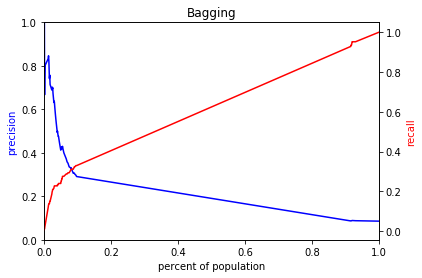

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

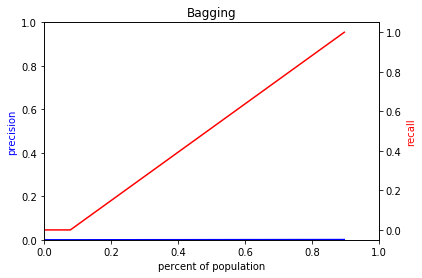

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

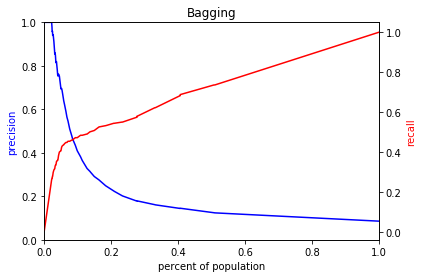

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

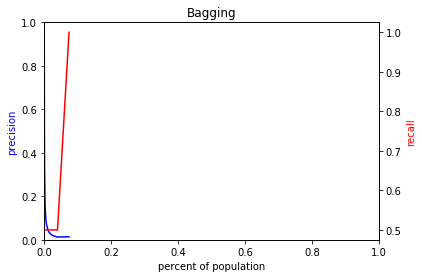

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

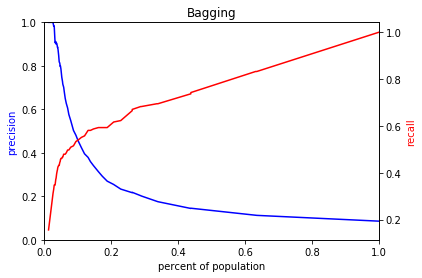

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

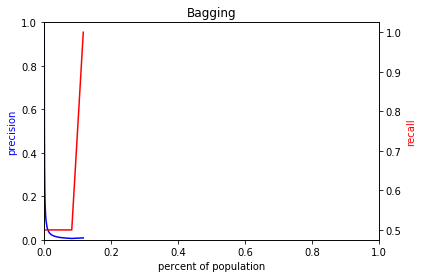

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

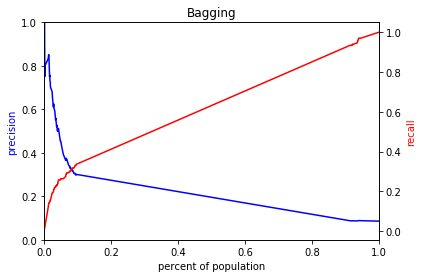

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

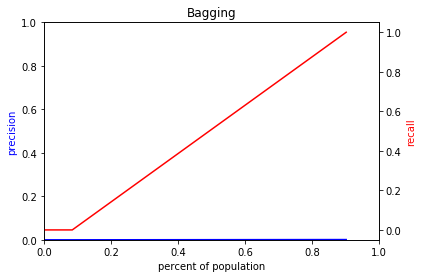

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

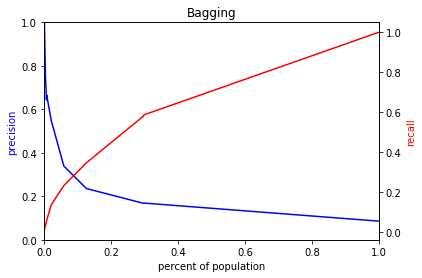

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

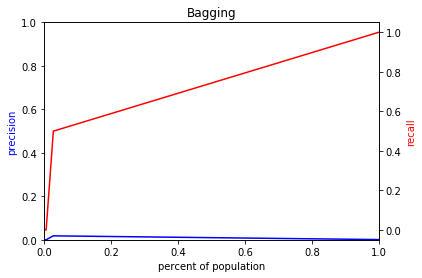

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

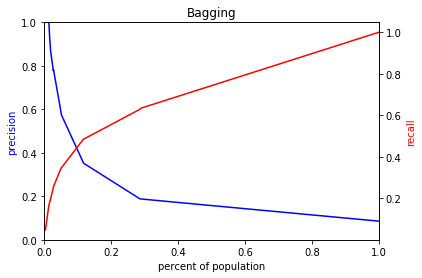

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

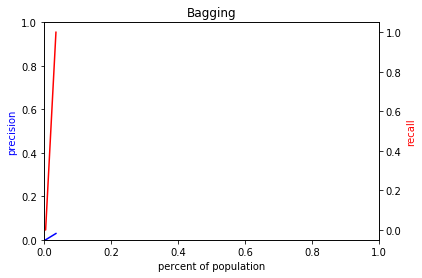

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

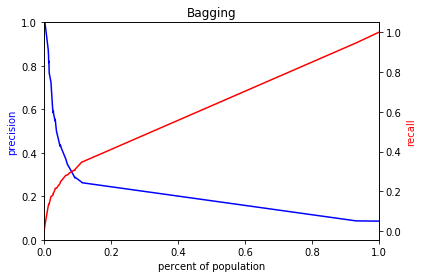

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

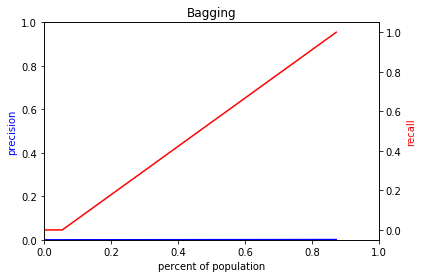

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

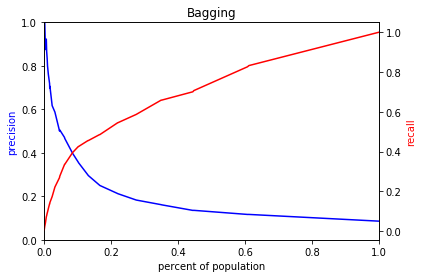

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

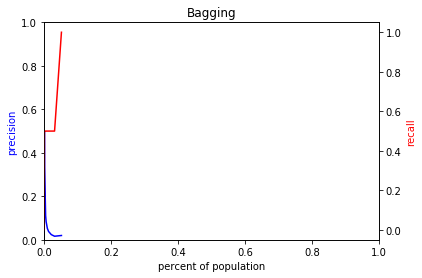

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

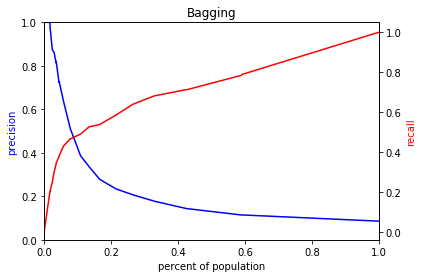

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

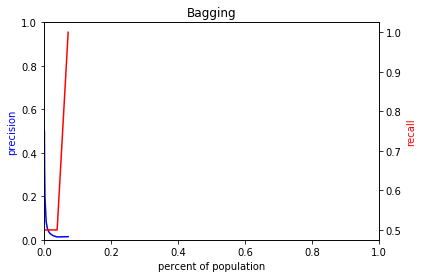

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

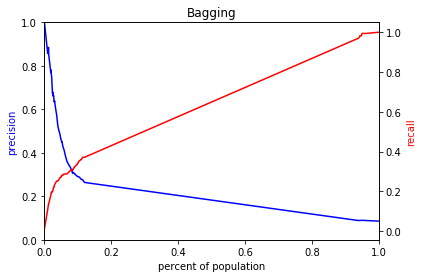

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

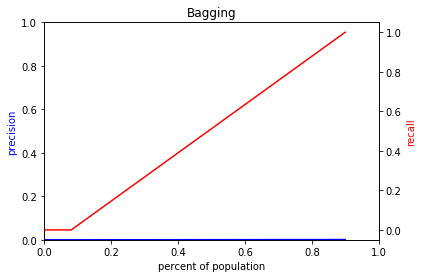

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

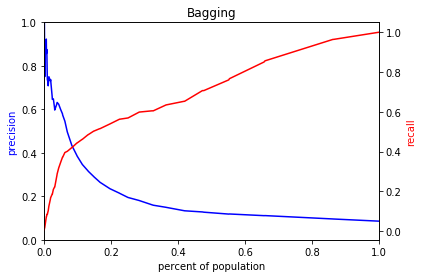

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

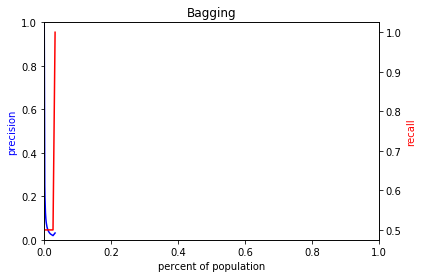

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

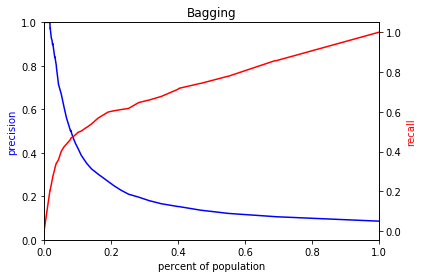

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

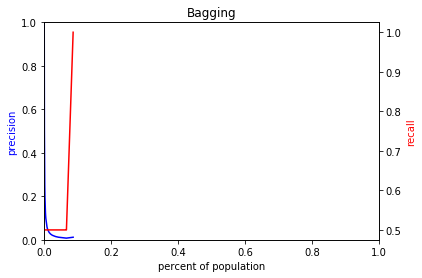

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

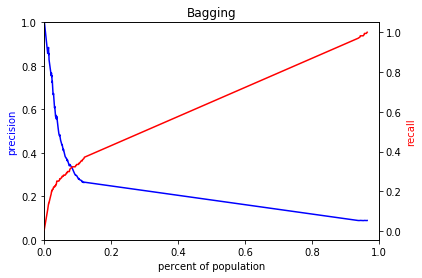

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

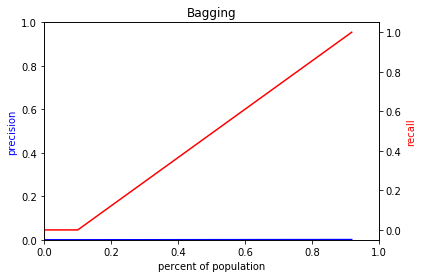

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

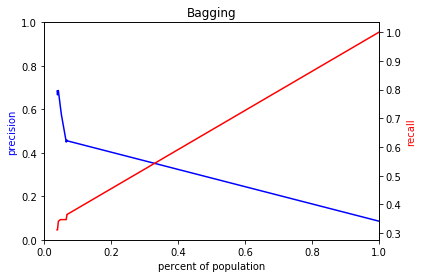

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

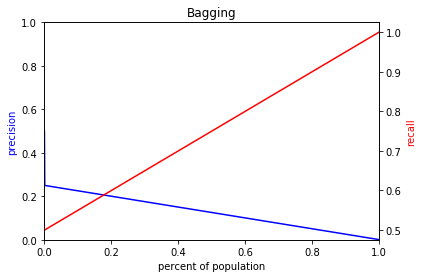

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

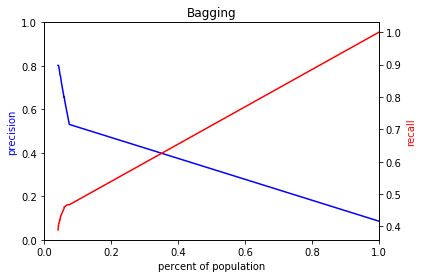

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

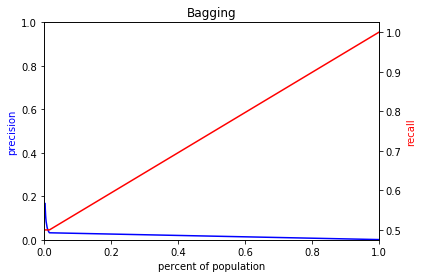

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

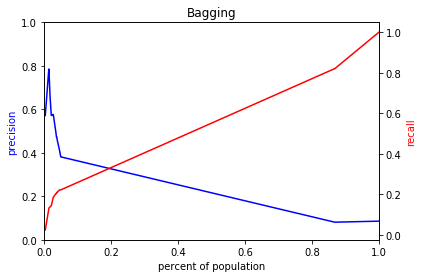

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

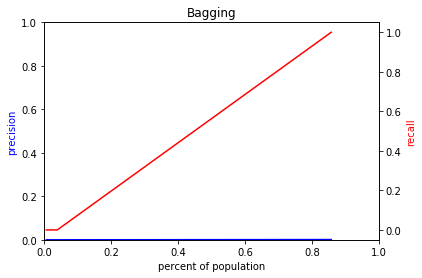

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

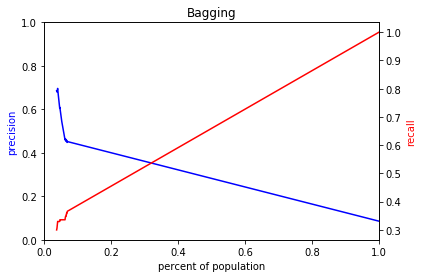

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

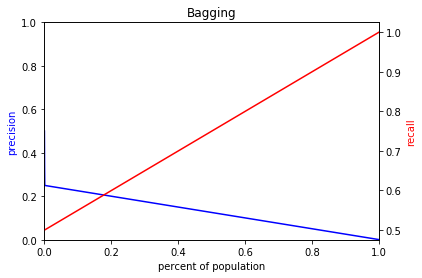

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

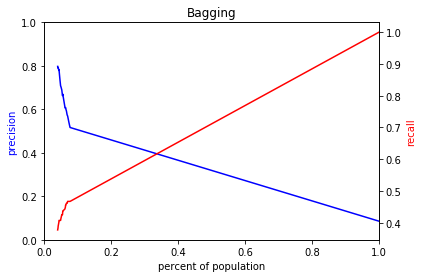

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

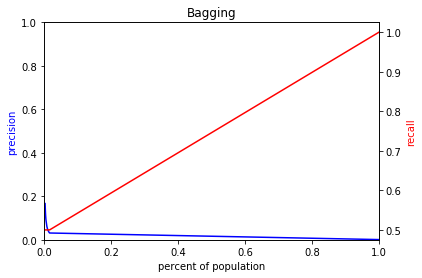

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

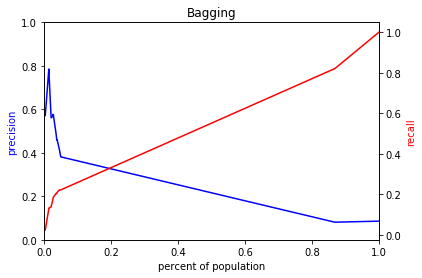

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

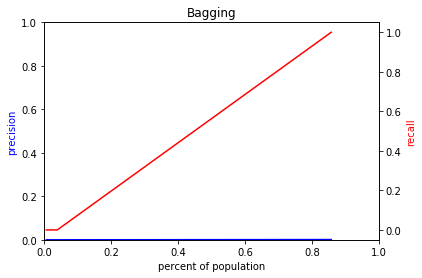

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

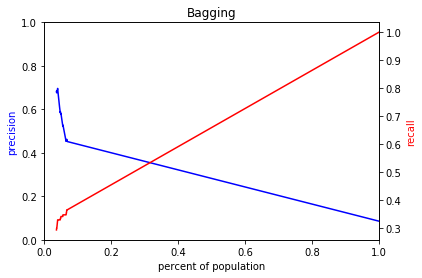

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

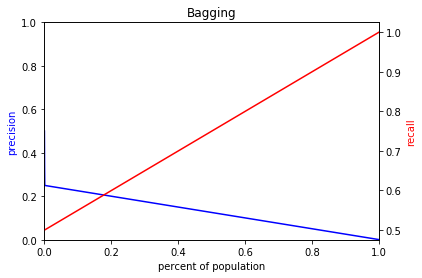

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

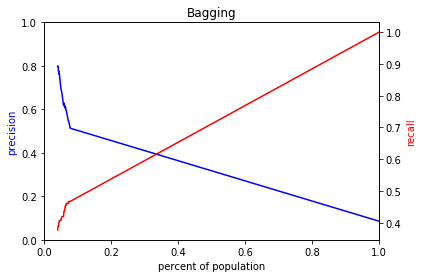

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

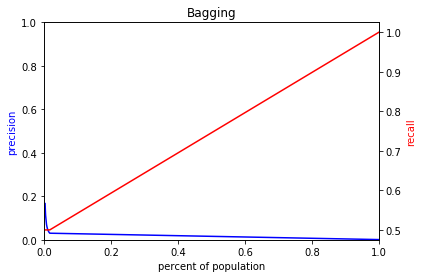

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

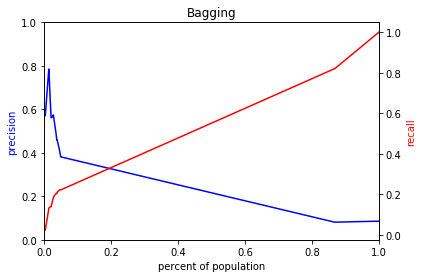

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

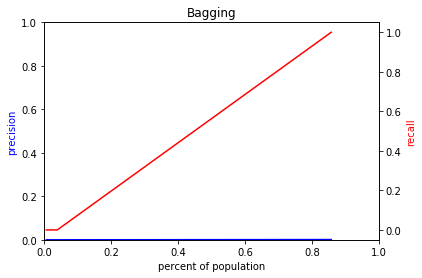

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

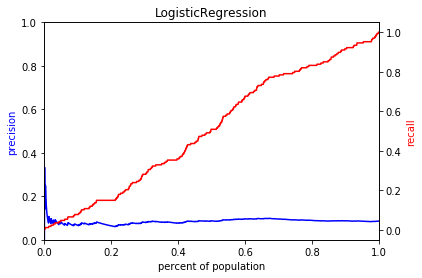

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

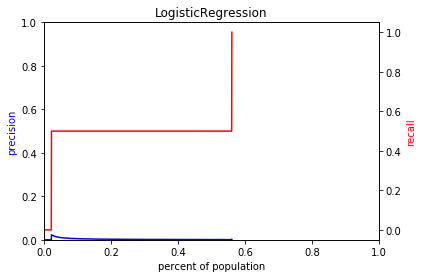

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

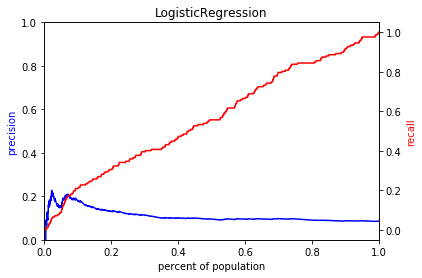

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

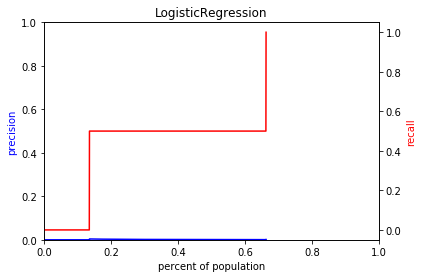

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

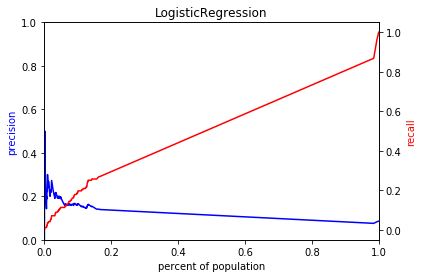

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

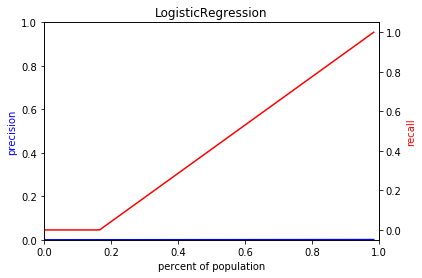

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

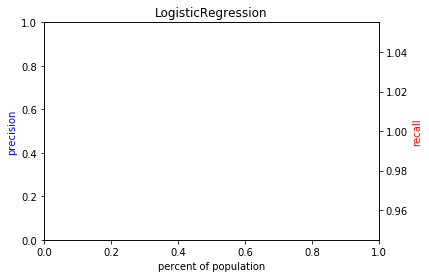

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

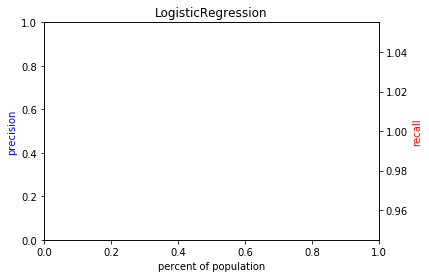

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

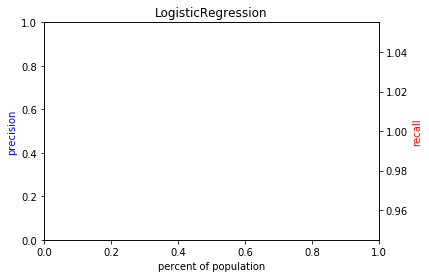

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

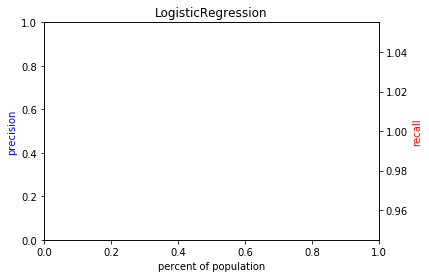

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

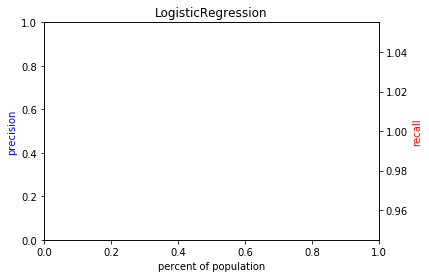

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 1, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

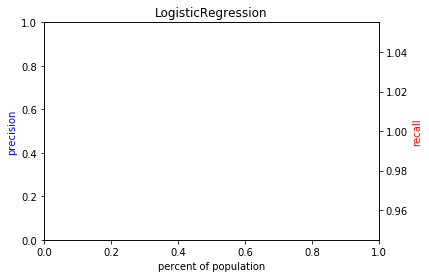

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

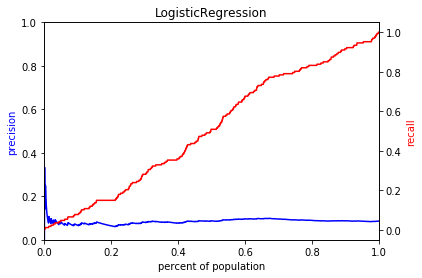

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

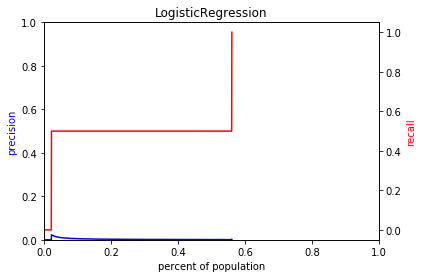

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

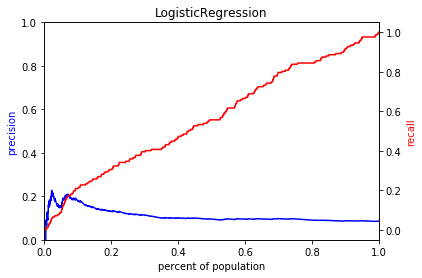

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

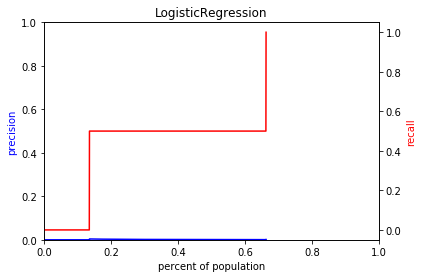

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

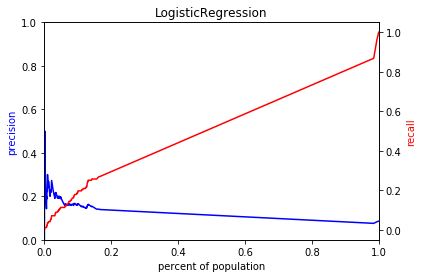

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

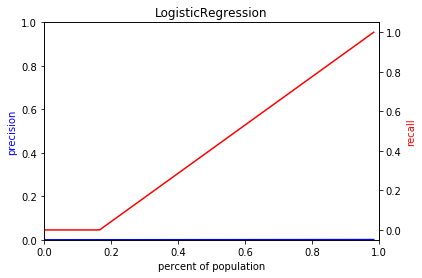

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

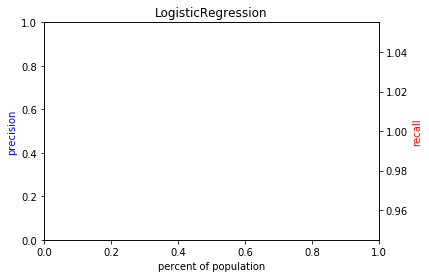

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

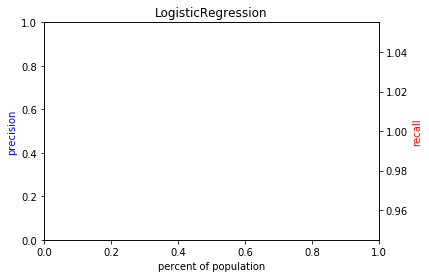

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

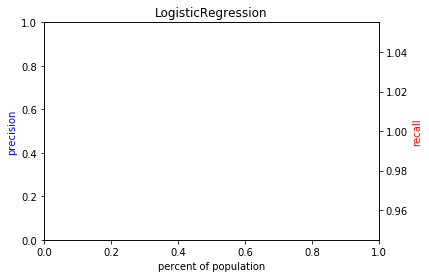

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

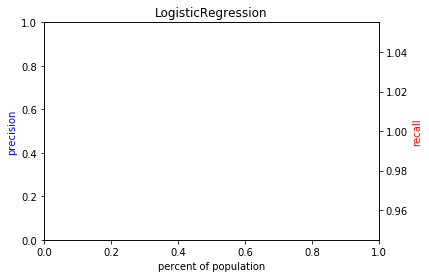

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

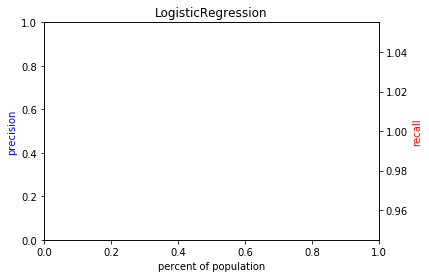

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

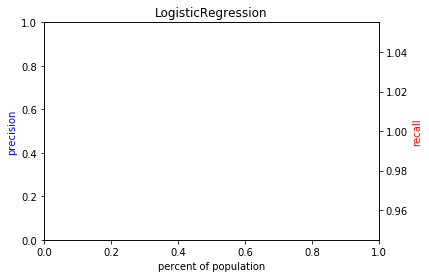

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

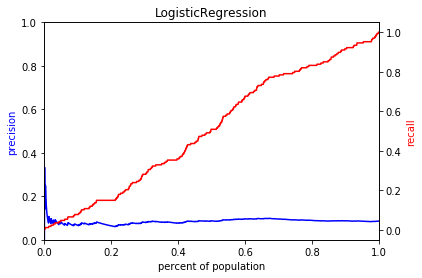

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

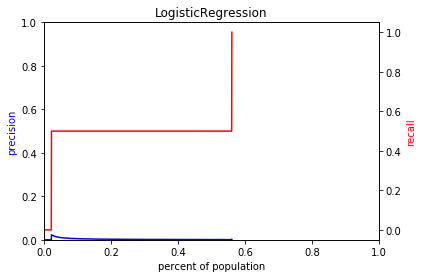

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

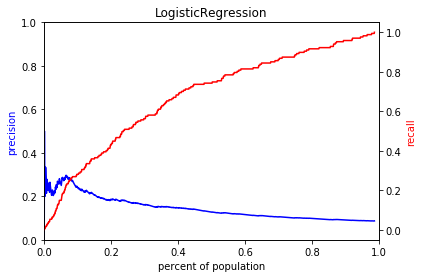

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

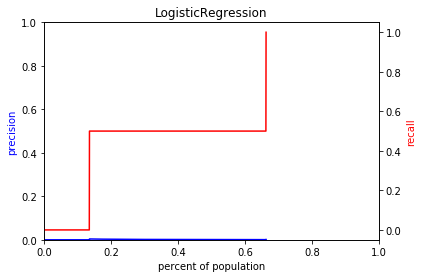

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

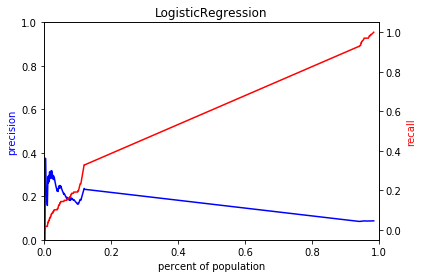

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

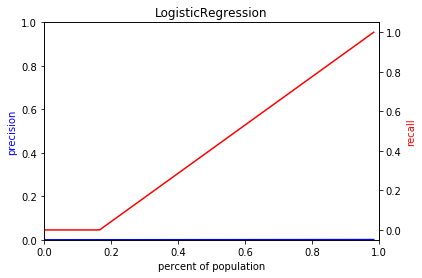

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

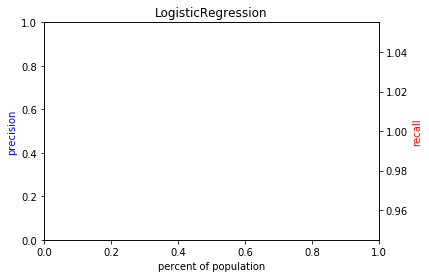

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

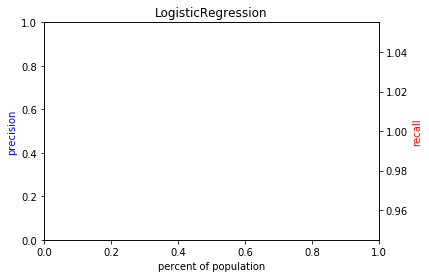

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

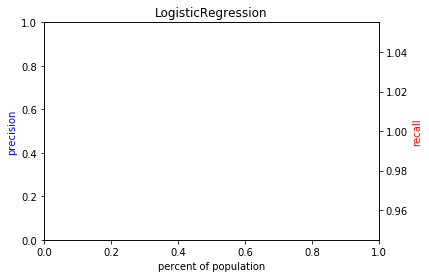

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

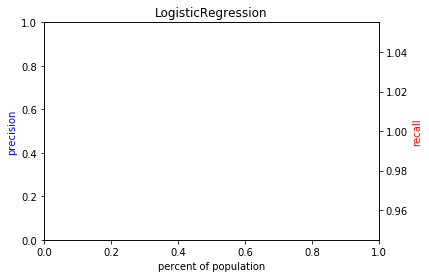

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

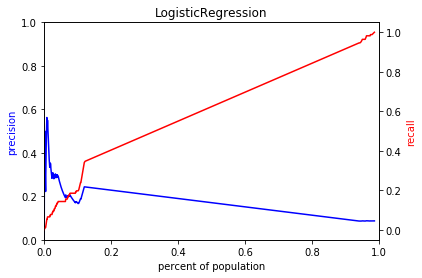

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 100, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


<Figure size 432x288 with 0 Axes>

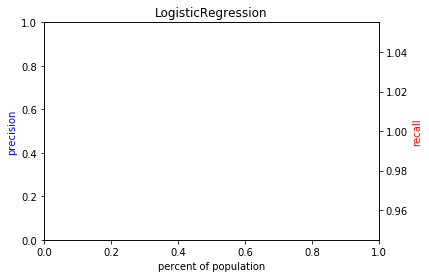

In [7]:
res_df = ml.classifier_loop(set_list, GRID, CLFRS_TO_RUN, METRIC_DICT, label_lst,
                            METRICS, plot=True, csv_name="loop_output.csv")

In [8]:
res_df2 = ml.classifier_loop(set_list, GRID, CLFRS_TO_RUN, METRIC_DICT, label_lst,
                            METRICS, plot=False, csv_name="loop_output2.csv")

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 t

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:0

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 0

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 0

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-0

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-0

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 

** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest o

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest obj

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBo

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost c

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the AdaBoost class

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** netw

** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** 

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** ne

** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
**

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 an

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 an

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 an

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 an

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and t

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12

** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
*

** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:

** augmented model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome sustained_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** network model on outcome firearm_outcome, TrainTest object 0
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.


** regular model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** regular model on outcome firearm_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome sustained_outcome, TrainTest object 0
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l2', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2010-12-31 05:49:12 and testing from 2013-01-01 17:27:36 to 2015-01-02 05:06:00.
** augmented model on outcome firearm

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:0

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:0

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 t

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-0

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-0

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-0

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 100, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-0

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 500, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01

** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 10, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 100, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 20

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the RandomForest classifier with parameters {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 500, 'n_estimators': 20, 'n_jobs': -1, 'random_state': 84}.
* Training fro

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest o

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 5, 'n_estimators': 500, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the ExtraTrees classifier with parameters {'max_depth': 10, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest obj

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.01, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBo

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 0.5, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost 

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the AdaBoost classifier with parameters {'learning_rate': 1, 'n_estimators': 50, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the AdaBoost classif

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regula

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 2, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
**

** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1000, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** a

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 2, 'min_samples_leaf': 500, 'min_samples_split': 50}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:1

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.

** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the DecisionTree classifier with parameters {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 500, 'min_samples_split': 100}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.5, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 10, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 10, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 100, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 2, 'min_samples_split': 500, 'n_estimators': 200, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 100, 'n_estimators': 10, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the GradientBoosting classifier with parameters {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_split': 500, 'n_estimators': 100, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:

** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': True, 'max_samples': 0.2, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:

** augmented model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 0.2, 'n_estimators': 10, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.


** network model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** network model on outcome firearm_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 50, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the Bagging classifier with parameters {'bootstrap': False, 'max_samples': 1.0, 'n_estimators': 100, 'n_jobs': -1, 'random_state': 84}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.

** regular model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** regular model on outcome firearm_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome sustained_outcome, TrainTest object 1
* Working on the LogisticRegression classifier with parameters {'Cs': 10, 'penalty': 'l1', 'random_state': 84, 'solver': 'liblinear'}.
* Training from 2010-01-01 00:00:00 to 2011-12-31 11:38:24 and testing from 2014-01-01 23:16:48 to 2016-01-02 10:55:12.
** augmented model on outcome firearm